In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt # type: ignore
import seaborn as sns # type: ignore
import logging
import unittest

In [ ]:
logging.basicConfig(
    filename='analysis.log',
    filemode='w',
    level=logging.DEBUG,
    format='%(asctime)s-%(name)s-%(levelname)s-%(message)s',
    datefmt='%Y-%m-%d %H:%M:%S'
)

In [ ]:
social=pd.read_csv(r'Time-Wasters on Social Media.csv')
data=pd.DataFrame(social)
logging.info('retrieving the data')


In [ ]:
data.head()

,UserID,Age,Gender,Location,Income,Debt,Owns Property,Profession,Demographics,Platform,...,ProductivityLoss,Satisfaction,Watch Reason,DeviceType,OS,Watch Time,Self Control,Addiction Level,CurrentActivity,ConnectionType
0,1,56,Male,Pakistan,82812,True,True,Engineer,Rural,Instagram,...,3,7,Procrastination,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
1,2,46,Female,Mexico,27999,False,True,Artist,Urban,Instagram,...,5,5,Habit,Computer,Android,5:00 PM,7,3,At school,Wi-Fi
2,3,32,Female,United States,42436,False,True,Engineer,Rural,Facebook,...,6,4,Entertainment,Tablet,Android,2:00 PM,8,2,At home,Mobile Data
3,4,60,Male,Barzil,62963,True,False,Waiting staff,Rural,YouTube,...,3,7,Habit,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
4,5,25,Male,Pakistan,22096,False,True,Manager,Urban,TikTok,...,8,2,Boredom,Smartphone,iOS,8:00 AM,10,0,At home,Mobile Data


In [ ]:
data.dtypes
logging.info('collecting the data-types of the attributes of the dataframe')

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   UserID                    1000 non-null   int64 
 1   Age                       1000 non-null   int64 
 2   Gender                    1000 non-null   object
 3   Location                  1000 non-null   object
 4   Income                    1000 non-null   int64 
 5   Debt                      1000 non-null   bool  
 6   Owns Property             1000 non-null   bool  
 7   Profession                1000 non-null   object
 8   Demographics              1000 non-null   object
 9   Platform                  1000 non-null   object
 10  Total Time Spent          1000 non-null   int64 
 11  Number of Sessions        1000 non-null   int64 
 12  Video ID                  1000 non-null   int64 
 13  Video Category            1000 non-null   object
 14  Video Length             

In [ ]:
print(f'{data.isnull().sum()*100}/{len(data)}')
logging.info('checking the null values of the attributes of the dataframe')

UserID                      0
Age                         0
Gender                      0
Location                    0
Income                      0
Debt                        0
Owns Property               0
Profession                  0
Demographics                0
Platform                    0
Total Time Spent            0
Number of Sessions          0
Video ID                    0
Video Category              0
Video Length                0
Engagement                  0
Importance Score            0
Time Spent On Video         0
Number of Videos Watched    0
Scroll Rate                 0
Frequency                   0
ProductivityLoss            0
Satisfaction                0
Watch Reason                0
DeviceType                  0
OS                          0
Watch Time                  0
Self Control                0
Addiction Level             0
CurrentActivity             0
ConnectionType              0
dtype: int64/1000


In [ ]:
data.describe(include='all')

,UserID,Age,Gender,Location,Income,Debt,Owns Property,Profession,Demographics,Platform,...,ProductivityLoss,Satisfaction,Watch Reason,DeviceType,OS,Watch Time,Self Control,Addiction Level,CurrentActivity,ConnectionType
count,1000.000000,1000.000000,1000,1000,1000.000000,1000,1000,1000,1000,1000,...,1000.000000,1000.000000,1000,1000,1000,1000,1000.000000,1000.000000,1000,1000
unique,NaN,NaN,3,10,NaN,2,2,9,2,4,...,NaN,NaN,4,3,4,16,NaN,NaN,4,2
top,NaN,NaN,Male,India,NaN,True,True,Students,Rural,TikTok,...,NaN,NaN,Habit,Smartphone,Android,2:00 PM,NaN,NaN,At home,Mobile Data
freq,NaN,NaN,514,228,NaN,599,542,246,746,273,...,NaN,NaN,339,585,500,149,NaN,NaN,381,686
mean,500.500000,40.986000,NaN,NaN,59524.213000,NaN,NaN,NaN,NaN,NaN,...,5.136000,4.864000,NaN,NaN,NaN,NaN,7.094000,2.906000,NaN,NaN
std,288.819436,13.497852,NaN,NaN,23736.212925,NaN,NaN,NaN,NaN,NaN,...,2.122265,2.122265,NaN,NaN,NaN,NaN,2.058495,2.058495,NaN,NaN
min,1.000000,18.000000,NaN,NaN,20138.000000,NaN,NaN,NaN,NaN,NaN,...,1.000000,1.000000,NaN,NaN,NaN,NaN,3.000000,0.000000,NaN,NaN
25%,250.750000,29.000000,NaN,NaN,38675.250000,NaN,NaN,NaN,NaN,NaN,...,3.000000,4.000000,NaN,NaN,NaN,NaN,5.000000,2.000000,NaN,NaN
50%,500.500000,42.000000,NaN,NaN,58805.000000,NaN,NaN,NaN,NaN,NaN,...,5.000000,5.000000,NaN,NaN,NaN,NaN,7.000000,3.000000,NaN,NaN
75%,750.250000,52.000000,NaN,NaN,79792.250000,NaN,NaN,NaN,NaN,NaN,...,6.000000,7.000000,NaN,NaN,NaN,NaN,8.000000,5.000000,NaN,NaN


In [ ]:
for i in data.columns[1::1]:
    if data[i].dtype=='object':
        print(f'{i}')
        print(f'No. of unique values of {i}:{data[i].nunique()}')
        print(f'unique values of {i}:\n')
        print(f'{data[i].value_counts()}')
        print('\n')
logging.debug('unique values of the object data-types of the columns of the data.')

Gender
No. of unique values of Gender:3
unique values of Gender:

Gender
Male      514
Female    322
Other     164
Name: count, dtype: int64


Location
No. of unique values of Location:10
unique values of Location:

Location
India            228
United States    174
Vietnam           82
Barzil            78
Philippines       78
Indonesia         77
Pakistan          76
Japan             75
Mexico            73
Germany           59
Name: count, dtype: int64


Profession
No. of unique values of Profession:9
unique values of Profession:

Profession
Students         246
Waiting staff    194
Labor/Worker     186
driver           113
Engineer          65
Cashier           56
Manager           54
Artist            47
Teacher           39
Name: count, dtype: int64


Demographics
No. of unique values of Demographics:2
unique values of Demographics:

Demographics
Rural    746
Urban    254
Name: count, dtype: int64


Platform
No. of unique values of Platform:4
unique values of Platform:

Platform

In [ ]:
modified_data=data.copy()

In [ ]:
modified_data.head()

,UserID,Age,Gender,Location,Income,Debt,Owns Property,Profession,Demographics,Platform,...,ProductivityLoss,Satisfaction,Watch Reason,DeviceType,OS,Watch Time,Self Control,Addiction Level,CurrentActivity,ConnectionType
0,1,56,Male,Pakistan,82812,True,True,Engineer,Rural,Instagram,...,3,7,Procrastination,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
1,2,46,Female,Mexico,27999,False,True,Artist,Urban,Instagram,...,5,5,Habit,Computer,Android,5:00 PM,7,3,At school,Wi-Fi
2,3,32,Female,United States,42436,False,True,Engineer,Rural,Facebook,...,6,4,Entertainment,Tablet,Android,2:00 PM,8,2,At home,Mobile Data
3,4,60,Male,Barzil,62963,True,False,Waiting staff,Rural,YouTube,...,3,7,Habit,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
4,5,25,Male,Pakistan,22096,False,True,Manager,Urban,TikTok,...,8,2,Boredom,Smartphone,iOS,8:00 AM,10,0,At home,Mobile Data


In [ ]:
modified_data.drop(columns=['UserID','Video ID'],axis=1)

,Age,Gender,Location,Income,Debt,Owns Property,Profession,Demographics,Platform,Total Time Spent,...,ProductivityLoss,Satisfaction,Watch Reason,DeviceType,OS,Watch Time,Self Control,Addiction Level,CurrentActivity,ConnectionType
0,56,Male,Pakistan,82812,True,True,Engineer,Rural,Instagram,80,...,3,7,Procrastination,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
1,46,Female,Mexico,27999,False,True,Artist,Urban,Instagram,228,...,5,5,Habit,Computer,Android,5:00 PM,7,3,At school,Wi-Fi
2,32,Female,United States,42436,False,True,Engineer,Rural,Facebook,30,...,6,4,Entertainment,Tablet,Android,2:00 PM,8,2,At home,Mobile Data
3,60,Male,Barzil,62963,True,False,Waiting staff,Rural,YouTube,101,...,3,7,Habit,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
4,25,Male,Pakistan,22096,False,True,Manager,Urban,TikTok,136,...,8,2,Boredom,Smartphone,iOS,8:00 AM,10,0,At home,Mobile Data
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,22,Male,India,74254,True,True,Students,Rural,TikTok,144,...,9,1,Procrastination,Smartphone,iOS,5:45 PM,10,0,At work,Mobile Data
996,40,Female,Pakistan,27006,False,False,Waiting staff,Urban,Facebook,231,...,8,2,Boredom,Smartphone,MacOS,10:15 PM,10,0,At home,Mobile Data
997,27,Male,India,94218,True,True,Waiting staff,Rural,TikTok,165,...,9,1,Procrastination,Smartphone,iOS,10:15 PM,10,0,Commuting,Mobile Data
998,61,Male,Pakistan,85344,True,False,Students,Urban,YouTube,151,...,3,7,Procrastination,Smartphone,MacOS,10:15 PM,5,5,At work,Wi-Fi


In [ ]:
logging.info('creating the class for the analysis of the data')

In [ ]:
class label_info():
    def __init__(self):
        pass
        
    def analyse_the_plot(self,df,category,num_col):
        self.df=df
        self.num_col=num_col
        self.category=category
        print(f'{self.category}:')
        
        plt.figure(figsize=(8,10))
        
        logging.debug('Details about the distribution of the category')
        print(f'Distribution of people of {self.category}')
        print((self.df[self.category].value_counts()*100)/len(self.df))
        plt.pie(self.df[self.category].value_counts(),shadow=True,autopct='%1.2f%%')
        plt.title(f'Distribution of people of {self.category}')
        plt.show()
        
    
        logging.info(f'Details about the distribution of {self.num_col} of the category')
        sns.histplot(self.df[self.num_col],bins=10,kde=True)
        plt.title(f'Distribution of time spent for {self.category}')
        plt.legend(self.df[self.category])
        plt.grid(True)
        plt.show()
        
        print(f'Total {self.num_col} by different groups of {self.category}')
        print(self.df.groupby(self.category)[self.num_col].sum())
        sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')
        plt.title(f'Distribution of total time spent of {self.category}')
        plt.xticks(rotation='vertical')
        #plt.legend(self.df[self.category])
        plt.show()
        
        print(f'Average {self.num_col} by different groups of {self.category}')
        print(self.df.groupby(self.category)[self.num_col].mean())
        sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')
        plt.title(f'Distribution of total time spent of {self.category}')
        plt.xticks(rotation='vertical')
        #plt.legend(self.df[self.category])
        plt.show()
       

In [ ]:
label=label_info()

In [ ]:
logging.info('creating the class for the analysis of the data before detecting the outliers')

In [ ]:
#list of all object data type of the modified dataframe
obj_col=modified_data.select_dtypes(include=['object']).columns.to_list()
obj_col

['Gender',
 'Location',
 'Profession',
 'Demographics',
 'Platform',
 'Video Category',
 'Frequency',
 'Watch Reason',
 'DeviceType',
 'OS',
 'Watch Time',
 'CurrentActivity',
 'ConnectionType']

In [ ]:
num_col = modified_data.select_dtypes(exclude=['object']).columns.to_list()
excluded_columns = ['UserID', 'Age', 'Income', 'Debt', 'Owns Property', 'Video ID', 'Self Control', 'Addiction Level']


num_col = [col for col in num_col if col not in excluded_columns]

print(num_col)
num_col

['Total Time Spent', 'Number of Sessions', 'Video Length', 'Engagement', 'Importance Score', 'Time Spent On Video', 'Number of Videos Watched', 'Scroll Rate', 'ProductivityLoss', 'Satisfaction']


['Total Time Spent',
 'Number of Sessions',
 'Video Length',
 'Engagement',
 'Importance Score',
 'Time Spent On Video',
 'Number of Videos Watched',
 'Scroll Rate',
 'ProductivityLoss',
 'Satisfaction']

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


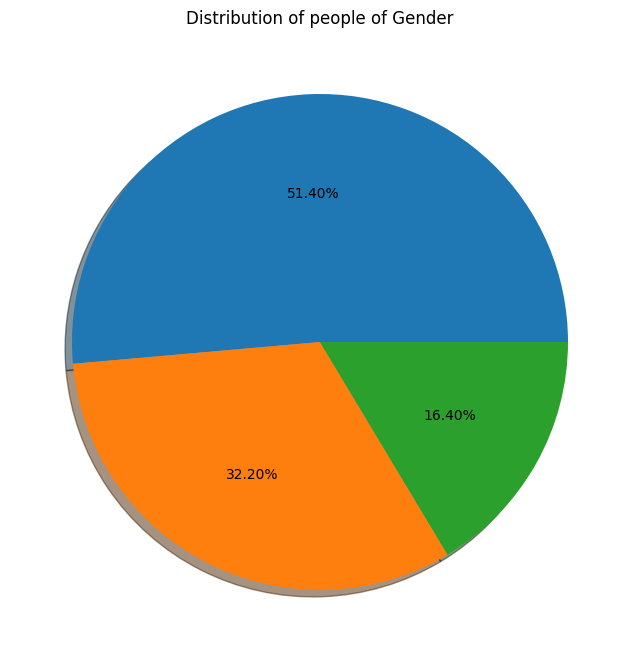

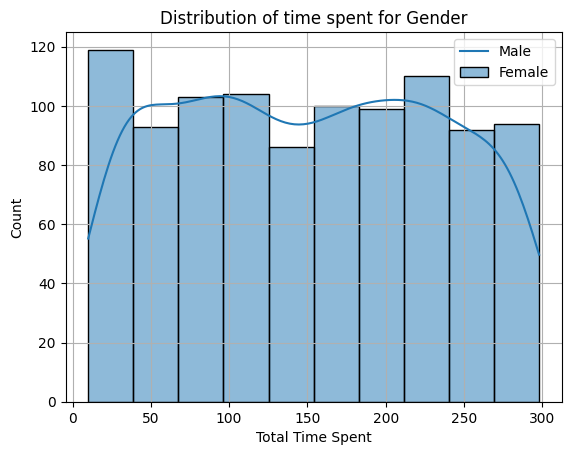

Total Total Time Spent by different groups of Gender
Gender
Female    47813
Male      78120
Other     25473
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


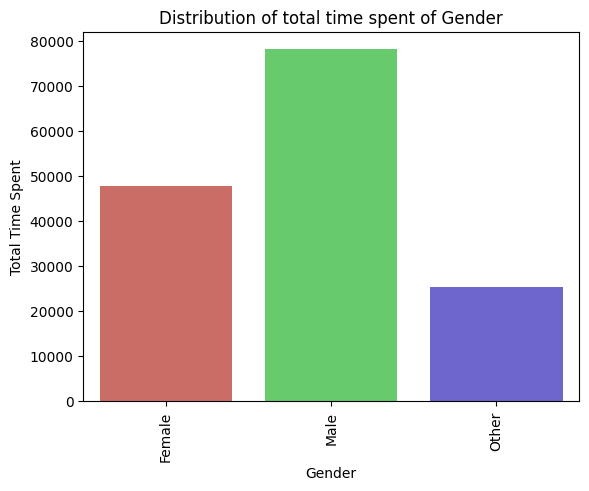

Average Total Time Spent by different groups of Gender
Gender
Female    148.487578
Male      151.984436
Other     155.323171
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


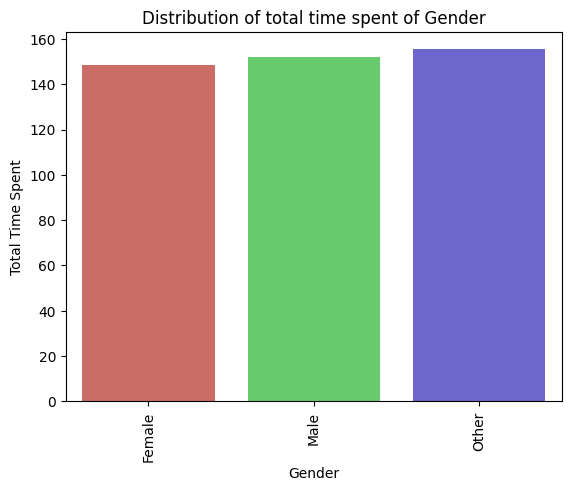

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


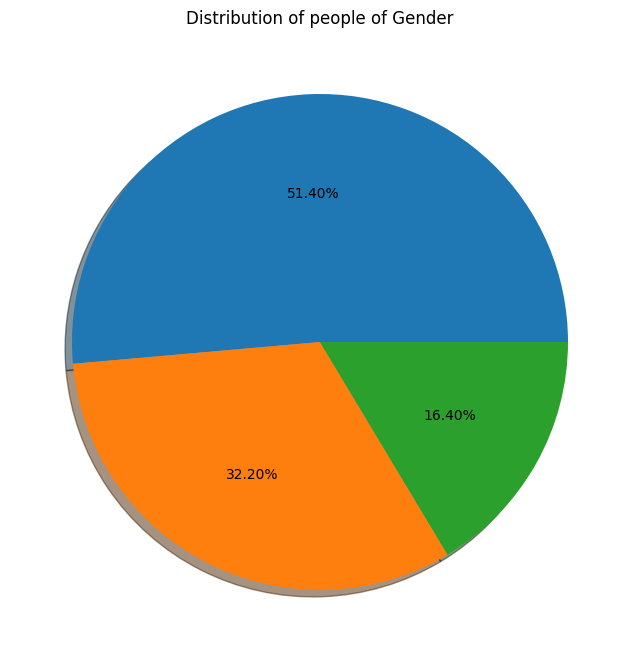

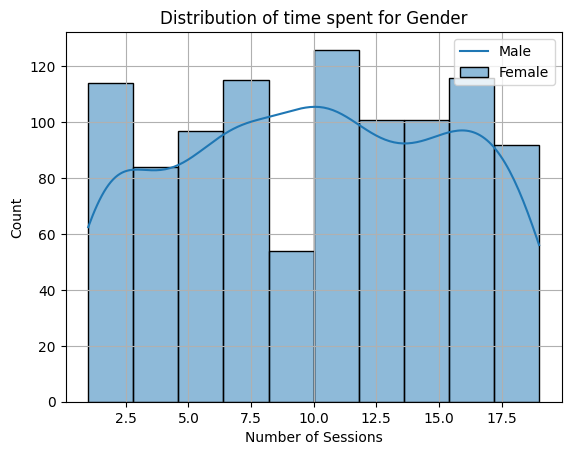

Total Number of Sessions by different groups of Gender
Gender
Female    3373
Male      5025
Other     1615
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


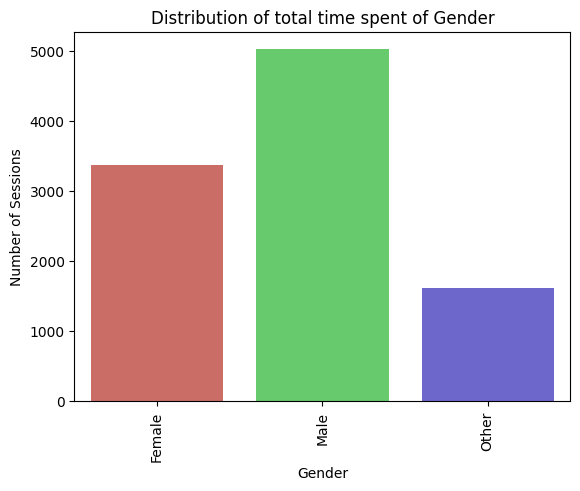

Average Number of Sessions by different groups of Gender
Gender
Female    10.475155
Male       9.776265
Other      9.847561
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


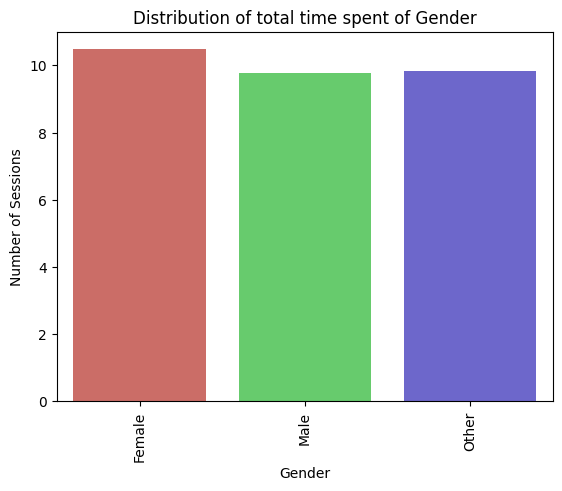

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


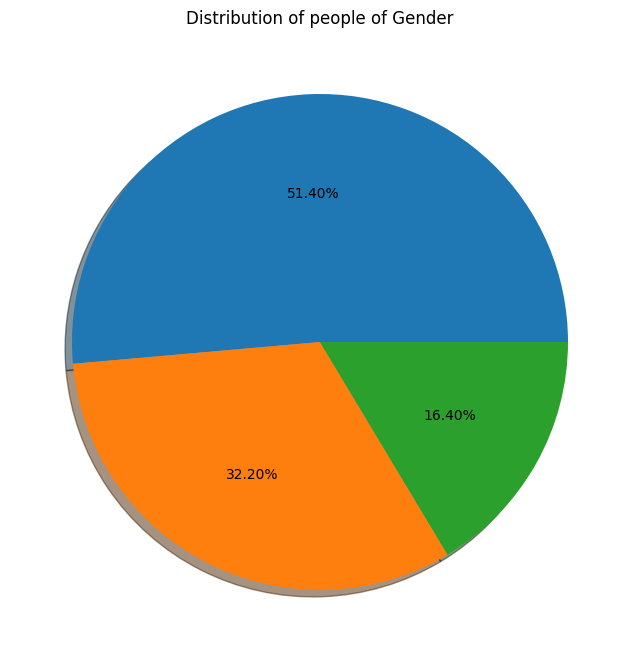

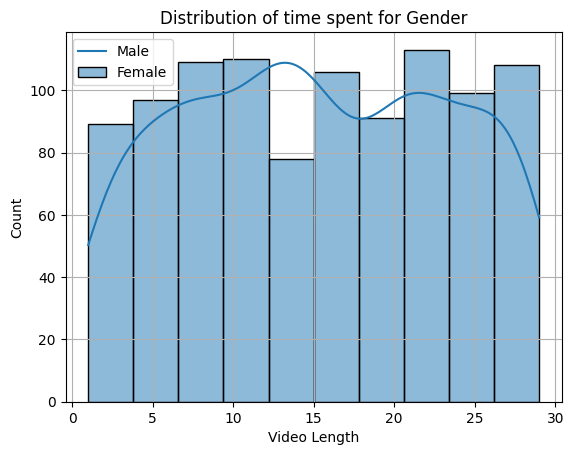

Total Video Length by different groups of Gender
Gender
Female    4638
Male      7951
Other     2625
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


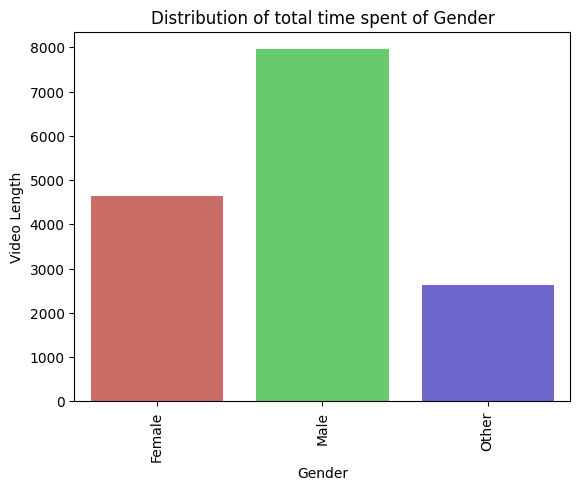

Average Video Length by different groups of Gender
Gender
Female    14.403727
Male      15.468872
Other     16.006098
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


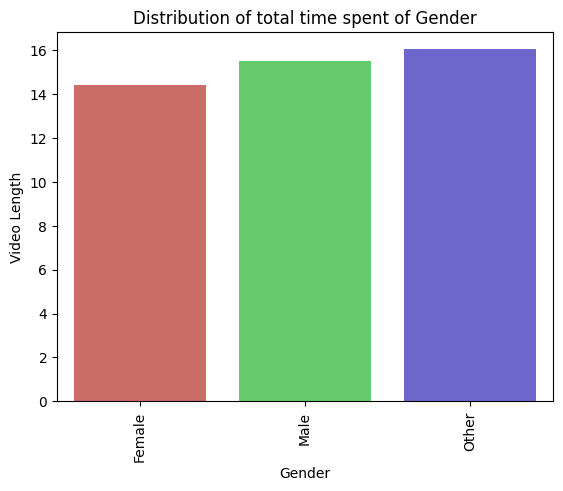

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


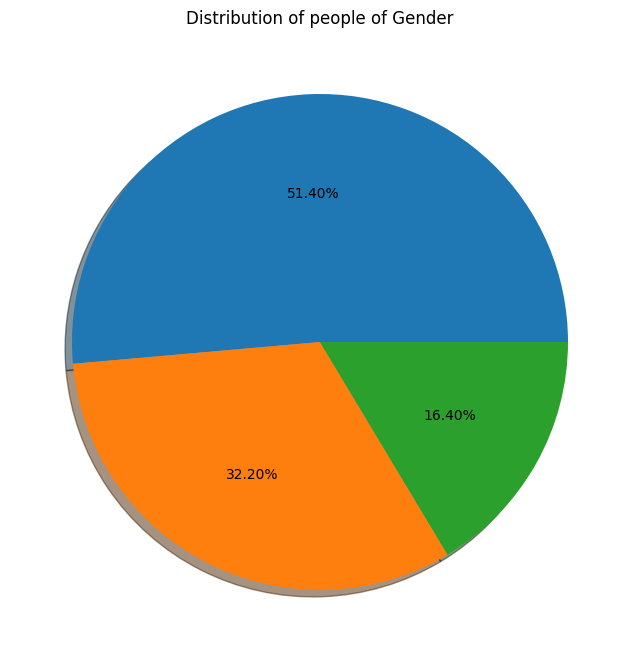

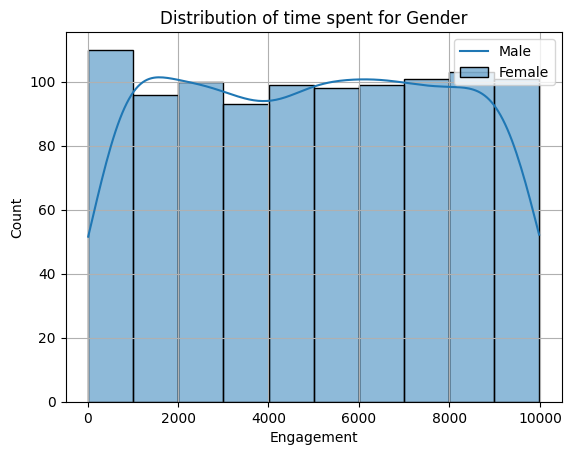

Total Engagement by different groups of Gender
Gender
Female    1556835
Male      2599449
Other      840875
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


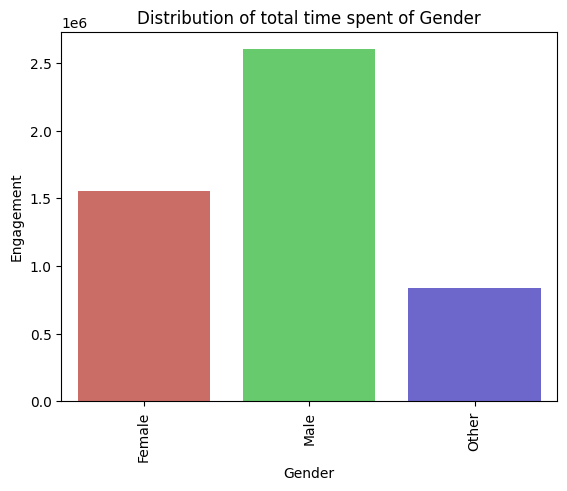

Average Engagement by different groups of Gender
Gender
Female    4834.891304
Male      5057.293774
Other     5127.286585
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


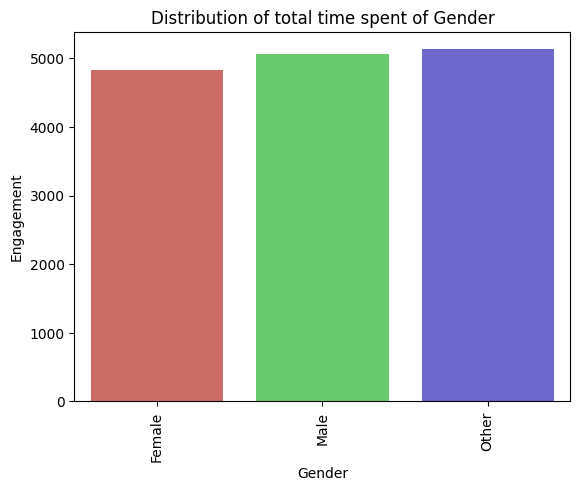

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


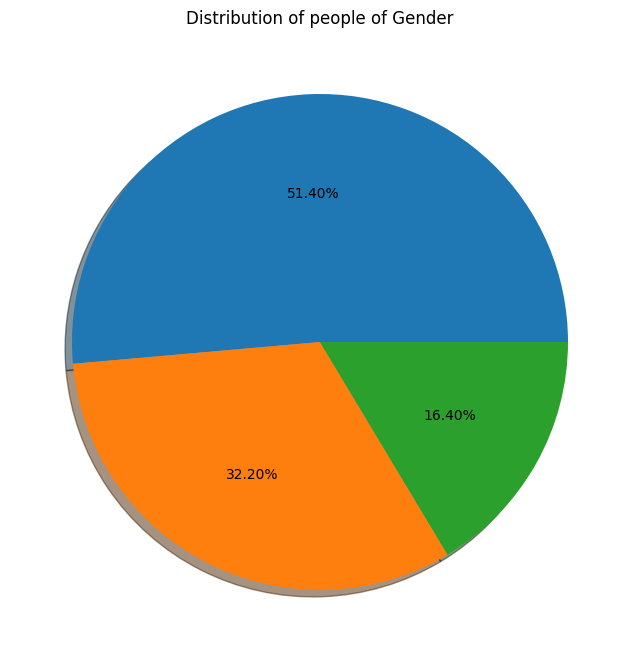

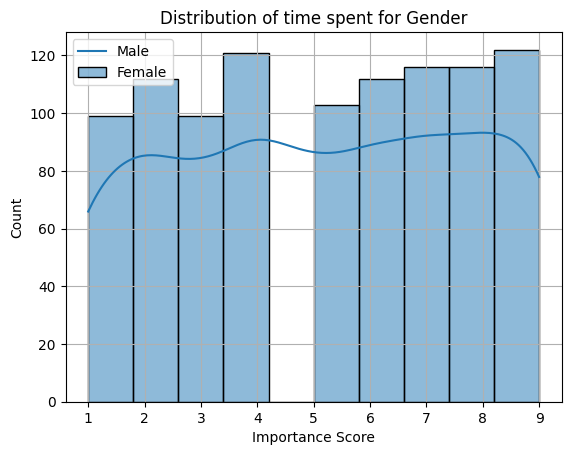

Total Importance Score by different groups of Gender
Gender
Female    1624
Male      2650
Other      855
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


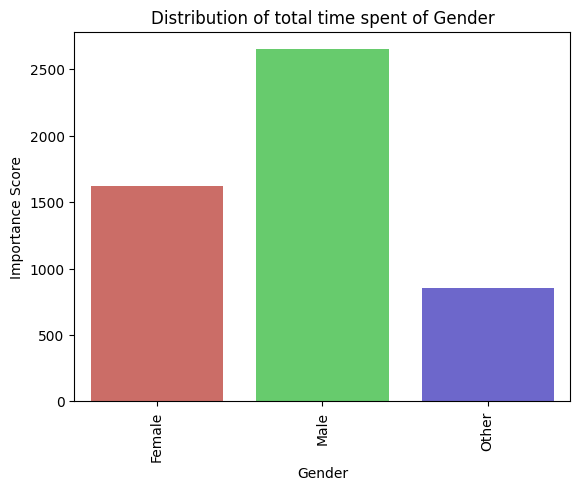

Average Importance Score by different groups of Gender
Gender
Female    5.043478
Male      5.155642
Other     5.213415
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


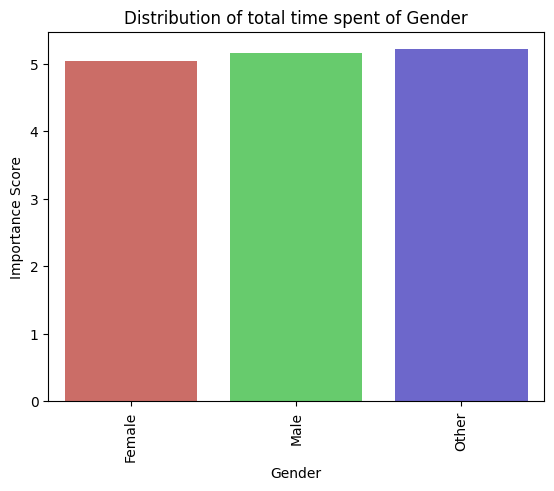

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


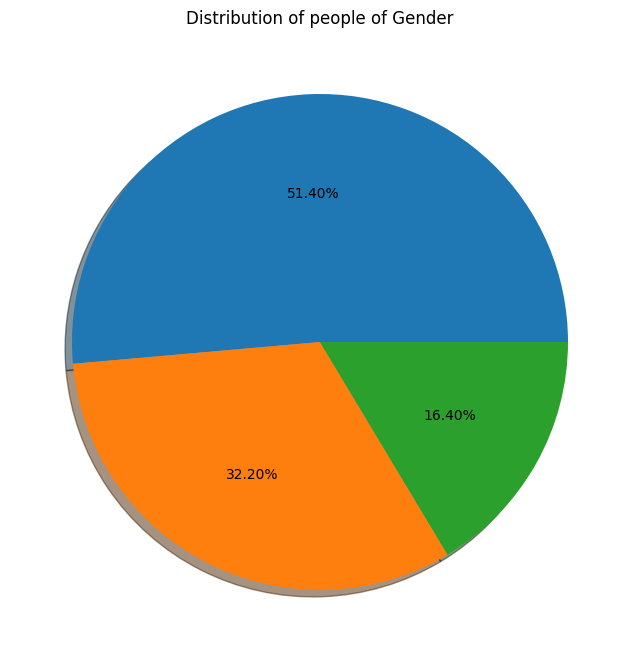

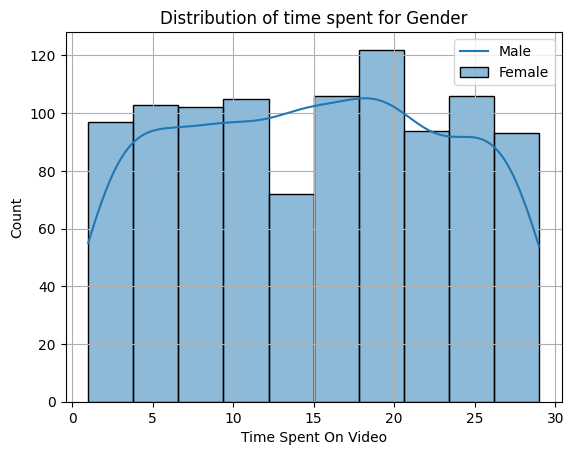

Total Time Spent On Video by different groups of Gender
Gender
Female    4648
Male      7763
Other     2562
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


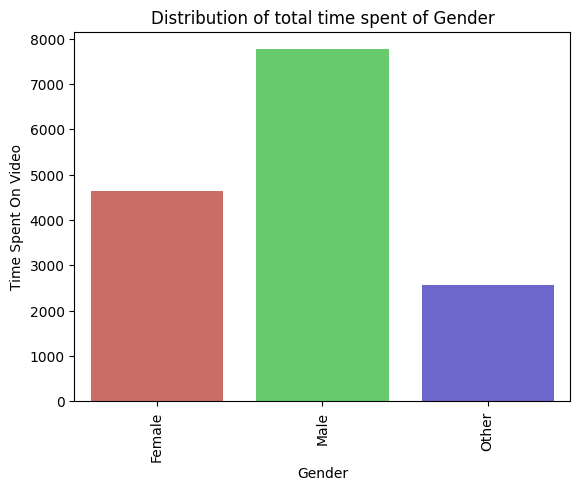

Average Time Spent On Video by different groups of Gender

C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')



Gender
Female    14.434783
Male      15.103113
Other     15.621951
Name: Time Spent On Video, dtype: float64


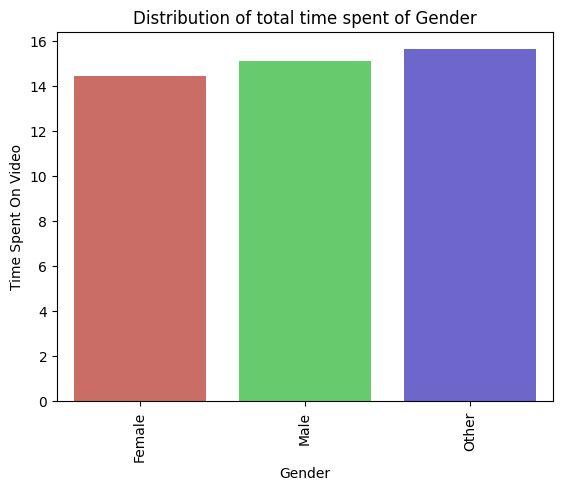

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


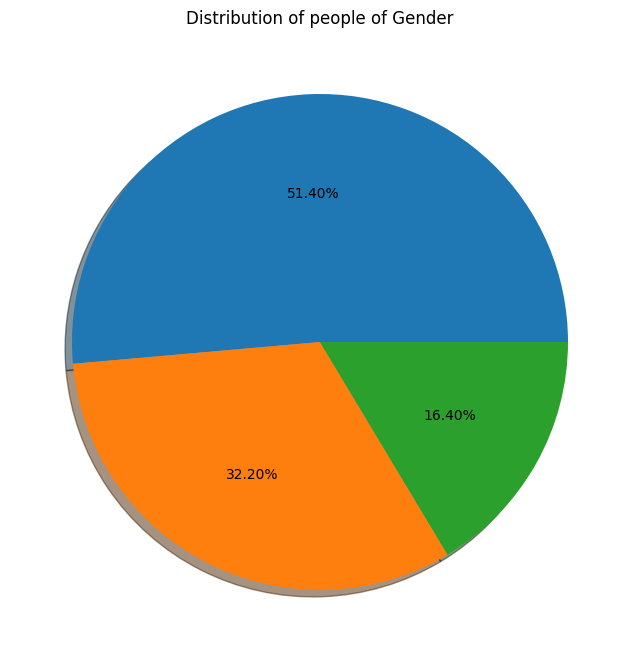

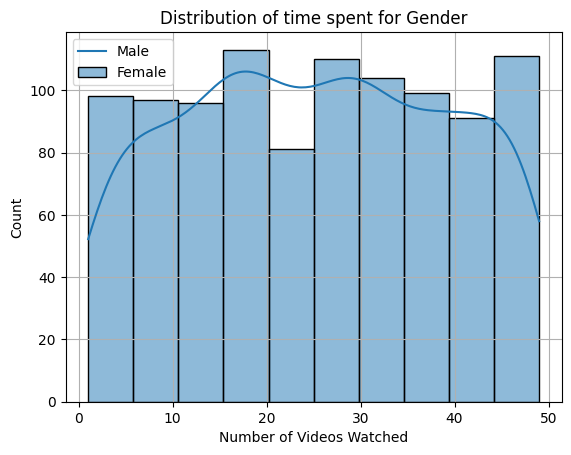

Total Number of Videos Watched by different groups of Gender
Gender
Female     8121
Male      13272
Other      3855
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


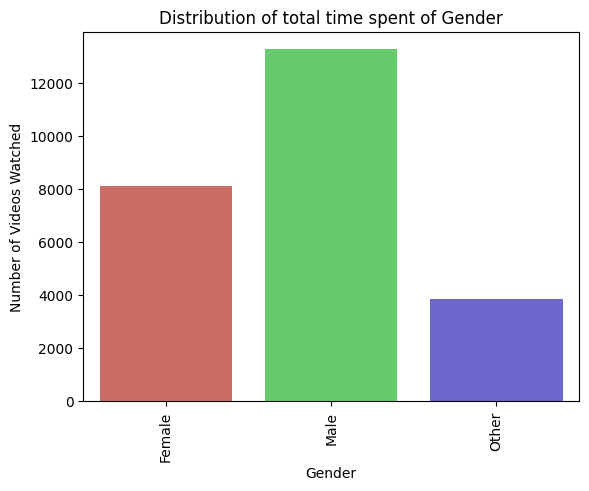

Average Number of Videos Watched by different groups of Gender
Gender
Female    25.220497
Male      25.821012
Other     23.506098
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


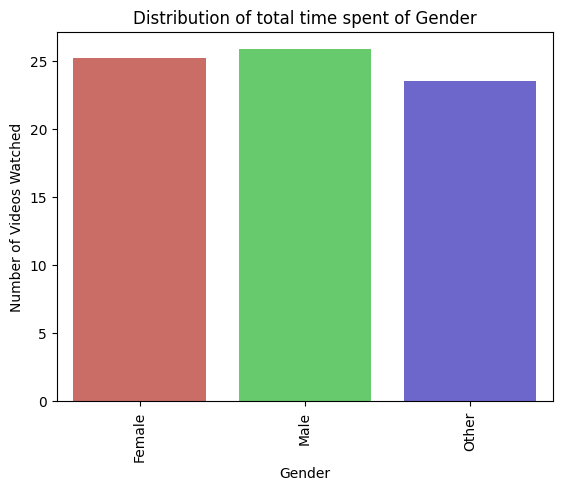

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


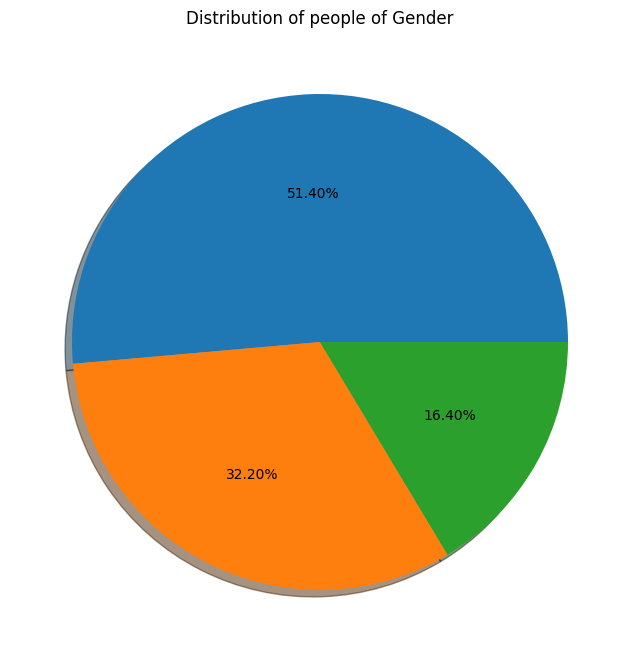

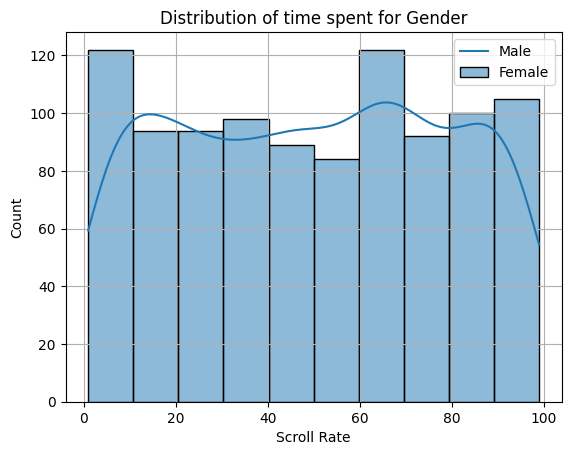

Total Scroll Rate by different groups of Gender
Gender
Female    16048
Male      25512
Other      8214
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


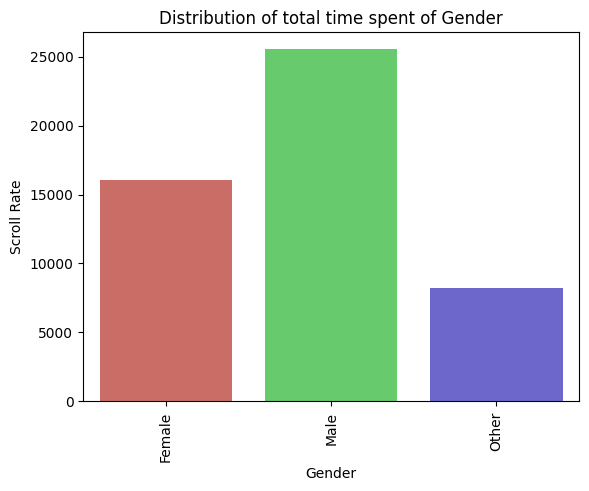

Average Scroll Rate by different groups of Gender
Gender
Female    49.838509
Male      49.634241
Other     50.085366
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


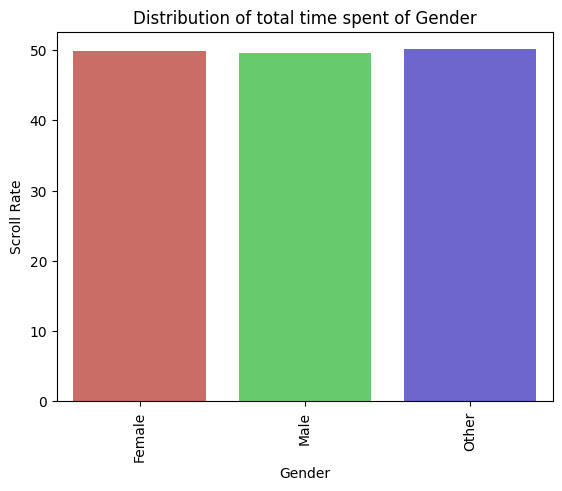

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


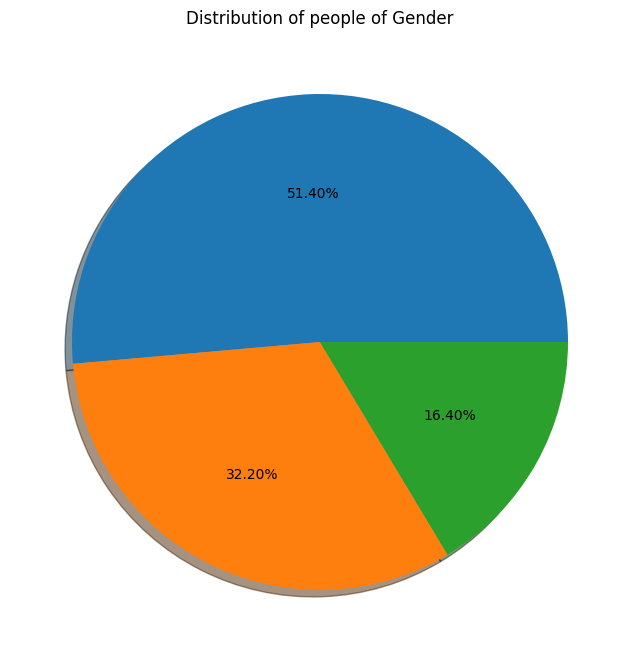

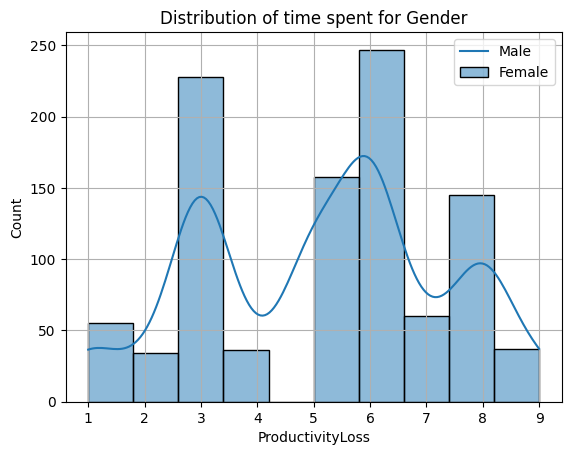

Total ProductivityLoss by different groups of Gender
Gender
Female    1656
Male      2610
Other      870
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


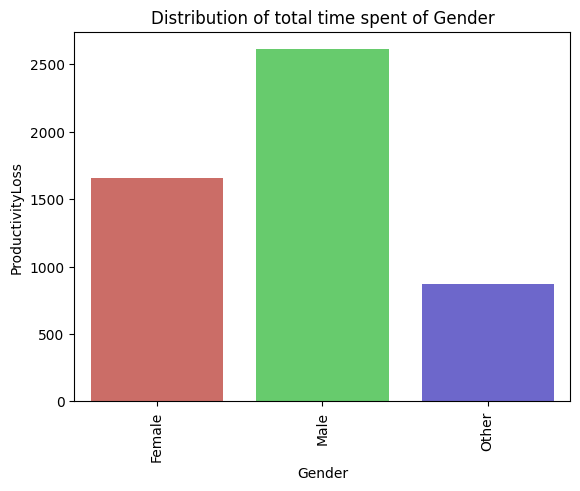

Average ProductivityLoss by different groups of Gender
Gender
Female    5.142857
Male      5.077821
Other     5.304878
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


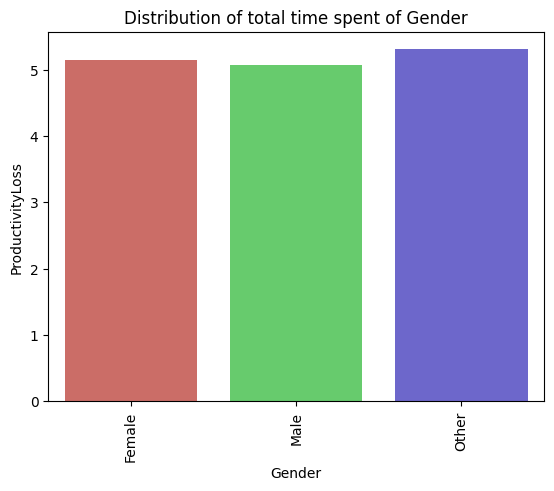

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


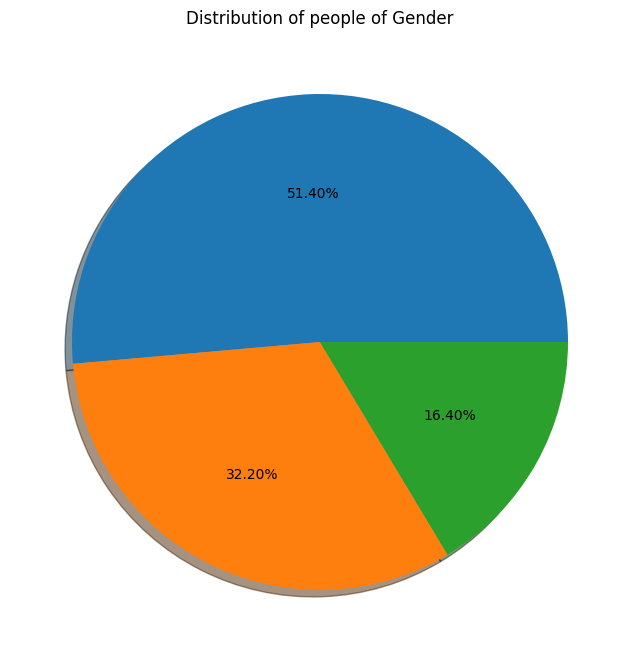

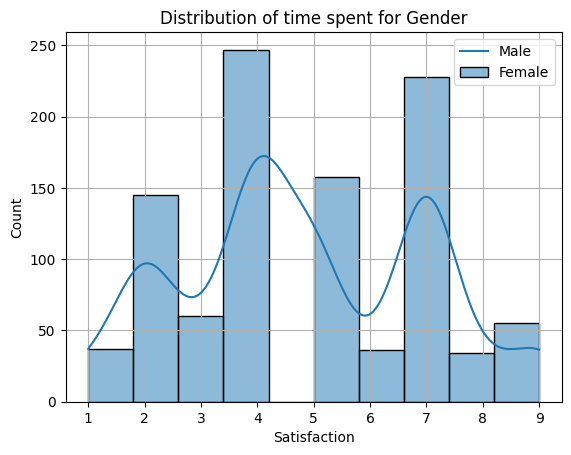

Total Satisfaction by different groups of Gender
Gender
Female    1564
Male      2530
Other      770
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


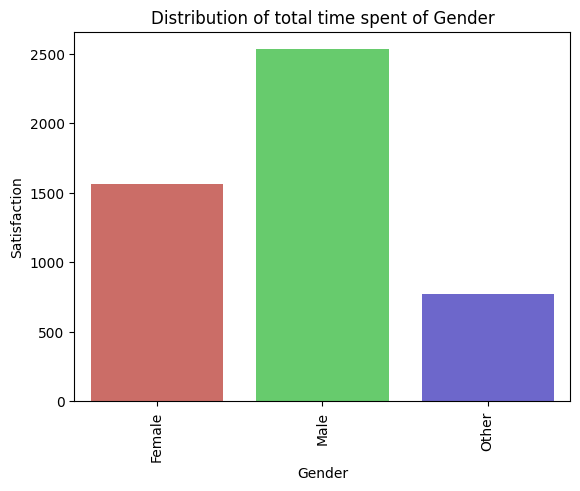

Average Satisfaction by different groups of Gender
Gender
Female    4.857143
Male      4.922179
Other     4.695122
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


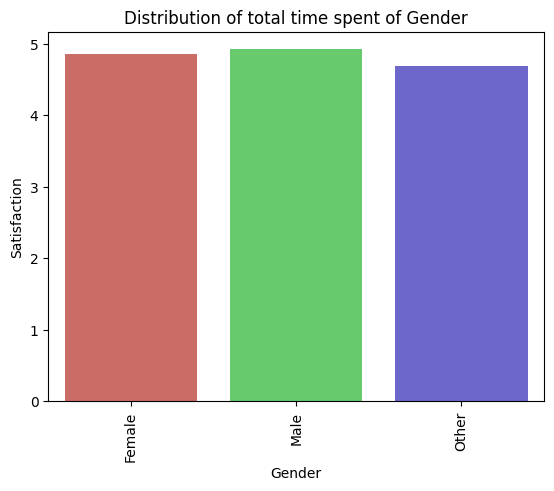

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


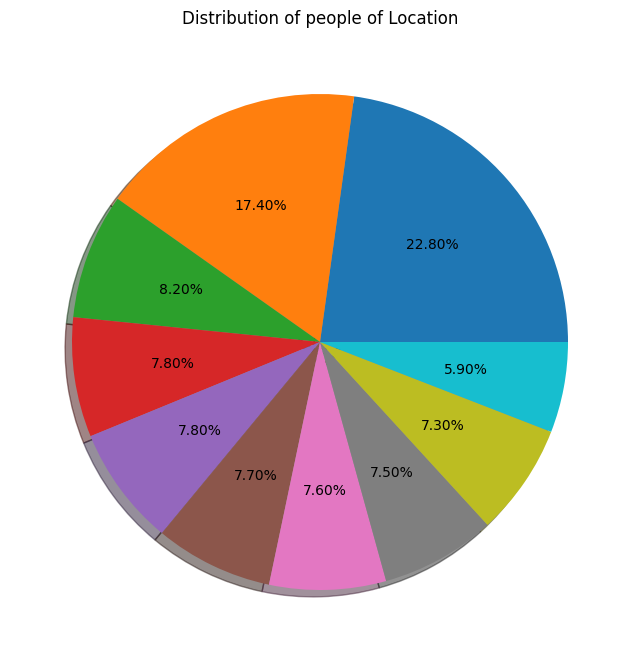

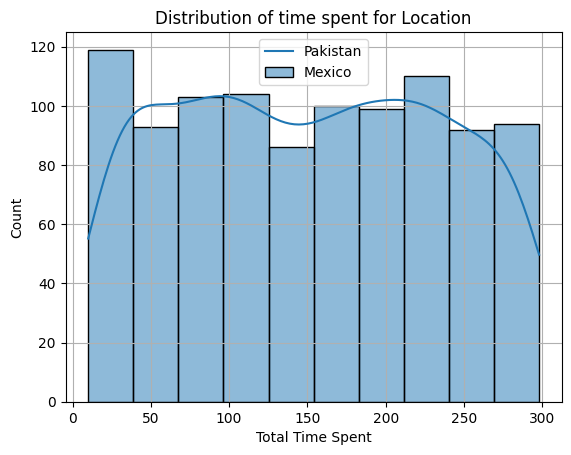

Total Total Time Spent by different groups of Location
Location
Barzil           11400
Germany           7723
India            34465
Indonesia        11329
Japan            12275
Mexico           11720
Pakistan         11921
Philippines      12798
United States    26371
Vietnam          11404
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


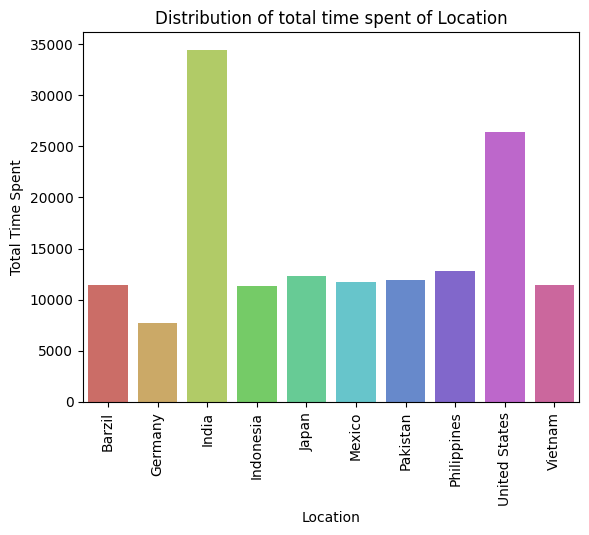

Average Total Time Spent by different groups of Location
Location
Barzil           146.153846
Germany          130.898305
India            151.162281
Indonesia        147.129870
Japan            163.666667
Mexico           160.547945
Pakistan         156.855263
Philippines      164.076923
United States    151.557471
Vietnam          139.073171
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


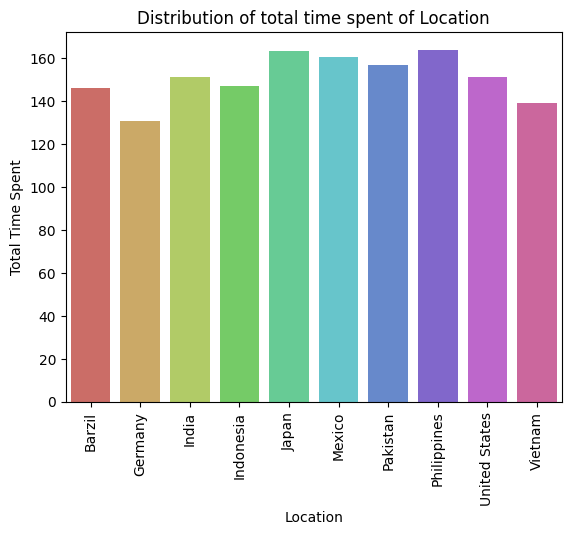

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


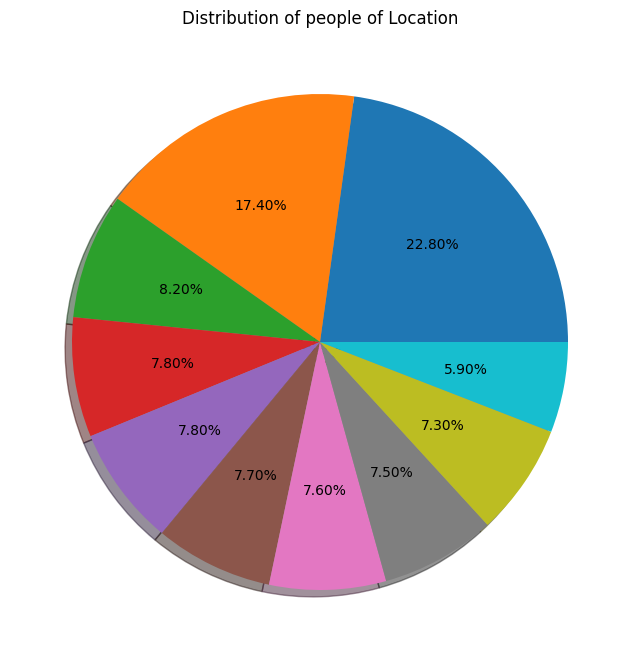

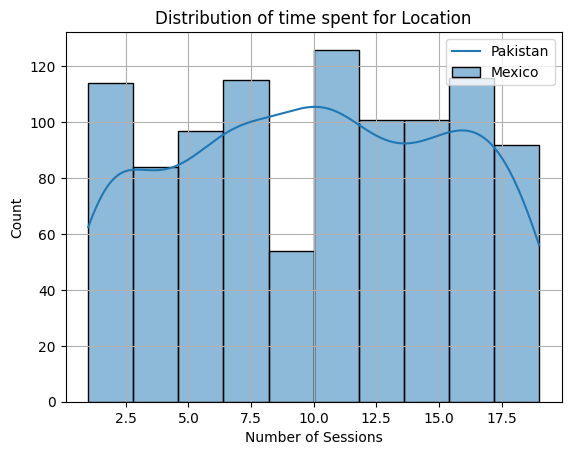

Total Number of Sessions by different groups of Location
Location
Barzil            817
Germany           616
India            2458
Indonesia         745
Japan             709
Mexico            669
Pakistan          751
Philippines       817
United States    1682
Vietnam           749
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


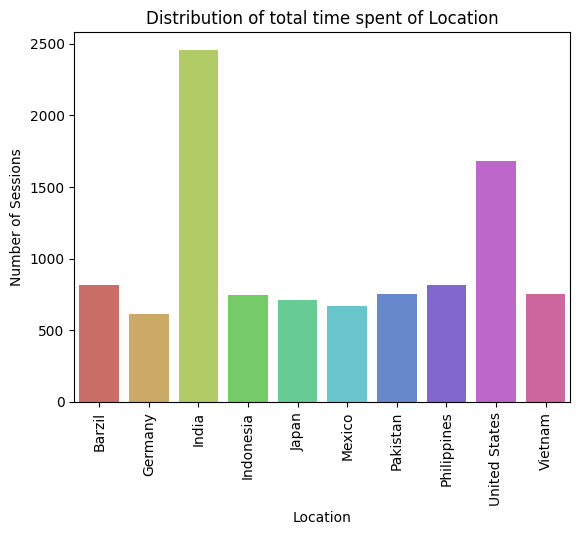

Average Number of Sessions by different groups of Location
Location
Barzil           10.474359
Germany          10.440678
India            10.780702
Indonesia         9.675325
Japan             9.453333
Mexico            9.164384
Pakistan          9.881579
Philippines      10.474359
United States     9.666667
Vietnam           9.134146
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


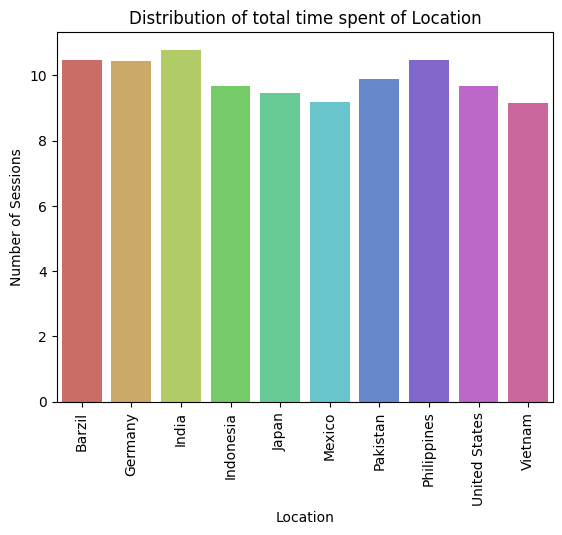

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


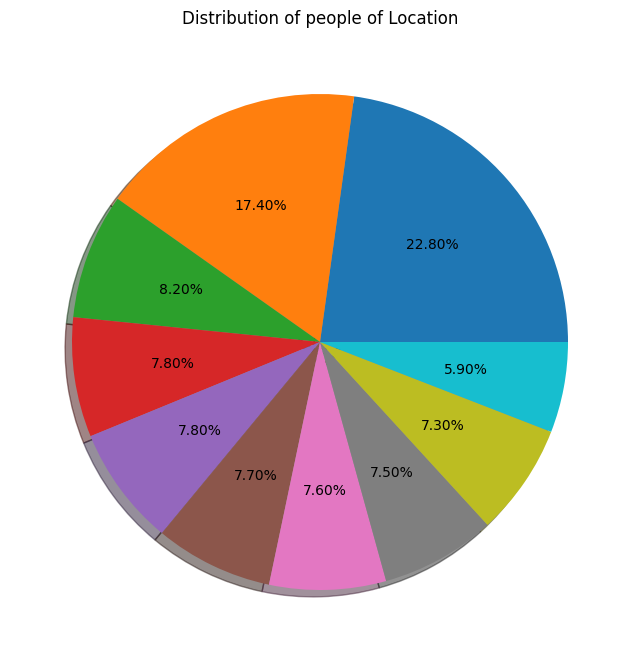

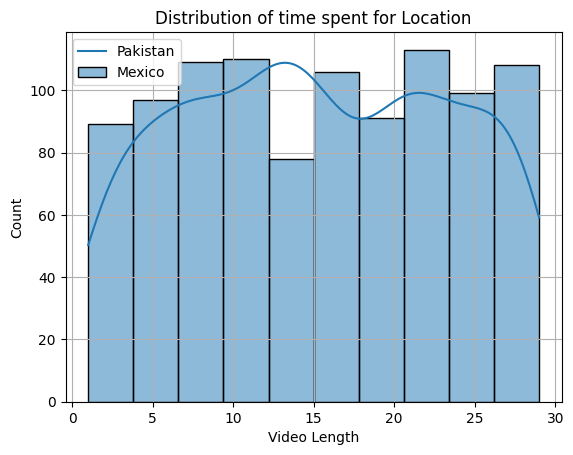

Total Video Length by different groups of Location
Location
Barzil           1157
Germany           871
India            3512
Indonesia        1110
Japan            1198
Mexico           1148
Pakistan         1068
Philippines      1210
United States    2703
Vietnam          1237
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


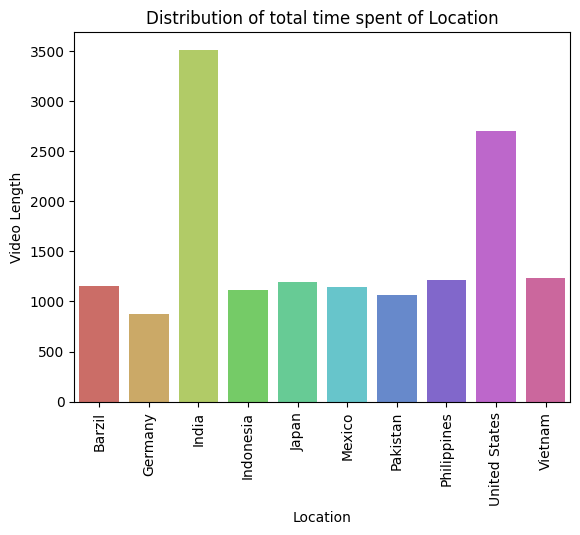

Average Video Length by different groups of Location
Location
Barzil           14.833333
Germany          14.762712
India            15.403509
Indonesia        14.415584
Japan            15.973333
Mexico           15.726027
Pakistan         14.052632
Philippines      15.512821
United States    15.534483
Vietnam          15.085366
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


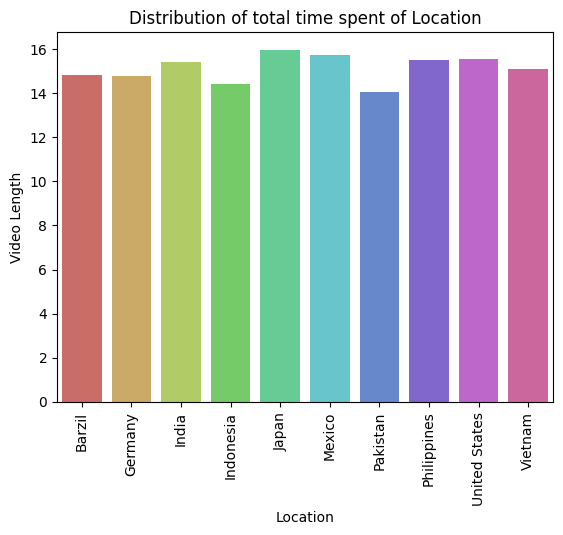

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


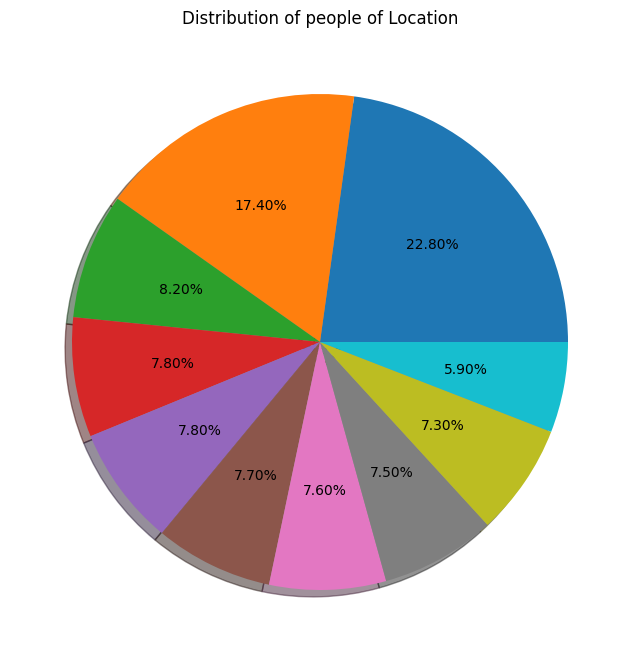

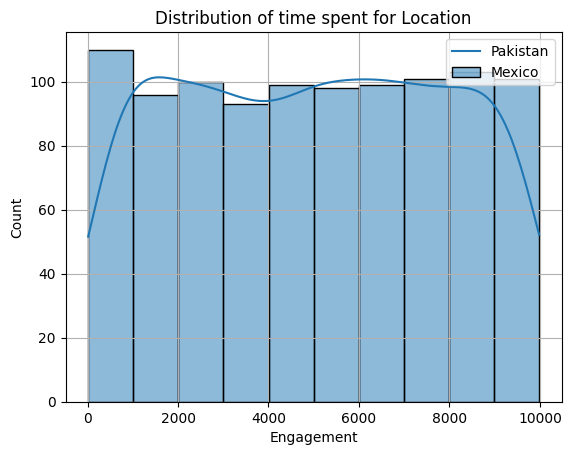

Total Engagement by different groups of Location
Location
Barzil            334275
Germany           270448
India            1089647
Indonesia         416197
Japan             373960
Mexico            381918
Pakistan          404044
Philippines       386353
United States     880195
Vietnam           460122
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


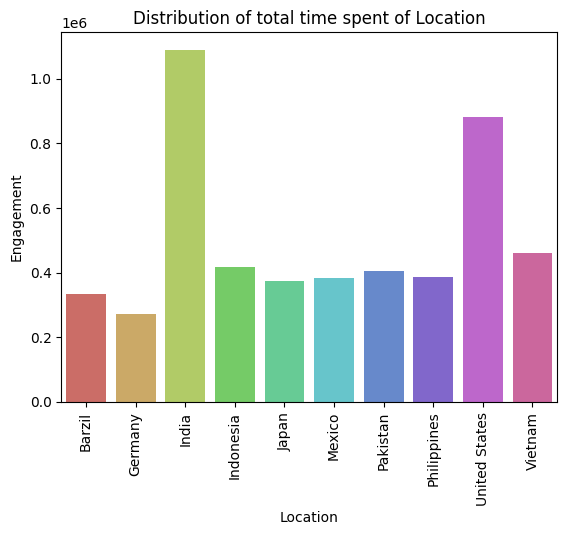

Average Engagement by different groups of Location
Location
Barzil           4285.576923
Germany          4583.864407
India            4779.153509
Indonesia        5405.155844
Japan            4986.133333
Mexico           5231.753425
Pakistan         5316.368421
Philippines      4953.243590
United States    5058.591954
Vietnam          5611.243902
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


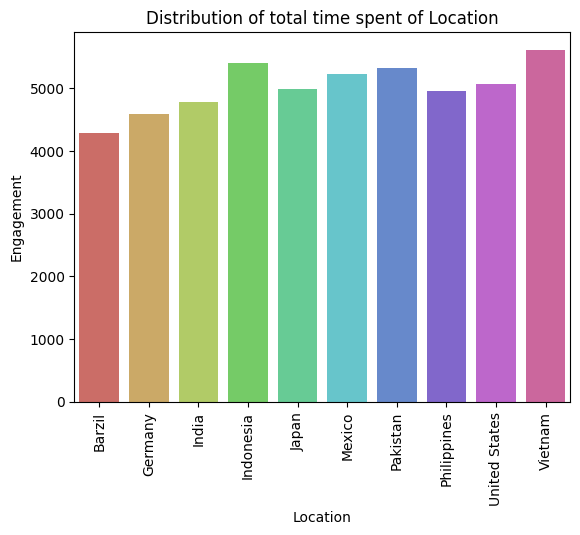

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


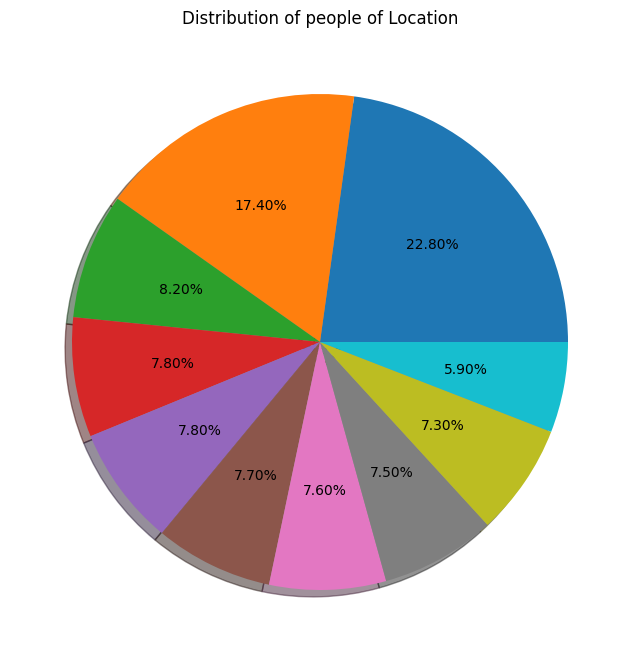

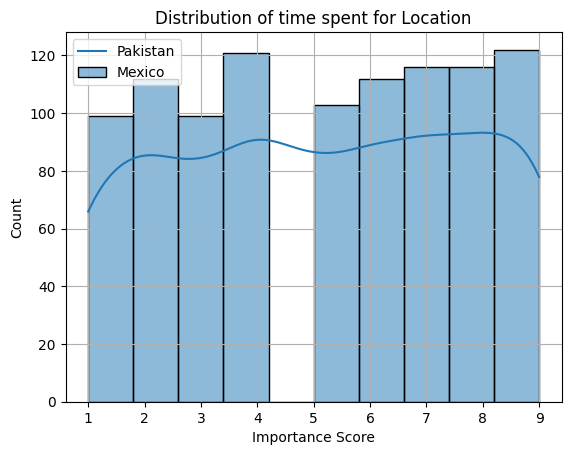

Total Importance Score by different groups of Location
Location
Barzil            374
Germany           281
India            1120
Indonesia         429
Japan             405
Mexico            376
Pakistan          386
Philippines       422
United States     921
Vietnam           415
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


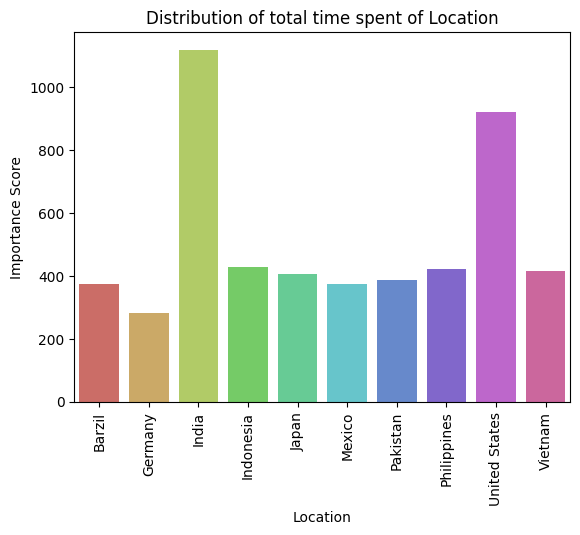

Average Importance Score by different groups of Location
Location
Barzil           4.794872
Germany          4.762712
India            4.912281
Indonesia        5.571429
Japan            5.400000
Mexico           5.150685
Pakistan         5.078947
Philippines      5.410256
United States    5.293103
Vietnam          5.060976
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


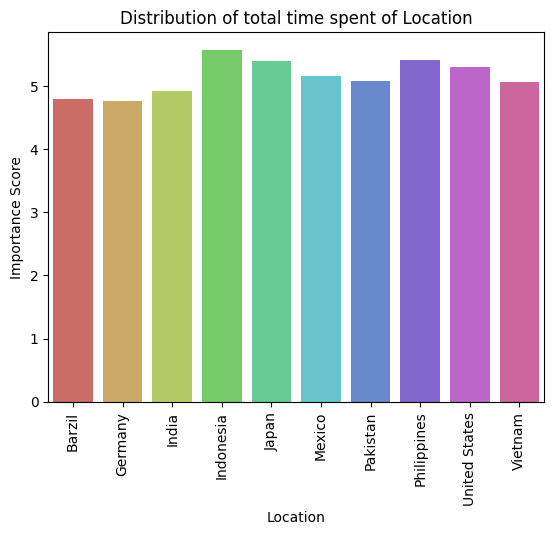

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


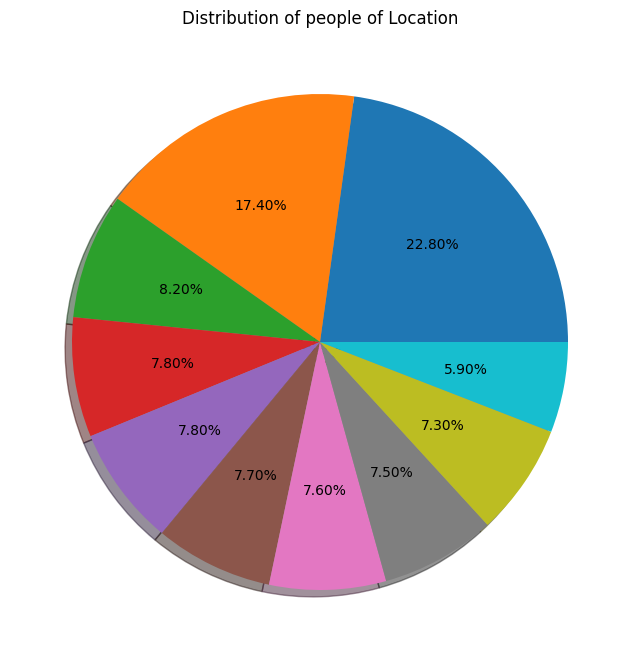

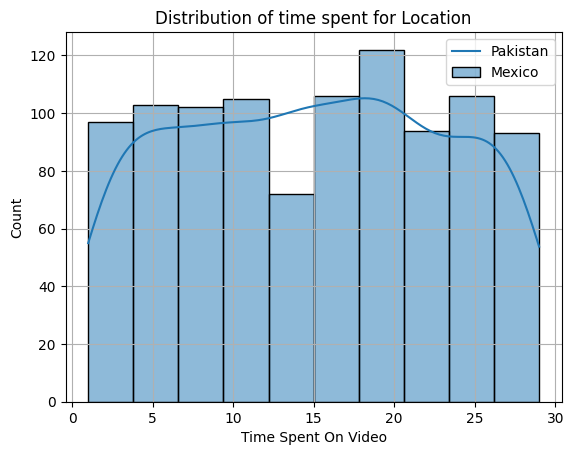

Total Time Spent On Video by different groups of Location
Location
Barzil           1081
Germany           942
India            3550
Indonesia        1044
Japan            1143
Mexico           1041
Pakistan         1225
Philippines      1126
United States    2547
Vietnam          1274
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


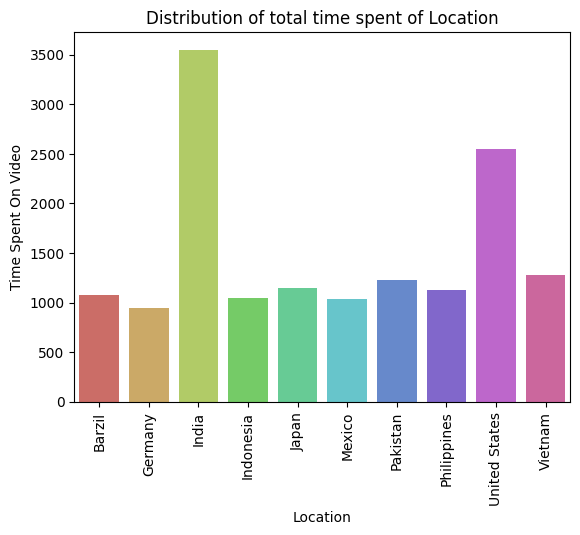

Average Time Spent On Video by different groups of Location
Location
Barzil           13.858974
Germany          15.966102
India            15.570175
Indonesia        13.558442
Japan            15.240000
Mexico           14.260274
Pakistan         16.118421
Philippines      14.435897
United States    14.637931
Vietnam          15.536585
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


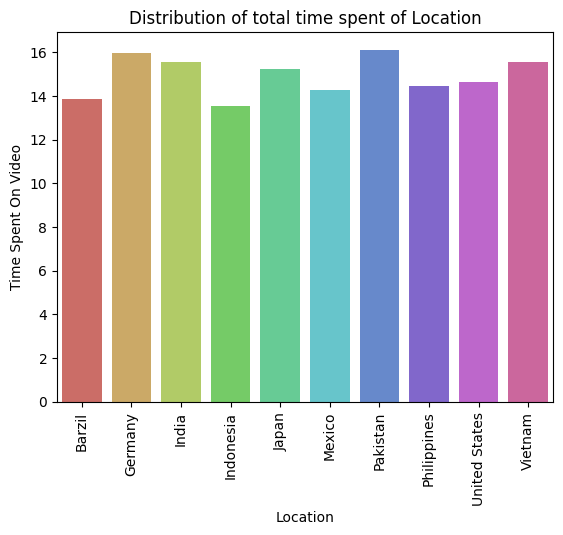

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


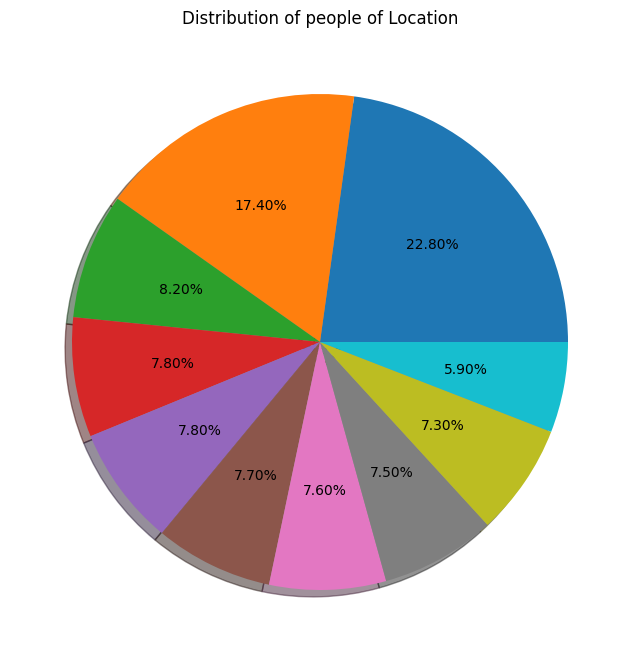

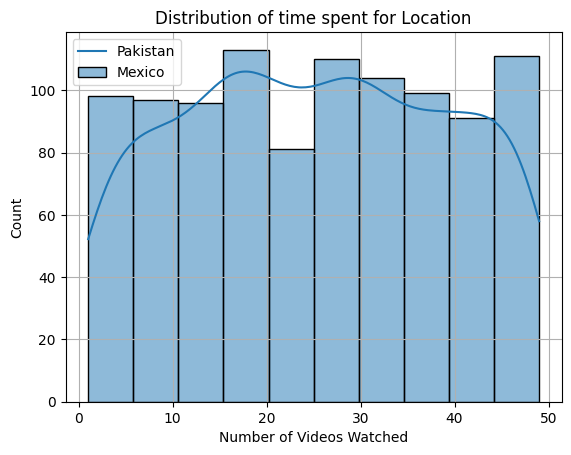

Total Number of Videos Watched by different groups of Location
Location
Barzil           2129
Germany          1441
India            5670
Indonesia        2147
Japan            1987
Mexico           1682
Pakistan         2009
Philippines      1893
United States    4554
Vietnam          1736
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


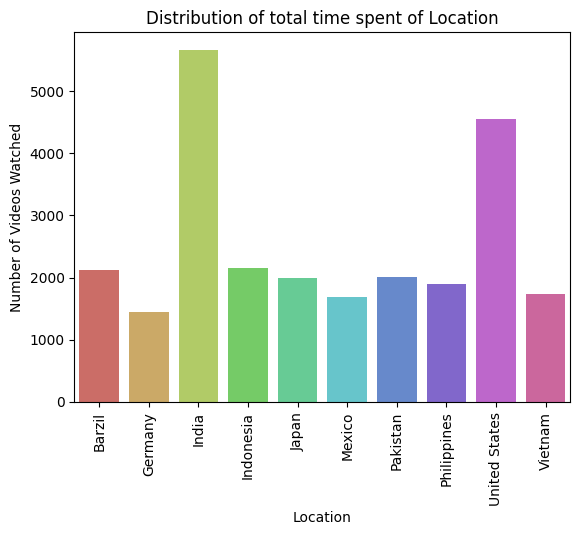

Average Number of Videos Watched by different groups of Location
Location
Barzil           27.294872
Germany          24.423729
India            24.868421
Indonesia        27.883117
Japan            26.493333
Mexico           23.041096
Pakistan         26.434211
Philippines      24.269231
United States    26.172414
Vietnam          21.170732
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


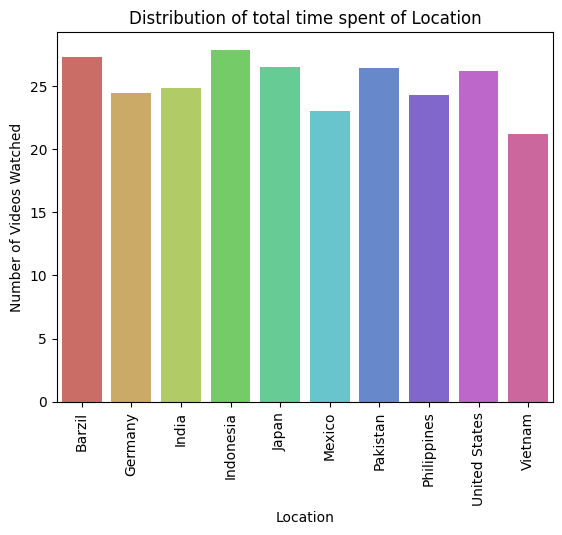

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


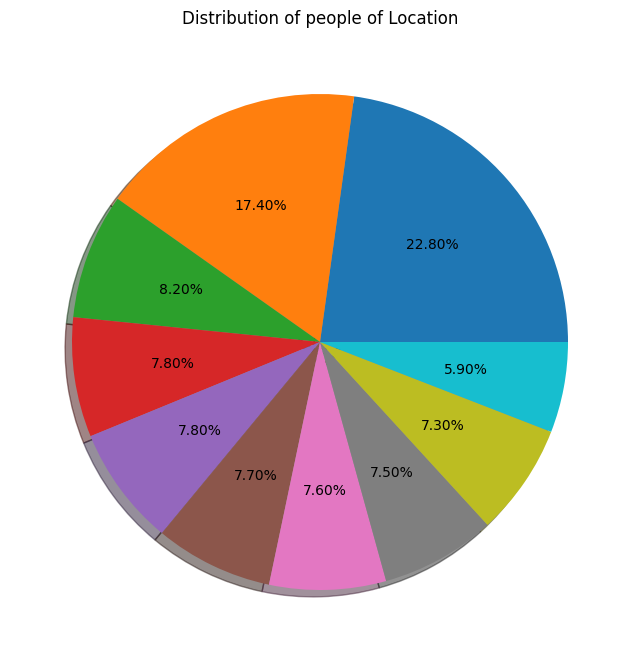

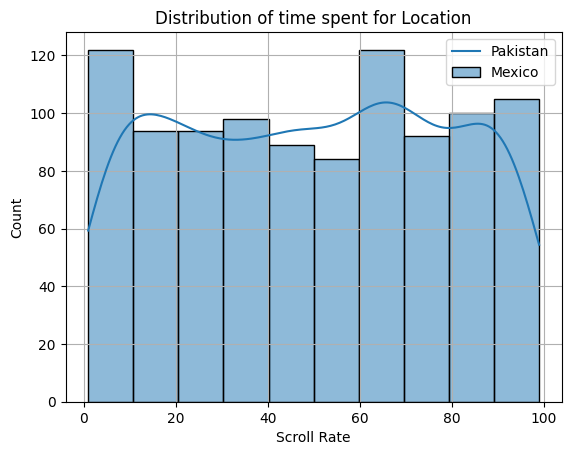

Total Scroll Rate by different groups of Location
Location
Barzil            3712
Germany           2913
India            11195
Indonesia         3769
Japan             3569
Mexico            4215
Pakistan          3735
Philippines       4276
United States     8552
Vietnam           3838
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


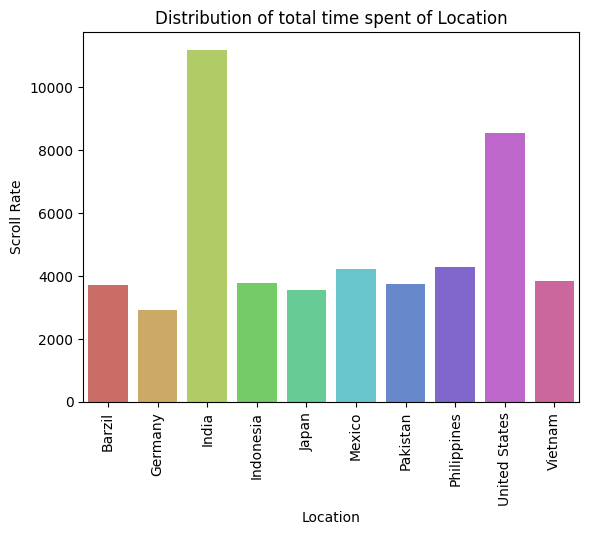

Average Scroll Rate by different groups of Location
Location
Barzil           47.589744
Germany          49.372881
India            49.100877
Indonesia        48.948052
Japan            47.586667
Mexico           57.739726
Pakistan         49.144737
Philippines      54.820513
United States    49.149425
Vietnam          46.804878
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


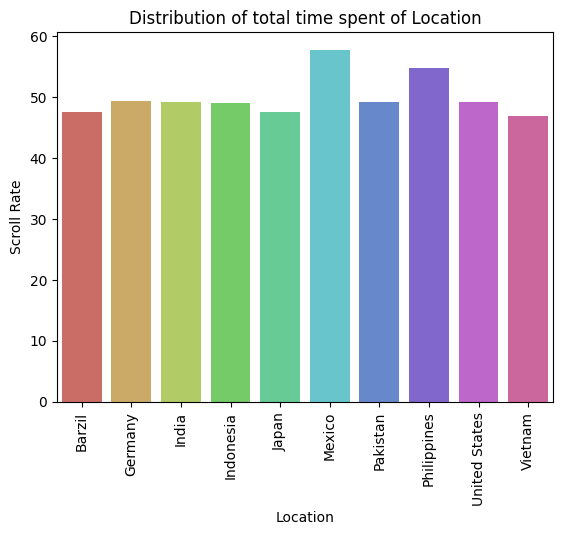

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


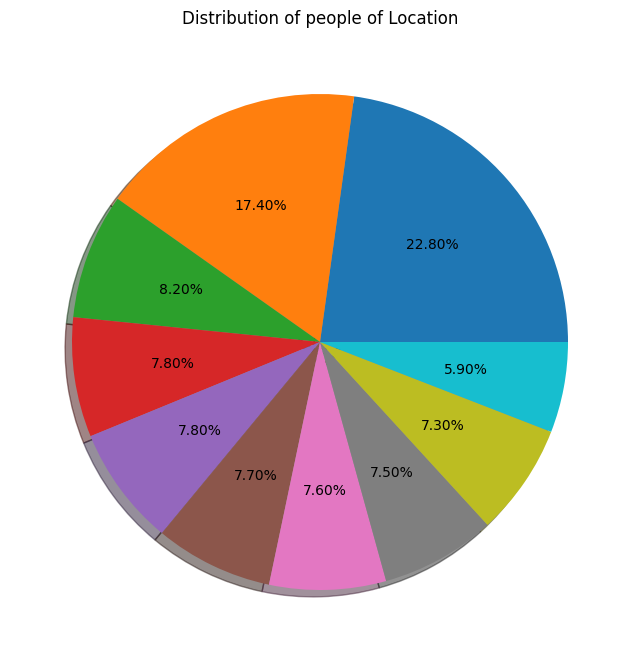

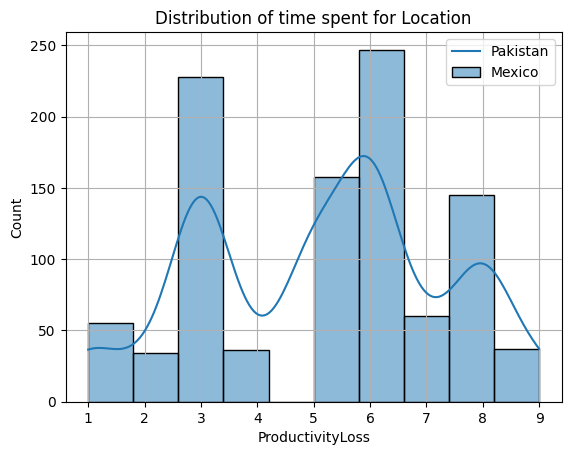

Total ProductivityLoss by different groups of Location
Location
Barzil            353
Germany           289
India            1169
Indonesia         407
Japan             410
Mexico            373
Pakistan          416
Philippines       398
United States     875
Vietnam           446
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


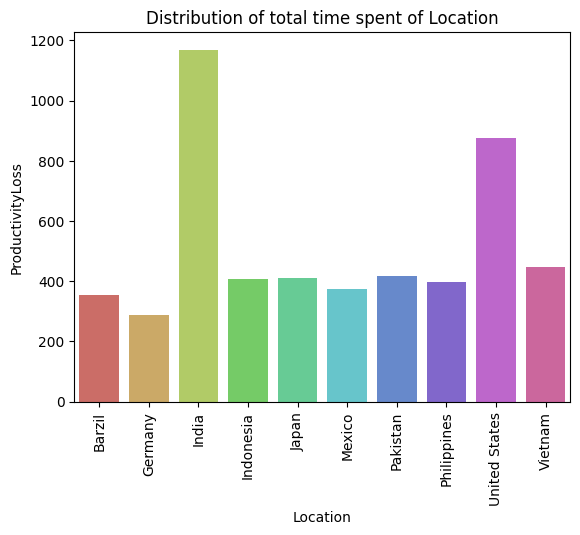

Average ProductivityLoss by different groups of Location
Location
Barzil           4.525641
Germany          4.898305
India            5.127193
Indonesia        5.285714
Japan            5.466667
Mexico           5.109589
Pakistan         5.473684
Philippines      5.102564
United States    5.028736
Vietnam          5.439024
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


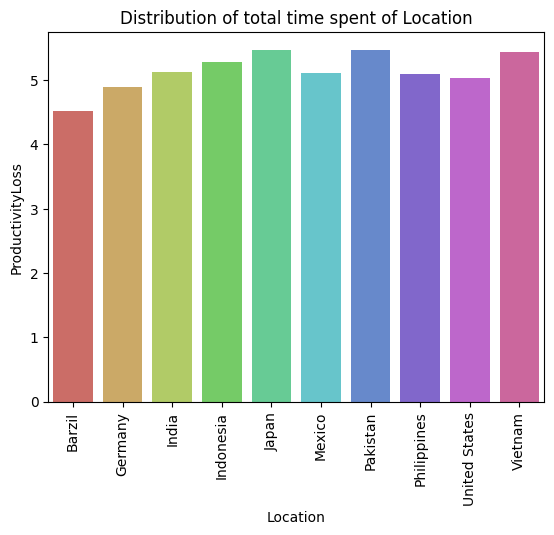

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


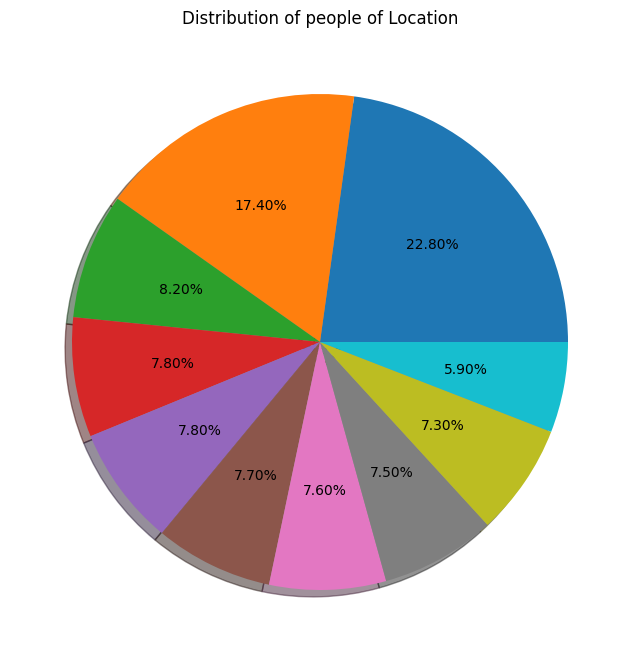

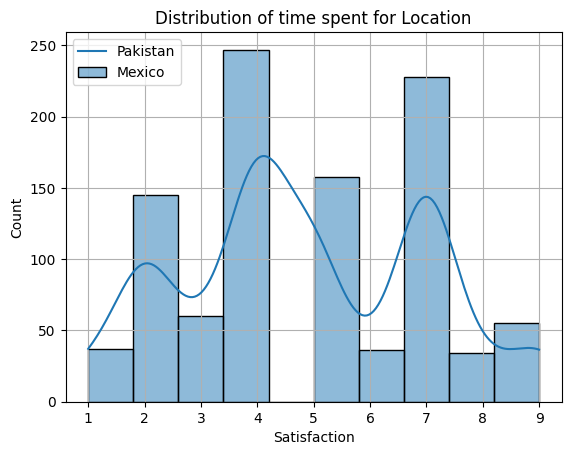

Total Satisfaction by different groups of Location
Location
Barzil            427
Germany           301
India            1111
Indonesia         363
Japan             340
Mexico            357
Pakistan          344
Philippines       382
United States     865
Vietnam           374
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


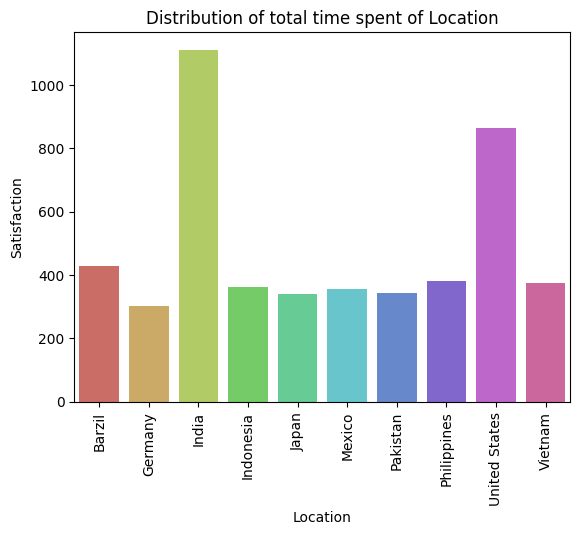

Average Satisfaction by different groups of Location
Location
Barzil           5.474359
Germany          5.101695
India            4.872807
Indonesia        4.714286
Japan            4.533333
Mexico           4.890411
Pakistan         4.526316
Philippines      4.897436
United States    4.971264
Vietnam          4.560976
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


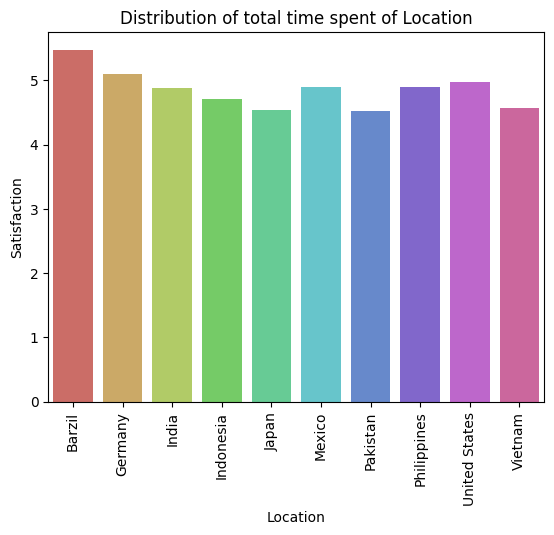

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


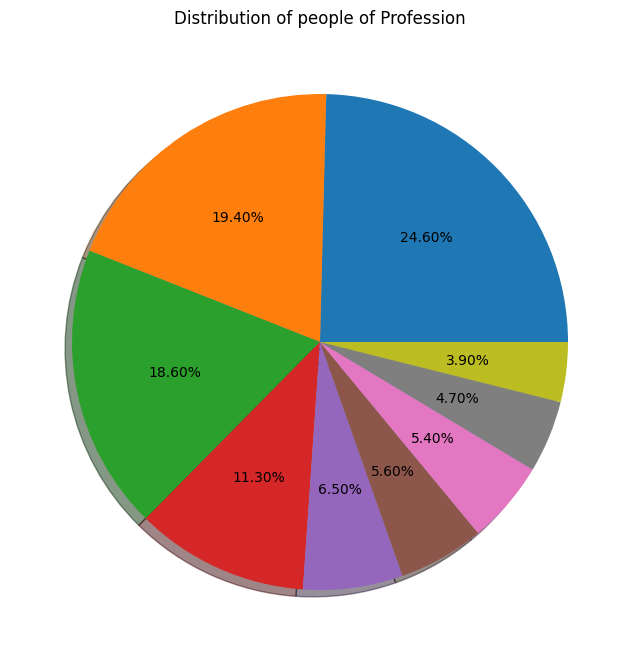

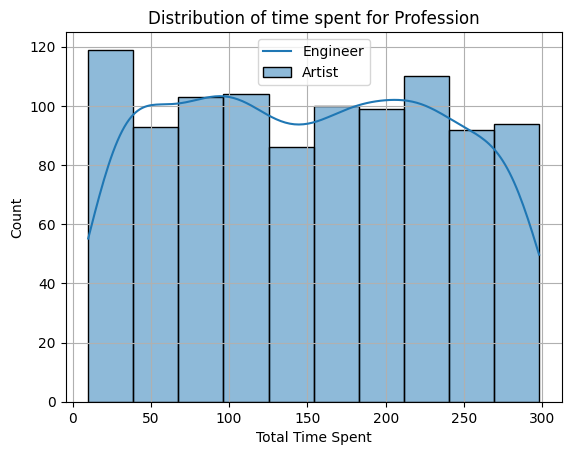

Total Total Time Spent by different groups of Profession
Profession
Artist            7190
Cashier           9570
Engineer          9560
Labor/Worker     28924
Manager           8234
Students         36639
Teacher           5812
Waiting staff    28621
driver           16856
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


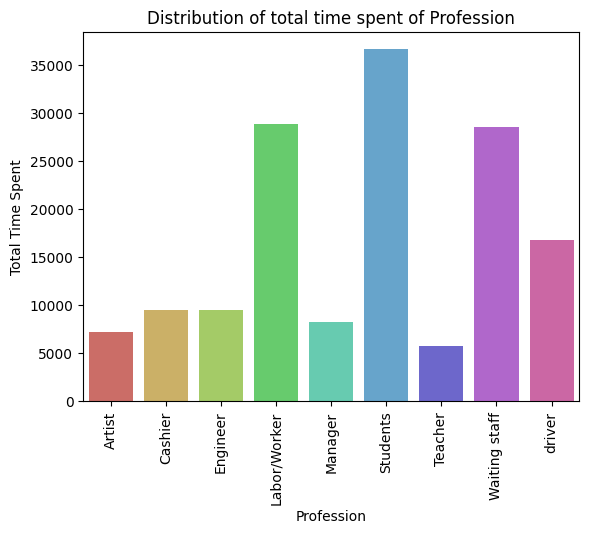

Average Total Time Spent by different groups of Profession
Profession
Artist           152.978723
Cashier          170.892857
Engineer         147.076923
Labor/Worker     155.505376
Manager          152.481481
Students         148.939024
Teacher          149.025641
Waiting staff    147.530928
driver           149.168142
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


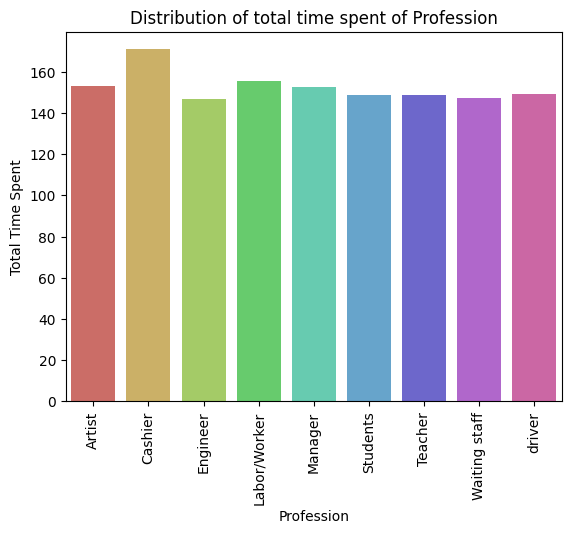

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


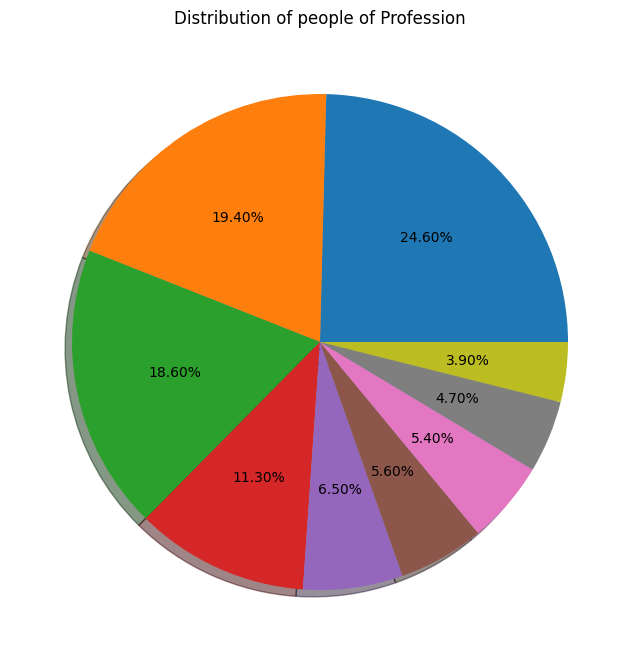

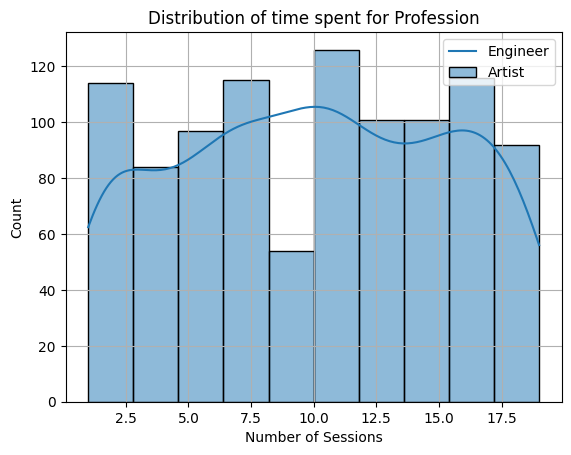

Total Number of Sessions by different groups of Profession
Profession
Artist            487
Cashier           535
Engineer          663
Labor/Worker     1880
Manager           481
Students         2421
Teacher           397
Waiting staff    2037
driver           1112
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


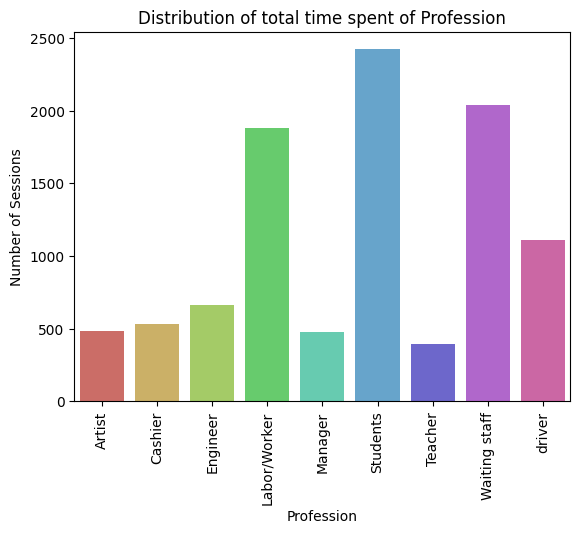

Average Number of Sessions by different groups of Profession
Profession
Artist           10.361702
Cashier           9.553571
Engineer         10.200000
Labor/Worker     10.107527
Manager           8.907407
Students          9.841463
Teacher          10.179487
Waiting staff    10.500000
driver            9.840708
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


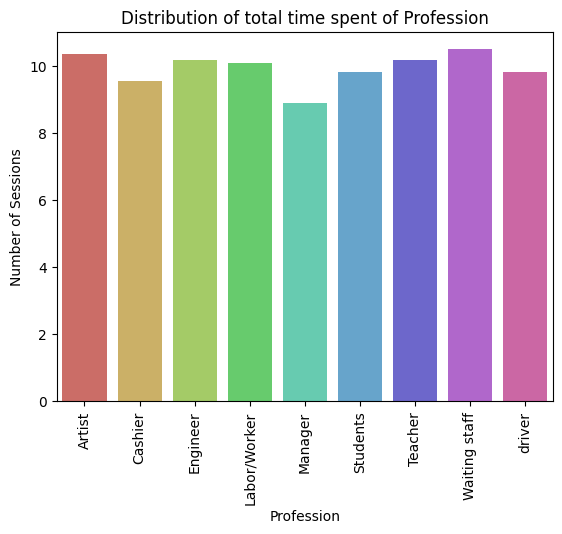

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


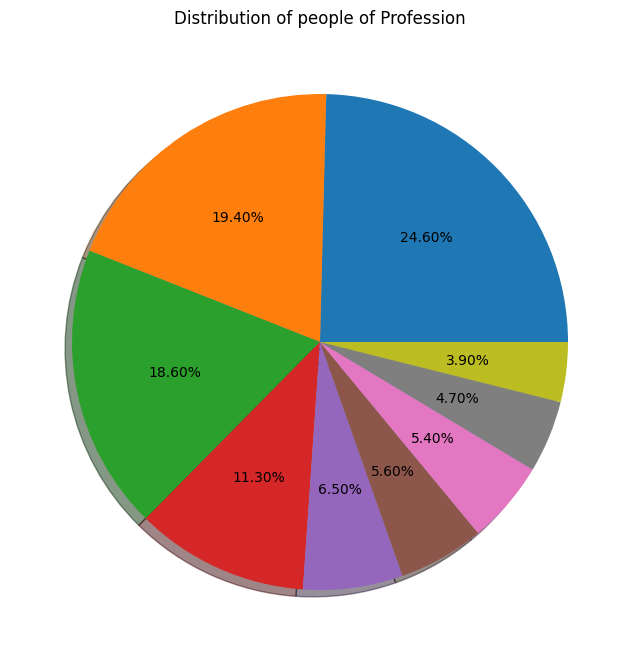

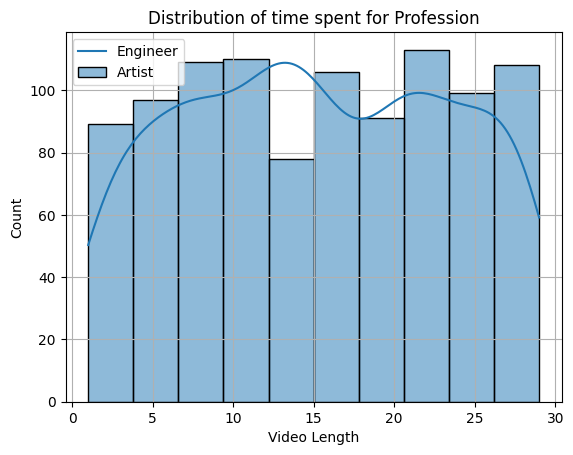

Total Video Length by different groups of Profession
Profession
Artist            780
Cashier           806
Engineer          958
Labor/Worker     2785
Manager           895
Students         3652
Teacher           552
Waiting staff    3062
driver           1724
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


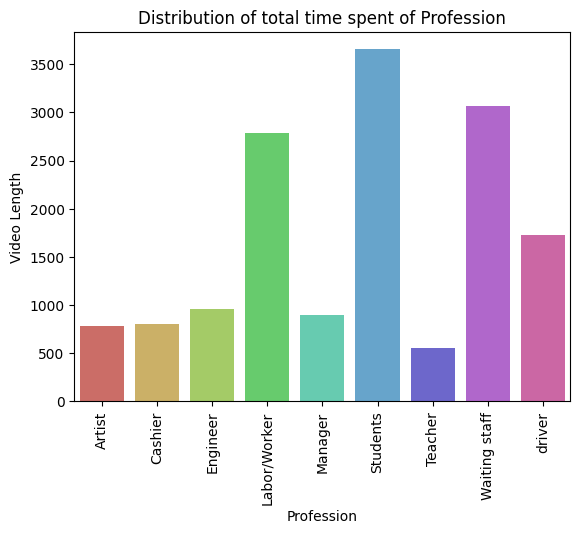

Average Video Length by different groups of Profession
Profession
Artist           16.595745
Cashier          14.392857
Engineer         14.738462
Labor/Worker     14.973118
Manager          16.574074
Students         14.845528
Teacher          14.153846
Waiting staff    15.783505
driver           15.256637
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


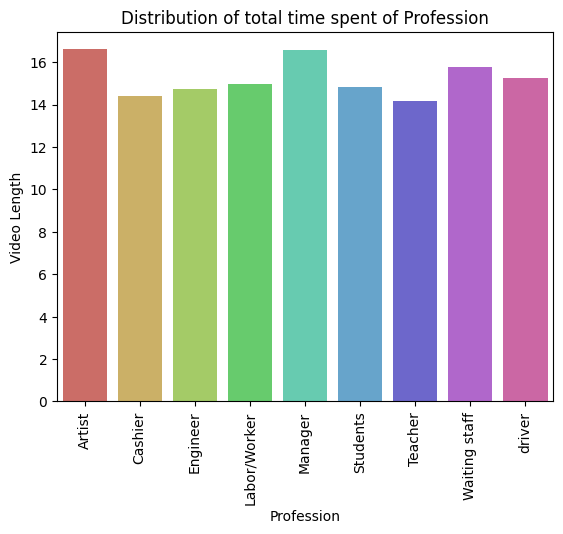

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


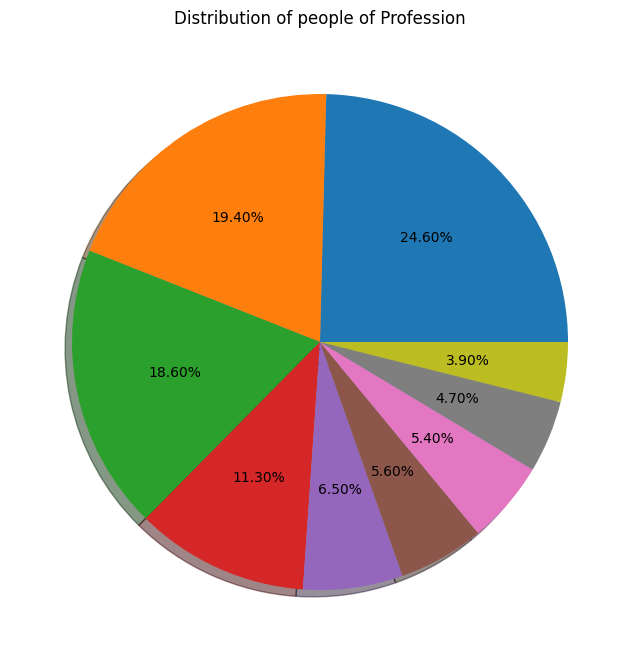

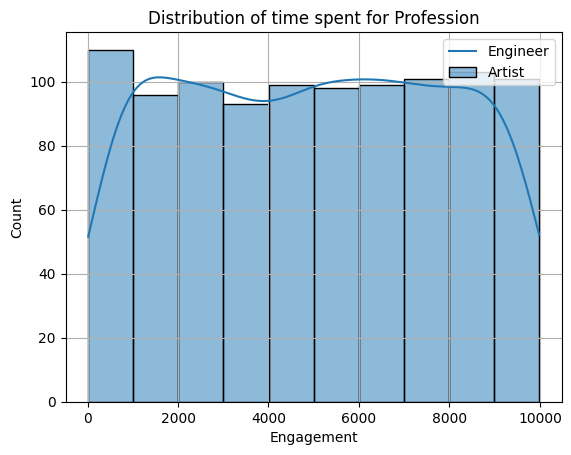

Total Engagement by different groups of Profession
Profession
Artist            223521
Cashier           298853
Engineer          293330
Labor/Worker      922268
Manager           295210
Students         1199763
Teacher           195460
Waiting staff    1024483
driver            544271
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


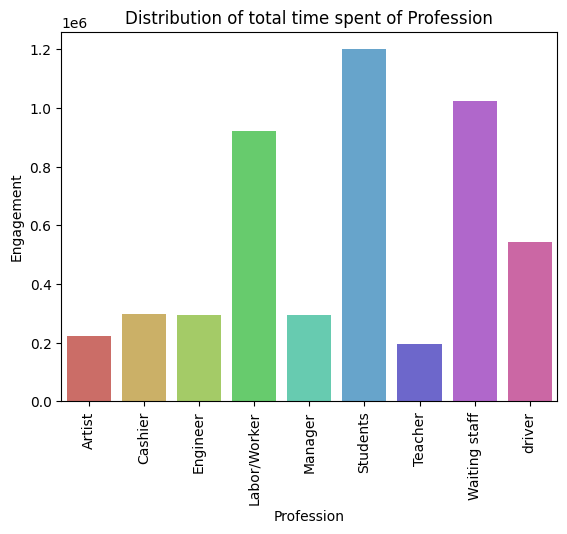

Average Engagement by different groups of Profession
Profession
Artist           4755.765957
Cashier          5336.660714
Engineer         4512.769231
Labor/Worker     4958.430108
Manager          5466.851852
Students         4877.085366
Teacher          5011.794872
Waiting staff    5280.840206
driver           4816.557522
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


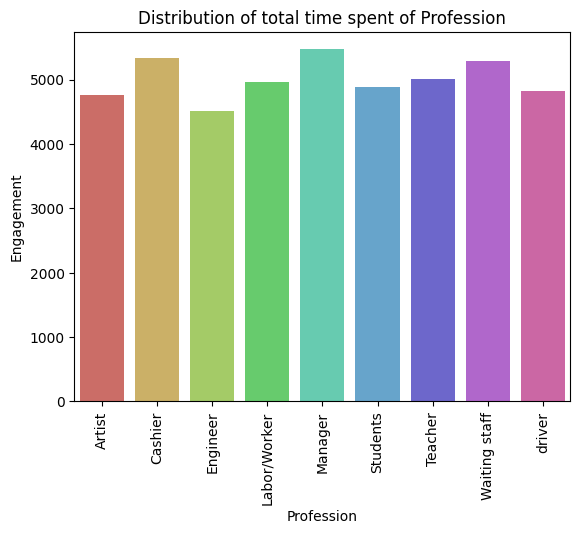

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


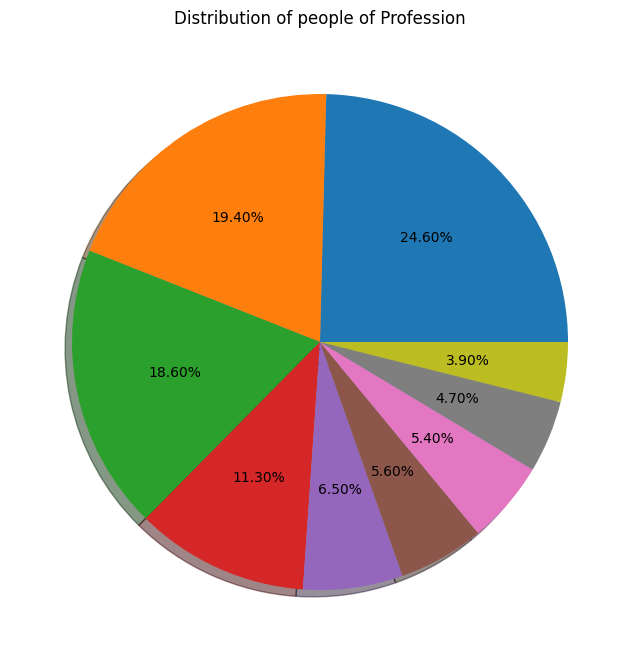

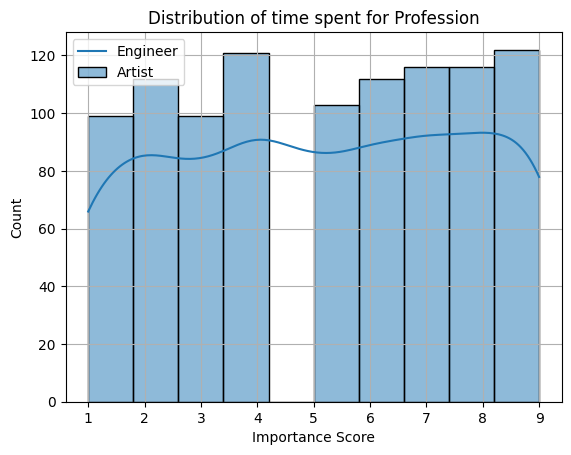

Total Importance Score by different groups of Profession
Profession
Artist            246
Cashier           315
Engineer          338
Labor/Worker      944
Manager           272
Students         1264
Teacher           206
Waiting staff     986
driver            558
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


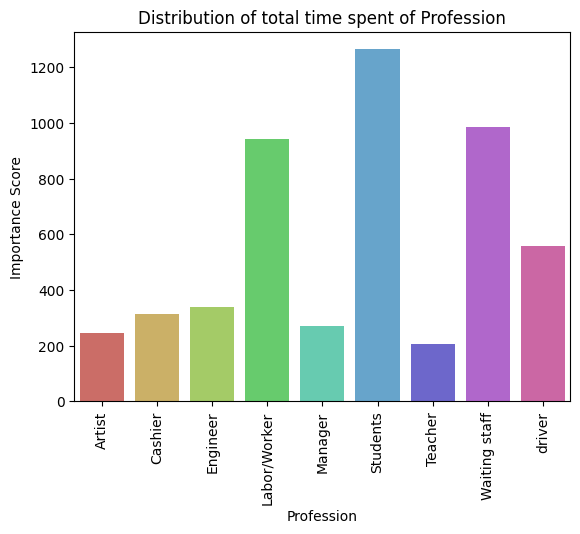

Average Importance Score by different groups of Profession
Profession
Artist           5.234043
Cashier          5.625000
Engineer         5.200000
Labor/Worker     5.075269
Manager          5.037037
Students         5.138211
Teacher          5.282051
Waiting staff    5.082474
driver           4.938053
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


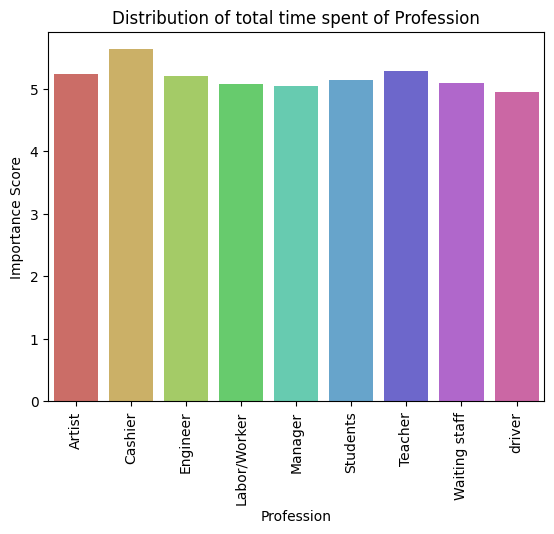

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


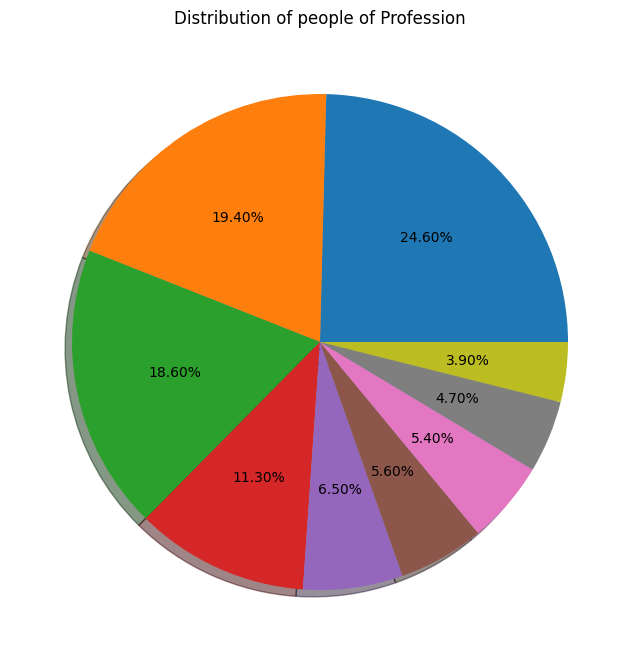

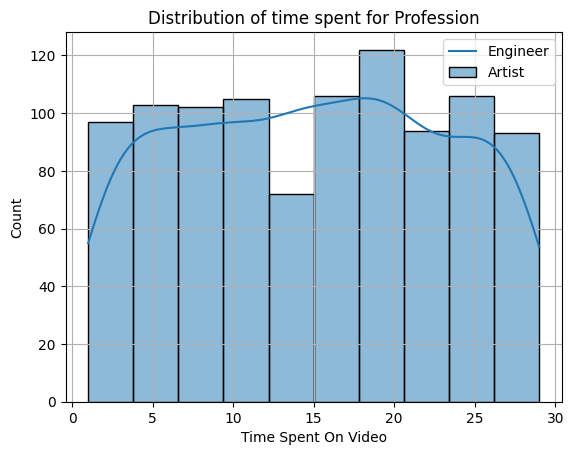

Total Time Spent On Video by different groups of Profession
Profession
Artist            802
Cashier           893
Engineer         1031
Labor/Worker     2781
Manager           849
Students         3526
Teacher           552
Waiting staff    2803
driver           1736
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


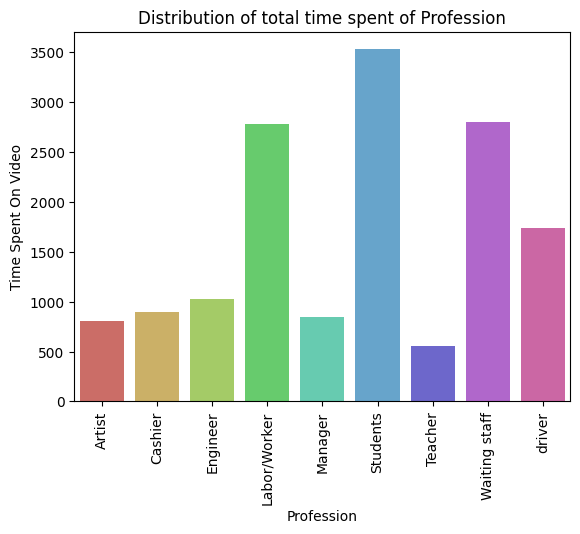

Average Time Spent On Video by different groups of Profession
Profession
Artist           17.063830
Cashier          15.946429
Engineer         15.861538
Labor/Worker     14.951613
Manager          15.722222
Students         14.333333
Teacher          14.153846
Waiting staff    14.448454
driver           15.362832
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


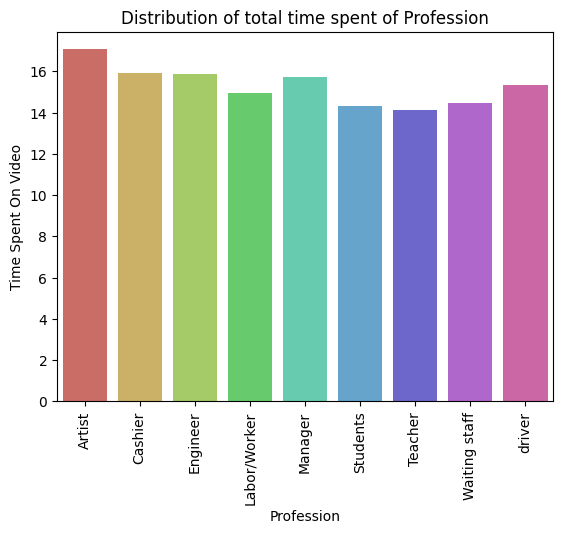

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


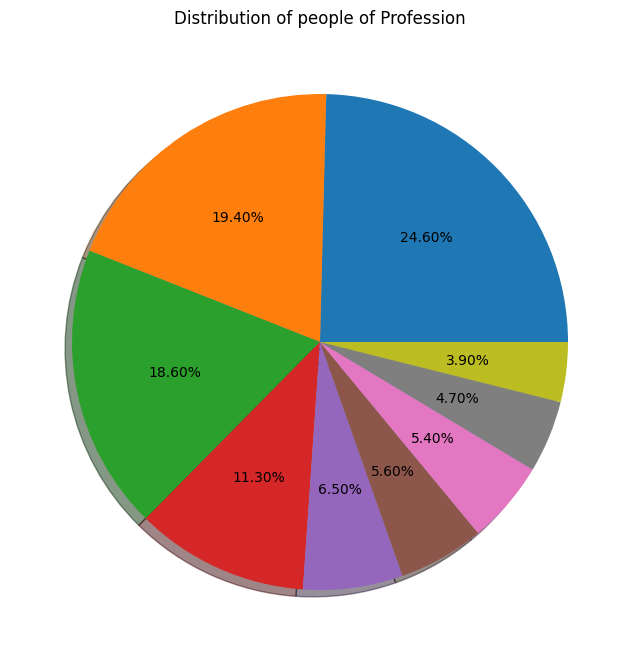

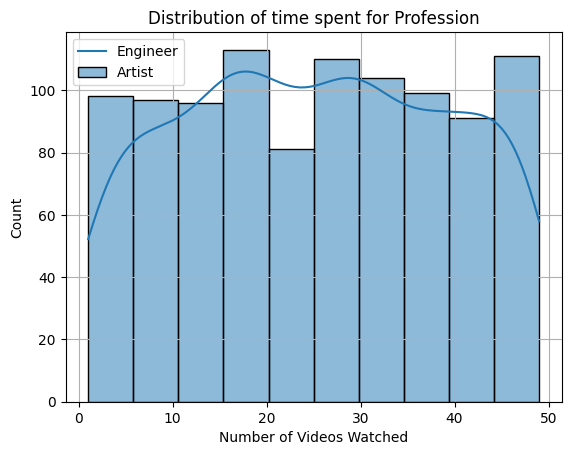

Total Number of Videos Watched by different groups of Profession
Profession
Artist           1318
Cashier          1414
Engineer         1522
Labor/Worker     4786
Manager          1221
Students         6430
Teacher           718
Waiting staff    4900
driver           2939
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


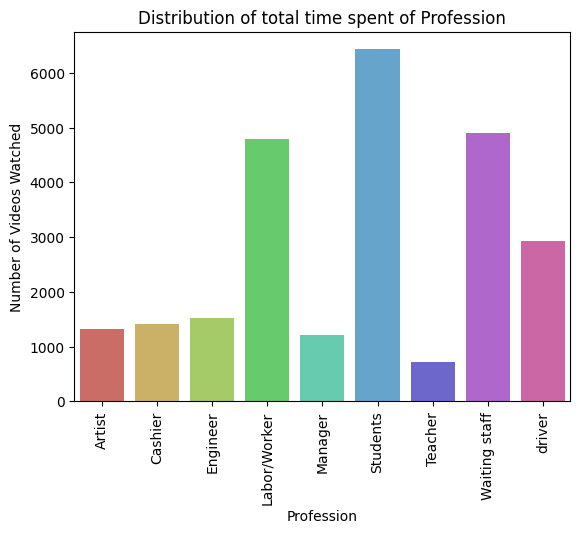

Average Number of Videos Watched by different groups of Profession
Profession
Artist           28.042553
Cashier          25.250000
Engineer         23.415385
Labor/Worker     25.731183
Manager          22.611111
Students         26.138211
Teacher          18.410256
Waiting staff    25.257732
driver           26.008850
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


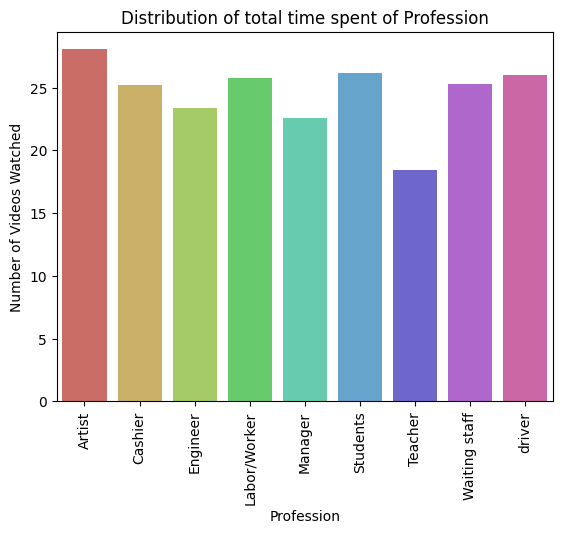

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


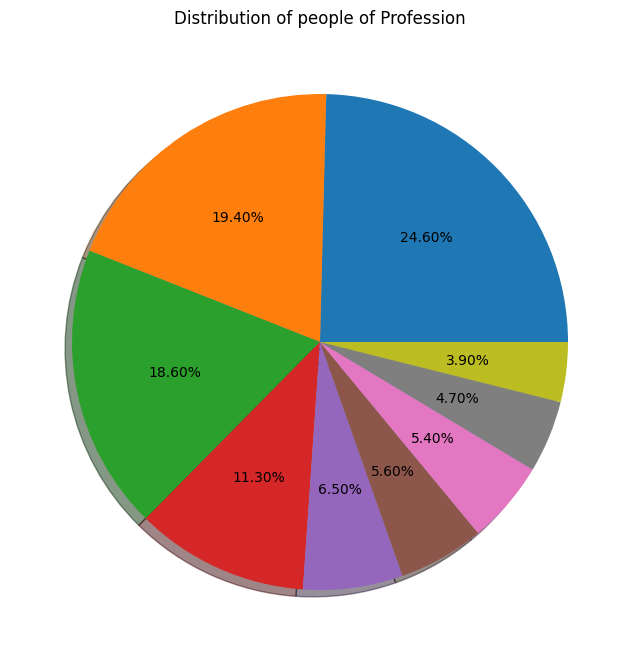

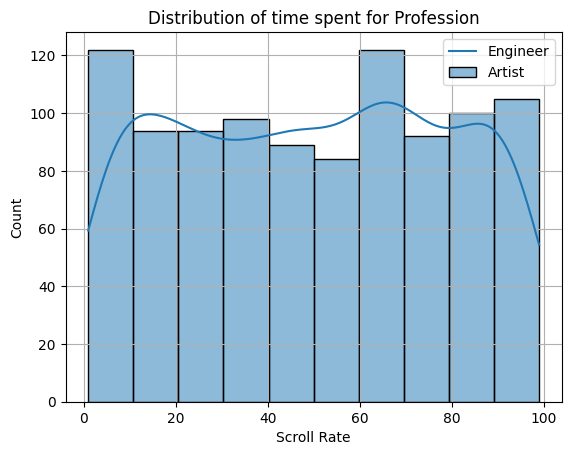

Total Scroll Rate by different groups of Profession
Profession
Artist            1840
Cashier           2894
Engineer          3262
Labor/Worker      9758
Manager           2498
Students         12652
Teacher           1876
Waiting staff     9657
driver            5337
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


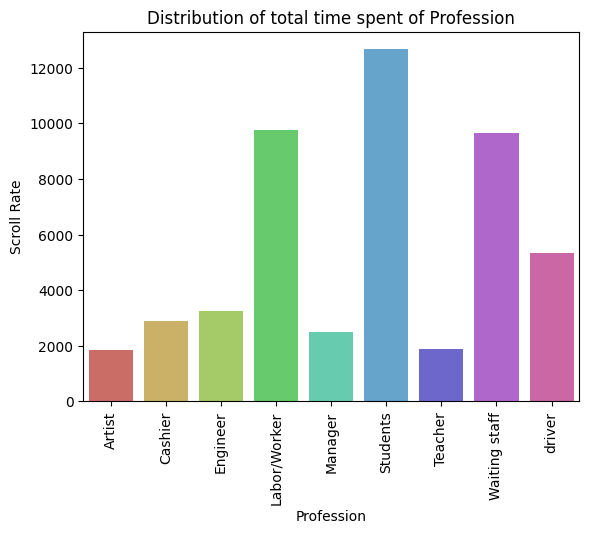

Average Scroll Rate by different groups of Profession
Profession
Artist           39.148936
Cashier          51.678571
Engineer         50.184615
Labor/Worker     52.462366
Manager          46.259259
Students         51.430894
Teacher          48.102564
Waiting staff    49.778351
driver           47.230088
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


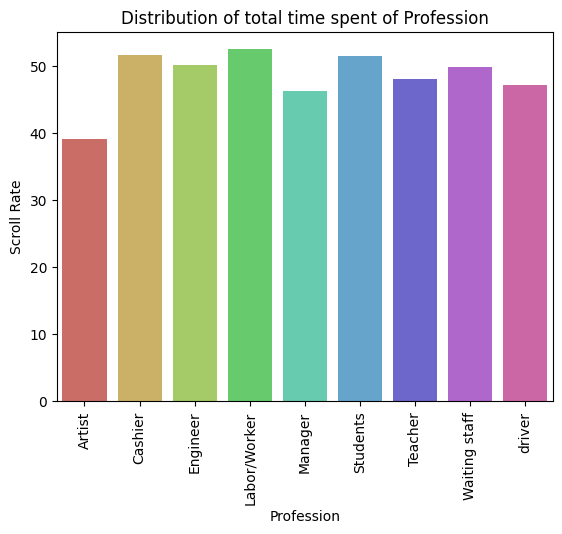

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


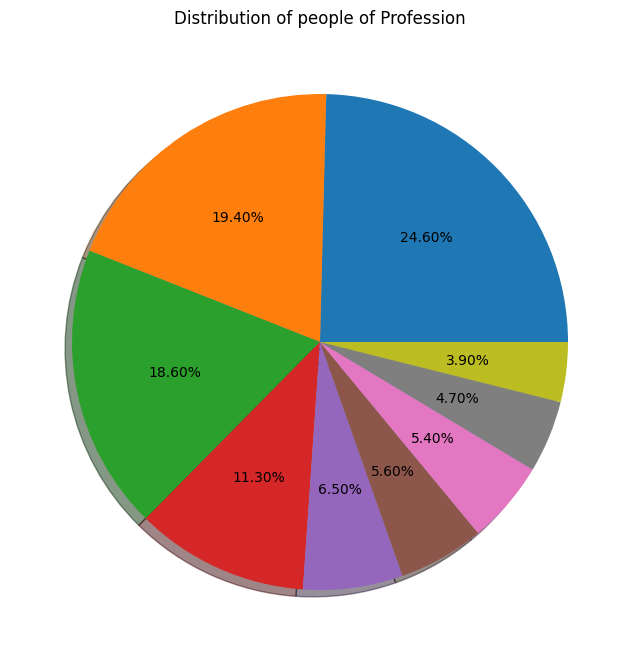

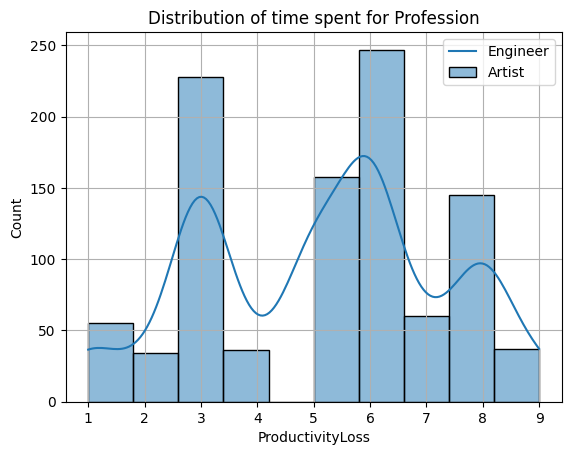

Total ProductivityLoss by different groups of Profession
Profession
Artist            247
Cashier           290
Engineer          334
Labor/Worker      957
Manager           272
Students         1237
Teacher           204
Waiting staff    1031
driver            564
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


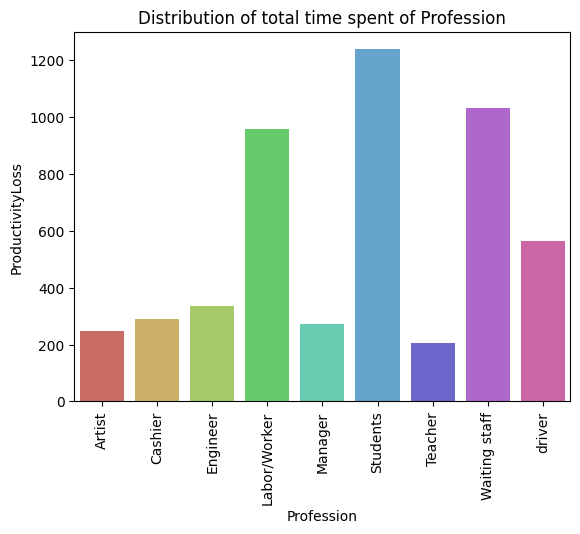

Average ProductivityLoss by different groups of Profession
Profession
Artist           5.255319
Cashier          5.178571
Engineer         5.138462
Labor/Worker     5.145161
Manager          5.037037
Students         5.028455
Teacher          5.230769
Waiting staff    5.314433
driver           4.991150
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


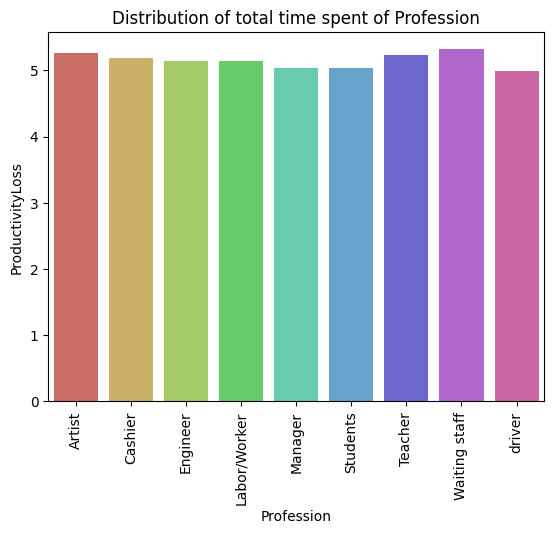

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


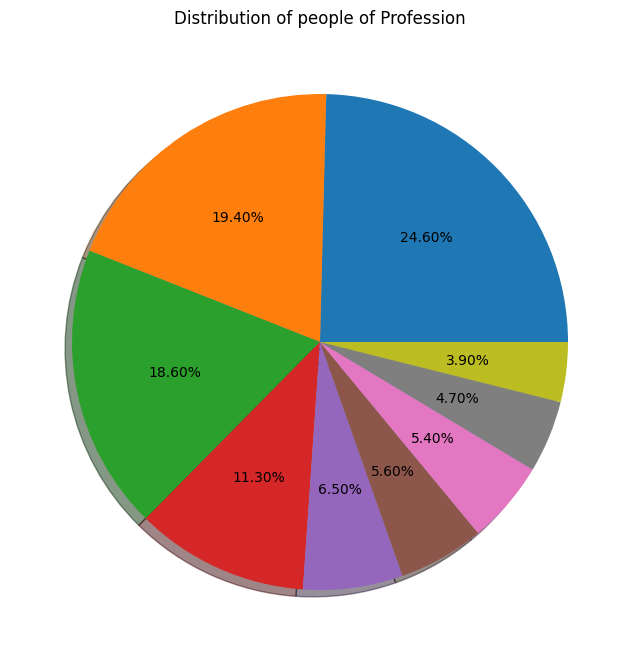

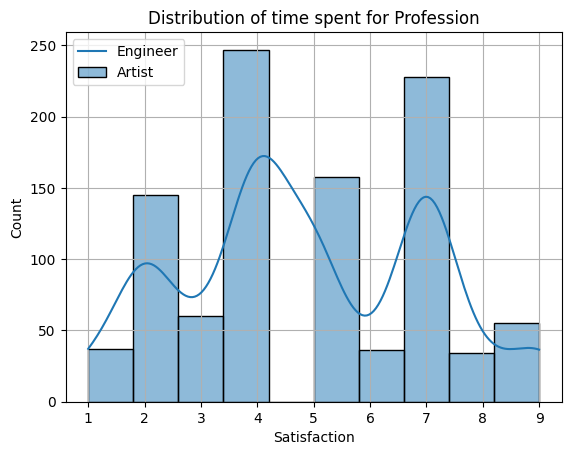

Total Satisfaction by different groups of Profession
Profession
Artist            223
Cashier           270
Engineer          316
Labor/Worker      903
Manager           268
Students         1223
Teacher           186
Waiting staff     909
driver            566
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


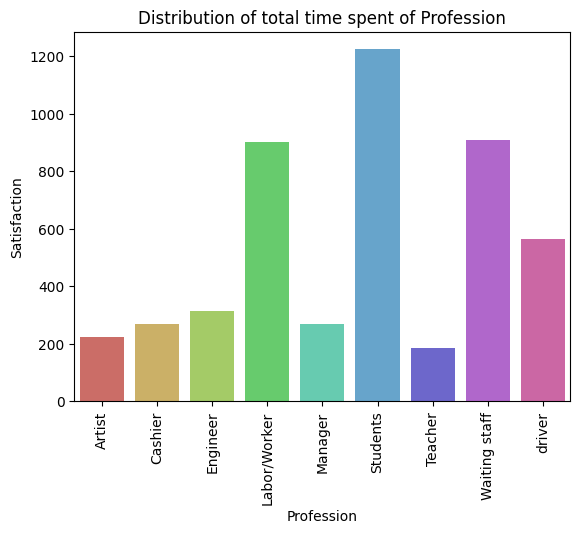

Average Satisfaction by different groups of Profession
Profession
Artist           4.744681
Cashier          4.821429
Engineer         4.861538
Labor/Worker     4.854839
Manager          4.962963
Students         4.971545
Teacher          4.769231
Waiting staff    4.685567
driver           5.008850
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


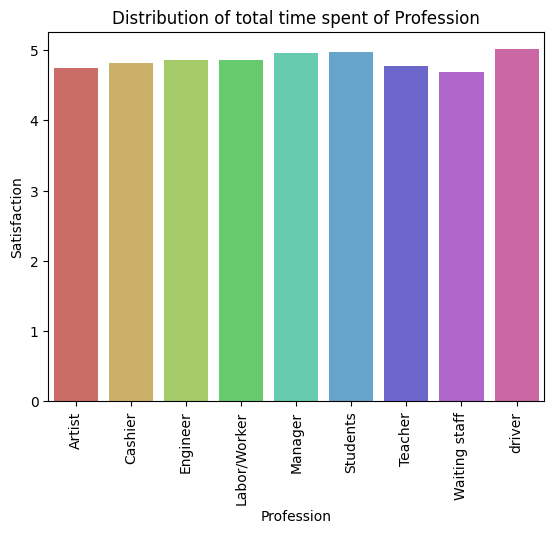

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


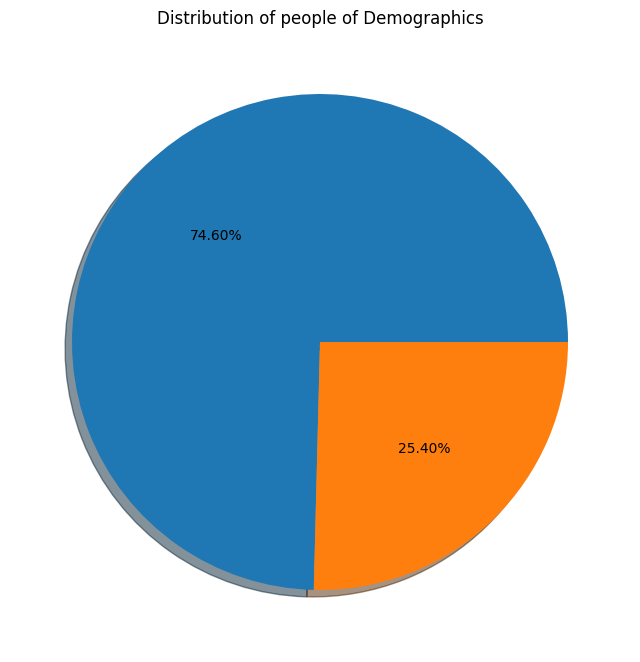

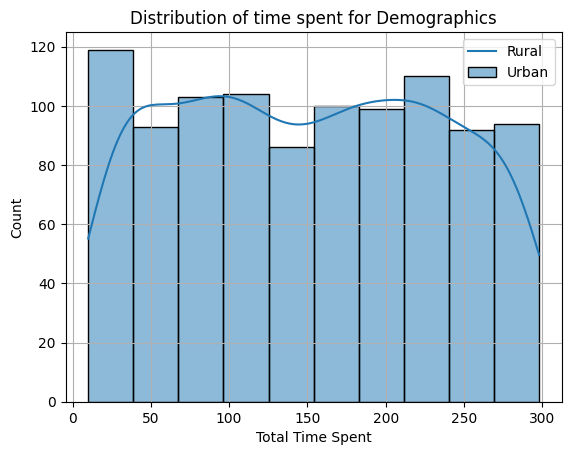

Total Total Time Spent by different groups of Demographics
Demographics
Rural    114978
Urban     36428
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


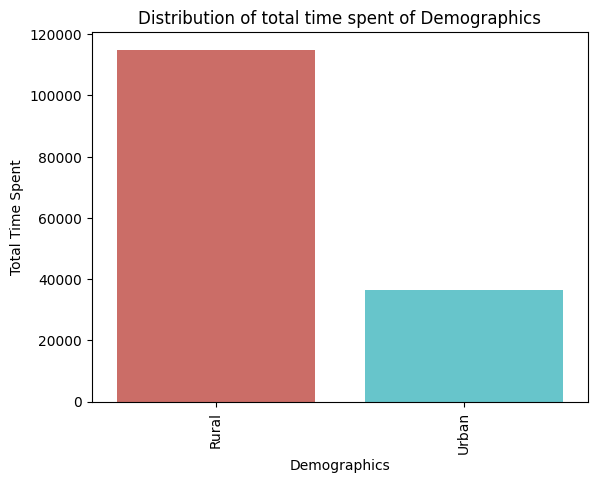

Average Total Time Spent by different groups of Demographics
Demographics
Rural    154.126005
Urban    143.417323
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


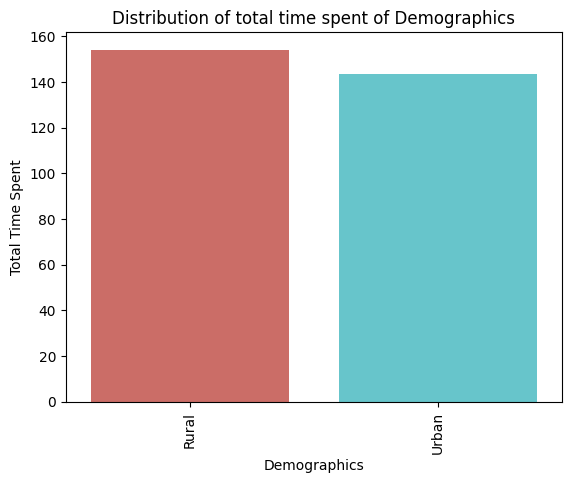

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


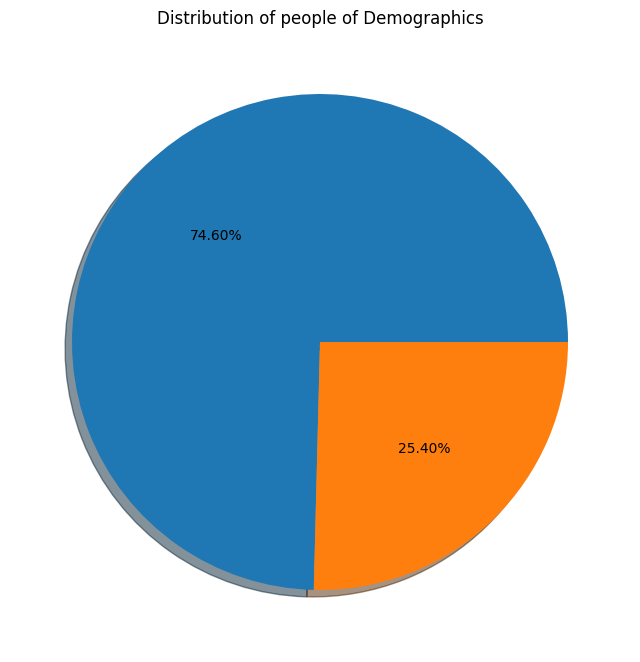

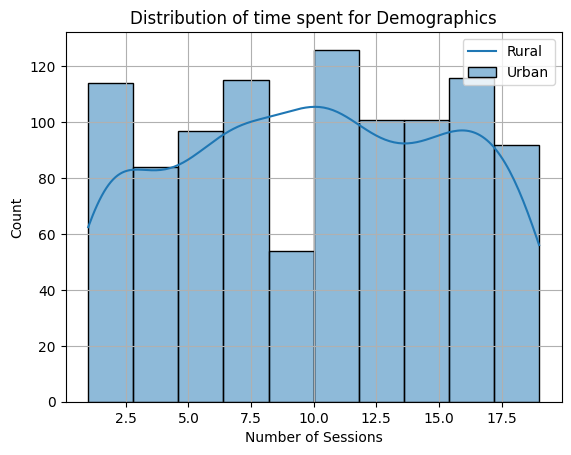

Total Number of Sessions by different groups of Demographics
Demographics
Rural    7404
Urban    2609
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


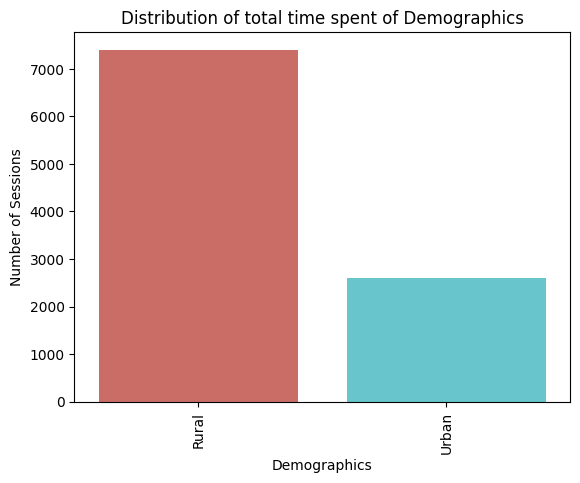

Average Number of Sessions by different groups of Demographics
Demographics
Rural     9.924933
Urban    10.271654
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


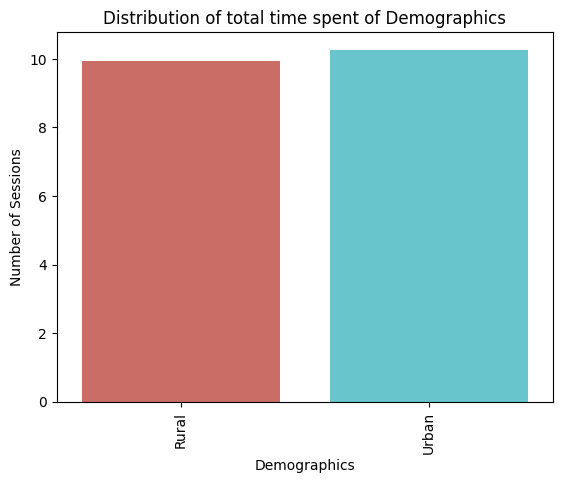

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


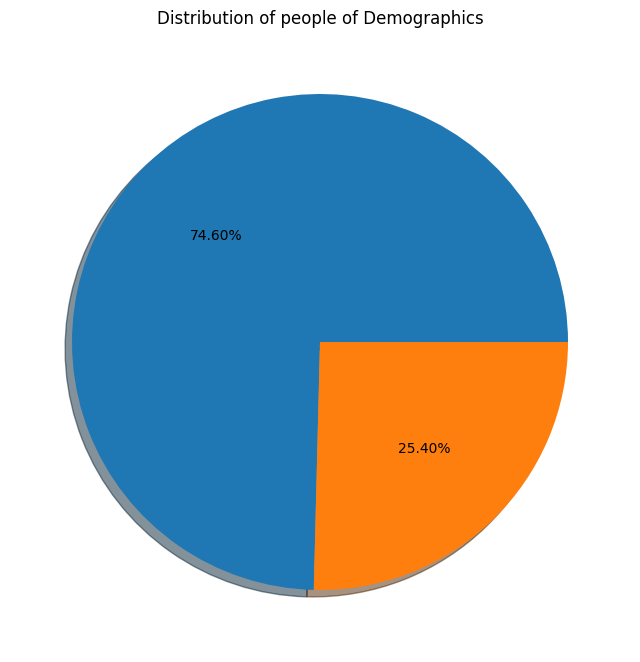

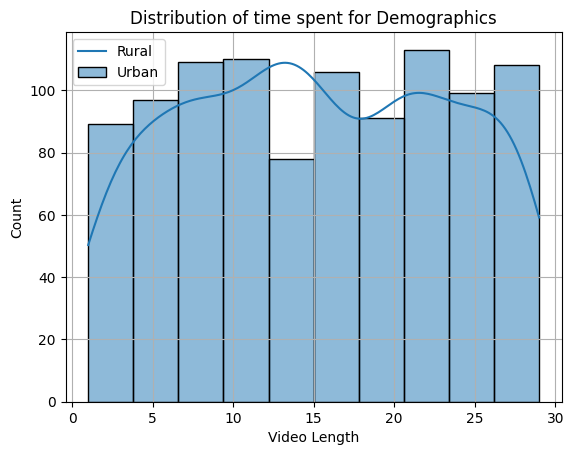

Total Video Length by different groups of Demographics
Demographics
Rural    11294
Urban     3920
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


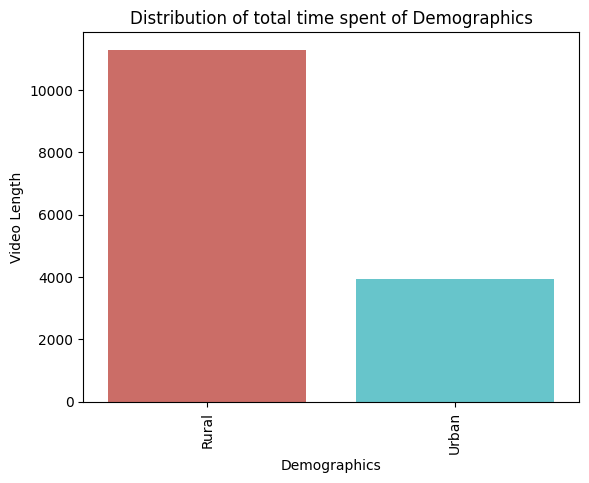

Average Video Length by different groups of Demographics
Demographics
Rural    15.139410
Urban    15.433071
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


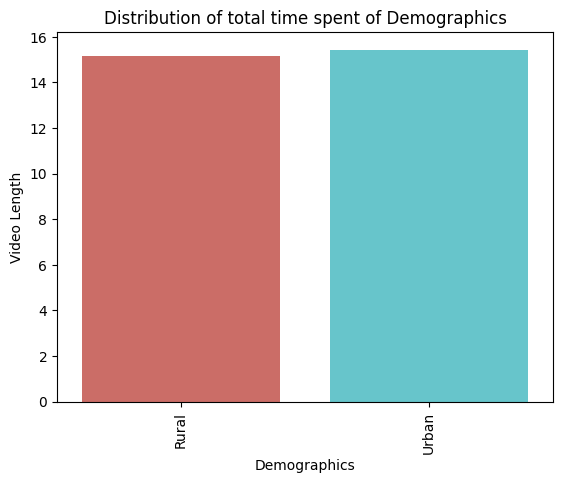

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


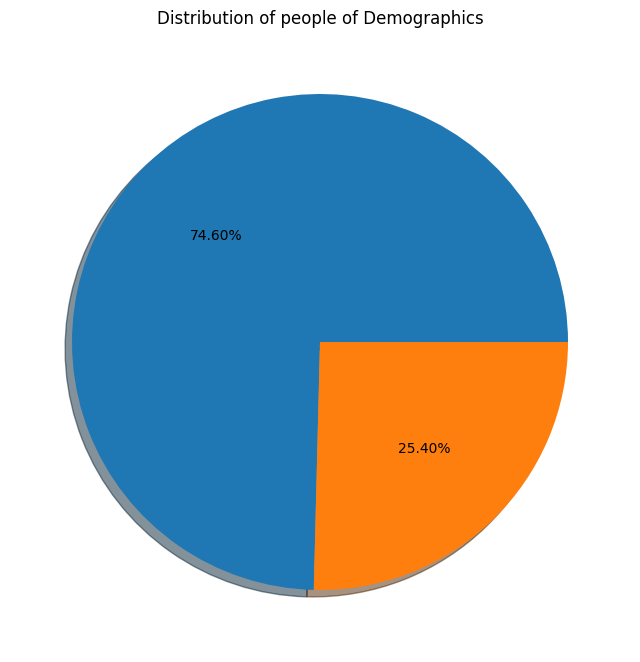

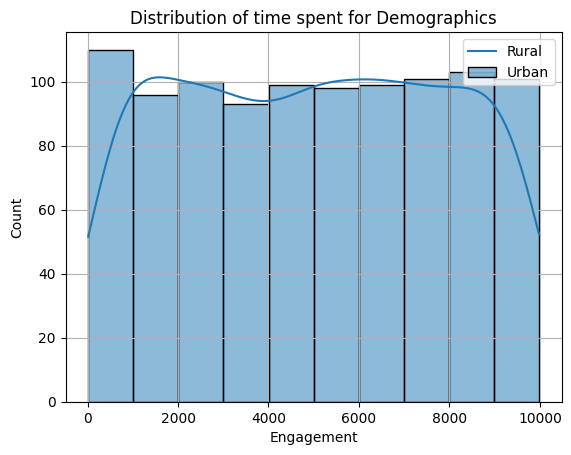

Total Engagement by different groups of Demographics
Demographics
Rural    3690971
Urban    1306188
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


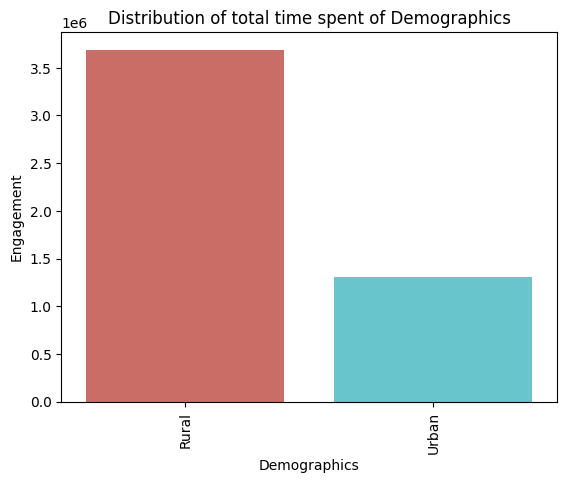

Average Engagement by different groups of Demographics
Demographics
Rural    4947.682306
Urban    5142.472441
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


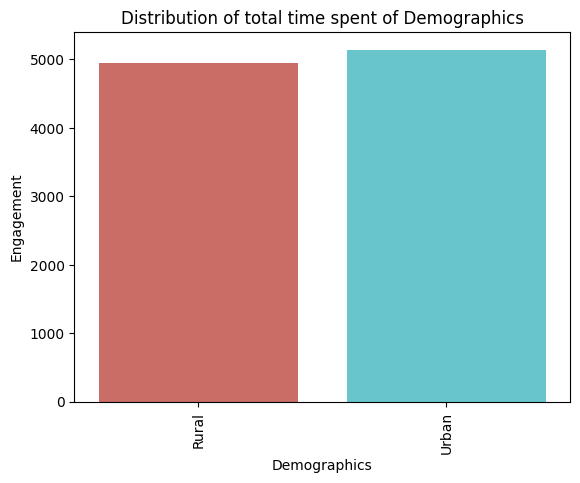

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


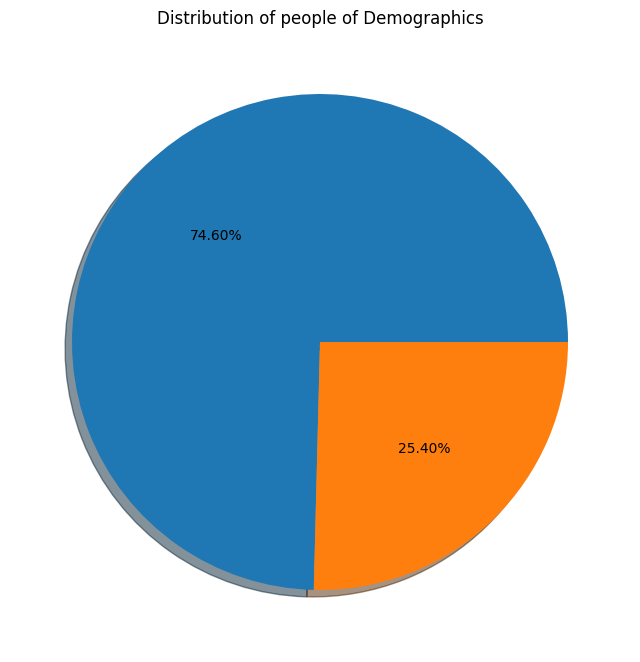

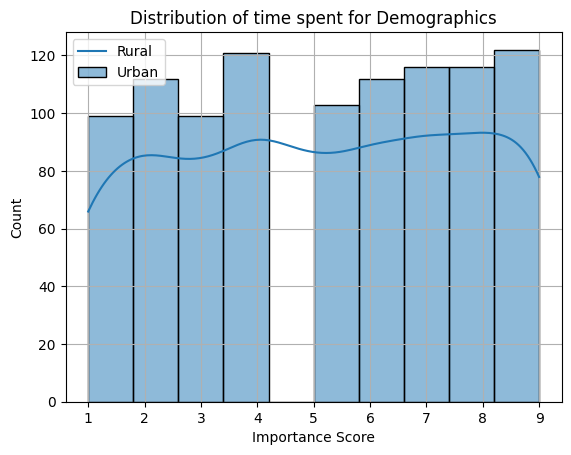

Total Importance Score by different groups of Demographics
Demographics
Rural    3812
Urban    1317
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


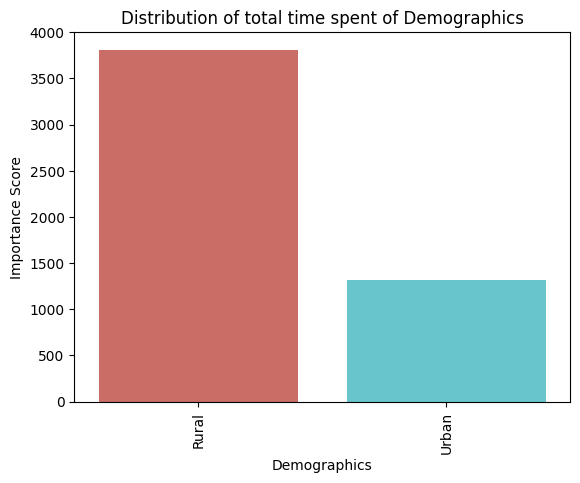

Average Importance Score by different groups of Demographics
Demographics
Rural    5.109920
Urban    5.185039
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


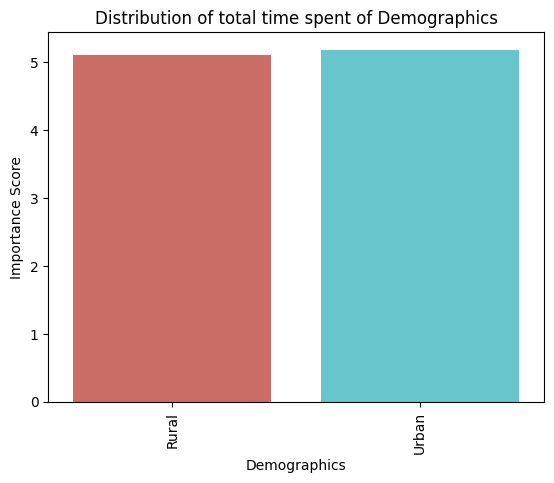

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


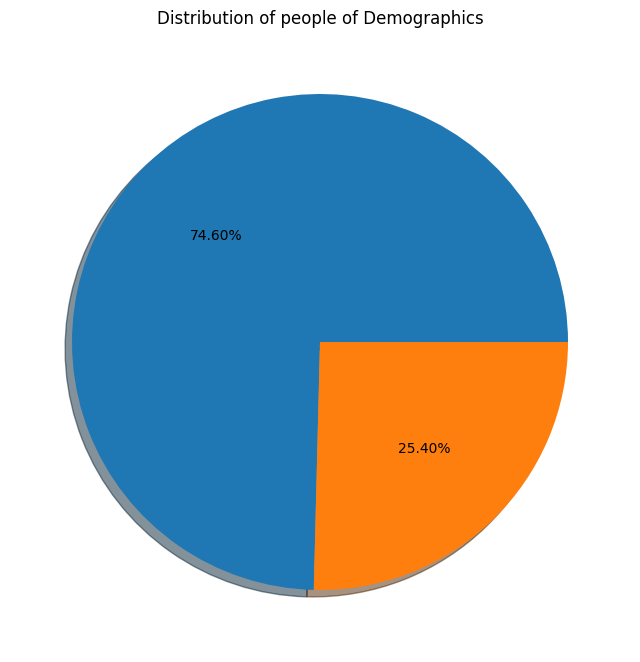

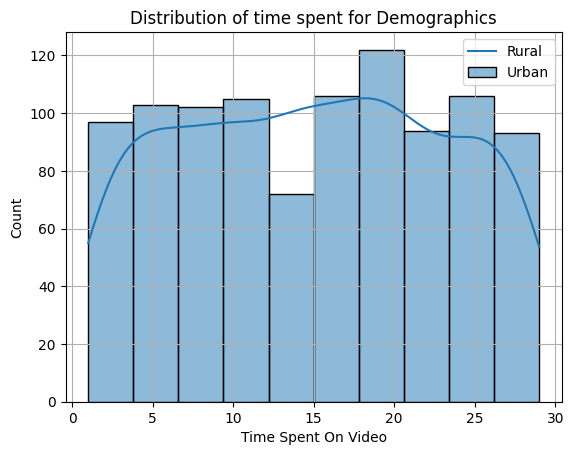

Total Time Spent On Video by different groups of Demographics
Demographics
Rural    11245
Urban     3728
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


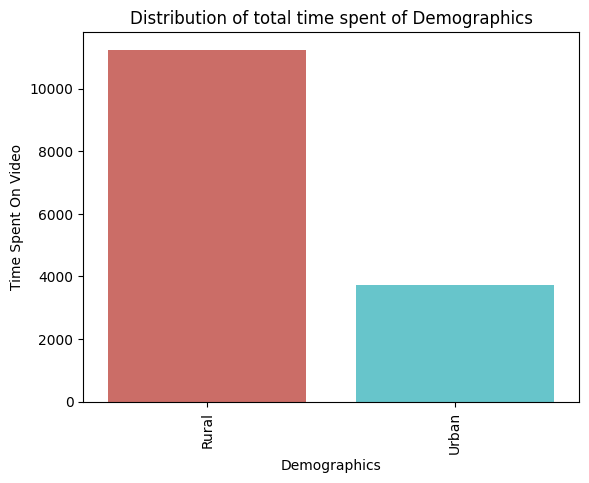

Average Time Spent On Video by different groups of Demographics
Demographics
Rural    15.073727
Urban    14.677165
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


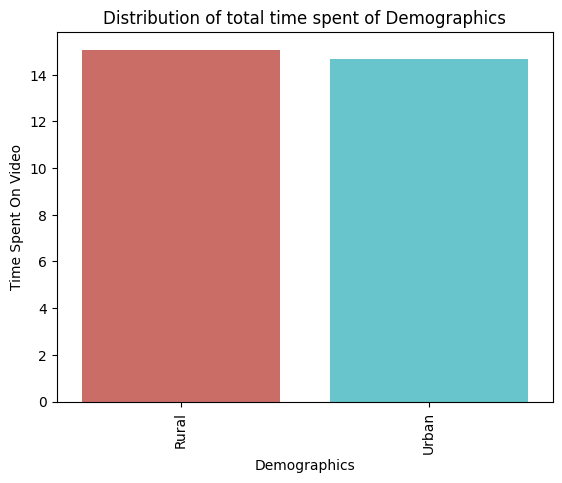

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


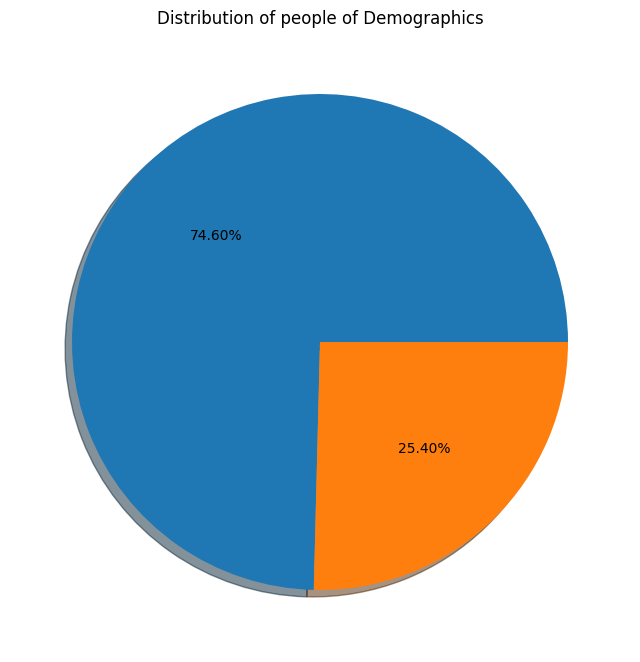

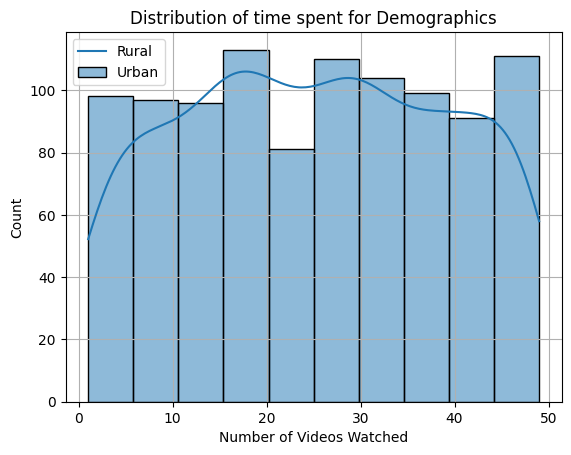

Total Number of Videos Watched by different groups of Demographics
Demographics
Rural    19014
Urban     6234
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


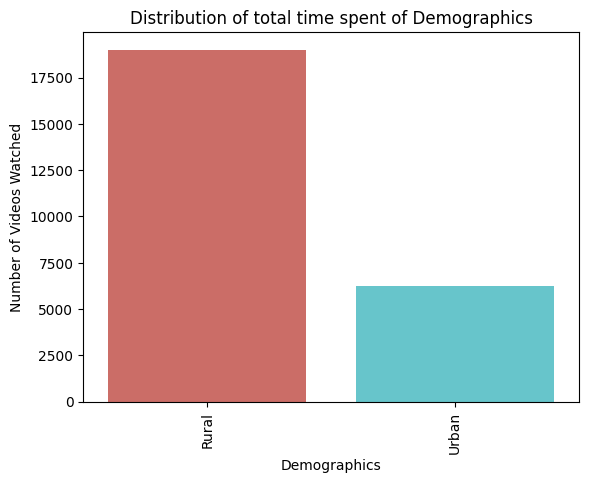

Average Number of Videos Watched by different groups of Demographics
Demographics
Rural    25.487936
Urban    24.543307
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


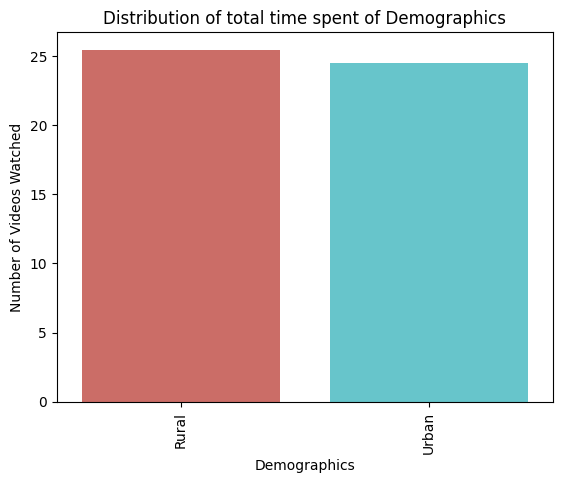

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


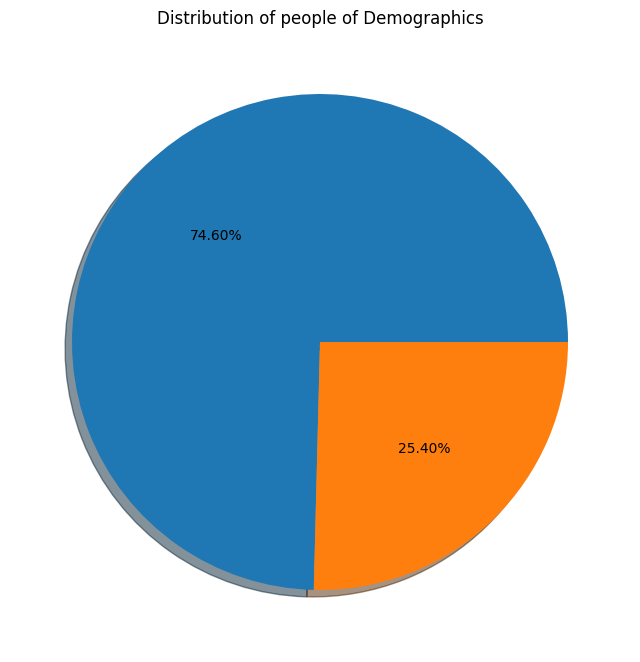

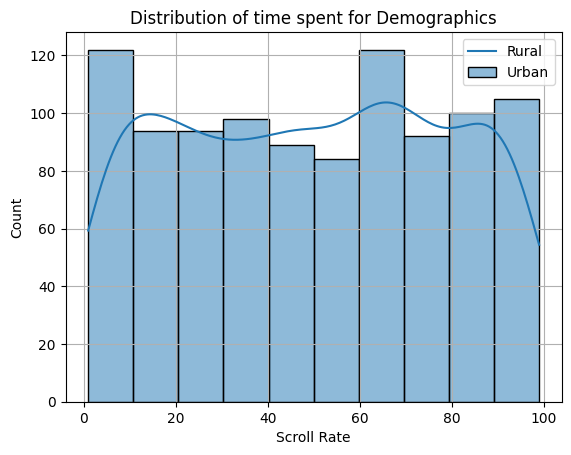

Total Scroll Rate by different groups of Demographics
Demographics
Rural    37394
Urban    12380
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


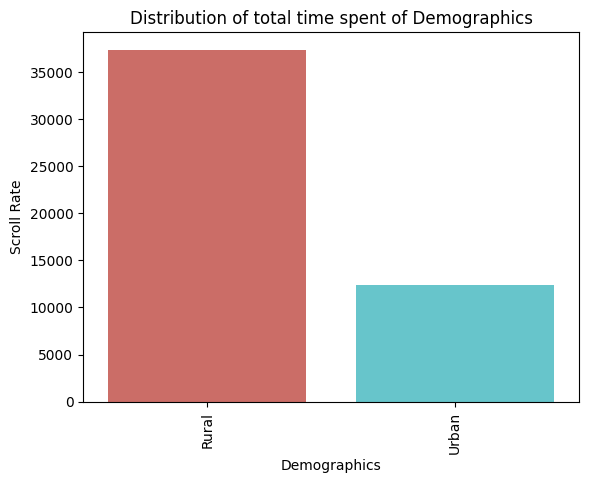

Average Scroll Rate by different groups of Demographics
Demographics
Rural    50.126005
Urban    48.740157
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


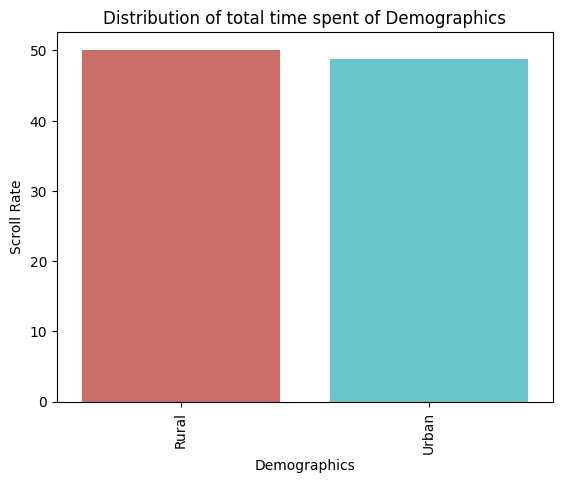

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


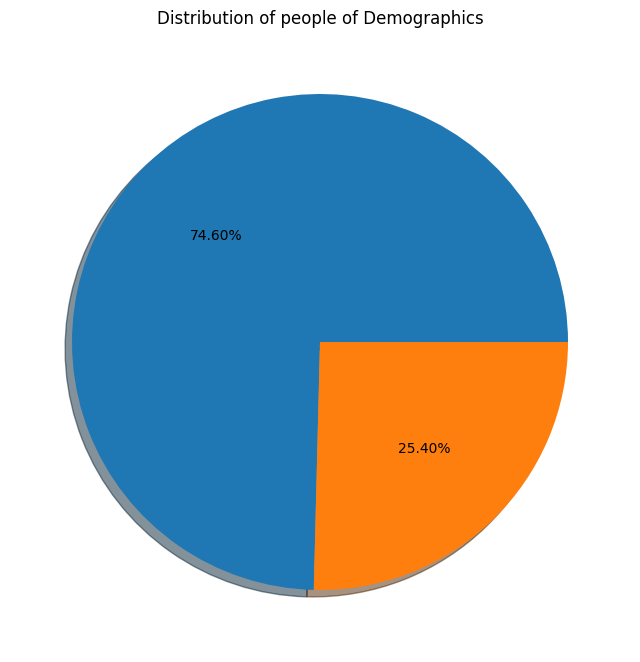

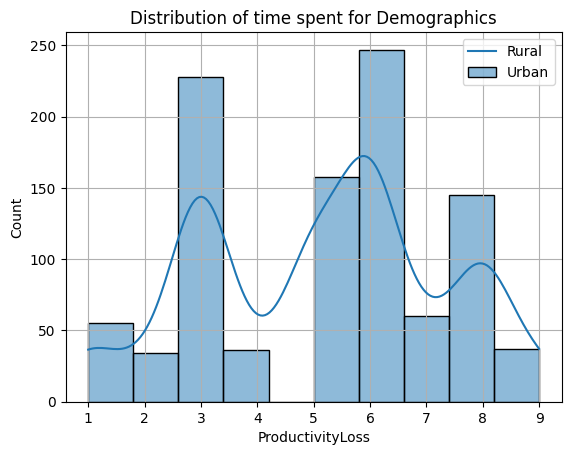

Total ProductivityLoss by different groups of Demographics
Demographics
Rural    3826
Urban    1310
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


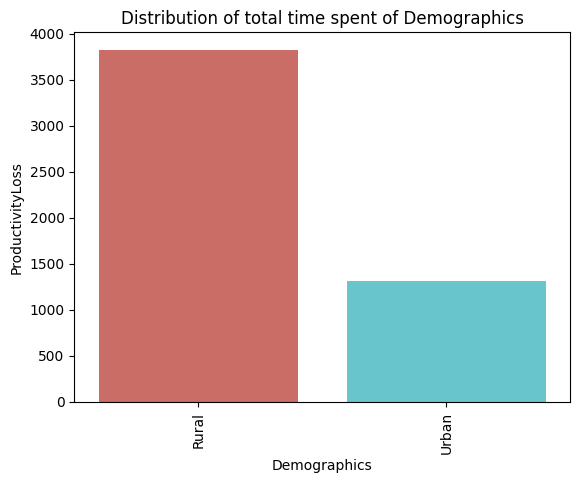

Average ProductivityLoss by different groups of Demographics
Demographics
Rural    5.128686
Urban    5.157480
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


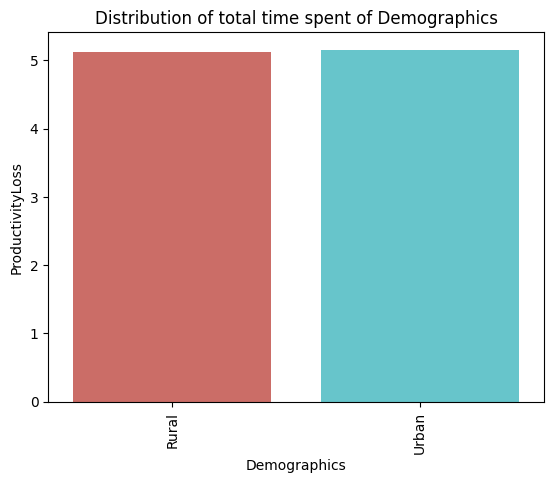

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


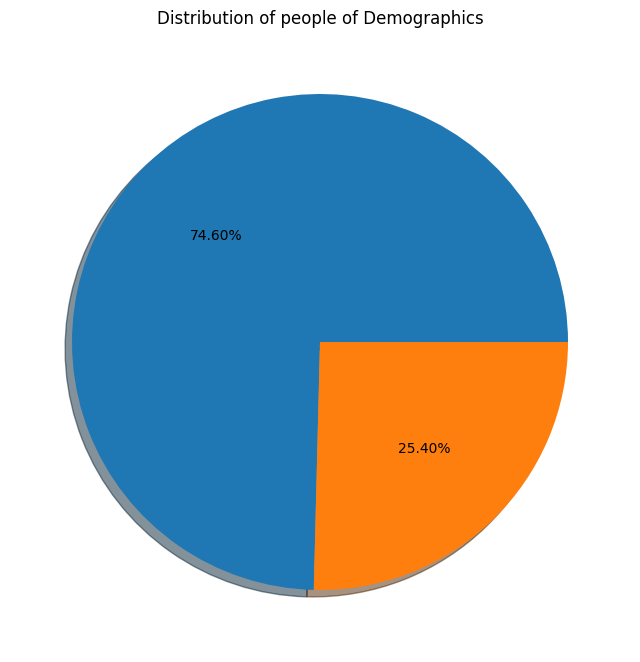

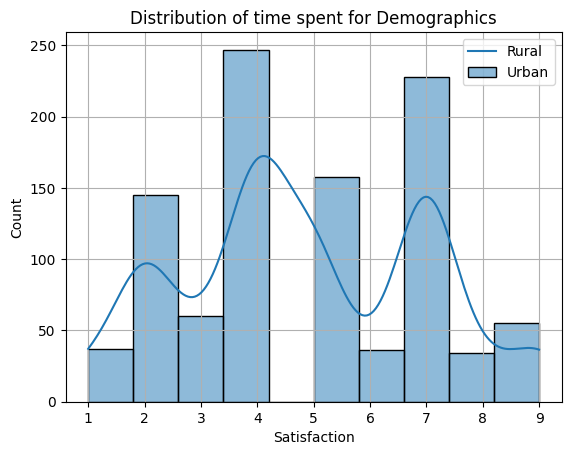

Total Satisfaction by different groups of Demographics
Demographics
Rural    3634
Urban    1230
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


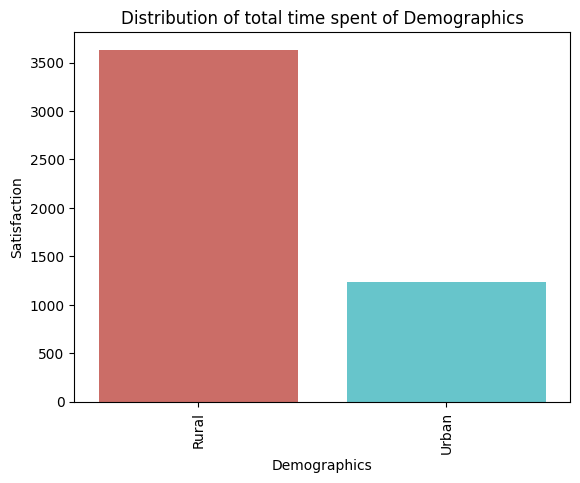

Average Satisfaction by different groups of Demographics
Demographics
Rural    4.871314
Urban    4.842520
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


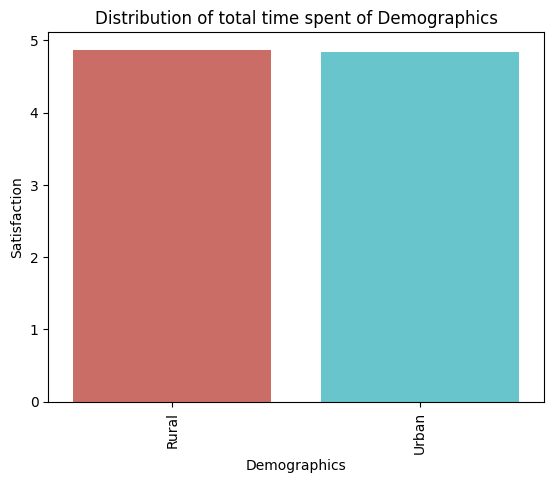

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


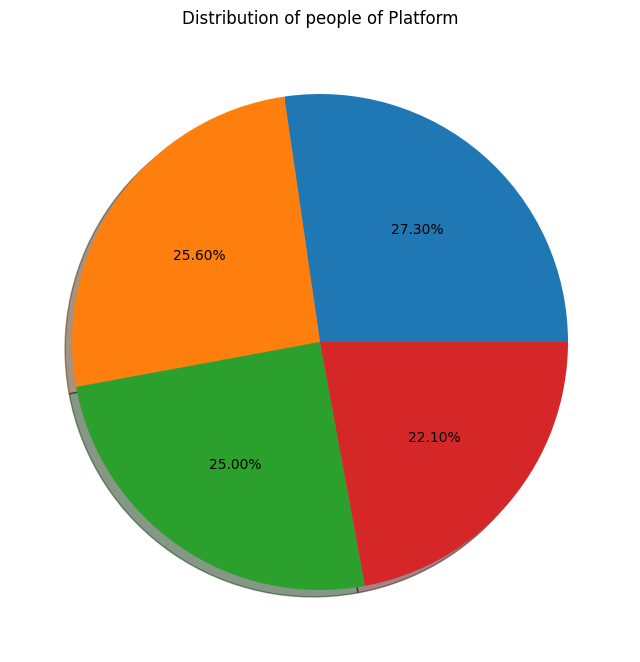

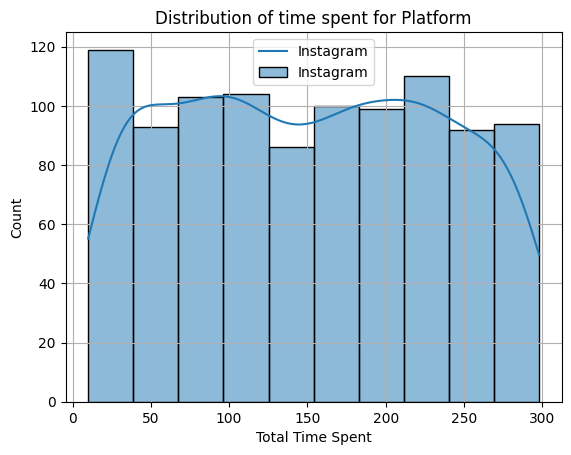

Total Total Time Spent by different groups of Platform
Platform
Facebook     34295
Instagram    37609
TikTok       41297
YouTube      38205
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


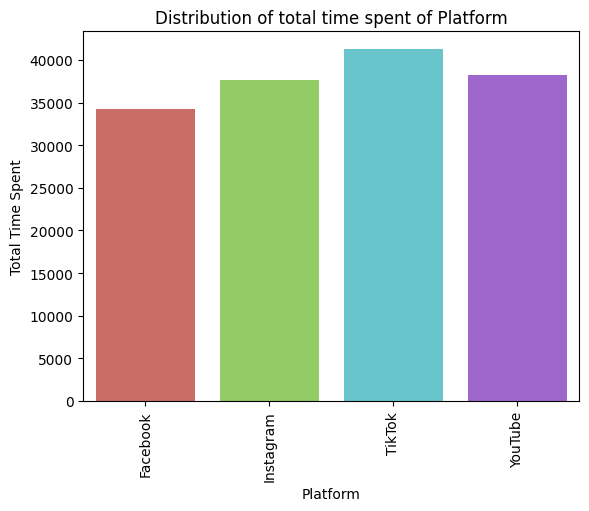

Average Total Time Spent by different groups of Platform
Platform
Facebook     155.180995
Instagram    146.910156
TikTok       151.271062
YouTube      152.820000
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


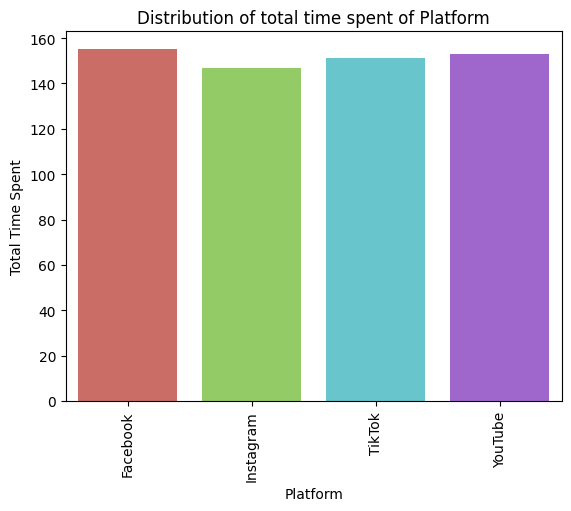

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


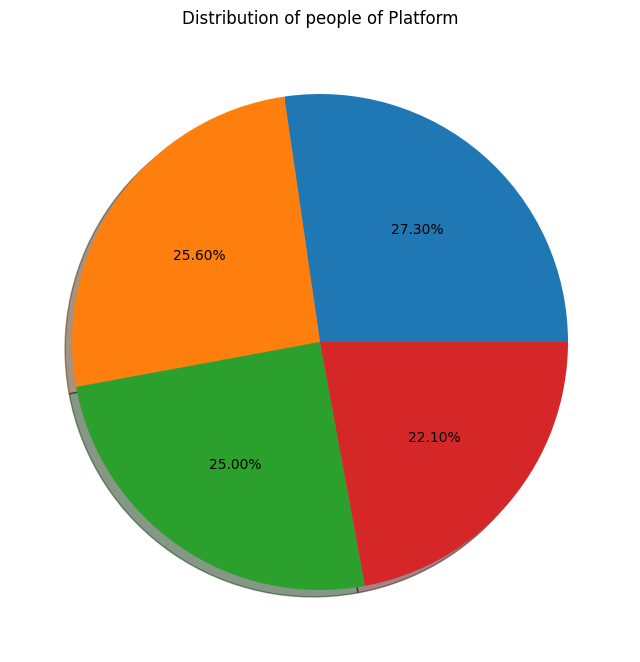

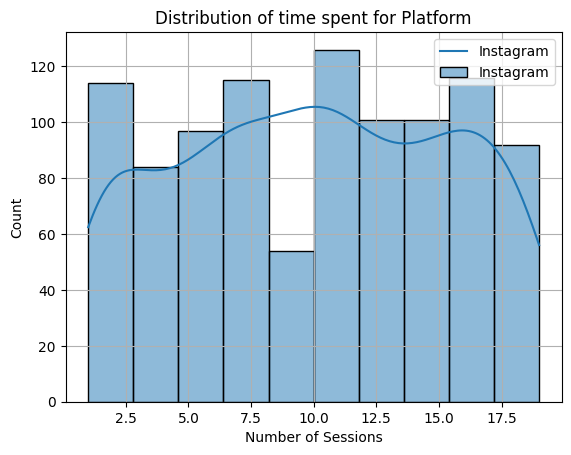

Total Number of Sessions by different groups of Platform
Platform
Facebook     2185
Instagram    2576
TikTok       2735
YouTube      2517
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


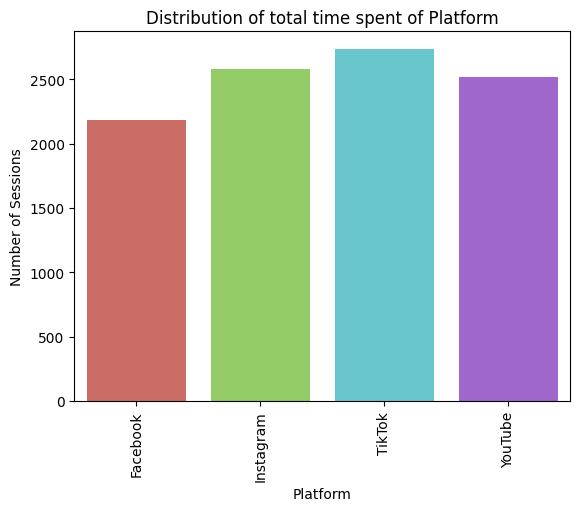

Average Number of Sessions by different groups of Platform
Platform
Facebook      9.886878
Instagram    10.062500
TikTok       10.018315
YouTube      10.068000
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


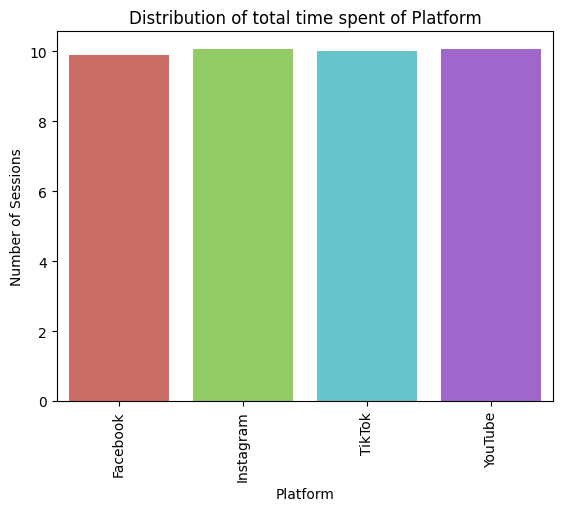

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


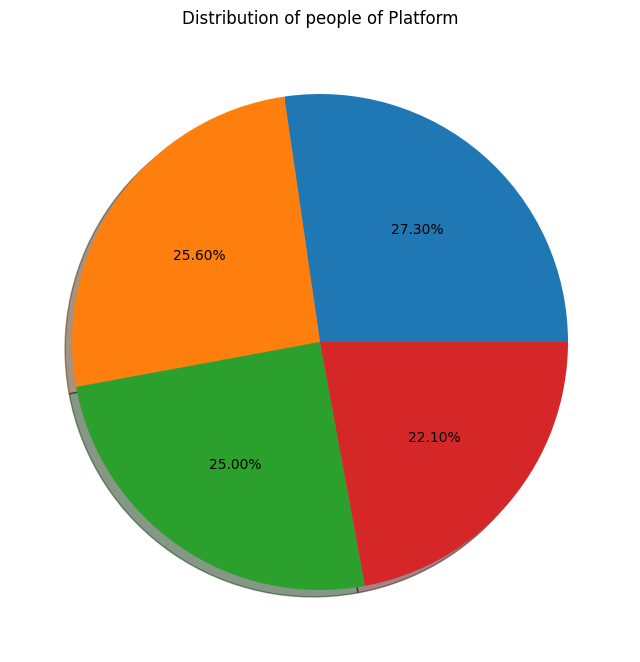

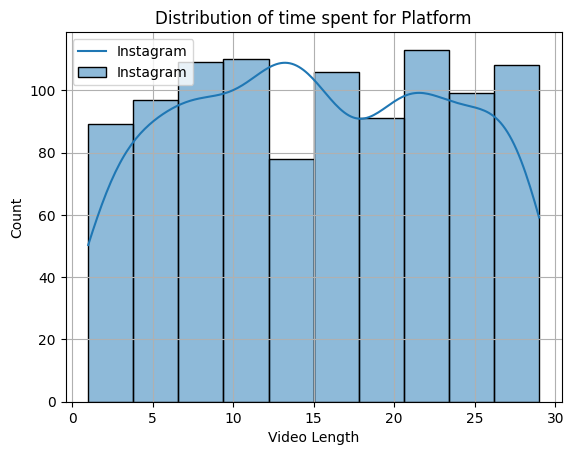

Total Video Length by different groups of Platform
Platform
Facebook     3384
Instagram    3973
TikTok       4038
YouTube      3819
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


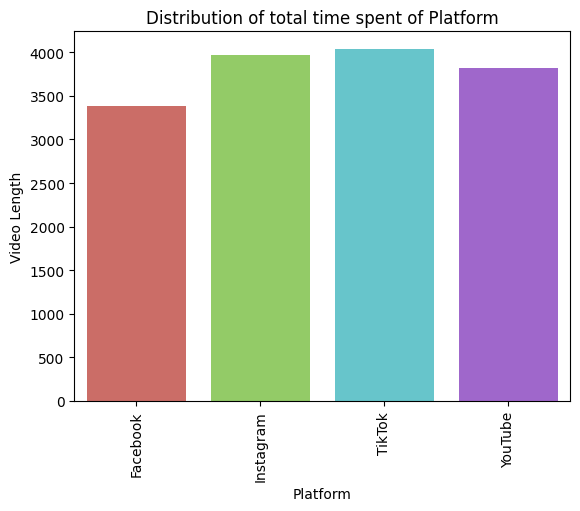

Average Video Length by different groups of Platform
Platform
Facebook     15.312217
Instagram    15.519531
TikTok       14.791209
YouTube      15.276000
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


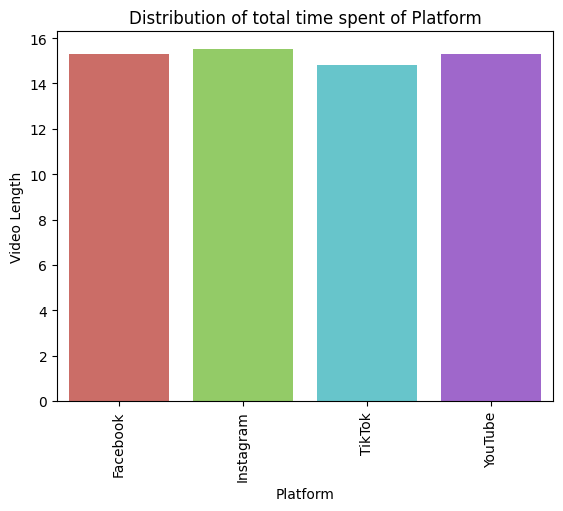

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


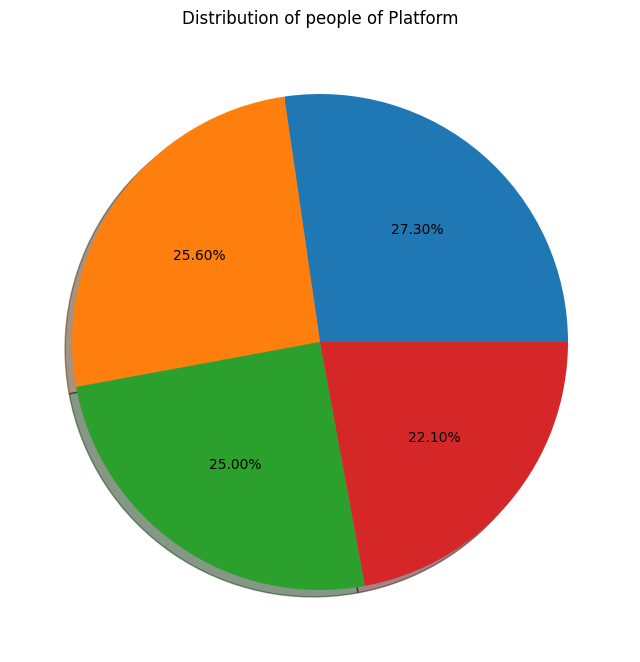

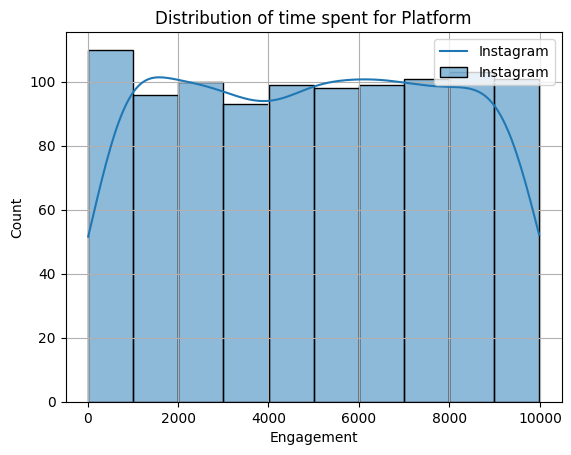

Total Engagement by different groups of Platform
Platform
Facebook     1155449
Instagram    1303255
TikTok       1321865
YouTube      1216590
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


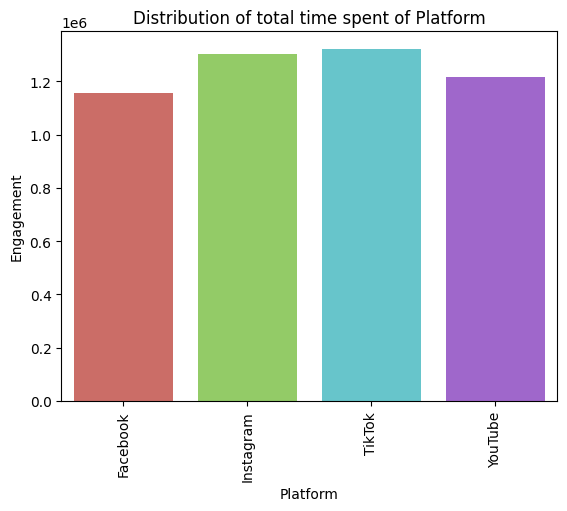

Average Engagement by different groups of Platform
Platform
Facebook     5228.276018
Instagram    5090.839844
TikTok       4841.996337
YouTube      4866.360000
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


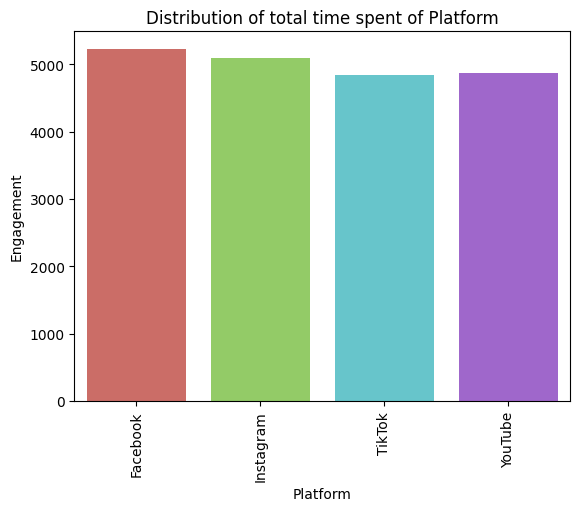

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


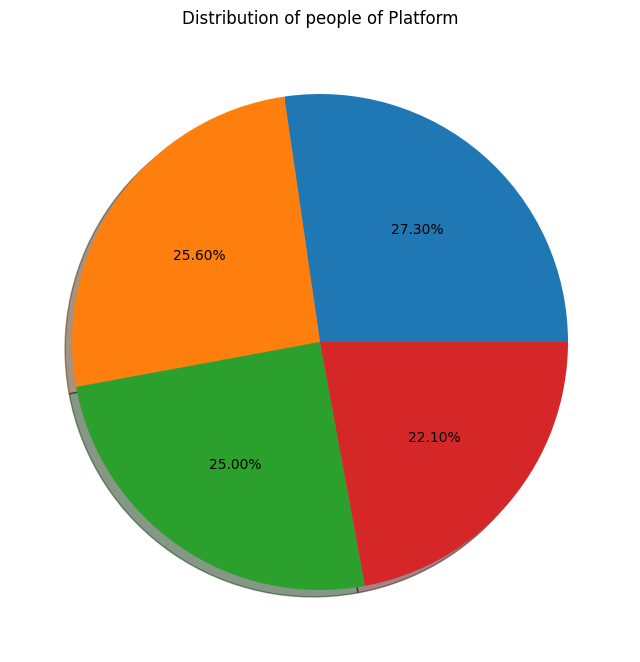

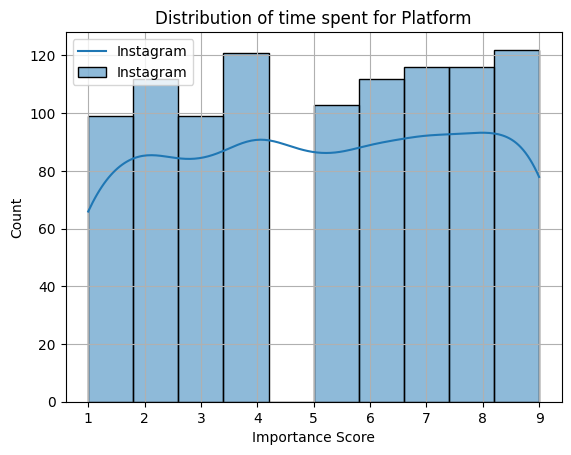

Total Importance Score by different groups of Platform
Platform
Facebook     1162
Instagram    1296
TikTok       1415
YouTube      1256
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


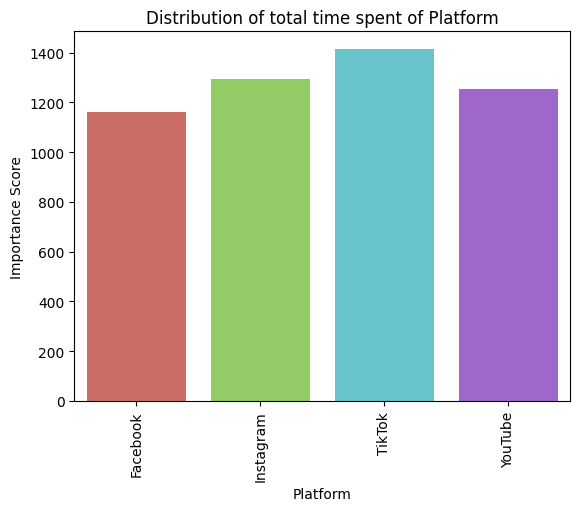

Average Importance Score by different groups of Platform
Platform
Facebook     5.257919
Instagram    5.062500
TikTok       5.183150
YouTube      5.024000
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


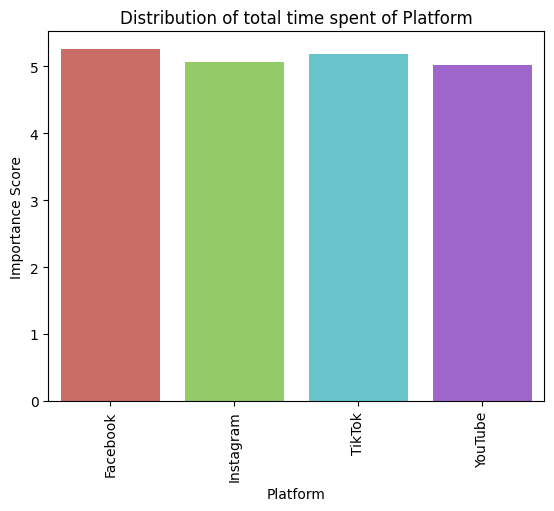

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


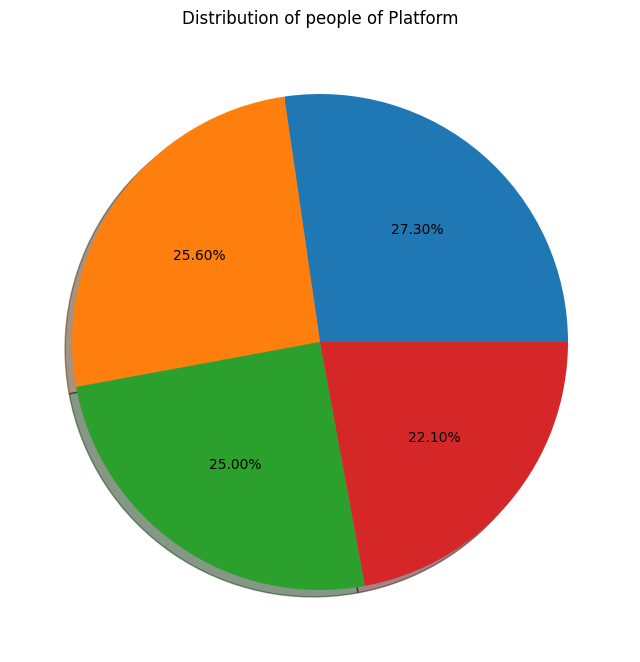

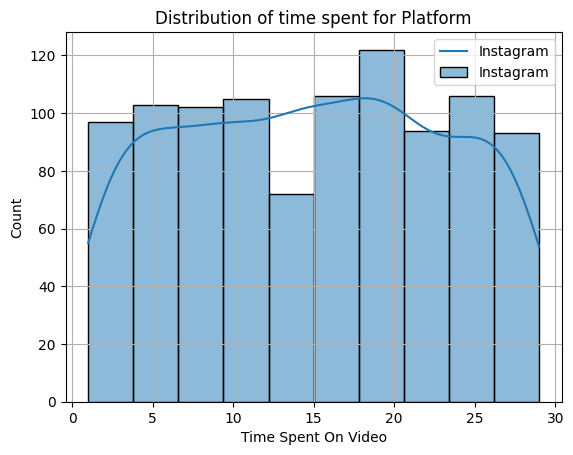

Total Time Spent On Video by different groups of Platform
Platform
Facebook     3230
Instagram    3783
TikTok       4142
YouTube      3818
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


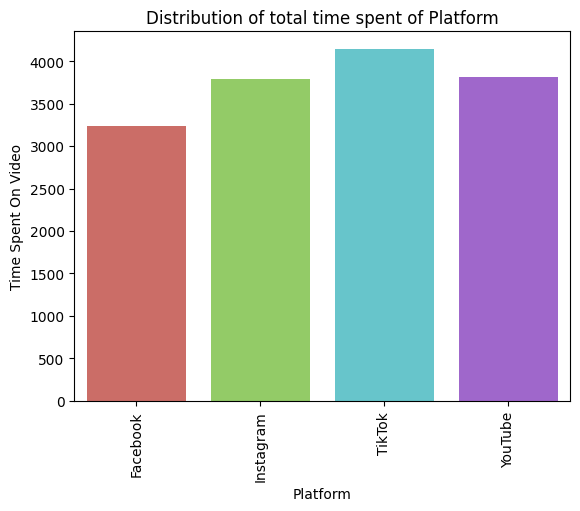

Average Time Spent On Video by different groups of Platform
Platform
Facebook     14.615385
Instagram    14.777344
TikTok       15.172161
YouTube      15.272000
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


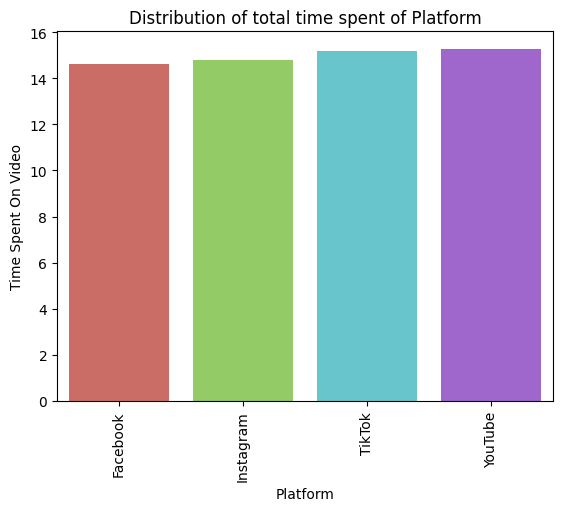

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


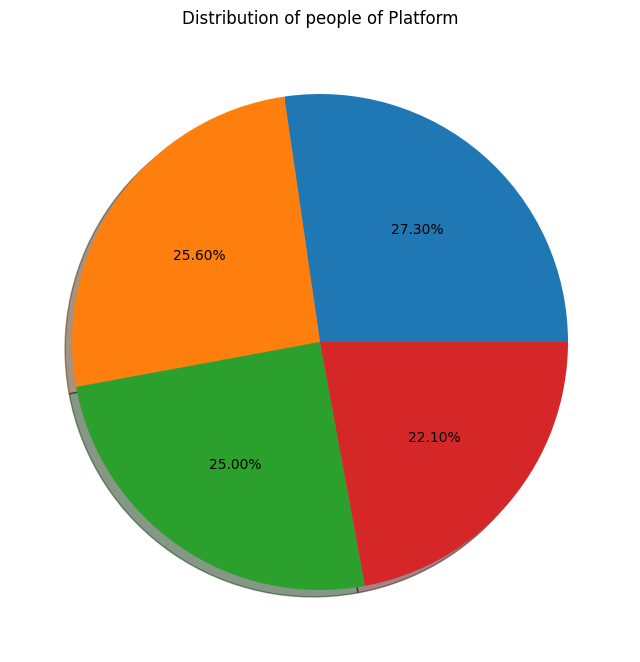

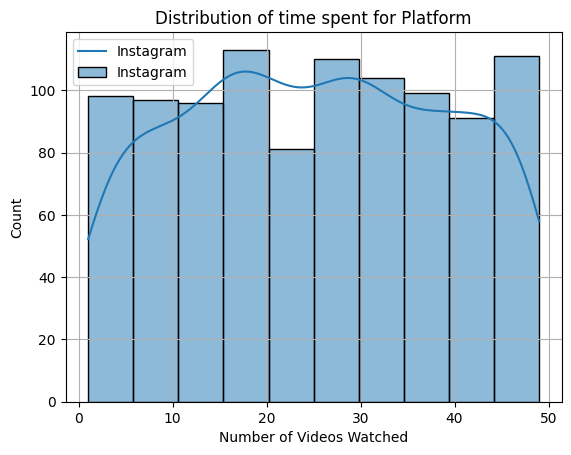

Total Number of Videos Watched by different groups of Platform
Platform
Facebook     5337
Instagram    6778
TikTok       6733
YouTube      6400
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


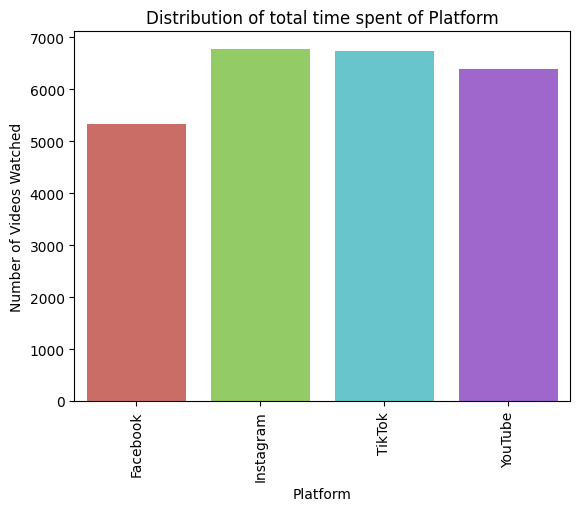

Average Number of Videos Watched by different groups of Platform
Platform
Facebook     24.149321
Instagram    26.476562
TikTok       24.663004
YouTube      25.600000
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


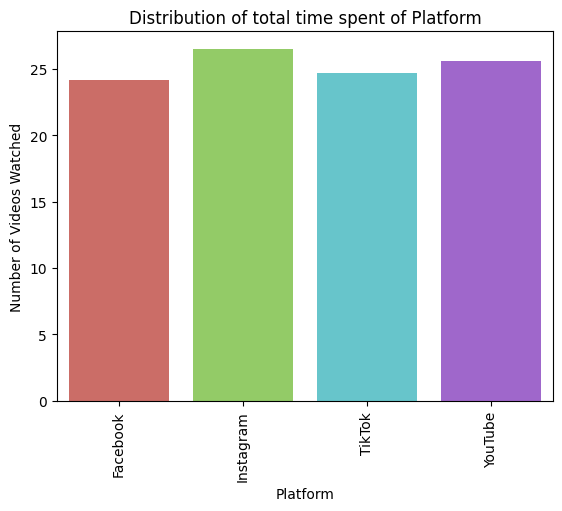

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


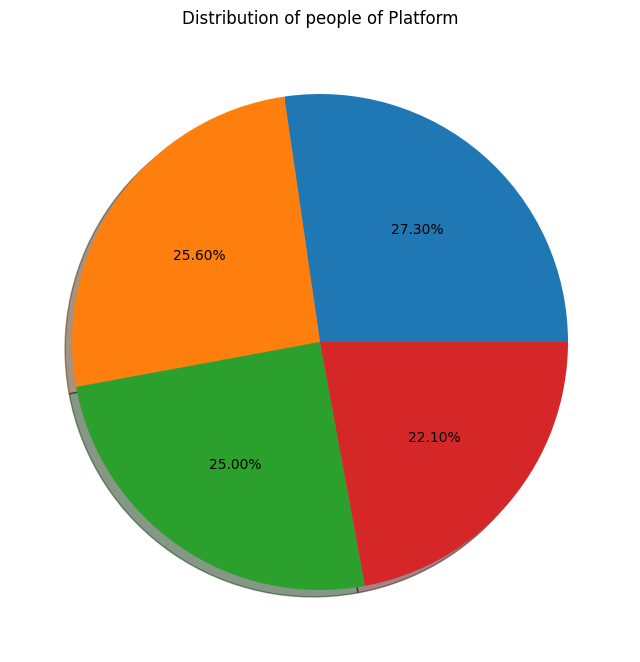

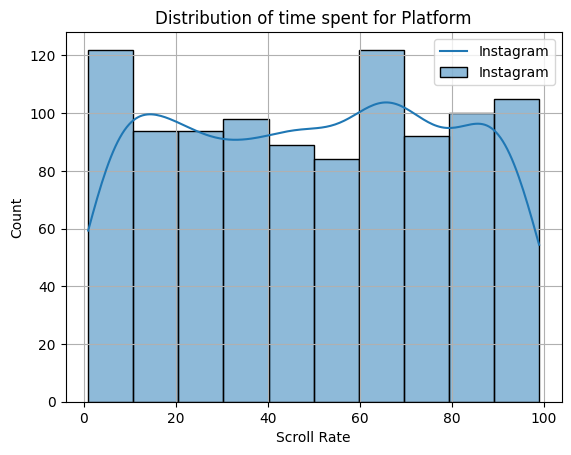

Total Scroll Rate by different groups of Platform
Platform
Facebook     10336
Instagram    13371
TikTok       13730
YouTube      12337
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


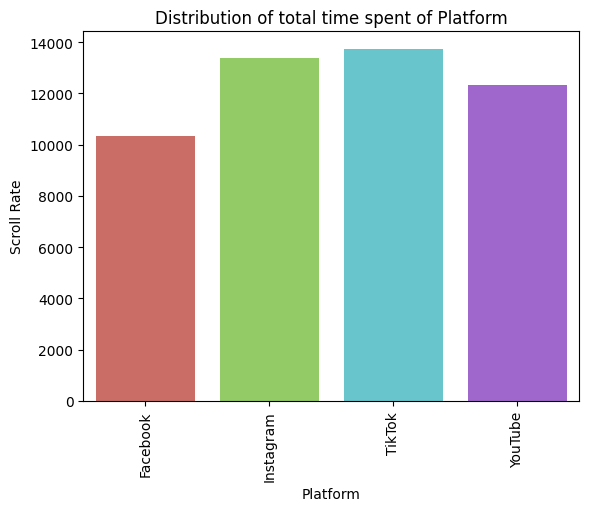

Average Scroll Rate by different groups of Platform
Platform
Facebook     46.769231
Instagram    52.230469
TikTok       50.293040
YouTube      49.348000
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


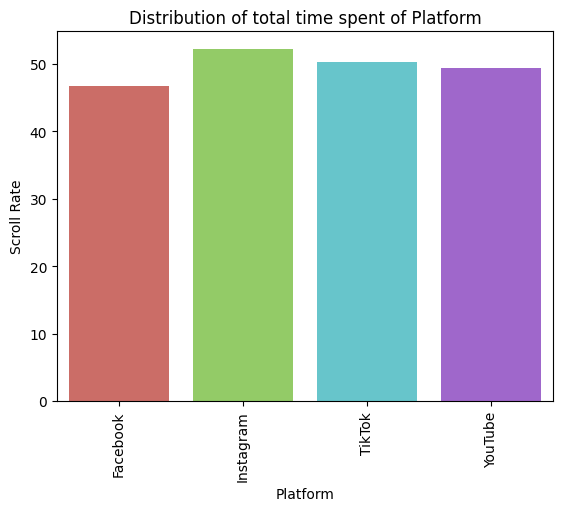

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


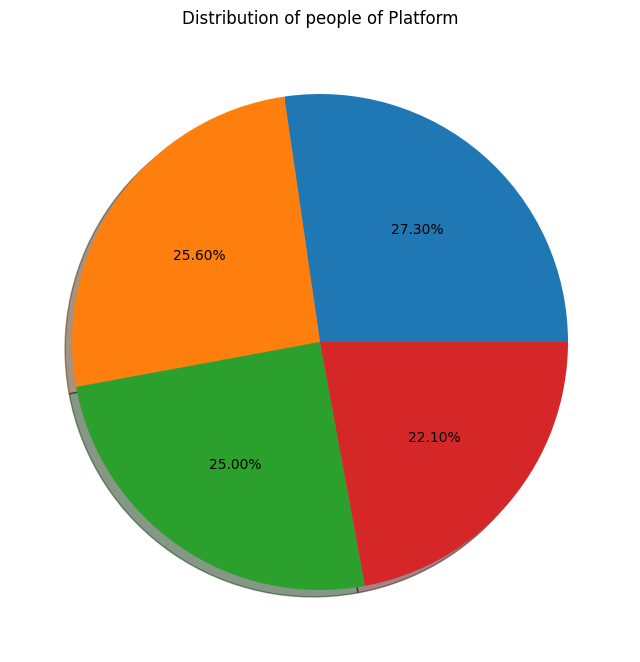

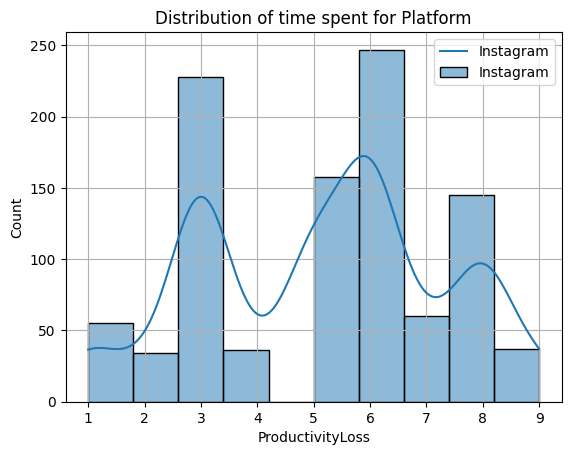

Total ProductivityLoss by different groups of Platform
Platform
Facebook     1120
Instagram    1300
TikTok       1402
YouTube      1314
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


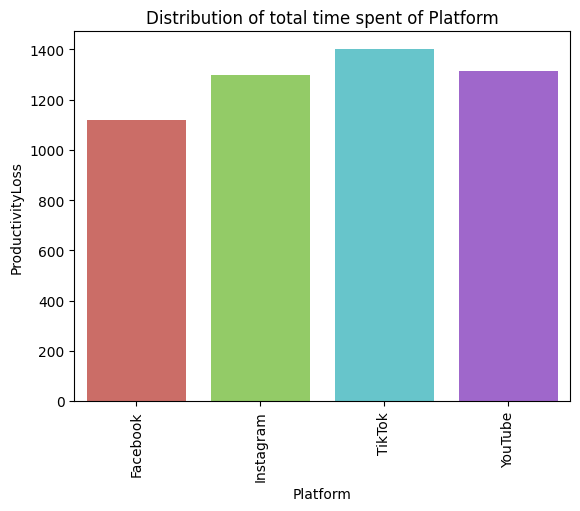

Average ProductivityLoss by different groups of Platform
Platform
Facebook     5.067873
Instagram    5.078125
TikTok       5.135531
YouTube      5.256000
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


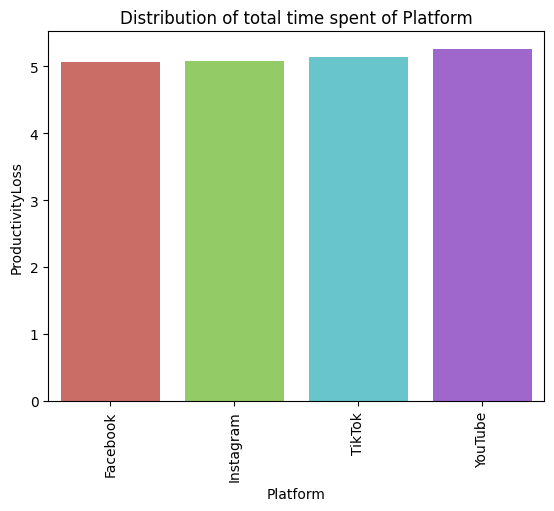

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


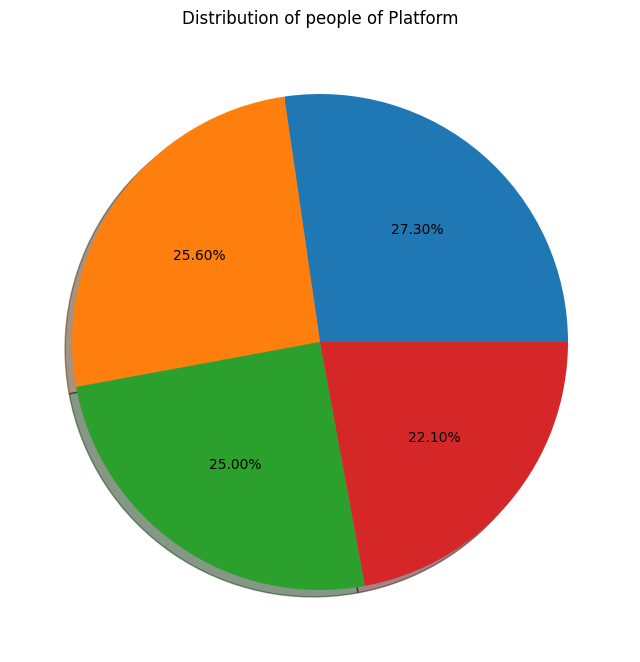

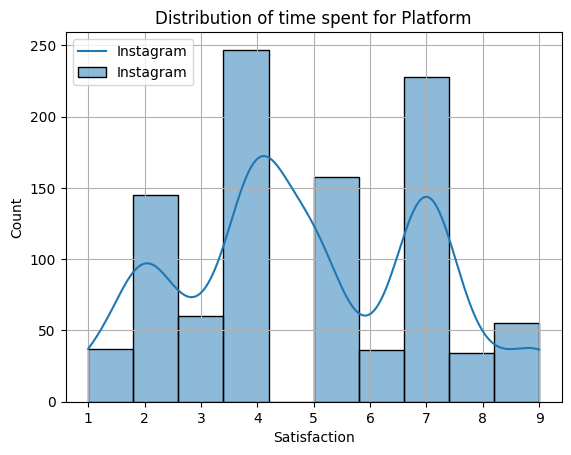

Total Satisfaction by different groups of Platform
Platform
Facebook     1090
Instagram    1260
TikTok       1328
YouTube      1186
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


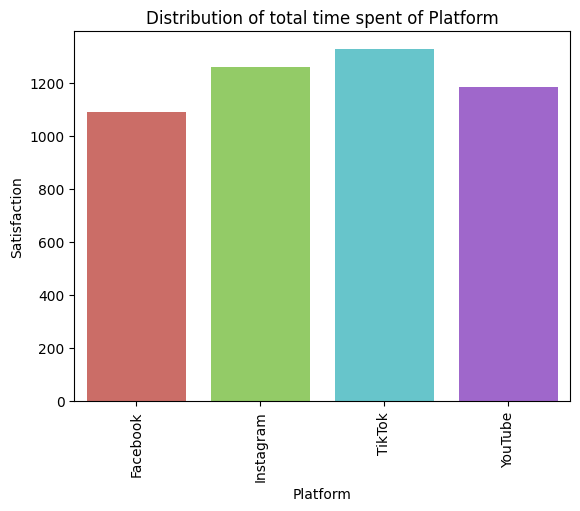

Average Satisfaction by different groups of Platform
Platform
Facebook     4.932127
Instagram    4.921875
TikTok       4.864469
YouTube      4.744000
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


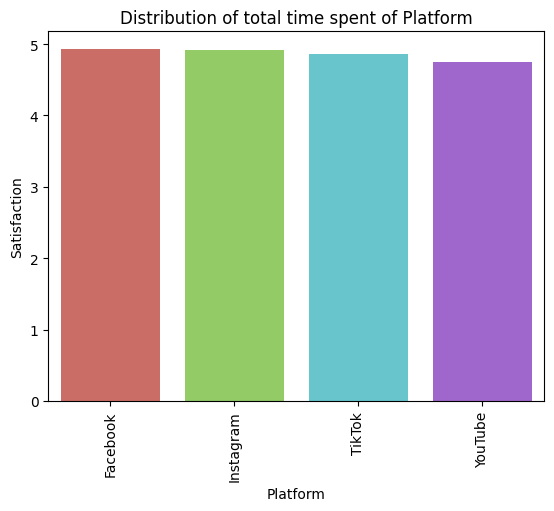

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


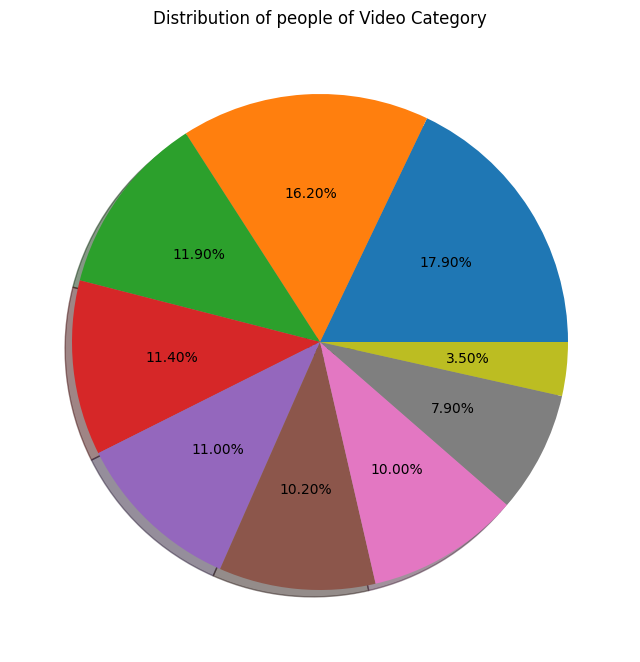

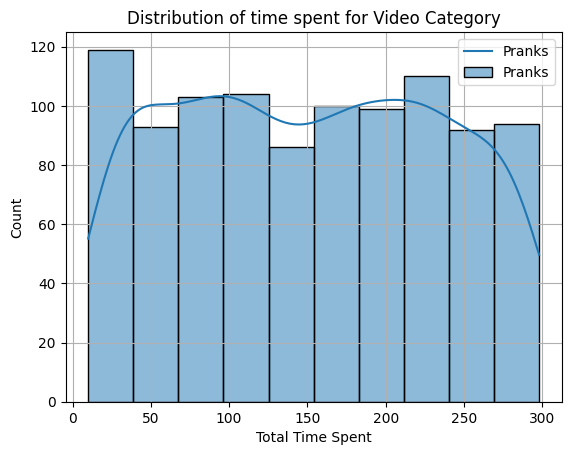

Total Total Time Spent by different groups of Video Category
Video Category
ASMR             12307
Comedy            5597
Entertainment    15330
Gaming           18423
Jokes/Memes      27129
Life Hacks       24422
Pranks           16268
Trends           14753
Vlogs            17177
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


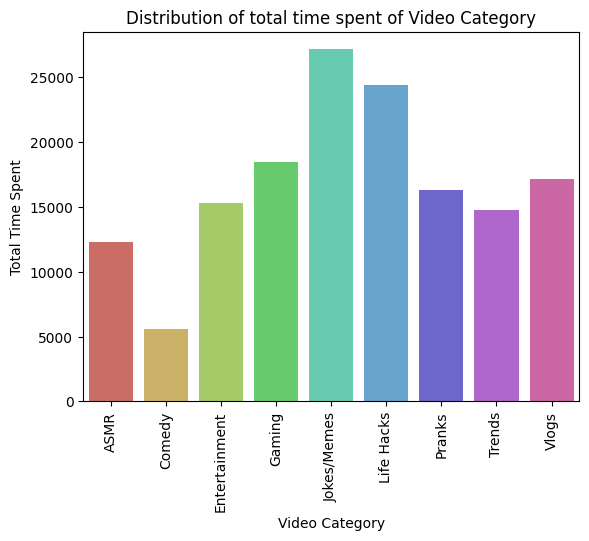

Average Total Time Spent by different groups of Video Category
Video Category
ASMR             155.784810
Comedy           159.914286
Entertainment    150.294118
Gaming           154.815126
Jokes/Memes      151.558659
Life Hacks       150.753086
Pranks           147.890909
Trends           147.530000
Vlogs            150.675439
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


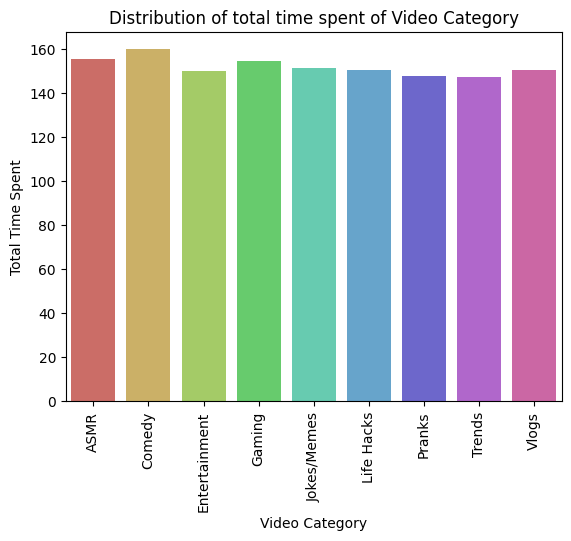

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


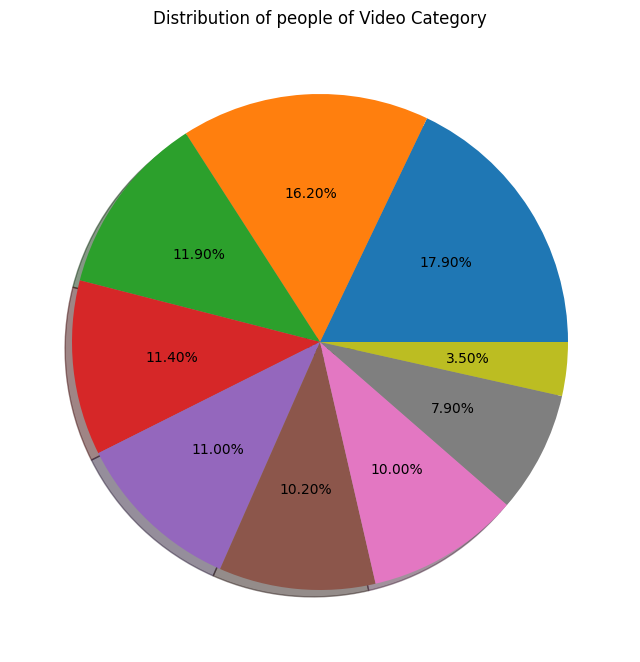

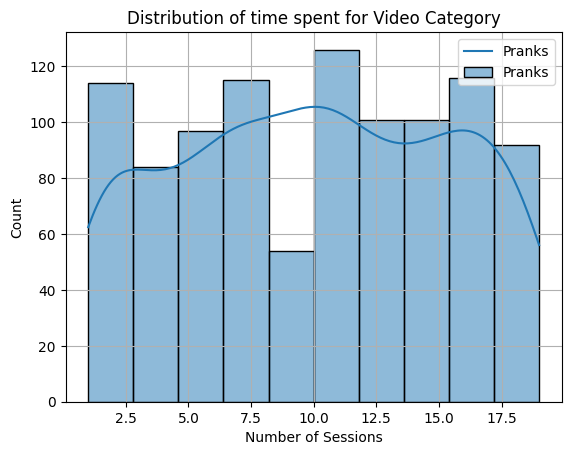

Total Number of Sessions by different groups of Video Category
Video Category
ASMR              747
Comedy            389
Entertainment     982
Gaming           1189
Jokes/Memes      1847
Life Hacks       1527
Pranks           1211
Trends           1006
Vlogs            1115
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


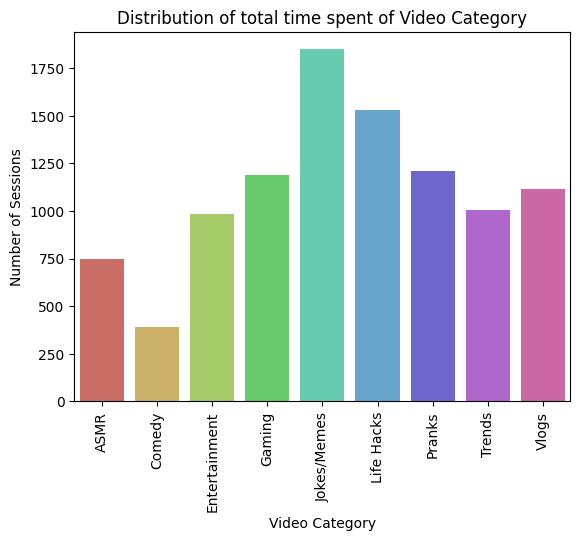

Average Number of Sessions by different groups of Video Category
Video Category
ASMR              9.455696
Comedy           11.114286
Entertainment     9.627451
Gaming            9.991597
Jokes/Memes      10.318436
Life Hacks        9.425926
Pranks           11.009091
Trends           10.060000
Vlogs             9.780702
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


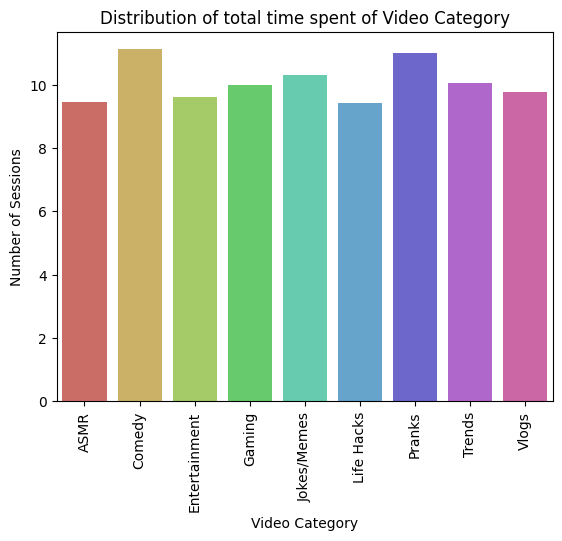

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


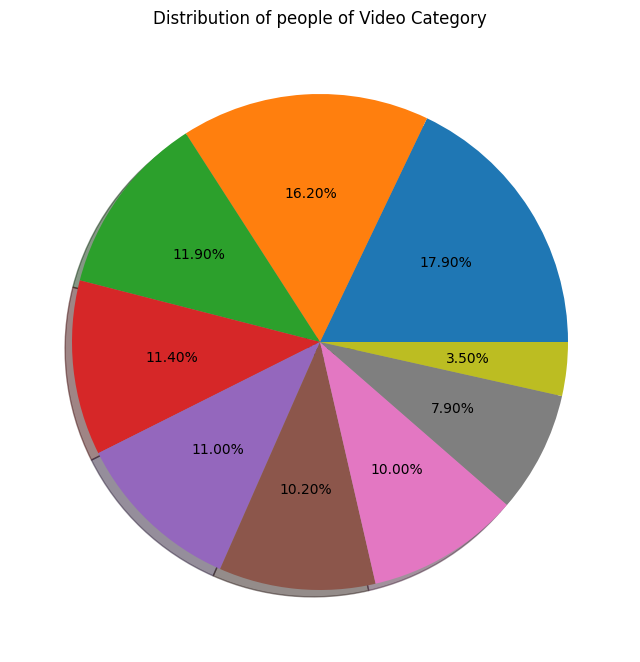

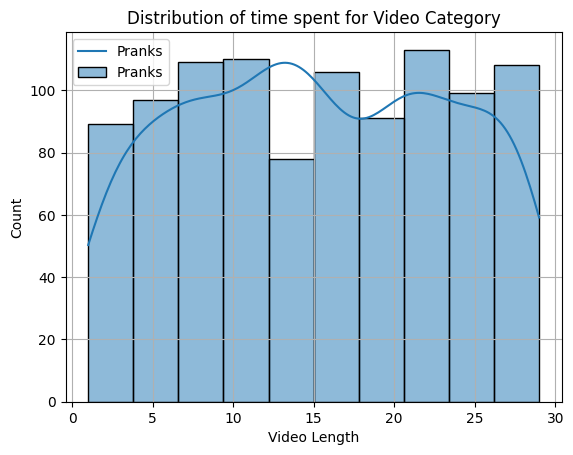

Total Video Length by different groups of Video Category
Video Category
ASMR             1141
Comedy            512
Entertainment    1568
Gaming           1811
Jokes/Memes      2589
Life Hacks       2590
Pranks           1619
Trends           1547
Vlogs            1837
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


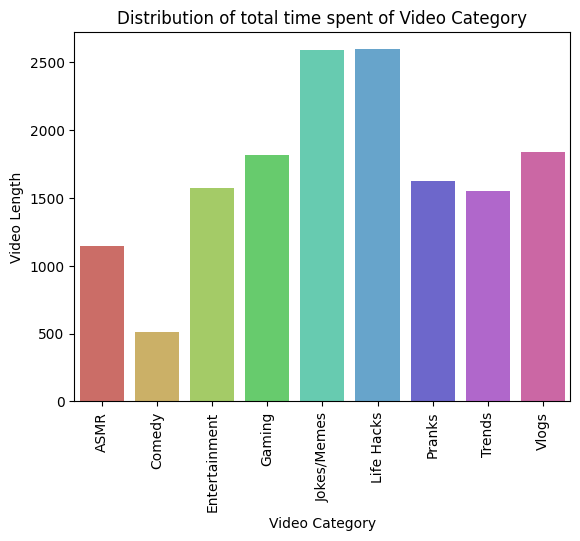

Average Video Length by different groups of Video Category
Video Category
ASMR             14.443038
Comedy           14.628571
Entertainment    15.372549
Gaming           15.218487
Jokes/Memes      14.463687
Life Hacks       15.987654
Pranks           14.718182
Trends           15.470000
Vlogs            16.114035
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


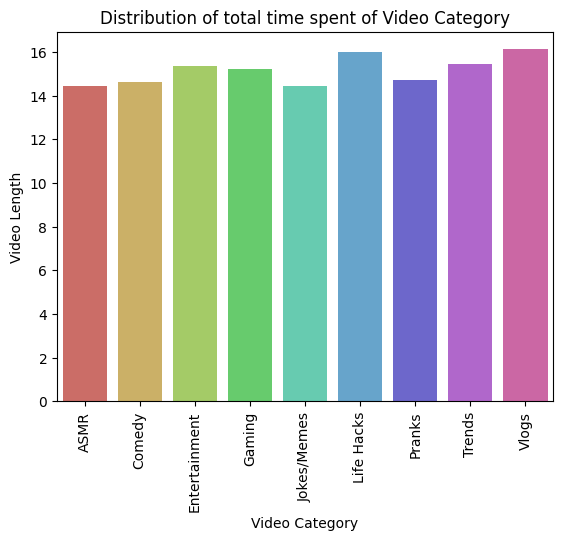

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


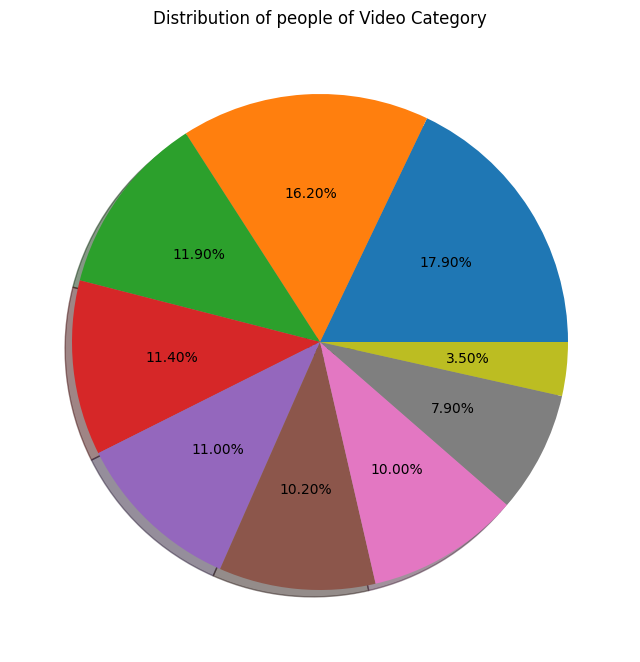

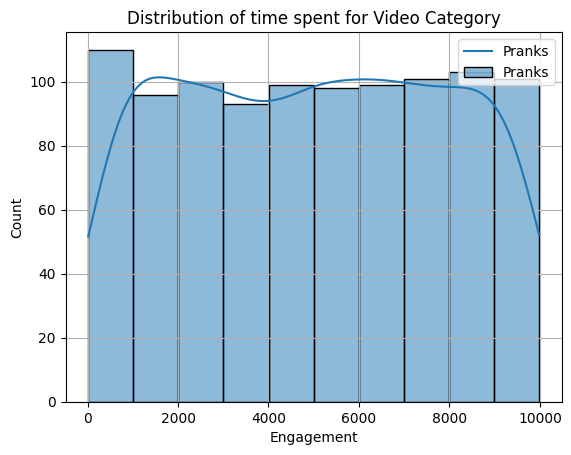

Total Engagement by different groups of Video Category
Video Category
ASMR             352004
Comedy           172908
Entertainment    490879
Gaming           535693
Jokes/Memes      887489
Life Hacks       852747
Pranks           565850
Trends           540770
Vlogs            598819
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


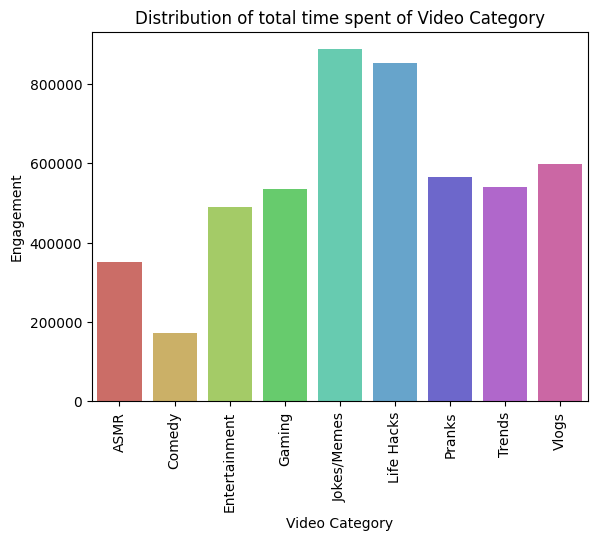

Average Engagement by different groups of Video Category
Video Category
ASMR             4455.746835
Comedy           4940.228571
Entertainment    4812.539216
Gaming           4501.621849
Jokes/Memes      4958.039106
Life Hacks       5263.870370
Pranks           5144.090909
Trends           5407.700000
Vlogs            5252.798246
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


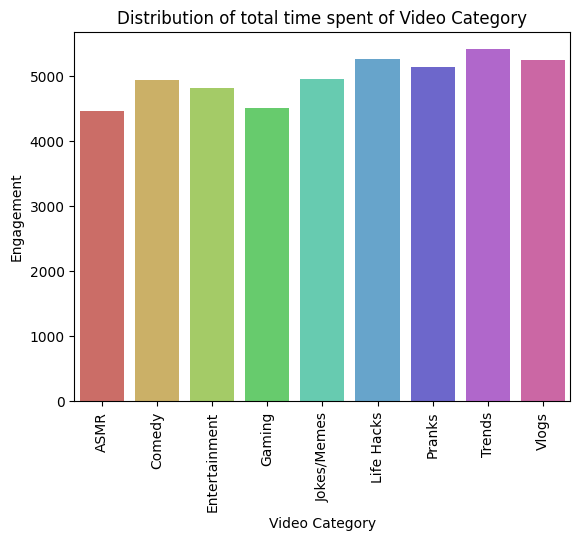

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


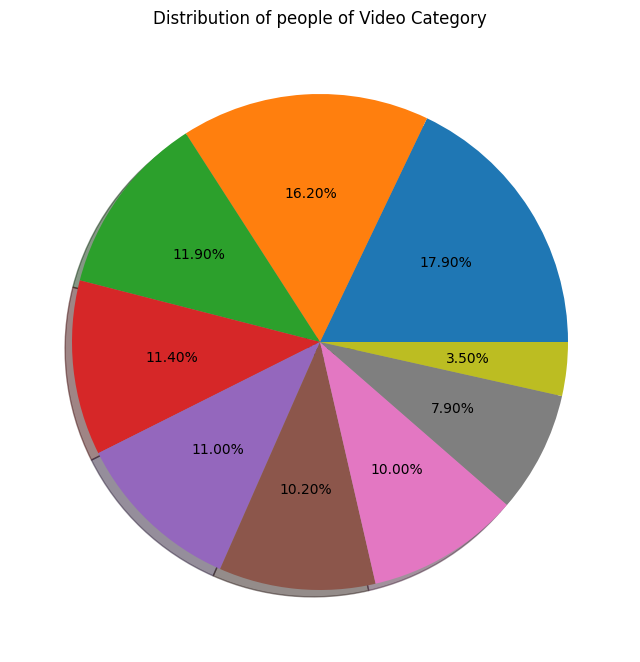

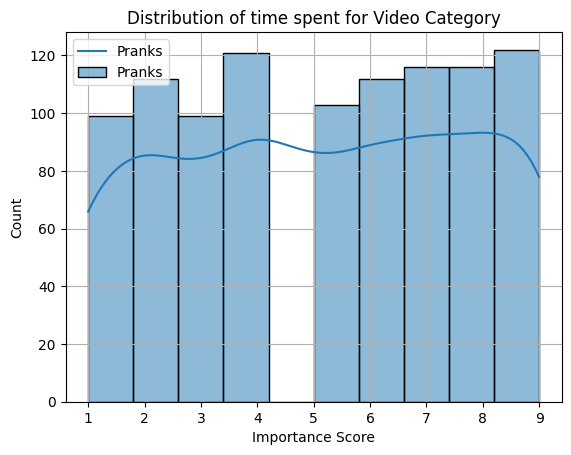

Total Importance Score by different groups of Video Category
Video Category
ASMR             381
Comedy           156
Entertainment    542
Gaming           639
Jokes/Memes      910
Life Hacks       856
Pranks           559
Trends           525
Vlogs            561
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


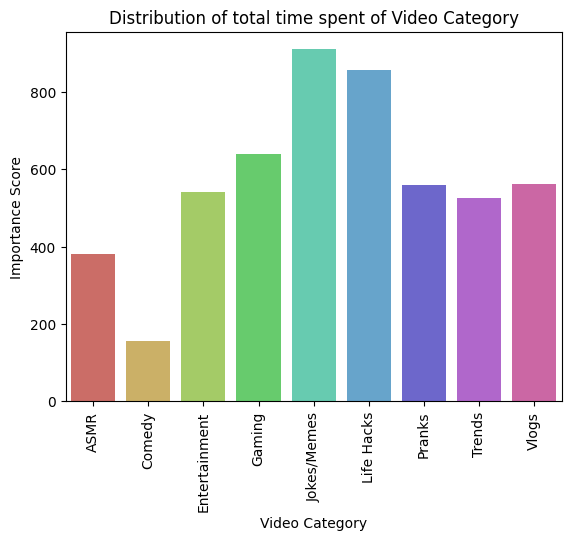

Average Importance Score by different groups of Video Category
Video Category
ASMR             4.822785
Comedy           4.457143
Entertainment    5.313725
Gaming           5.369748
Jokes/Memes      5.083799
Life Hacks       5.283951
Pranks           5.081818
Trends           5.250000
Vlogs            4.921053
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


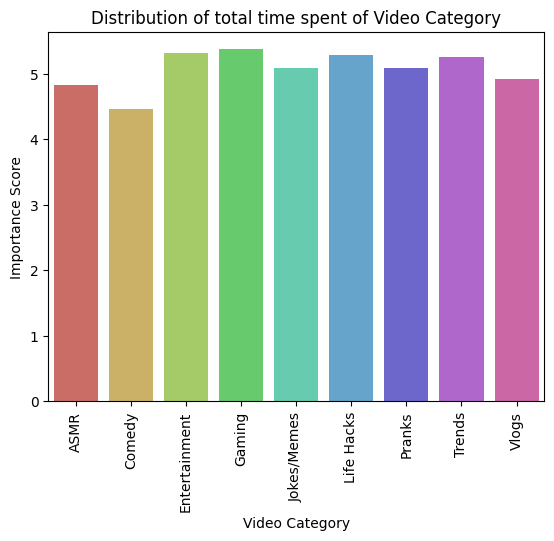

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


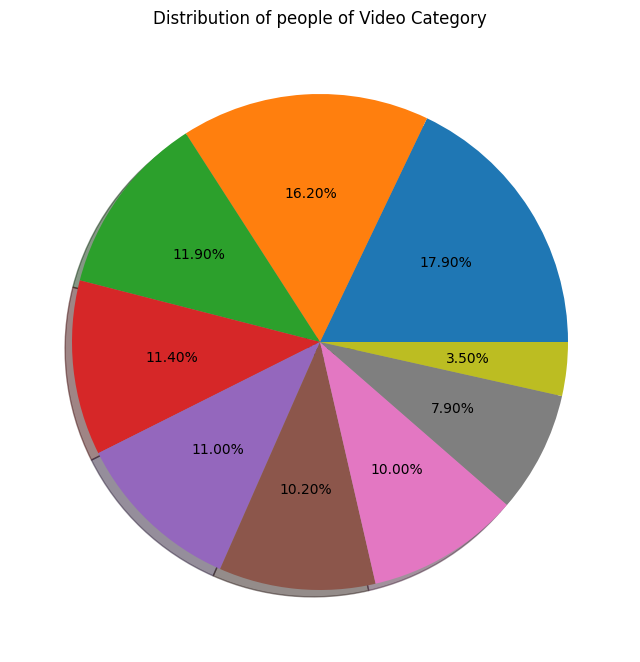

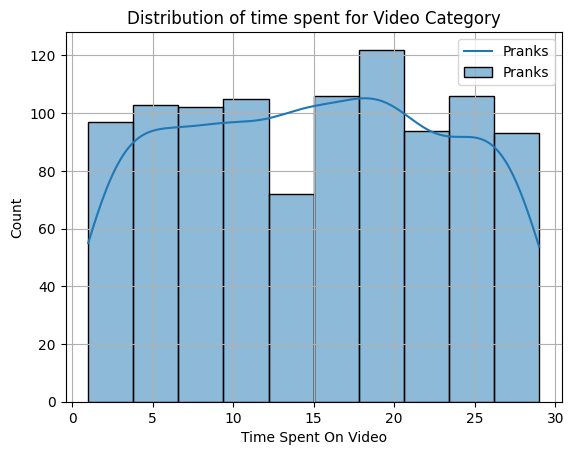

Total Time Spent On Video by different groups of Video Category
Video Category
ASMR             1135
Comedy            513
Entertainment    1547
Gaming           1719
Jokes/Memes      2638
Life Hacks       2397
Pranks           1804
Trends           1420
Vlogs            1800
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


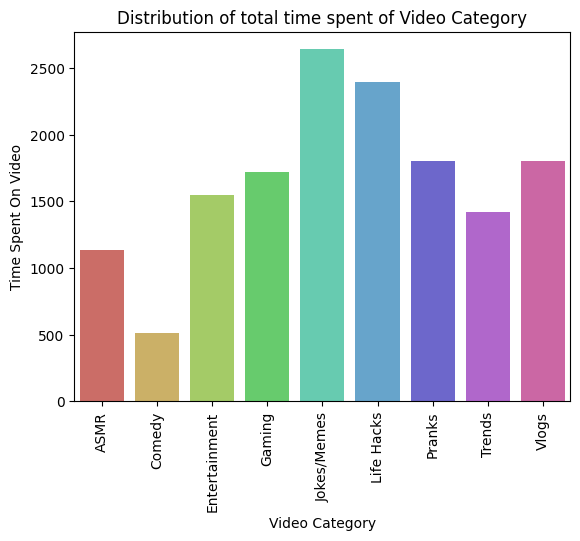

Average Time Spent On Video by different groups of Video Category
Video Category
ASMR             14.367089
Comedy           14.657143
Entertainment    15.166667
Gaming           14.445378
Jokes/Memes      14.737430
Life Hacks       14.796296
Pranks           16.400000
Trends           14.200000
Vlogs            15.789474
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


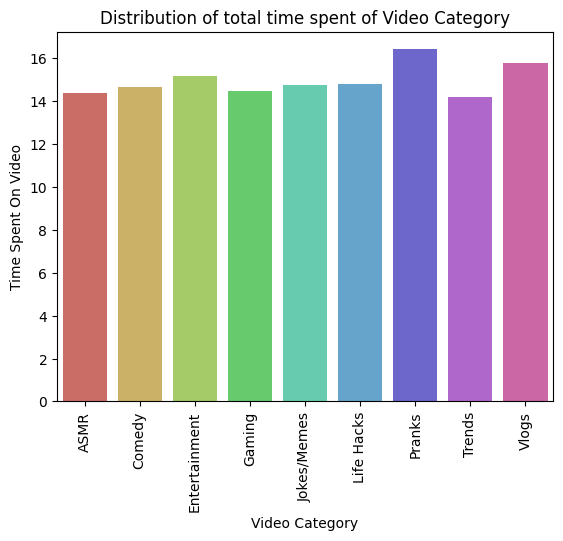

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


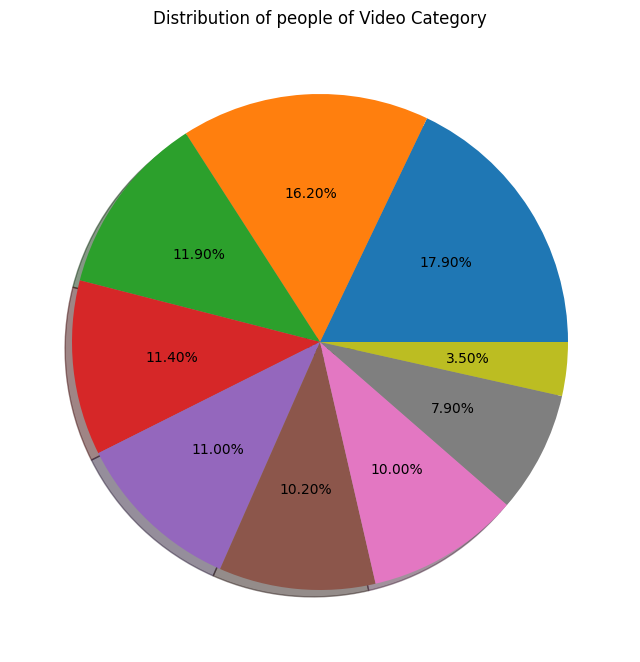

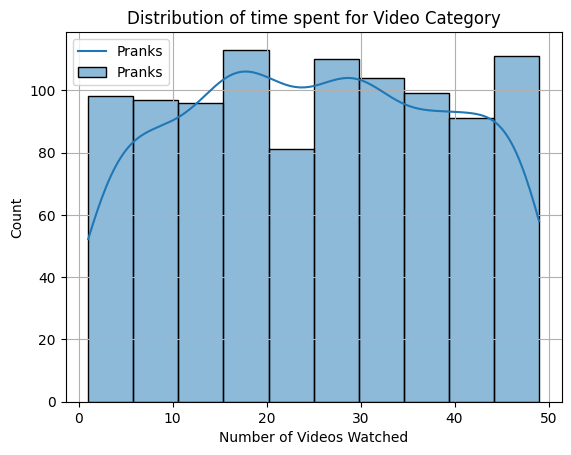

Total Number of Videos Watched by different groups of Video Category
Video Category
ASMR             2038
Comedy            919
Entertainment    2491
Gaming           3069
Jokes/Memes      4552
Life Hacks       4005
Pranks           2682
Trends           2536
Vlogs            2956
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


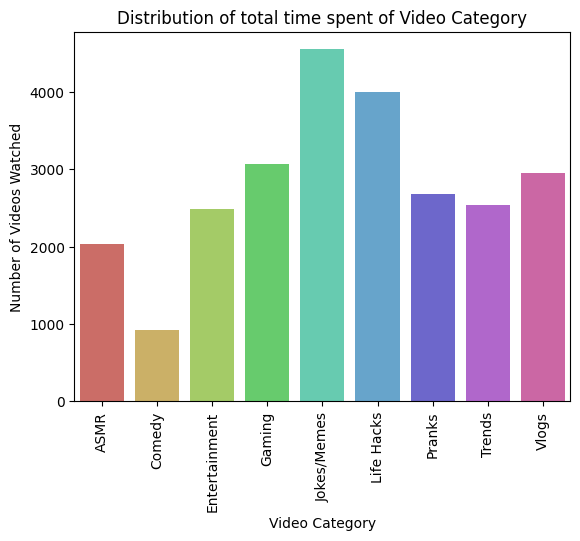

Average Number of Videos Watched by different groups of Video Category
Video Category
ASMR             25.797468
Comedy           26.257143
Entertainment    24.421569
Gaming           25.789916
Jokes/Memes      25.430168
Life Hacks       24.722222
Pranks           24.381818
Trends           25.360000
Vlogs            25.929825
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


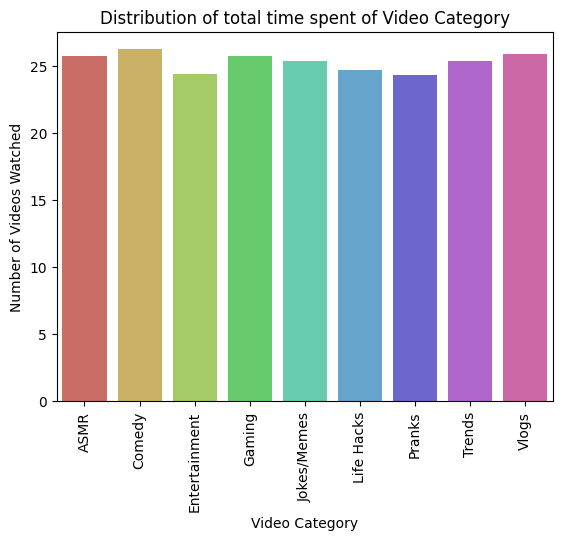

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


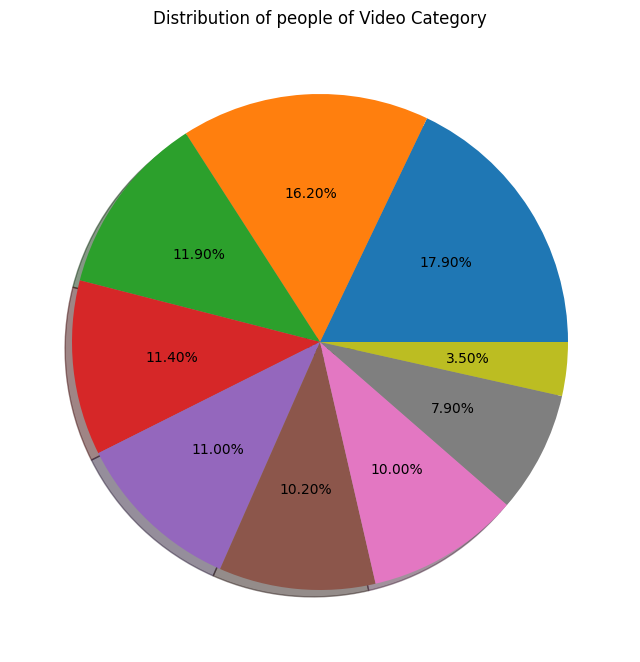

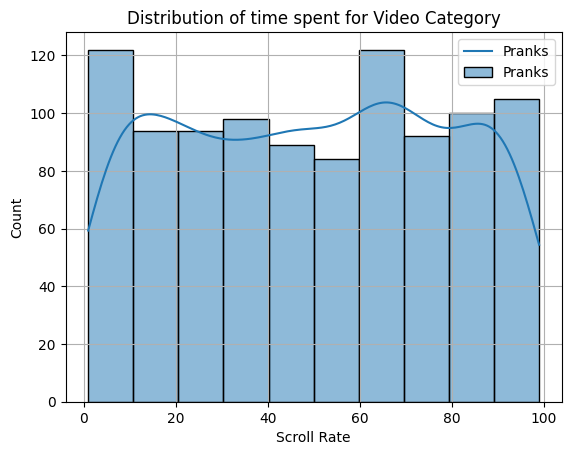

Total Scroll Rate by different groups of Video Category
Video Category
ASMR             4160
Comedy           1747
Entertainment    4787
Gaming           5798
Jokes/Memes      8997
Life Hacks       7662
Pranks           6065
Trends           5157
Vlogs            5401
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


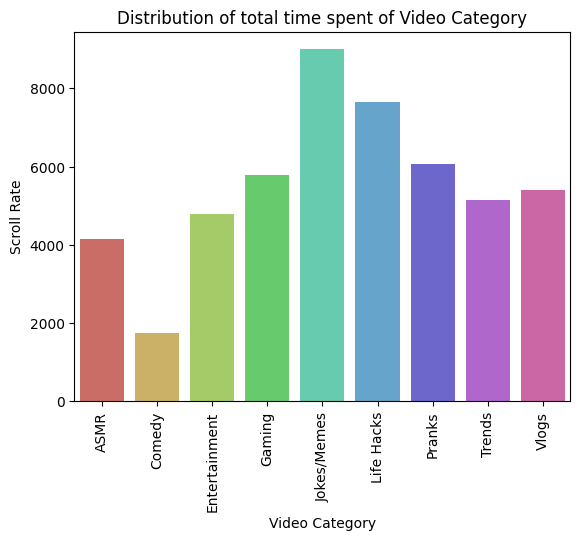

Average Scroll Rate by different groups of Video Category
Video Category
ASMR             52.658228
Comedy           49.914286
Entertainment    46.931373
Gaming           48.722689
Jokes/Memes      50.262570
Life Hacks       47.296296
Pranks           55.136364
Trends           51.570000
Vlogs            47.377193
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


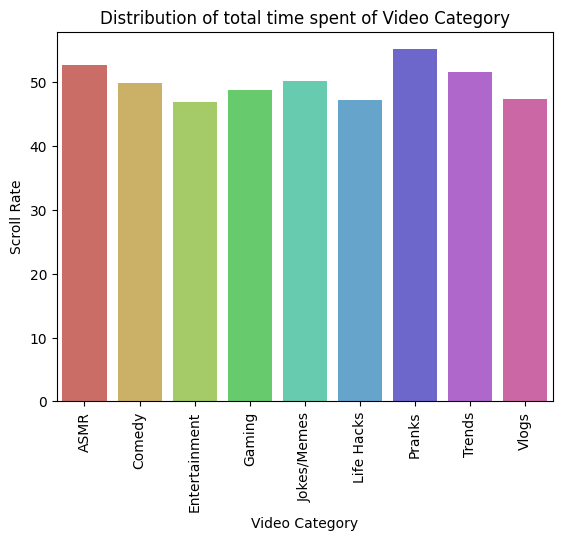

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


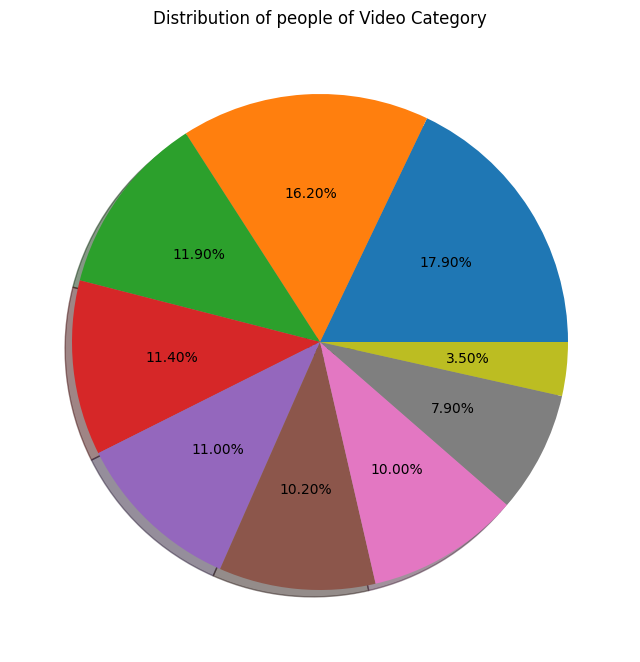

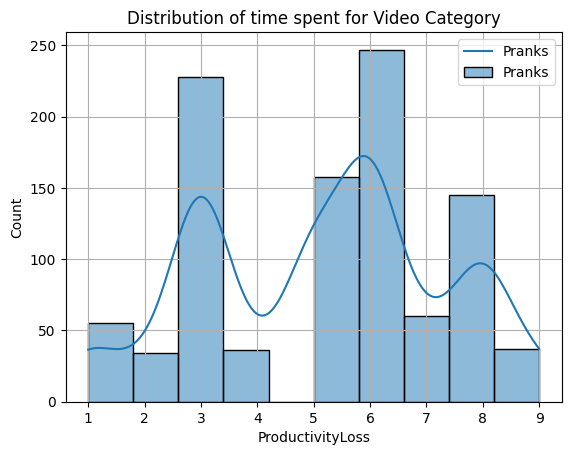

Total ProductivityLoss by different groups of Video Category
Video Category
ASMR             422
Comedy           184
Entertainment    496
Gaming           595
Jokes/Memes      961
Life Hacks       818
Pranks           595
Trends           476
Vlogs            589
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


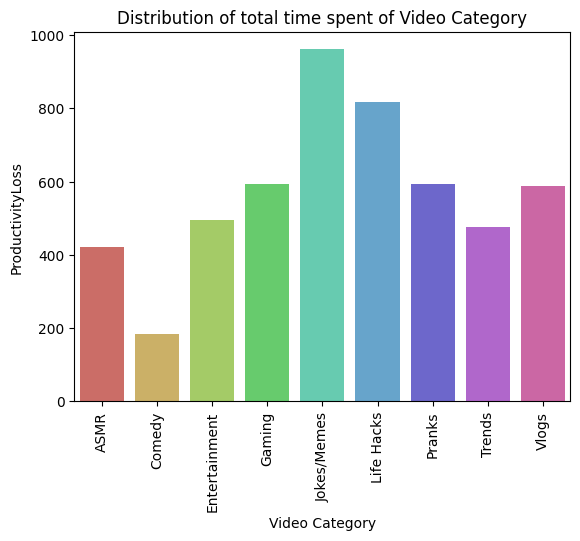

Average ProductivityLoss by different groups of Video Category
Video Category
ASMR             5.341772
Comedy           5.257143
Entertainment    4.862745
Gaming           5.000000
Jokes/Memes      5.368715
Life Hacks       5.049383
Pranks           5.409091
Trends           4.760000
Vlogs            5.166667
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


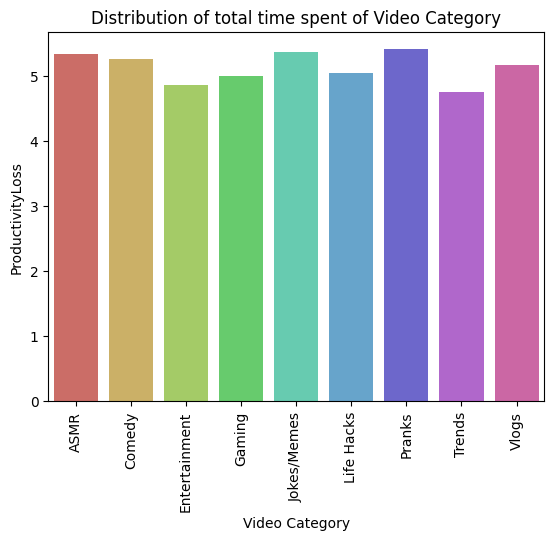

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


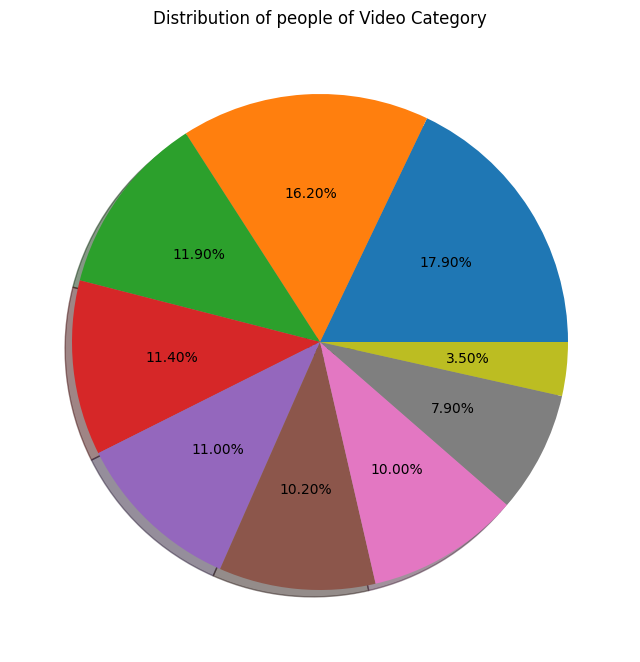

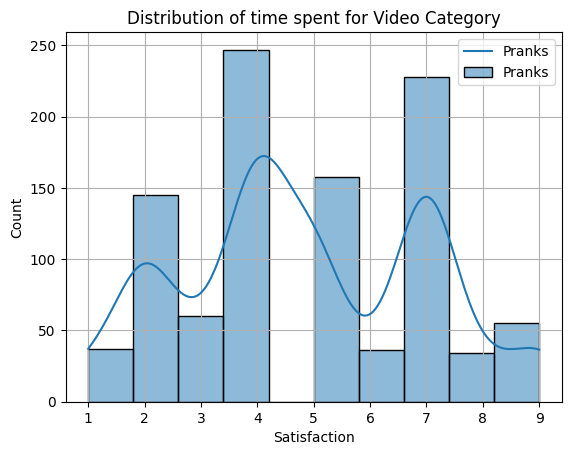

Total Satisfaction by different groups of Video Category
Video Category
ASMR             368
Comedy           166
Entertainment    524
Gaming           595
Jokes/Memes      829
Life Hacks       802
Pranks           505
Trends           524
Vlogs            551
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


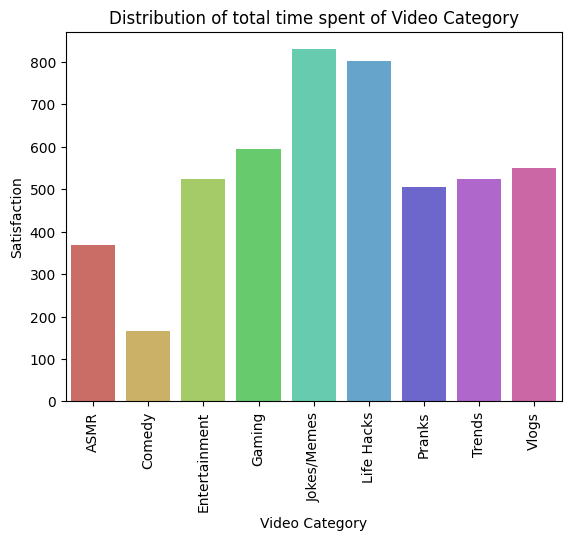

Average Satisfaction by different groups of Video Category
Video Category
ASMR             4.658228
Comedy           4.742857
Entertainment    5.137255
Gaming           5.000000
Jokes/Memes      4.631285
Life Hacks       4.950617
Pranks           4.590909
Trends           5.240000
Vlogs            4.833333
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


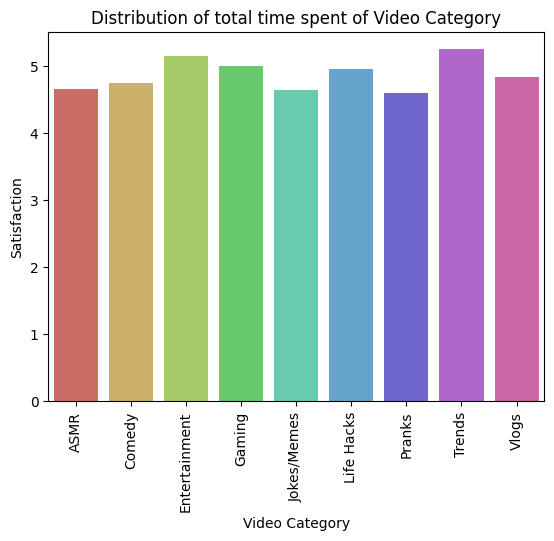

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


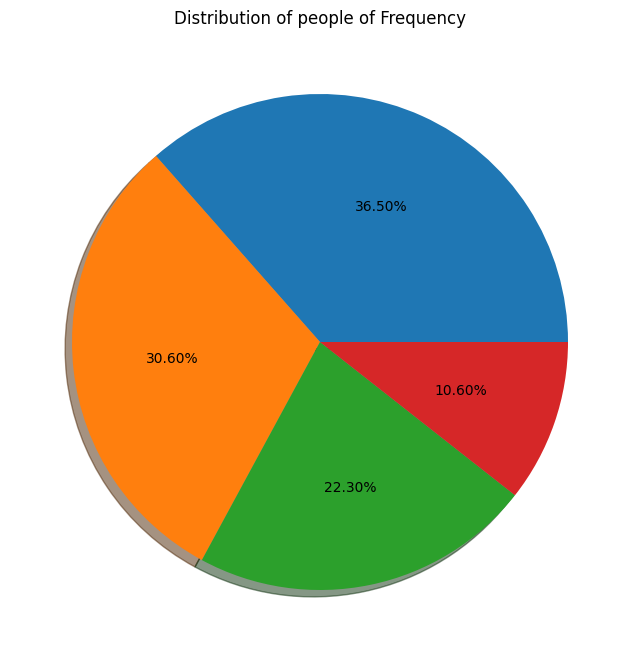

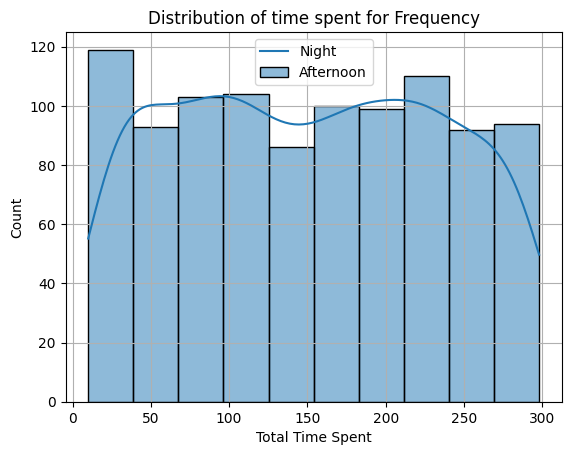

Total Total Time Spent by different groups of Frequency
Frequency
Afternoon    32400
Evening      56757
Morning      15646
Night        46603
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


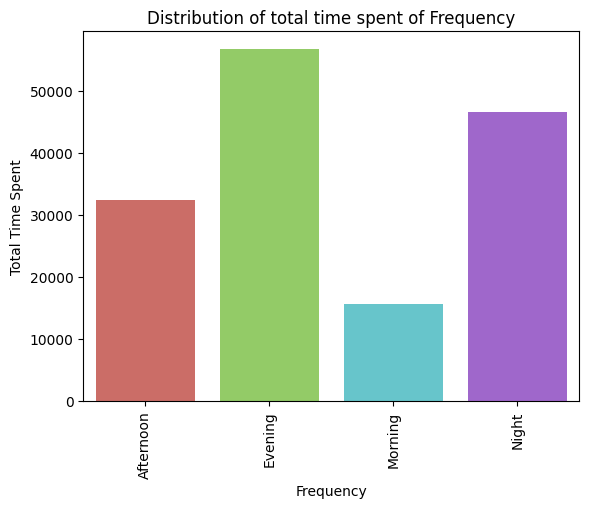

Average Total Time Spent by different groups of Frequency
Frequency
Afternoon    145.291480
Evening      155.498630
Morning      147.603774
Night        152.297386
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


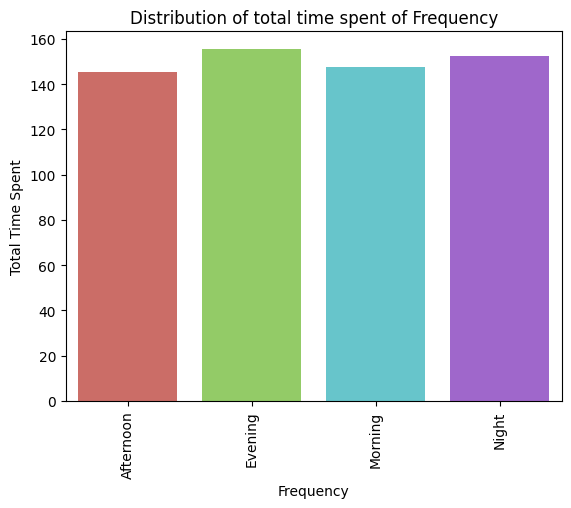

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


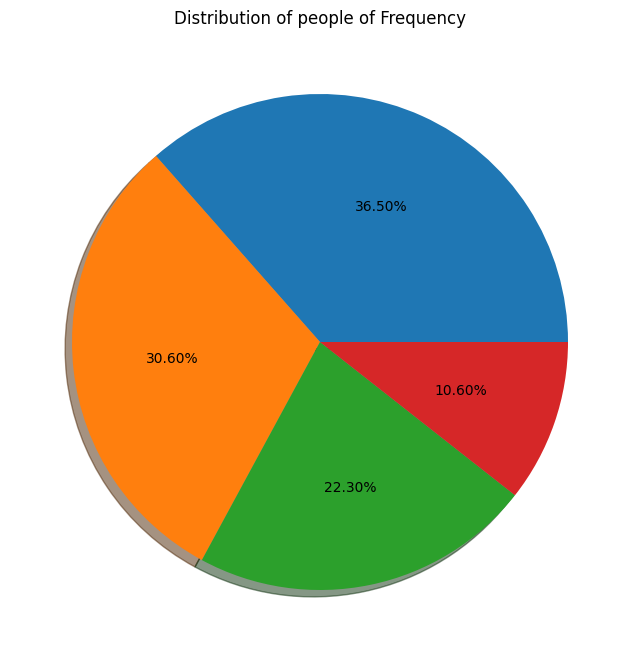

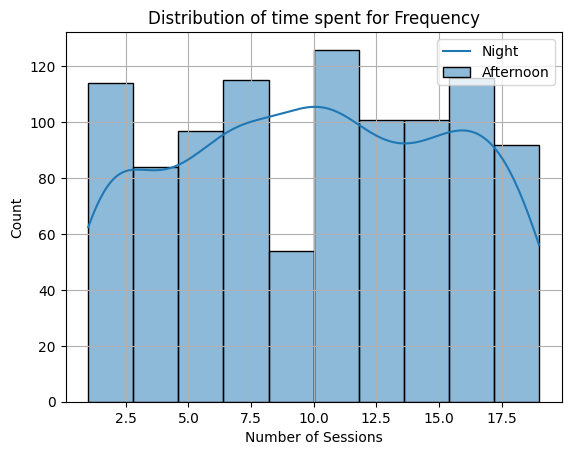

Total Number of Sessions by different groups of Frequency
Frequency
Afternoon    2140
Evening      3662
Morning      1190
Night        3021
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


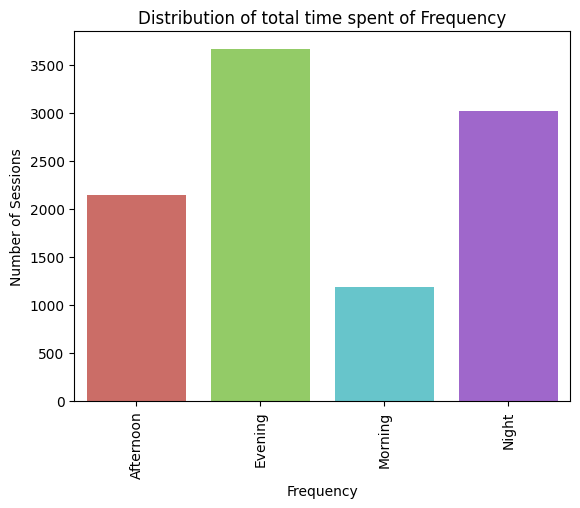

Average Number of Sessions by different groups of Frequency
Frequency
Afternoon     9.596413
Evening      10.032877
Morning      11.226415
Night         9.872549
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


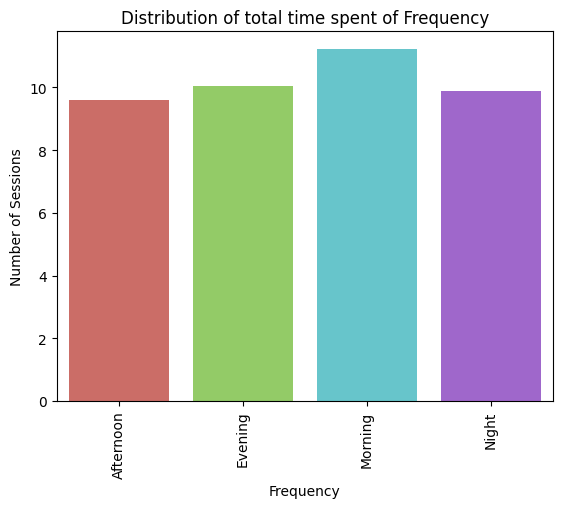

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


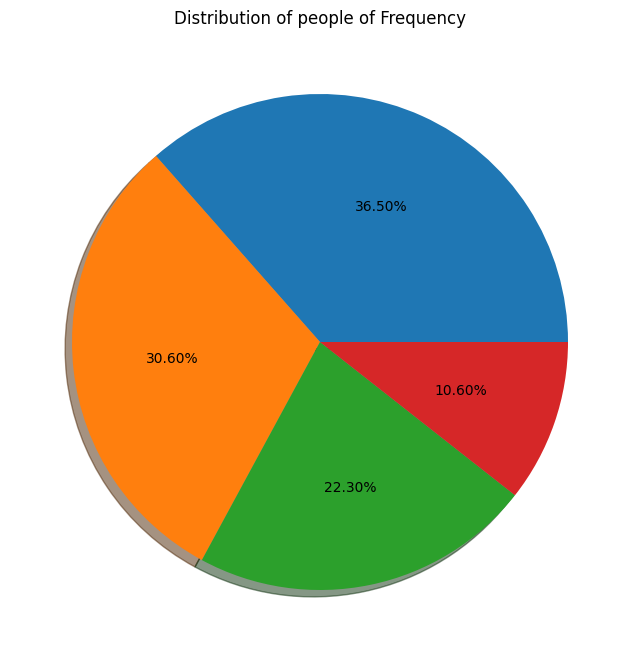

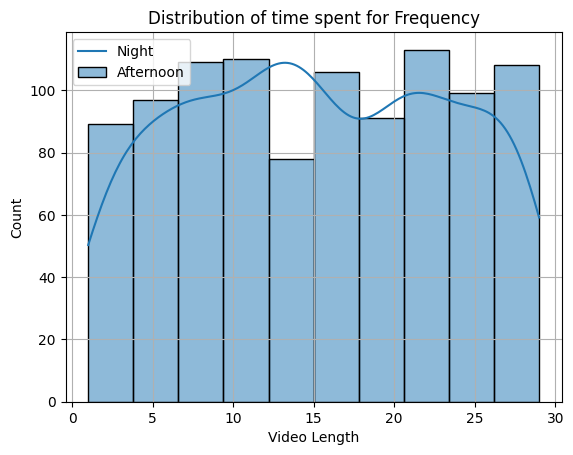

Total Video Length by different groups of Frequency
Frequency
Afternoon    3426
Evening      5412
Morning      1731
Night        4645
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


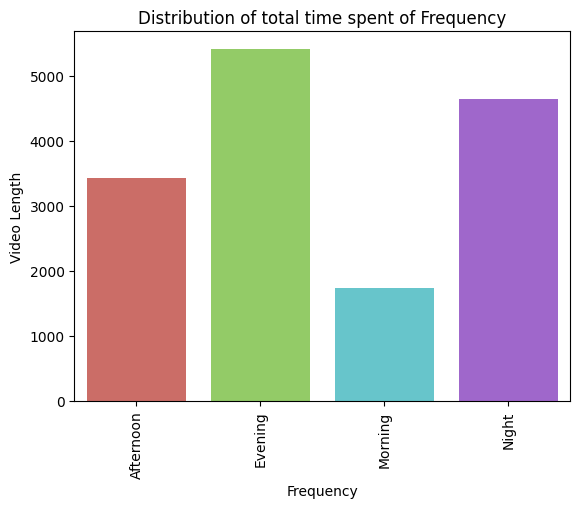

Average Video Length by different groups of Frequency
Frequency
Afternoon    15.363229
Evening      14.827397
Morning      16.330189
Night        15.179739
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


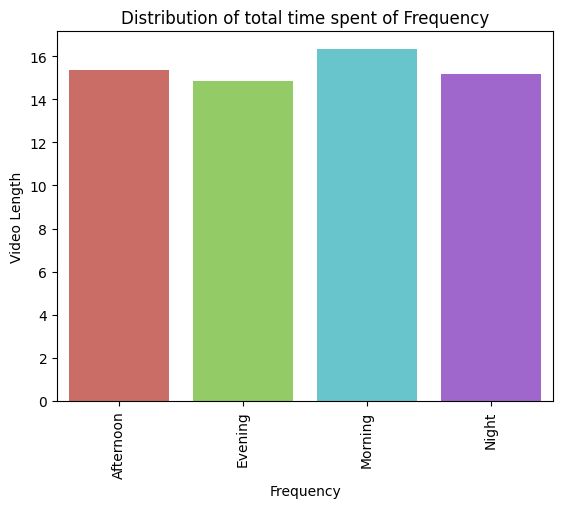

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


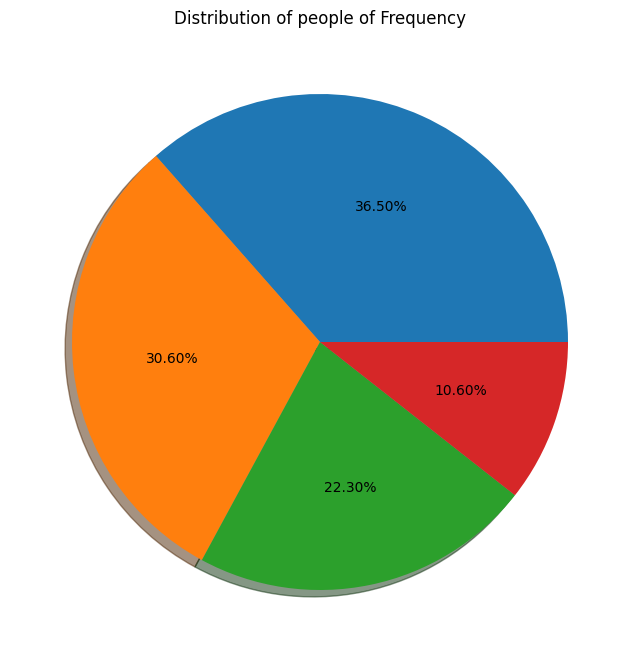

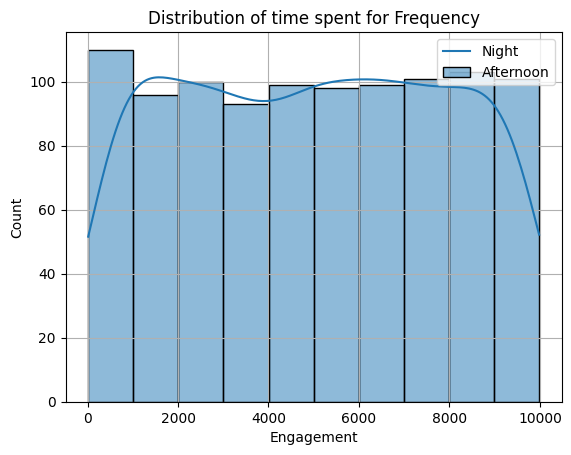

Total Engagement by different groups of Frequency
Frequency
Afternoon    1086830
Evening      1803965
Morning       511912
Night        1594452
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


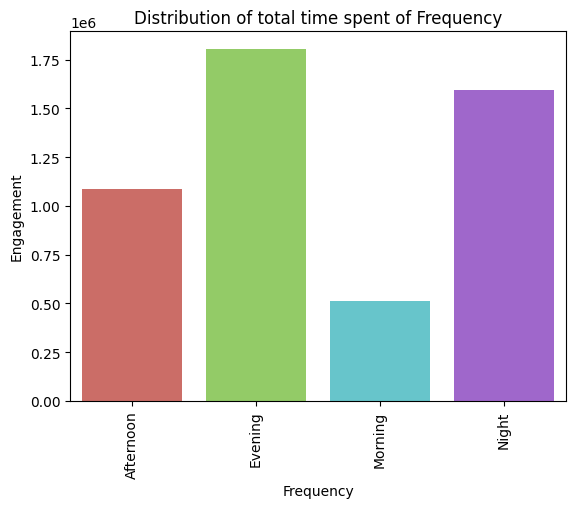

Average Engagement by different groups of Frequency
Frequency
Afternoon    4873.677130
Evening      4942.369863
Morning      4829.358491
Night        5210.627451
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


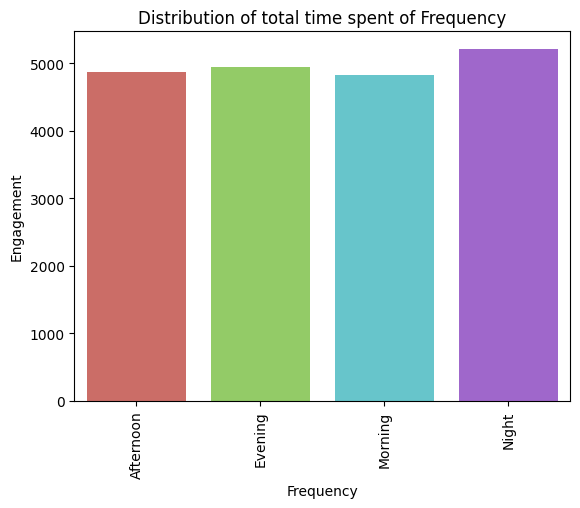

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


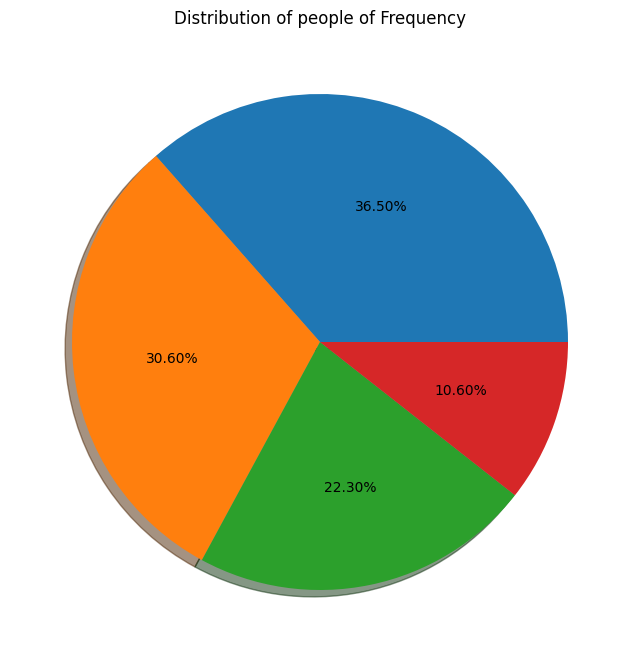

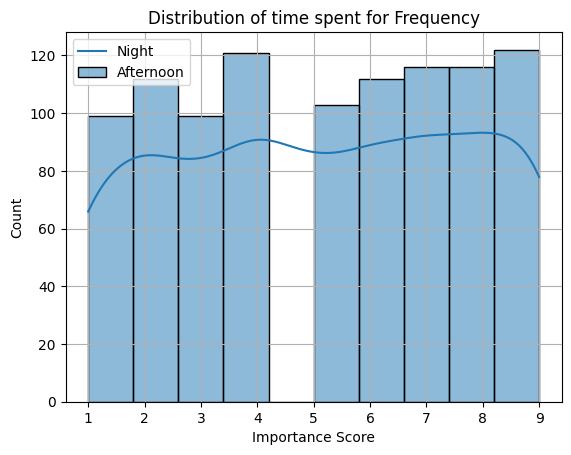

Total Importance Score by different groups of Frequency
Frequency
Afternoon    1156
Evening      1814
Morning       560
Night        1599
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


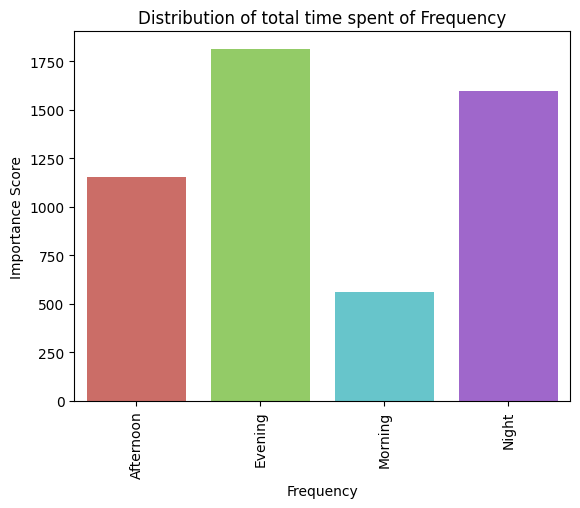

Average Importance Score by different groups of Frequency
Frequency
Afternoon    5.183857
Evening      4.969863
Morning      5.283019
Night        5.225490
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


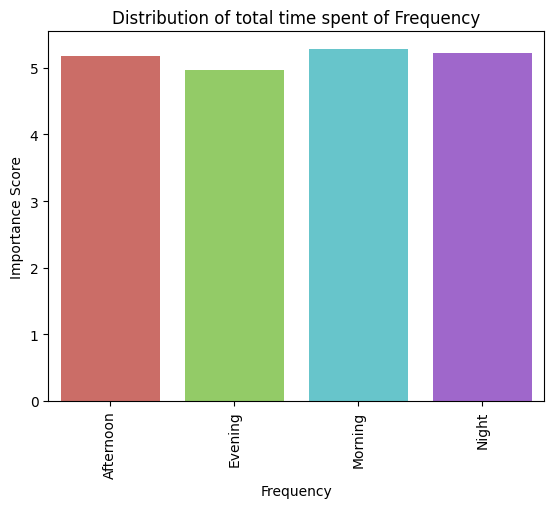

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


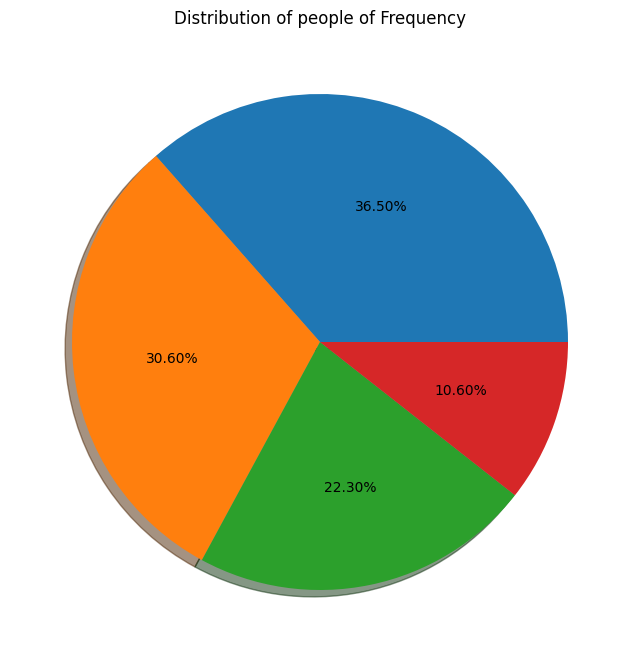

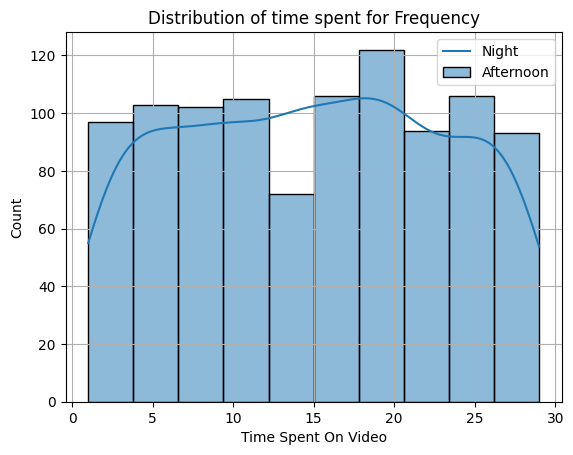

Total Time Spent On Video by different groups of Frequency
Frequency
Afternoon    3369
Evening      5444
Morning      1638
Night        4522
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


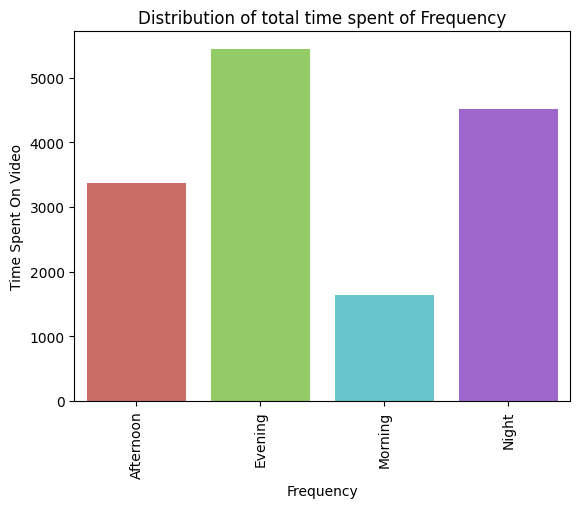

Average Time Spent On Video by different groups of Frequency
Frequency
Afternoon    15.107623
Evening      14.915068
Morning      15.452830
Night        14.777778
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


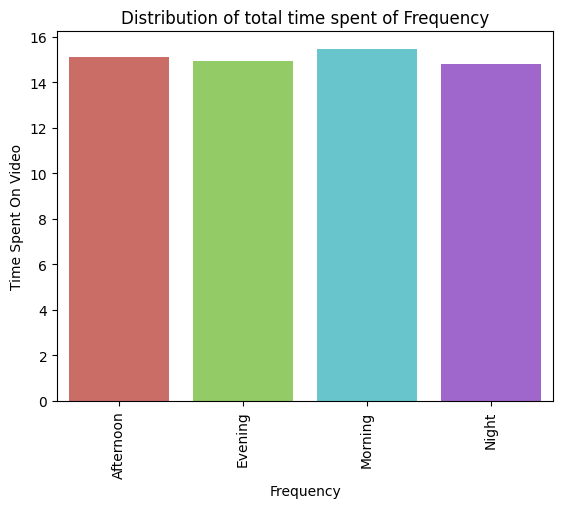

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


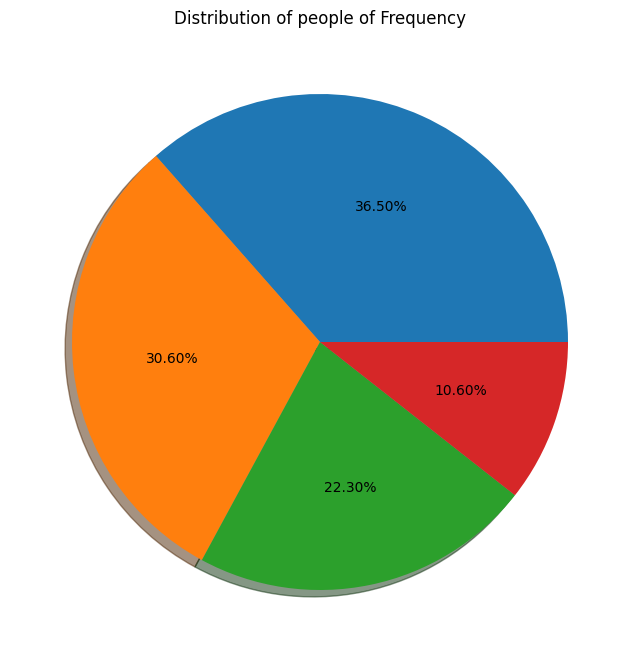

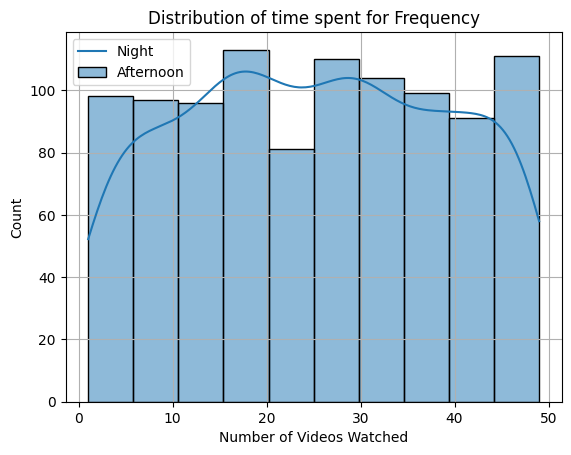

Total Number of Videos Watched by different groups of Frequency
Frequency
Afternoon    5613
Evening      9048
Morning      2705
Night        7882
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


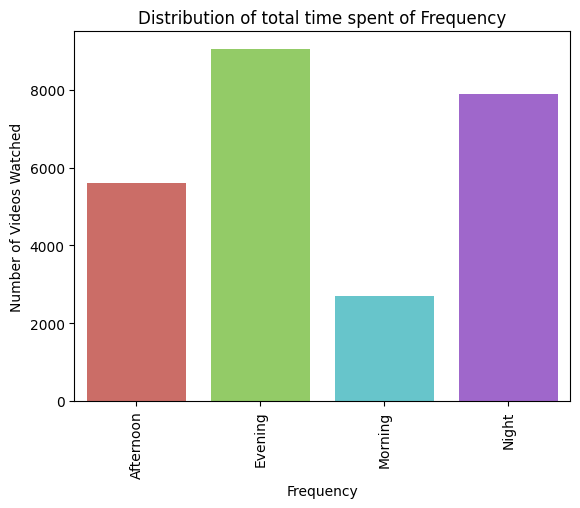

Average Number of Videos Watched by different groups of Frequency
Frequency
Afternoon    25.170404
Evening      24.789041
Morning      25.518868
Night        25.758170
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


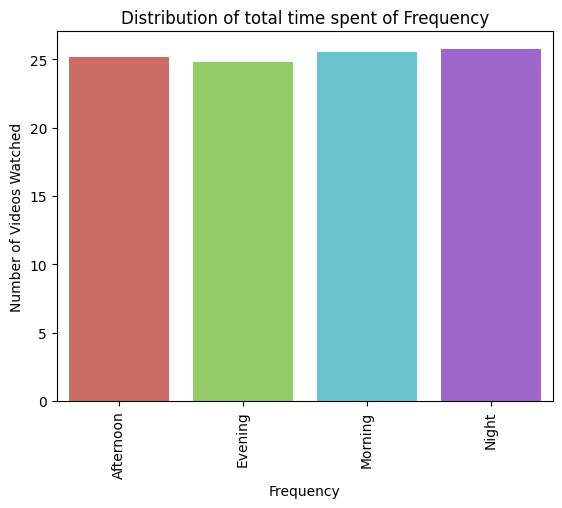

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


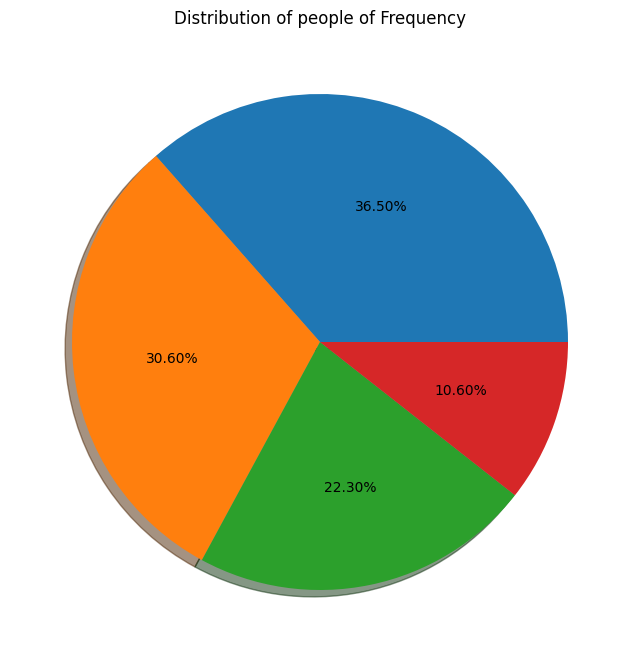

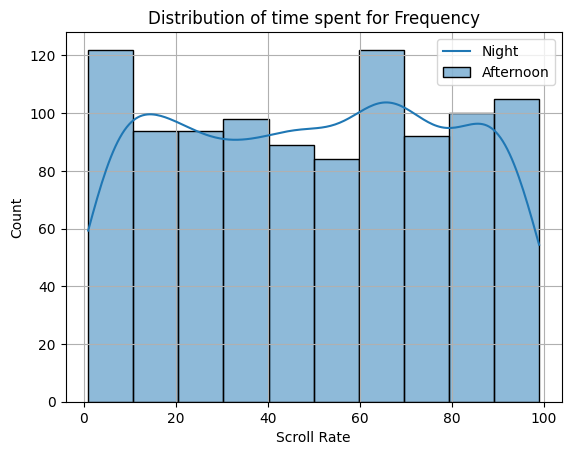

Total Scroll Rate by different groups of Frequency
Frequency
Afternoon    10796
Evening      17932
Morning       5462
Night        15584
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


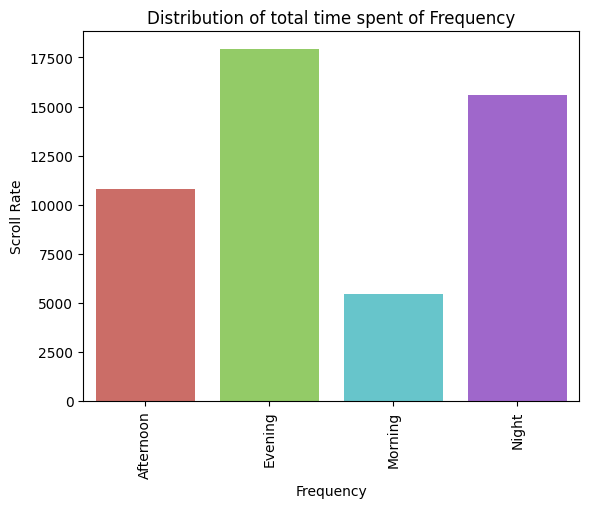

Average Scroll Rate by different groups of Frequency
Frequency
Afternoon    48.412556
Evening      49.128767
Morning      51.528302
Night        50.928105
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


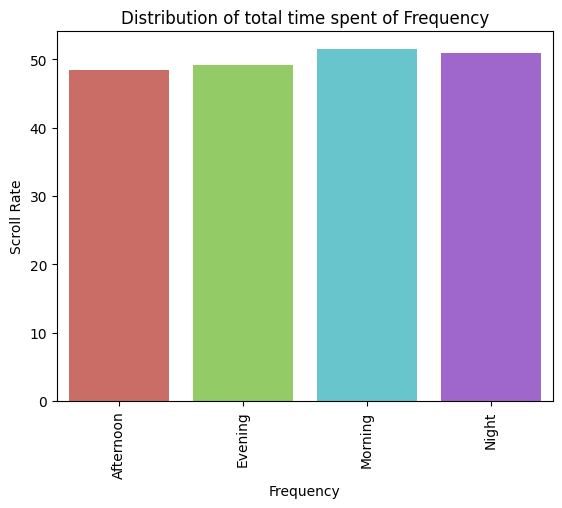

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


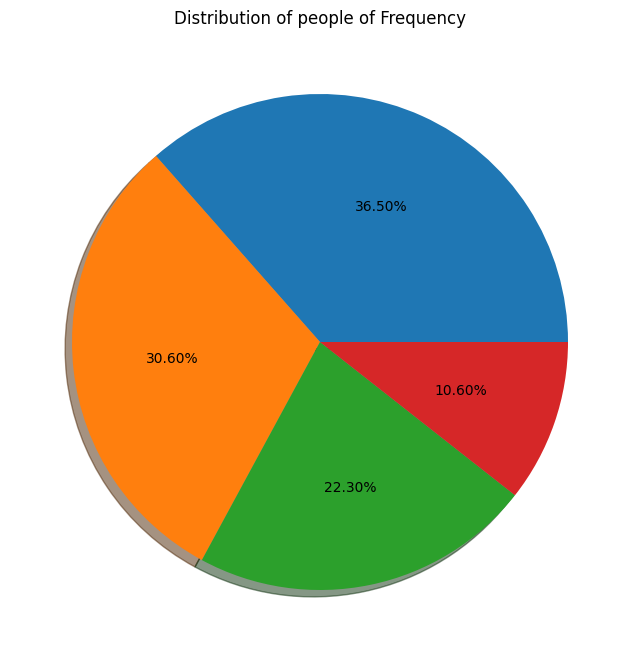

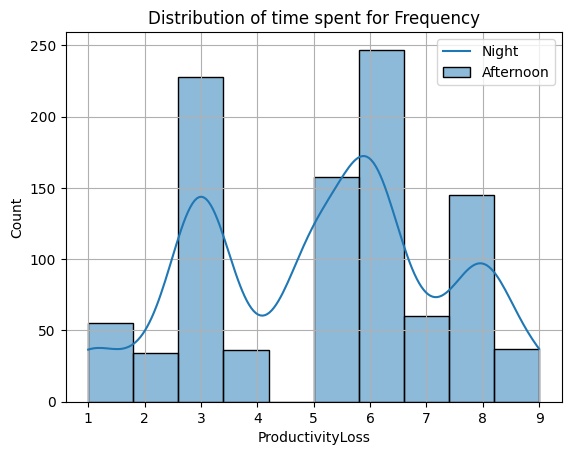

Total ProductivityLoss by different groups of Frequency
Frequency
Afternoon    1192
Evening      2150
Morning       794
Night        1000
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


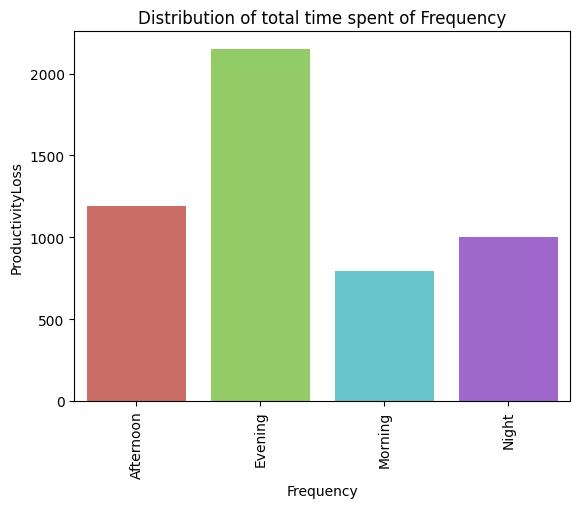

Average ProductivityLoss by different groups of Frequency
Frequency
Afternoon    5.345291
Evening      5.890411
Morning      7.490566
Night        3.267974
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


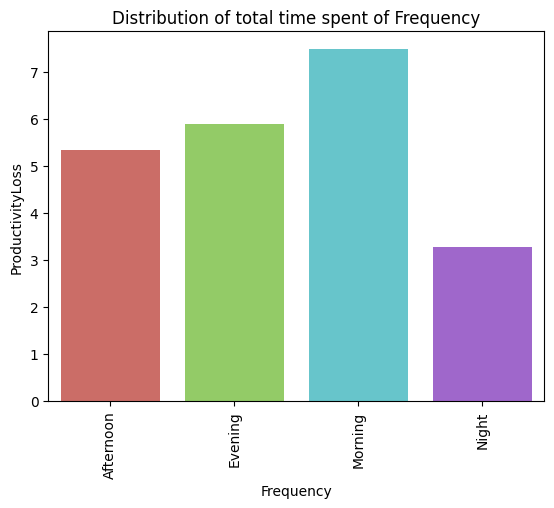

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


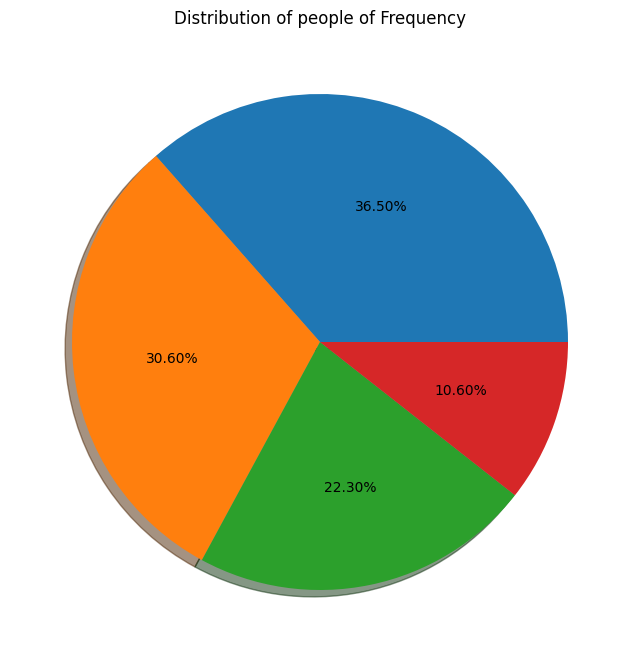

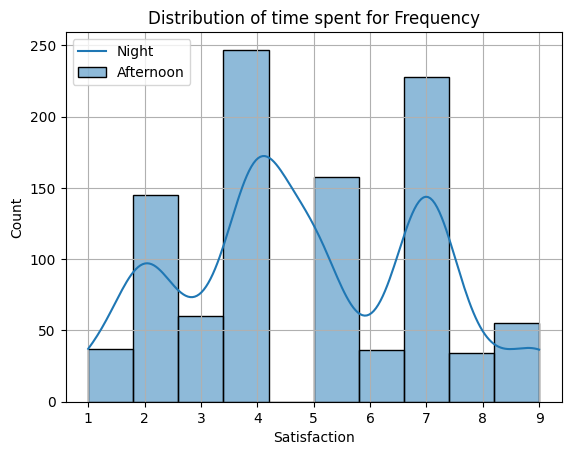

Total Satisfaction by different groups of Frequency
Frequency
Afternoon    1038
Evening      1500
Morning       266
Night        2060
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


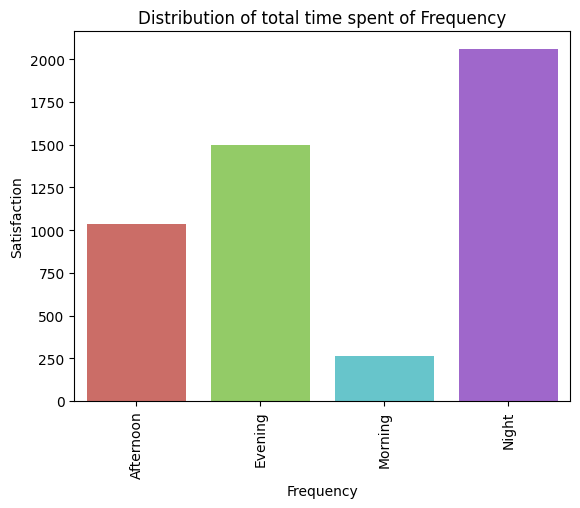

Average Satisfaction by different groups of Frequency
Frequency
Afternoon    4.654709
Evening      4.109589
Morning      2.509434
Night        6.732026
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


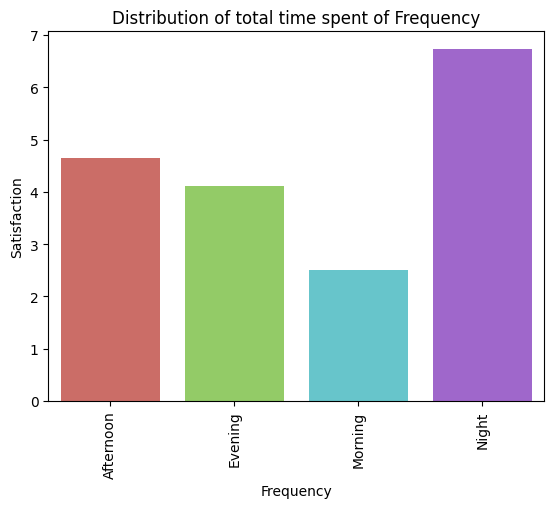

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


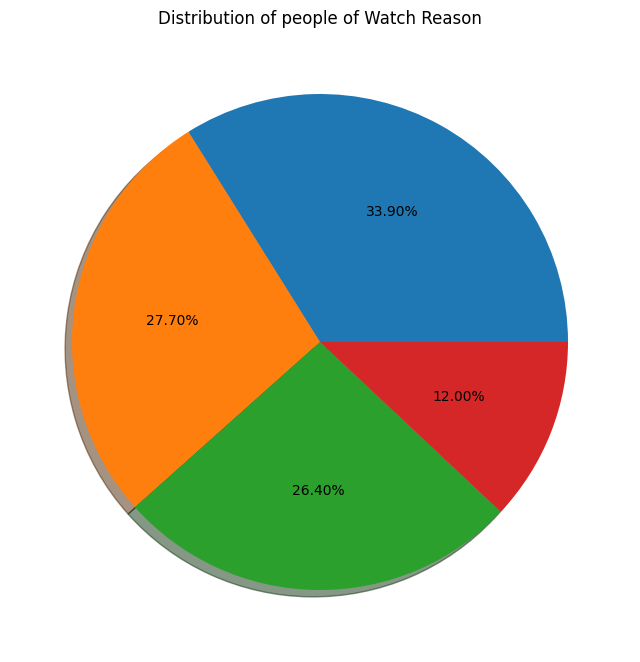

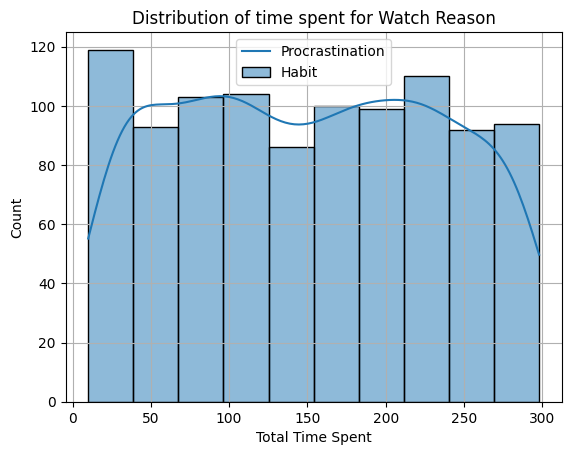

Total Total Time Spent by different groups of Watch Reason
Watch Reason
Boredom            40137
Entertainment      39564
Habit              53883
Procrastination    17822
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


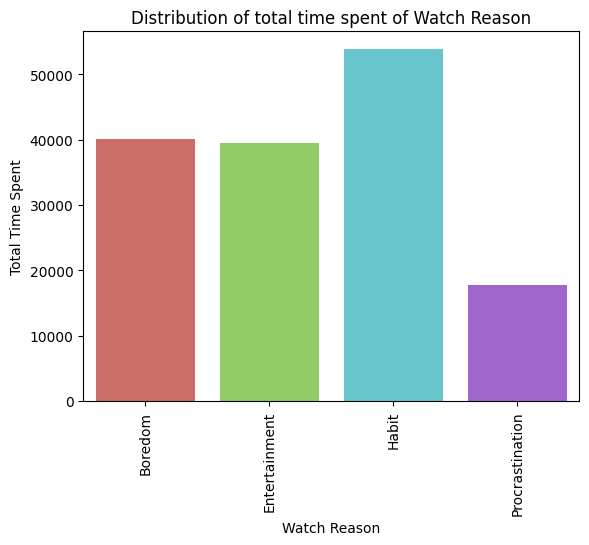

Average Total Time Spent by different groups of Watch Reason
Watch Reason
Boredom            144.898917
Entertainment      149.863636
Habit              158.946903
Procrastination    148.516667
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


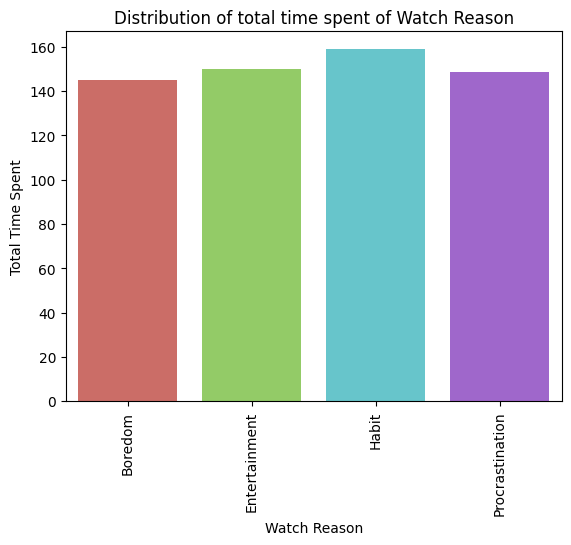

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


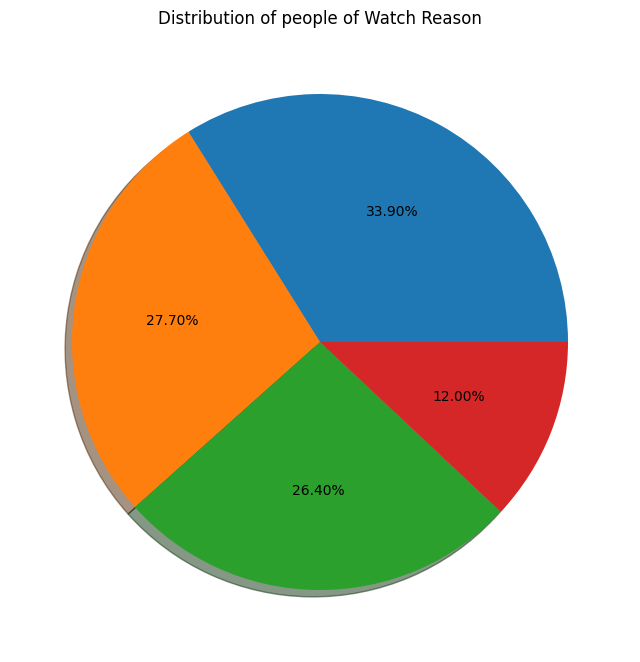

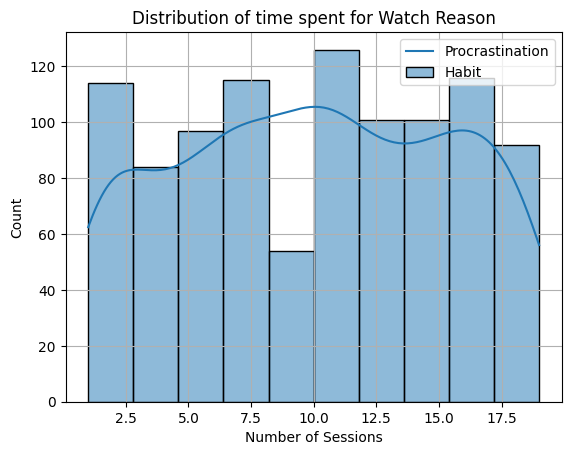

Total Number of Sessions by different groups of Watch Reason
Watch Reason
Boredom            2897
Entertainment      2576
Habit              3322
Procrastination    1218
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


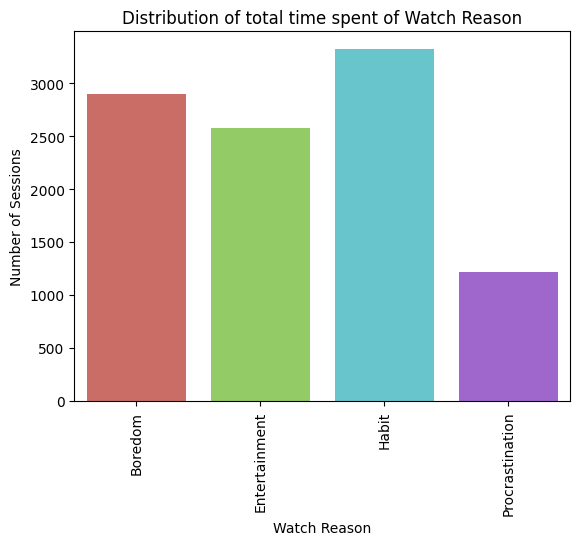

Average Number of Sessions by different groups of Watch Reason
Watch Reason
Boredom            10.458484
Entertainment       9.757576
Habit               9.799410
Procrastination    10.150000
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


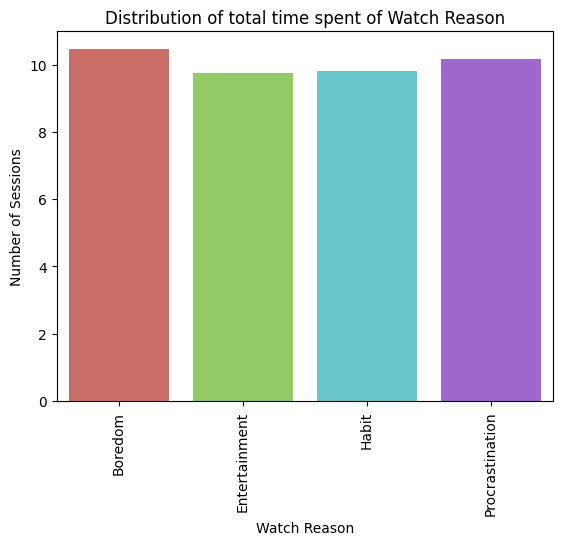

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


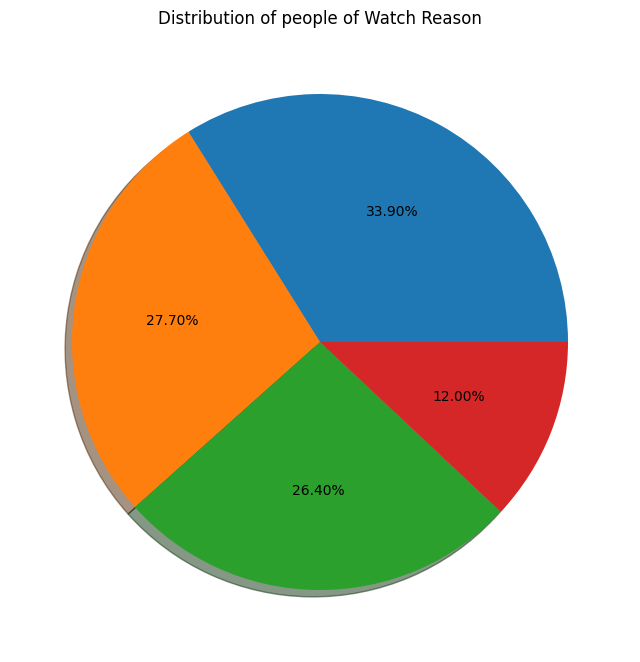

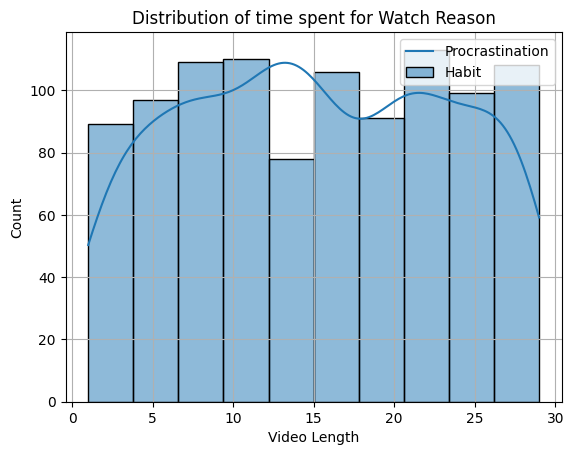

Total Video Length by different groups of Watch Reason
Watch Reason
Boredom            4182
Entertainment      3992
Habit              5264
Procrastination    1776
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


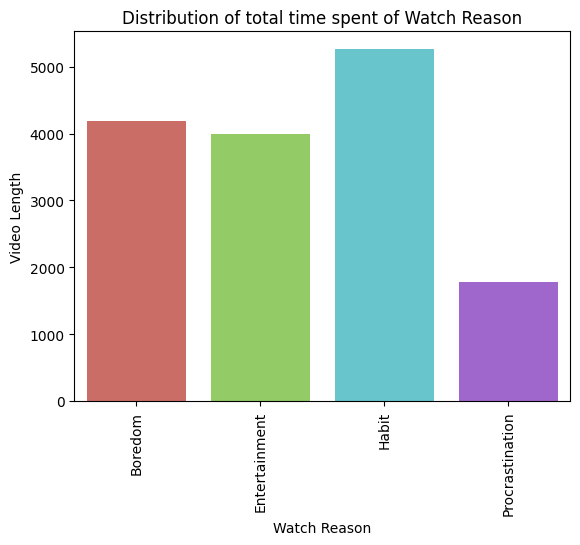

Average Video Length by different groups of Watch Reason
Watch Reason
Boredom            15.097473
Entertainment      15.121212
Habit              15.528024
Procrastination    14.800000
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


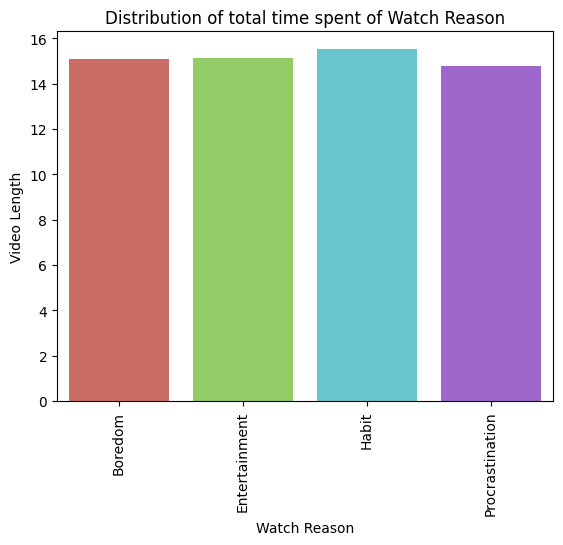

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


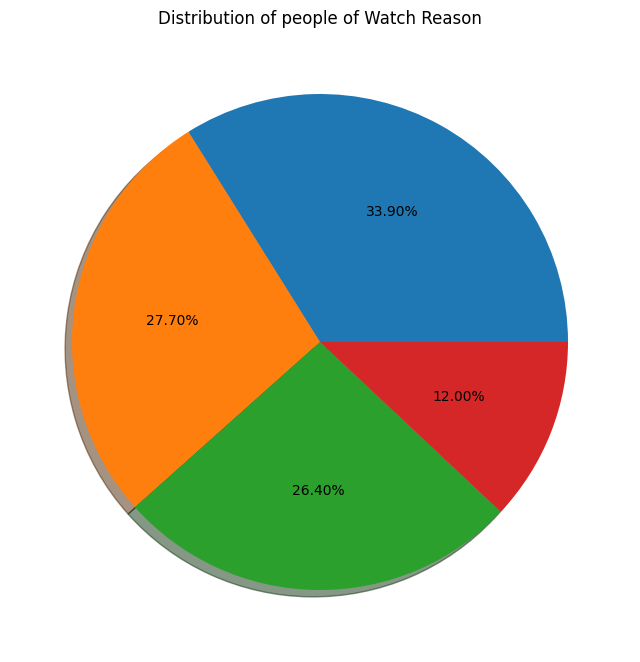

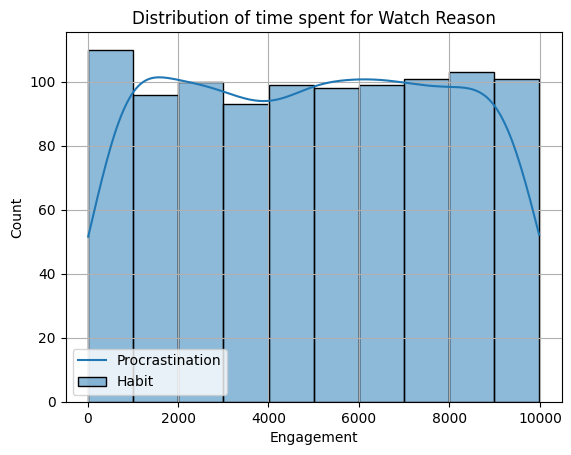

Total Engagement by different groups of Watch Reason
Watch Reason
Boredom            1377068
Entertainment      1311304
Habit              1703549
Procrastination     605238
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


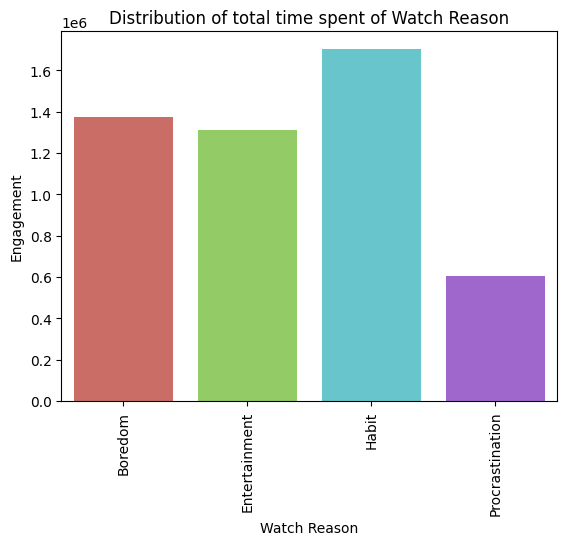

Average Engagement by different groups of Watch Reason
Watch Reason
Boredom            4971.364621
Entertainment      4967.060606
Habit              5025.218289
Procrastination    5043.650000
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


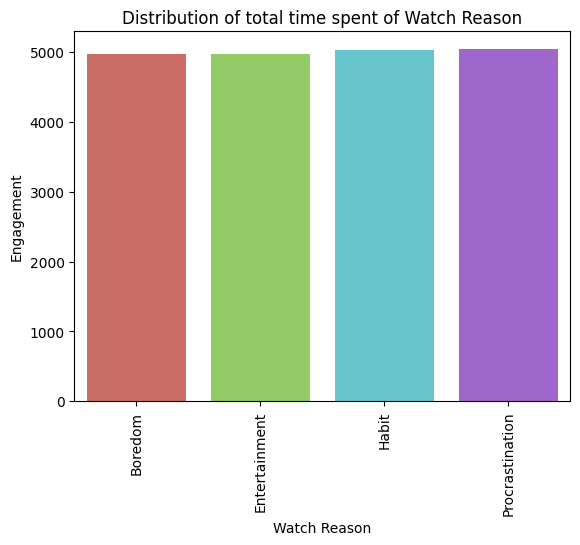

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


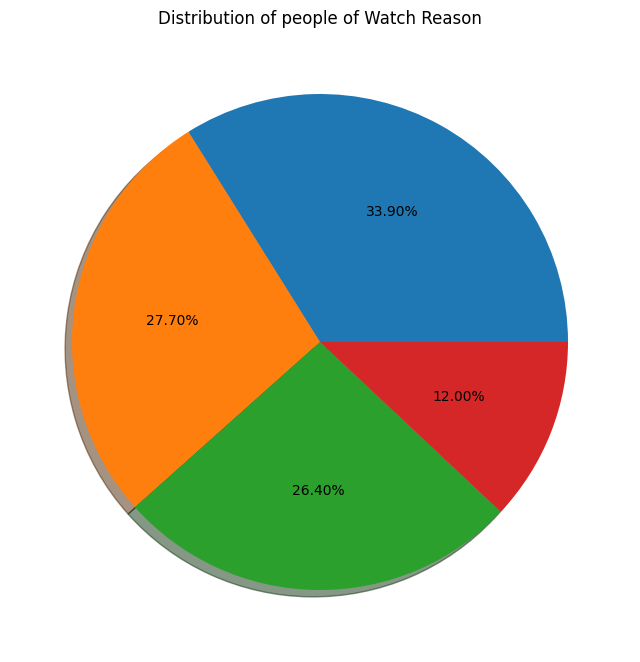

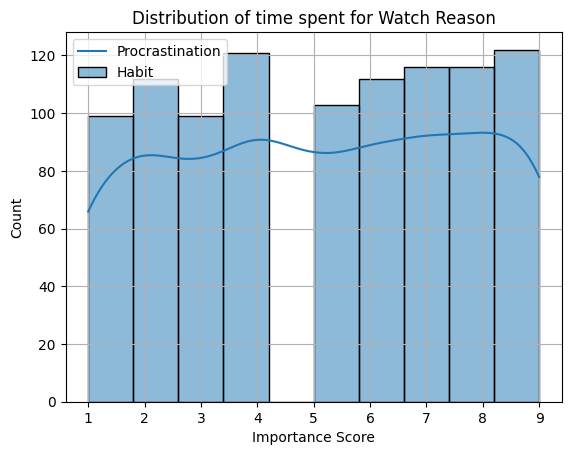

Total Importance Score by different groups of Watch Reason
Watch Reason
Boredom            1386
Entertainment      1338
Habit              1777
Procrastination     628
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


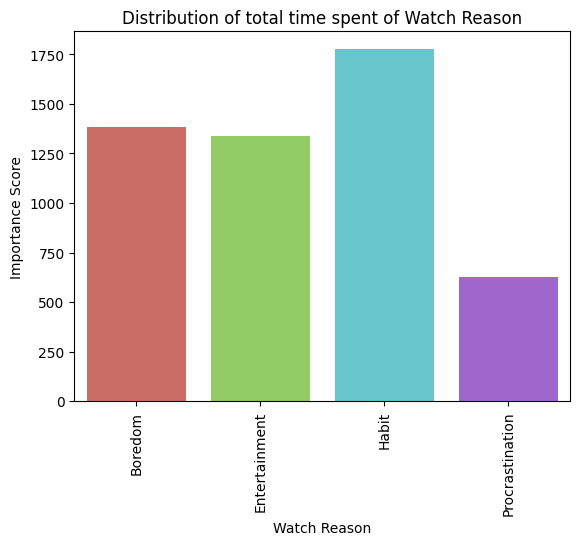

Average Importance Score by different groups of Watch Reason
Watch Reason
Boredom            5.003610
Entertainment      5.068182
Habit              5.241888
Procrastination    5.233333
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


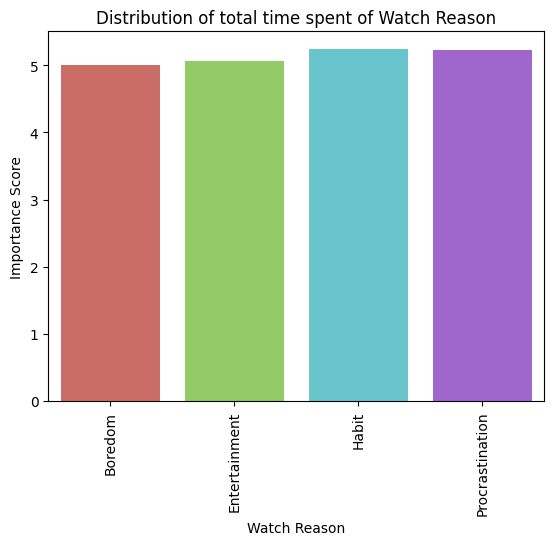

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


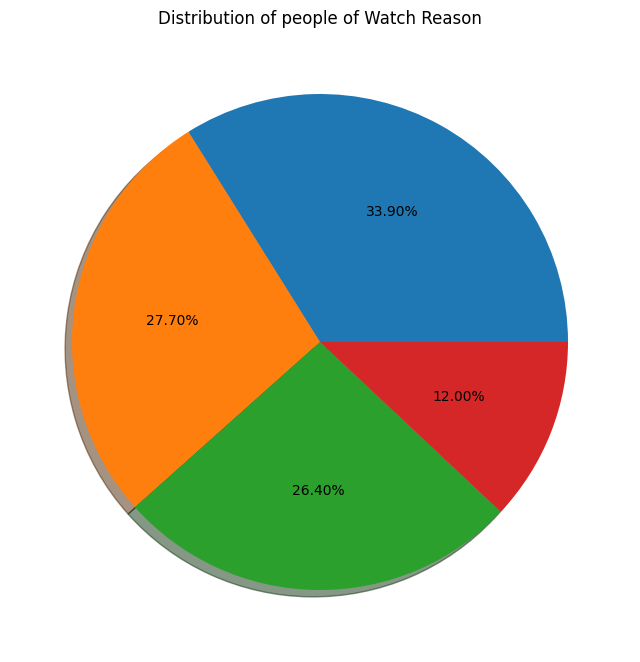

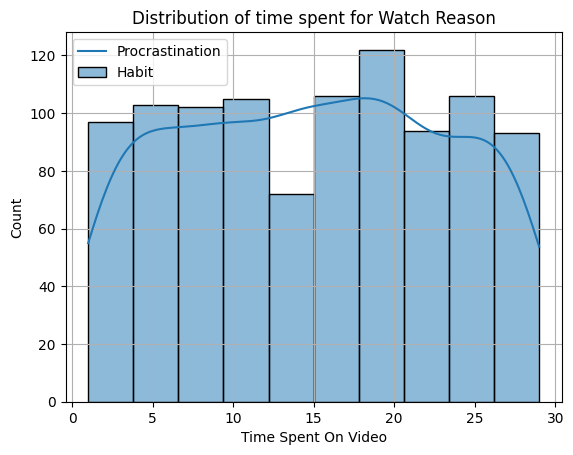

Total Time Spent On Video by different groups of Watch Reason
Watch Reason
Boredom            4222
Entertainment      3729
Habit              5284
Procrastination    1738
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


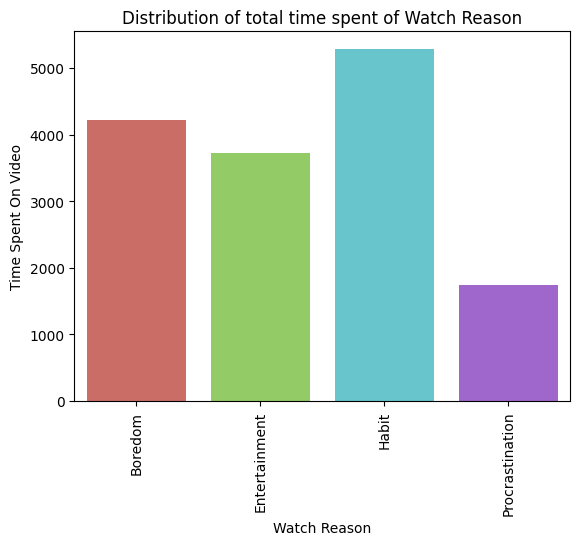

Average Time Spent On Video by different groups of Watch Reason
Watch Reason
Boredom            15.241877
Entertainment      14.125000
Habit              15.587021
Procrastination    14.483333
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


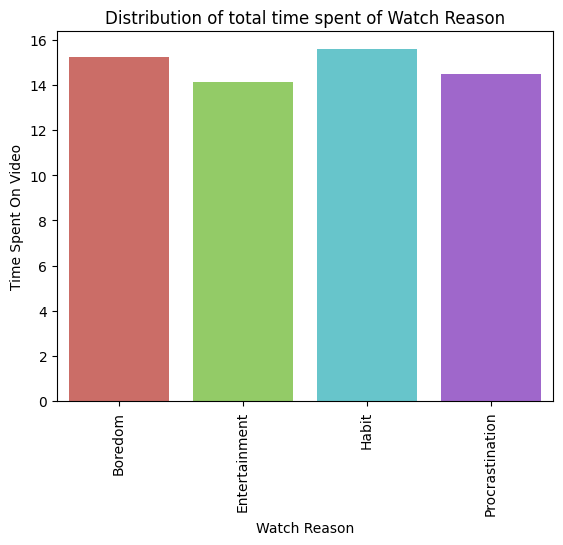

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


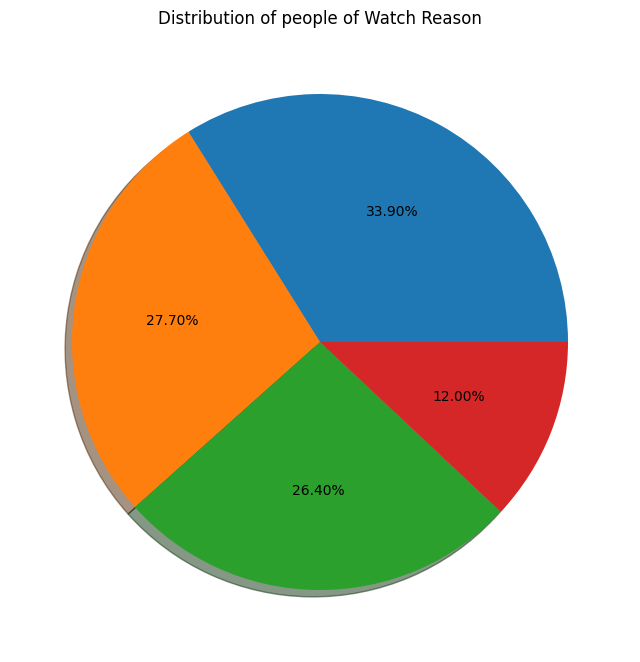

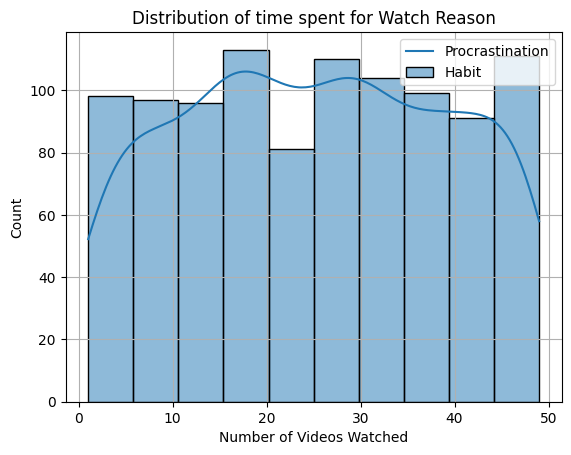

Total Number of Videos Watched by different groups of Watch Reason
Watch Reason
Boredom            6778
Entertainment      6574
Habit              8735
Procrastination    3161
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


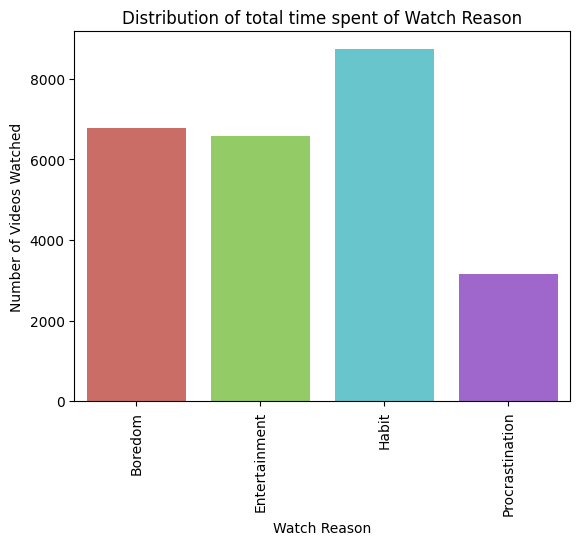

Average Number of Videos Watched by different groups of Watch Reason
Watch Reason
Boredom            24.469314
Entertainment      24.901515
Habit              25.766962
Procrastination    26.341667
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


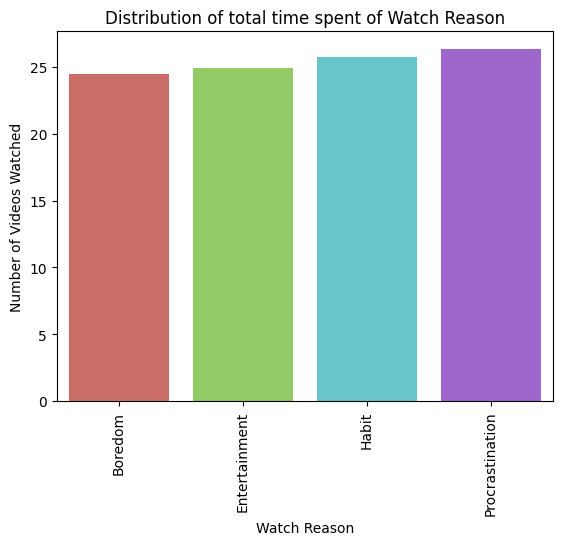

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


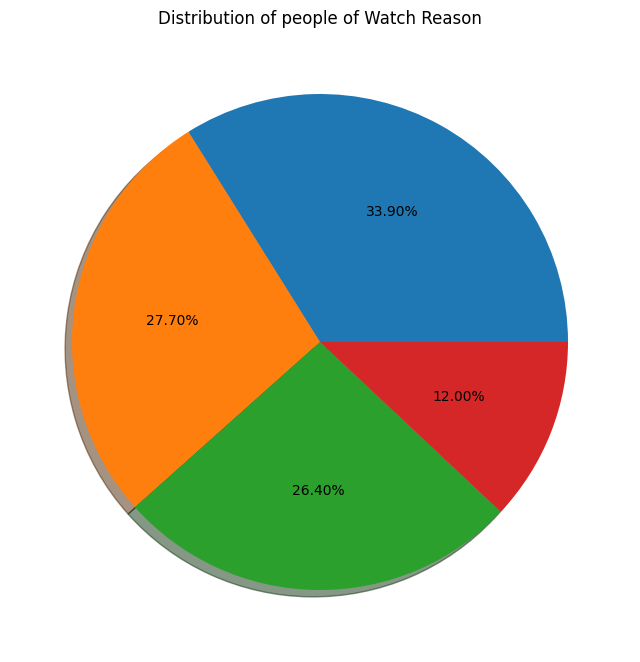

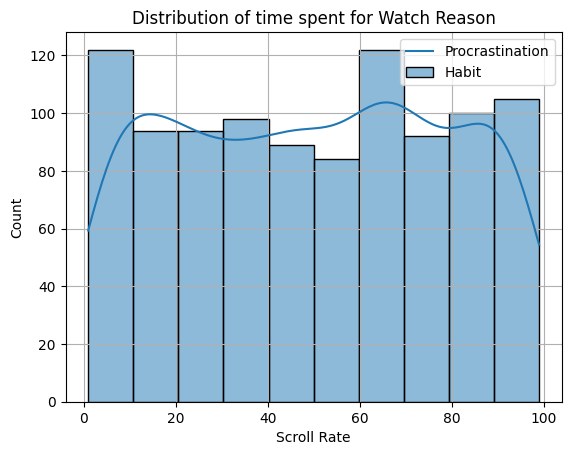

Total Scroll Rate by different groups of Watch Reason
Watch Reason
Boredom            13419
Entertainment      12999
Habit              17469
Procrastination     5887
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


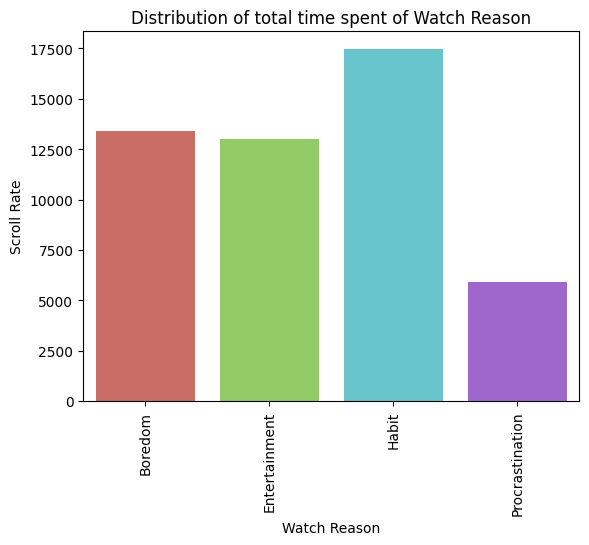

Average Scroll Rate by different groups of Watch Reason
Watch Reason
Boredom            48.444043
Entertainment      49.238636
Habit              51.530973
Procrastination    49.058333
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


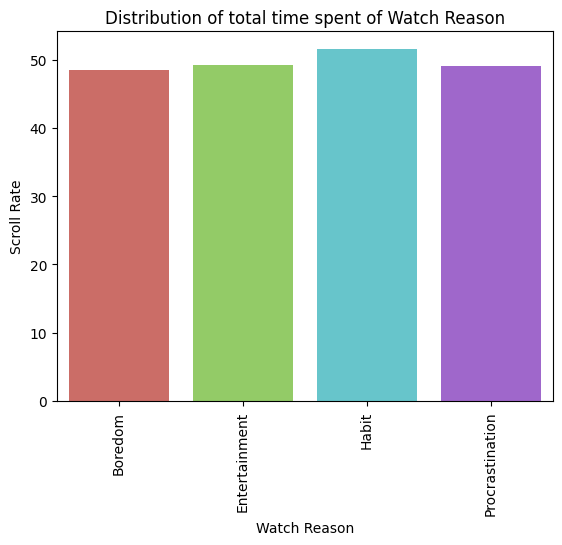

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


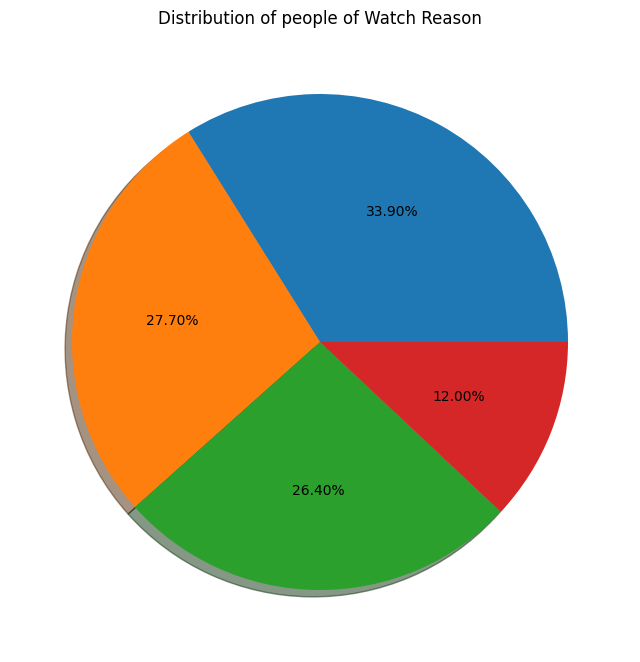

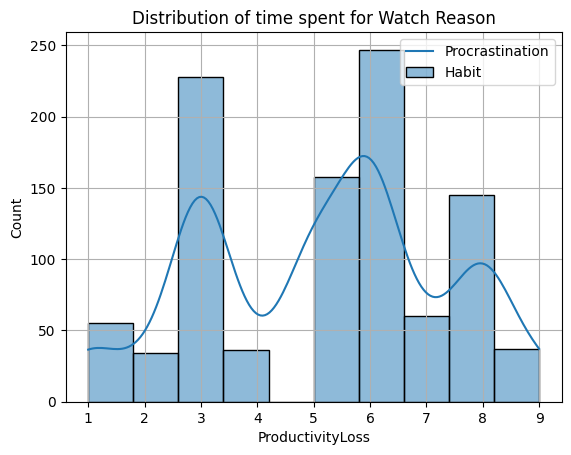

Total ProductivityLoss by different groups of Watch Reason
Watch Reason
Boredom            1472
Entertainment      1369
Habit              1693
Procrastination     602
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


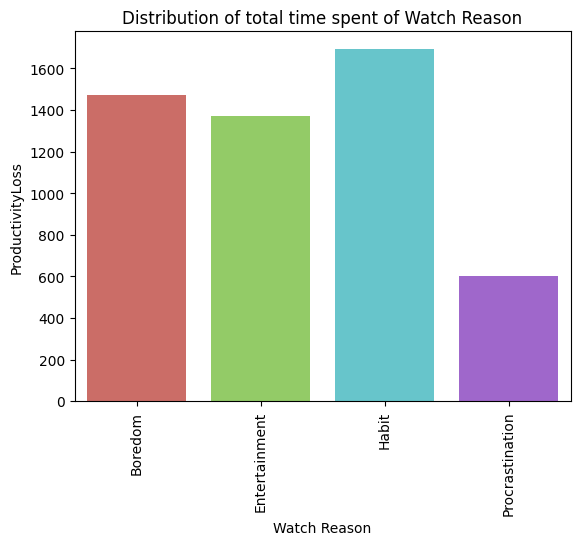

Average ProductivityLoss by different groups of Watch Reason
Watch Reason
Boredom            5.314079
Entertainment      5.185606
Habit              4.994100
Procrastination    5.016667
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


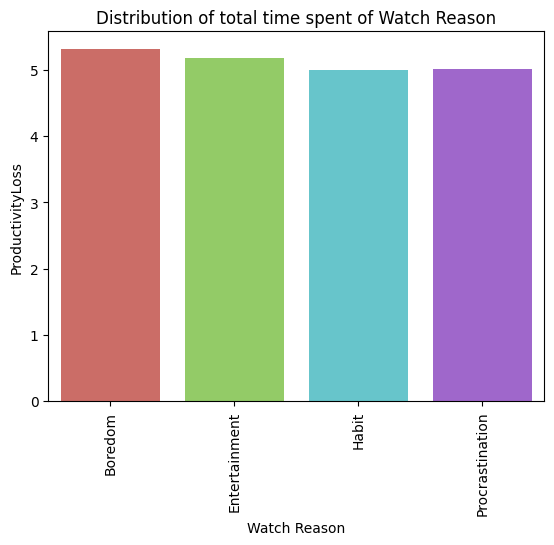

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


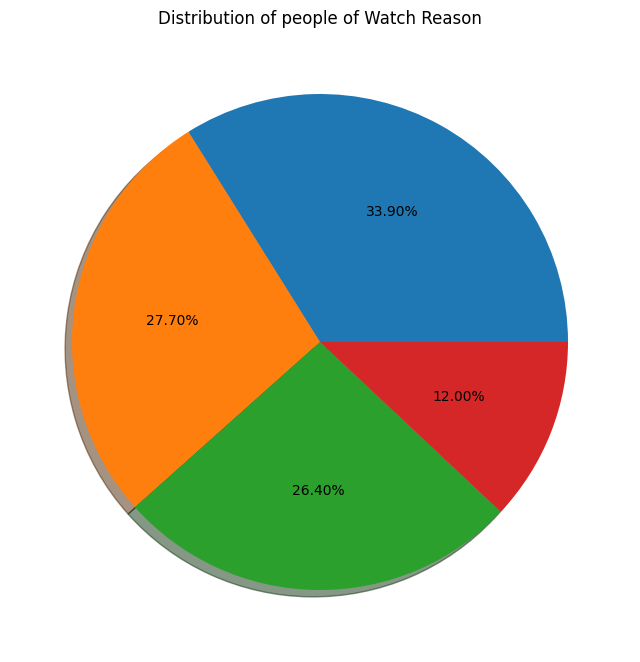

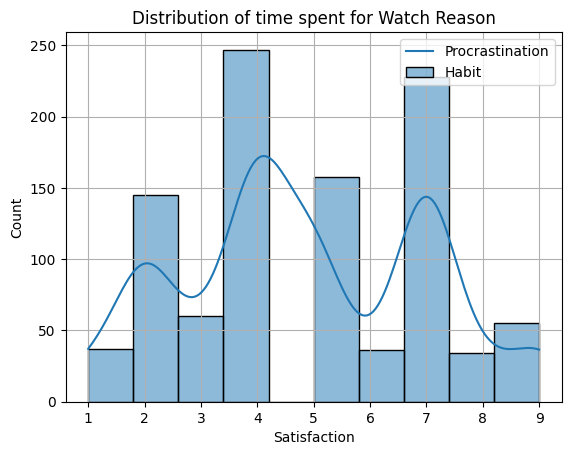

Total Satisfaction by different groups of Watch Reason
Watch Reason
Boredom            1298
Entertainment      1271
Habit              1697
Procrastination     598
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


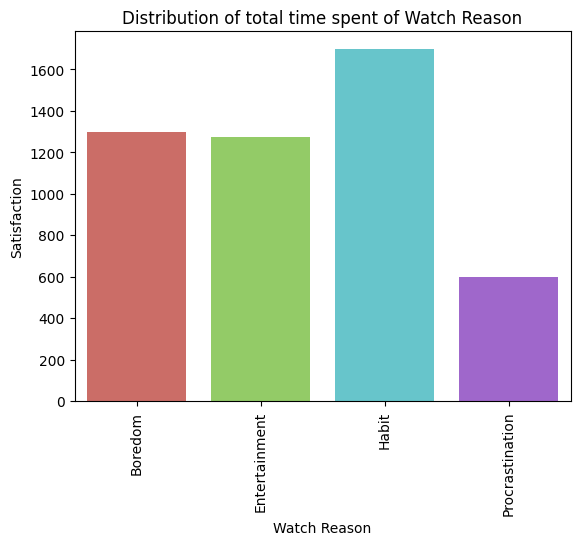

Average Satisfaction by different groups of Watch Reason
Watch Reason
Boredom            4.685921
Entertainment      4.814394
Habit              5.005900
Procrastination    4.983333
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


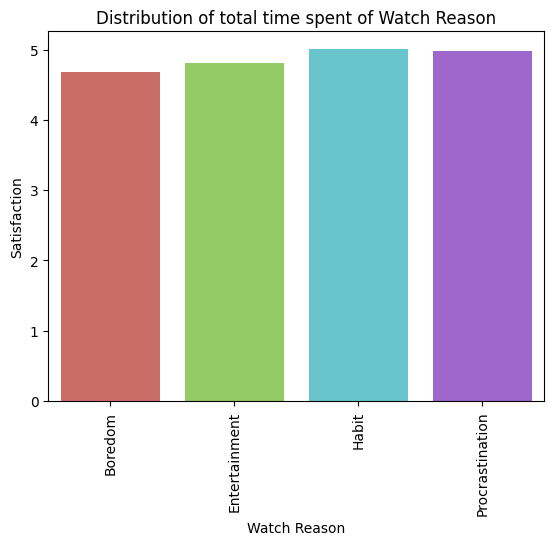

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


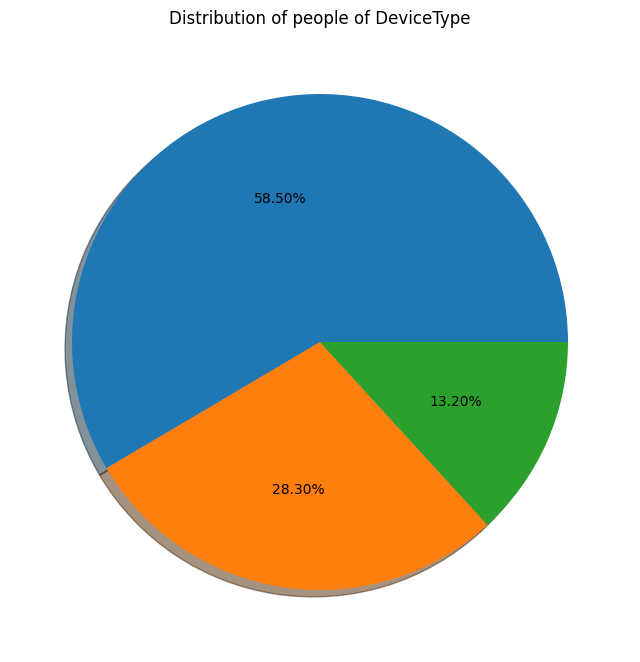

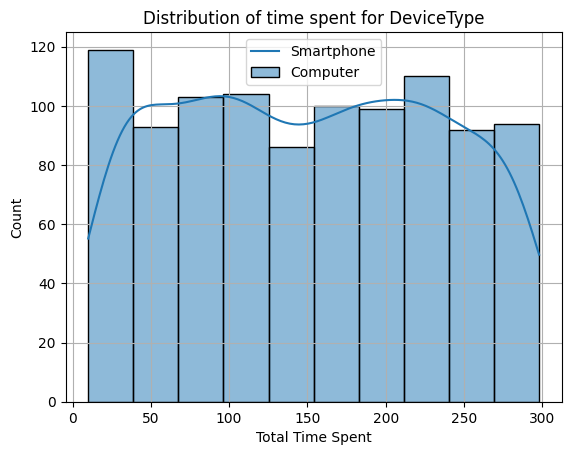

Total Total Time Spent by different groups of DeviceType
DeviceType
Computer      19849
Smartphone    89062
Tablet        42495
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


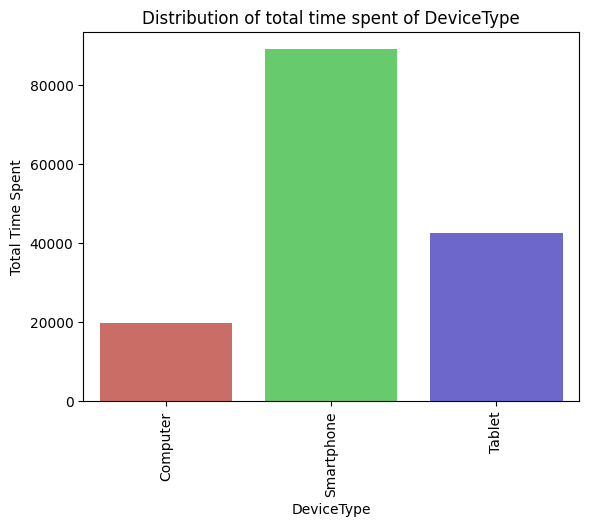

Average Total Time Spent by different groups of DeviceType
DeviceType
Computer      150.371212
Smartphone    152.242735
Tablet        150.159011
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


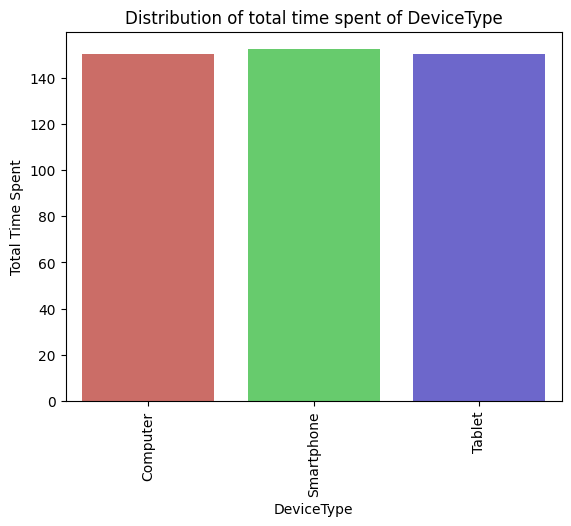

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


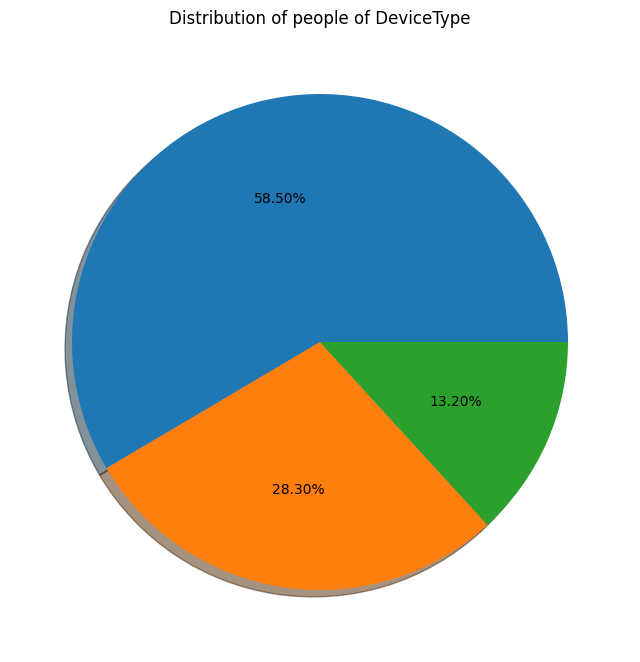

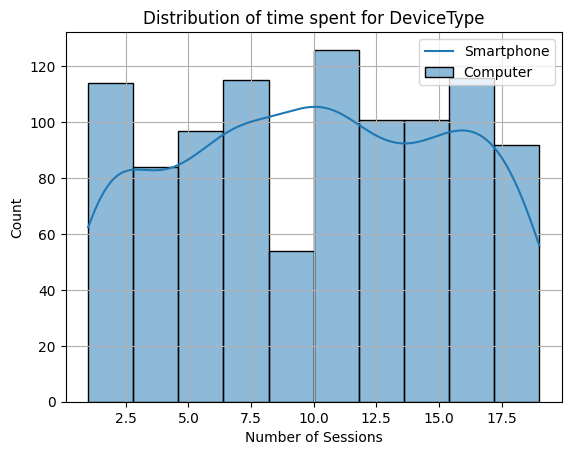

Total Number of Sessions by different groups of DeviceType
DeviceType
Computer      1267
Smartphone    5914
Tablet        2832
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


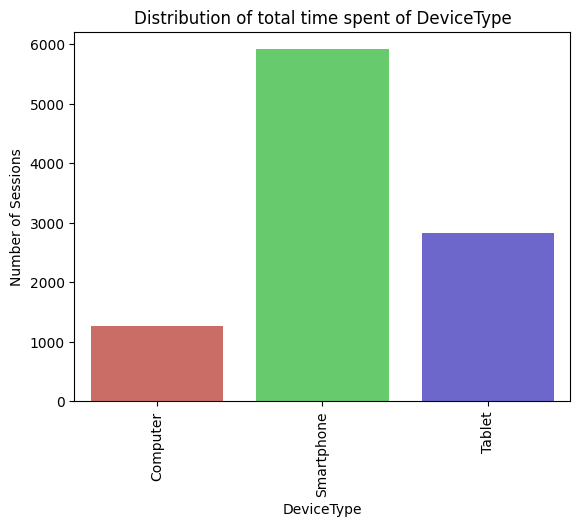

Average Number of Sessions by different groups of DeviceType
DeviceType
Computer       9.598485
Smartphone    10.109402
Tablet        10.007067
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


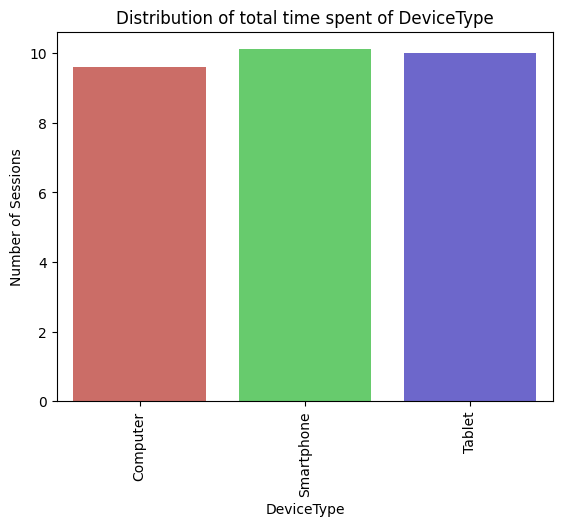

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


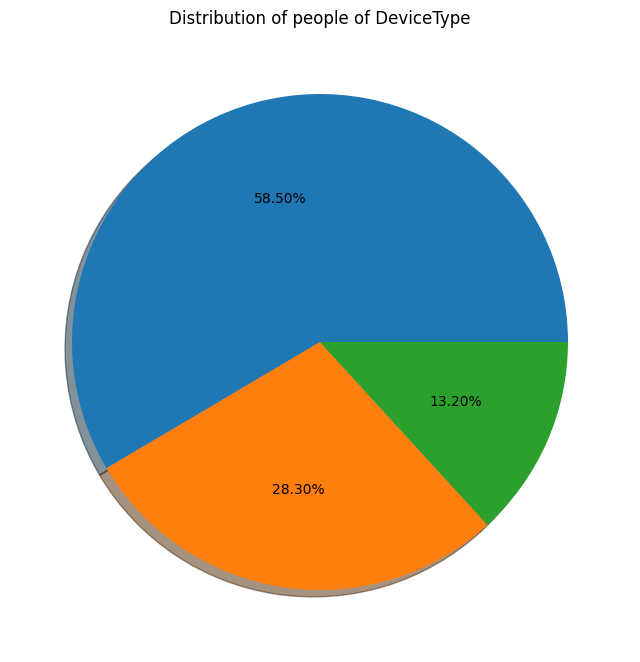

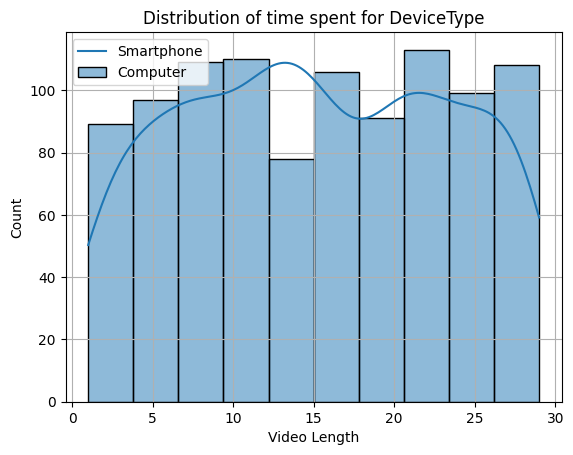

Total Video Length by different groups of DeviceType
DeviceType
Computer      1859
Smartphone    9156
Tablet        4199
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


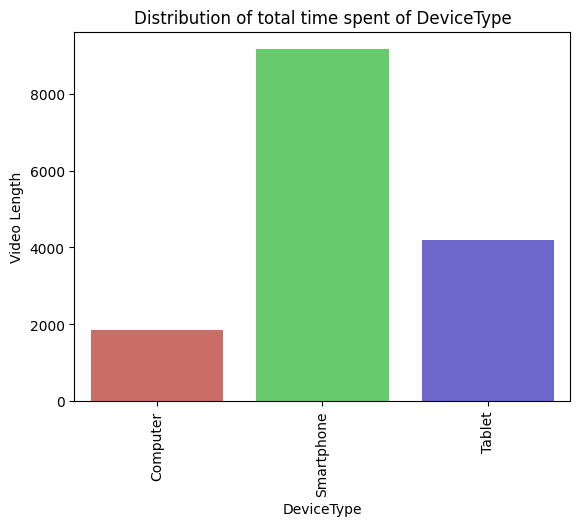

Average Video Length by different groups of DeviceType
DeviceType
Computer      14.083333
Smartphone    15.651282
Tablet        14.837456
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


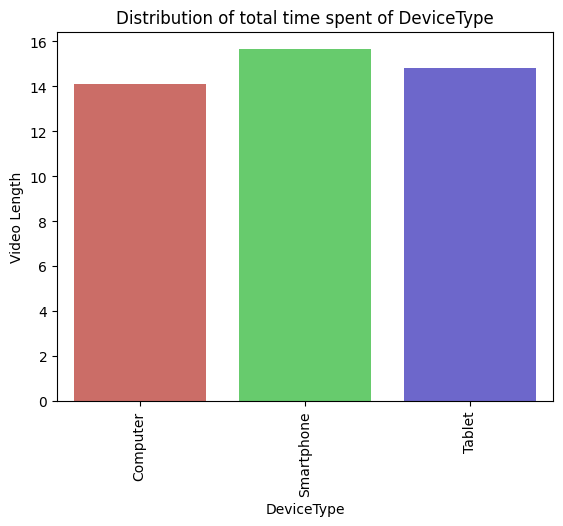

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


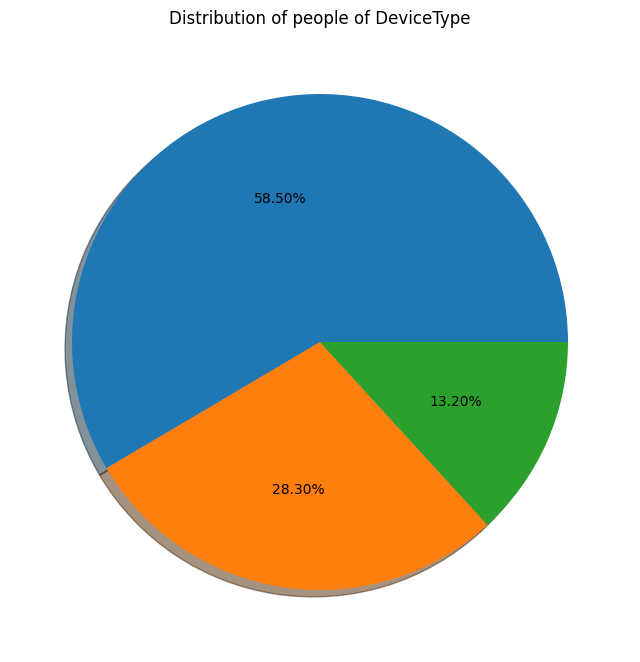

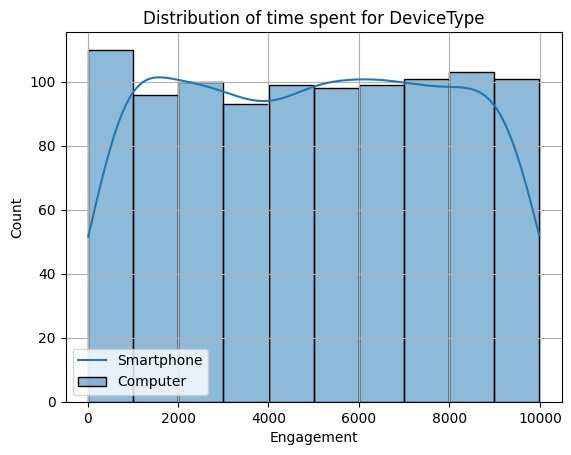

Total Engagement by different groups of DeviceType
DeviceType
Computer       715670
Smartphone    2868237
Tablet        1413252
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


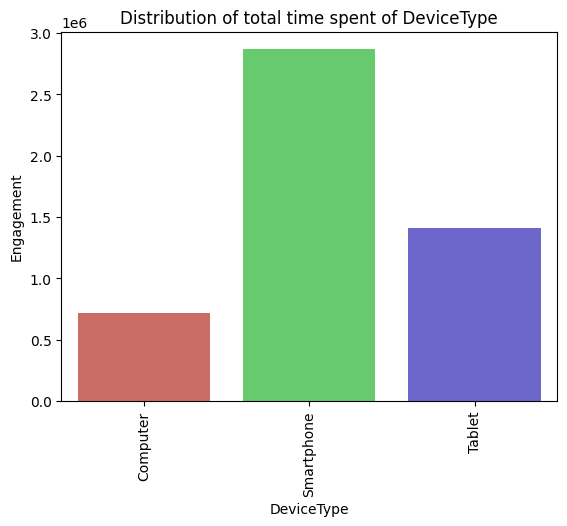

Average Engagement by different groups of DeviceType
DeviceType
Computer      5421.742424
Smartphone    4902.969231
Tablet        4993.823322
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


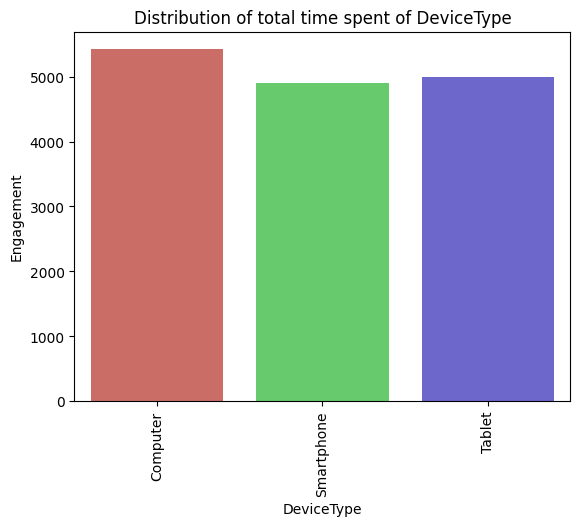

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


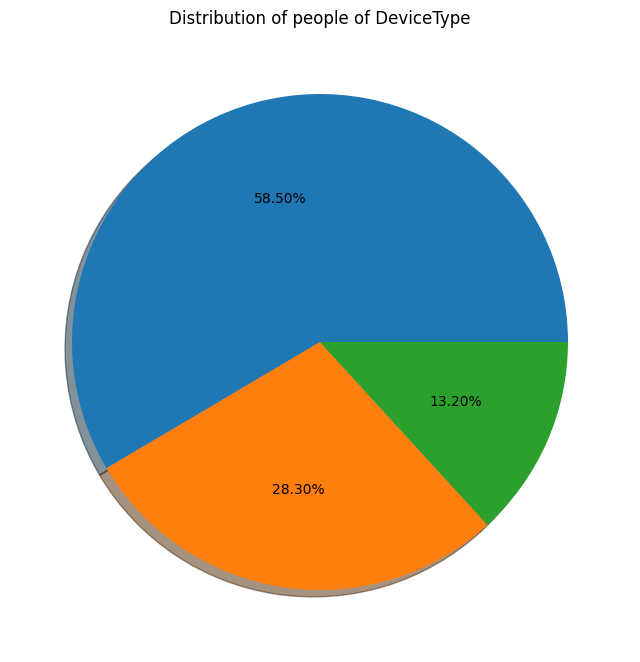

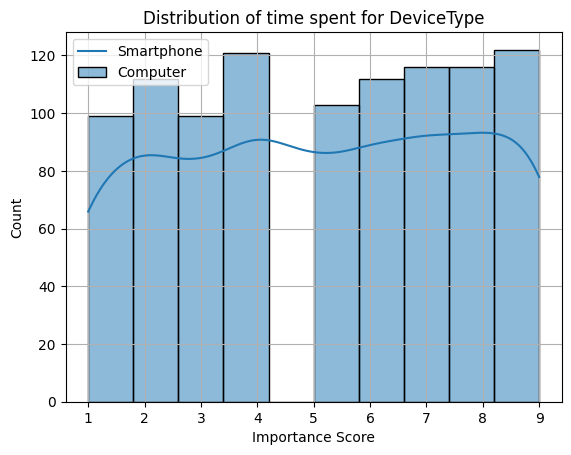

Total Importance Score by different groups of DeviceType
DeviceType
Computer       698
Smartphone    2985
Tablet        1446
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


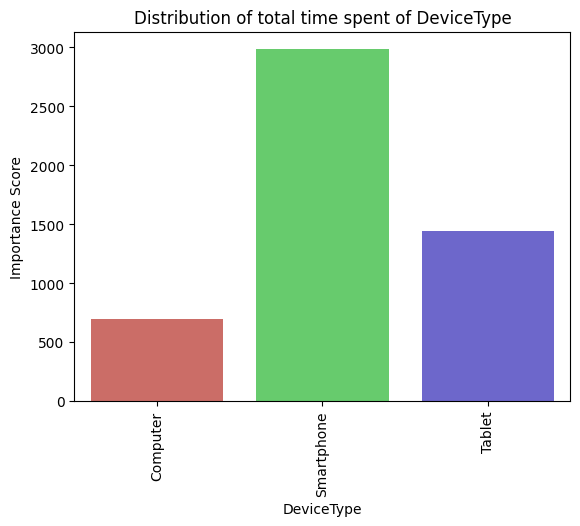

Average Importance Score by different groups of DeviceType
DeviceType
Computer      5.287879
Smartphone    5.102564
Tablet        5.109541
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


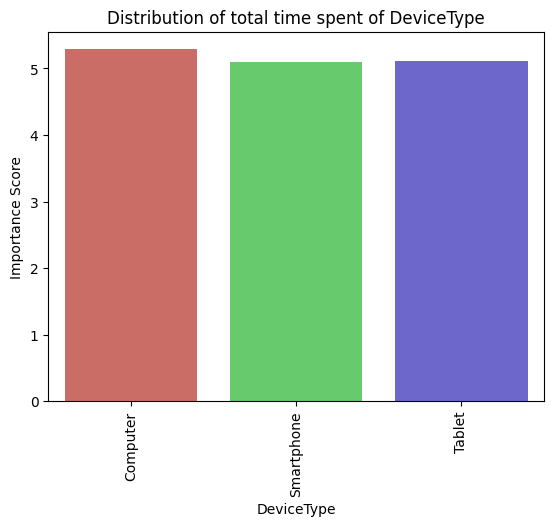

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


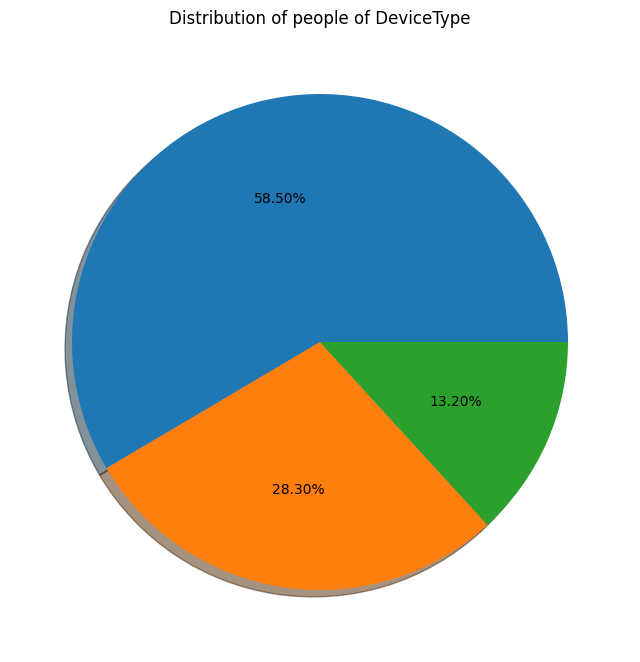

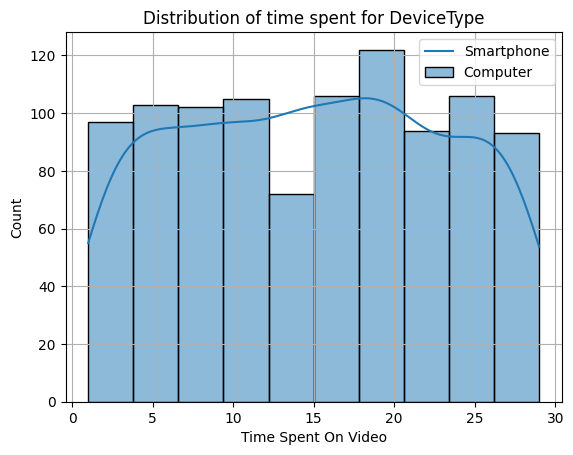

Total Time Spent On Video by different groups of DeviceType
DeviceType
Computer      1876
Smartphone    8746
Tablet        4351
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


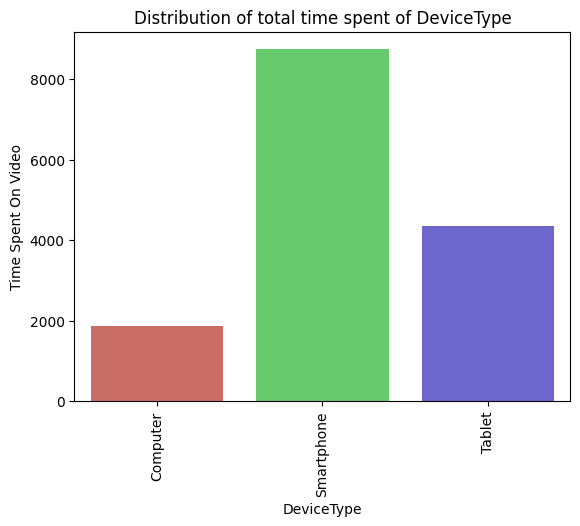

Average Time Spent On Video by different groups of DeviceType
DeviceType
Computer      14.212121
Smartphone    14.950427
Tablet        15.374558
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


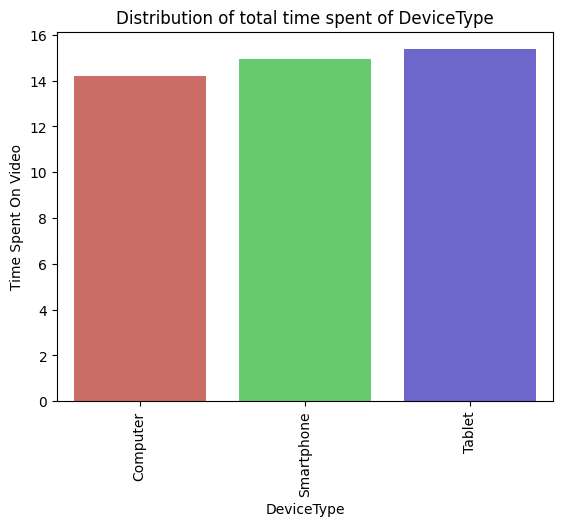

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


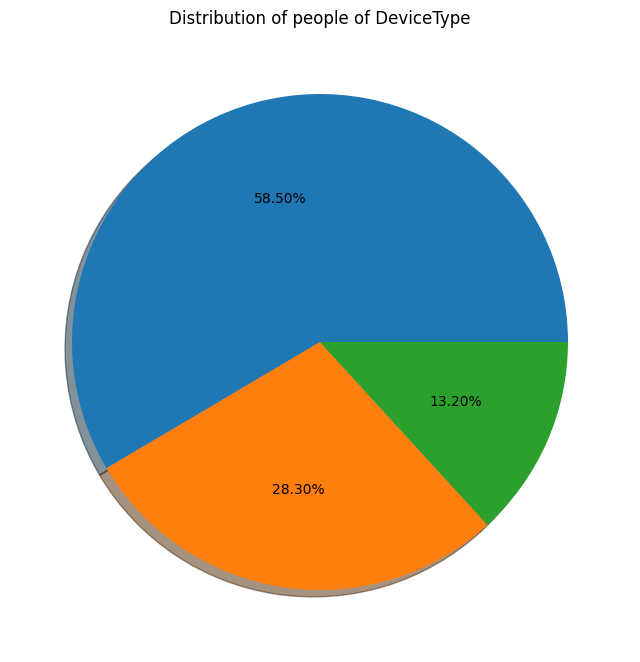

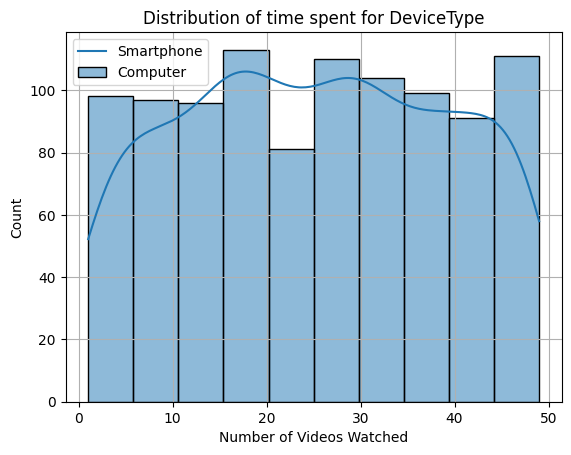

Total Number of Videos Watched by different groups of DeviceType
DeviceType
Computer       3389
Smartphone    14758
Tablet         7101
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


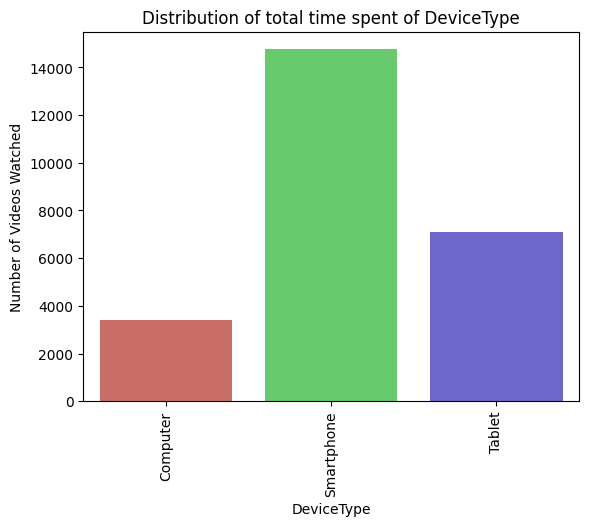

Average Number of Videos Watched by different groups of DeviceType
DeviceType
Computer      25.674242
Smartphone    25.227350
Tablet        25.091873
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


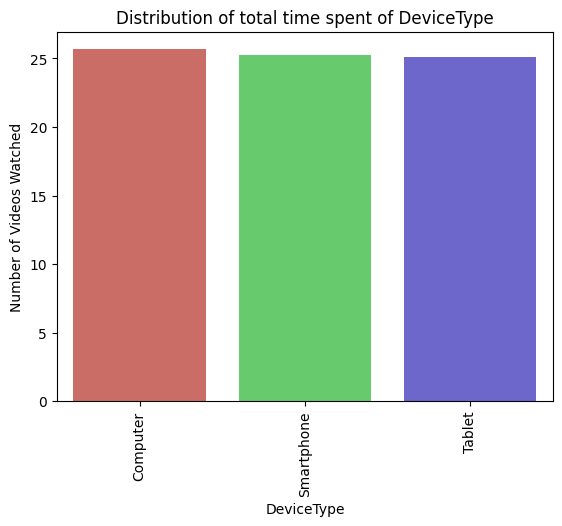

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


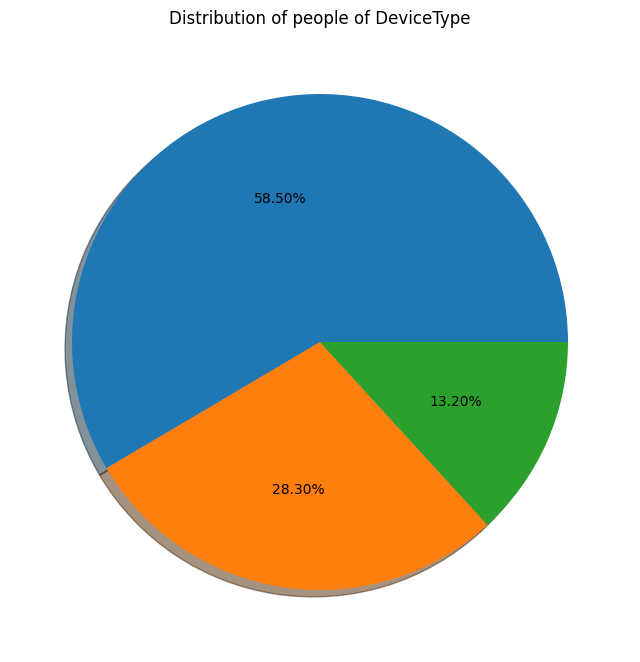

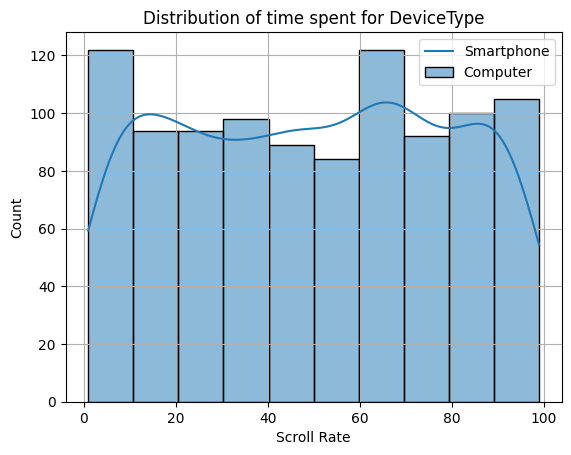

Total Scroll Rate by different groups of DeviceType
DeviceType
Computer       6407
Smartphone    29219
Tablet        14148
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


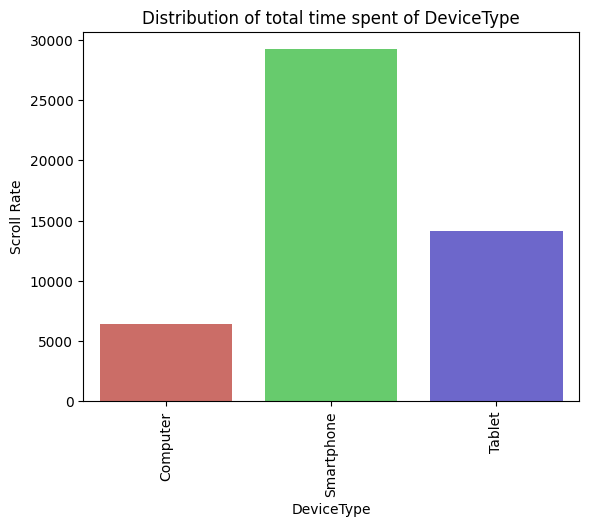

Average Scroll Rate by different groups of DeviceType
DeviceType
Computer      48.537879
Smartphone    49.947009
Tablet        49.992933
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


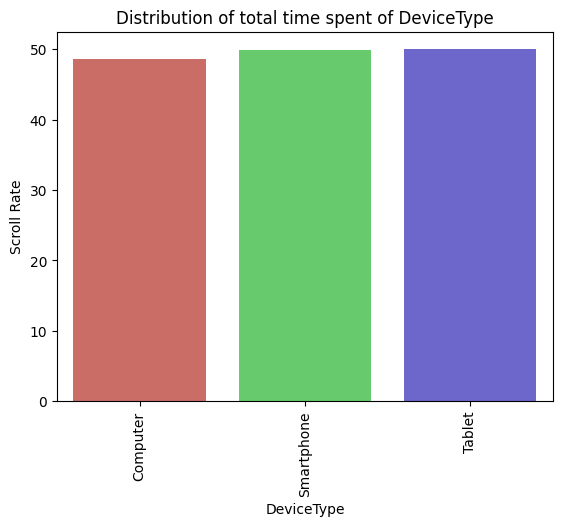

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


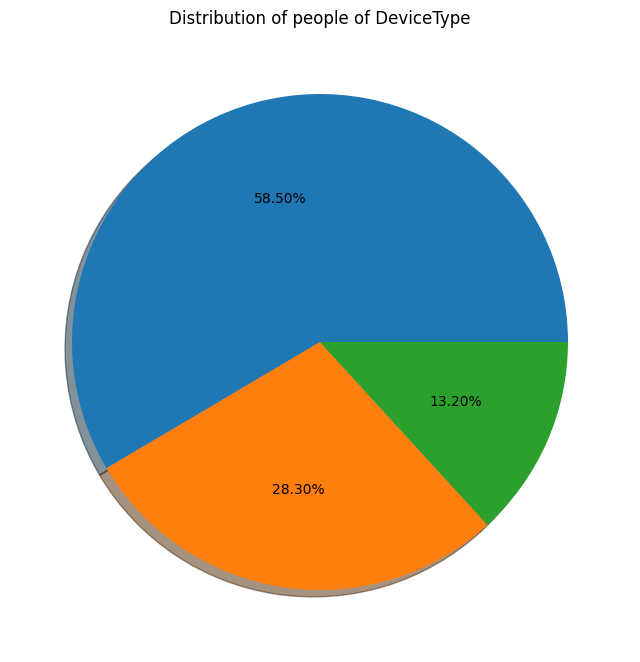

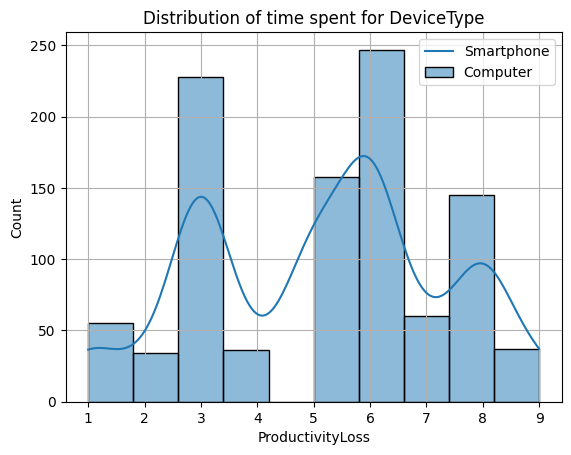

Total ProductivityLoss by different groups of DeviceType
DeviceType
Computer       679
Smartphone    3052
Tablet        1405
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


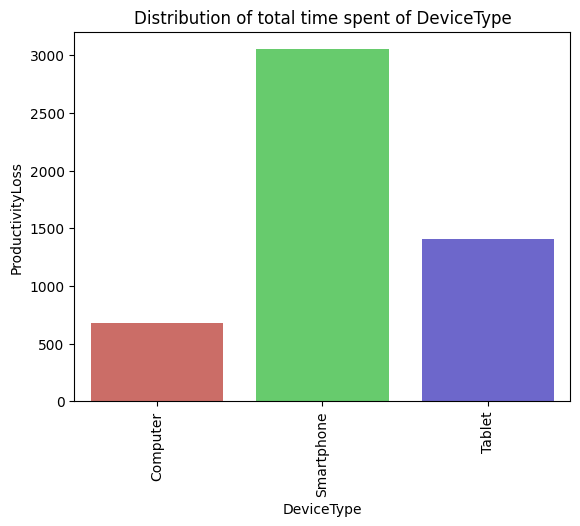

Average ProductivityLoss by different groups of DeviceType
DeviceType
Computer      5.143939
Smartphone    5.217094
Tablet        4.964664
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


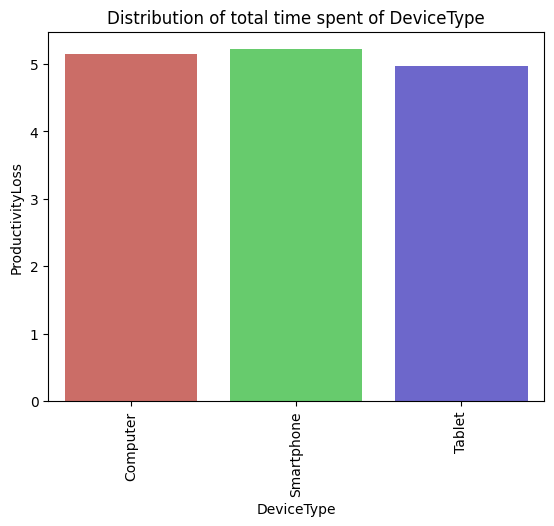

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


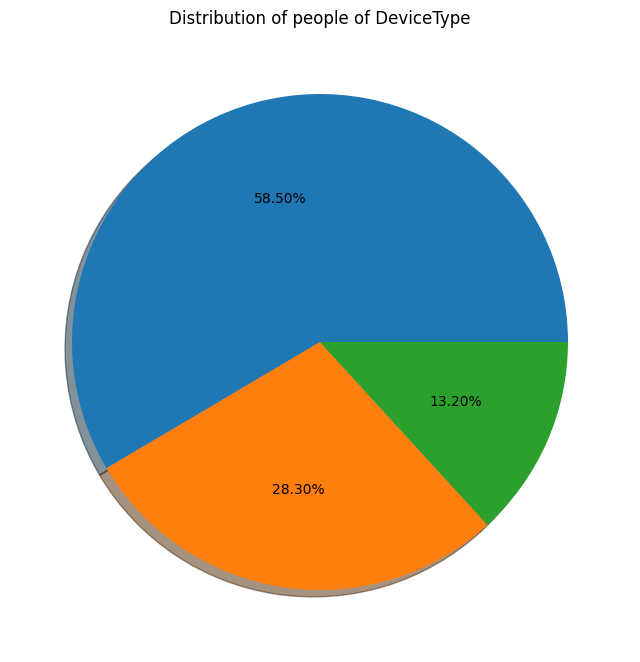

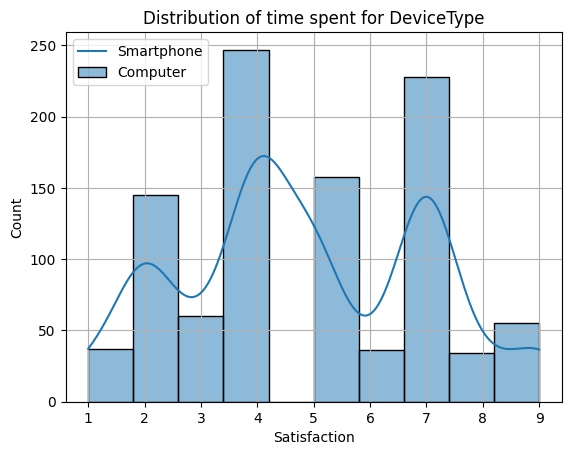

Total Satisfaction by different groups of DeviceType
DeviceType
Computer       641
Smartphone    2798
Tablet        1425
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


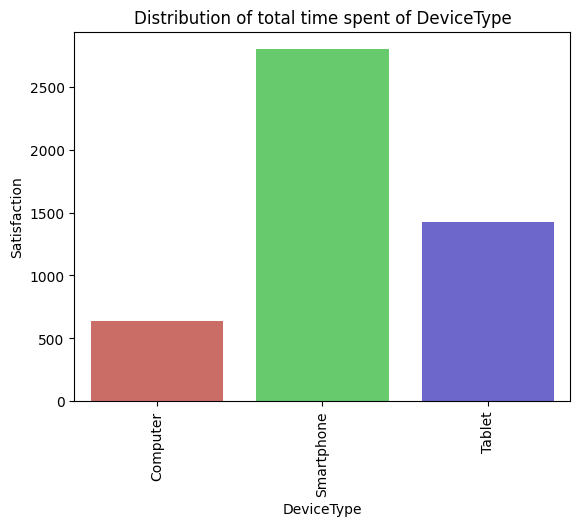

Average Satisfaction by different groups of DeviceType
DeviceType
Computer      4.856061
Smartphone    4.782906
Tablet        5.035336
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


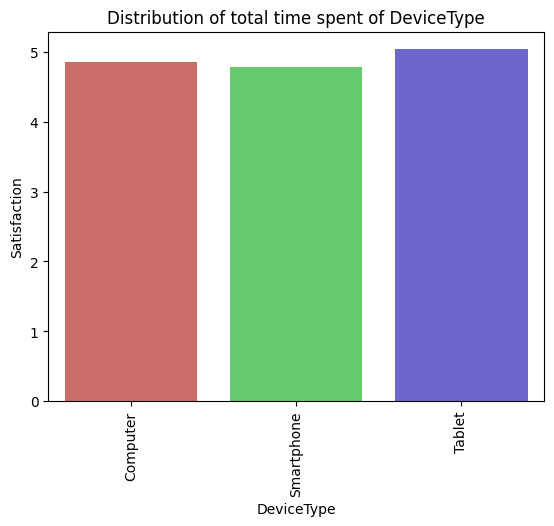

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


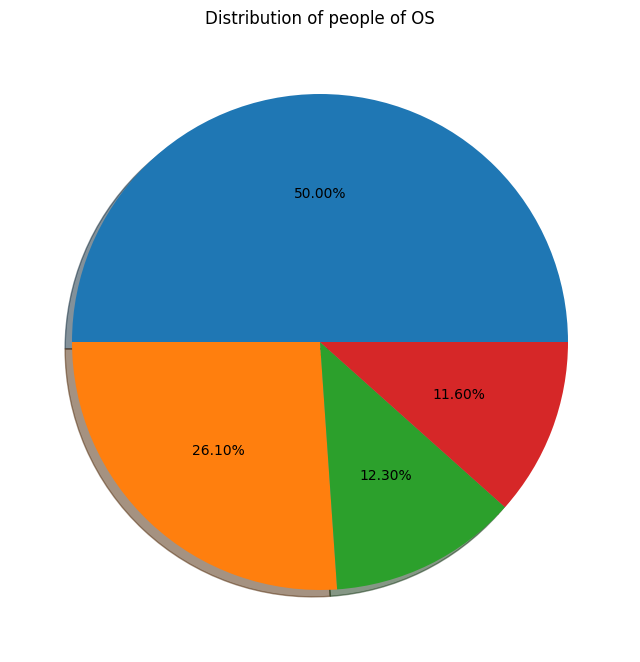

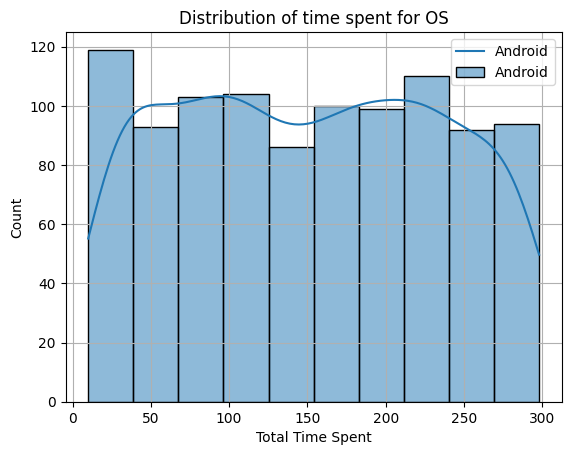

Total Total Time Spent by different groups of OS
OS
Android    76007
MacOS      17993
Windows    17575
iOS        39831
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


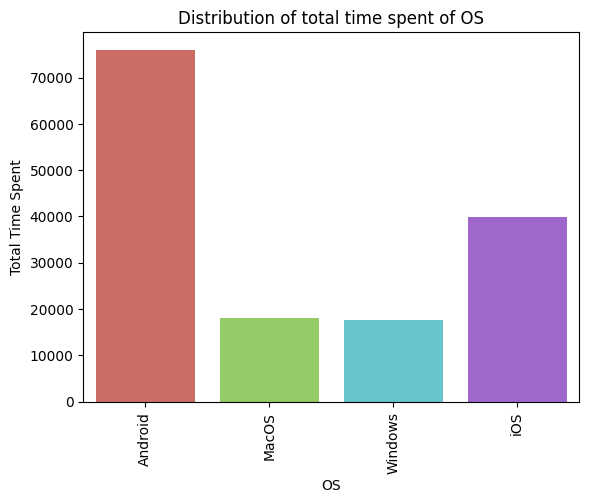

Average Total Time Spent by different groups of OS
OS
Android    152.014000
MacOS      155.112069
Windows    142.886179
iOS        152.609195
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


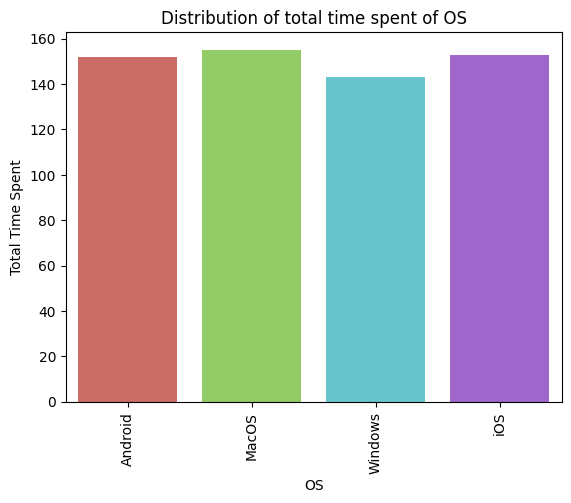

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


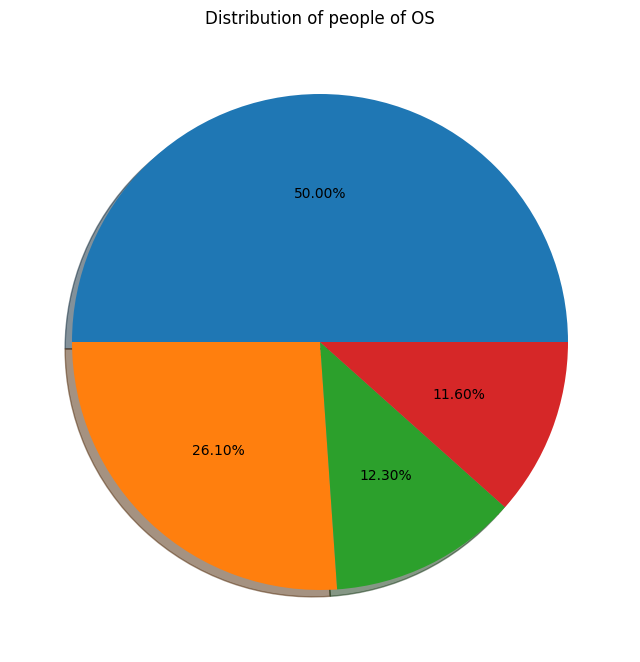

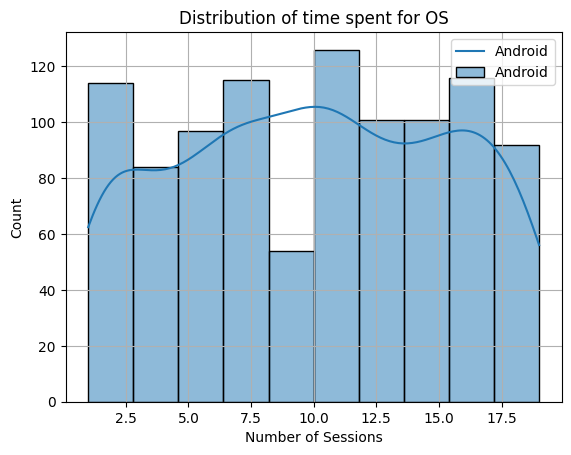

Total Number of Sessions by different groups of OS
OS
Android    5159
MacOS      1164
Windows    1204
iOS        2486
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


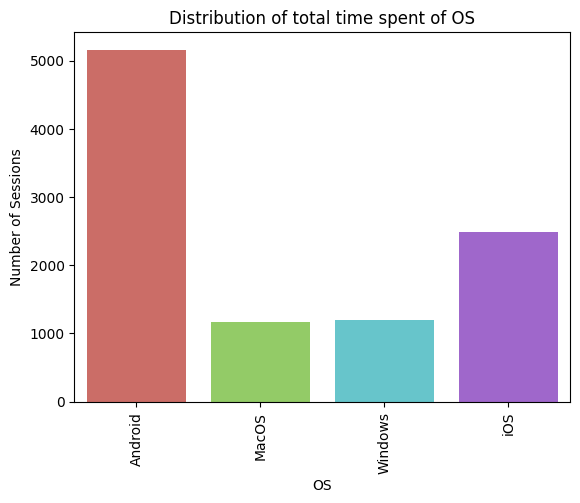

Average Number of Sessions by different groups of OS
OS
Android    10.318000
MacOS      10.034483
Windows     9.788618
iOS         9.524904
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


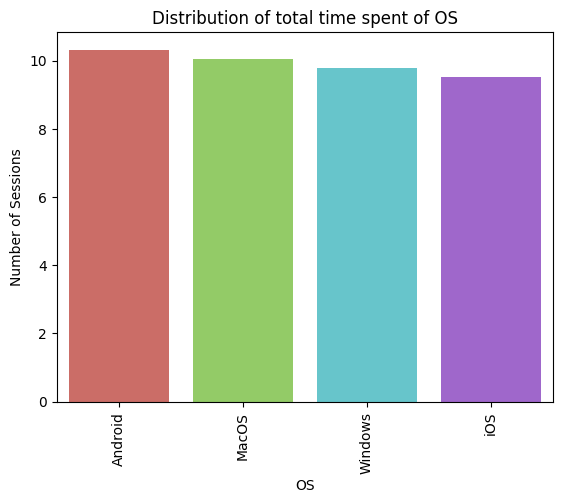

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


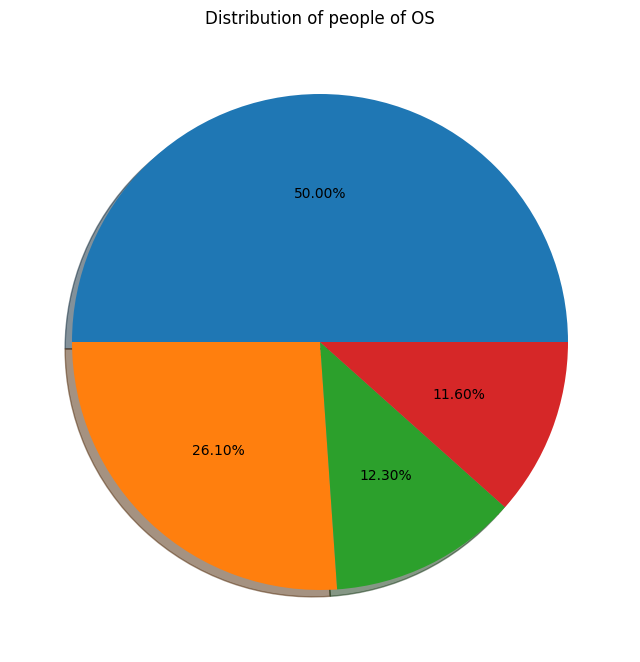

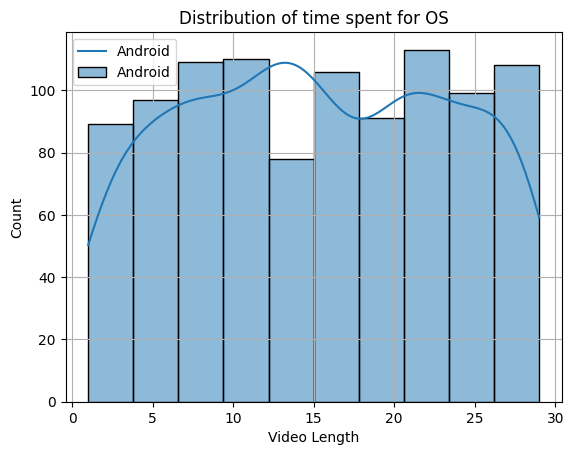

Total Video Length by different groups of OS
OS
Android    7450
MacOS      1777
Windows    1884
iOS        4103
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


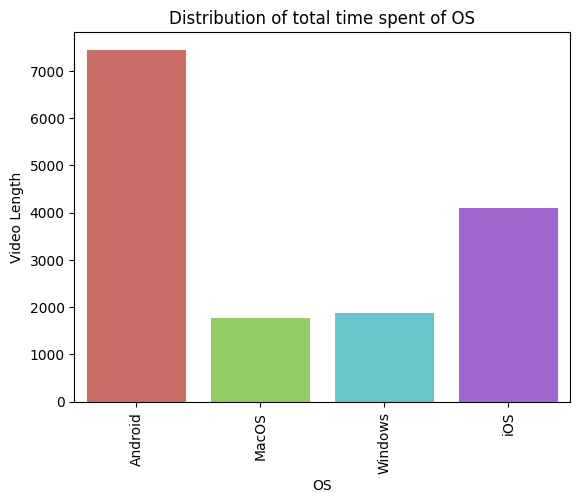

Average Video Length by different groups of OS
OS
Android    14.900000
MacOS      15.318966
Windows    15.317073
iOS        15.720307
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


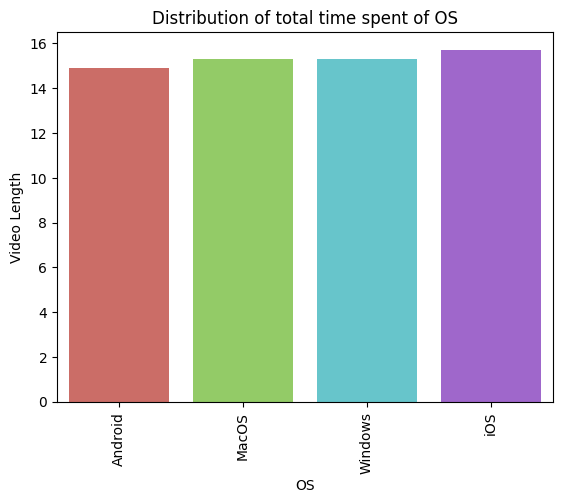

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


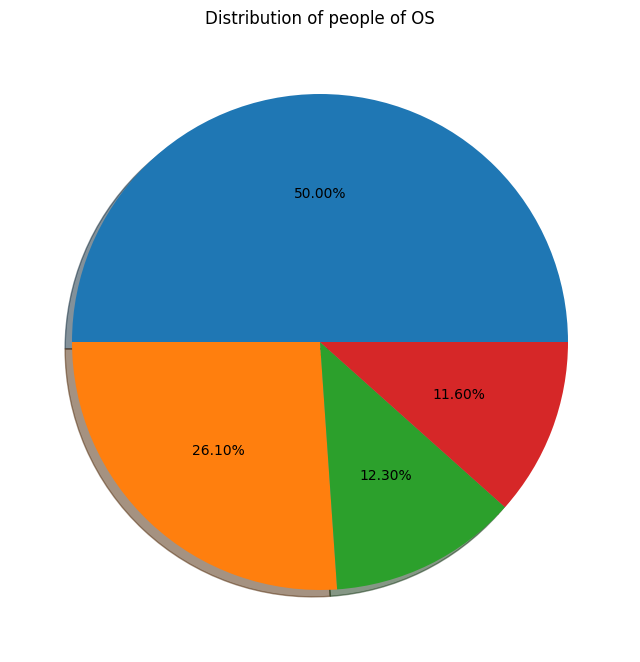

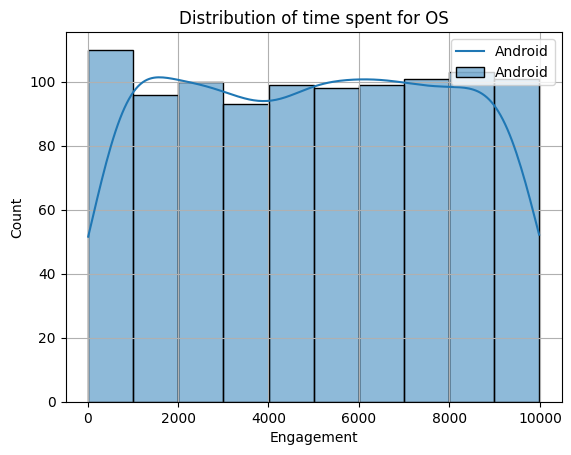

Total Engagement by different groups of OS
OS
Android    2465463
MacOS       546051
Windows     604803
iOS        1380842
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


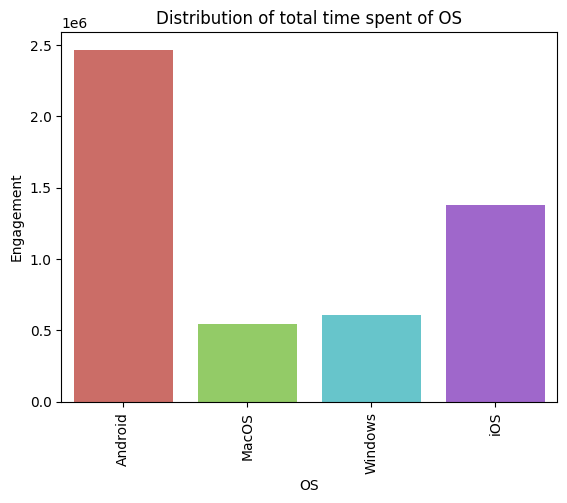

Average Engagement by different groups of OS
OS
Android    4930.926000
MacOS      4707.336207
Windows    4917.097561
iOS        5290.582375
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


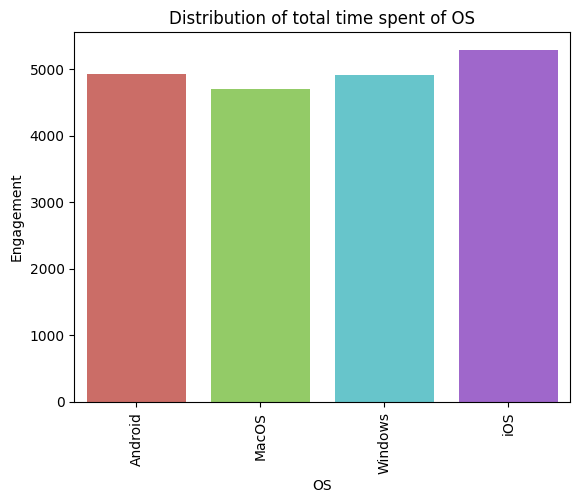

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


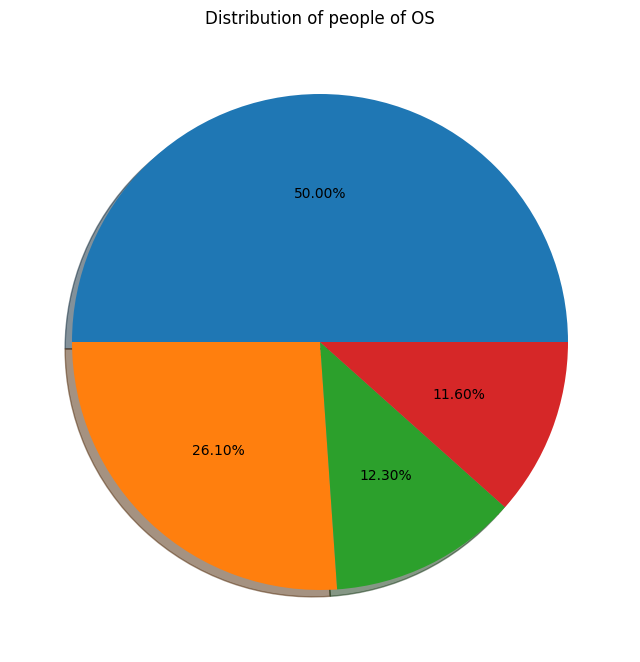

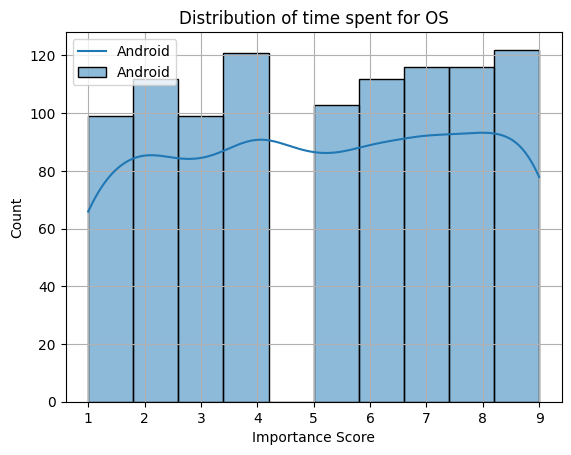

Total Importance Score by different groups of OS
OS
Android    2563
MacOS       562
Windows     599
iOS        1405
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


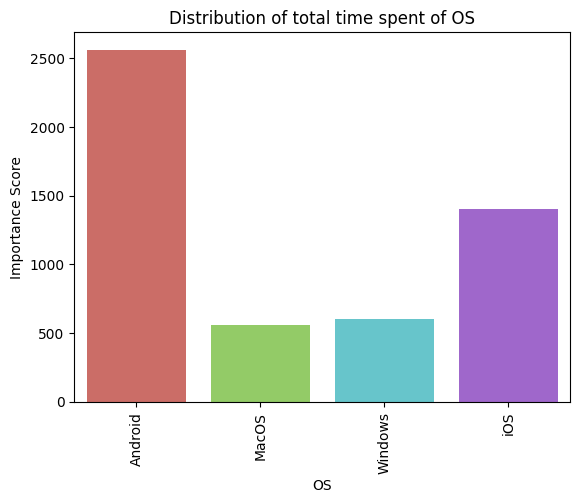

Average Importance Score by different groups of OS
OS
Android    5.126000
MacOS      4.844828
Windows    4.869919
iOS        5.383142
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


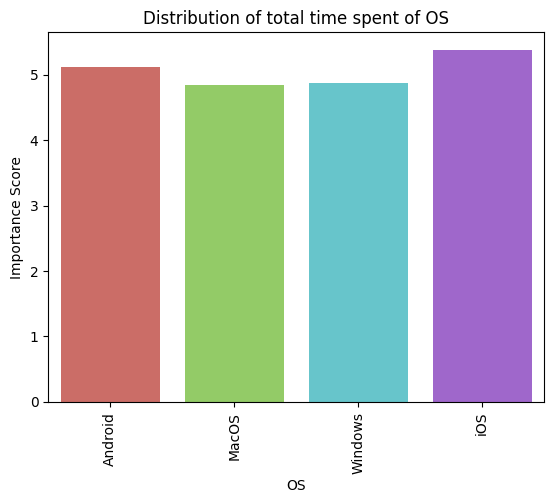

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


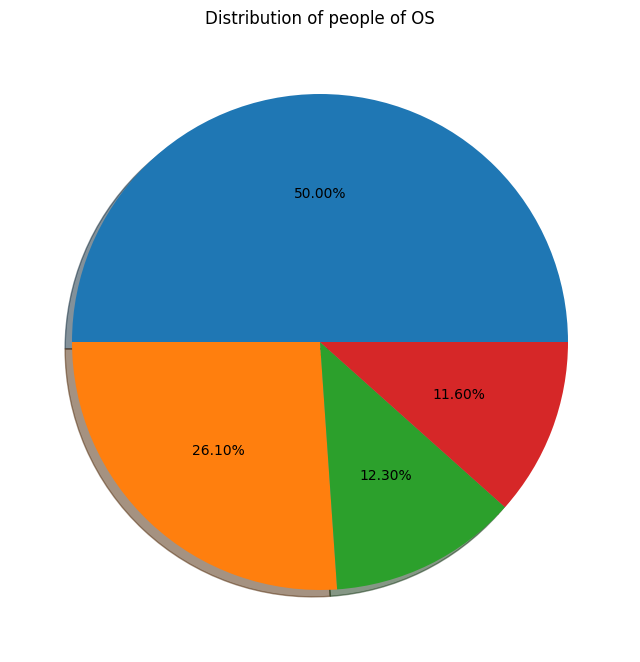

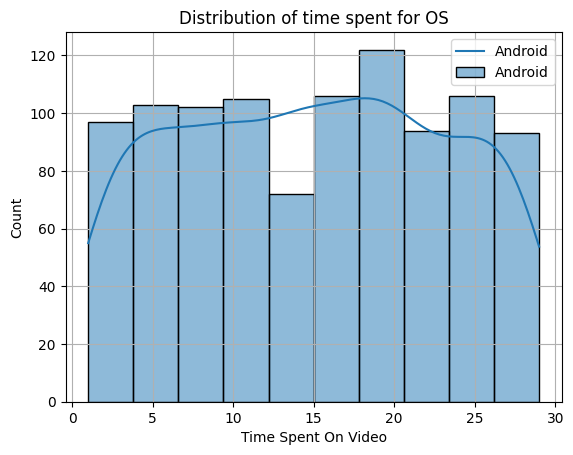

Total Time Spent On Video by different groups of OS
OS
Android    7580
MacOS      1571
Windows    1784
iOS        4038
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


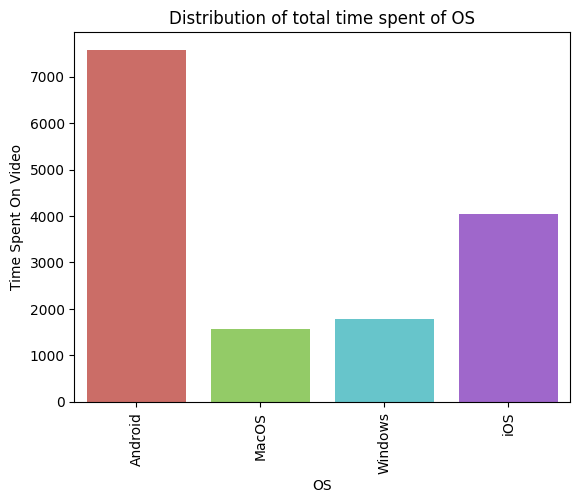

Average Time Spent On Video by different groups of OS
OS
Android    15.160000
MacOS      13.543103
Windows    14.504065
iOS        15.471264
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


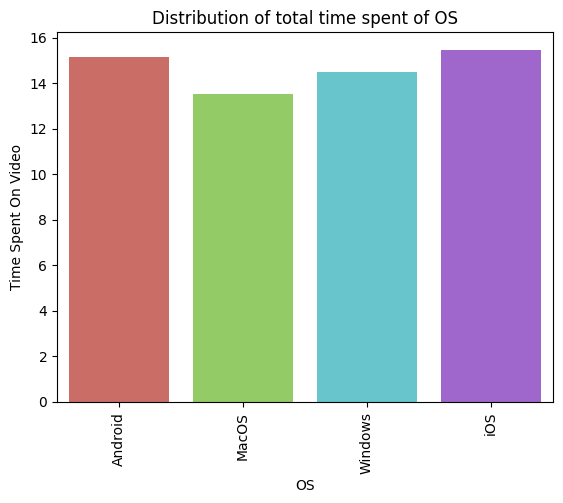

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


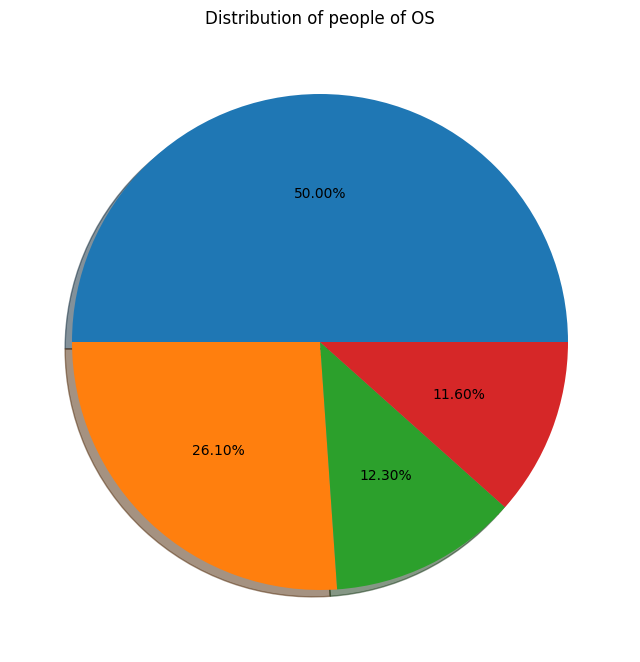

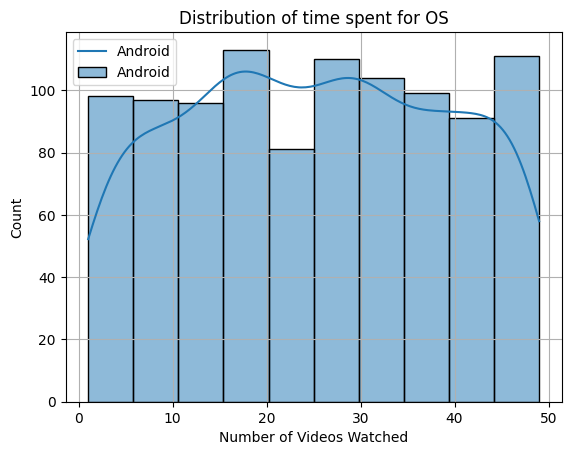

Total Number of Videos Watched by different groups of OS
OS
Android    12664
MacOS       3120
Windows     3200
iOS         6264
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


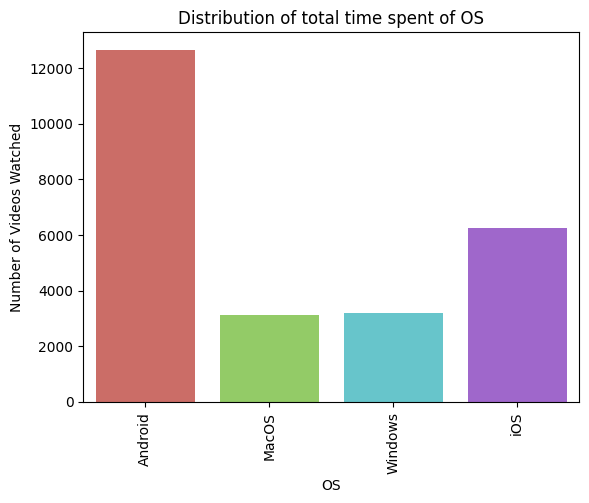

Average Number of Videos Watched by different groups of OS
OS
Android    25.328000
MacOS      26.896552
Windows    26.016260
iOS        24.000000
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


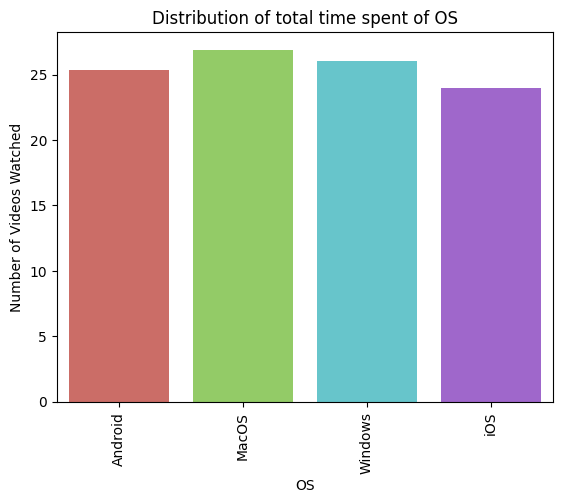

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


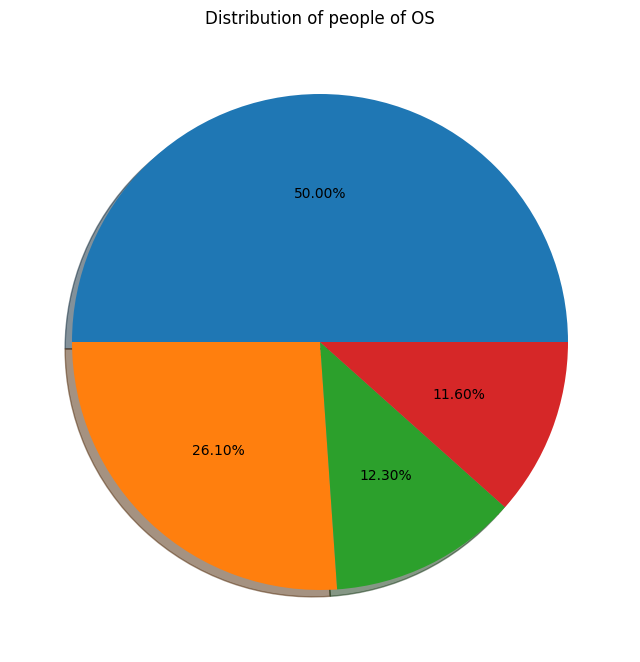

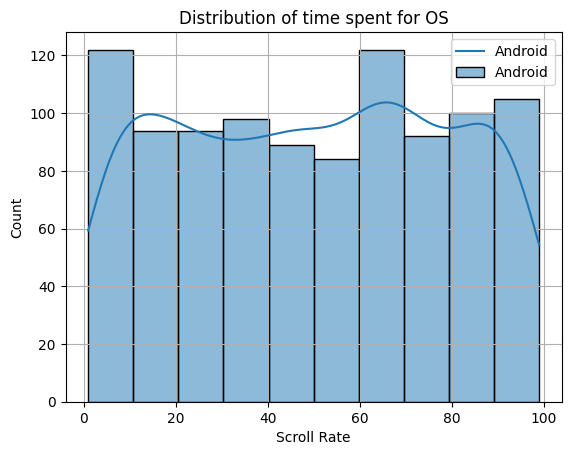

Total Scroll Rate by different groups of OS
OS
Android    25142
MacOS       6072
Windows     5892
iOS        12668
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


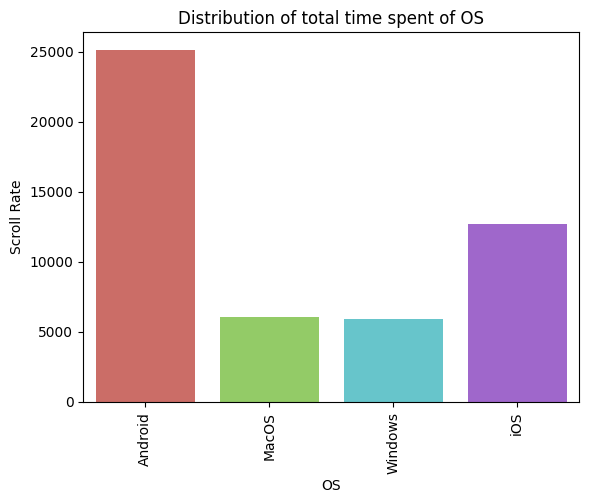

Average Scroll Rate by different groups of OS
OS
Android    50.284000
MacOS      52.344828
Windows    47.902439
iOS        48.536398
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


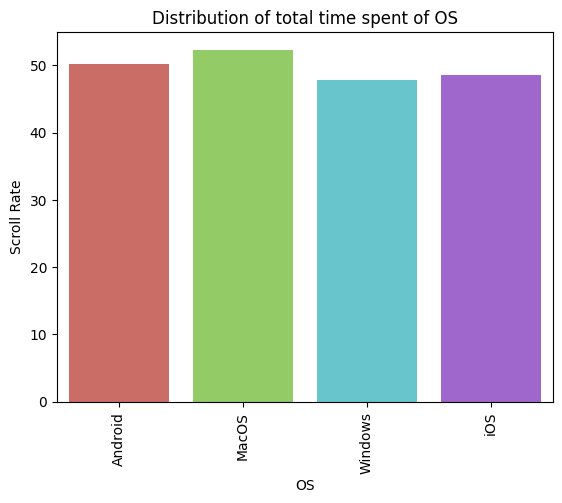

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


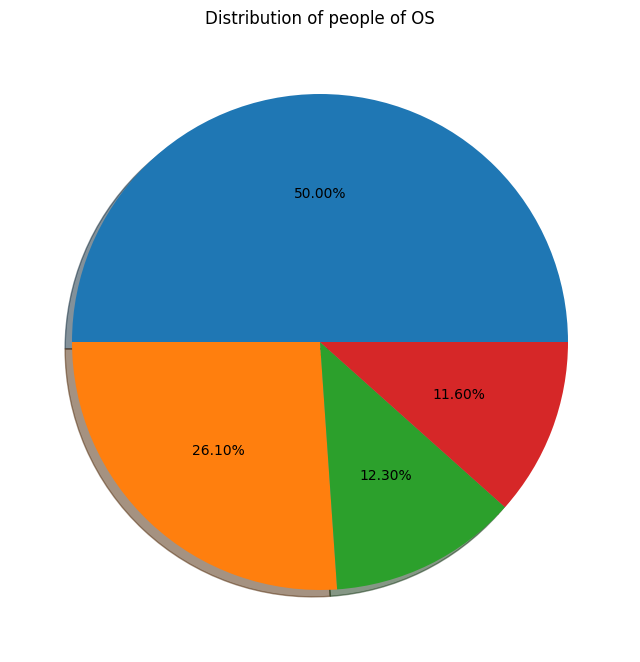

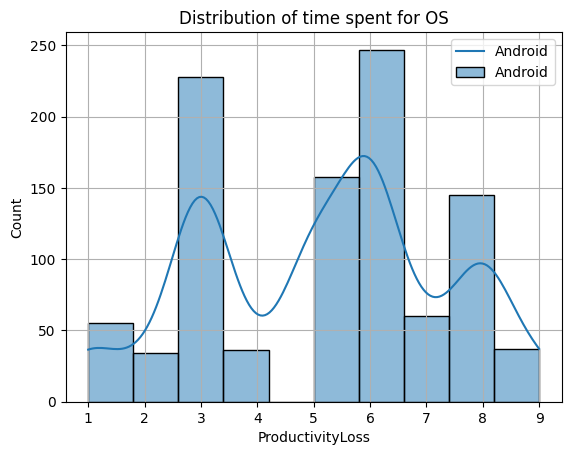

Total ProductivityLoss by different groups of OS
OS
Android    2529
MacOS       609
Windows     645
iOS        1353
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


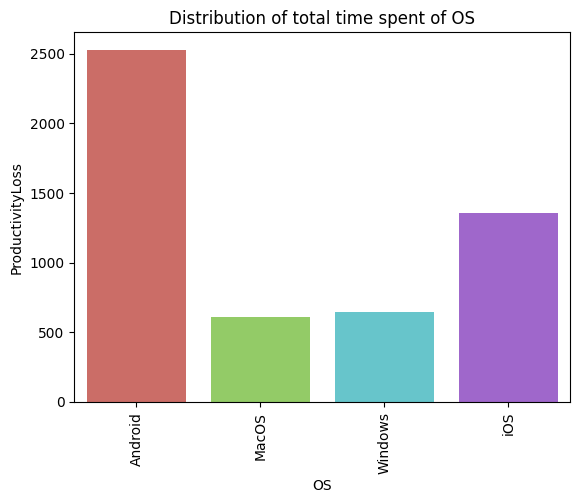

Average ProductivityLoss by different groups of OS
OS
Android    5.058000
MacOS      5.250000
Windows    5.243902
iOS        5.183908
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


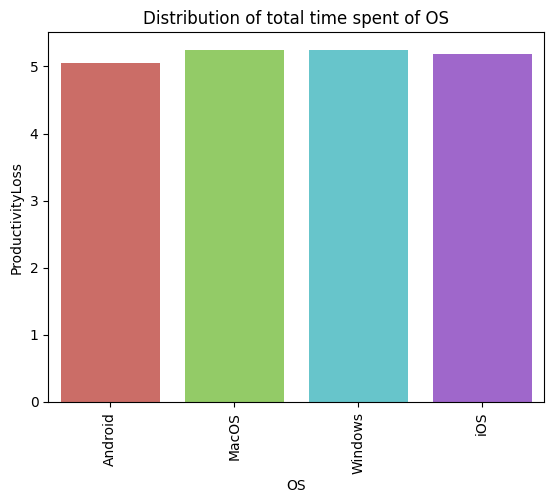

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


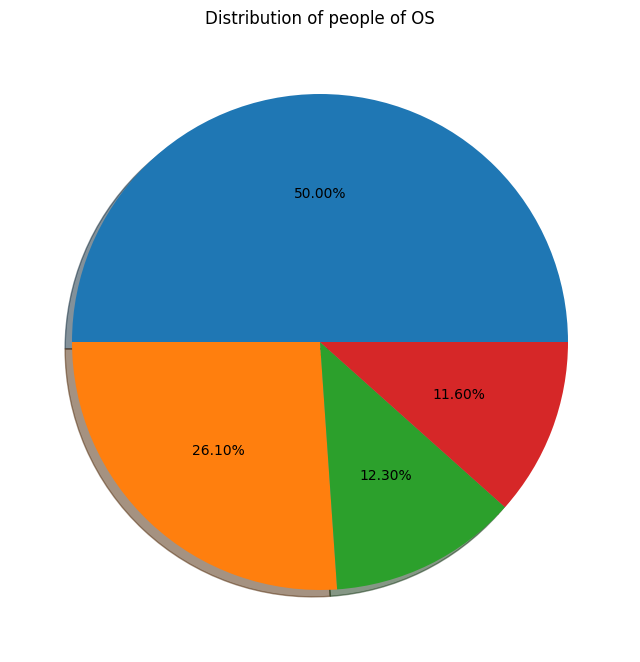

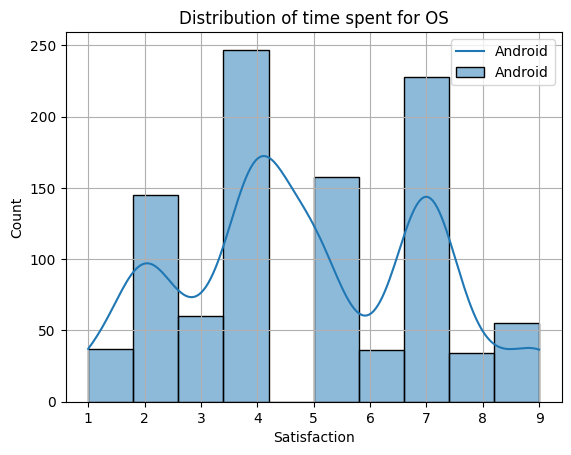

Total Satisfaction by different groups of OS
OS
Android    2471
MacOS       551
Windows     585
iOS        1257
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


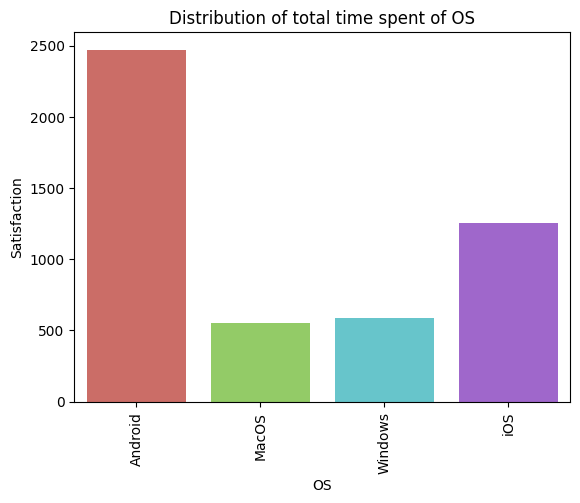

Average Satisfaction by different groups of OS
OS
Android    4.942000
MacOS      4.750000
Windows    4.756098
iOS        4.816092
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


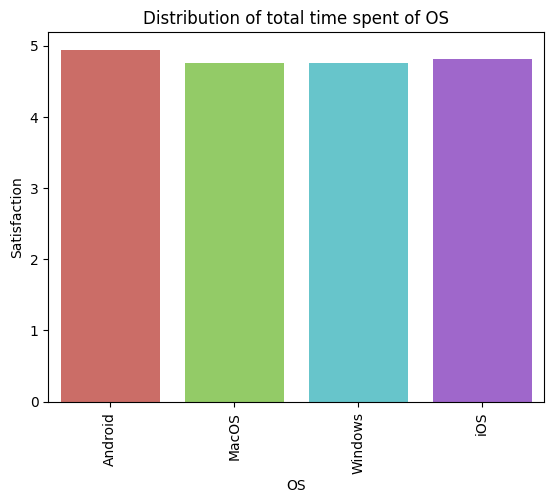

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


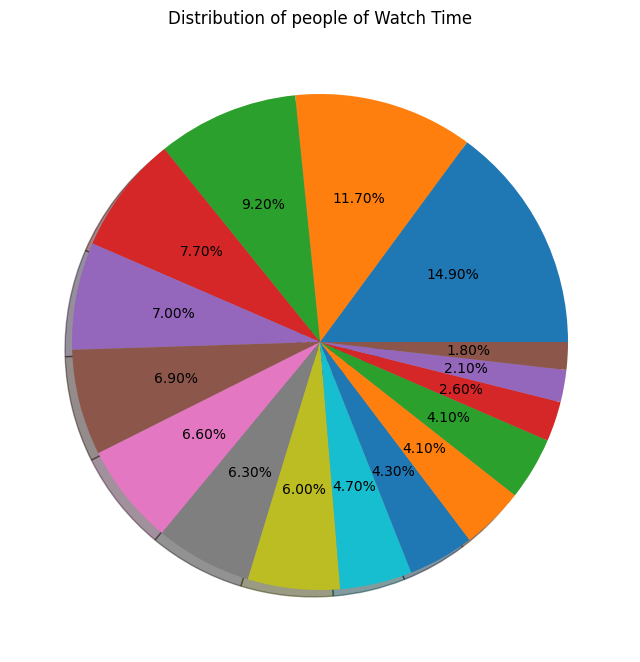

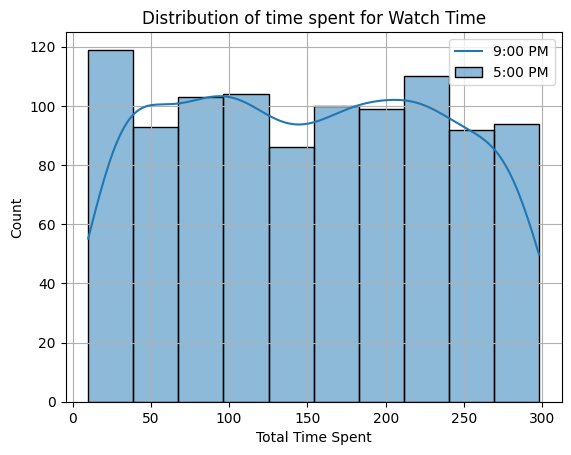

Total Total Time Spent by different groups of Watch Time
Watch Time
10:15 PM    10447
11:30 PM     8972
2:00 PM     24532
3:45 PM     10385
3:55 PM      9586
4:25 PM     12254
5:00 PM     13592
5:45 PM      7194
6:05 PM      6241
7:25 PM      5373
7:45 AM      3408
8:00 AM      6651
8:30 PM      9356
9:00 PM     17828
9:15 AM      2778
9:55 AM      2809
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


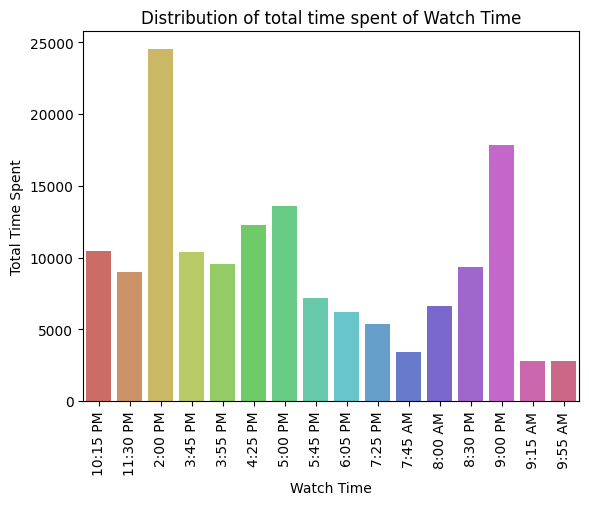

Average Total Time Spent by different groups of Watch Time
Watch Time
10:15 PM    158.287879
11:30 PM    142.412698
2:00 PM     164.644295
3:45 PM     150.507246
3:55 PM     136.942857
4:25 PM     159.142857
5:00 PM     147.739130
5:45 PM     153.063830
6:05 PM     145.139535
7:25 PM     131.048780
7:45 AM     131.076923
8:00 AM     162.219512
8:30 PM     155.933333
9:00 PM     152.376068
9:15 AM     132.285714
9:55 AM     156.055556
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


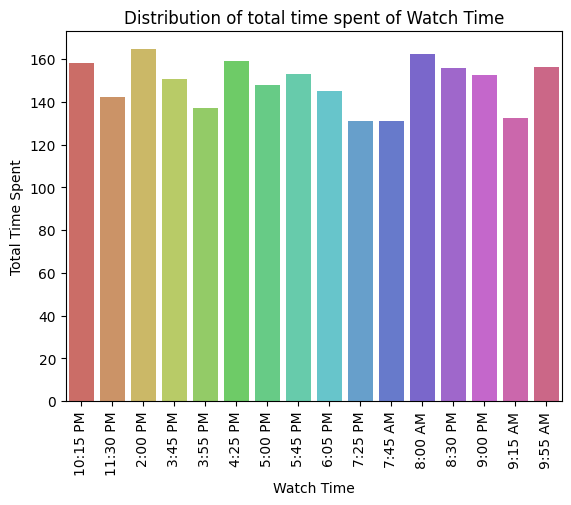

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


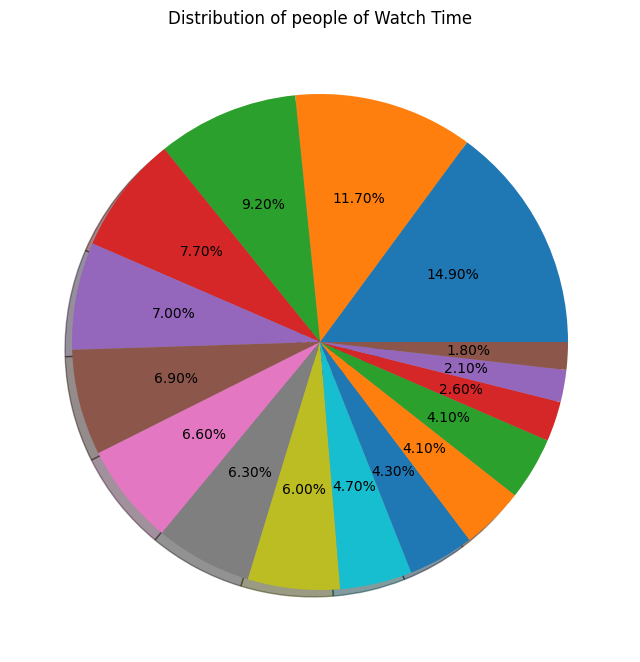

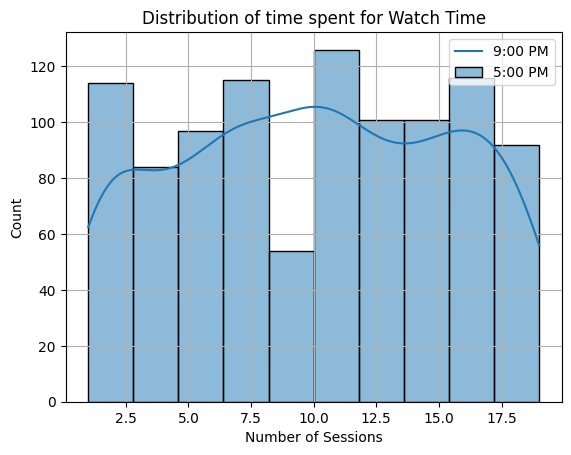

Total Number of Sessions by different groups of Watch Time
Watch Time
10:15 PM     658
11:30 PM     553
2:00 PM     1424
3:45 PM      762
3:55 PM      676
4:25 PM      800
5:00 PM      894
5:45 PM      494
6:05 PM      392
7:25 PM      360
7:45 AM      283
8:00 AM      448
8:30 PM      574
9:00 PM     1236
9:15 AM      276
9:55 AM      183
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


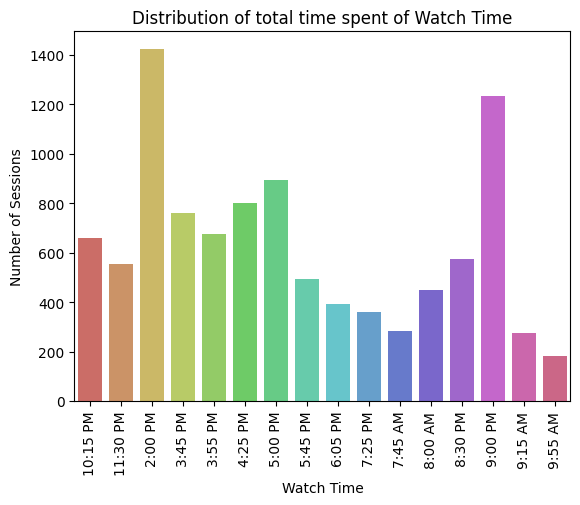

Average Number of Sessions by different groups of Watch Time
Watch Time
10:15 PM     9.969697
11:30 PM     8.777778
2:00 PM      9.557047
3:45 PM     11.043478
3:55 PM      9.657143
4:25 PM     10.389610
5:00 PM      9.717391
5:45 PM     10.510638
6:05 PM      9.116279
7:25 PM      8.780488
7:45 AM     10.884615
8:00 AM     10.926829
8:30 PM      9.566667
9:00 PM     10.564103
9:15 AM     13.142857
9:55 AM     10.166667
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


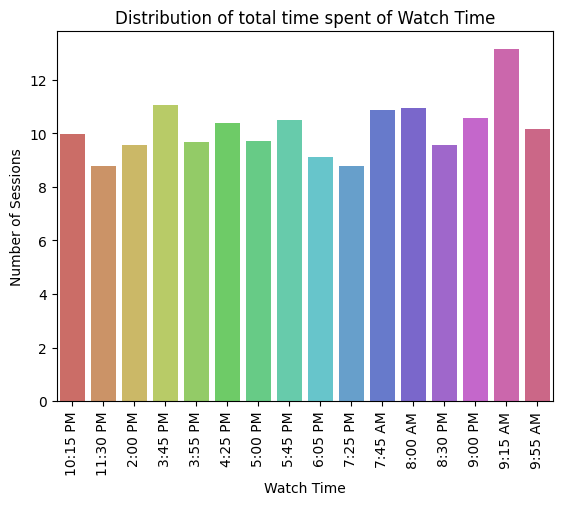

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


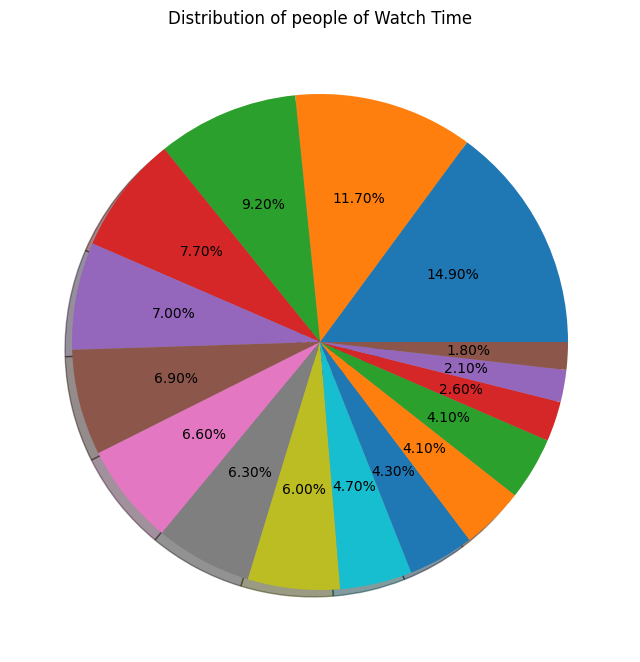

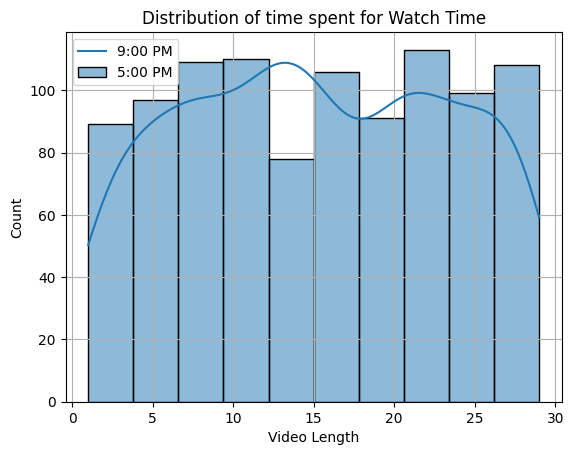

Total Video Length by different groups of Watch Time
Watch Time
10:15 PM     925
11:30 PM     960
2:00 PM     2174
3:45 PM     1007
3:55 PM     1026
4:25 PM     1205
5:00 PM     1513
5:45 PM      722
6:05 PM      584
7:25 PM      607
7:45 AM      445
8:00 AM      668
8:30 PM      989
9:00 PM     1771
9:15 AM      333
9:55 AM      285
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


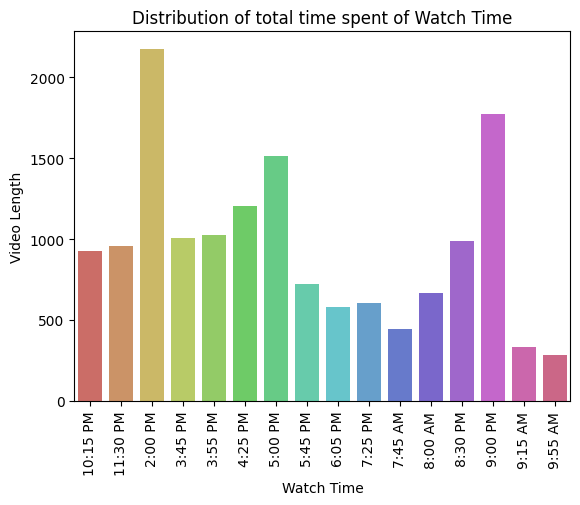

Average Video Length by different groups of Watch Time
Watch Time
10:15 PM    14.015152
11:30 PM    15.238095
2:00 PM     14.590604
3:45 PM     14.594203
3:55 PM     14.657143
4:25 PM     15.649351
5:00 PM     16.445652
5:45 PM     15.361702
6:05 PM     13.581395
7:25 PM     14.804878
7:45 AM     17.115385
8:00 AM     16.292683
8:30 PM     16.483333
9:00 PM     15.136752
9:15 AM     15.857143
9:55 AM     15.833333
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


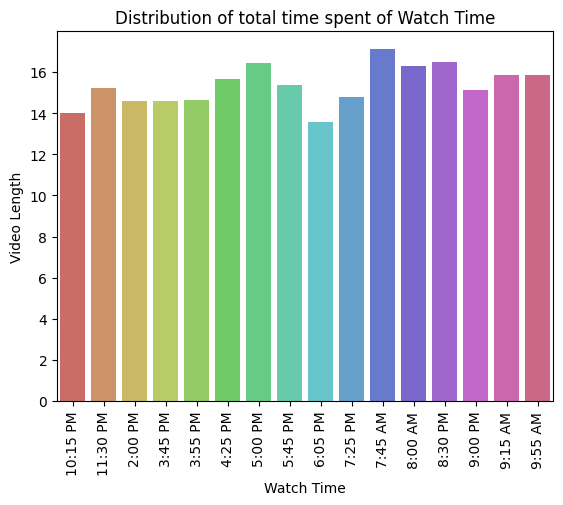

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


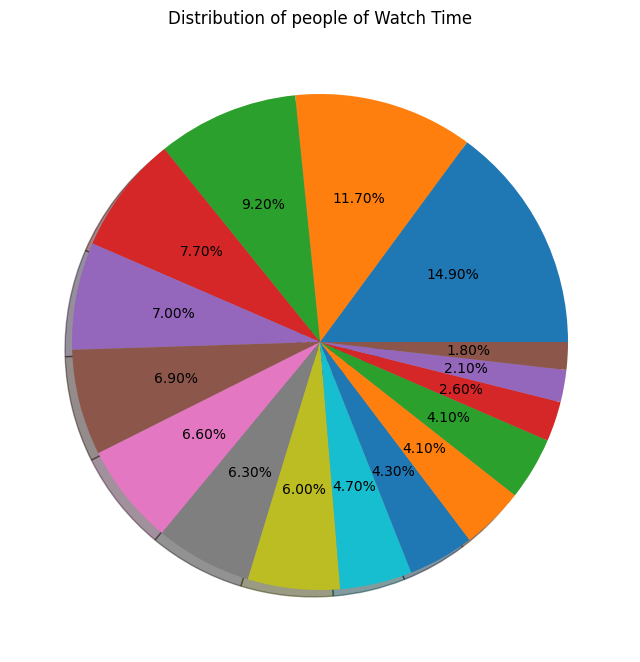

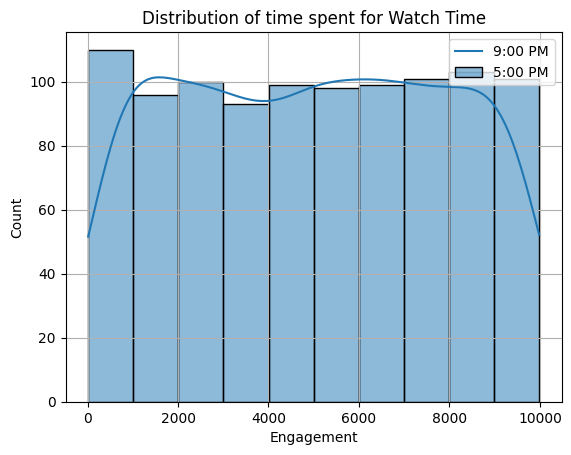

Total Engagement by different groups of Watch Time
Watch Time
10:15 PM    320242
11:30 PM    337056
2:00 PM     705241
3:45 PM     357908
3:55 PM     329248
4:25 PM     411568
5:00 PM     434220
5:45 PM     240539
6:05 PM     188881
7:25 PM     223190
7:45 AM     123550
8:00 AM     215783
8:30 PM     312986
9:00 PM     624168
9:15 AM      86232
9:55 AM      86347
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


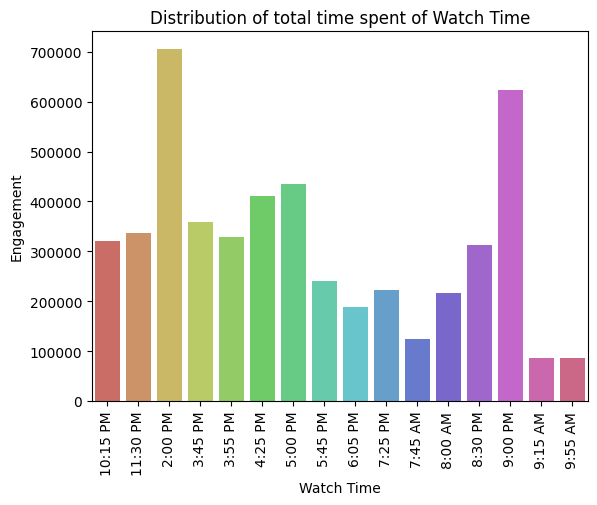

Average Engagement by different groups of Watch Time
Watch Time
10:15 PM    4852.151515
11:30 PM    5350.095238
2:00 PM     4733.161074
3:45 PM     5187.072464
3:55 PM     4703.542857
4:25 PM     5345.038961
5:00 PM     4719.782609
5:45 PM     5117.851064
6:05 PM     4392.581395
7:25 PM     5443.658537
7:45 AM     4751.923077
8:00 AM     5263.000000
8:30 PM     5216.433333
9:00 PM     5334.769231
9:15 AM     4106.285714
9:55 AM     4797.055556
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


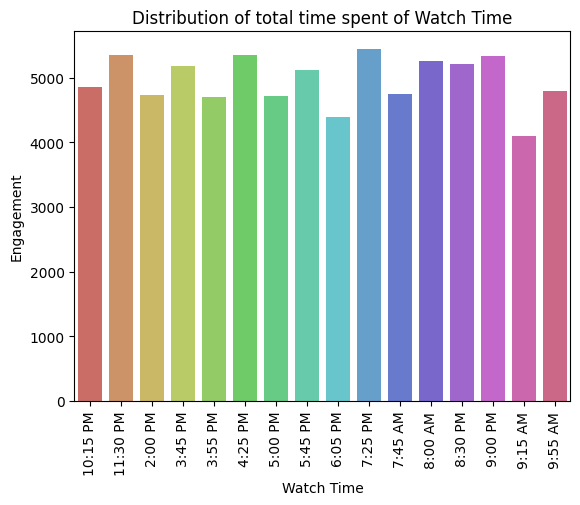

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


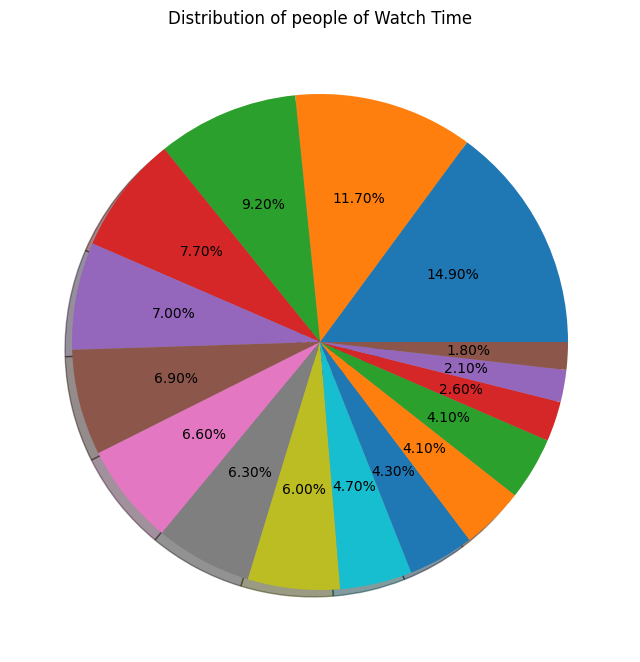

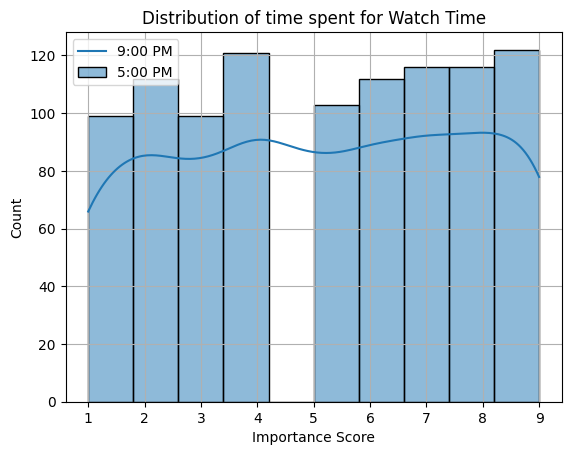

Total Importance Score by different groups of Watch Time
Watch Time
10:15 PM    345
11:30 PM    301
2:00 PM     766
3:45 PM     317
3:55 PM     359
4:25 PM     372
5:00 PM     515
5:45 PM     226
6:05 PM     214
7:25 PM     201
7:45 AM     139
8:00 AM     212
8:30 PM     303
9:00 PM     650
9:15 AM     108
9:55 AM     101
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


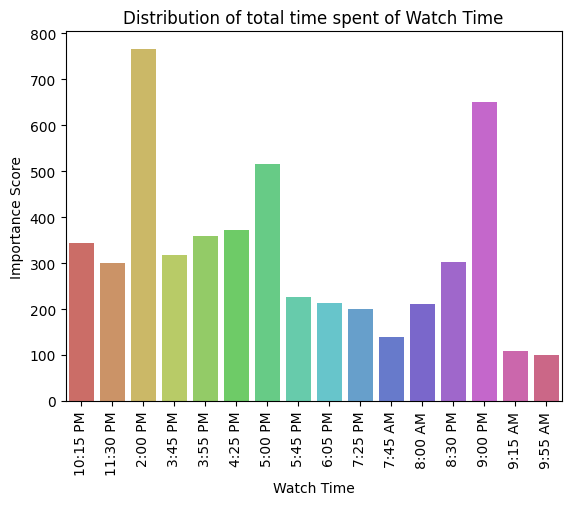

Average Importance Score by different groups of Watch Time
Watch Time
10:15 PM    5.227273
11:30 PM    4.777778
2:00 PM     5.140940
3:45 PM     4.594203
3:55 PM     5.128571
4:25 PM     4.831169
5:00 PM     5.597826
5:45 PM     4.808511
6:05 PM     4.976744
7:25 PM     4.902439
7:45 AM     5.346154
8:00 AM     5.170732
8:30 PM     5.050000
9:00 PM     5.555556
9:15 AM     5.142857
9:55 AM     5.611111
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


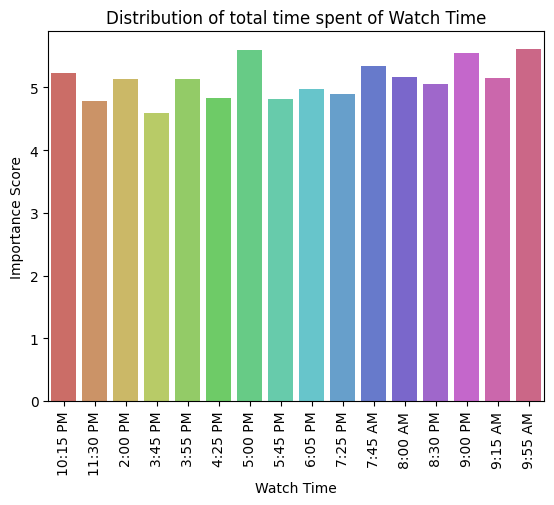

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


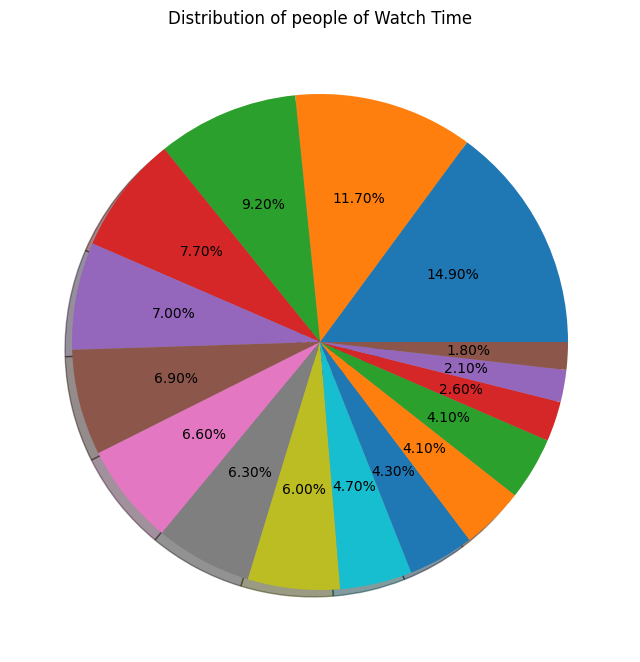

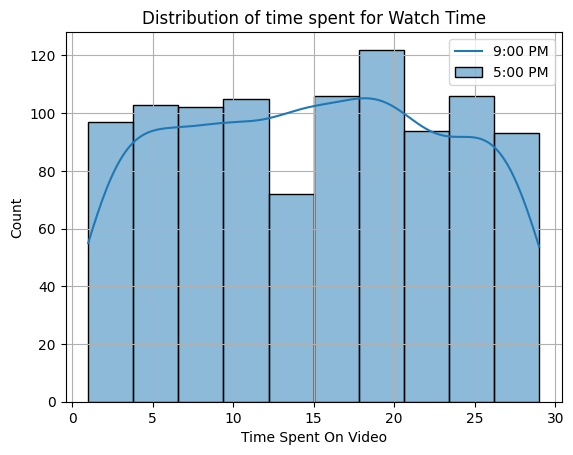

Total Time Spent On Video by different groups of Watch Time
Watch Time
10:15 PM    1012
11:30 PM     902
2:00 PM     2392
3:45 PM     1018
3:55 PM      932
4:25 PM     1102
5:00 PM     1385
5:45 PM      744
6:05 PM      604
7:25 PM      636
7:45 AM      393
8:00 AM      655
8:30 PM      901
9:00 PM     1707
9:15 AM      352
9:55 AM      238
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


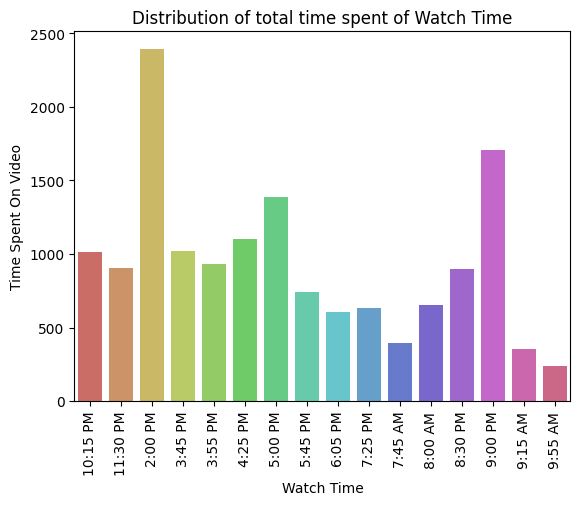

Average Time Spent On Video by different groups of Watch Time
Watch Time
10:15 PM    15.333333
11:30 PM    14.317460
2:00 PM     16.053691
3:45 PM     14.753623
3:55 PM     13.314286
4:25 PM     14.311688
5:00 PM     15.054348
5:45 PM     15.829787
6:05 PM     14.046512
7:25 PM     15.512195
7:45 AM     15.115385
8:00 AM     15.975610
8:30 PM     15.016667
9:00 PM     14.589744
9:15 AM     16.761905
9:55 AM     13.222222
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


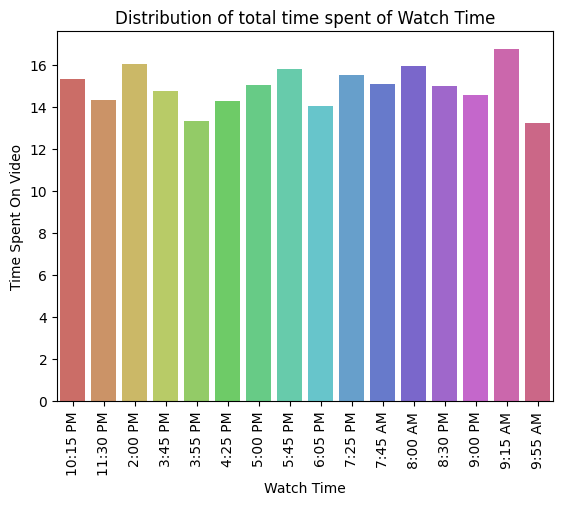

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


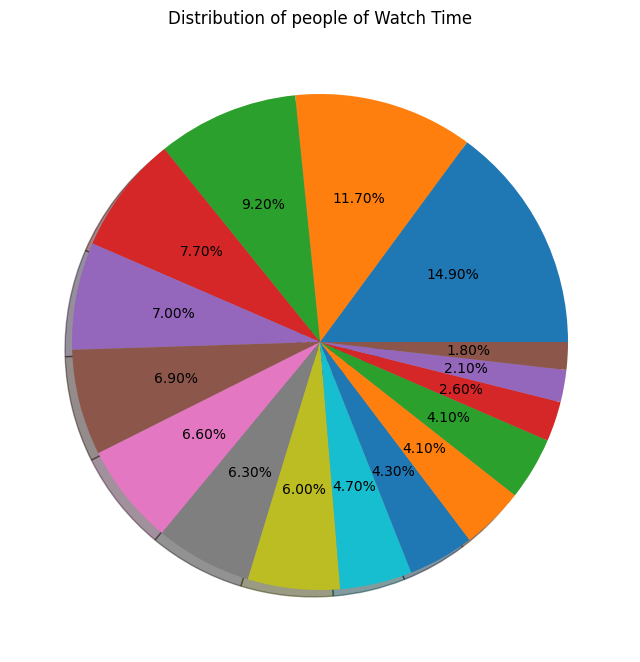

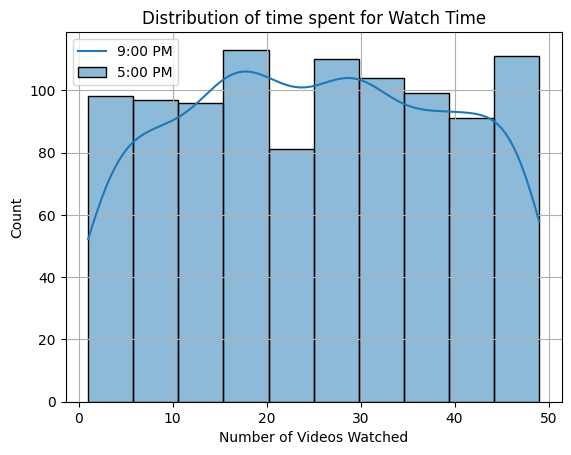

Total Number of Videos Watched by different groups of Watch Time
Watch Time
10:15 PM    1605
11:30 PM    1604
2:00 PM     3760
3:45 PM     1458
3:55 PM     1803
4:25 PM     2027
5:00 PM     2372
5:45 PM     1205
6:05 PM     1091
7:25 PM      945
7:45 AM      736
8:00 AM      949
8:30 PM     1657
9:00 PM     3016
9:15 AM      530
9:55 AM      490
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


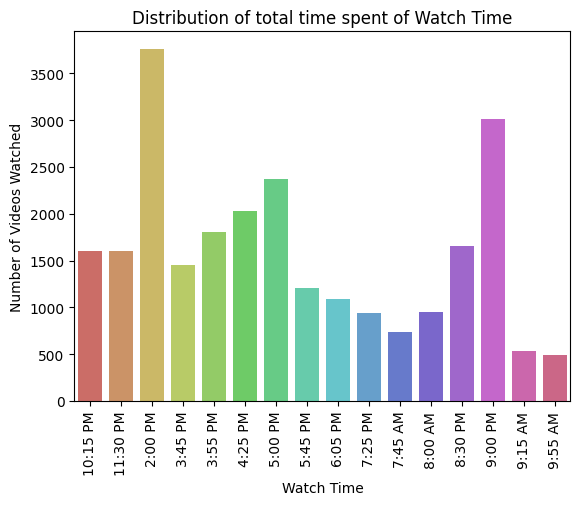

Average Number of Videos Watched by different groups of Watch Time
Watch Time
10:15 PM    24.318182
11:30 PM    25.460317
2:00 PM     25.234899
3:45 PM     21.130435
3:55 PM     25.757143
4:25 PM     26.324675
5:00 PM     25.782609
5:45 PM     25.638298
6:05 PM     25.372093
7:25 PM     23.048780
7:45 AM     28.307692
8:00 AM     23.146341
8:30 PM     27.616667
9:00 PM     25.777778
9:15 AM     25.238095
9:55 AM     27.222222
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


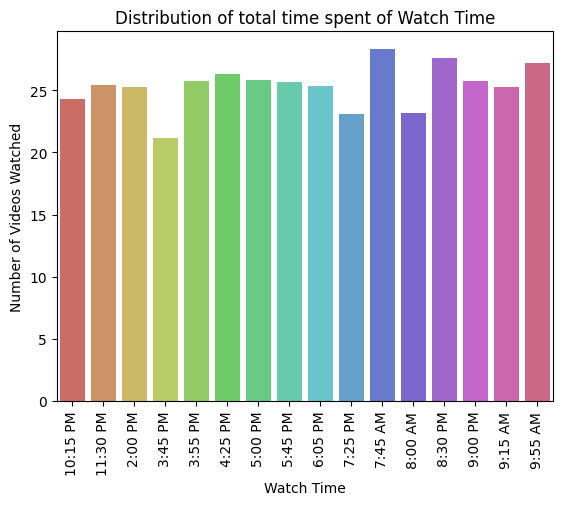

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


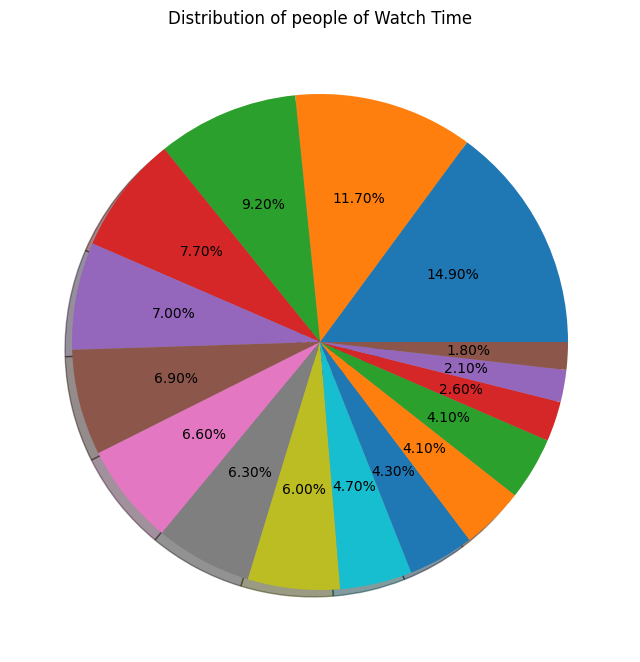

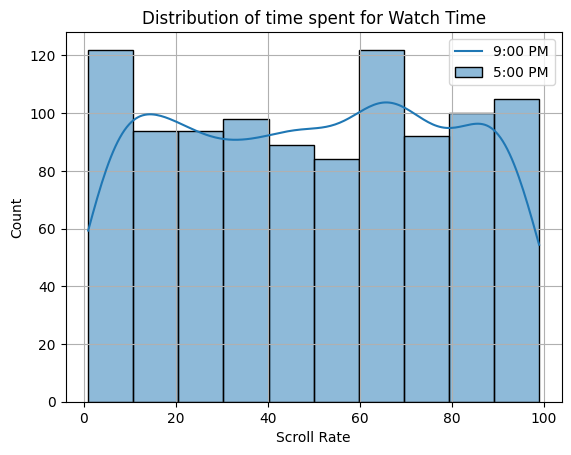

Total Scroll Rate by different groups of Watch Time
Watch Time
10:15 PM    3173
11:30 PM    3387
2:00 PM     7654
3:45 PM     3415
3:55 PM     3290
4:25 PM     3573
5:00 PM     4332
5:45 PM     2484
6:05 PM     2256
7:25 PM     1724
7:45 AM     1078
8:00 AM     2213
8:30 PM     2761
9:00 PM     6263
9:15 AM     1051
9:55 AM     1120
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


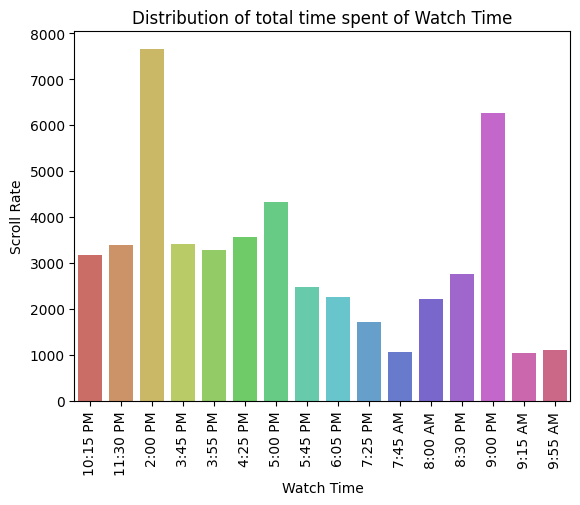

Average Scroll Rate by different groups of Watch Time
Watch Time
10:15 PM    48.075758
11:30 PM    53.761905
2:00 PM     51.369128
3:45 PM     49.492754
3:55 PM     47.000000
4:25 PM     46.402597
5:00 PM     47.086957
5:45 PM     52.851064
6:05 PM     52.465116
7:25 PM     42.048780
7:45 AM     41.461538
8:00 AM     53.975610
8:30 PM     46.016667
9:00 PM     53.529915
9:15 AM     50.047619
9:55 AM     62.222222
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


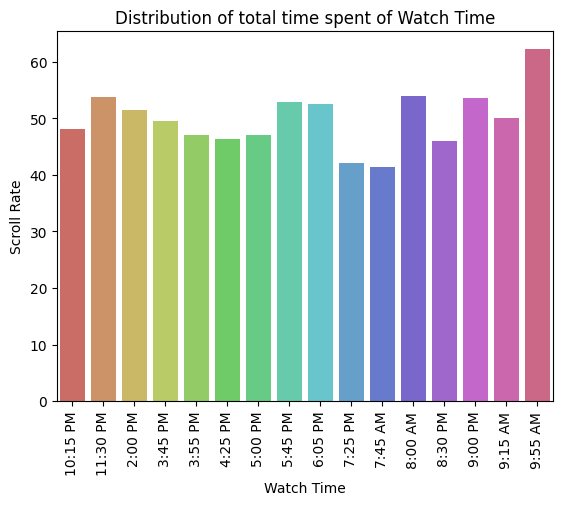

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


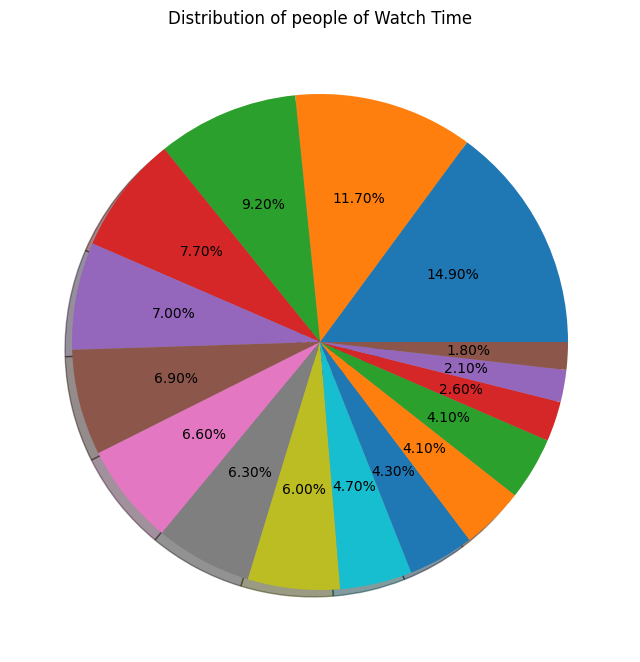

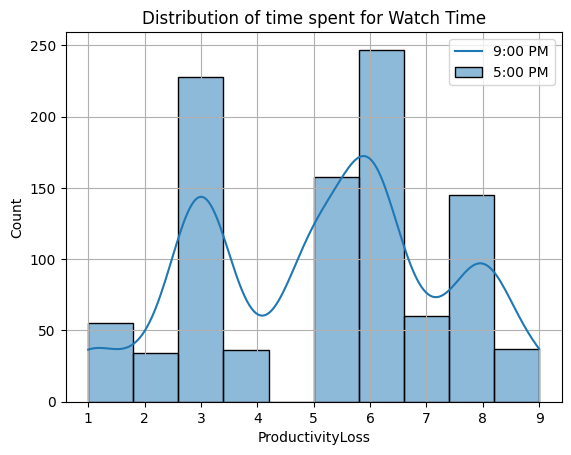

Total ProductivityLoss by different groups of Watch Time
Watch Time
10:15 PM    212
11:30 PM    129
2:00 PM     869
3:45 PM     414
3:55 PM     450
4:25 PM     417
5:00 PM     516
5:45 PM     232
6:05 PM     215
7:25 PM     229
7:45 AM     223
8:00 AM     275
8:30 PM     180
9:00 PM     479
9:15 AM     168
9:55 AM     128
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


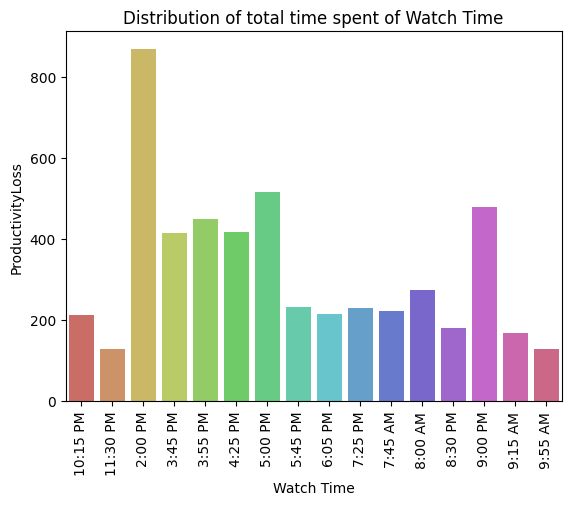

Average ProductivityLoss by different groups of Watch Time
Watch Time
10:15 PM    3.212121
11:30 PM    2.047619
2:00 PM     5.832215
3:45 PM     6.000000
3:55 PM     6.428571
4:25 PM     5.415584
5:00 PM     5.608696
5:45 PM     4.936170
6:05 PM     5.000000
7:25 PM     5.585366
7:45 AM     8.576923
8:00 AM     6.707317
8:30 PM     3.000000
9:00 PM     4.094017
9:15 AM     8.000000
9:55 AM     7.111111
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


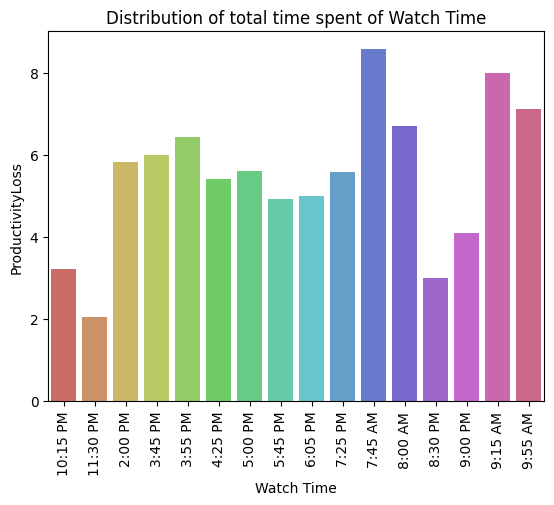

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


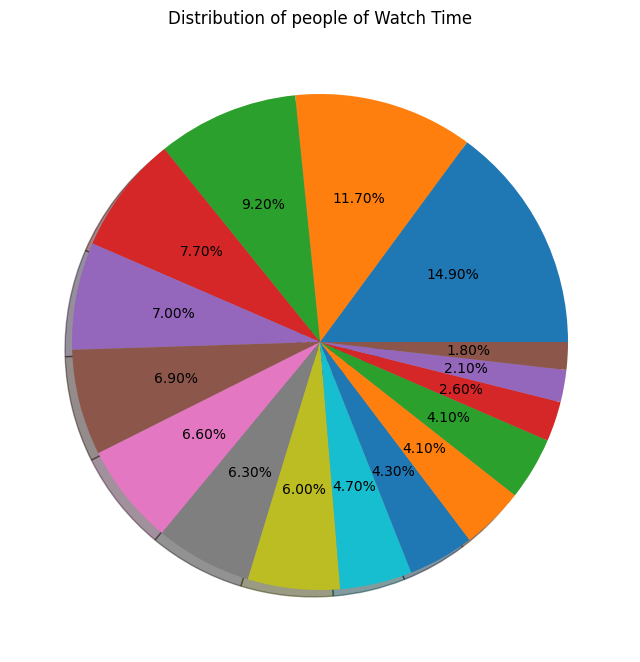

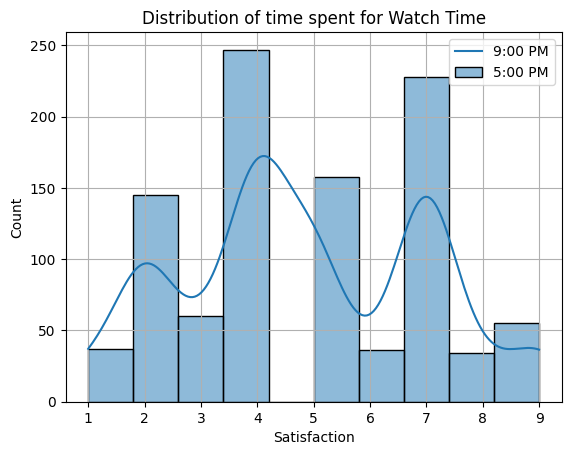

Total Satisfaction by different groups of Watch Time
Watch Time
10:15 PM    448
11:30 PM    501
2:00 PM     621
3:45 PM     276
3:55 PM     250
4:25 PM     353
5:00 PM     404
5:45 PM     238
6:05 PM     215
7:25 PM     181
7:45 AM      37
8:00 AM     135
8:30 PM     420
9:00 PM     691
9:15 AM      42
9:55 AM      52
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


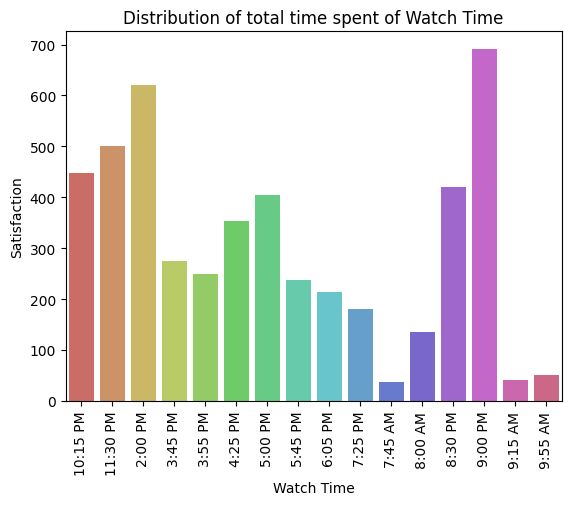

Average Satisfaction by different groups of Watch Time
Watch Time
10:15 PM    6.787879
11:30 PM    7.952381
2:00 PM     4.167785
3:45 PM     4.000000
3:55 PM     3.571429
4:25 PM     4.584416
5:00 PM     4.391304
5:45 PM     5.063830
6:05 PM     5.000000
7:25 PM     4.414634
7:45 AM     1.423077
8:00 AM     3.292683
8:30 PM     7.000000
9:00 PM     5.905983
9:15 AM     2.000000
9:55 AM     2.888889
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


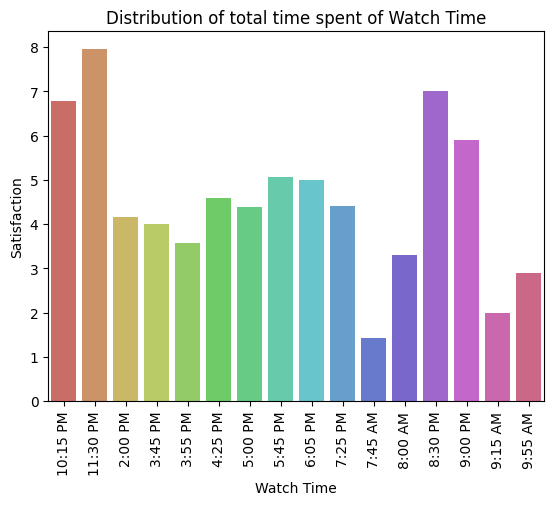

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


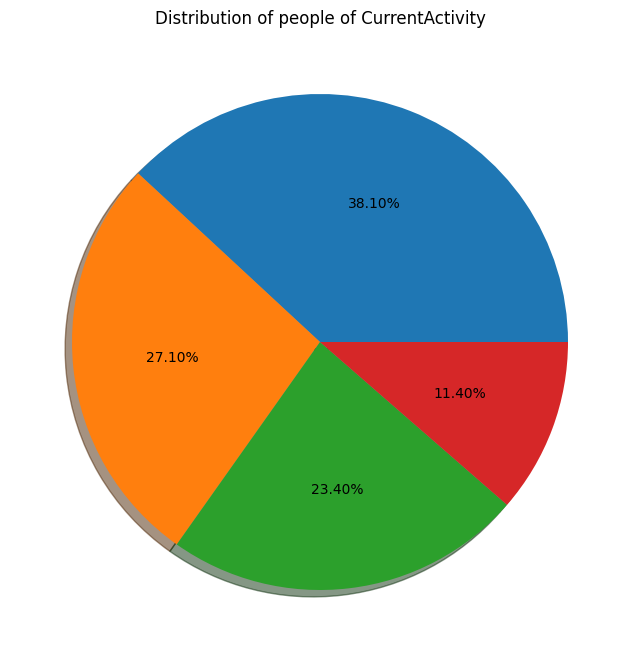

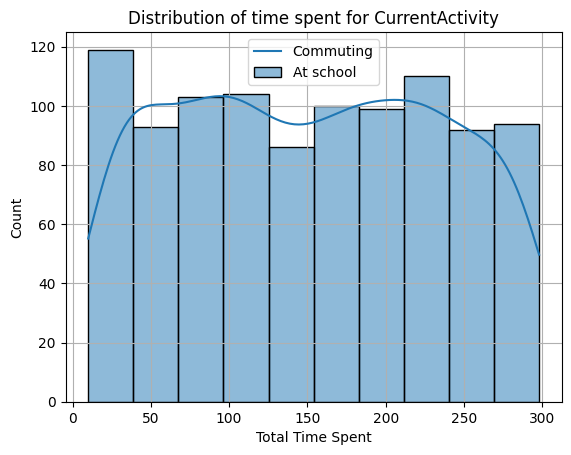

Total Total Time Spent by different groups of CurrentActivity
CurrentActivity
At home      56425
At school    41623
At work      36485
Commuting    16873
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


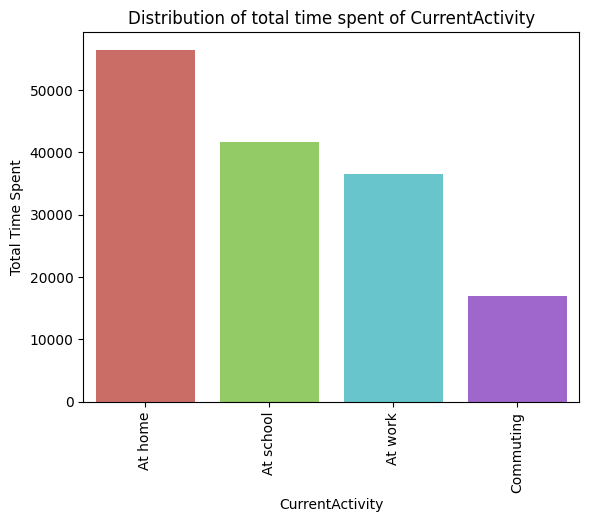

Average Total Time Spent by different groups of CurrentActivity
CurrentActivity
At home      148.097113
At school    153.590406
At work      155.918803
Commuting    148.008772
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


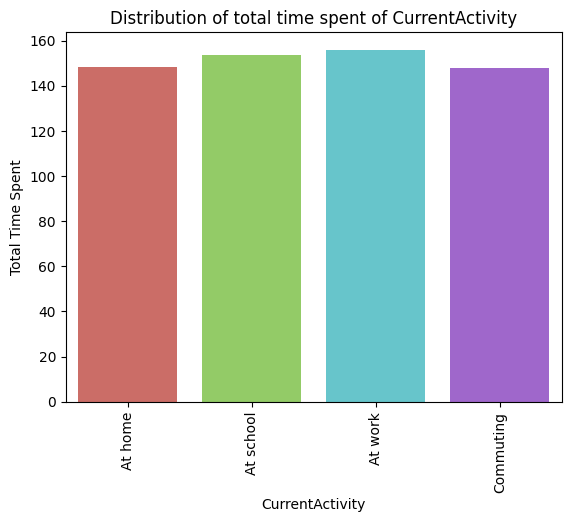

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


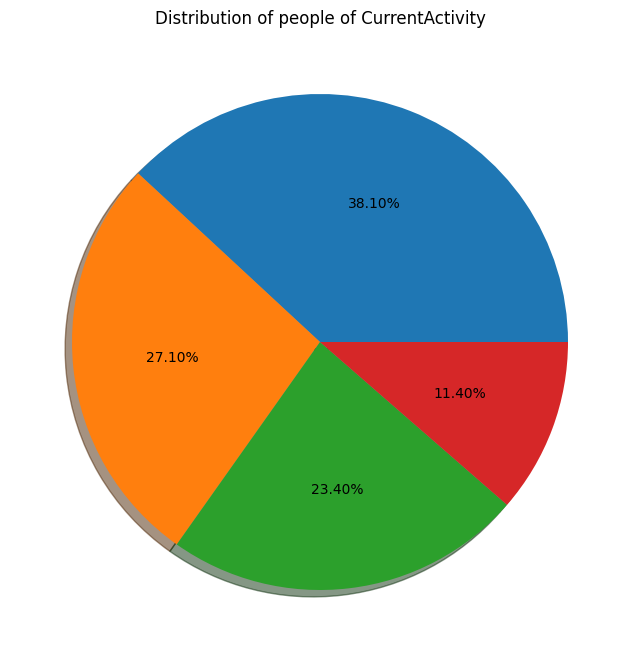

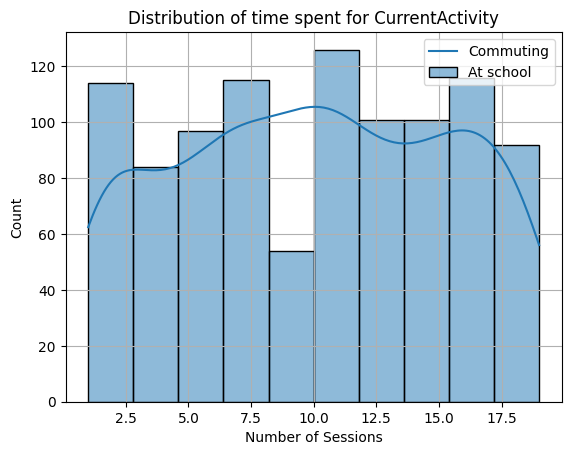

Total Number of Sessions by different groups of CurrentActivity
CurrentActivity
At home      3734
At school    2712
At work      2387
Commuting    1180
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


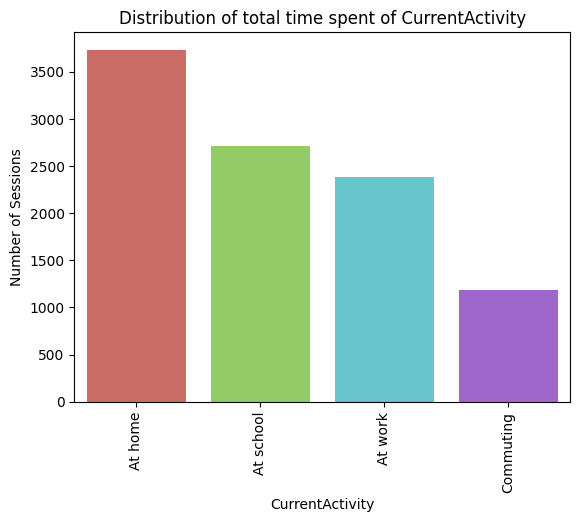

Average Number of Sessions by different groups of CurrentActivity
CurrentActivity
At home       9.800525
At school    10.007380
At work      10.200855
Commuting    10.350877
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


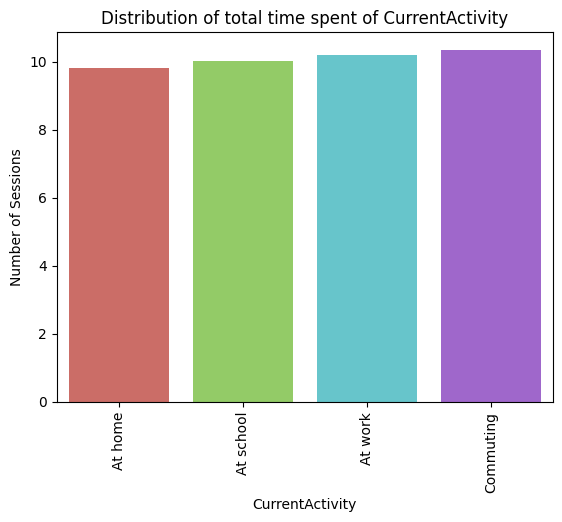

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


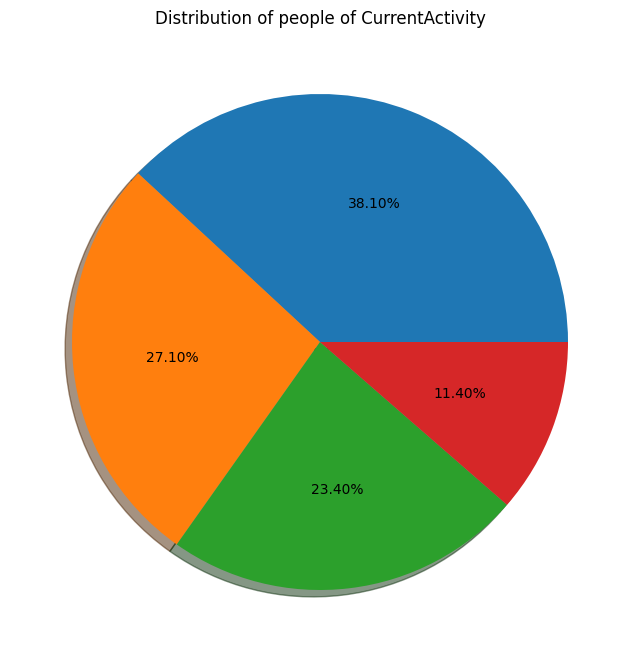

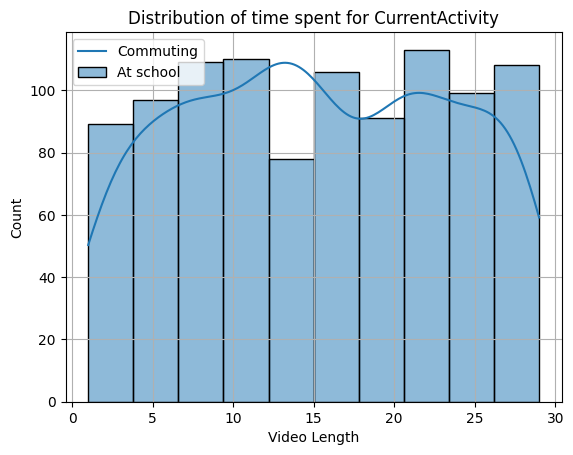

Total Video Length by different groups of CurrentActivity
CurrentActivity
At home      5992
At school    4130
At work      3437
Commuting    1655
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


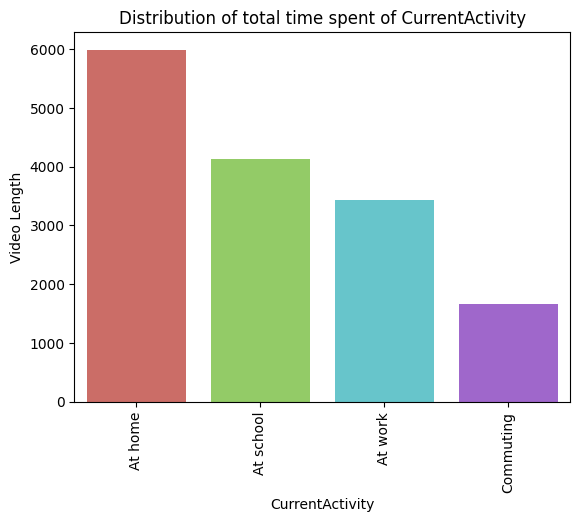

Average Video Length by different groups of CurrentActivity
CurrentActivity
At home      15.727034
At school    15.239852
At work      14.688034
Commuting    14.517544
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


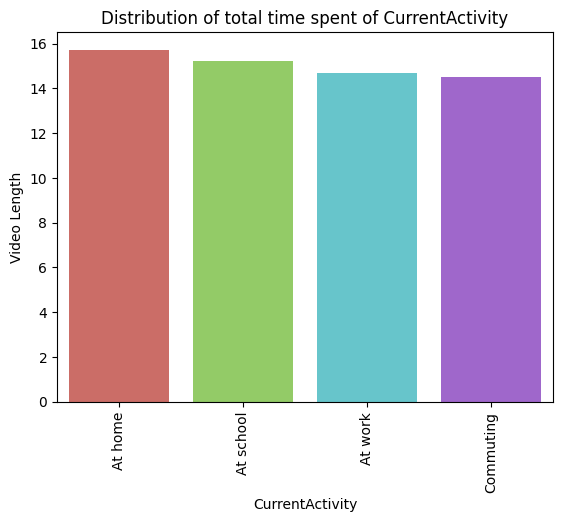

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


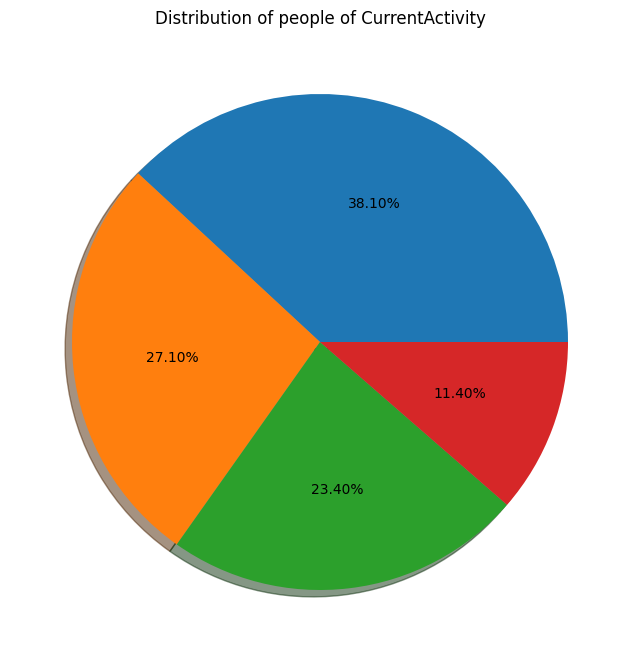

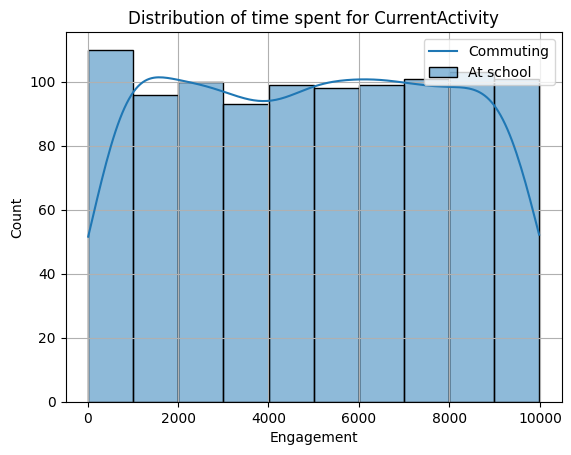

Total Engagement by different groups of CurrentActivity
CurrentActivity
At home      1929267
At school    1373747
At work      1146112
Commuting     548033
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


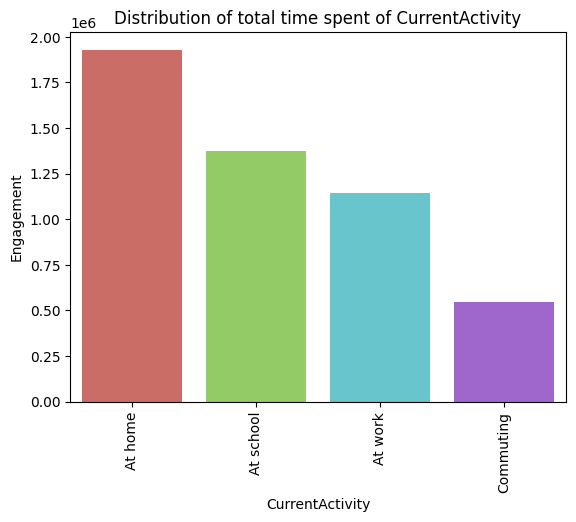

Average Engagement by different groups of CurrentActivity
CurrentActivity
At home      5063.692913
At school    5069.177122
At work      4897.914530
Commuting    4807.307018
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


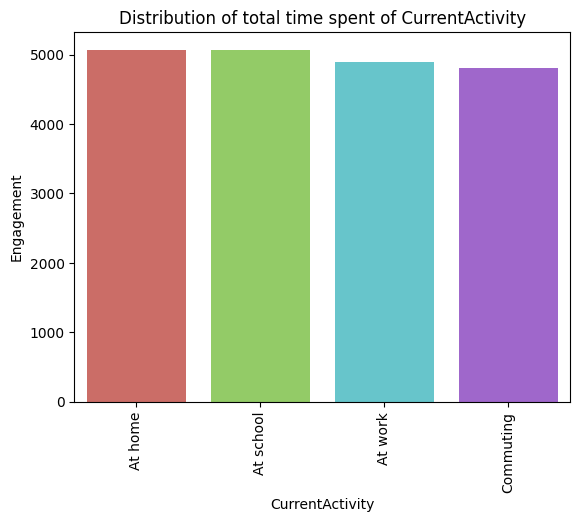

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


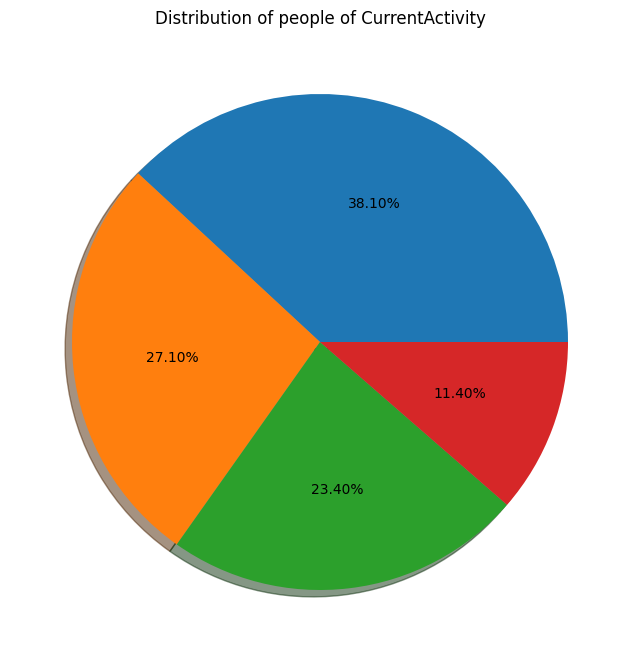

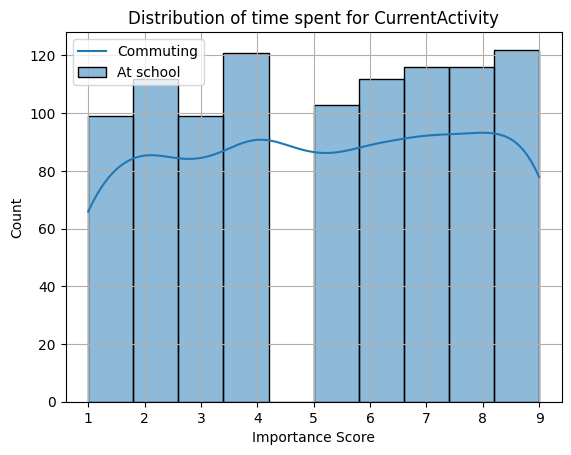

Total Importance Score by different groups of CurrentActivity
CurrentActivity
At home      1950
At school    1427
At work      1192
Commuting     560
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


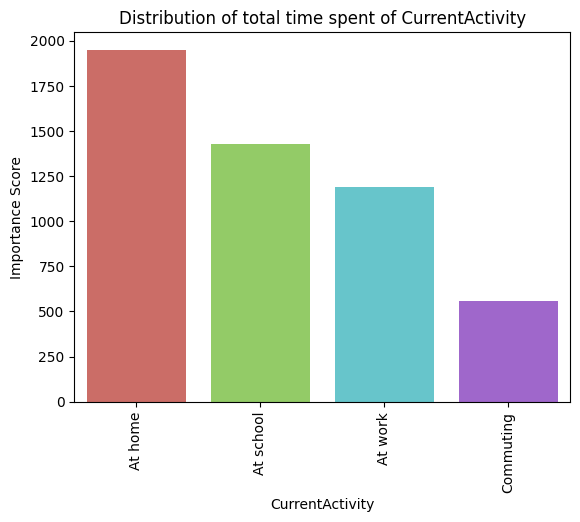

Average Importance Score by different groups of CurrentActivity
CurrentActivity
At home      5.118110
At school    5.265683
At work      5.094017
Commuting    4.912281
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


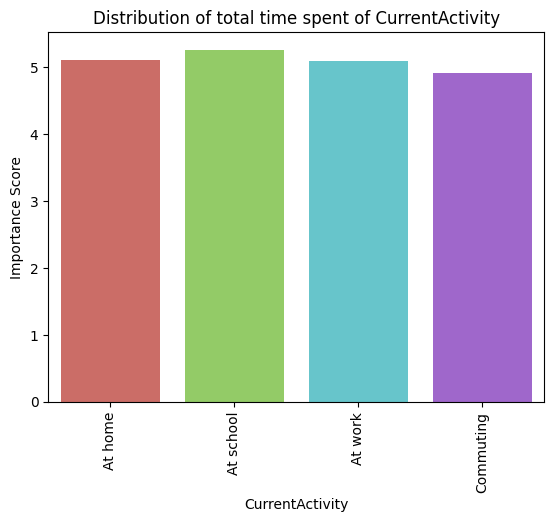

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


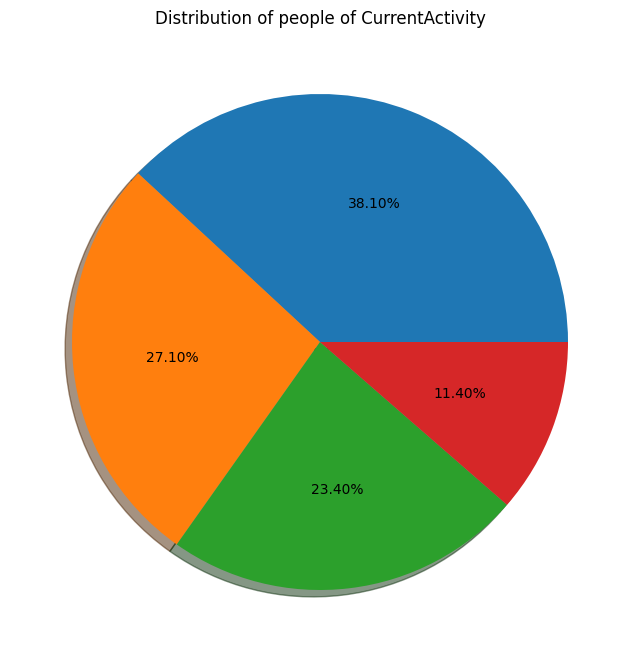

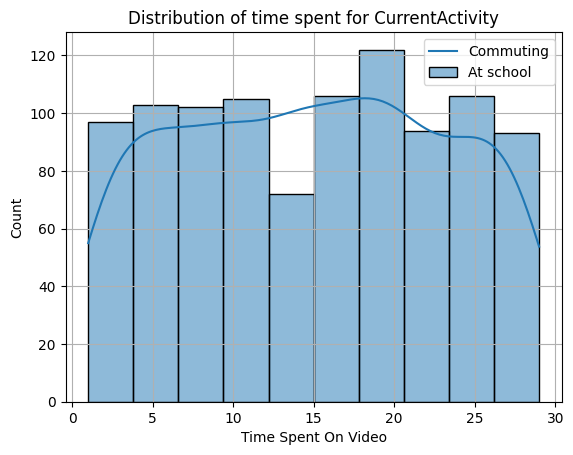

Total Time Spent On Video by different groups of CurrentActivity
CurrentActivity
At home      5679
At school    4135
At work      3480
Commuting    1679
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


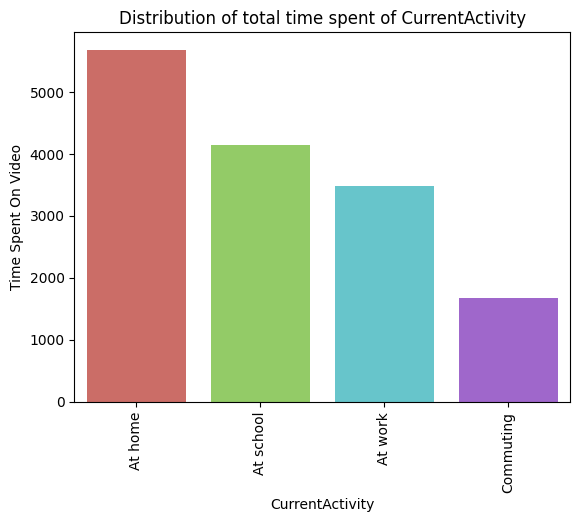

Average Time Spent On Video by different groups of CurrentActivity
CurrentActivity
At home      14.905512
At school    15.258303
At work      14.871795
Commuting    14.728070
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


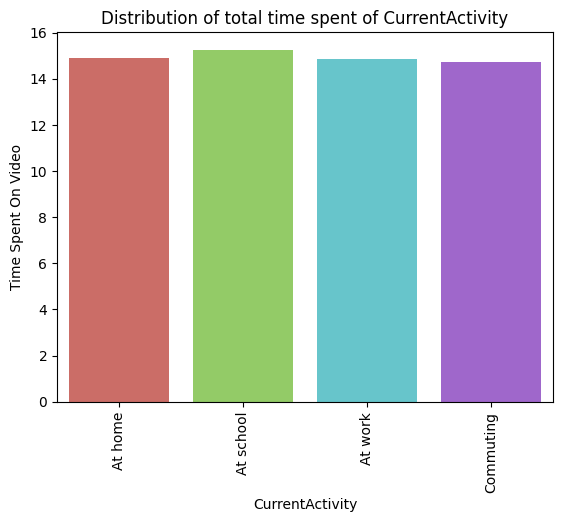

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


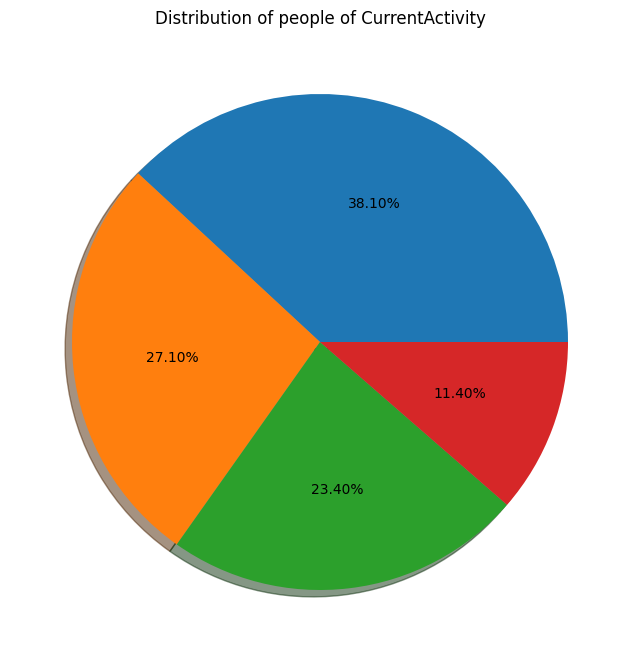

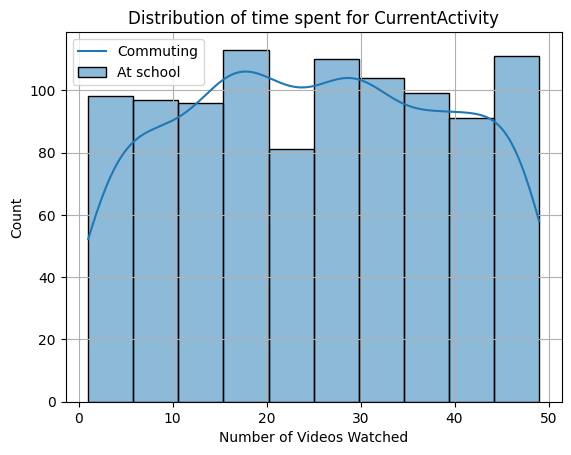

Total Number of Videos Watched by different groups of CurrentActivity
CurrentActivity
At home      9372
At school    7013
At work      5992
Commuting    2871
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


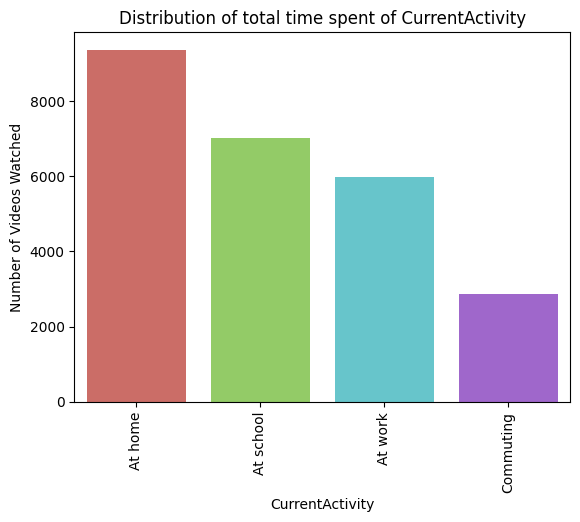

Average Number of Videos Watched by different groups of CurrentActivity
CurrentActivity
At home      24.598425
At school    25.878229
At work      25.606838
Commuting    25.184211
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


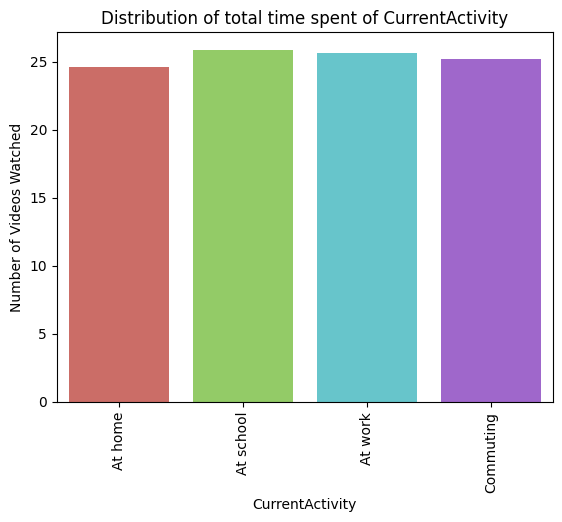

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


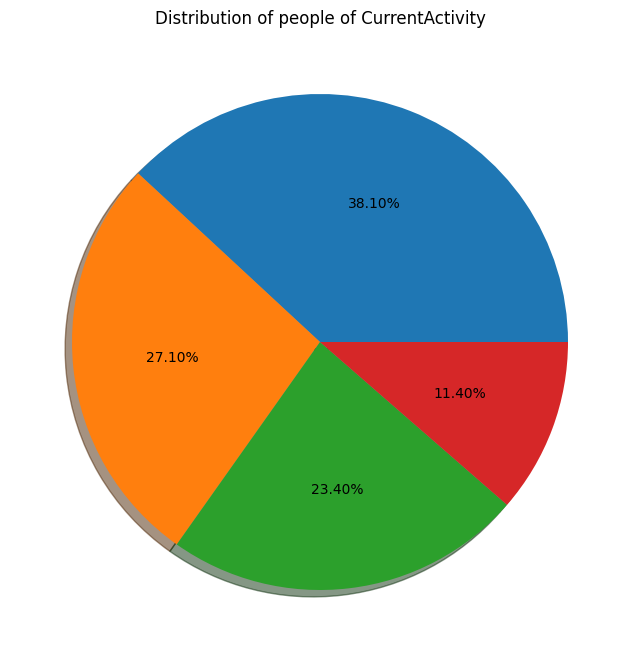

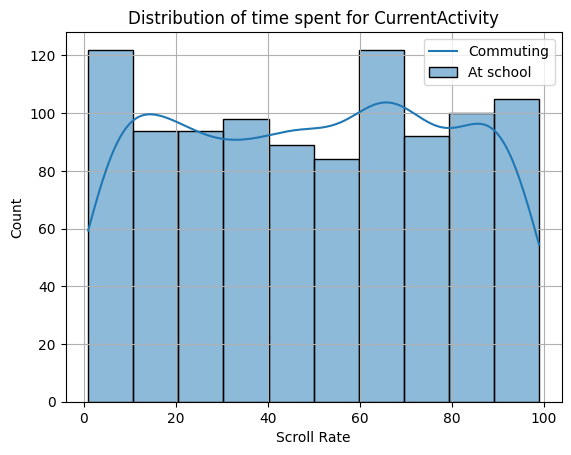

Total Scroll Rate by different groups of CurrentActivity
CurrentActivity
At home      19256
At school    13775
At work      11183
Commuting     5560
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


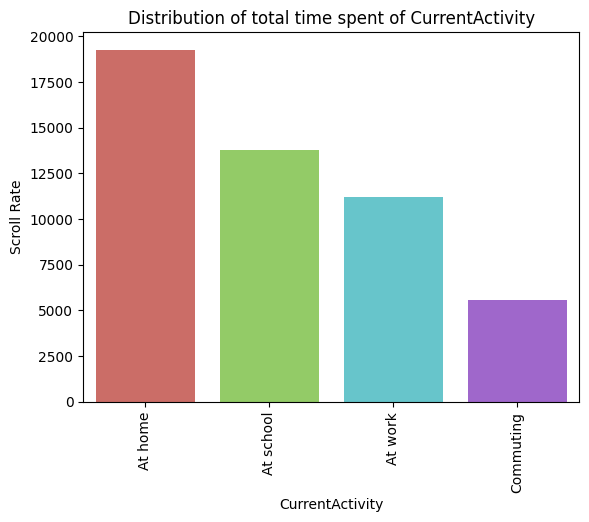

Average Scroll Rate by different groups of CurrentActivity
CurrentActivity
At home      50.540682
At school    50.830258
At work      47.790598
Commuting    48.771930
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


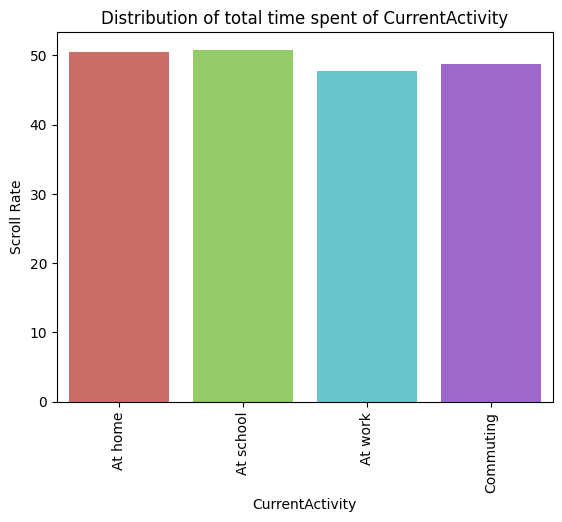

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


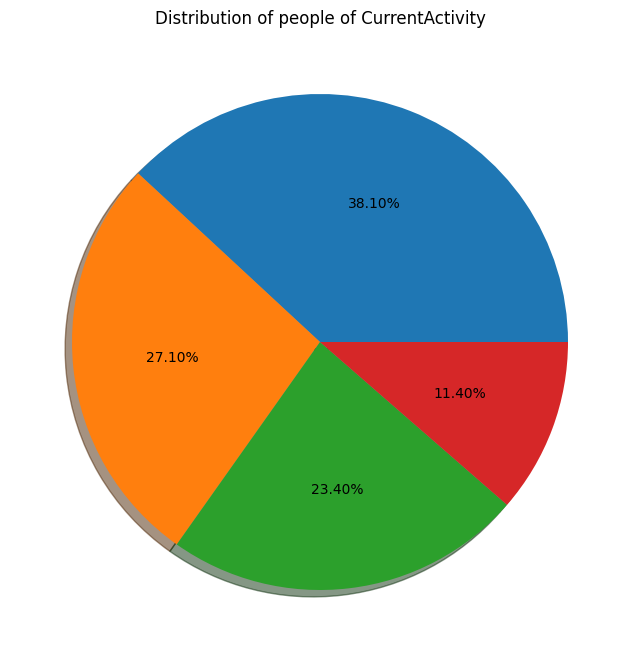

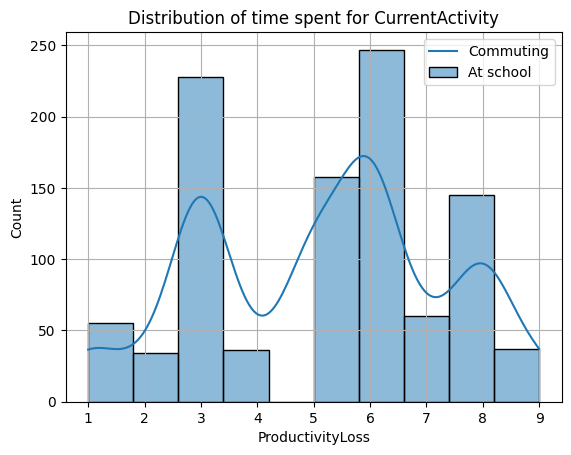

Total ProductivityLoss by different groups of CurrentActivity
CurrentActivity
At home      1937
At school    1417
At work      1176
Commuting     606
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


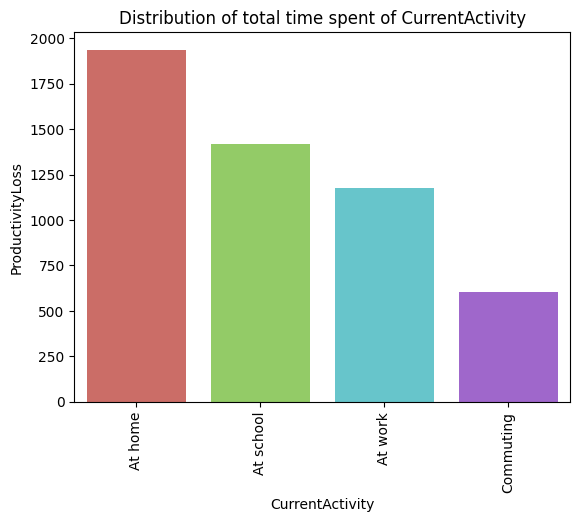

Average ProductivityLoss by different groups of CurrentActivity
CurrentActivity
At home      5.083990
At school    5.228782
At work      5.025641
Commuting    5.315789
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


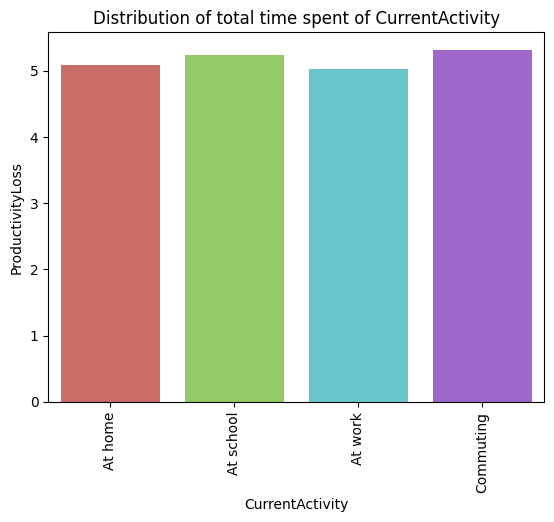

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


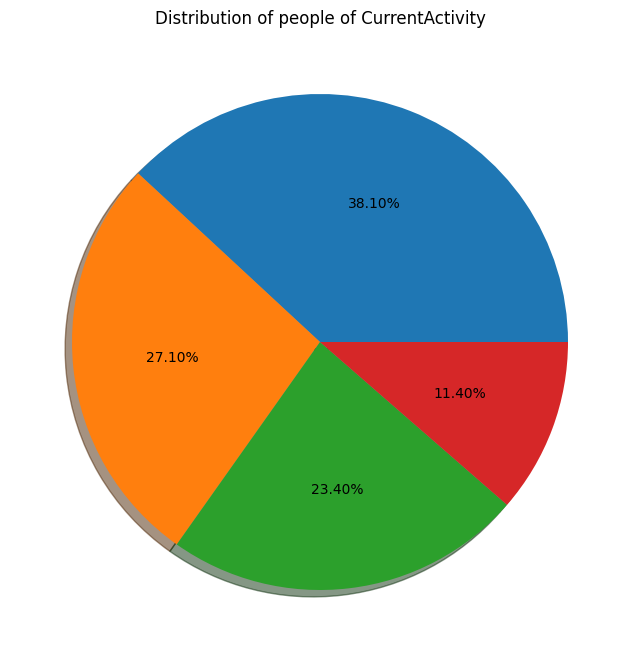

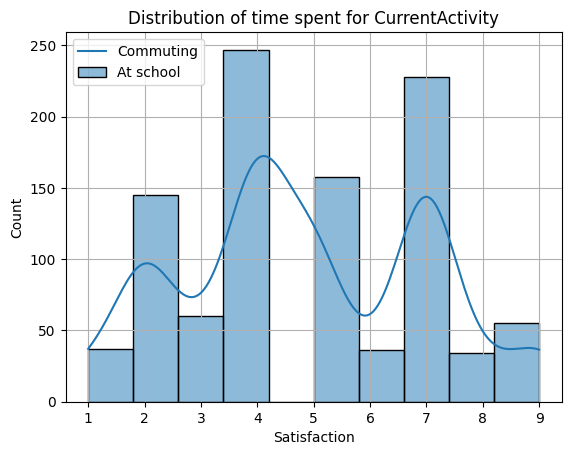

Total Satisfaction by different groups of CurrentActivity
CurrentActivity
At home      1873
At school    1293
At work      1164
Commuting     534
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


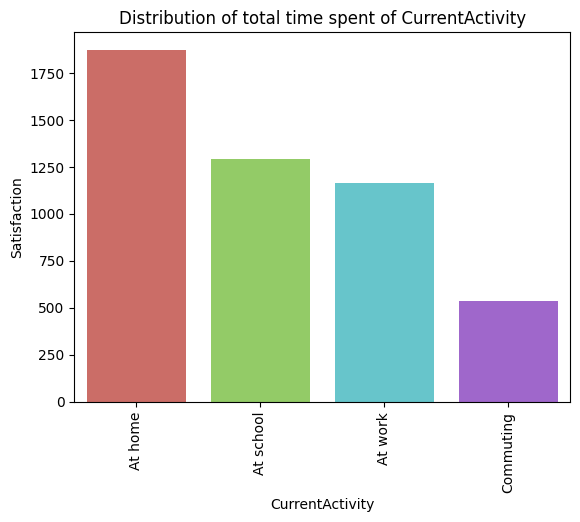

Average Satisfaction by different groups of CurrentActivity
CurrentActivity
At home      4.916010
At school    4.771218
At work      4.974359
Commuting    4.684211
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


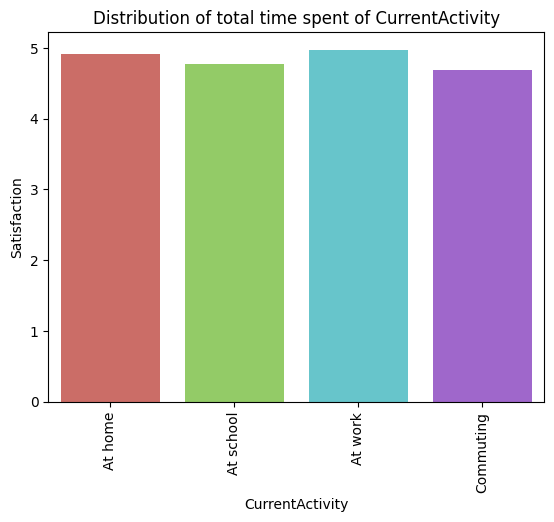

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


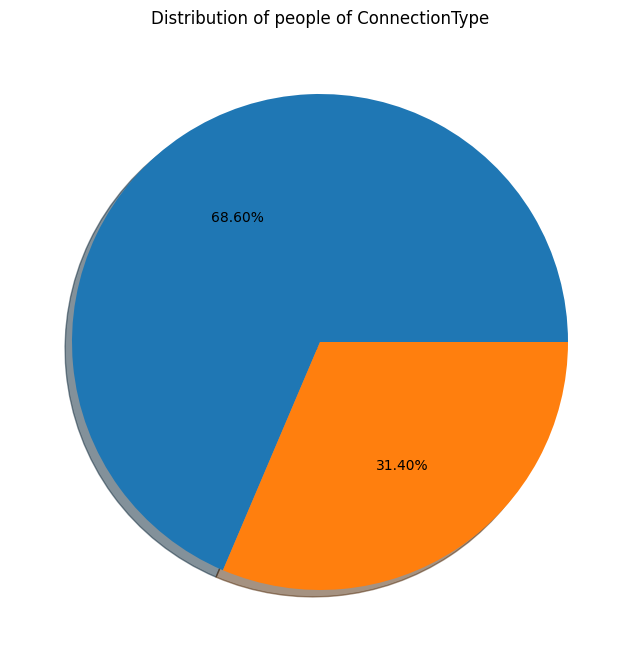

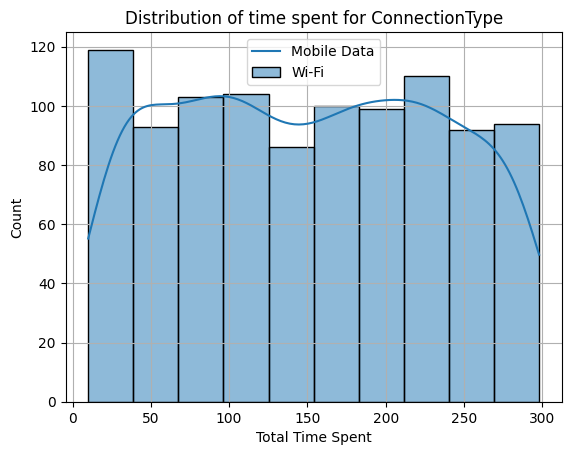

Total Total Time Spent by different groups of ConnectionType
ConnectionType
Mobile Data    106247
Wi-Fi           45159
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


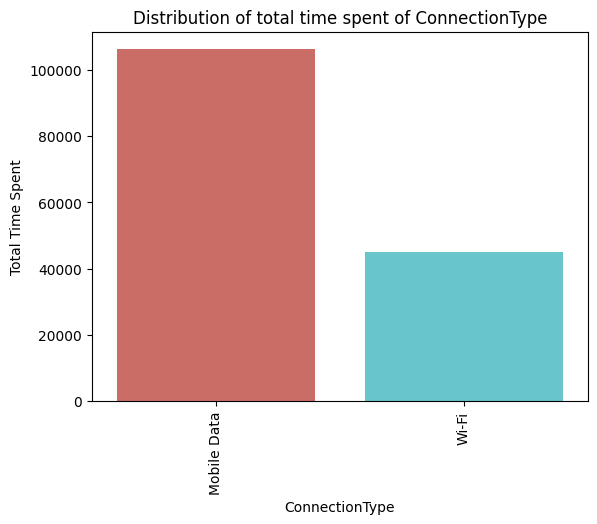

Average Total Time Spent by different groups of ConnectionType
ConnectionType
Mobile Data    154.879009
Wi-Fi          143.818471
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


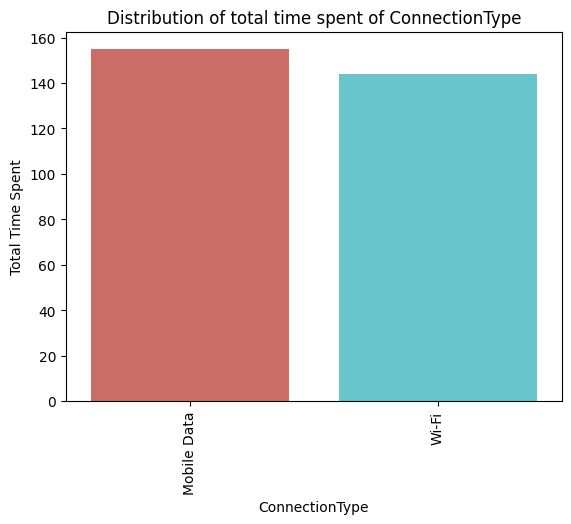

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


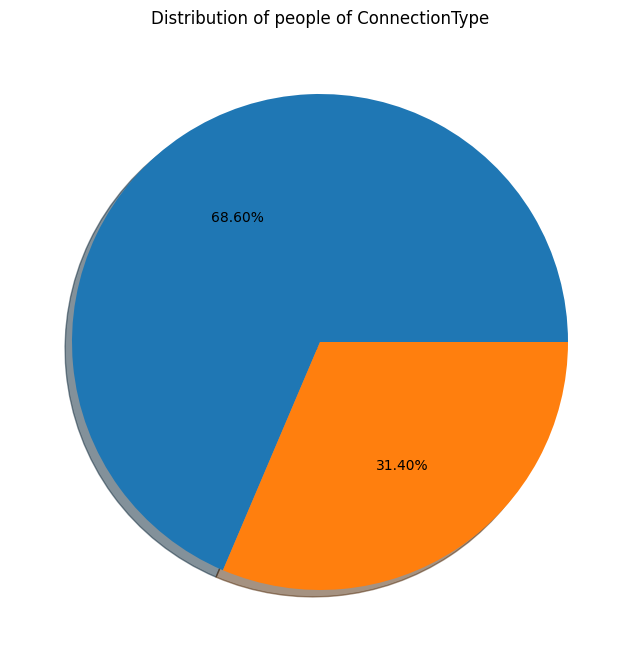

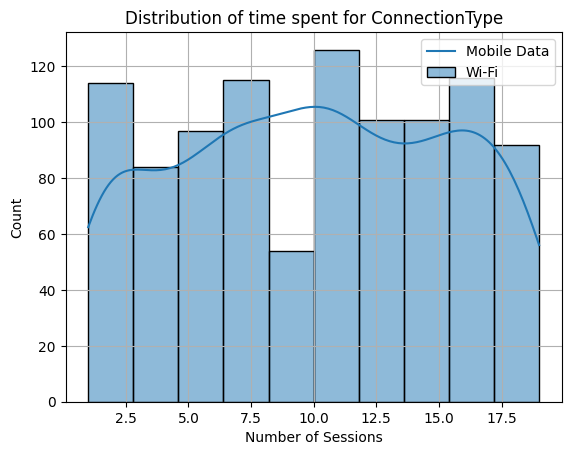

Total Number of Sessions by different groups of ConnectionType
ConnectionType
Mobile Data    6821
Wi-Fi          3192
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


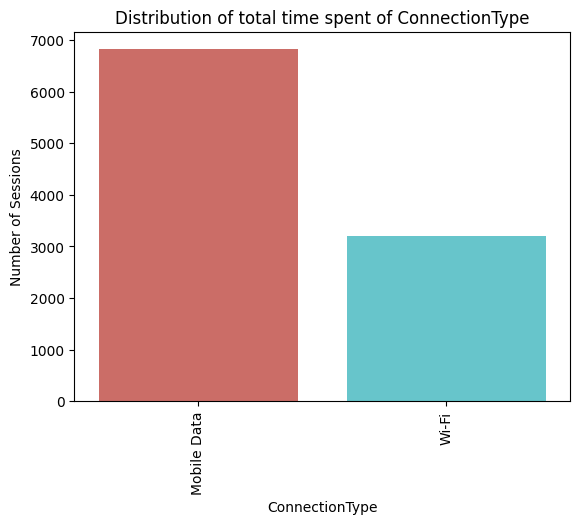

Average Number of Sessions by different groups of ConnectionType
ConnectionType
Mobile Data     9.943149
Wi-Fi          10.165605
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


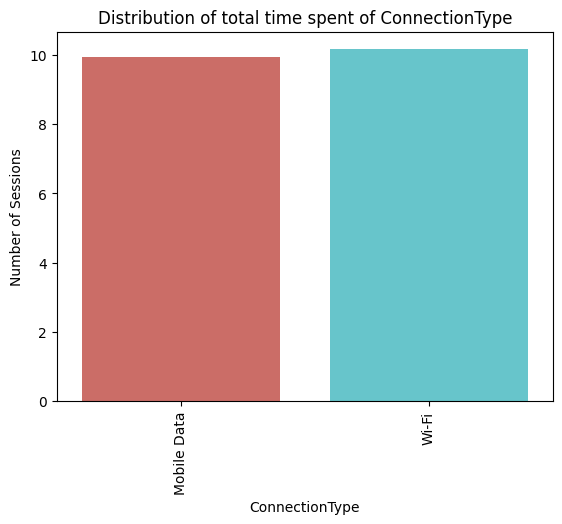

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


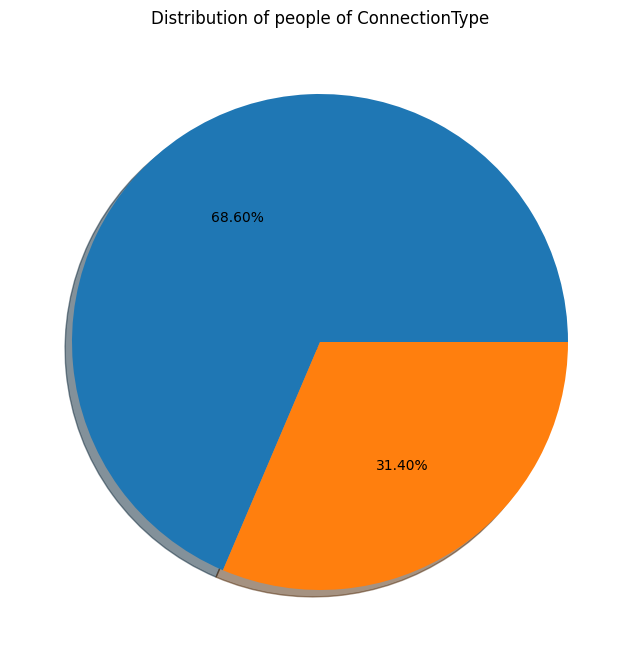

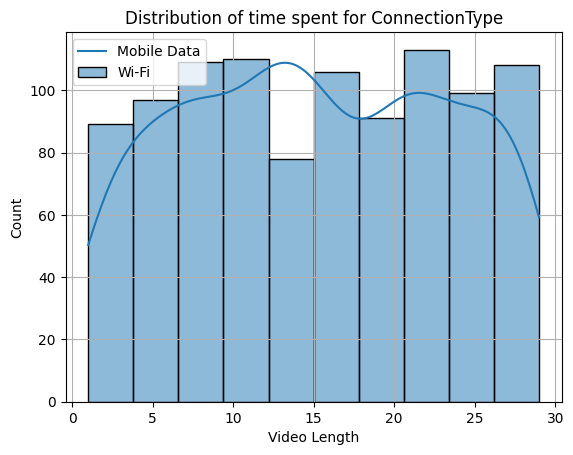

Total Video Length by different groups of ConnectionType
ConnectionType
Mobile Data    10399
Wi-Fi           4815
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


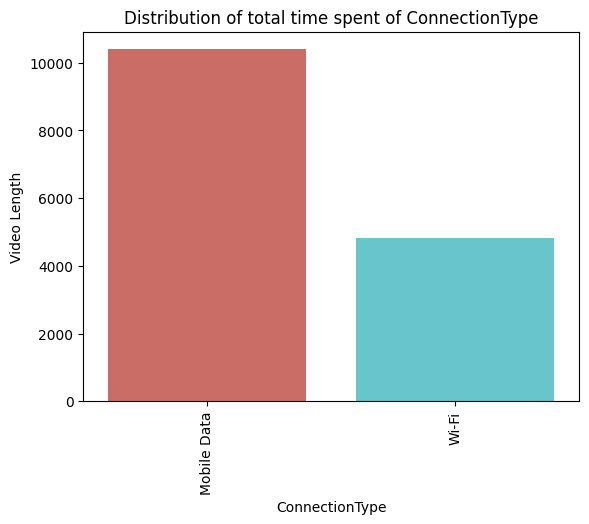

Average Video Length by different groups of ConnectionType
ConnectionType
Mobile Data    15.158892
Wi-Fi          15.334395
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


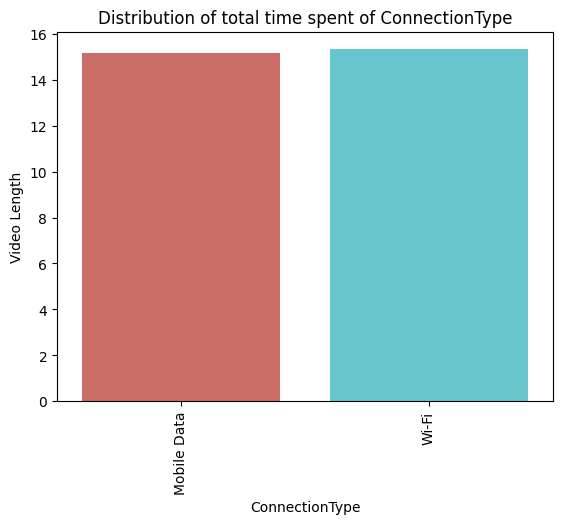

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


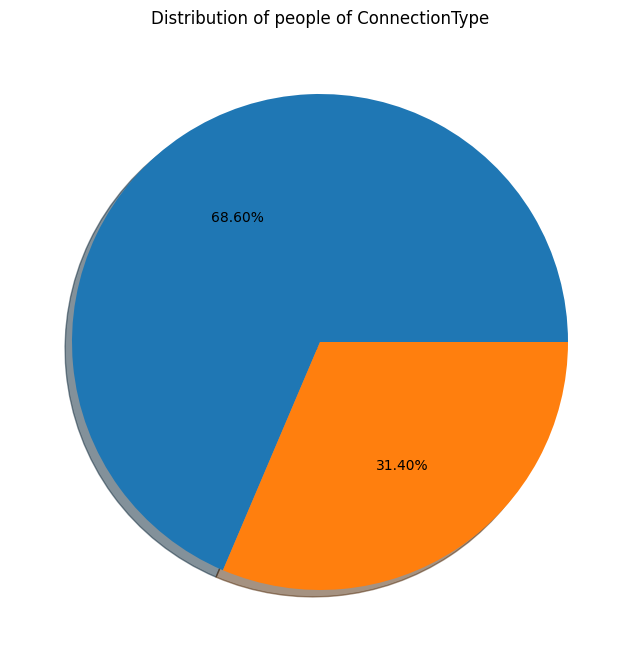

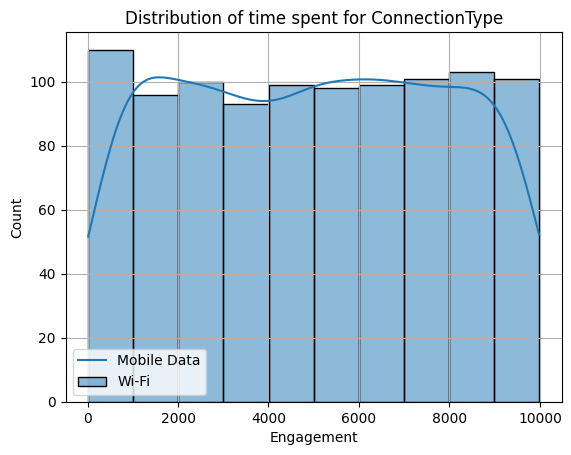

Total Engagement by different groups of ConnectionType
ConnectionType
Mobile Data    3405713
Wi-Fi          1591446
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


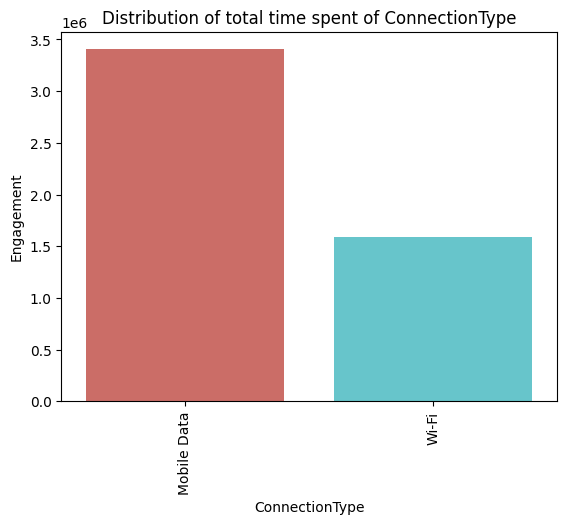

Average Engagement by different groups of ConnectionType
ConnectionType
Mobile Data    4964.596210
Wi-Fi          5068.299363
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


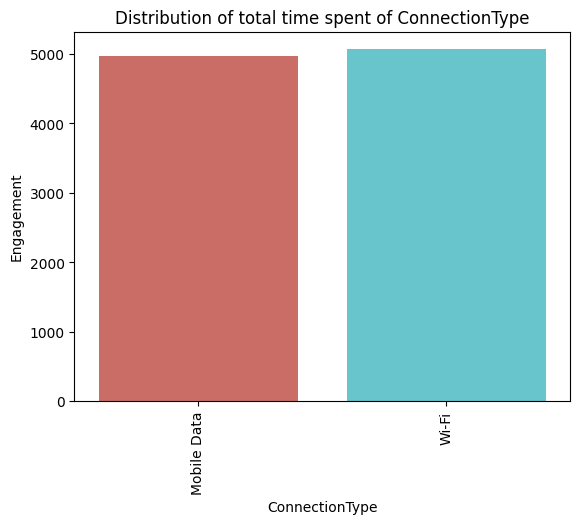

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


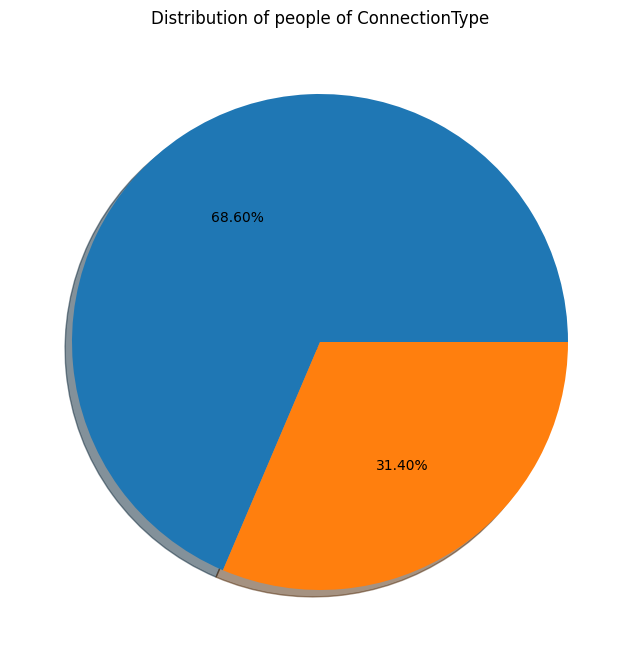

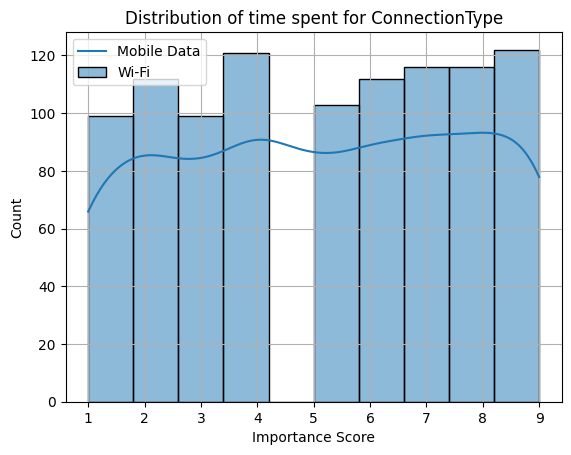

Total Importance Score by different groups of ConnectionType
ConnectionType
Mobile Data    3510
Wi-Fi          1619
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


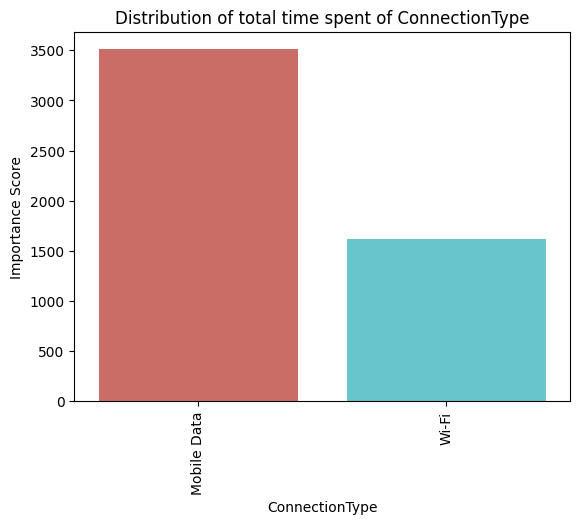

Average Importance Score by different groups of ConnectionType
ConnectionType
Mobile Data    5.116618
Wi-Fi          5.156051
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


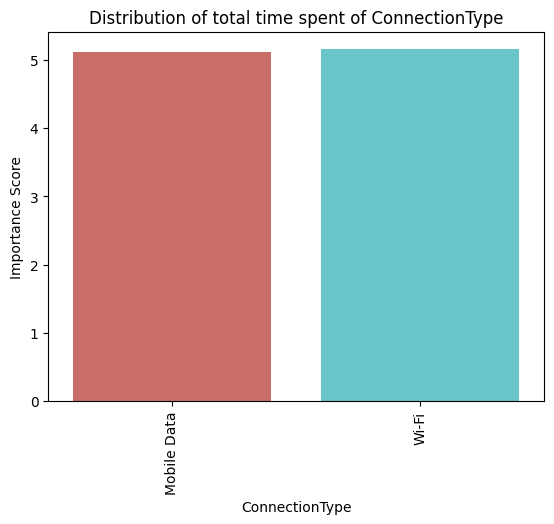

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


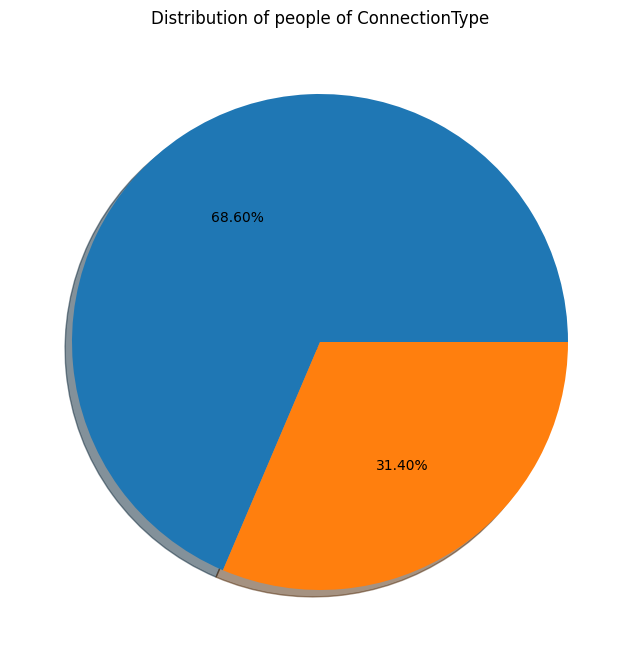

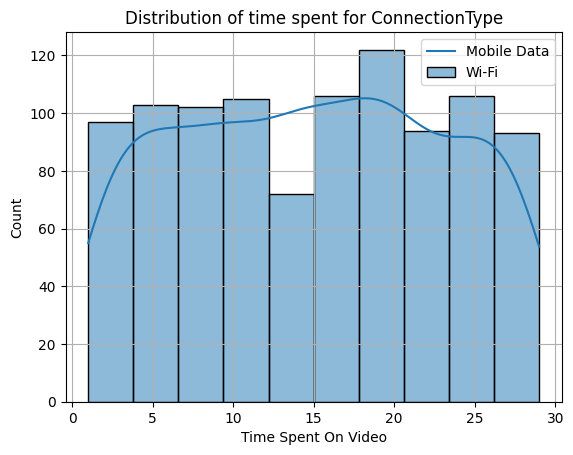

Total Time Spent On Video by different groups of ConnectionType
ConnectionType
Mobile Data    10223
Wi-Fi           4750
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


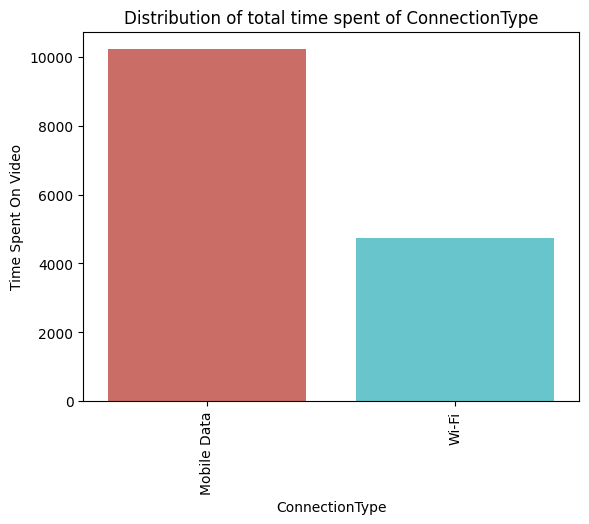

Average Time Spent On Video by different groups of ConnectionType
ConnectionType
Mobile Data    14.902332
Wi-Fi          15.127389
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


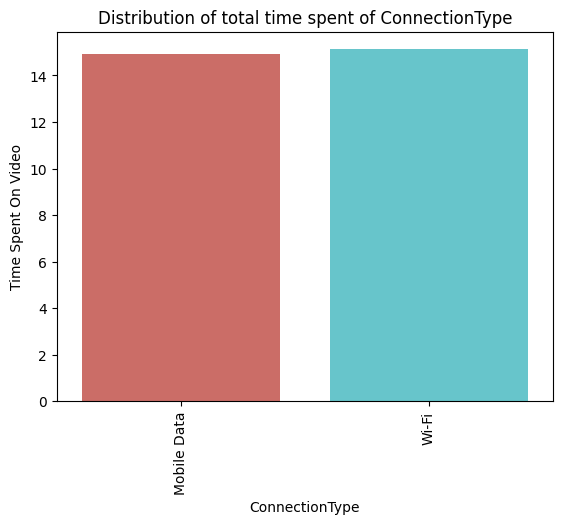

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


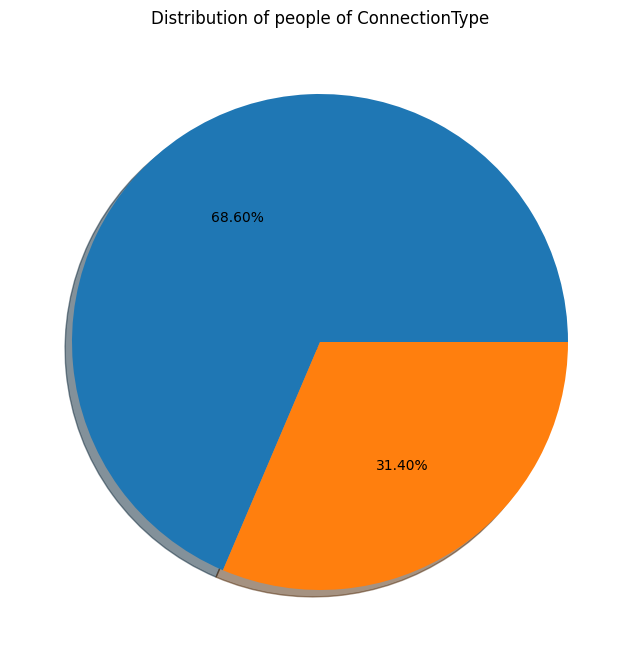

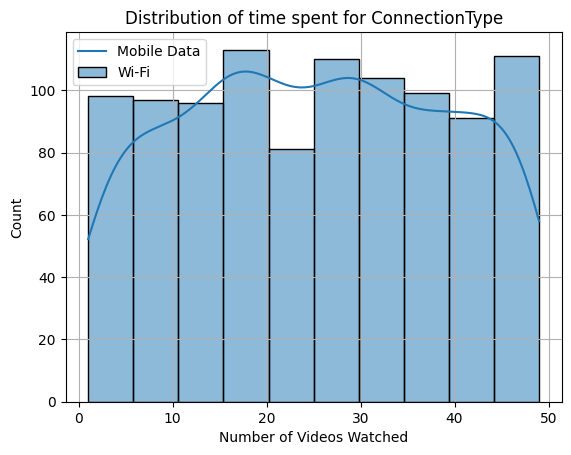

Total Number of Videos Watched by different groups of ConnectionType
ConnectionType
Mobile Data    17381
Wi-Fi           7867
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


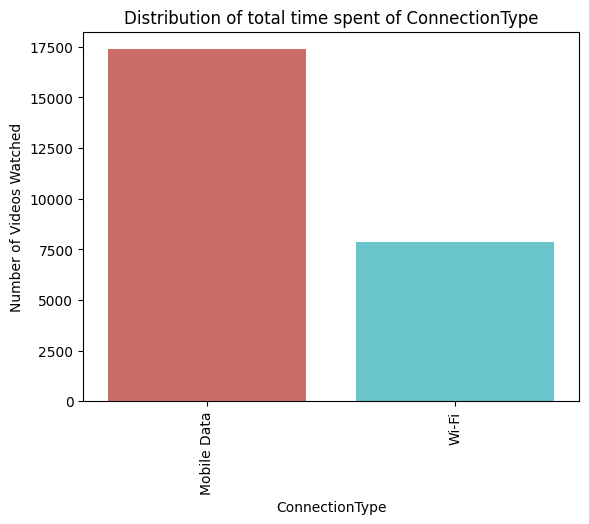

Average Number of Videos Watched by different groups of ConnectionType
ConnectionType
Mobile Data    25.336735
Wi-Fi          25.054140
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


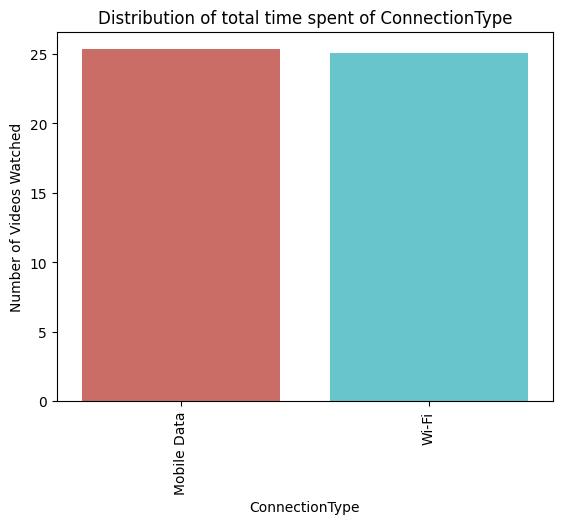

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


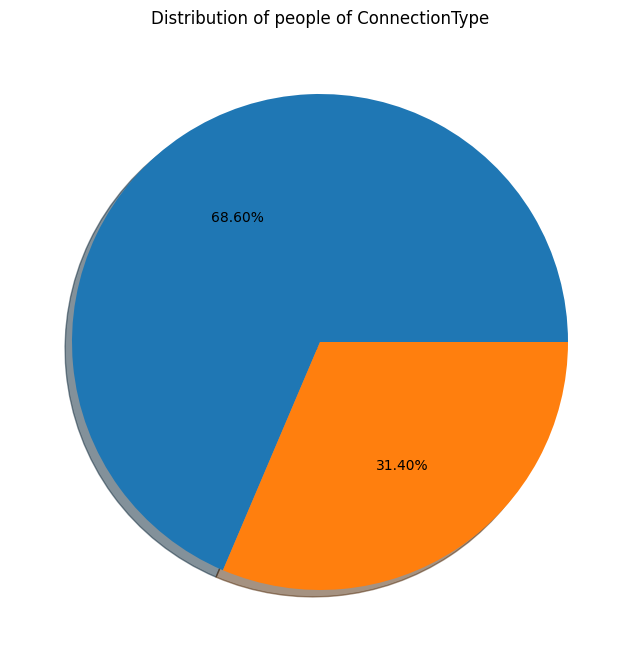

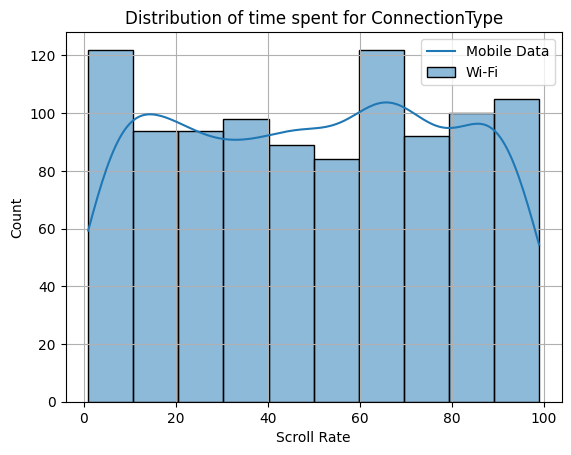

Total Scroll Rate by different groups of ConnectionType
ConnectionType
Mobile Data    34806
Wi-Fi          14968
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


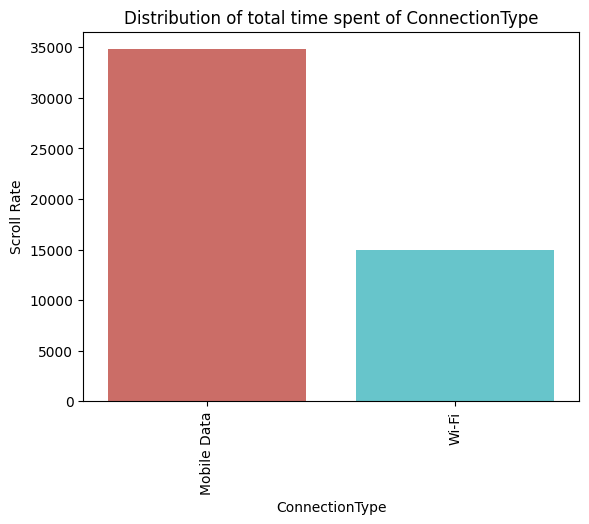

Average Scroll Rate by different groups of ConnectionType
ConnectionType
Mobile Data    50.737609
Wi-Fi          47.668790
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


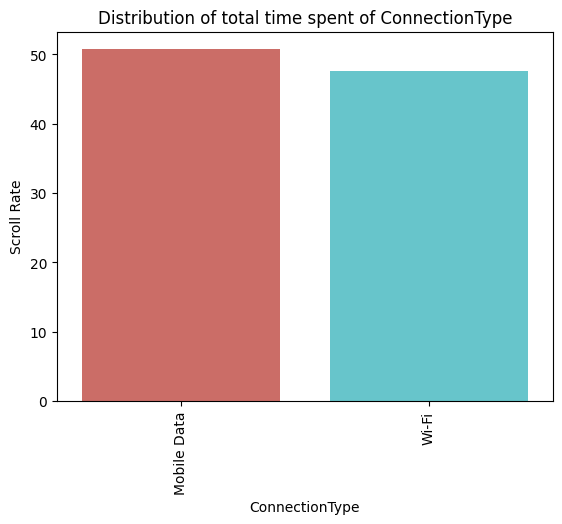

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


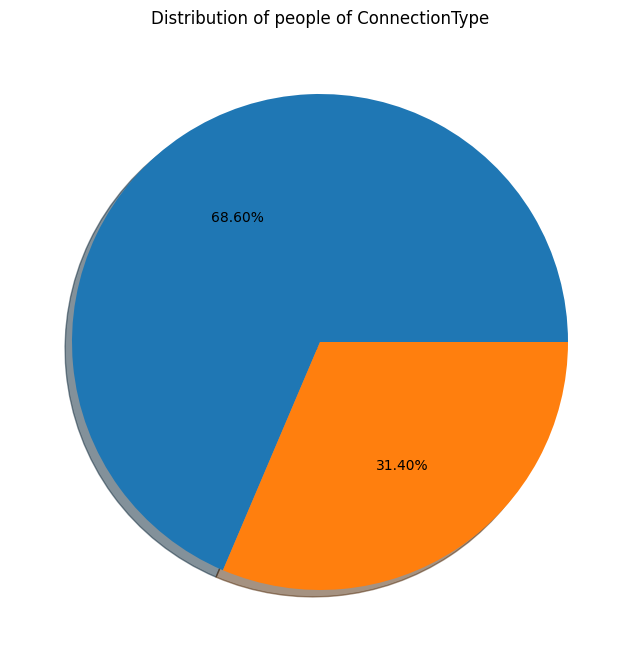

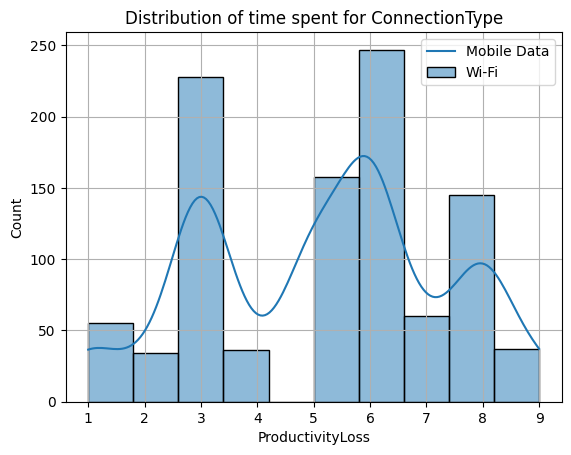

Total ProductivityLoss by different groups of ConnectionType
ConnectionType
Mobile Data    3502
Wi-Fi          1634
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


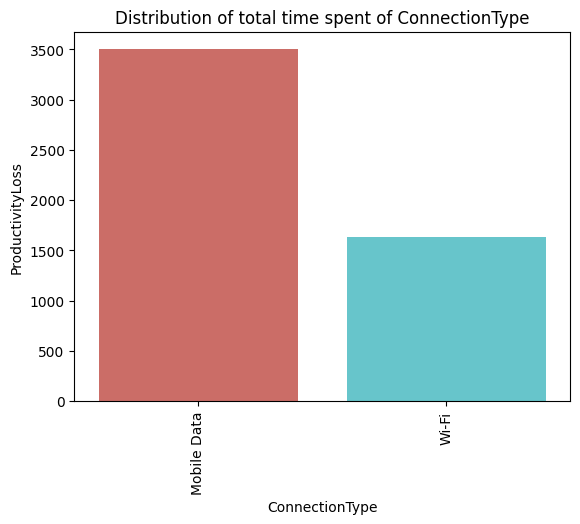

Average ProductivityLoss by different groups of ConnectionType
ConnectionType
Mobile Data    5.104956
Wi-Fi          5.203822
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


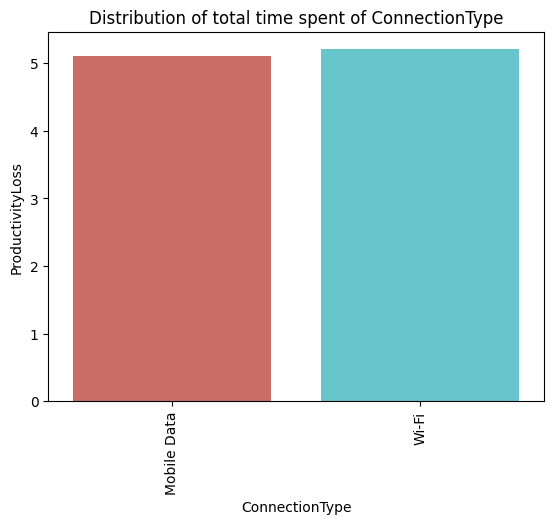

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


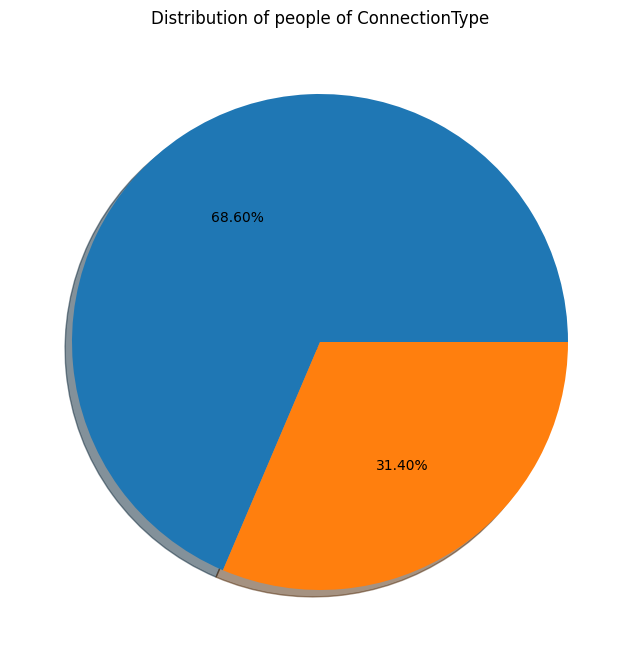

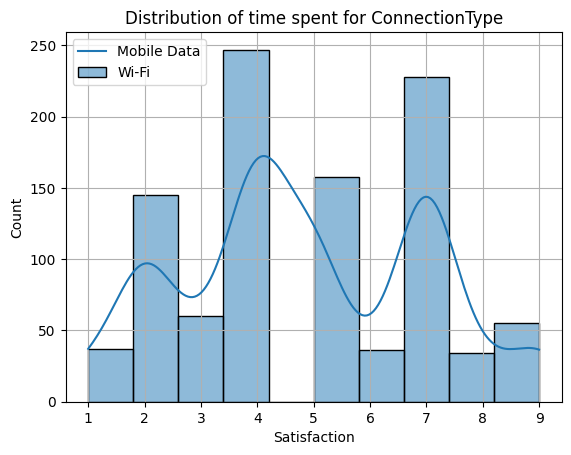

Total Satisfaction by different groups of ConnectionType
ConnectionType
Mobile Data    3358
Wi-Fi          1506
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


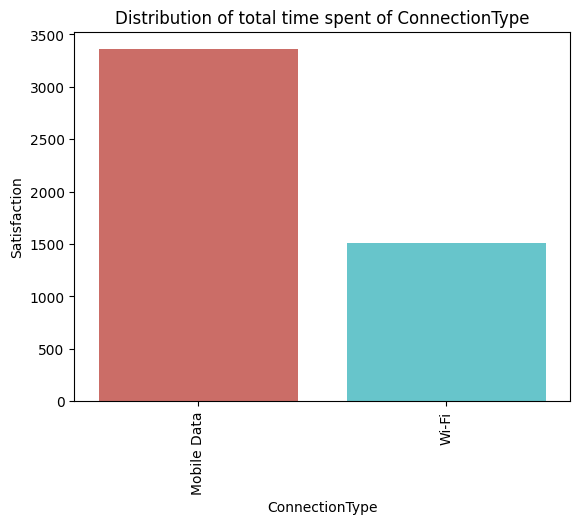

Average Satisfaction by different groups of ConnectionType
ConnectionType
Mobile Data    4.895044
Wi-Fi          4.796178
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


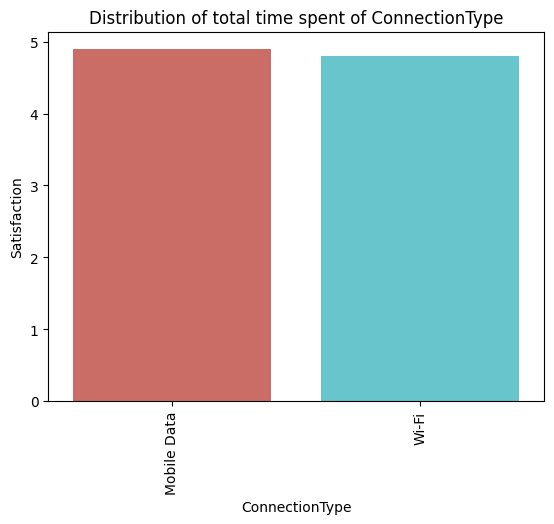

In [ ]:
for i in obj_col:
    for j in num_col:
        try:
            label.analyse_the_plot(modified_data, i, j)
        except Exception as e:
            print(f"Error processing {i} and {j}: {e}")

In [ ]:
#list of all numeric data type of the modified dataframe
numeric_col=modified_data.select_dtypes(include=['int','float']).drop(columns=['UserID','Video ID'],axis=1).columns.to_list()
numeric_col

['Age',
 'Income',
 'Total Time Spent',
 'Number of Sessions',
 'Video Length',
 'Engagement',
 'Importance Score',
 'Time Spent On Video',
 'Number of Videos Watched',
 'Scroll Rate',
 'ProductivityLoss',
 'Satisfaction',
 'Self Control',
 'Addiction Level']

In [ ]:
updated_data=modified_data.drop(columns=['UserID','Video ID'],axis=1)
updated_data.head()


,Age,Gender,Location,Income,Debt,Owns Property,Profession,Demographics,Platform,Total Time Spent,...,ProductivityLoss,Satisfaction,Watch Reason,DeviceType,OS,Watch Time,Self Control,Addiction Level,CurrentActivity,ConnectionType
0,56,Male,Pakistan,82812,True,True,Engineer,Rural,Instagram,80,...,3,7,Procrastination,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
1,46,Female,Mexico,27999,False,True,Artist,Urban,Instagram,228,...,5,5,Habit,Computer,Android,5:00 PM,7,3,At school,Wi-Fi
2,32,Female,United States,42436,False,True,Engineer,Rural,Facebook,30,...,6,4,Entertainment,Tablet,Android,2:00 PM,8,2,At home,Mobile Data
3,60,Male,Barzil,62963,True,False,Waiting staff,Rural,YouTube,101,...,3,7,Habit,Smartphone,Android,9:00 PM,5,5,Commuting,Mobile Data
4,25,Male,Pakistan,22096,False,True,Manager,Urban,TikTok,136,...,8,2,Boredom,Smartphone,iOS,8:00 AM,10,0,At home,Mobile Data


In [ ]:
class stats():
    def __init__(self):
        pass
    
    def statistic_numeric(self,df,col):
        self.df=df
        self.col=col
        
        logging.info('detailed analysis of the numeric data-type')
        
        print(f'{self.col}:')
        
        q3=self.df[self.col].quantile(0.75)
        q1=self.df[self.col].quantile(0.25)
        iqr=q3-q1
        lower_bound=q1-iqr
        upper_bound=q3+iqr
        print(f'lower bound of the {self.col}:{lower_bound}')
        print(f'upper bound of the {self.col}:{upper_bound}')
        
        
        
        print(f'mean of {self.col}={self.df[self.col].mean()}')
        print(f'minimum of {self.col}={self.df[self.col].min()}')
        print(f'25 percentile of {self.col}={q1}')
        print(f'median of {self.col}={self.df[self.col].median()}')
        print(f'75 percentile of {self.col}={q3}')
        print(f'maximum of {self.col}={self.df[self.col].max()}')
        print(f'variance of {self.col}={self.df[self.col].var()}')
        print(f'standardisation of {self.col}={self.df[self.col].std()}')
        
        sns.kdeplot(self.df[self.col],fill=True)
        plt.title(f'Distribution of {self.col}')
        plt.show()
        
        sns.boxplot(self.df[self.col])
        plt.title(f'Detection of outliers of {self.col}')
        plt.show()
        
        self.df=self.df[(self.df[self.col]<=upper_bound) & (self.df[self.col]>=lower_bound)]

In [ ]:
s=stats()

Age:
lower bound of the Age:6.0
upper bound of the Age:75.0
mean of Age=40.986
minimum of Age=18
25 percentile of Age=29.0
median of Age=42.0
75 percentile of Age=52.0
maximum of Age=64
variance of Age=182.191995995996
standardisation of Age=13.497851532595696


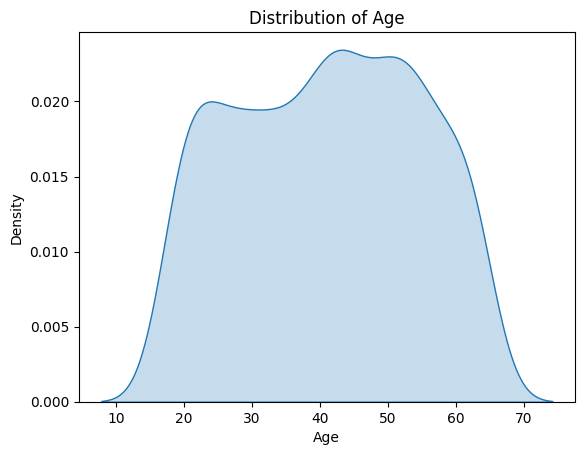

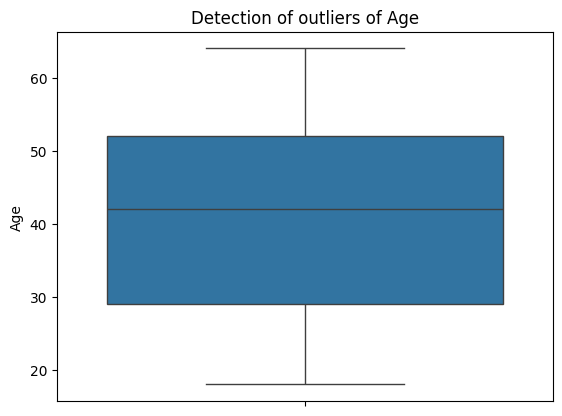

Income:
lower bound of the Income:-2441.75
upper bound of the Income:120909.25
mean of Income=59524.213
minimum of Income=20138
25 percentile of Income=38675.25
median of Income=58805.0
75 percentile of Income=79792.25
maximum of Income=99676
variance of Income=563407804.0276586
standardisation of Income=23736.212925141586


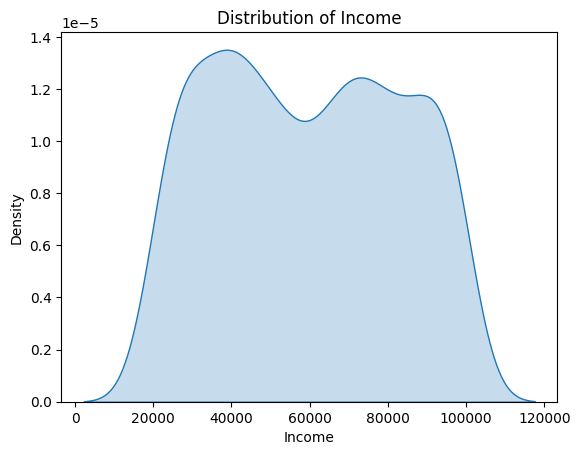

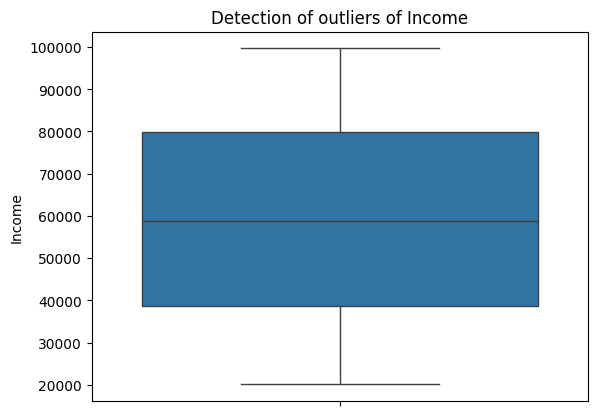

Total Time Spent:
lower bound of the Total Time Spent:-67.0
upper bound of the Total Time Spent:368.0
mean of Total Time Spent=151.406
minimum of Total Time Spent=10
25 percentile of Total Time Spent=78.0
median of Total Time Spent=152.0
75 percentile of Total Time Spent=223.0
maximum of Total Time Spent=298
variance of Total Time Spent=7048.045209209209
standardisation of Total Time Spent=83.95263670194765


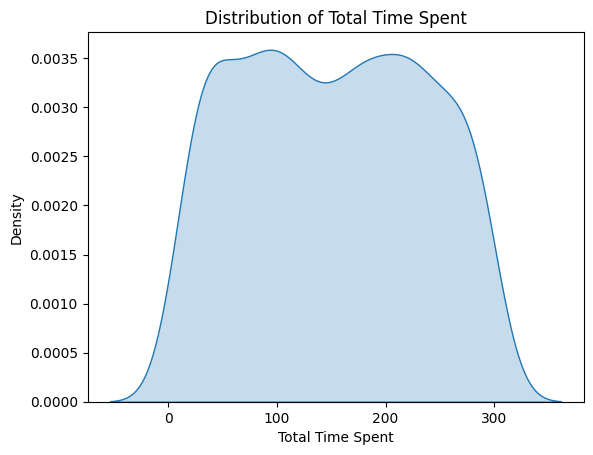

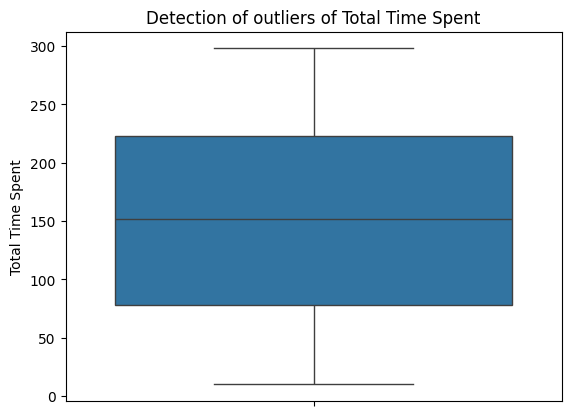

Number of Sessions:
lower bound of the Number of Sessions:-3.0
upper bound of the Number of Sessions:24.0
mean of Number of Sessions=10.013
minimum of Number of Sessions=1
25 percentile of Number of Sessions=6.0
median of Number of Sessions=10.0
75 percentile of Number of Sessions=15.0
maximum of Number of Sessions=19
variance of Number of Sessions=28.947778778778776
standardisation of Number of Sessions=5.380314003734241


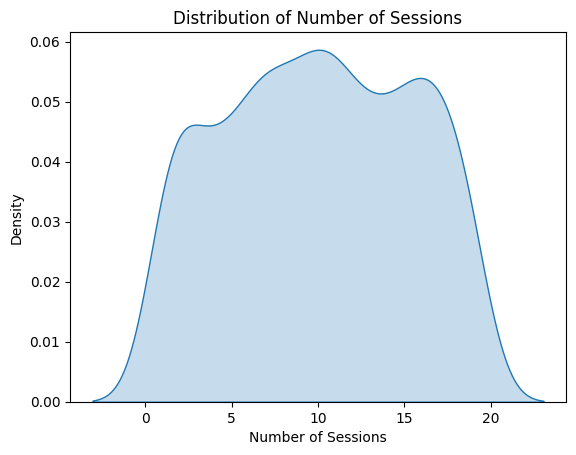

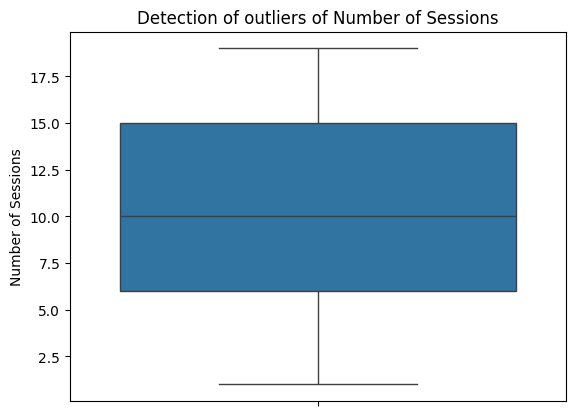

Video Length:
lower bound of the Video Length:-6.0
upper bound of the Video Length:36.0
mean of Video Length=15.214
minimum of Video Length=1
25 percentile of Video Length=8.0
median of Video Length=15.0
75 percentile of Video Length=22.0
maximum of Video Length=29
variance of Video Length=67.64985385385386
standardisation of Video Length=8.224953121681233


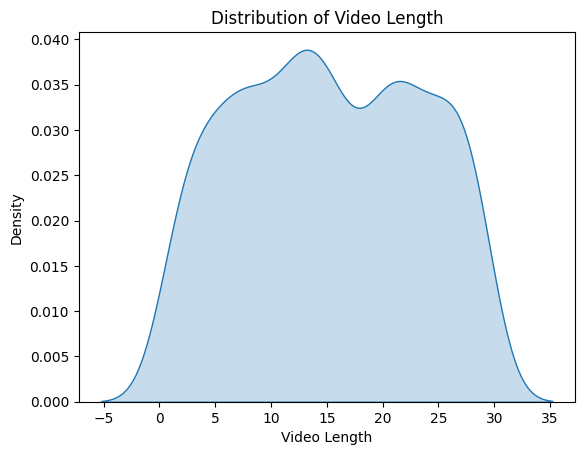

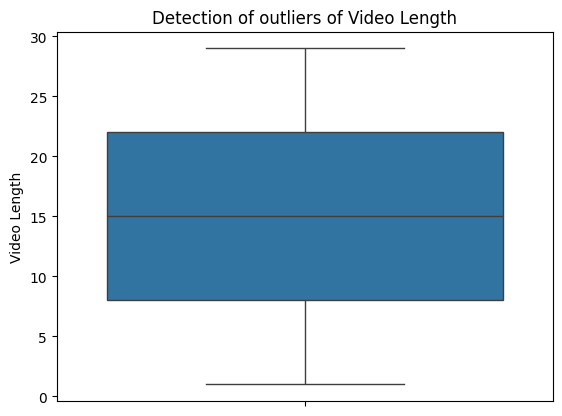

Engagement:
lower bound of the Engagement:-2708.75
upper bound of the Engagement:12664.75
mean of Engagement=4997.159
minimum of Engagement=15
25 percentile of Engagement=2415.75
median of Engagement=5016.0
75 percentile of Engagement=7540.25
maximum of Engagement=9982
variance of Engagement=8468412.540259259
standardisation of Engagement=2910.053700579984


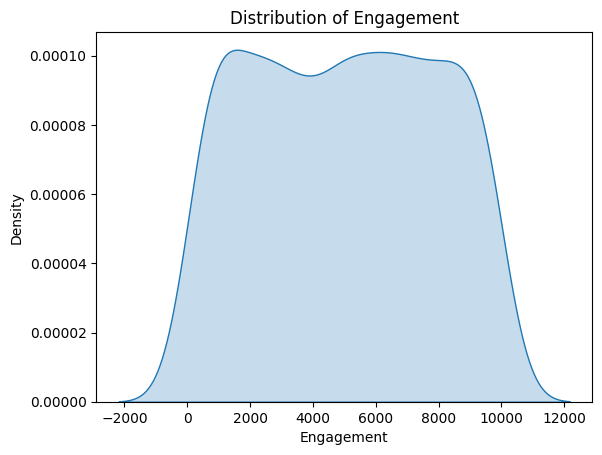

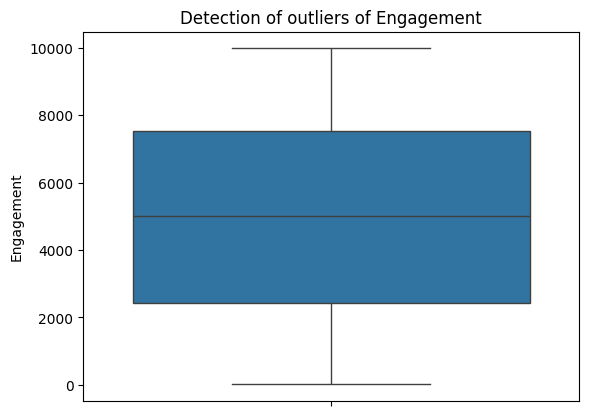

Importance Score:
lower bound of the Importance Score:-1.0
upper bound of the Importance Score:11.0
mean of Importance Score=5.129
minimum of Importance Score=1
25 percentile of Importance Score=3.0
median of Importance Score=5.0
75 percentile of Importance Score=7.0
maximum of Importance Score=9
variance of Importance Score=6.67103003003003
standardisation of Importance Score=2.5828337209410193


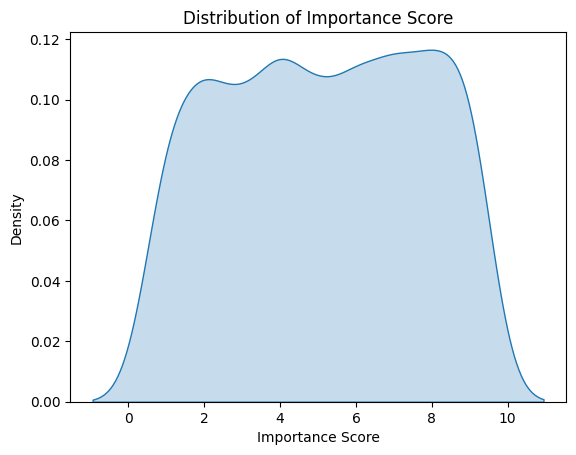

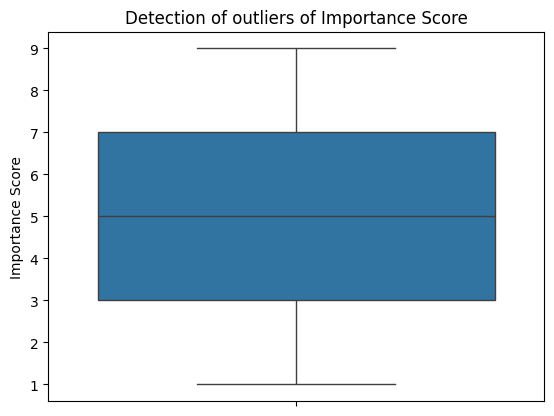

Time Spent On Video:
lower bound of the Time Spent On Video:-6.0
upper bound of the Time Spent On Video:36.0
mean of Time Spent On Video=14.973
minimum of Time Spent On Video=1
25 percentile of Time Spent On Video=8.0
median of Time Spent On Video=15.0
75 percentile of Time Spent On Video=22.0
maximum of Time Spent On Video=29
variance of Time Spent On Video=67.24151251251251
standardisation of Time Spent On Video=8.20009222585408


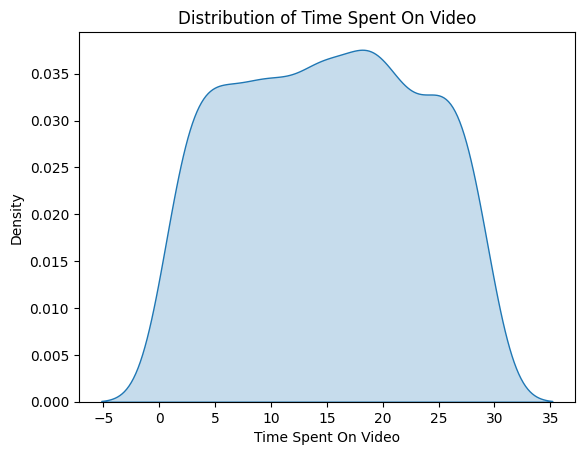

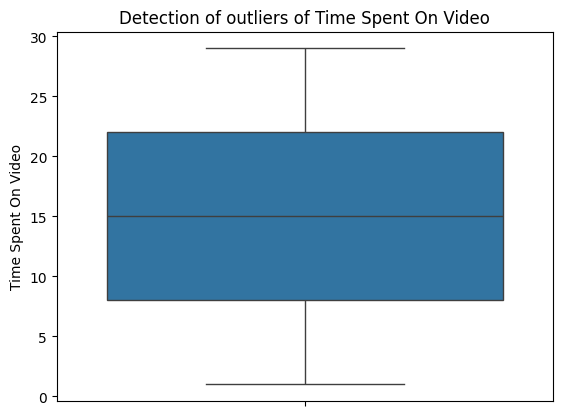

Number of Videos Watched:
lower bound of the Number of Videos Watched:-9.0
upper bound of the Number of Videos Watched:60.0
mean of Number of Videos Watched=25.248
minimum of Number of Videos Watched=1
25 percentile of Number of Videos Watched=14.0
median of Number of Videos Watched=25.0
75 percentile of Number of Videos Watched=37.0
maximum of Number of Videos Watched=49
variance of Number of Videos Watched=196.8173133133133
standardisation of Number of Videos Watched=14.029159394393995


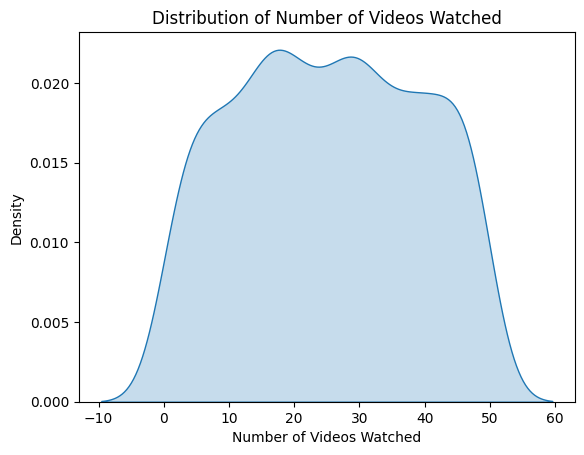

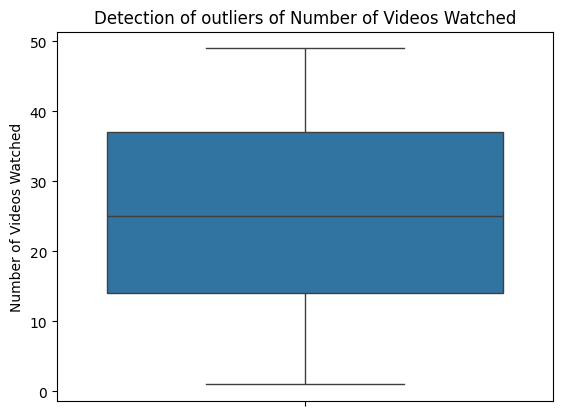

Scroll Rate:
lower bound of the Scroll Rate:-28.0
upper bound of the Scroll Rate:125.0
mean of Scroll Rate=49.774
minimum of Scroll Rate=1
25 percentile of Scroll Rate=23.0
median of Scroll Rate=50.0
75 percentile of Scroll Rate=74.0
maximum of Scroll Rate=99
variance of Scroll Rate=852.5114354354355
standardisation of Scroll Rate=29.197798468984534


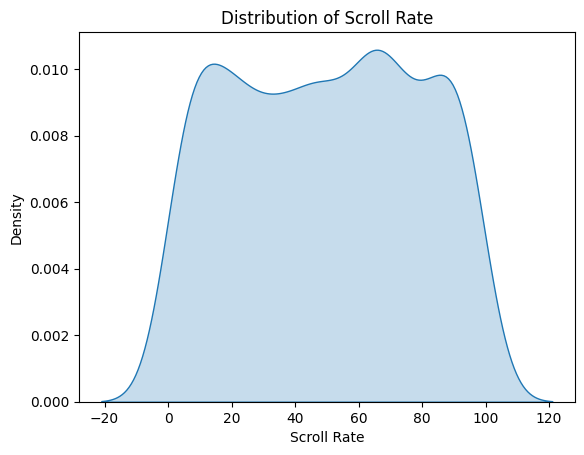

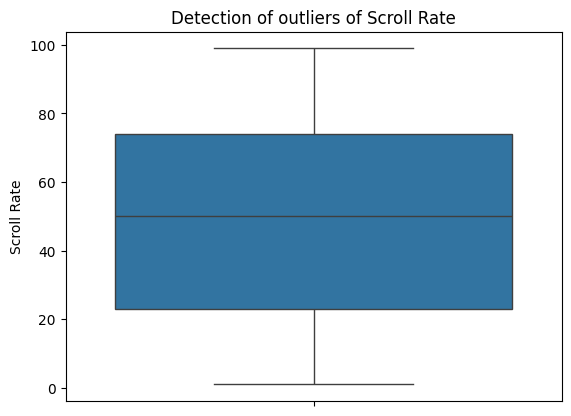

ProductivityLoss:
lower bound of the ProductivityLoss:0.0
upper bound of the ProductivityLoss:9.0
mean of ProductivityLoss=5.136
minimum of ProductivityLoss=1
25 percentile of ProductivityLoss=3.0
median of ProductivityLoss=5.0
75 percentile of ProductivityLoss=6.0
maximum of ProductivityLoss=9
variance of ProductivityLoss=4.504008008008008
standardisation of ProductivityLoss=2.122264829847587


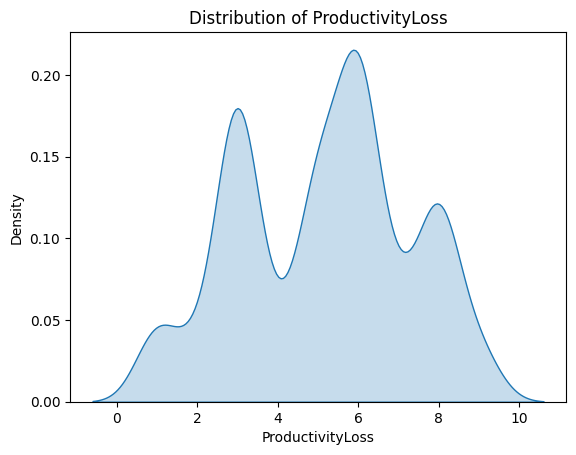

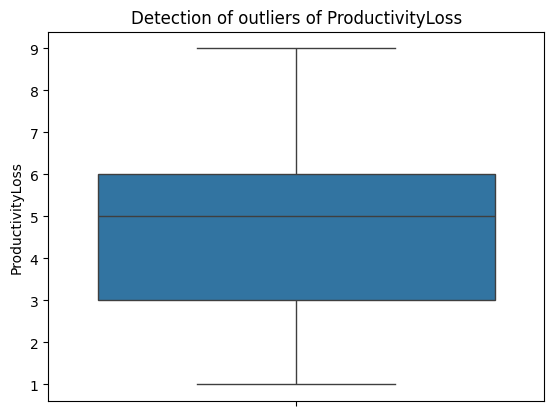

Satisfaction:
lower bound of the Satisfaction:1.0
upper bound of the Satisfaction:10.0
mean of Satisfaction=4.864
minimum of Satisfaction=1
25 percentile of Satisfaction=4.0
median of Satisfaction=5.0
75 percentile of Satisfaction=7.0
maximum of Satisfaction=9
variance of Satisfaction=4.504008008008008
standardisation of Satisfaction=2.122264829847587


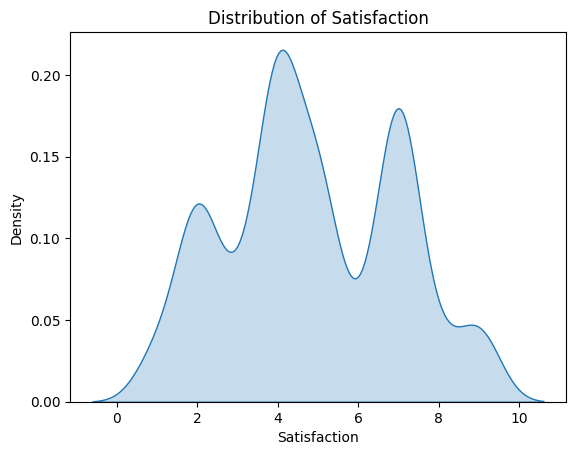

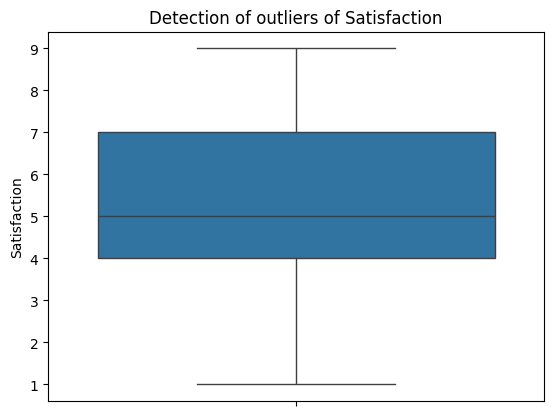

Self Control:
lower bound of the Self Control:2.0
upper bound of the Self Control:11.0
mean of Self Control=7.094
minimum of Self Control=3
25 percentile of Self Control=5.0
median of Self Control=7.0
75 percentile of Self Control=8.0
maximum of Self Control=10
variance of Self Control=4.2374014014014
standardisation of Self Control=2.058494935966907


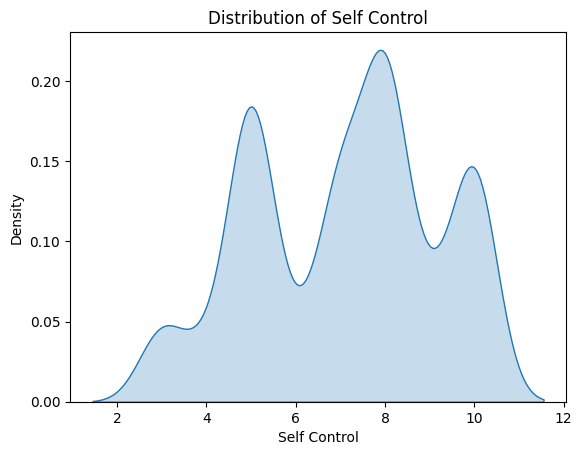

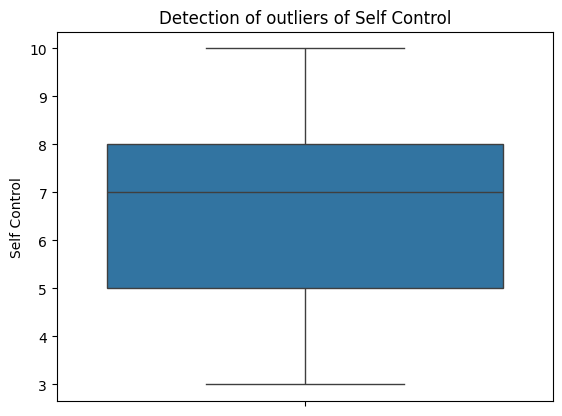

Addiction Level:
lower bound of the Addiction Level:-1.0
upper bound of the Addiction Level:8.0
mean of Addiction Level=2.906
minimum of Addiction Level=0
25 percentile of Addiction Level=2.0
median of Addiction Level=3.0
75 percentile of Addiction Level=5.0
maximum of Addiction Level=7
variance of Addiction Level=4.2374014014014
standardisation of Addiction Level=2.058494935966907


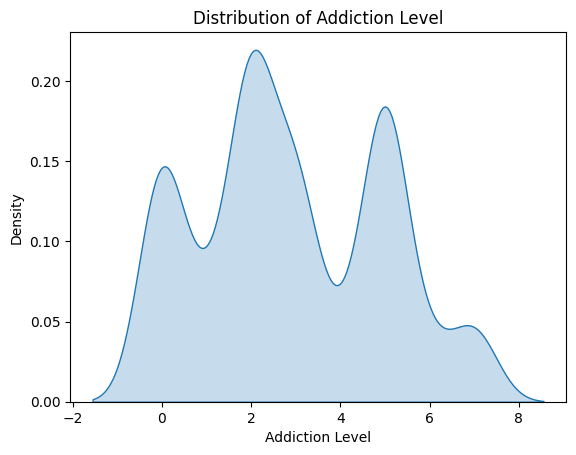

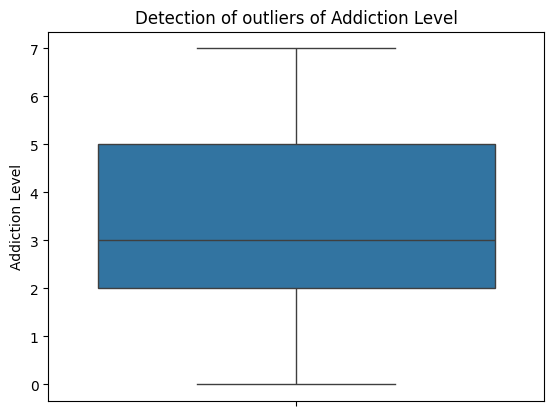

In [ ]:
for i in numeric_col[:]:
        s.statistic_numeric(updated_data,i)

In [ ]:
logging.info('creating the class for the analysis of the data after detecting the outliers')


Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


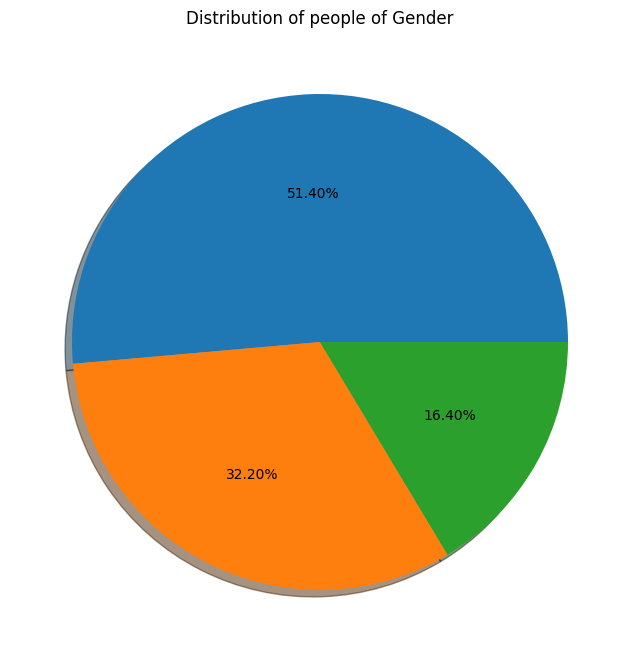

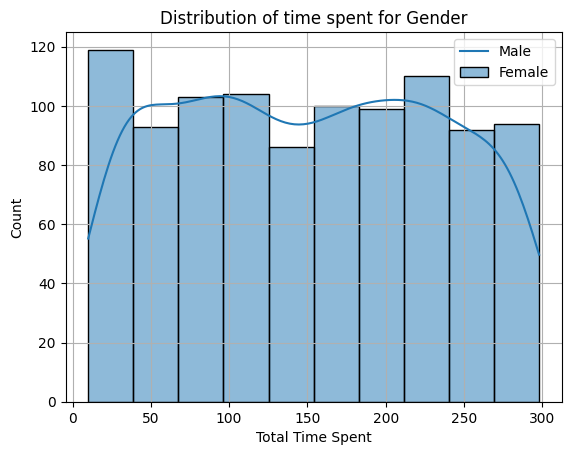

Total Total Time Spent by different groups of Gender
Gender
Female    47813
Male      78120
Other     25473
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


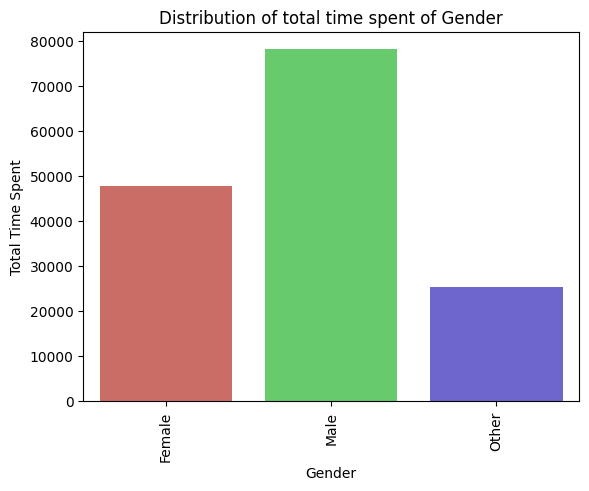

Average Total Time Spent by different groups of Gender
Gender
Female    148.487578
Male      151.984436
Other     155.323171
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


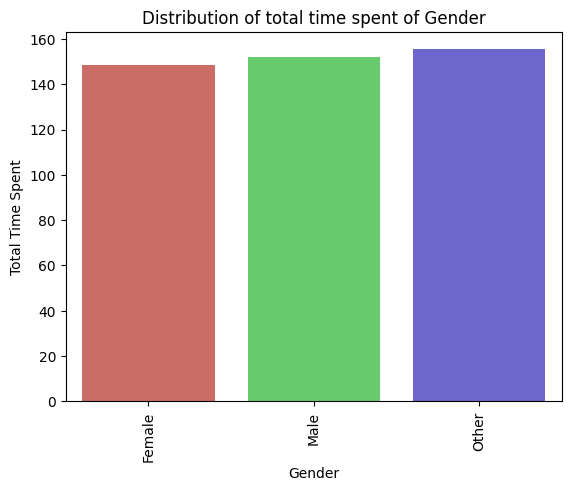

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


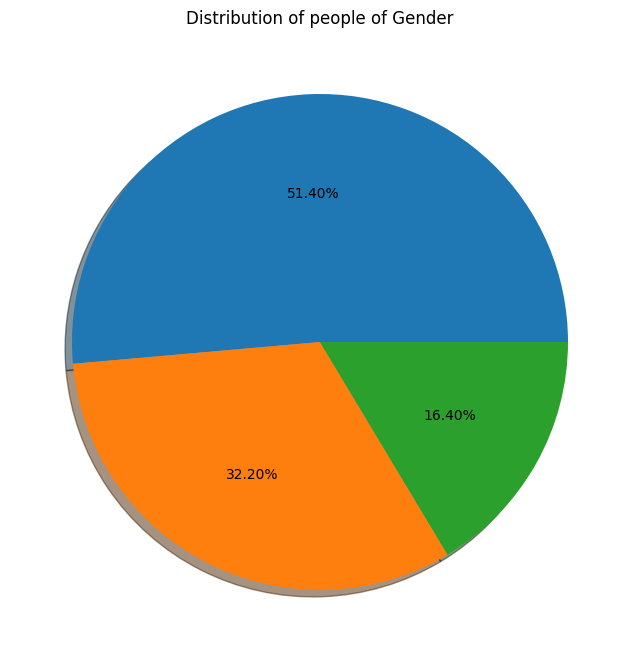

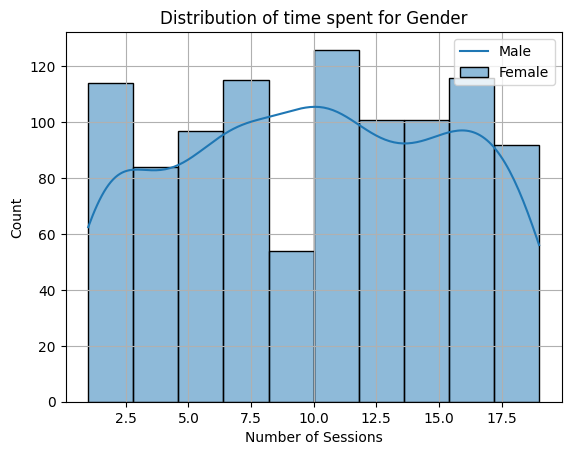

Total Number of Sessions by different groups of Gender
Gender
Female    3373
Male      5025
Other     1615
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


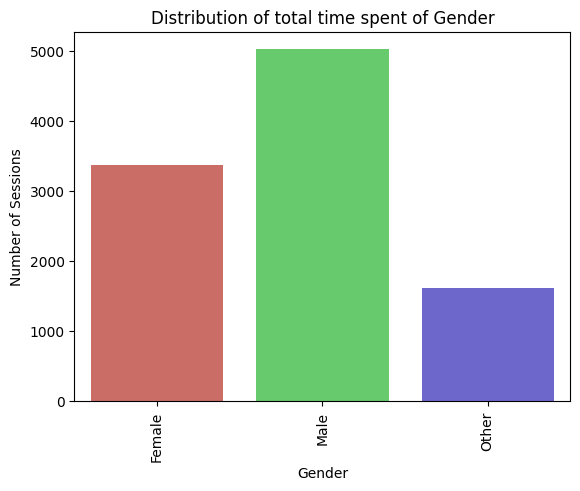

Average Number of Sessions by different groups of Gender
Gender
Female    10.475155
Male       9.776265
Other      9.847561
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


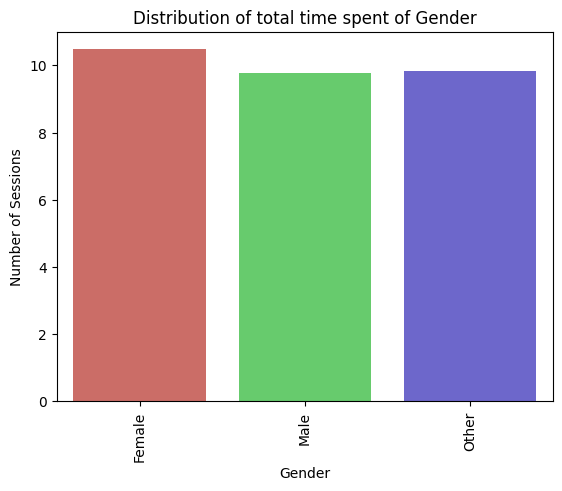

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


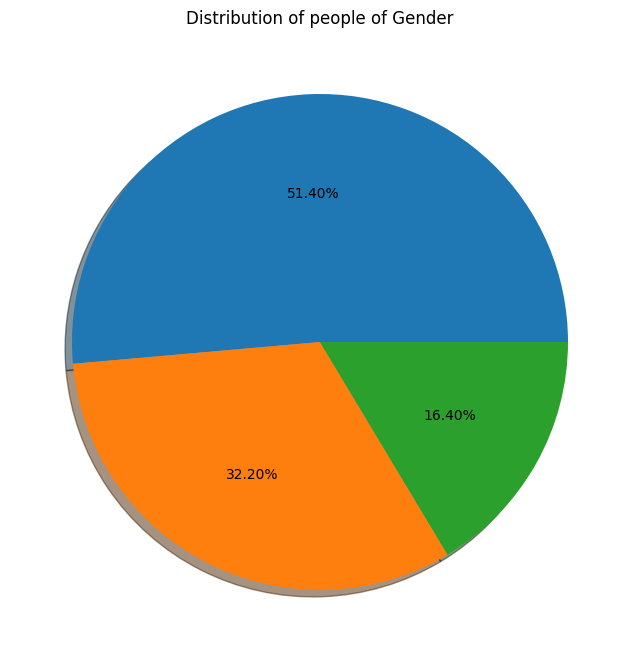

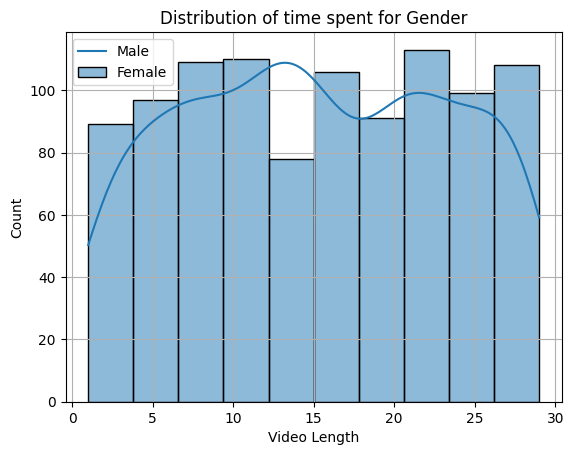

Total Video Length by different groups of Gender
Gender
Female    4638
Male      7951
Other     2625
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


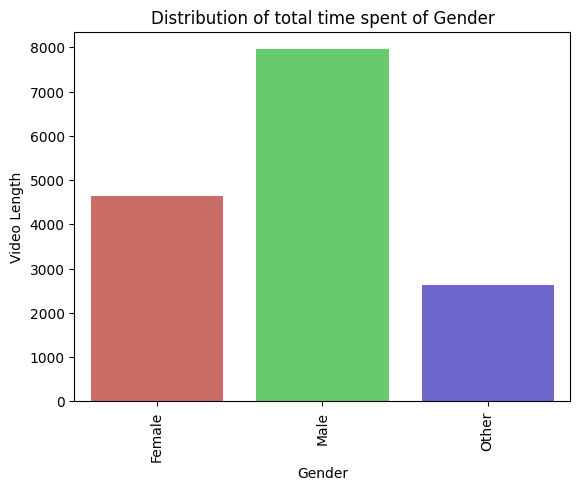

Average Video Length by different groups of Gender
Gender
Female    14.403727
Male      15.468872
Other     16.006098
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


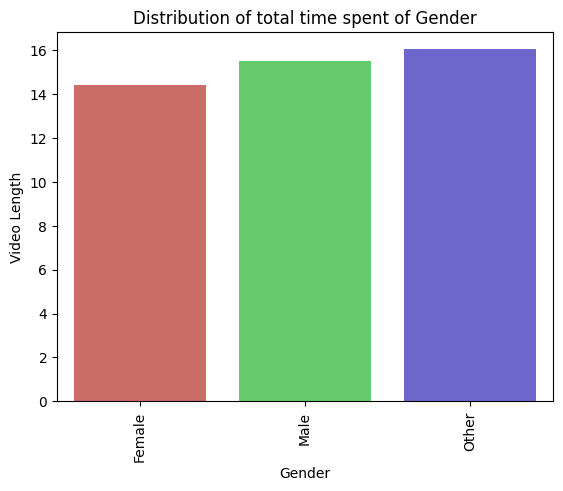

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


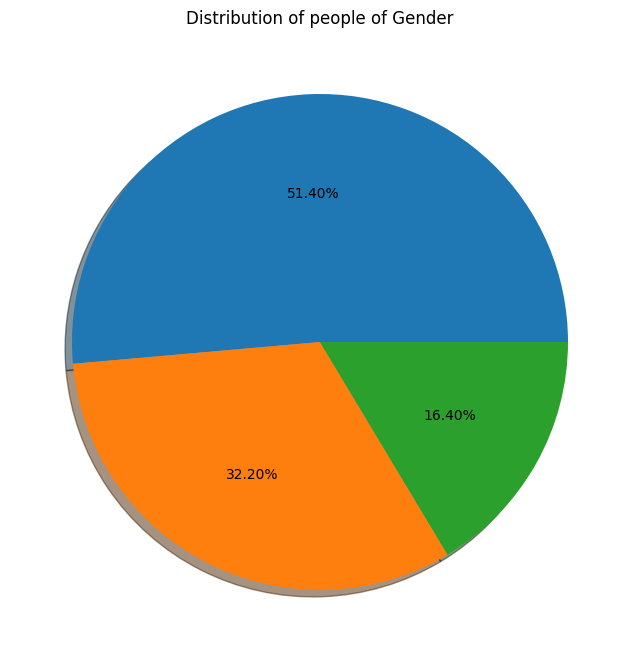

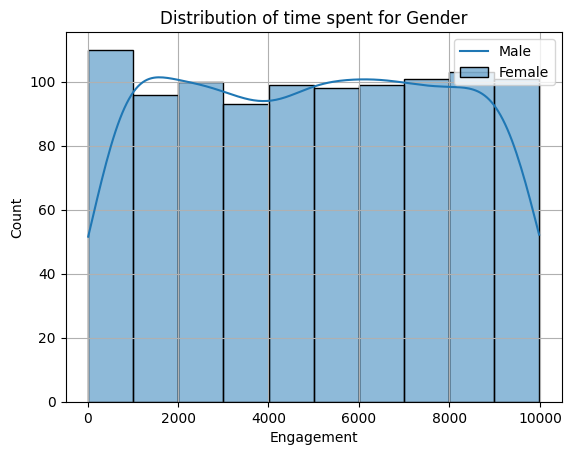

Total Engagement by different groups of Gender
Gender
Female    1556835
Male      2599449
Other      840875
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


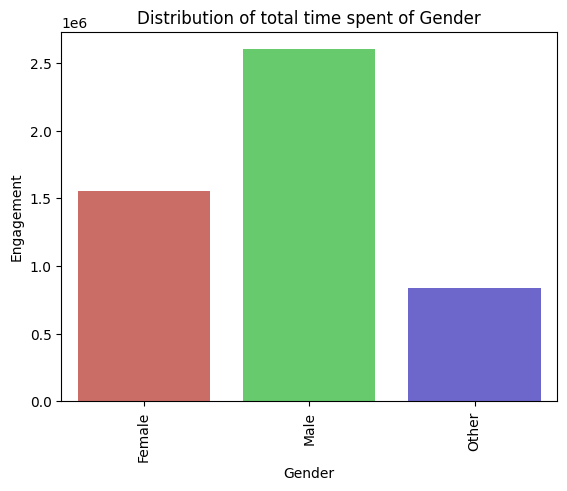

Average Engagement by different groups of Gender
Gender
Female    4834.891304
Male      5057.293774
Other     5127.286585
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


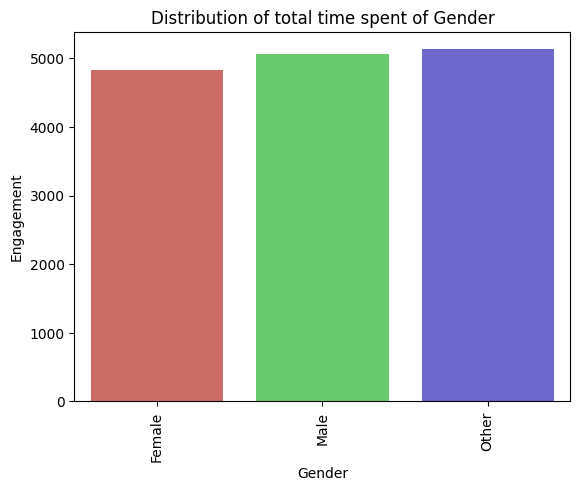

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


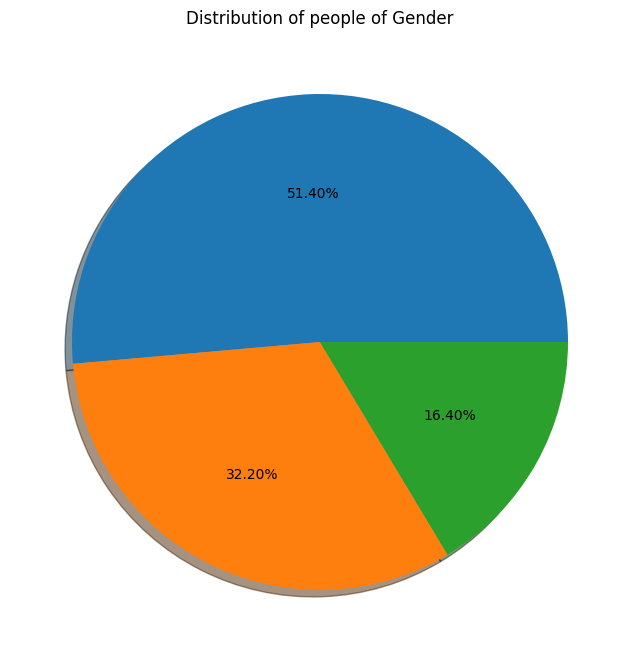

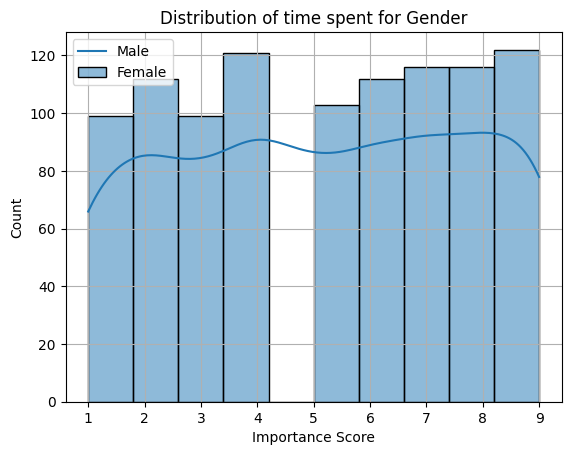

Total Importance Score by different groups of Gender
Gender
Female    1624
Male      2650
Other      855
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


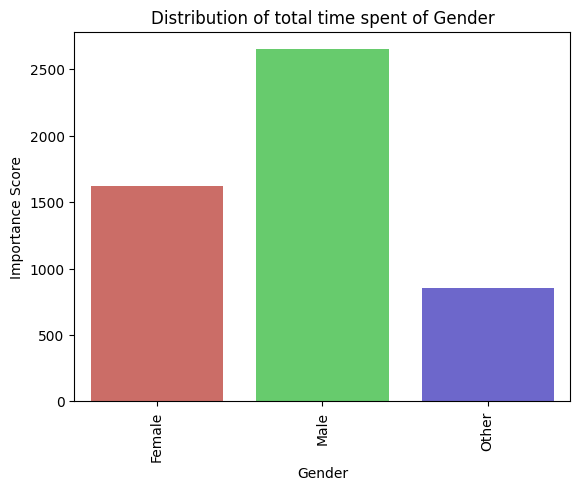

Average Importance Score by different groups of Gender
Gender
Female    5.043478
Male      5.155642
Other     5.213415
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


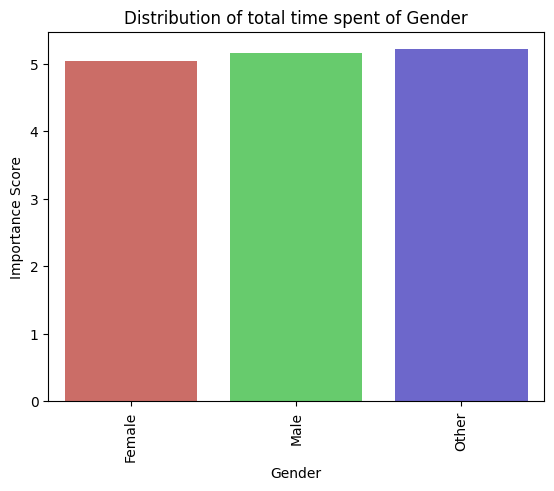

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


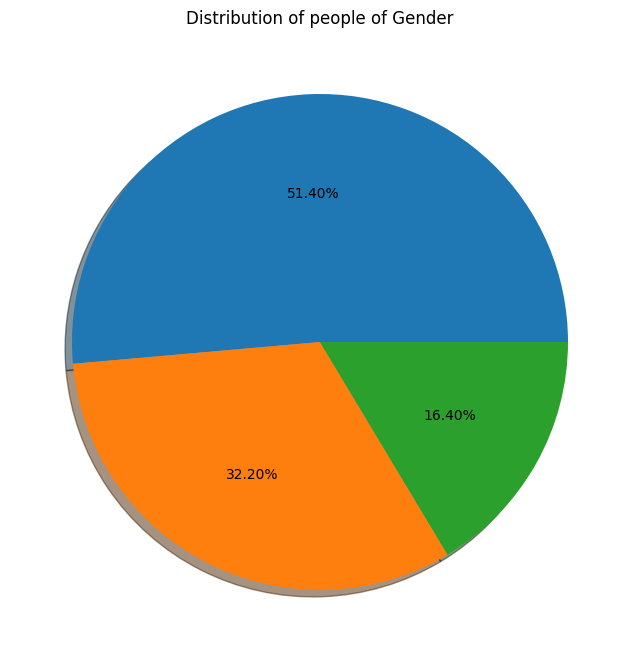

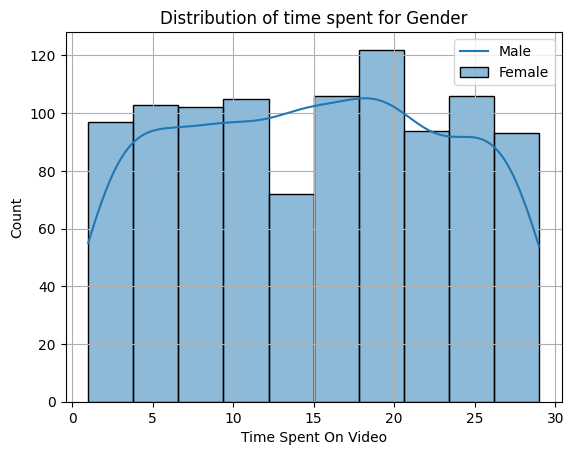

Total Time Spent On Video by different groups of Gender
Gender
Female    4648
Male      7763
Other     2562
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


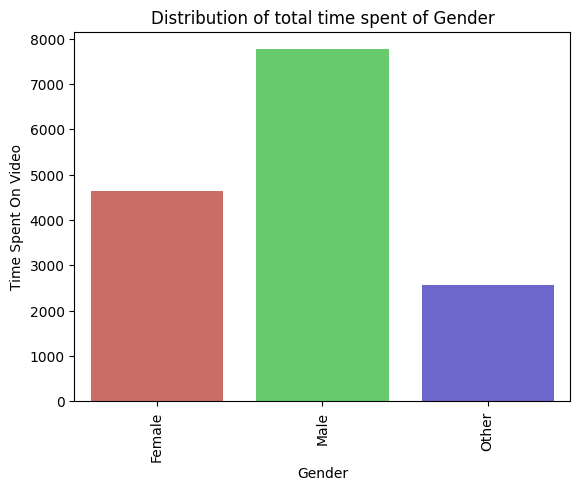

Average Time Spent On Video by different groups of Gender
Gender
Female    14.434783
Male      15.103113
Other     15.621951
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


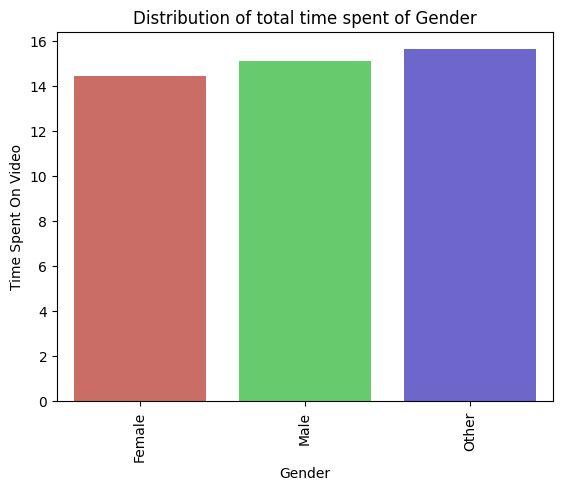

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


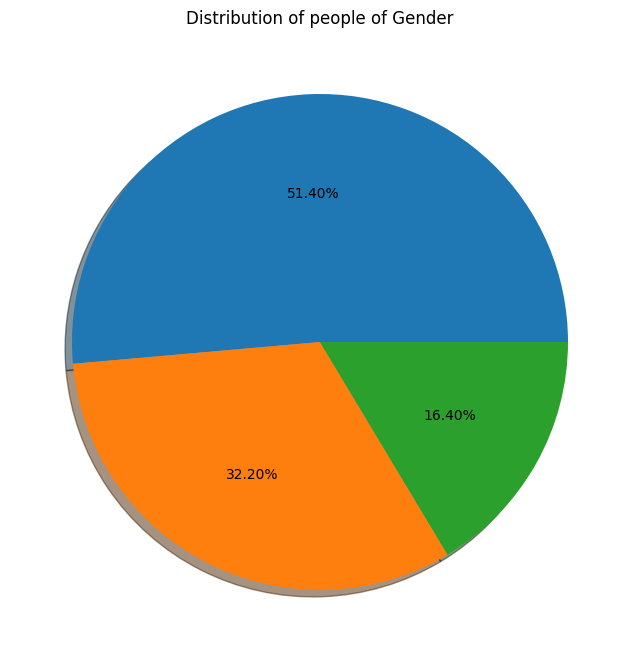

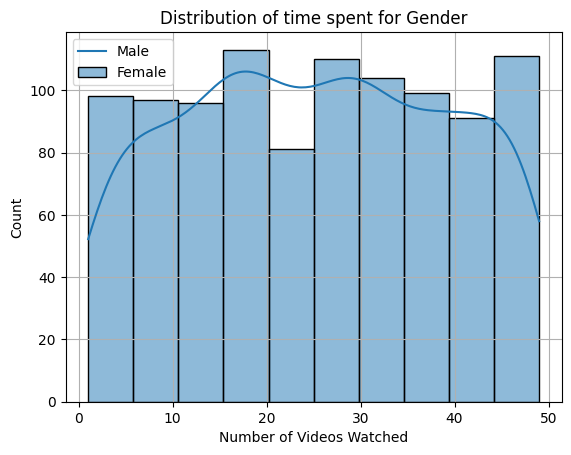

Total Number of Videos Watched by different groups of Gender
Gender
Female     8121
Male      13272
Other      3855
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


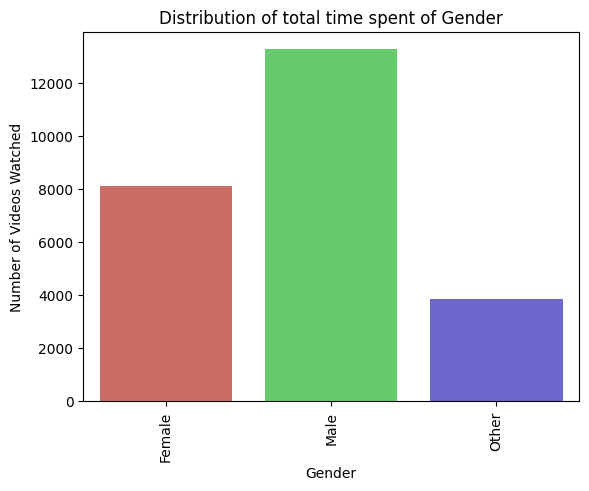

Average Number of Videos Watched by different groups of Gender
Gender
Female    25.220497
Male      25.821012
Other     23.506098
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


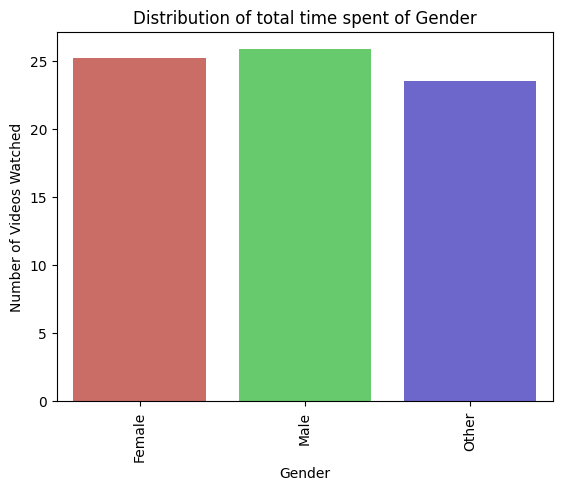

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


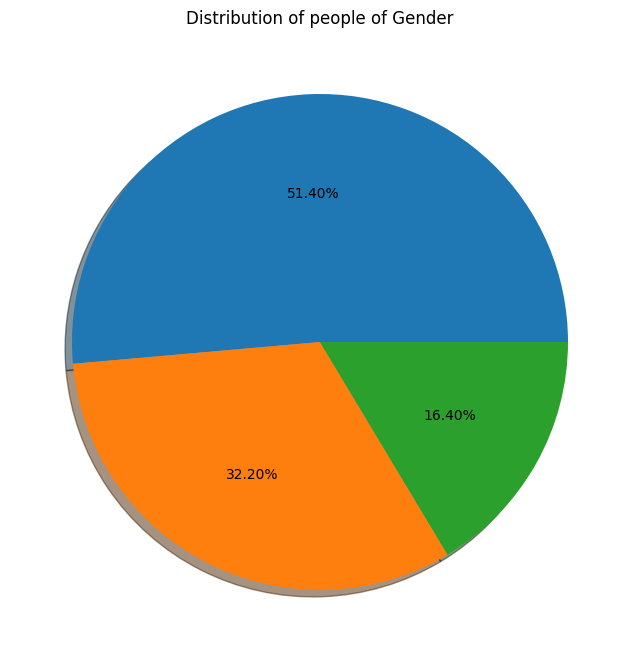

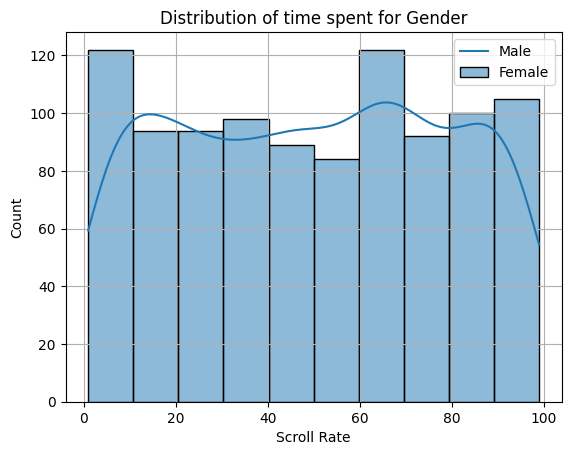

Total Scroll Rate by different groups of Gender
Gender
Female    16048
Male      25512
Other      8214
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


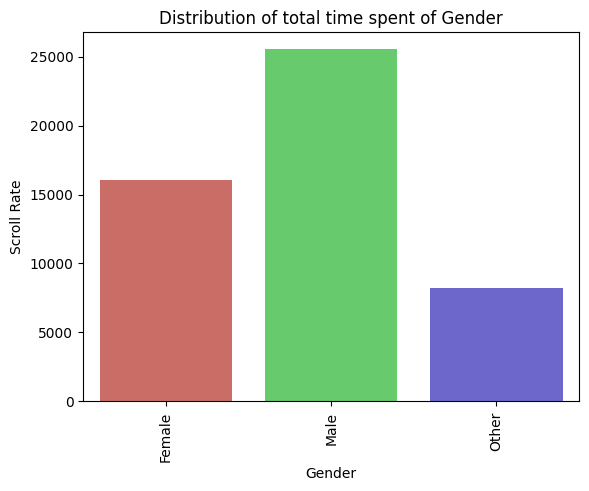

Average Scroll Rate by different groups of Gender
Gender
Female    49.838509
Male      49.634241
Other     50.085366
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


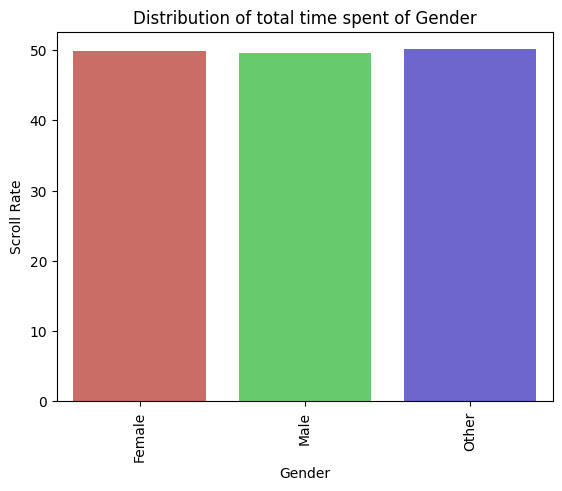

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


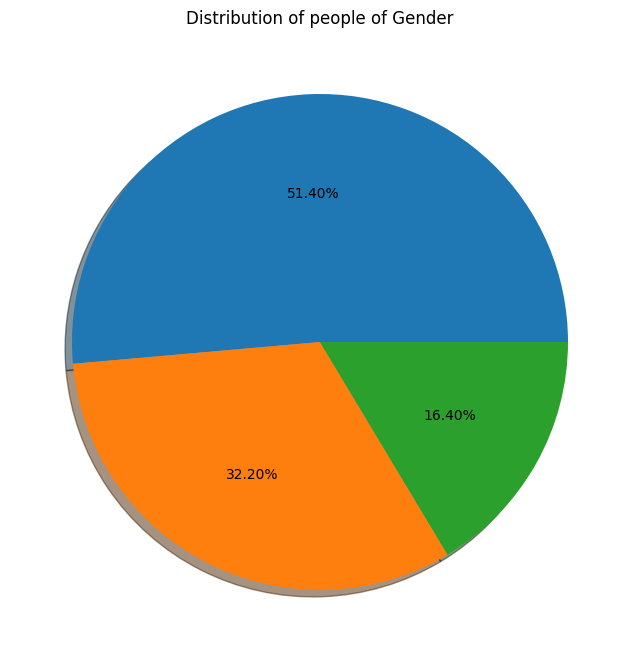

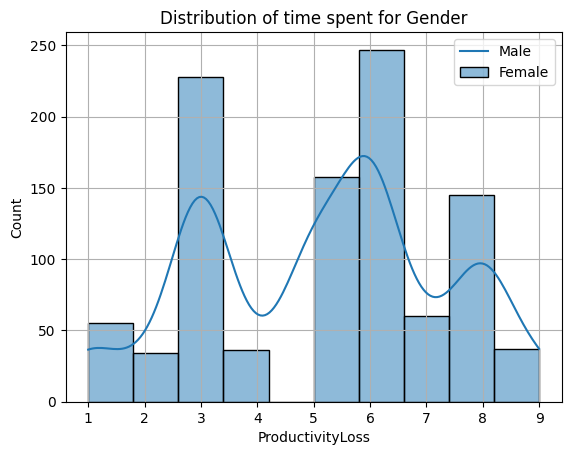

Total ProductivityLoss by different groups of Gender
Gender
Female    1656
Male      2610
Other      870
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


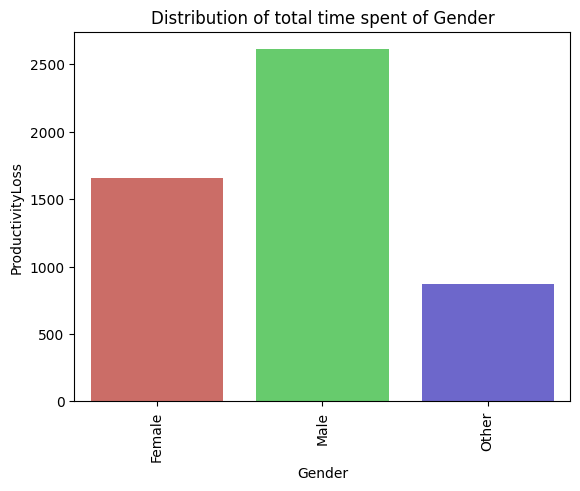

Average ProductivityLoss by different groups of Gender
Gender
Female    5.142857
Male      5.077821
Other     5.304878
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


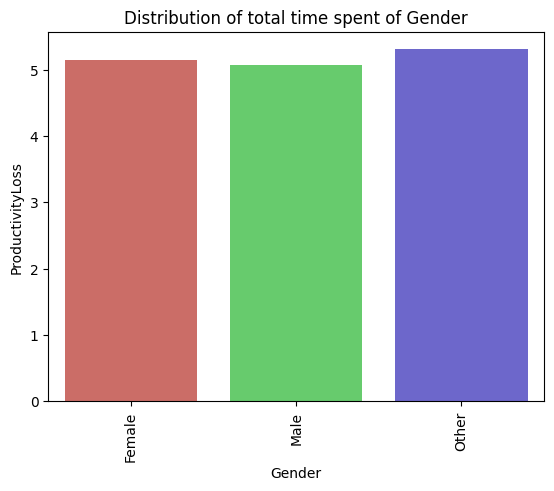

Gender:
Distribution of people of Gender
Gender
Male      51.4
Female    32.2
Other     16.4
Name: count, dtype: float64


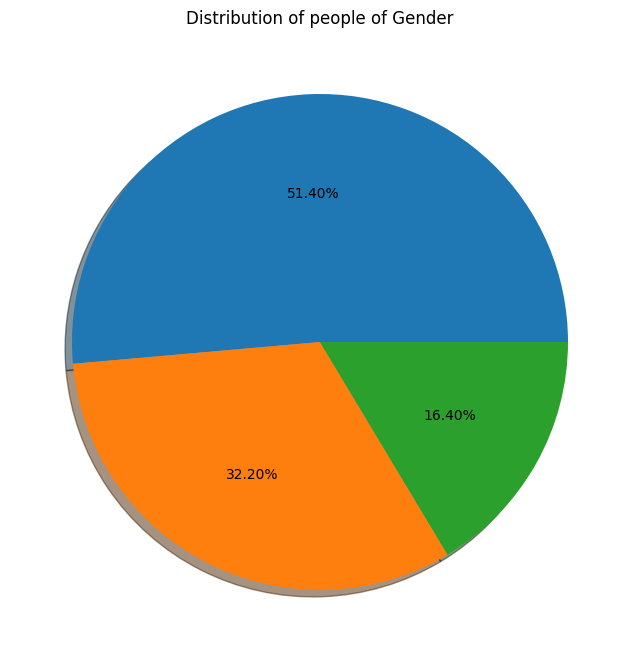

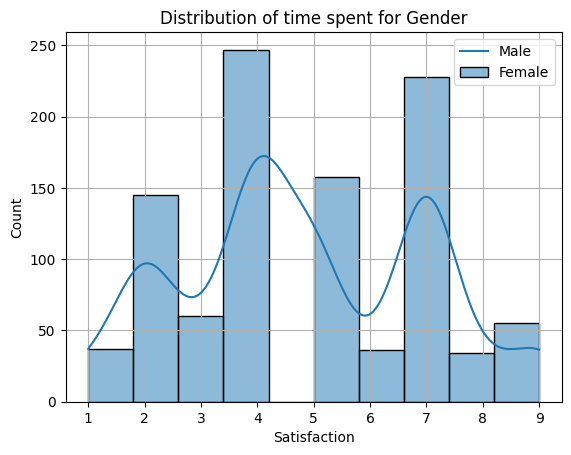

Total Satisfaction by different groups of Gender
Gender
Female    1564
Male      2530
Other      770
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


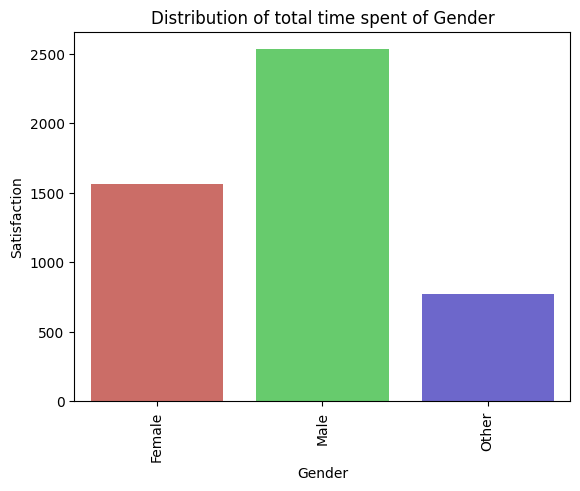

Average Satisfaction by different groups of Gender
Gender
Female    4.857143
Male      4.922179
Other     4.695122
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


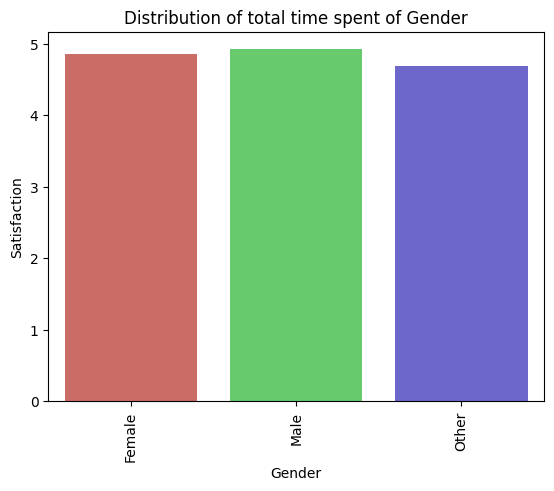

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


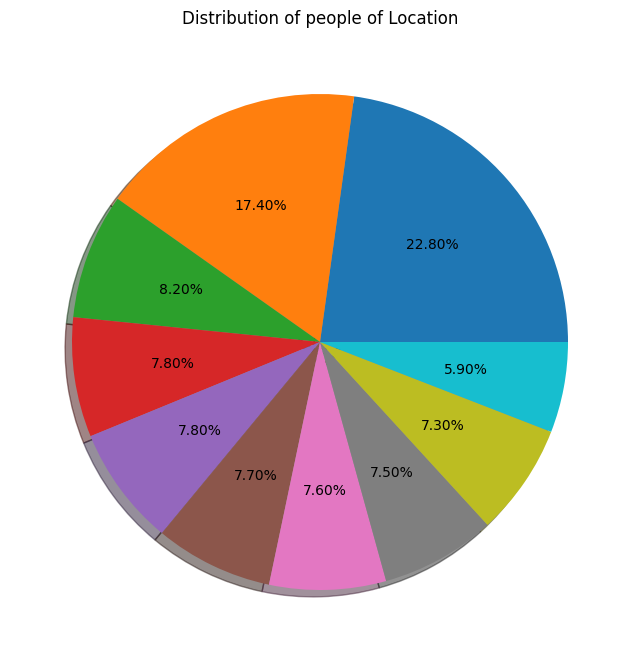

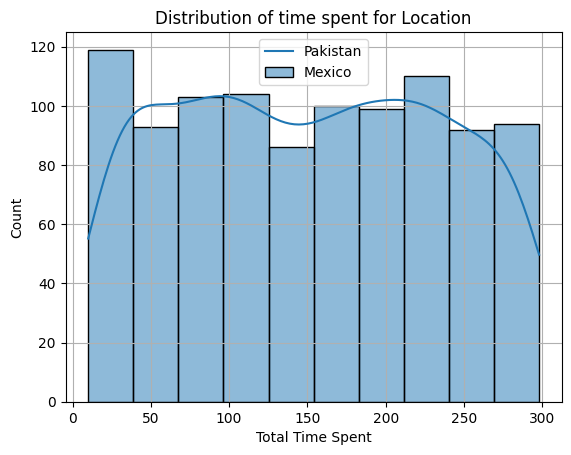

Total Total Time Spent by different groups of Location
Location
Barzil           11400
Germany           7723
India            34465
Indonesia        11329
Japan            12275
Mexico           11720
Pakistan         11921
Philippines      12798
United States    26371
Vietnam          11404
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


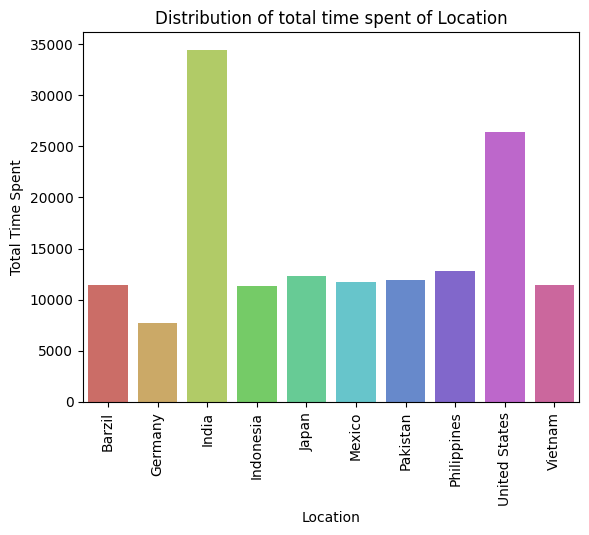

Average Total Time Spent by different groups of Location
Location
Barzil           146.153846
Germany          130.898305
India            151.162281
Indonesia        147.129870
Japan            163.666667
Mexico           160.547945
Pakistan         156.855263
Philippines      164.076923
United States    151.557471
Vietnam          139.073171
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


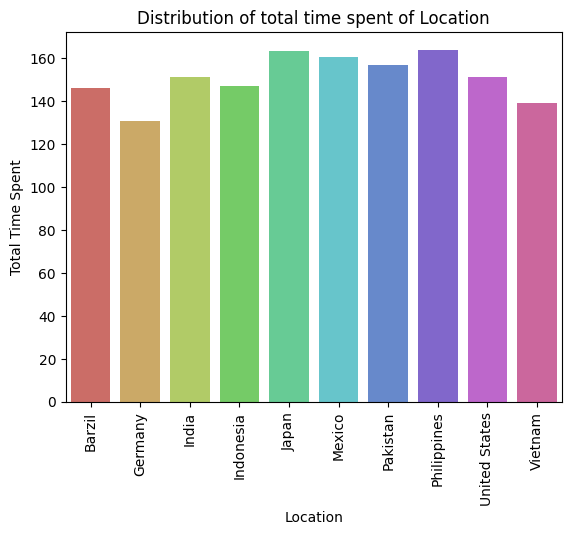

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


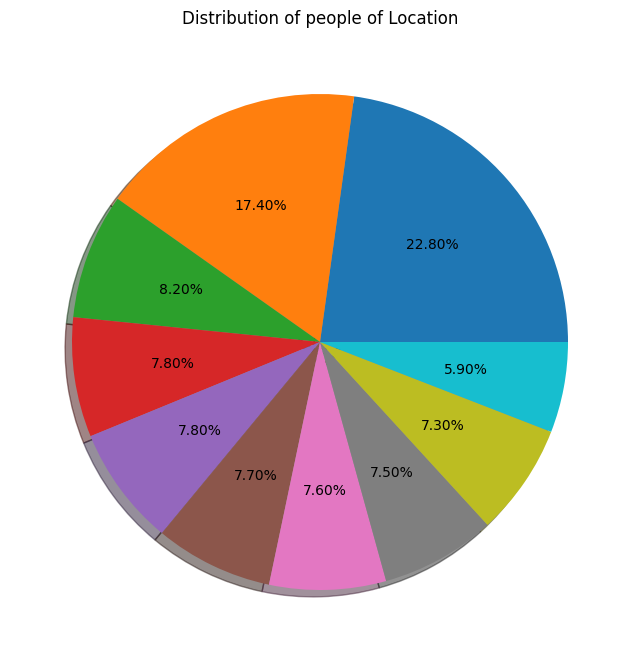

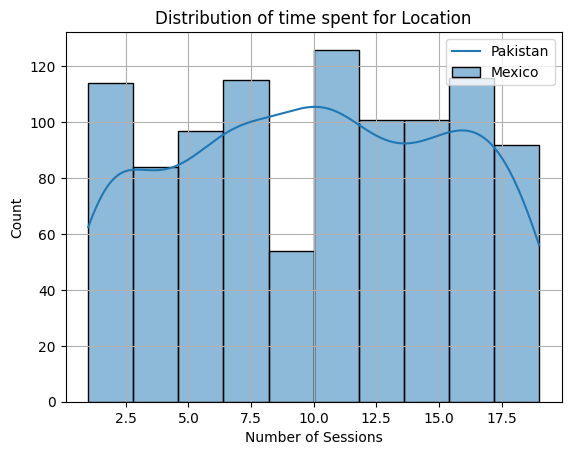

Total Number of Sessions by different groups of Location
Location
Barzil            817
Germany           616
India            2458
Indonesia         745
Japan             709
Mexico            669
Pakistan          751
Philippines       817
United States    1682
Vietnam           749
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


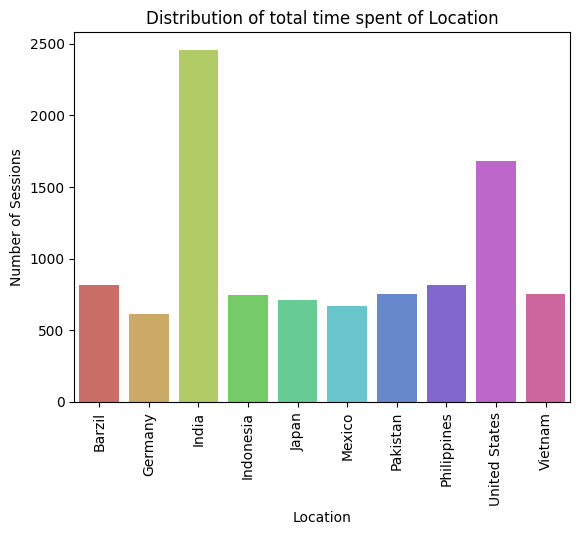

Average Number of Sessions by different groups of Location
Location
Barzil           10.474359
Germany          10.440678
India            10.780702
Indonesia         9.675325
Japan             9.453333
Mexico            9.164384
Pakistan          9.881579
Philippines      10.474359
United States     9.666667
Vietnam           9.134146
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


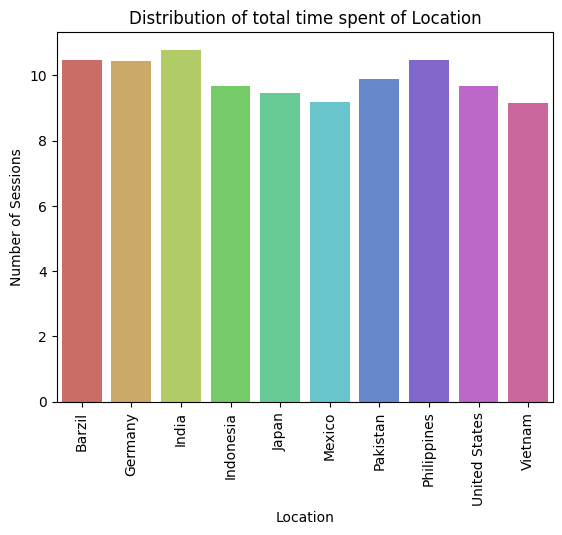

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


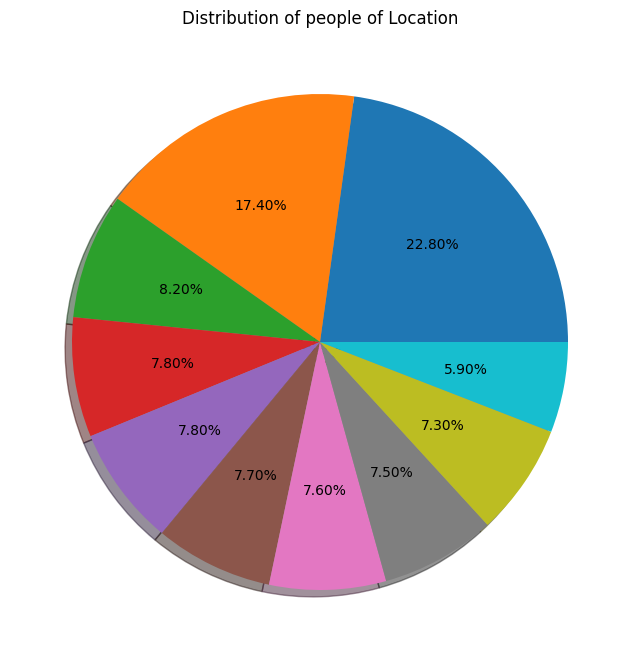

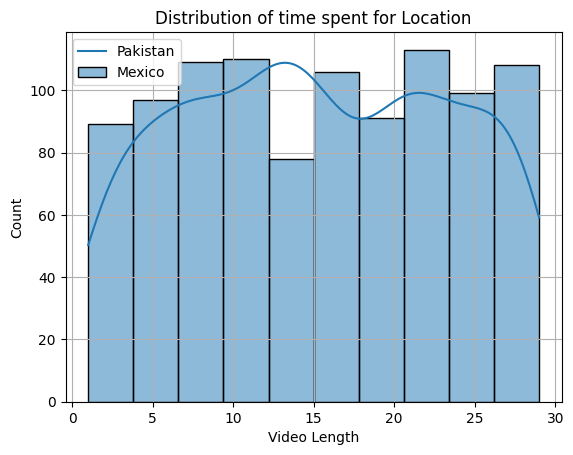

Total Video Length by different groups of Location
Location
Barzil           1157
Germany           871
India            3512
Indonesia        1110
Japan            1198
Mexico           1148
Pakistan         1068
Philippines      1210
United States    2703
Vietnam          1237
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


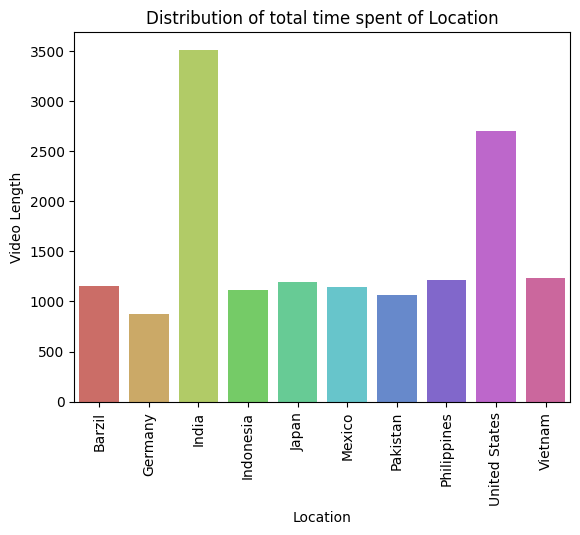

Average Video Length by different groups of Location
Location
Barzil           14.833333
Germany          14.762712
India            15.403509
Indonesia        14.415584
Japan            15.973333
Mexico           15.726027
Pakistan         14.052632
Philippines      15.512821
United States    15.534483
Vietnam          15.085366
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


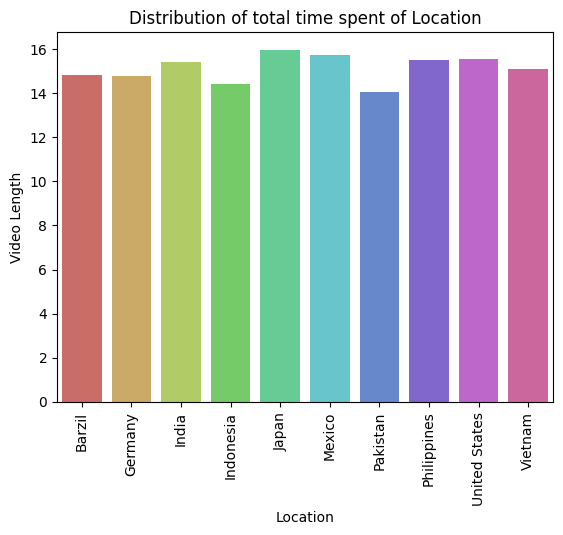

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


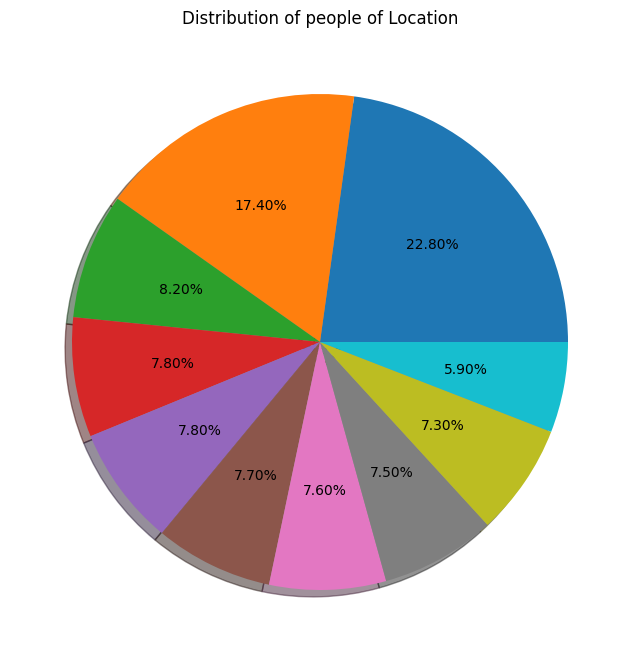

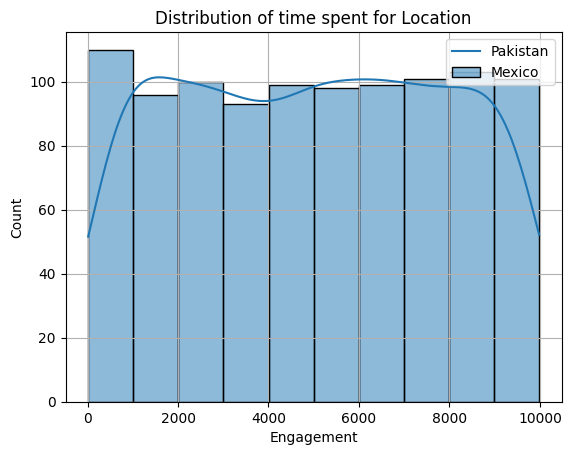

Total Engagement by different groups of Location
Location
Barzil            334275
Germany           270448
India            1089647
Indonesia         416197
Japan             373960
Mexico            381918
Pakistan          404044
Philippines       386353
United States     880195
Vietnam           460122
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


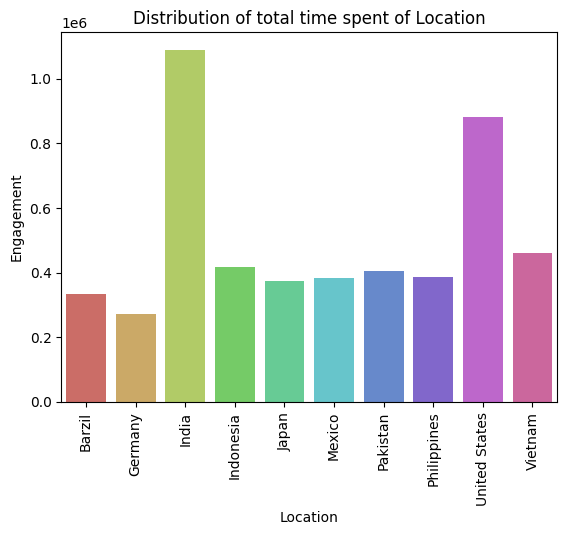

Average Engagement by different groups of Location
Location
Barzil           4285.576923
Germany          4583.864407
India            4779.153509
Indonesia        5405.155844
Japan            4986.133333
Mexico           5231.753425
Pakistan         5316.368421
Philippines      4953.243590
United States    5058.591954
Vietnam          5611.243902
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


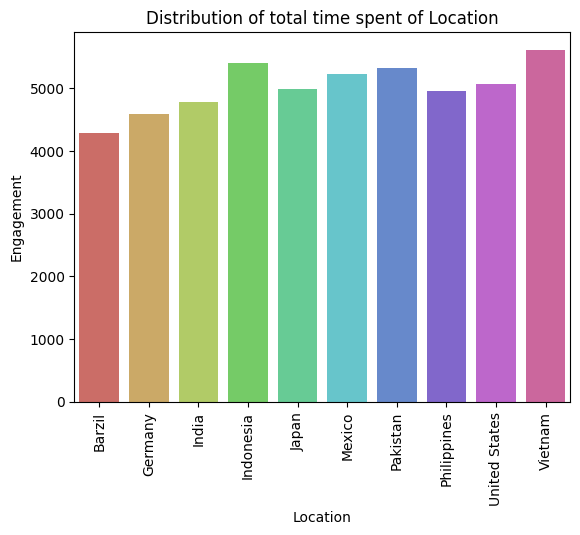

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


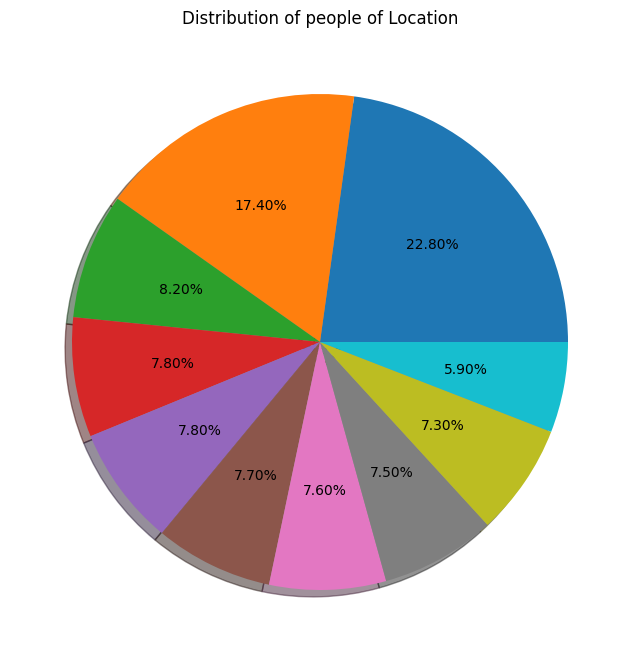

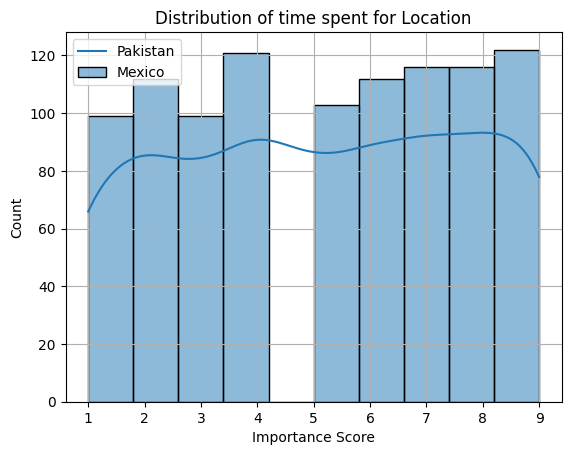

Total Importance Score by different groups of Location
Location
Barzil            374
Germany           281
India            1120
Indonesia         429
Japan             405
Mexico            376
Pakistan          386
Philippines       422
United States     921
Vietnam           415
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


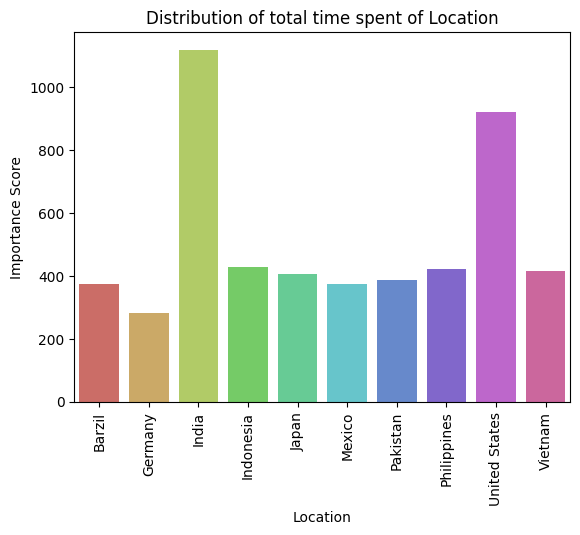

Average Importance Score by different groups of Location
Location
Barzil           4.794872
Germany          4.762712
India            4.912281
Indonesia        5.571429
Japan            5.400000
Mexico           5.150685
Pakistan         5.078947
Philippines      5.410256
United States    5.293103
Vietnam          5.060976
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


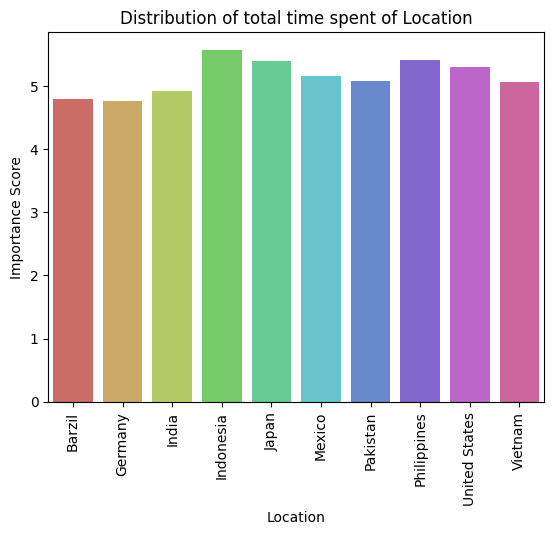

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


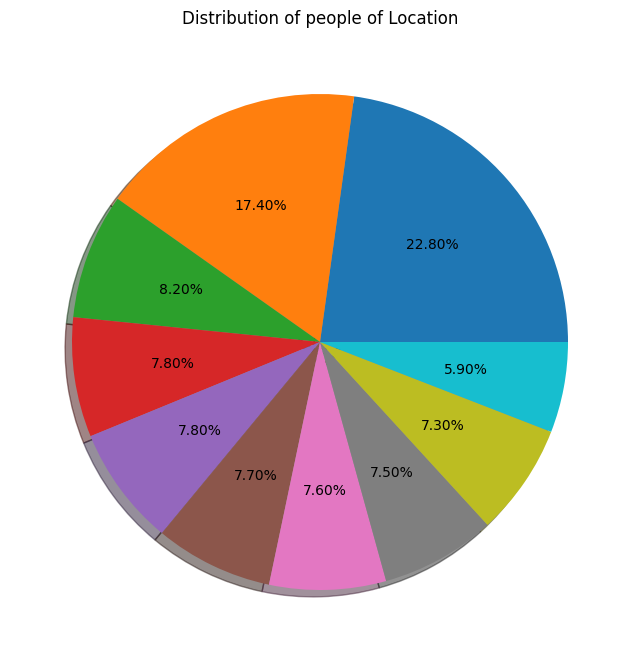

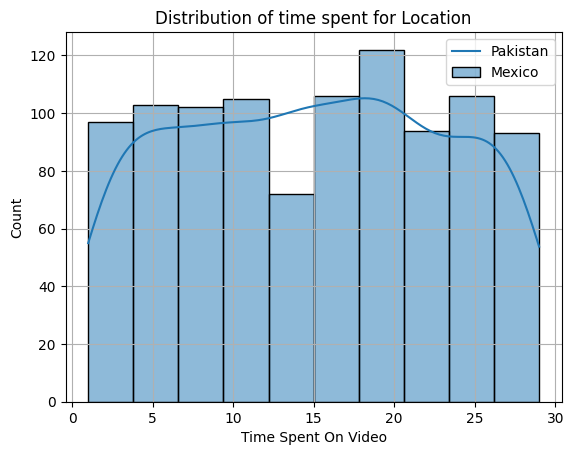

Total Time Spent On Video by different groups of Location
Location
Barzil           1081
Germany           942
India            3550
Indonesia        1044
Japan            1143
Mexico           1041
Pakistan         1225
Philippines      1126
United States    2547
Vietnam          1274
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


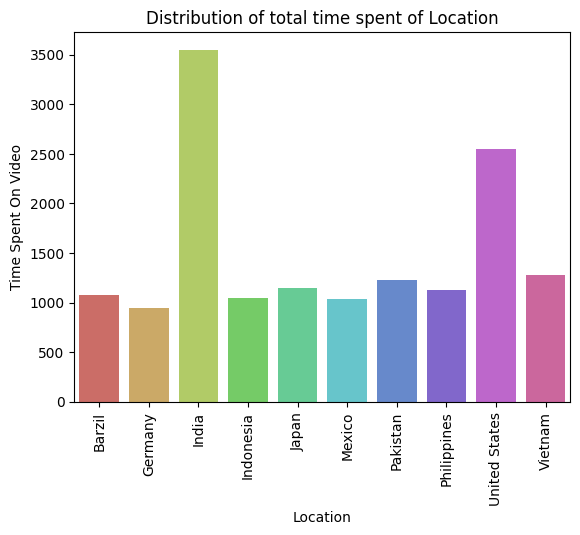

Average Time Spent On Video by different groups of Location
Location
Barzil           13.858974
Germany          15.966102
India            15.570175
Indonesia        13.558442
Japan            15.240000
Mexico           14.260274
Pakistan         16.118421
Philippines      14.435897
United States    14.637931
Vietnam          15.536585
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


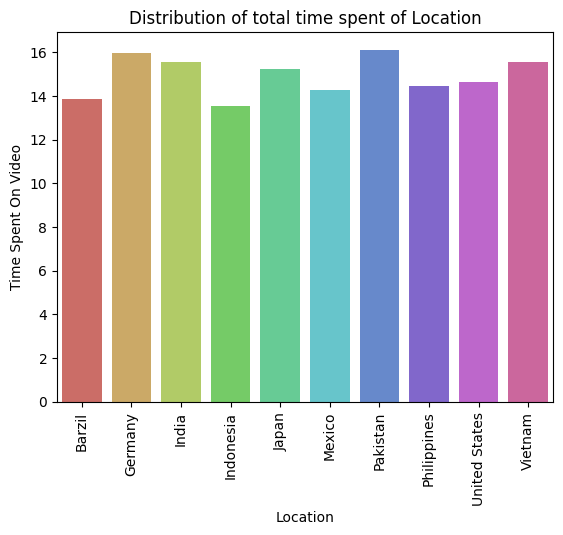

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


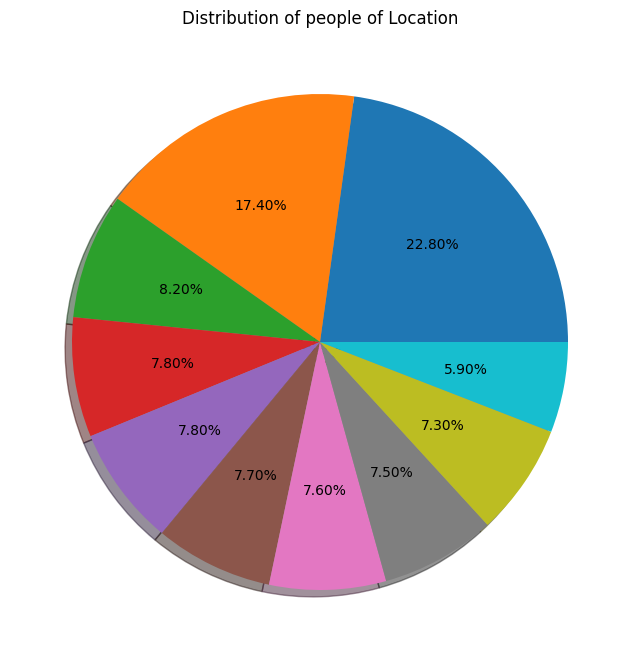

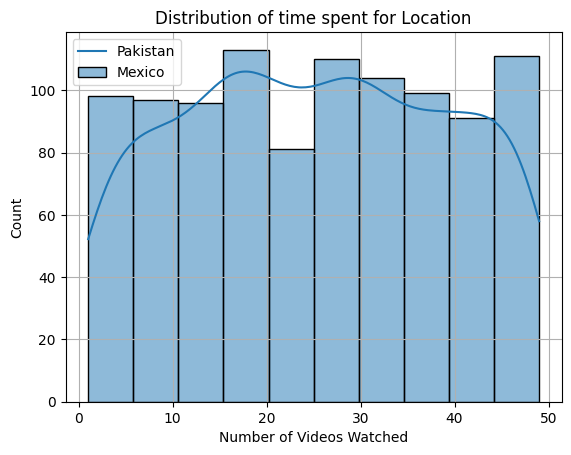

Total Number of Videos Watched by different groups of Location
Location
Barzil           2129
Germany          1441
India            5670
Indonesia        2147
Japan            1987
Mexico           1682
Pakistan         2009
Philippines      1893
United States    4554
Vietnam          1736
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


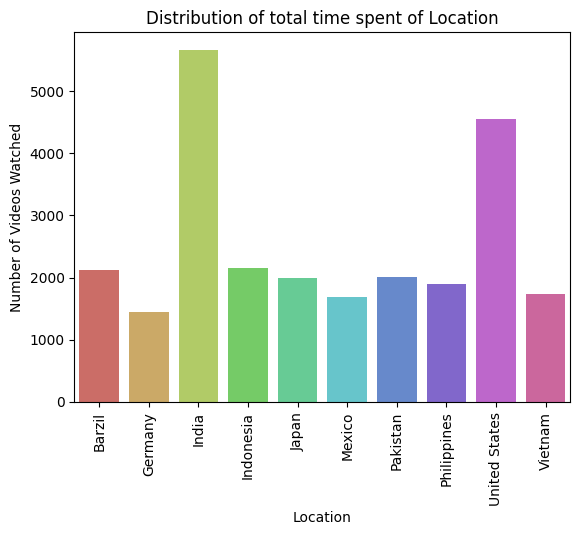

Average Number of Videos Watched by different groups of Location
Location
Barzil           27.294872
Germany          24.423729
India            24.868421
Indonesia        27.883117
Japan            26.493333
Mexico           23.041096
Pakistan         26.434211
Philippines      24.269231
United States    26.172414
Vietnam          21.170732
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


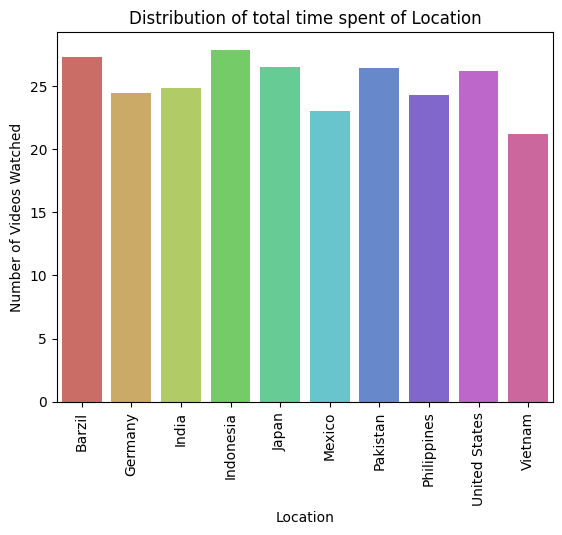

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


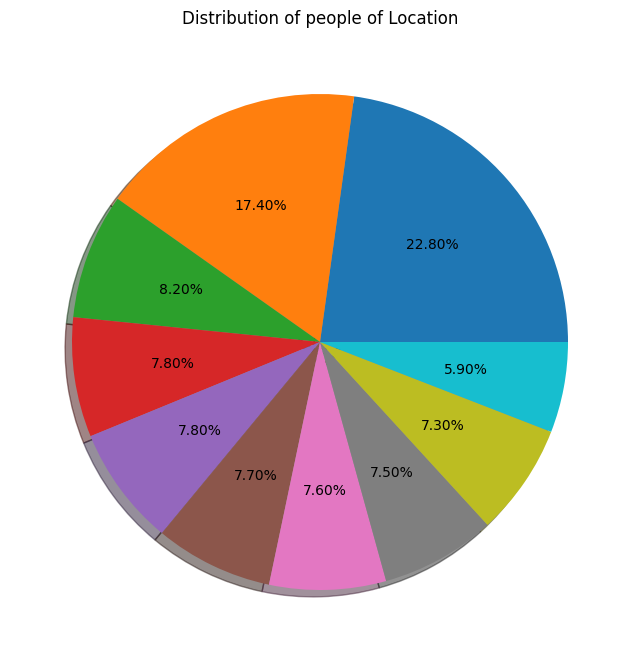

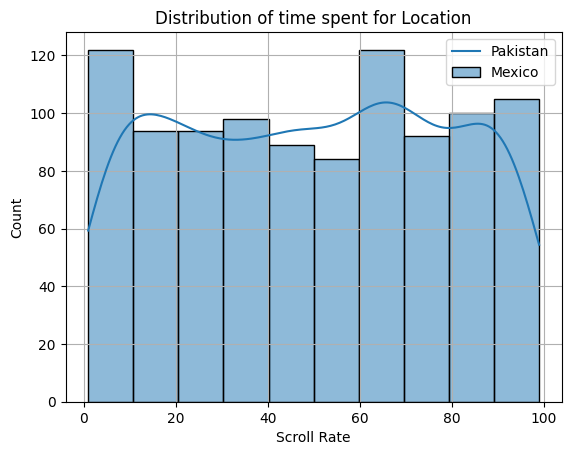

Total Scroll Rate by different groups of Location
Location
Barzil            3712
Germany           2913
India            11195
Indonesia         3769
Japan             3569
Mexico            4215
Pakistan          3735
Philippines       4276
United States     8552
Vietnam           3838
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


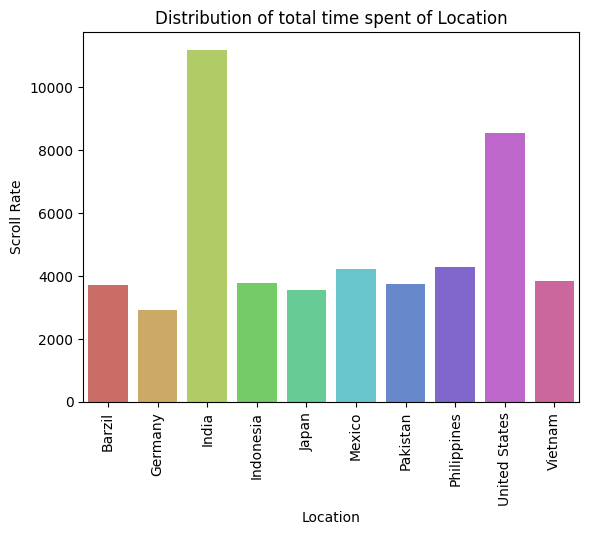

Average Scroll Rate by different groups of Location
Location
Barzil           47.589744
Germany          49.372881
India            49.100877
Indonesia        48.948052
Japan            47.586667
Mexico           57.739726
Pakistan         49.144737
Philippines      54.820513
United States    49.149425
Vietnam          46.804878
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


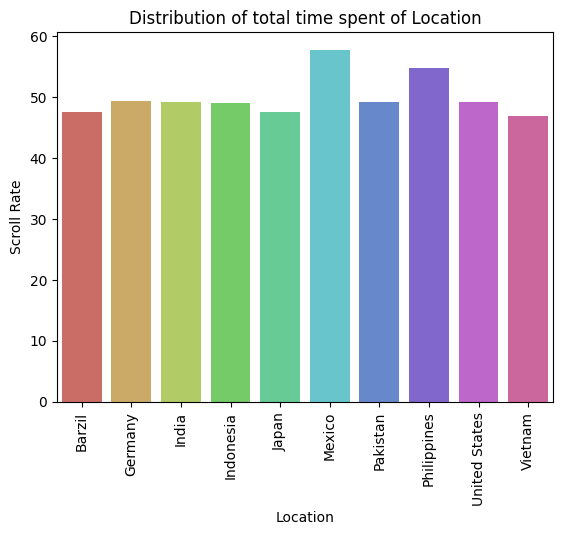

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


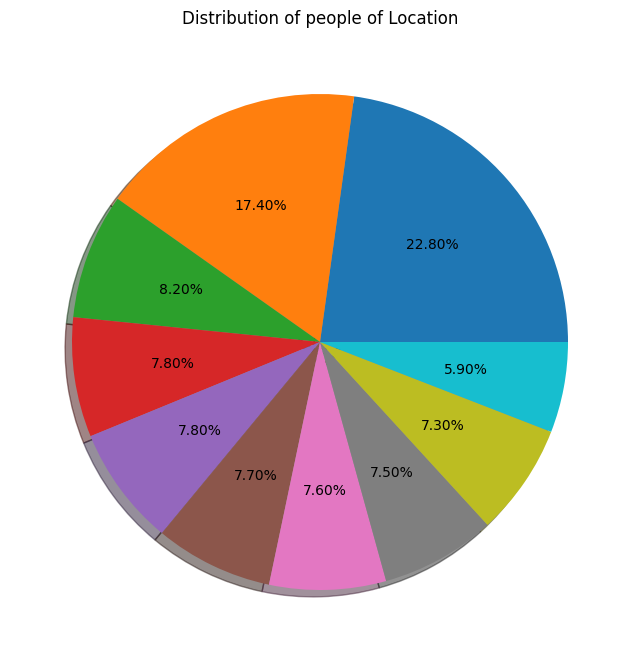

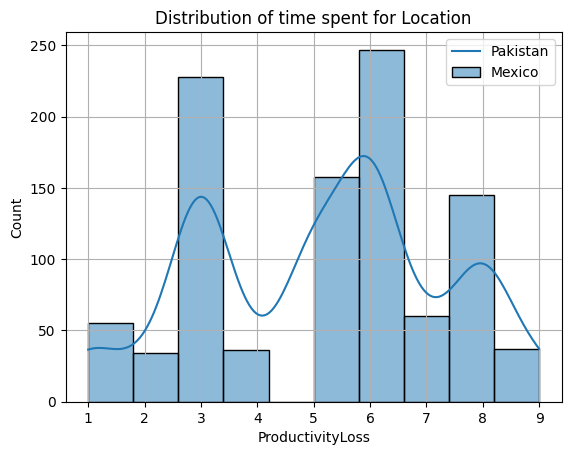

Total ProductivityLoss by different groups of Location
Location
Barzil            353
Germany           289
India            1169
Indonesia         407
Japan             410
Mexico            373
Pakistan          416
Philippines       398
United States     875
Vietnam           446
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


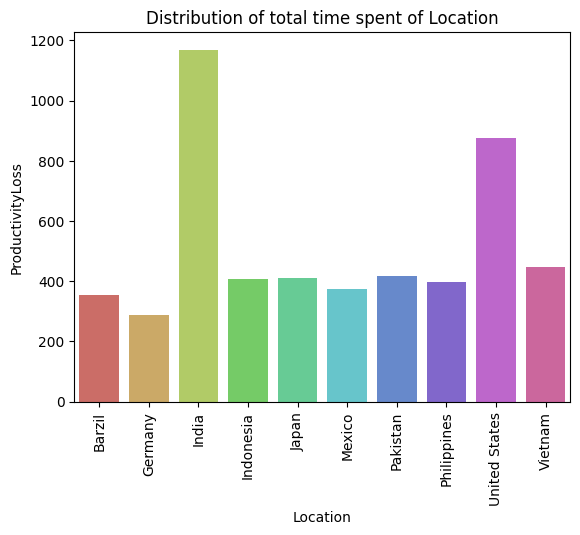

Average ProductivityLoss by different groups of Location
Location
Barzil           4.525641
Germany          4.898305
India            5.127193
Indonesia        5.285714
Japan            5.466667
Mexico           5.109589
Pakistan         5.473684
Philippines      5.102564
United States    5.028736
Vietnam          5.439024
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


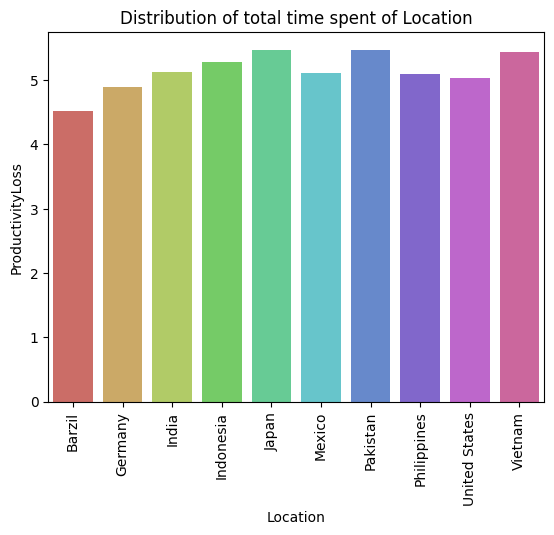

Location:
Distribution of people of Location
Location
India            22.8
United States    17.4
Vietnam           8.2
Barzil            7.8
Philippines       7.8
Indonesia         7.7
Pakistan          7.6
Japan             7.5
Mexico            7.3
Germany           5.9
Name: count, dtype: float64


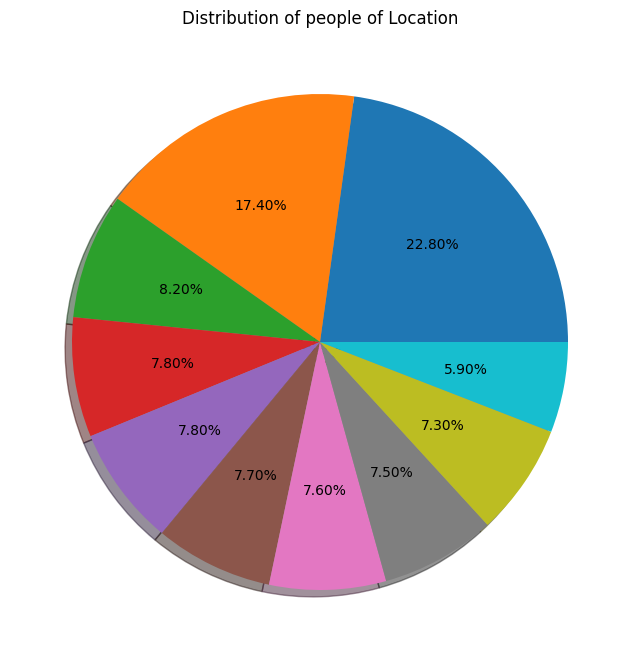

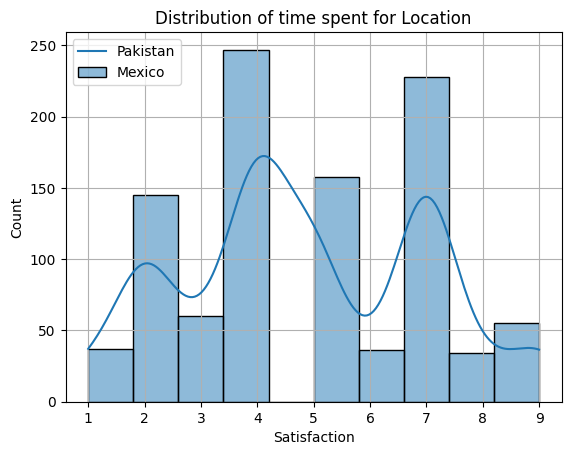

Total Satisfaction by different groups of Location
Location
Barzil            427
Germany           301
India            1111
Indonesia         363
Japan             340
Mexico            357
Pakistan          344
Philippines       382
United States     865
Vietnam           374
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


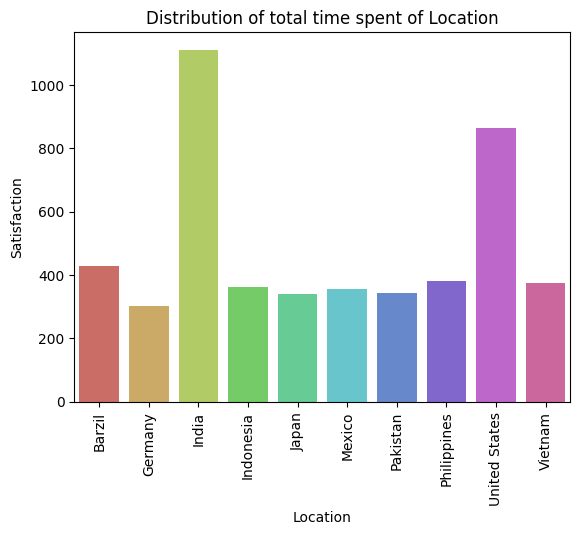

Average Satisfaction by different groups of Location
Location
Barzil           5.474359
Germany          5.101695
India            4.872807
Indonesia        4.714286
Japan            4.533333
Mexico           4.890411
Pakistan         4.526316
Philippines      4.897436
United States    4.971264
Vietnam          4.560976
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


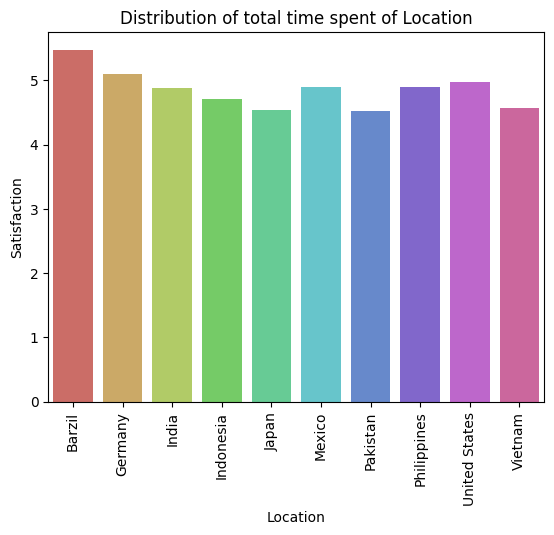

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


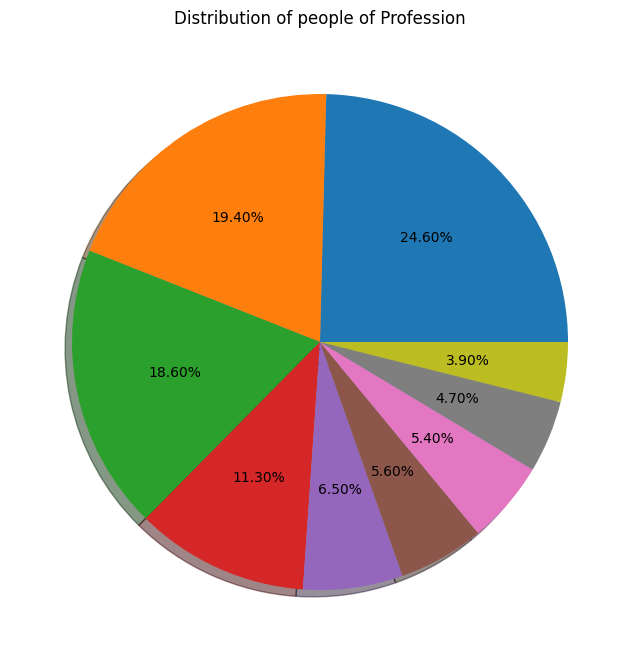

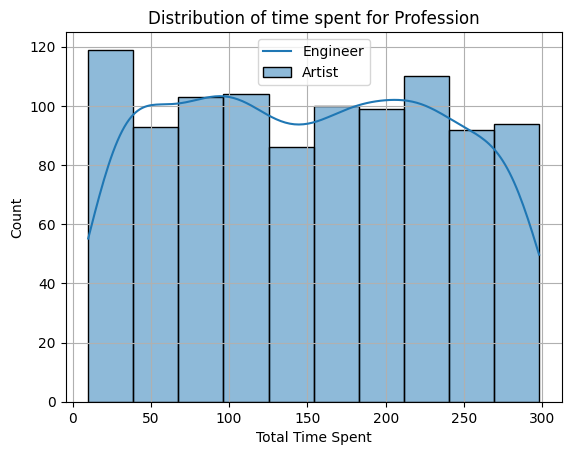

Total Total Time Spent by different groups of Profession
Profession
Artist            7190
Cashier           9570
Engineer          9560
Labor/Worker     28924
Manager           8234
Students         36639
Teacher           5812
Waiting staff    28621
driver           16856
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


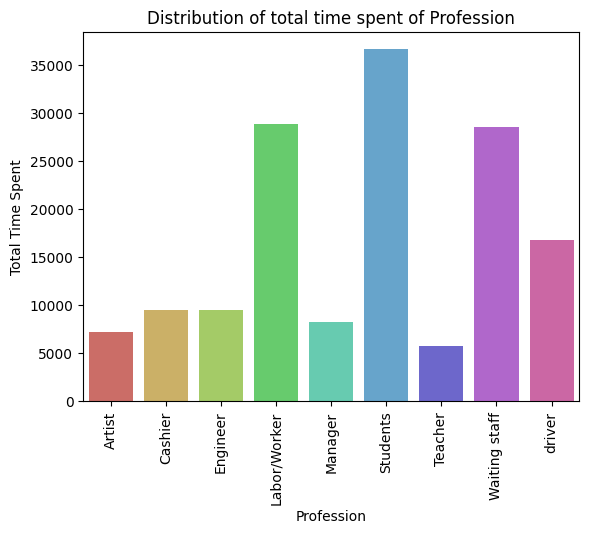

Average Total Time Spent by different groups of Profession
Profession
Artist           152.978723
Cashier          170.892857
Engineer         147.076923
Labor/Worker     155.505376
Manager          152.481481
Students         148.939024
Teacher          149.025641
Waiting staff    147.530928
driver           149.168142
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


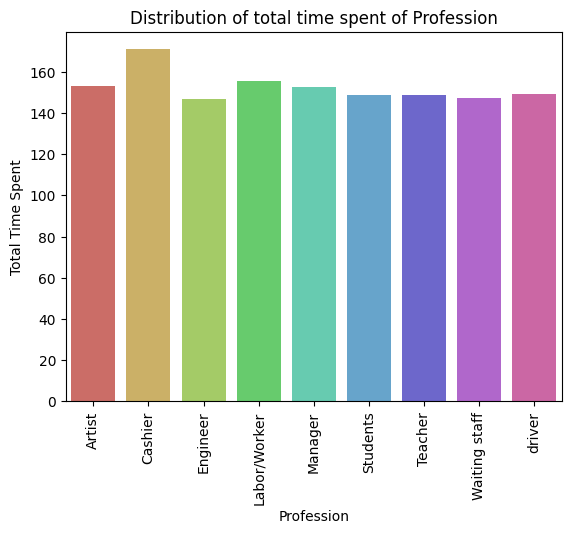

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


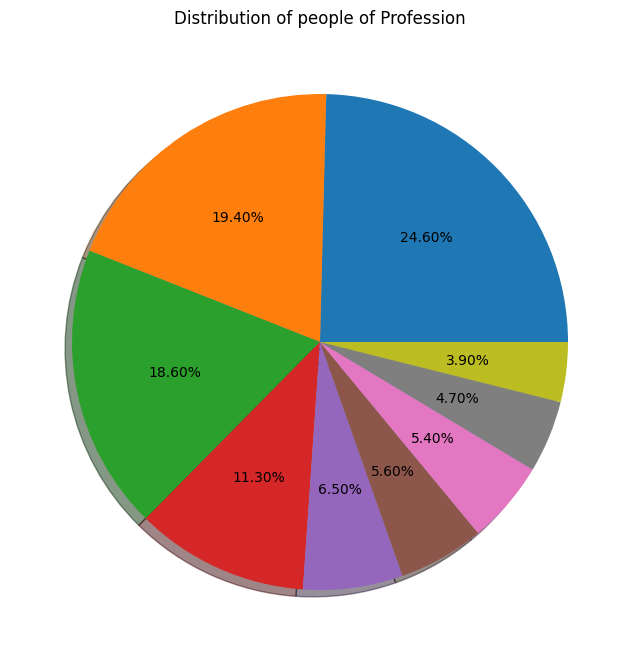

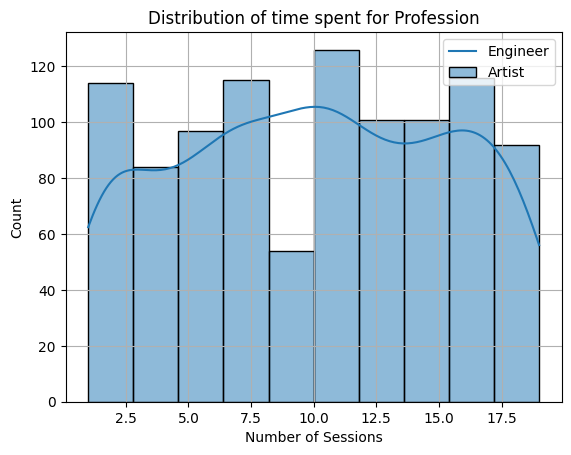

Total Number of Sessions by different groups of Profession
Profession
Artist            487
Cashier           535
Engineer          663
Labor/Worker     1880
Manager           481
Students         2421
Teacher           397
Waiting staff    2037
driver           1112
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


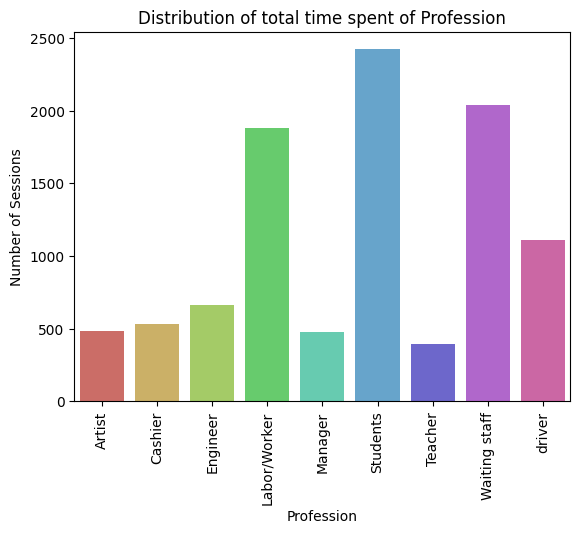

Average Number of Sessions by different groups of Profession
Profession
Artist           10.361702
Cashier           9.553571
Engineer         10.200000
Labor/Worker     10.107527
Manager           8.907407
Students          9.841463
Teacher          10.179487
Waiting staff    10.500000
driver            9.840708
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


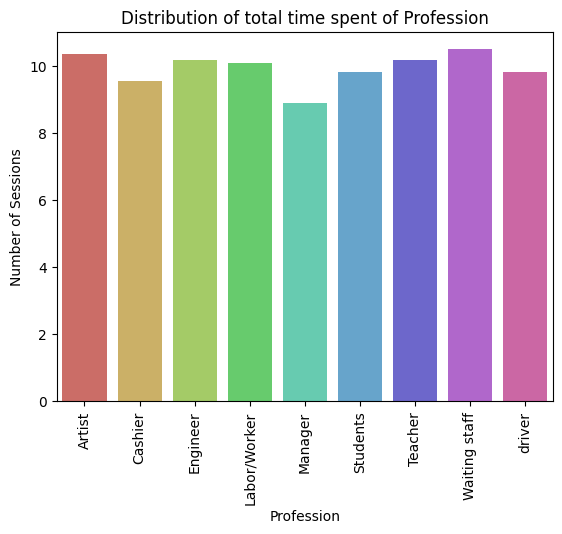

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


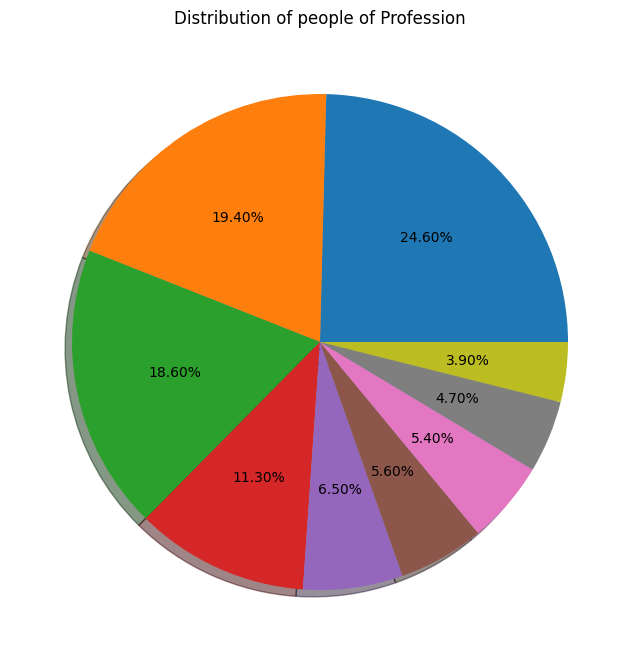

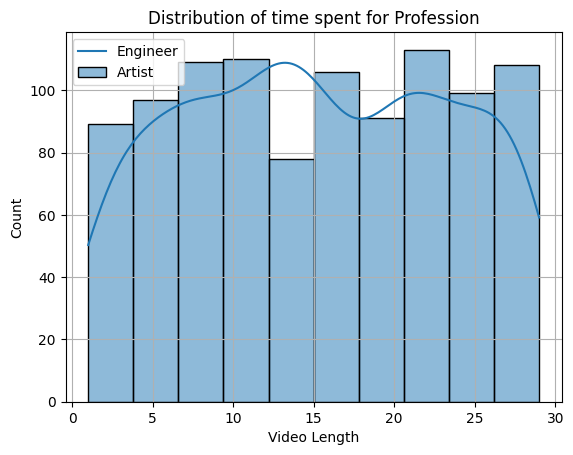

Total Video Length by different groups of Profession
Profession
Artist            780
Cashier           806
Engineer          958
Labor/Worker     2785
Manager           895
Students         3652
Teacher           552
Waiting staff    3062
driver           1724
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


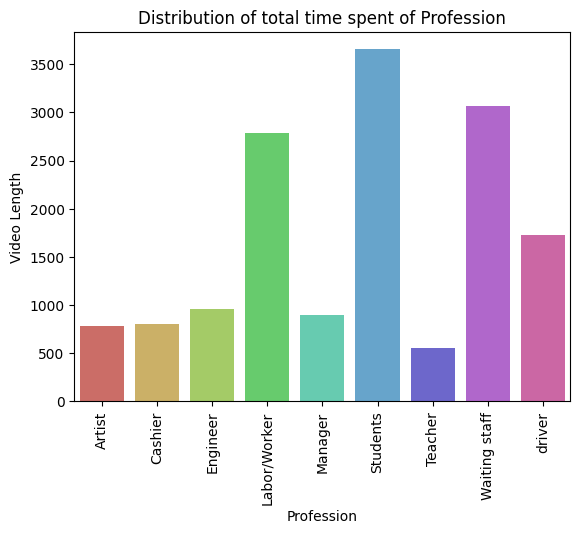

Average Video Length by different groups of Profession
Profession
Artist           16.595745
Cashier          14.392857
Engineer         14.738462
Labor/Worker     14.973118
Manager          16.574074
Students         14.845528
Teacher          14.153846
Waiting staff    15.783505
driver           15.256637
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


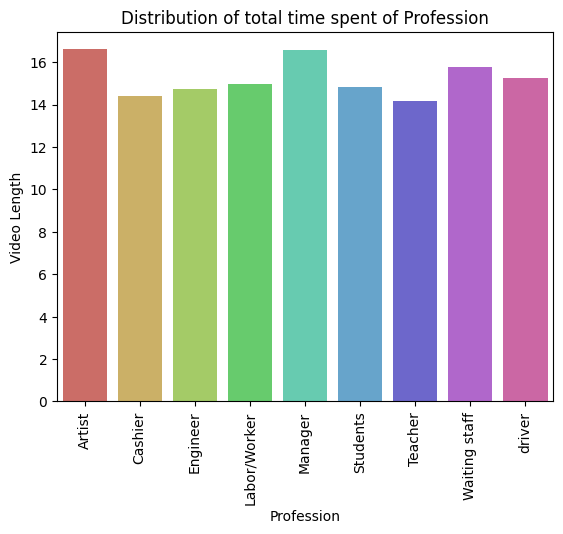

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


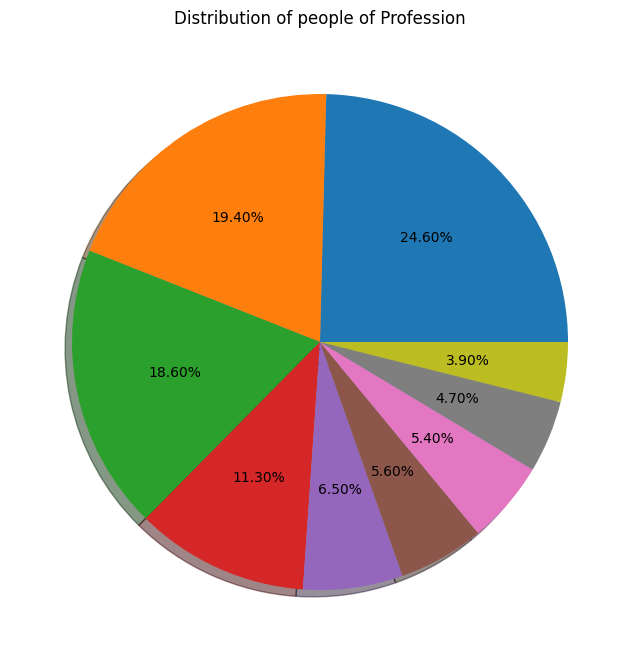

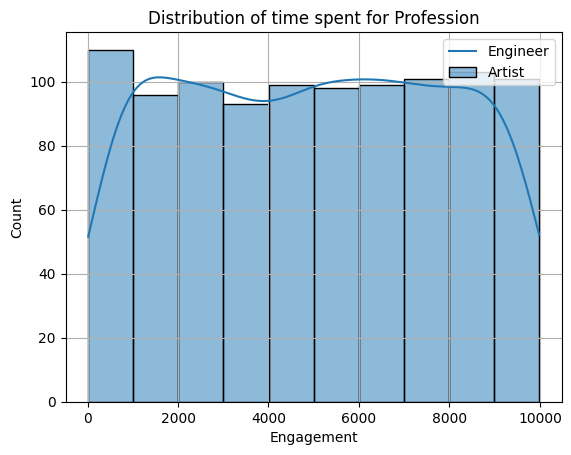

Total Engagement by different groups of Profession
Profession
Artist            223521
Cashier           298853
Engineer          293330
Labor/Worker      922268
Manager           295210
Students         1199763
Teacher           195460
Waiting staff    1024483
driver            544271
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


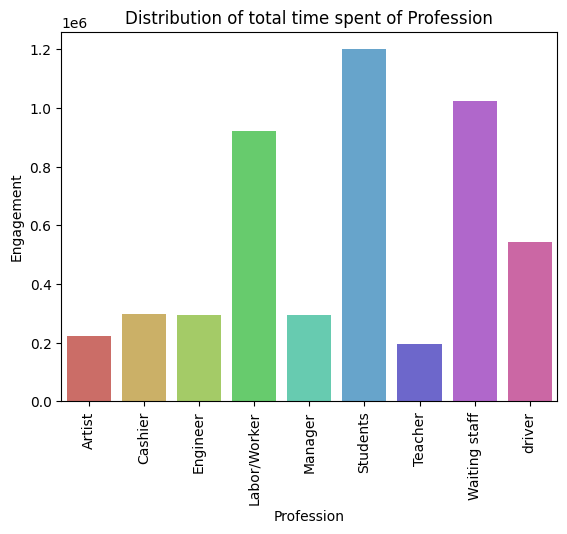

Average Engagement by different groups of Profession
Profession
Artist           4755.765957
Cashier          5336.660714
Engineer         4512.769231
Labor/Worker     4958.430108
Manager          5466.851852
Students         4877.085366
Teacher          5011.794872
Waiting staff    5280.840206
driver           4816.557522
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


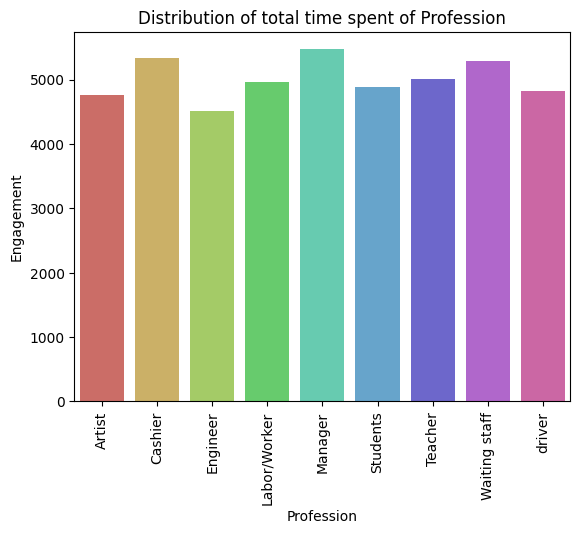

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


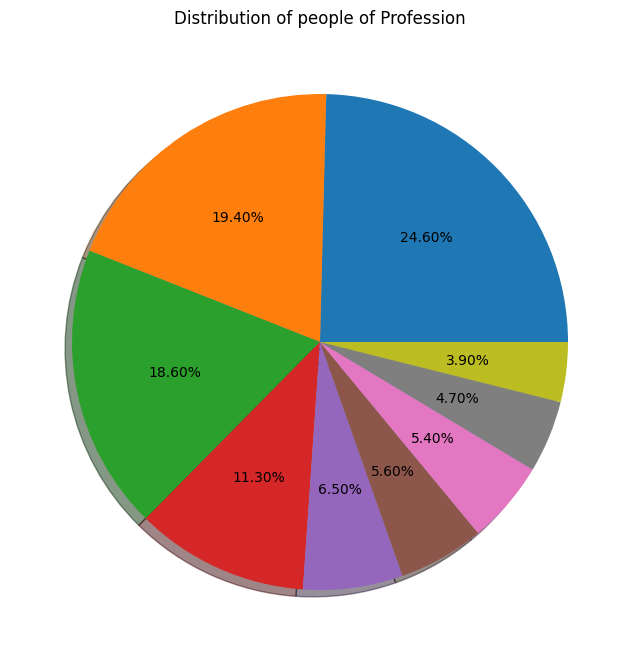

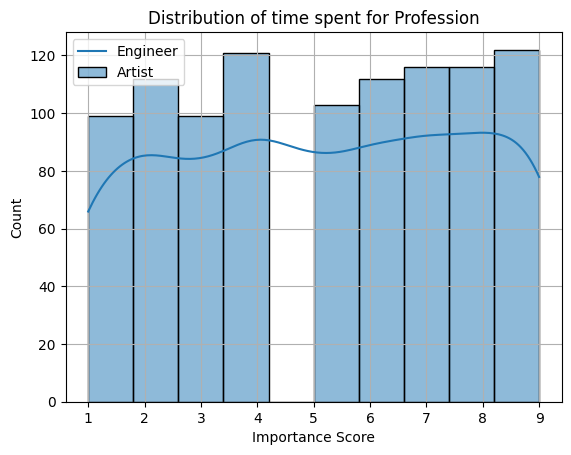

Total Importance Score by different groups of Profession
Profession
Artist            246
Cashier           315
Engineer          338
Labor/Worker      944
Manager           272
Students         1264
Teacher           206
Waiting staff     986
driver            558
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


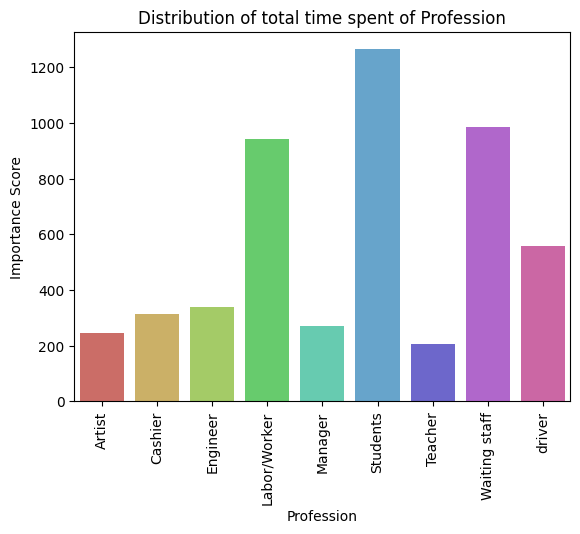

Average Importance Score by different groups of Profession
Profession
Artist           5.234043
Cashier          5.625000
Engineer         5.200000
Labor/Worker     5.075269
Manager          5.037037
Students         5.138211
Teacher          5.282051
Waiting staff    5.082474
driver           4.938053
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


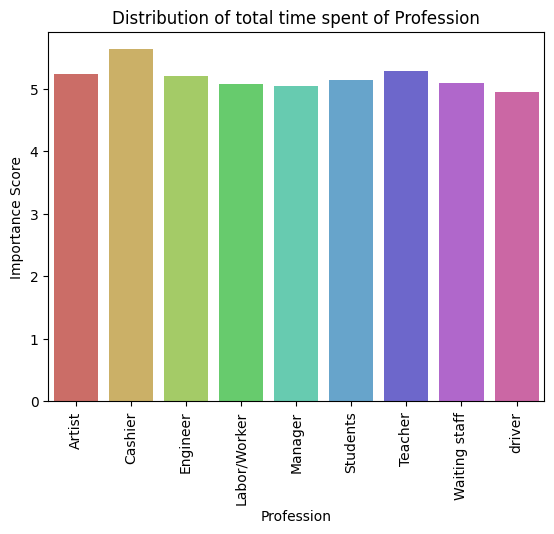

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


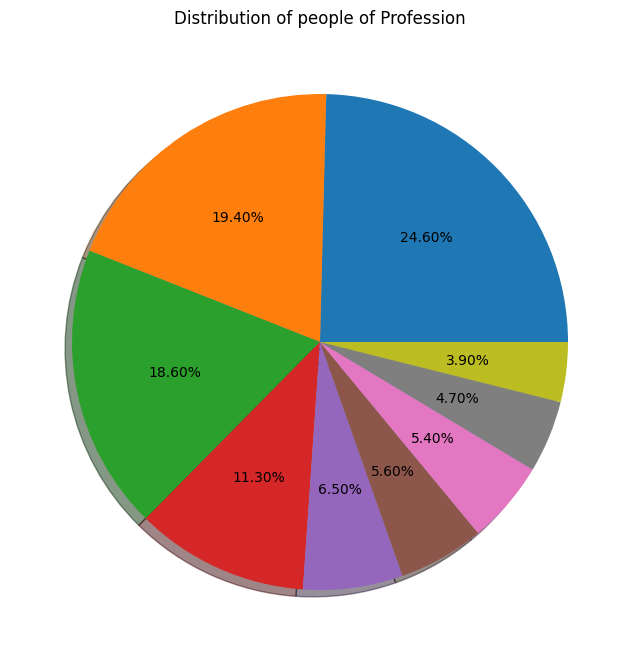

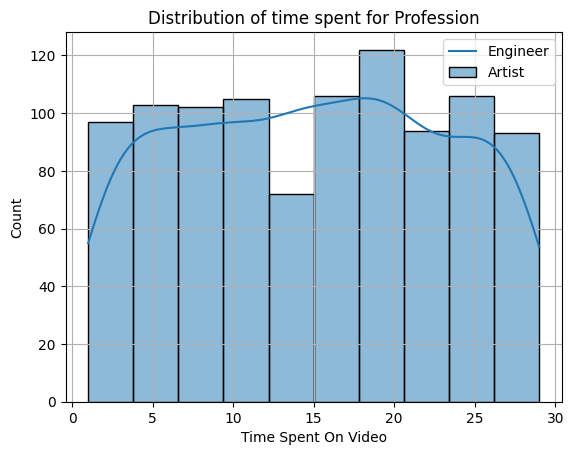

Total Time Spent On Video by different groups of Profession
Profession
Artist            802
Cashier           893
Engineer         1031
Labor/Worker     2781
Manager           849
Students         3526
Teacher           552
Waiting staff    2803
driver           1736
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


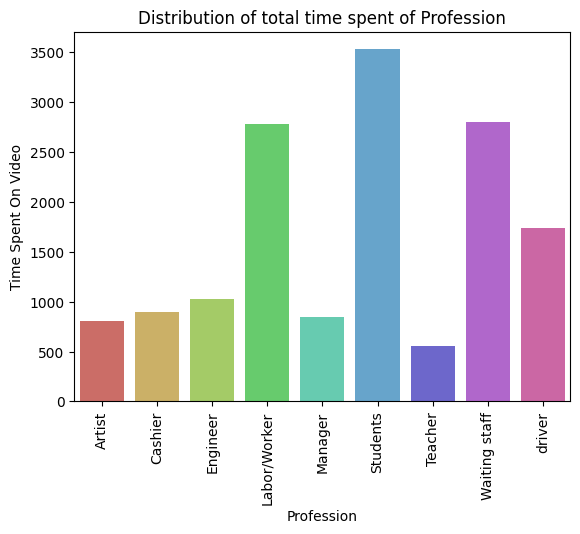

Average Time Spent On Video by different groups of Profession
Profession
Artist           17.063830
Cashier          15.946429
Engineer         15.861538
Labor/Worker     14.951613
Manager          15.722222
Students         14.333333
Teacher          14.153846
Waiting staff    14.448454
driver           15.362832
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


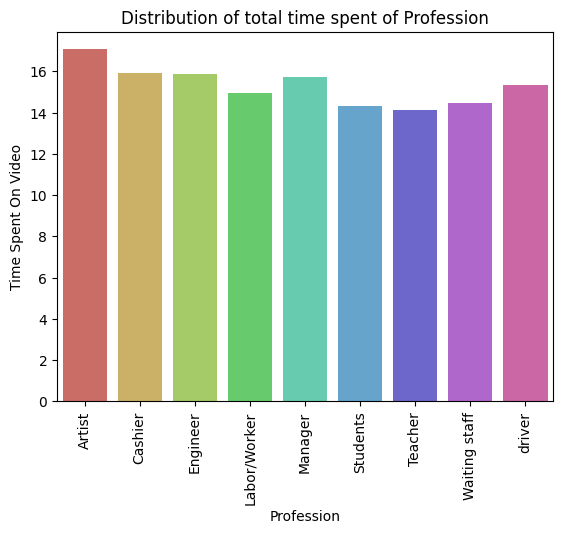

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


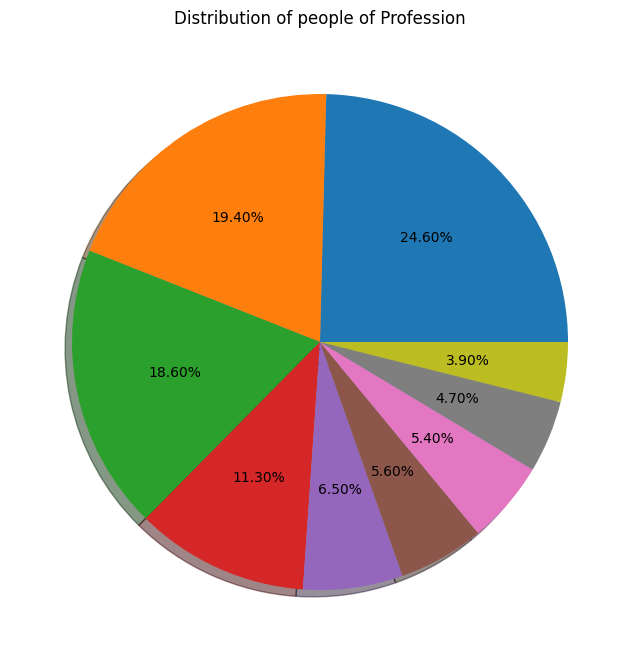

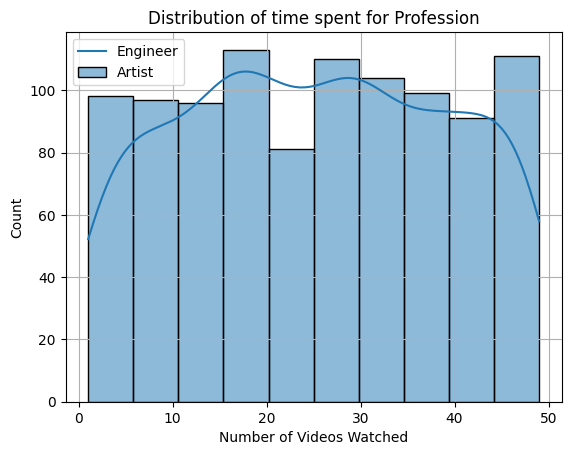

Total Number of Videos Watched by different groups of Profession
Profession
Artist           1318
Cashier          1414
Engineer         1522
Labor/Worker     4786
Manager          1221
Students         6430
Teacher           718
Waiting staff    4900
driver           2939
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


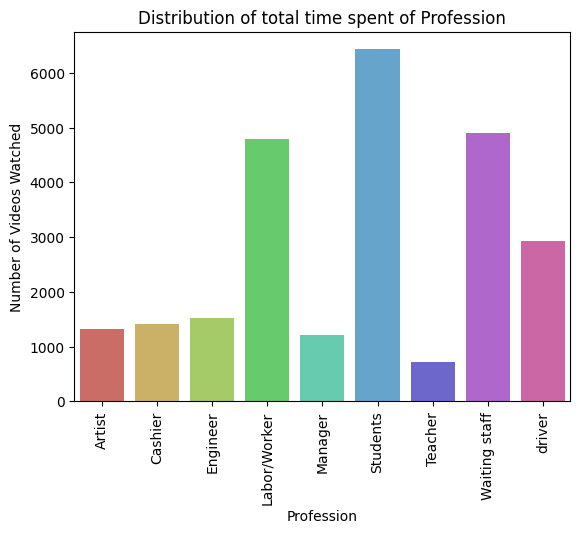

Average Number of Videos Watched by different groups of Profession
Profession
Artist           28.042553
Cashier          25.250000
Engineer         23.415385
Labor/Worker     25.731183
Manager          22.611111
Students         26.138211
Teacher          18.410256
Waiting staff    25.257732
driver           26.008850
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


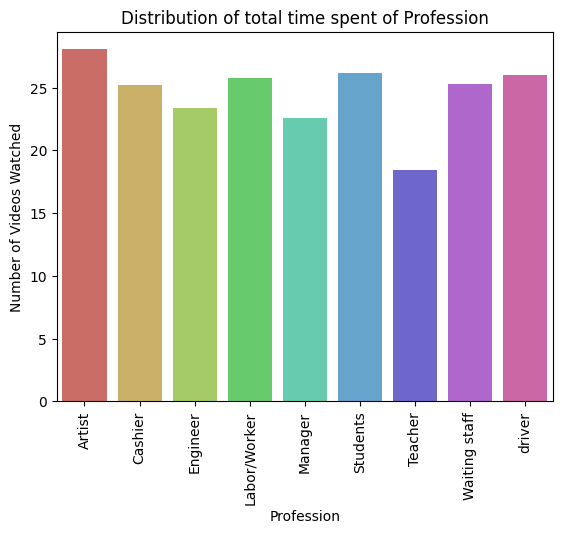

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


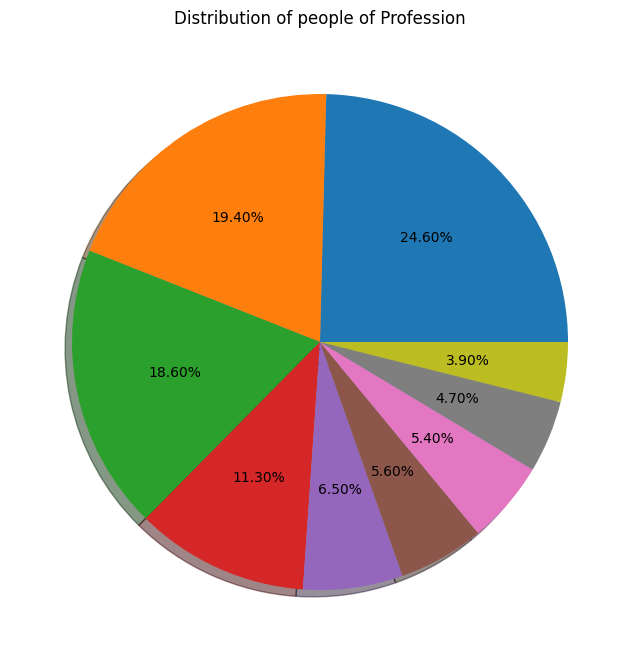

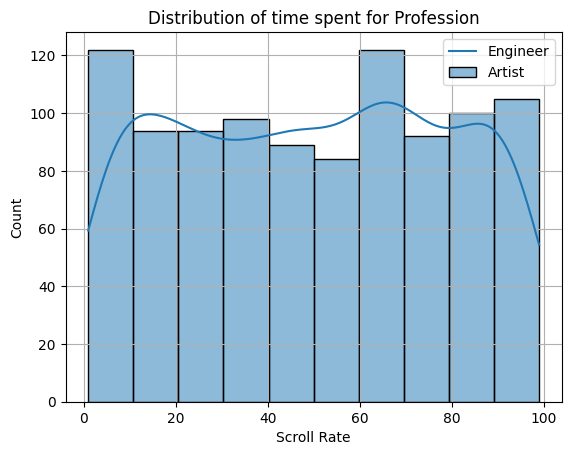

Total Scroll Rate by different groups of Profession
Profession
Artist            1840
Cashier           2894
Engineer          3262
Labor/Worker      9758
Manager           2498
Students         12652
Teacher           1876
Waiting staff     9657
driver            5337
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


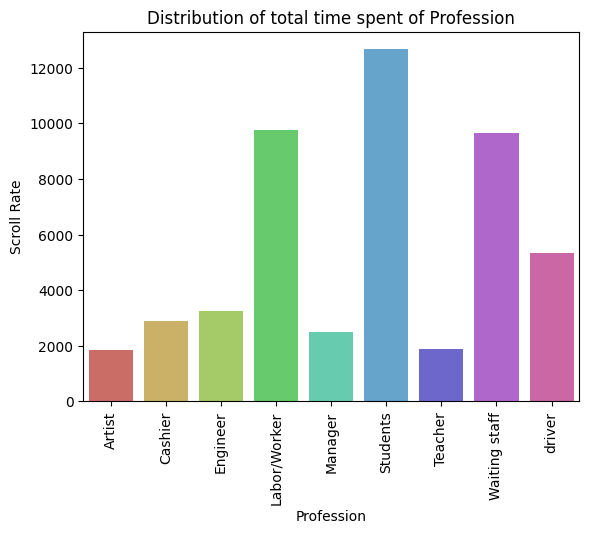

Average Scroll Rate by different groups of Profession
Profession
Artist           39.148936
Cashier          51.678571
Engineer         50.184615
Labor/Worker     52.462366
Manager          46.259259
Students         51.430894
Teacher          48.102564
Waiting staff    49.778351
driver           47.230088
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


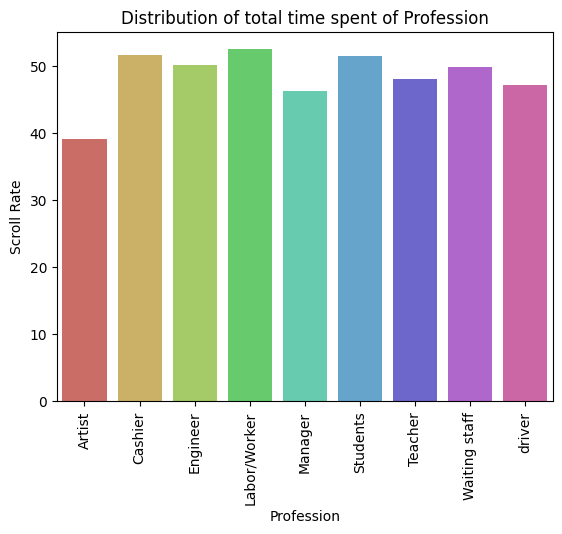

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


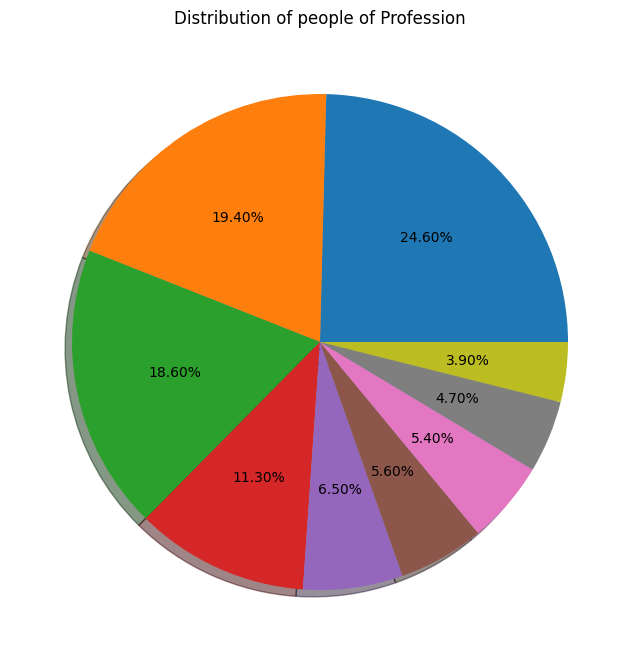

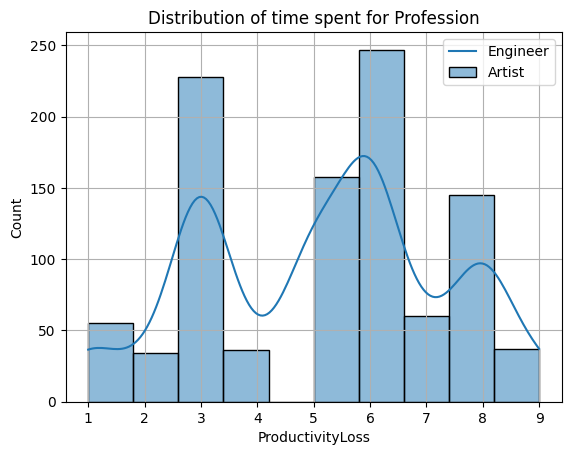

Total ProductivityLoss by different groups of Profession
Profession
Artist            247
Cashier           290
Engineer          334
Labor/Worker      957
Manager           272
Students         1237
Teacher           204
Waiting staff    1031
driver            564
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


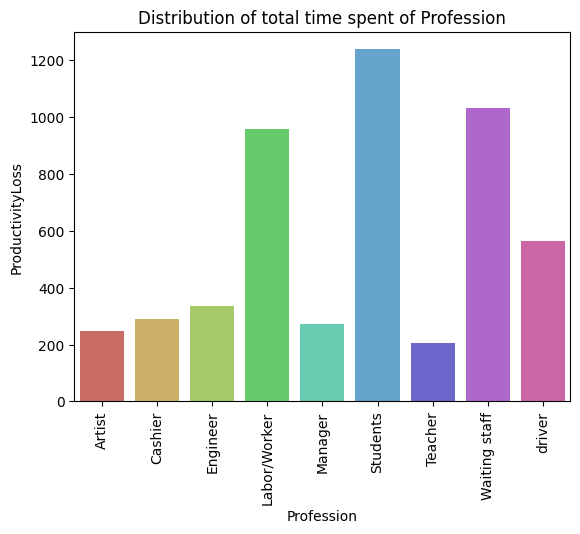

Average ProductivityLoss by different groups of Profession
Profession
Artist           5.255319
Cashier          5.178571
Engineer         5.138462
Labor/Worker     5.145161
Manager          5.037037
Students         5.028455
Teacher          5.230769
Waiting staff    5.314433
driver           4.991150
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


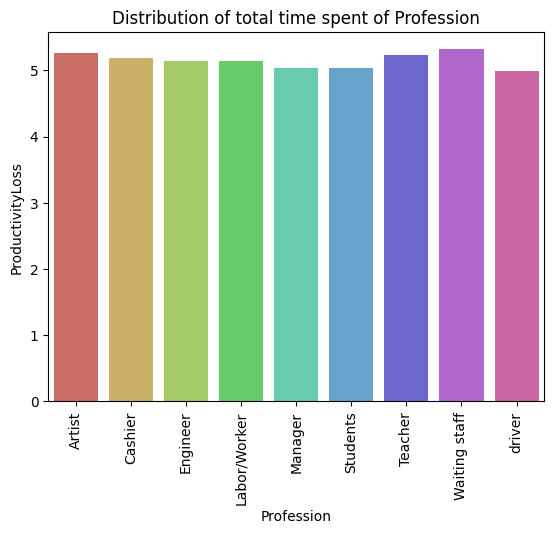

Profession:
Distribution of people of Profession
Profession
Students         24.6
Waiting staff    19.4
Labor/Worker     18.6
driver           11.3
Engineer          6.5
Cashier           5.6
Manager           5.4
Artist            4.7
Teacher           3.9
Name: count, dtype: float64


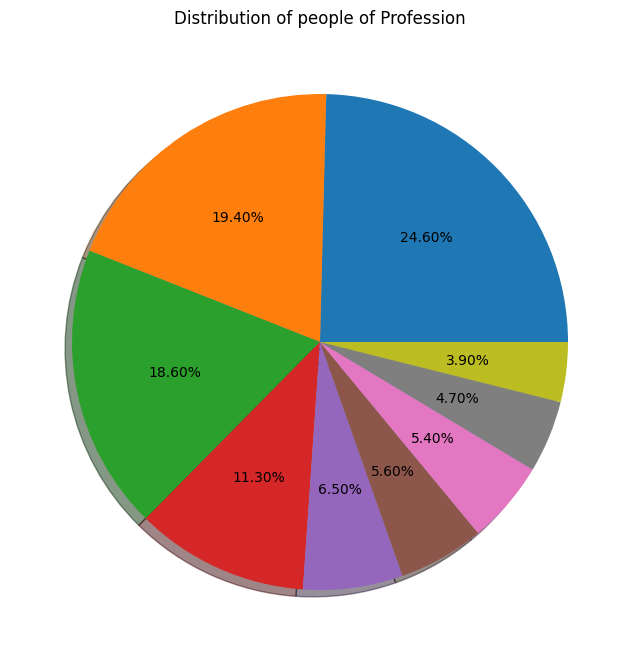

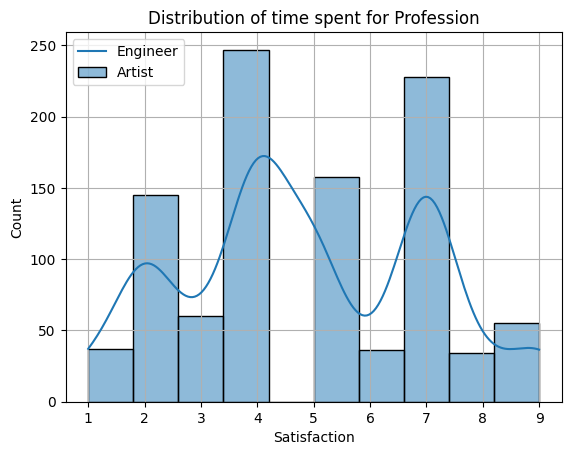

Total Satisfaction by different groups of Profession
Profession
Artist            223
Cashier           270
Engineer          316
Labor/Worker      903
Manager           268
Students         1223
Teacher           186
Waiting staff     909
driver            566
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


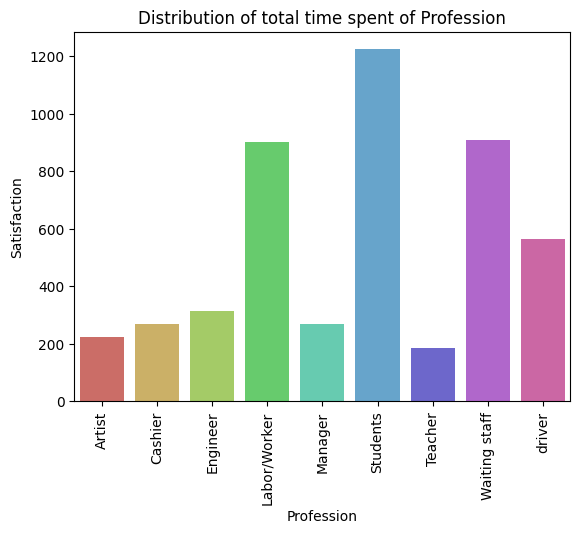

Average Satisfaction by different groups of Profession
Profession
Artist           4.744681
Cashier          4.821429
Engineer         4.861538
Labor/Worker     4.854839
Manager          4.962963
Students         4.971545
Teacher          4.769231
Waiting staff    4.685567
driver           5.008850
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


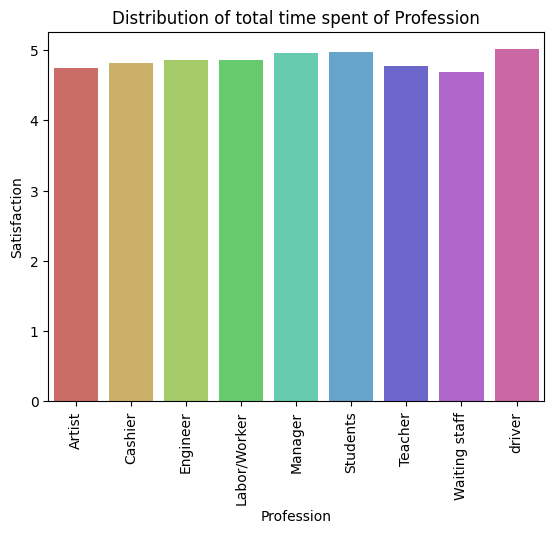

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


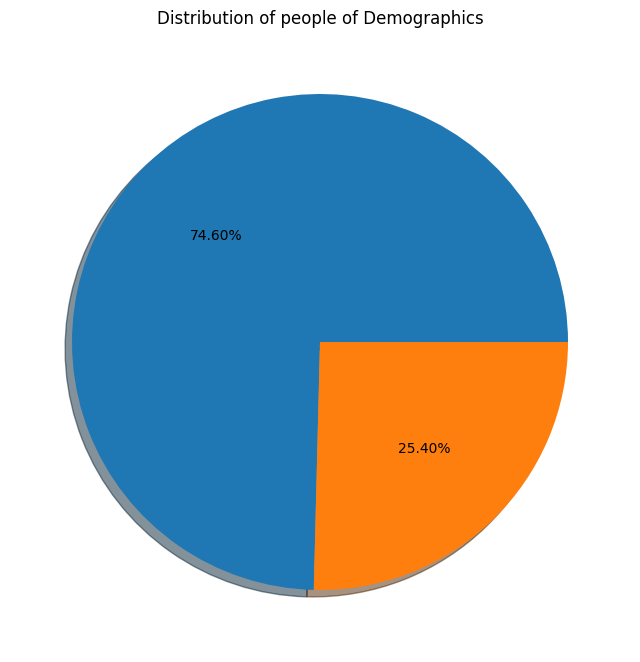

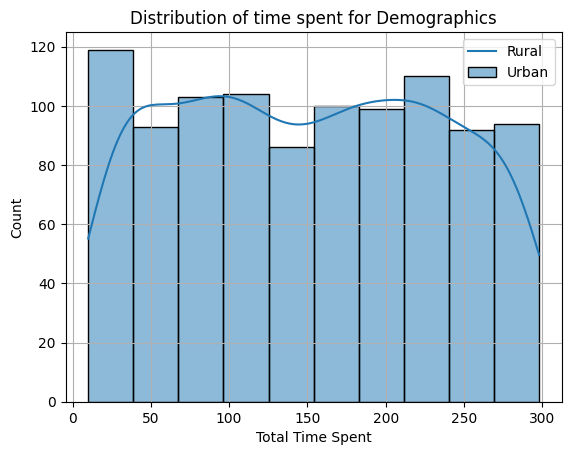

Total Total Time Spent by different groups of Demographics
Demographics
Rural    114978
Urban     36428
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


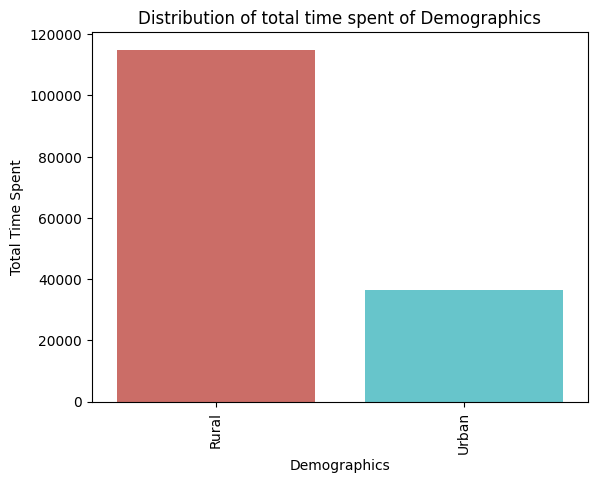

Average Total Time Spent by different groups of Demographics
Demographics
Rural    154.126005
Urban    143.417323
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


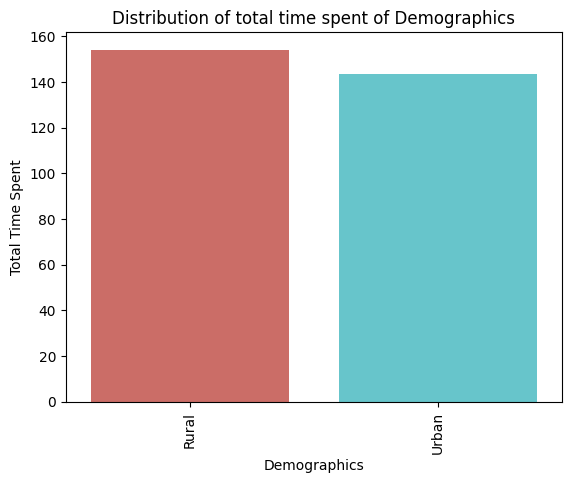

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


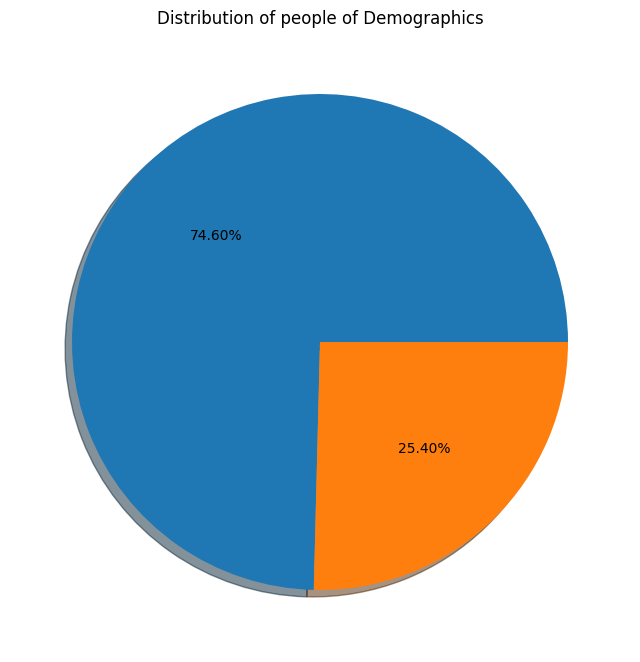

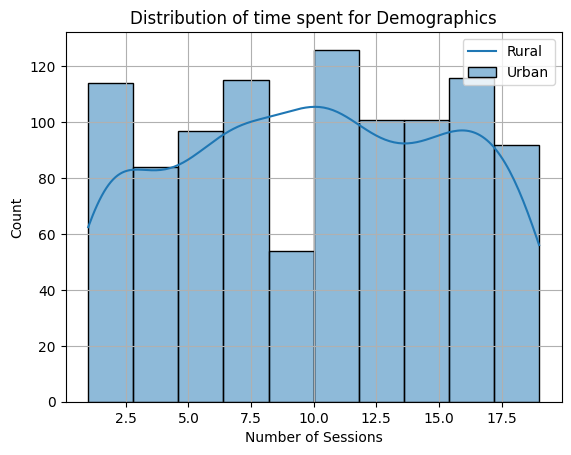

Total Number of Sessions by different groups of Demographics
Demographics
Rural    7404
Urban    2609
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


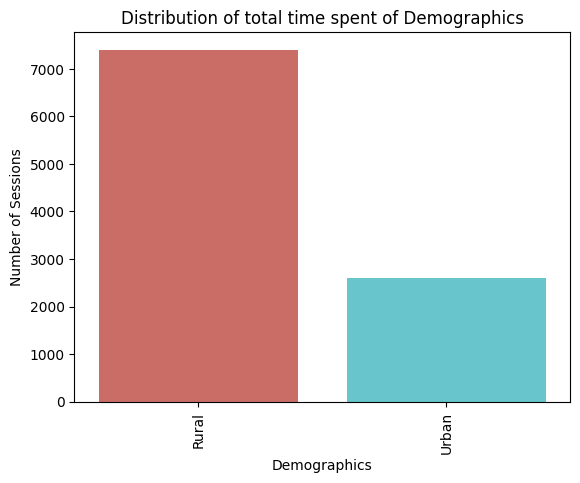

Average Number of Sessions by different groups of Demographics
Demographics
Rural     9.924933
Urban    10.271654
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


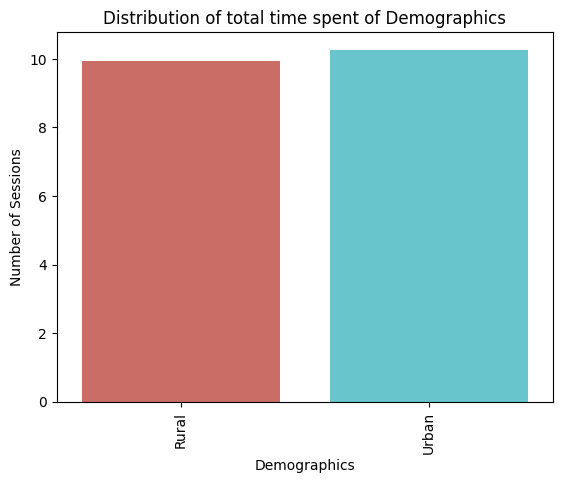

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


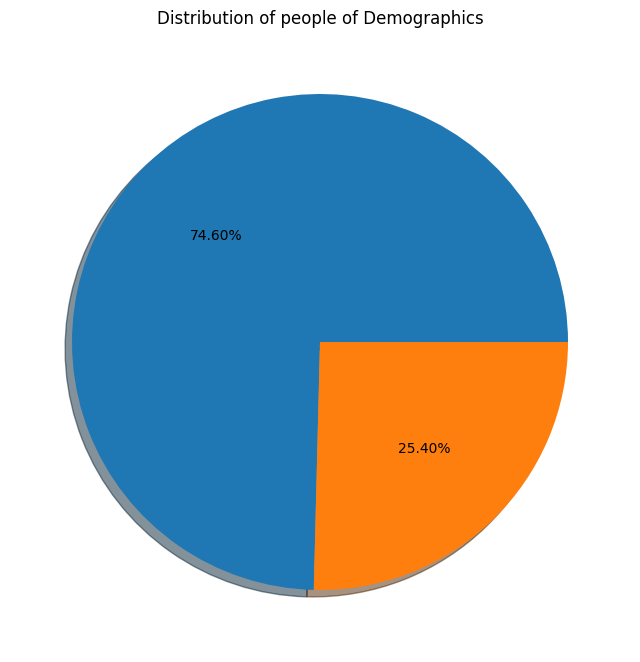

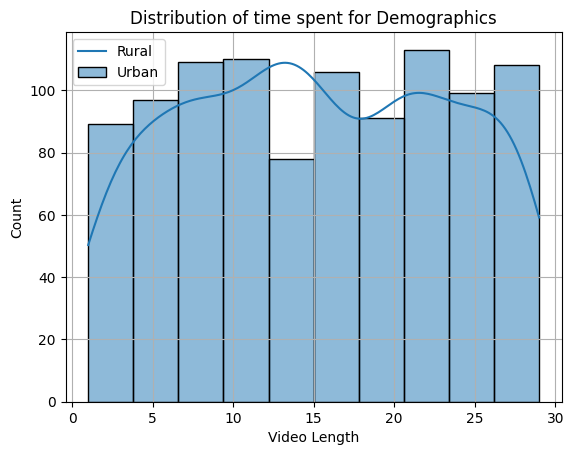

Total Video Length by different groups of Demographics
Demographics
Rural    11294
Urban     3920
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


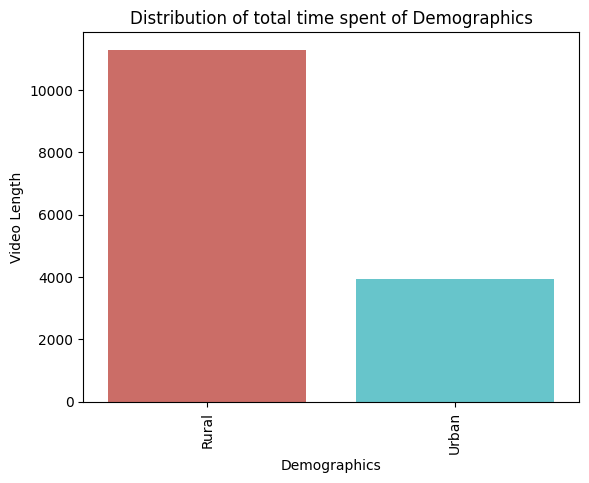

Average Video Length by different groups of Demographics
Demographics
Rural    15.139410
Urban    15.433071
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


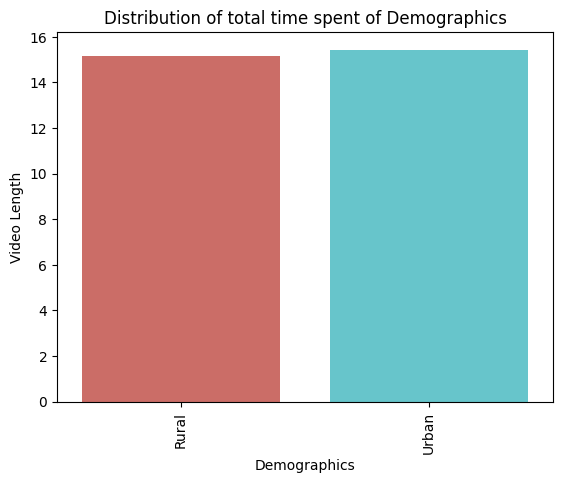

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


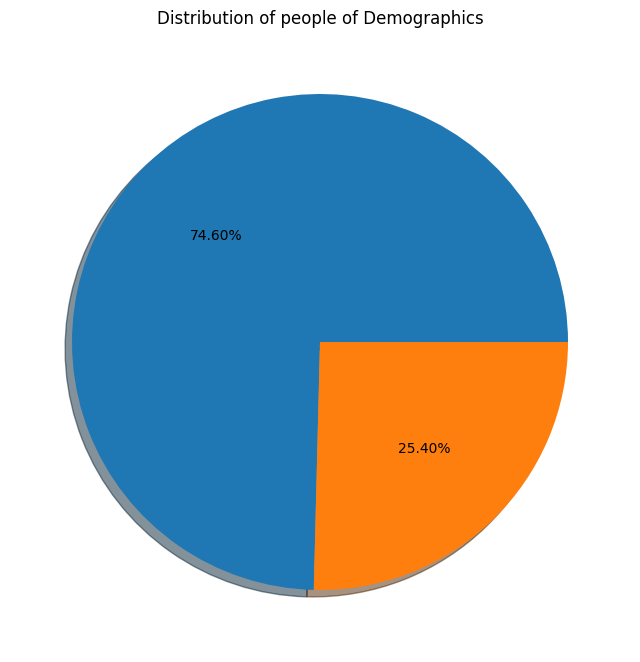

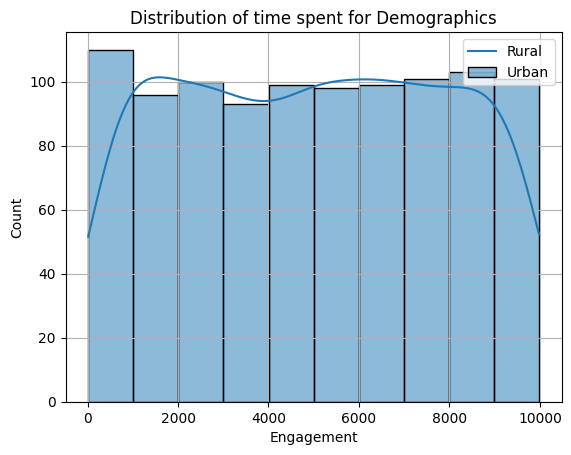

Total Engagement by different groups of Demographics
Demographics
Rural    3690971
Urban    1306188
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


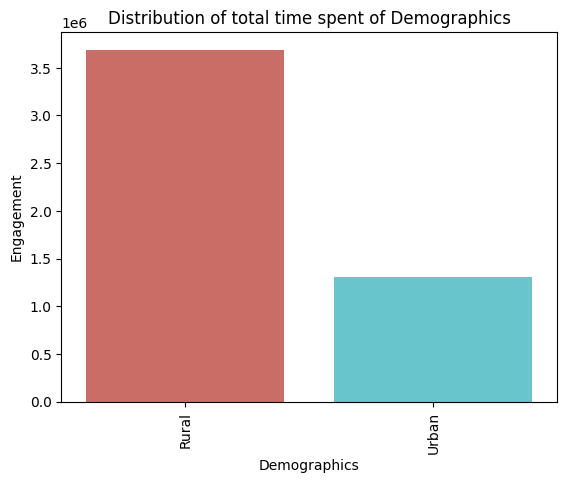

Average Engagement by different groups of Demographics
Demographics
Rural    4947.682306
Urban    5142.472441
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


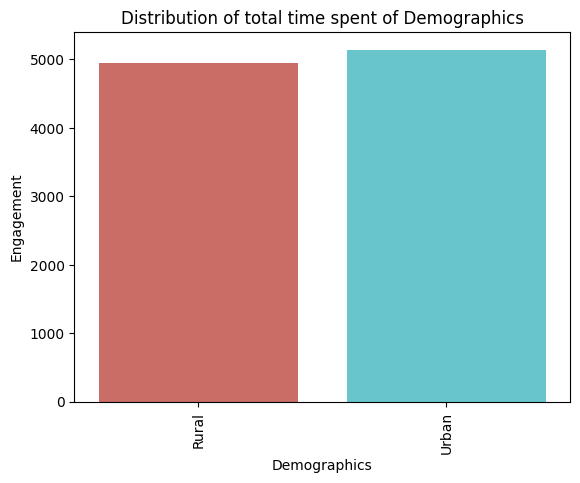

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


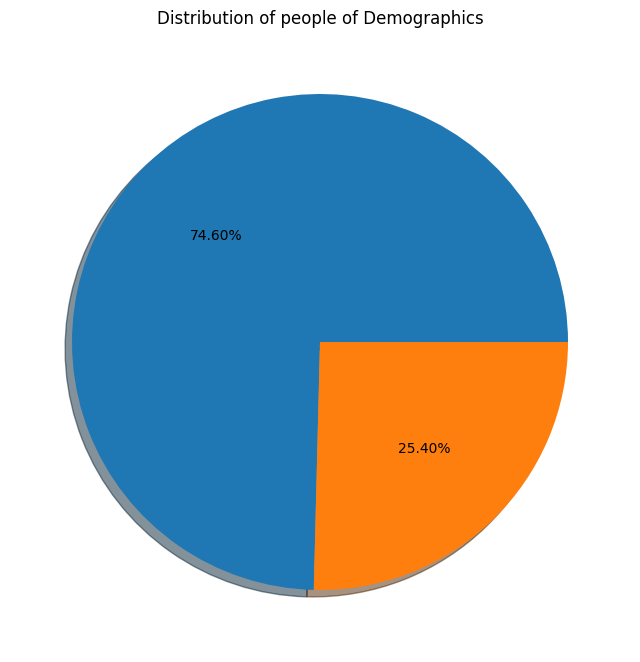

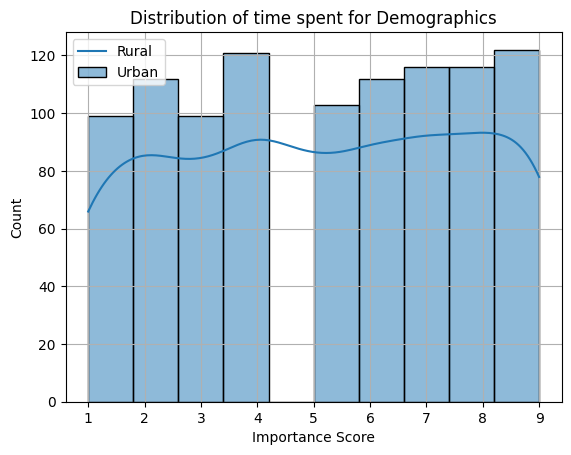

Total Importance Score by different groups of Demographics
Demographics
Rural    3812
Urban    1317
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


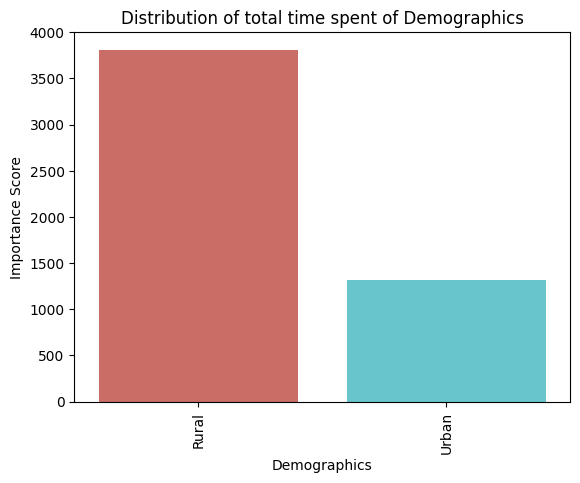

Average Importance Score by different groups of Demographics
Demographics
Rural    5.109920
Urban    5.185039
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


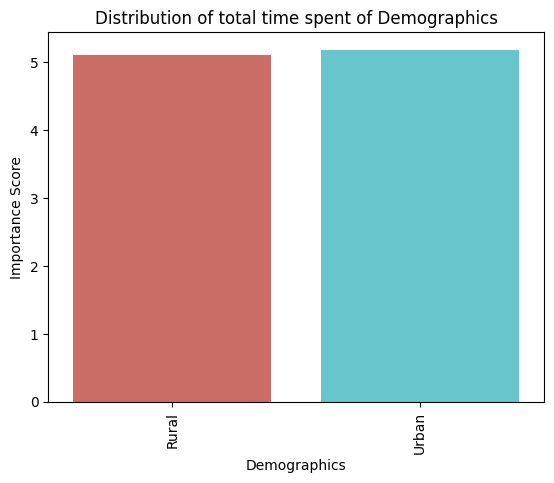

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


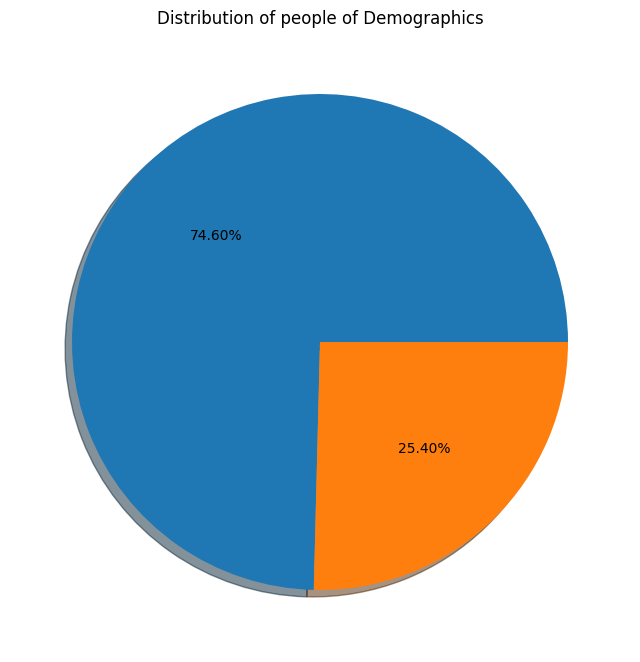

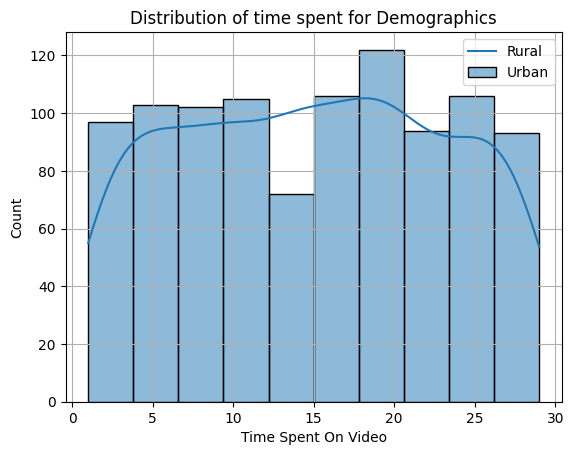

Total Time Spent On Video by different groups of Demographics
Demographics
Rural    11245
Urban     3728
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


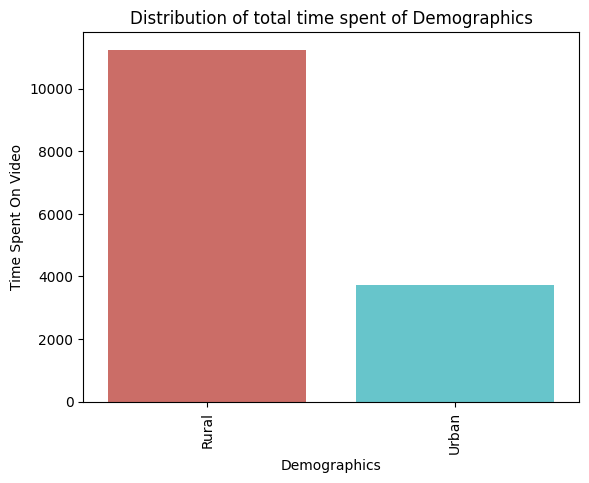

Average Time Spent On Video by different groups of Demographics
Demographics
Rural    15.073727
Urban    14.677165
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


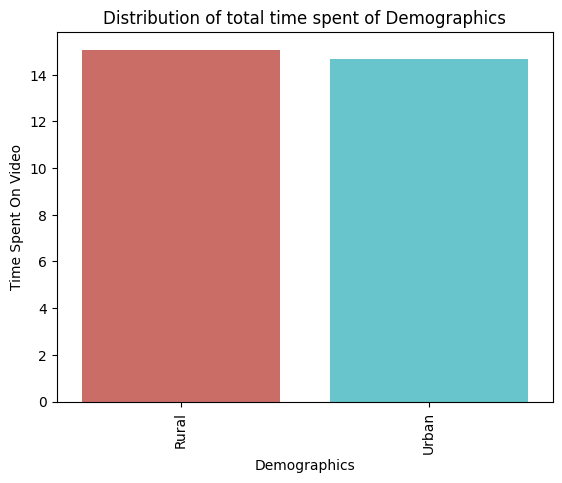

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


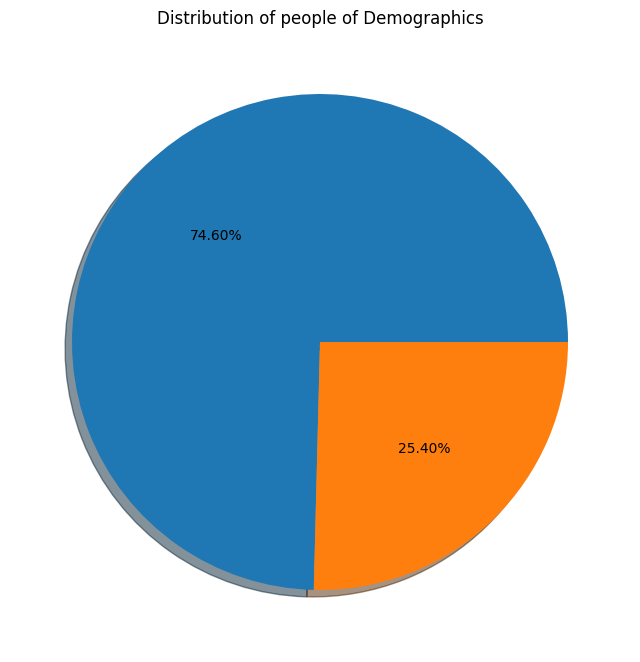

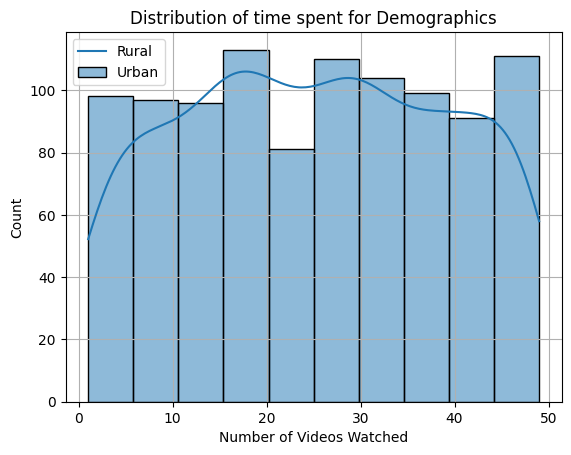

Total Number of Videos Watched by different groups of Demographics
Demographics
Rural    19014
Urban     6234
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


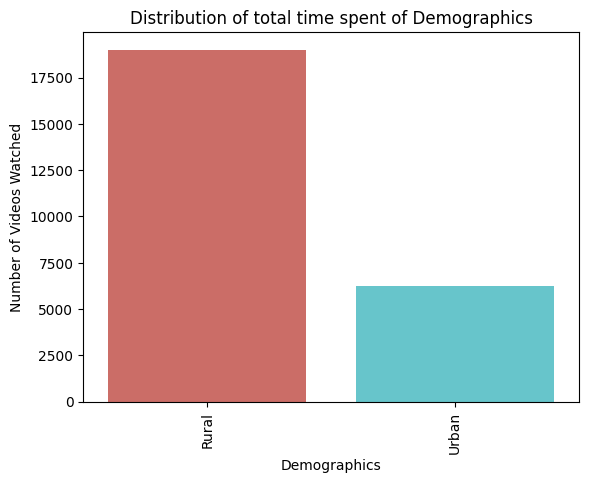

Average Number of Videos Watched by different groups of Demographics
Demographics
Rural    25.487936
Urban    24.543307
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


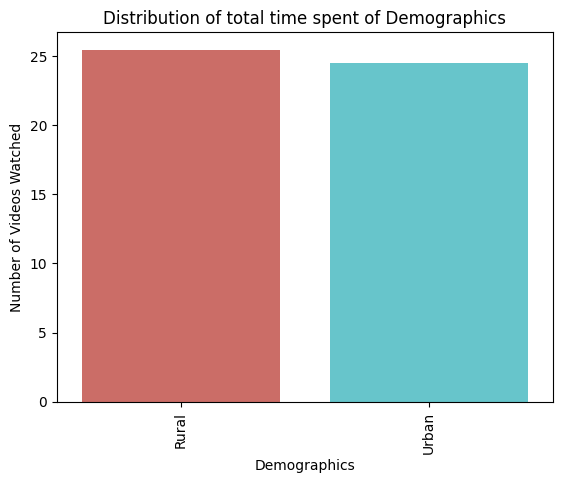

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


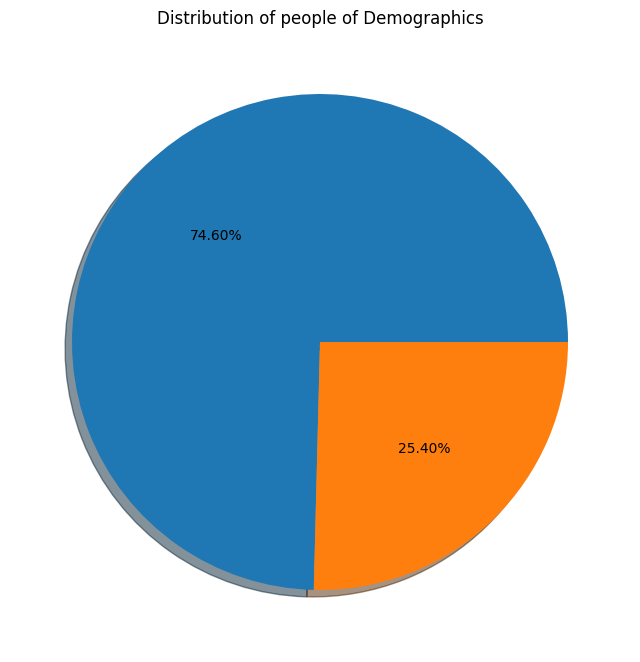

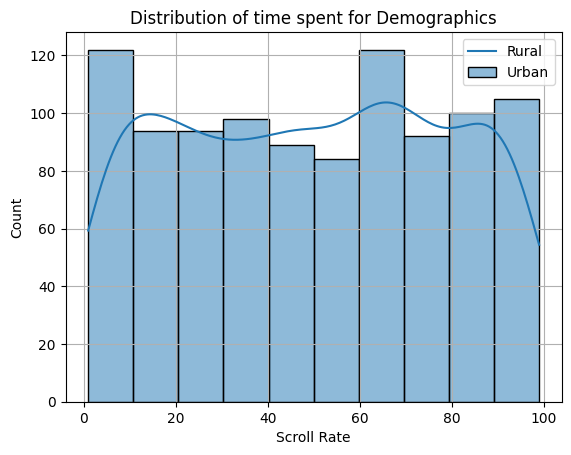

Total Scroll Rate by different groups of Demographics
Demographics
Rural    37394
Urban    12380
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


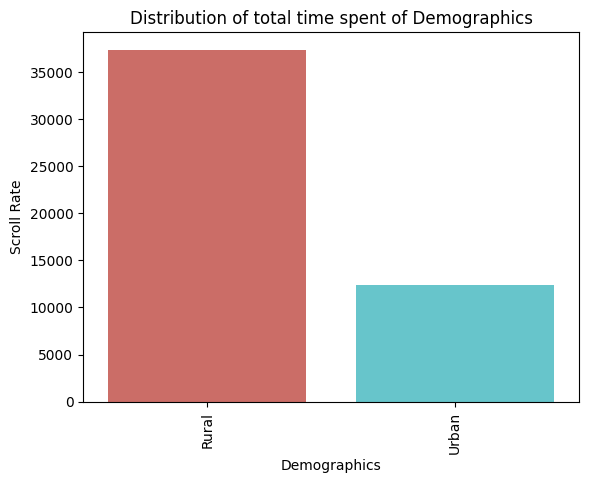

Average Scroll Rate by different groups of Demographics
Demographics
Rural    50.126005
Urban    48.740157
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


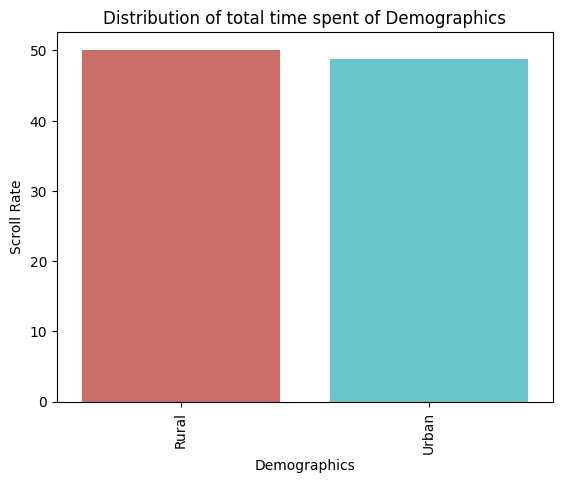

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


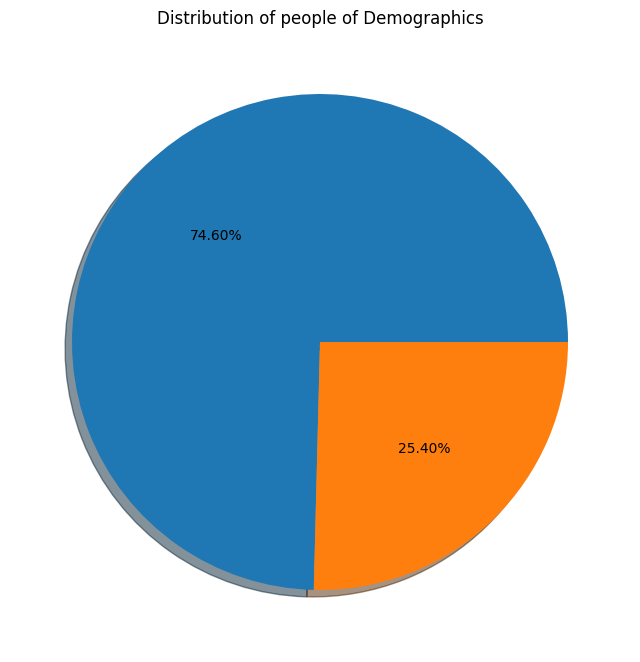

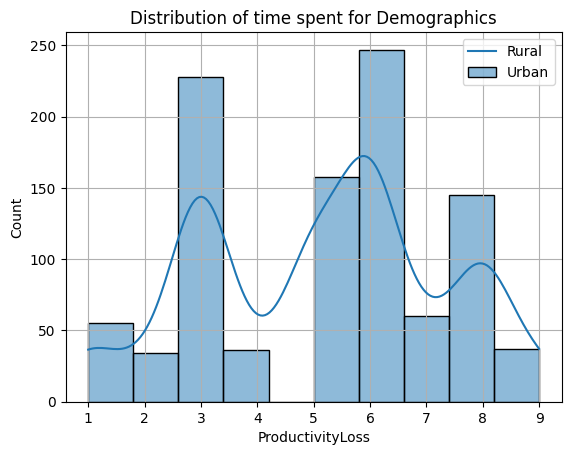

Total ProductivityLoss by different groups of Demographics
Demographics
Rural    3826
Urban    1310
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


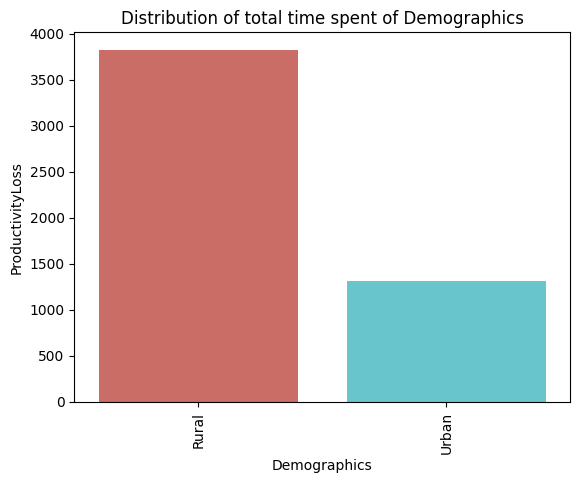

Average ProductivityLoss by different groups of Demographics
Demographics
Rural    5.128686
Urban    5.157480
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


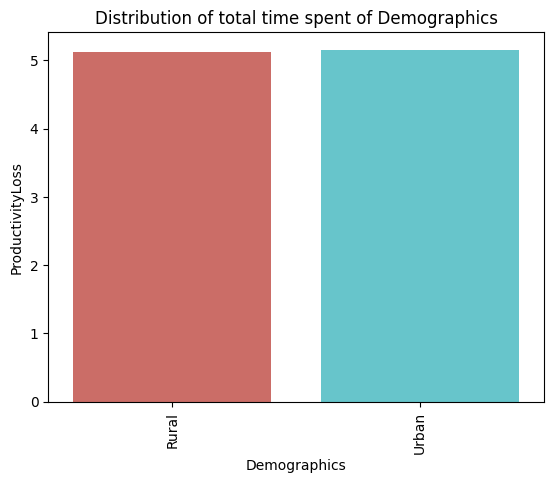

Demographics:
Distribution of people of Demographics
Demographics
Rural    74.6
Urban    25.4
Name: count, dtype: float64


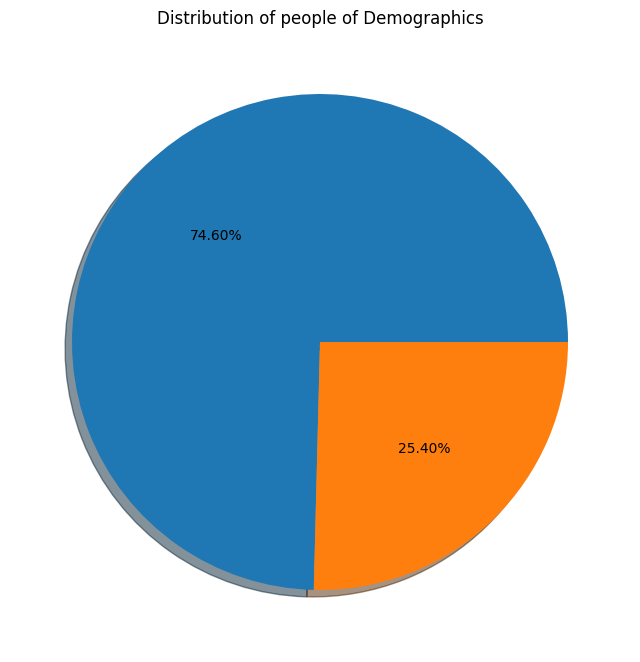

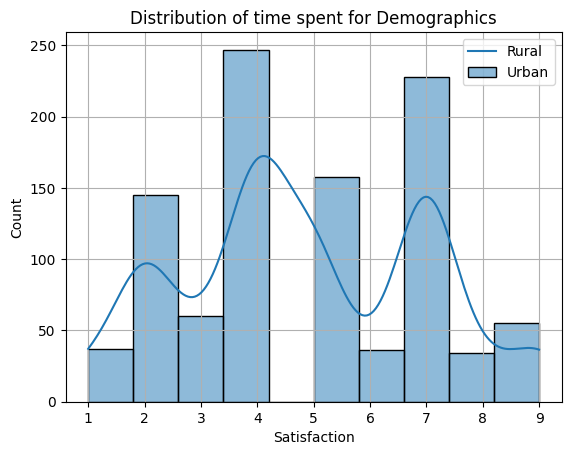

Total Satisfaction by different groups of Demographics
Demographics
Rural    3634
Urban    1230
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


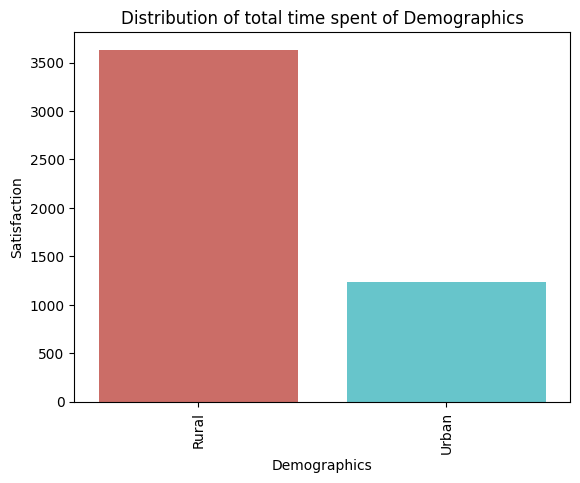

Average Satisfaction by different groups of Demographics
Demographics
Rural    4.871314
Urban    4.842520
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


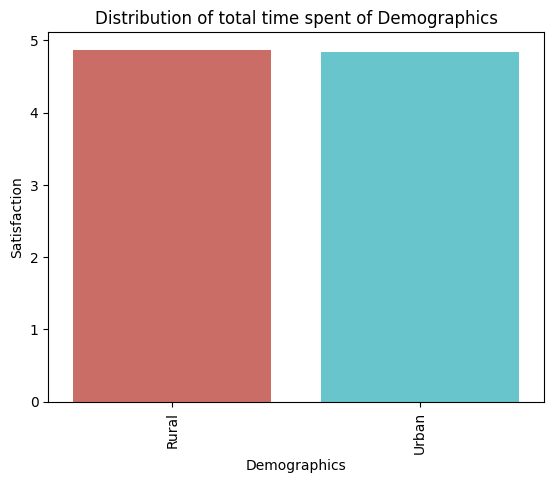

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


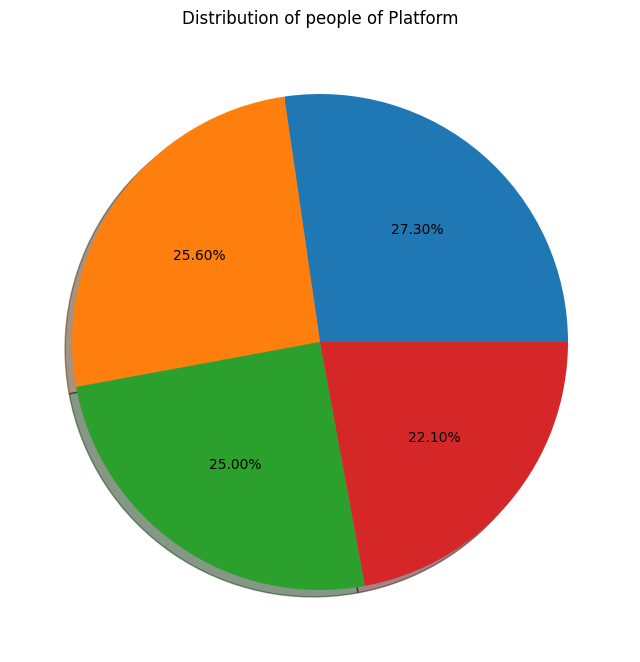

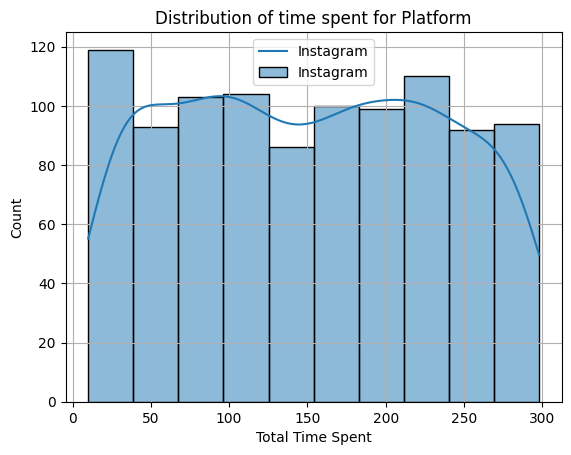

Total Total Time Spent by different groups of Platform
Platform
Facebook     34295
Instagram    37609
TikTok       41297
YouTube      38205
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


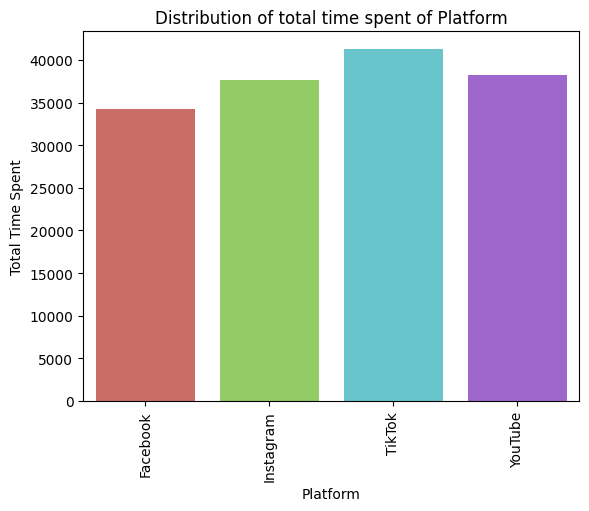

Average Total Time Spent by different groups of Platform
Platform
Facebook     155.180995
Instagram    146.910156
TikTok       151.271062
YouTube      152.820000
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


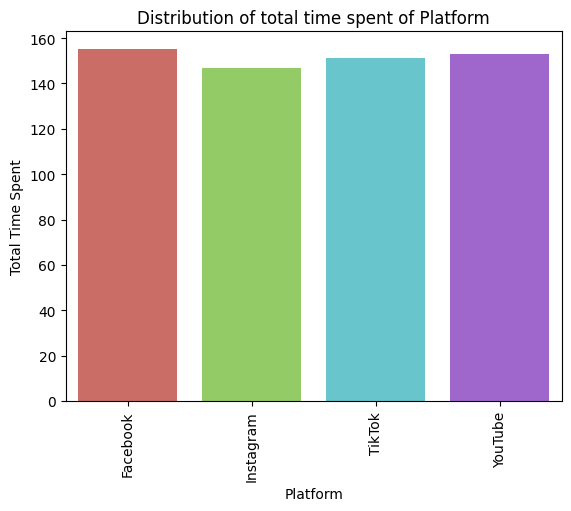

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


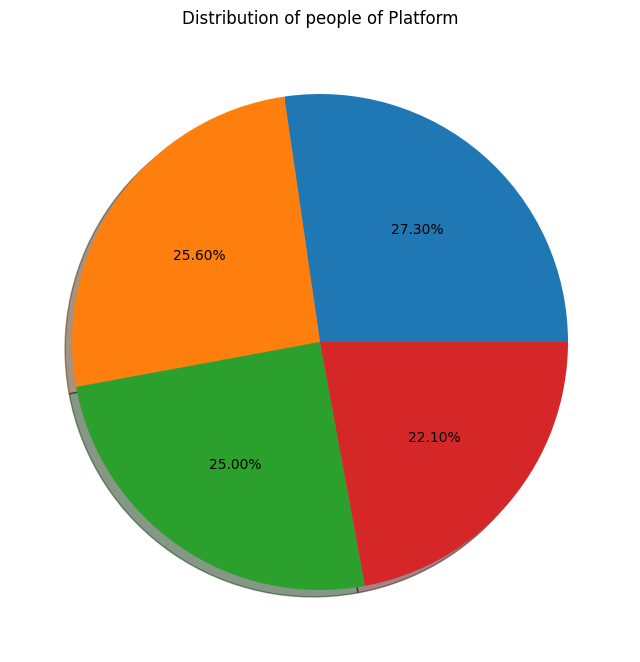

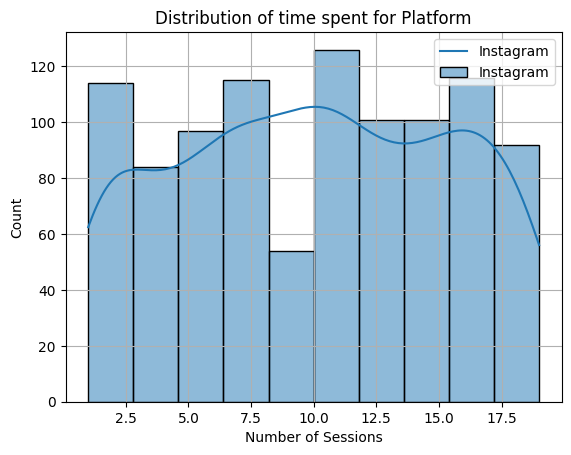

Total Number of Sessions by different groups of Platform
Platform
Facebook     2185
Instagram    2576
TikTok       2735
YouTube      2517
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


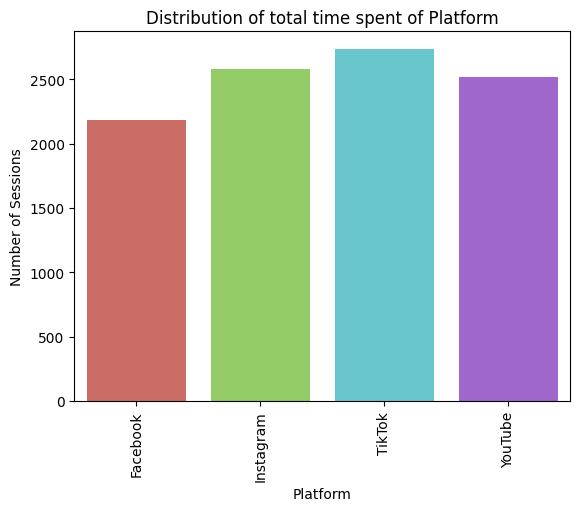

Average Number of Sessions by different groups of Platform
Platform
Facebook      9.886878
Instagram    10.062500
TikTok       10.018315
YouTube      10.068000
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


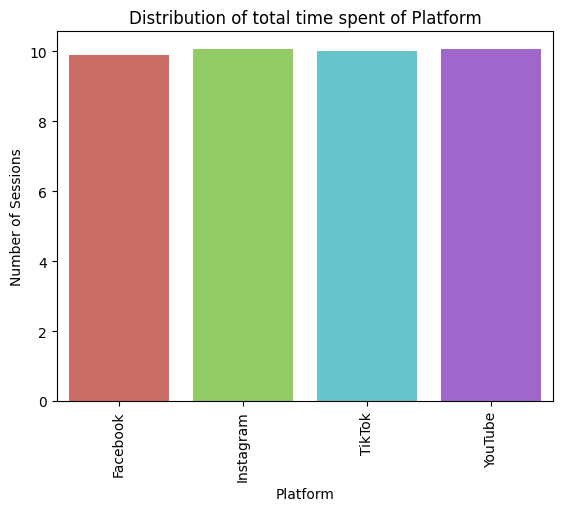

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


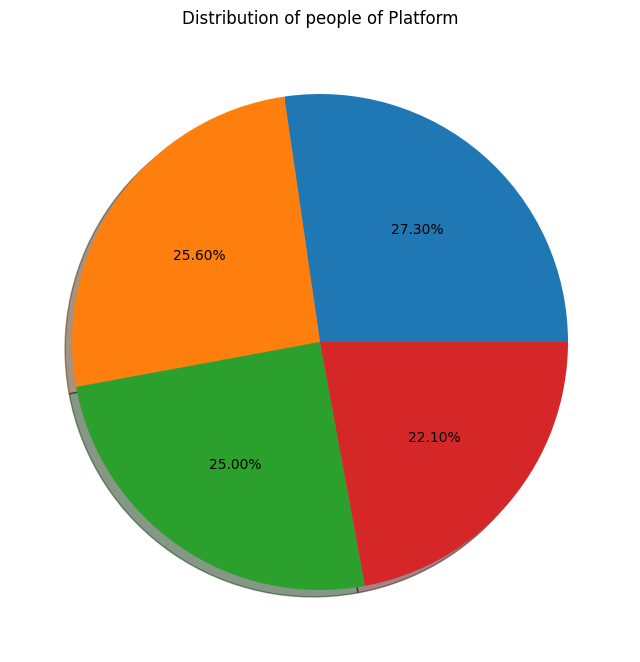

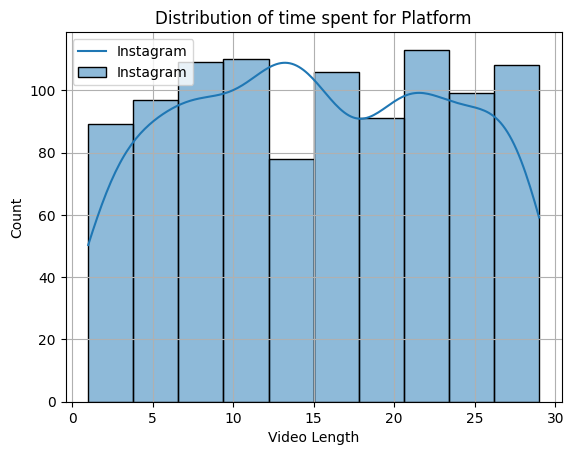

Total Video Length by different groups of Platform
Platform
Facebook     3384
Instagram    3973
TikTok       4038
YouTube      3819
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


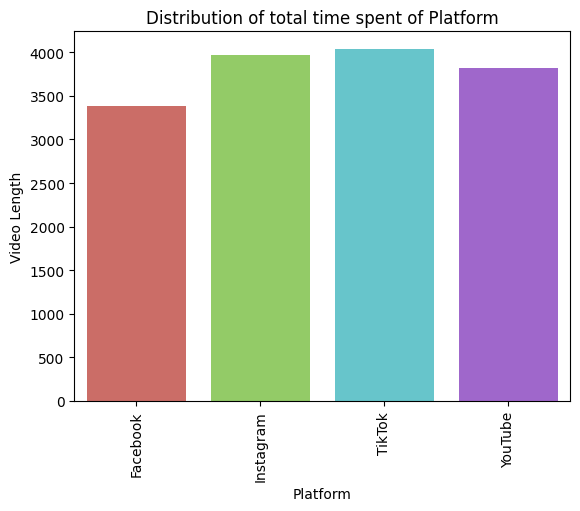

Average Video Length by different groups of Platform
Platform
Facebook     15.312217
Instagram    15.519531
TikTok       14.791209
YouTube      15.276000
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


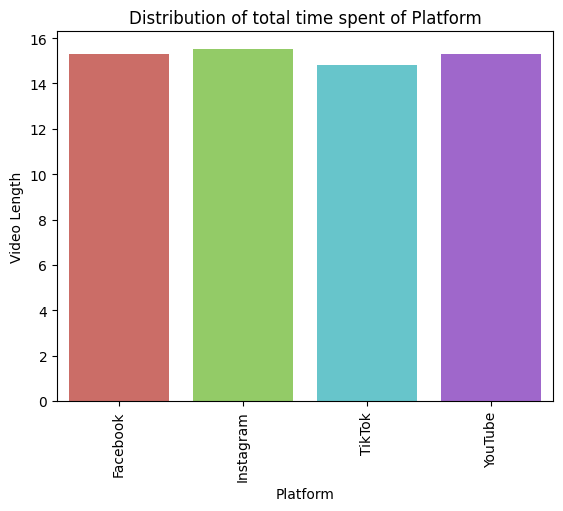

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


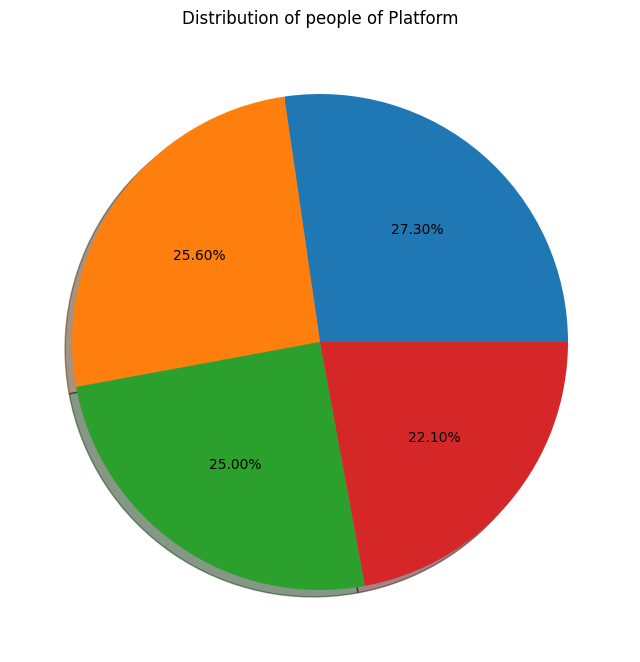

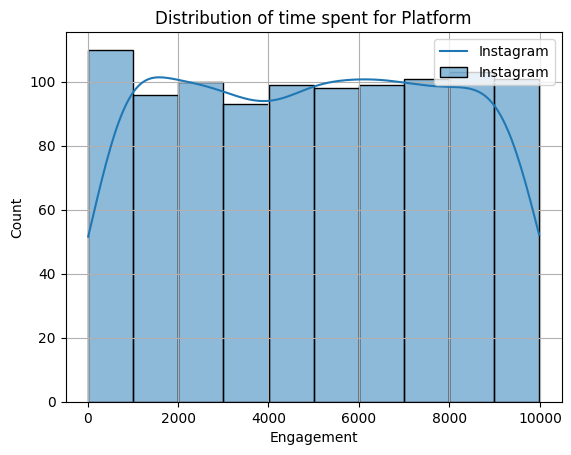

Total Engagement by different groups of Platform
Platform
Facebook     1155449
Instagram    1303255
TikTok       1321865
YouTube      1216590
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


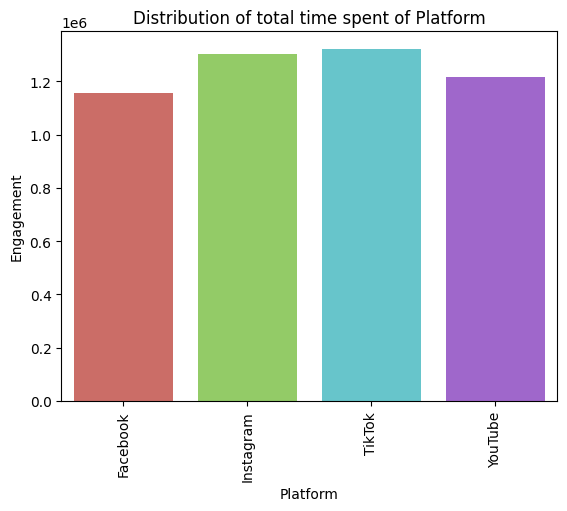

Average Engagement by different groups of Platform
Platform
Facebook     5228.276018
Instagram    5090.839844
TikTok       4841.996337
YouTube      4866.360000
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


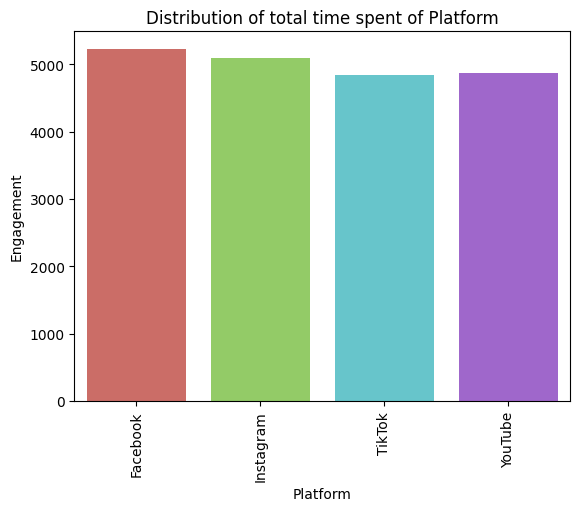

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


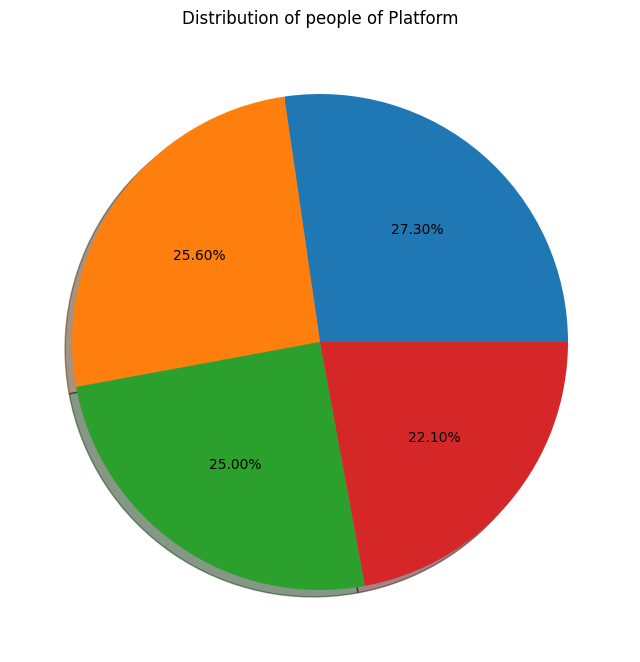

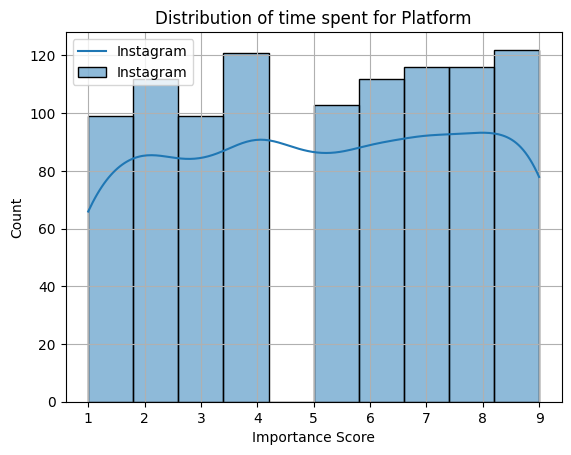

Total Importance Score by different groups of Platform
Platform
Facebook     1162
Instagram    1296
TikTok       1415
YouTube      1256
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


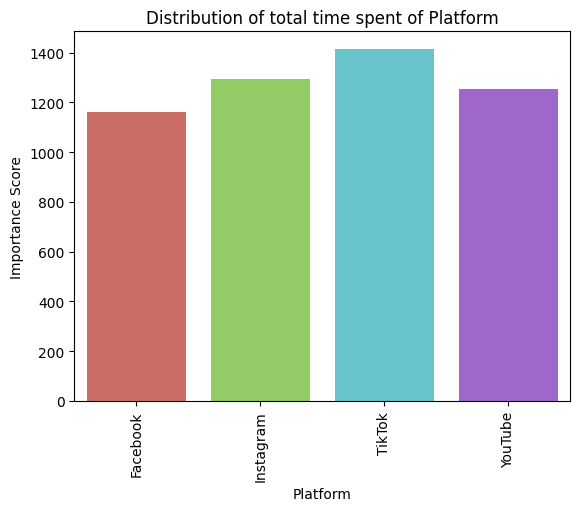

Average Importance Score by different groups of Platform
Platform
Facebook     5.257919
Instagram    5.062500
TikTok       5.183150
YouTube      5.024000
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


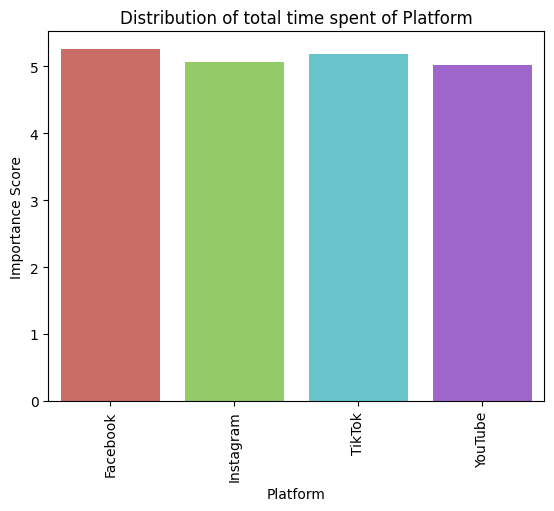

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


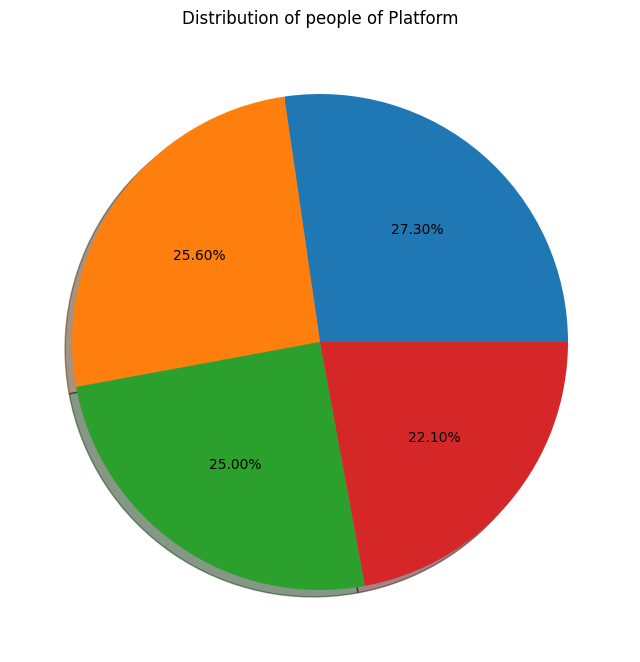

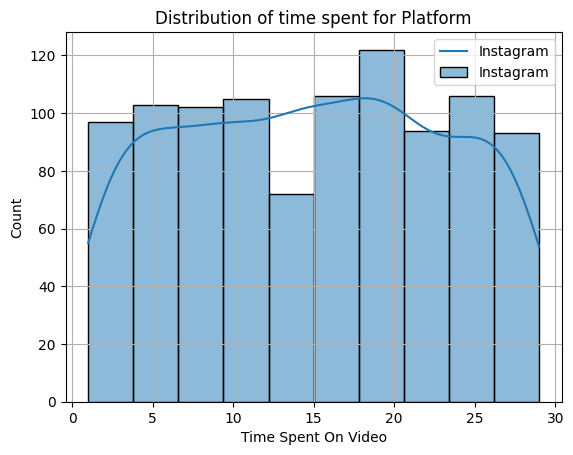

Total Time Spent On Video by different groups of Platform
Platform
Facebook     3230
Instagram    3783
TikTok       4142
YouTube      3818
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


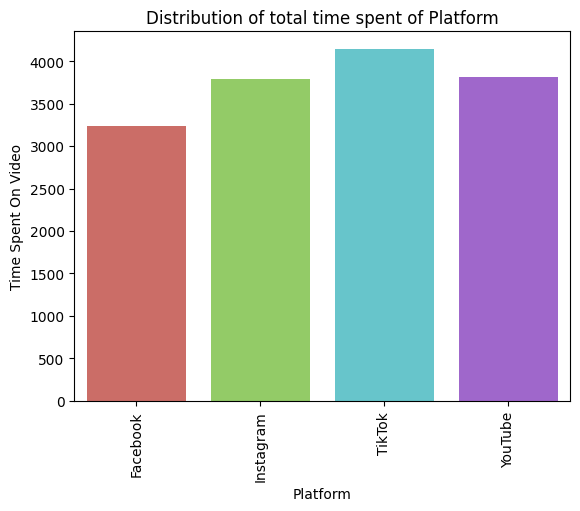

Average Time Spent On Video by different groups of Platform
Platform
Facebook     14.615385
Instagram    14.777344
TikTok       15.172161
YouTube      15.272000
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


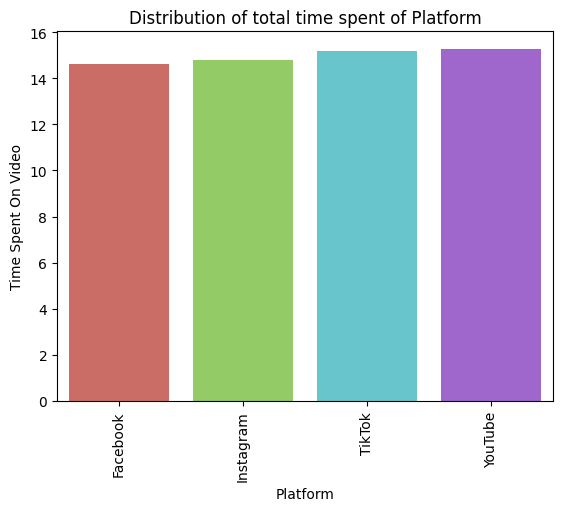

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


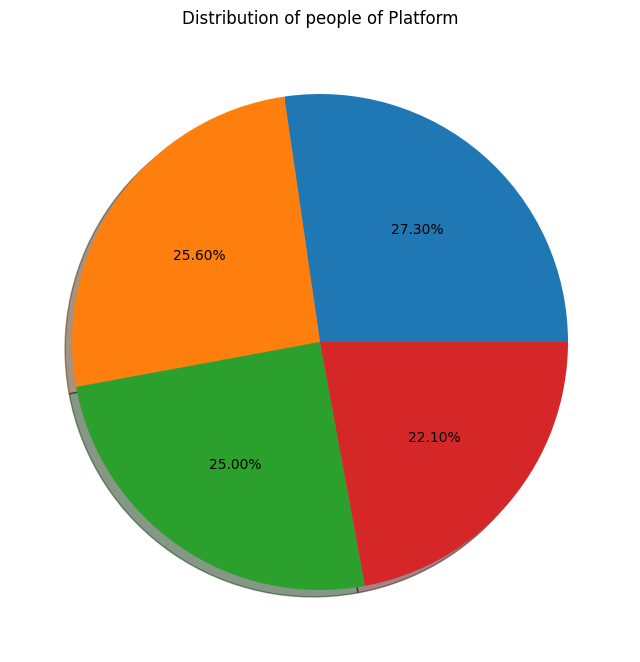

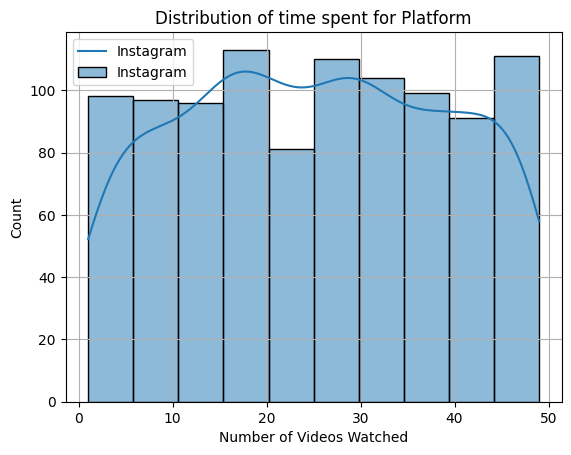

Total Number of Videos Watched by different groups of Platform
Platform
Facebook     5337
Instagram    6778
TikTok       6733
YouTube      6400
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


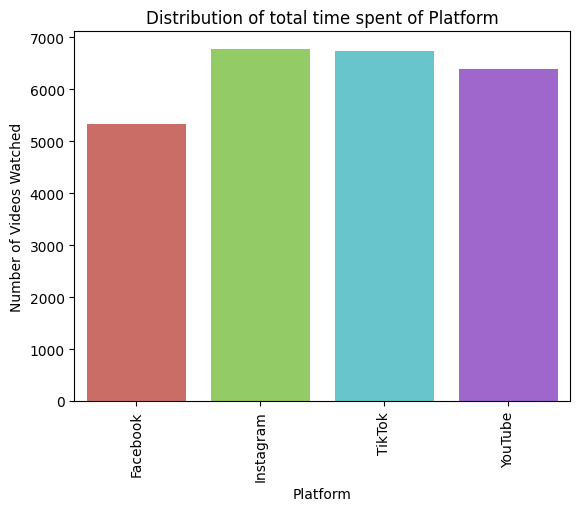

Average Number of Videos Watched by different groups of Platform
Platform
Facebook     24.149321
Instagram    26.476562
TikTok       24.663004
YouTube      25.600000
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


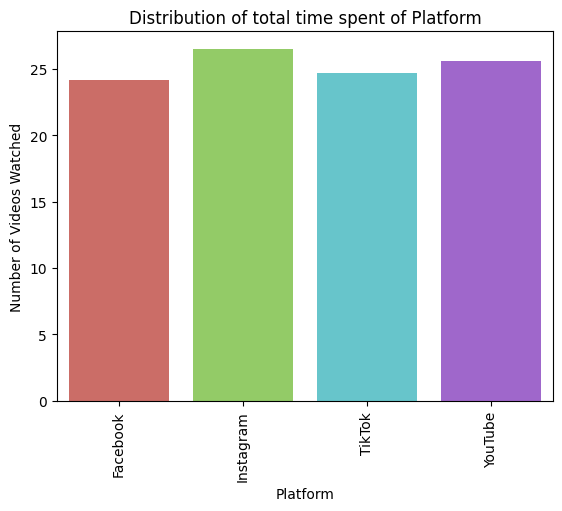

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


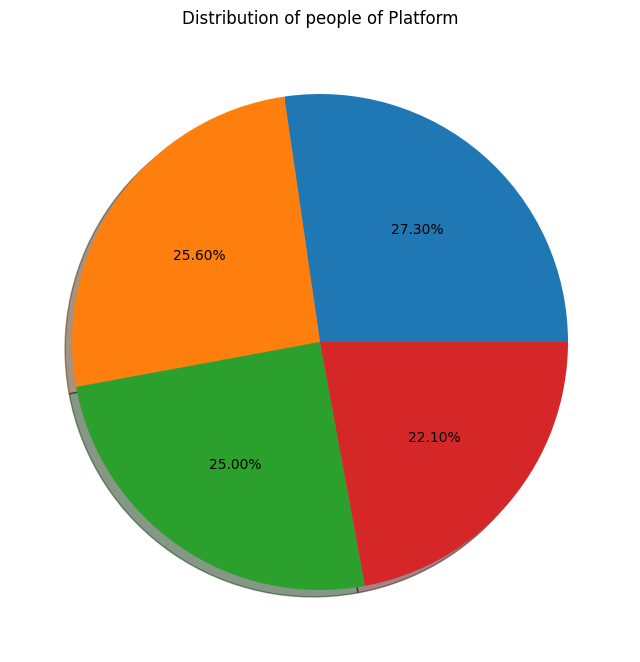

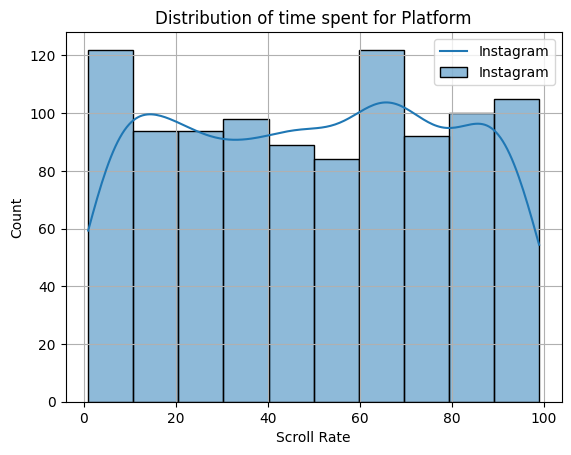

Total Scroll Rate by different groups of Platform
Platform
Facebook     10336
Instagram    13371
TikTok       13730
YouTube      12337
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


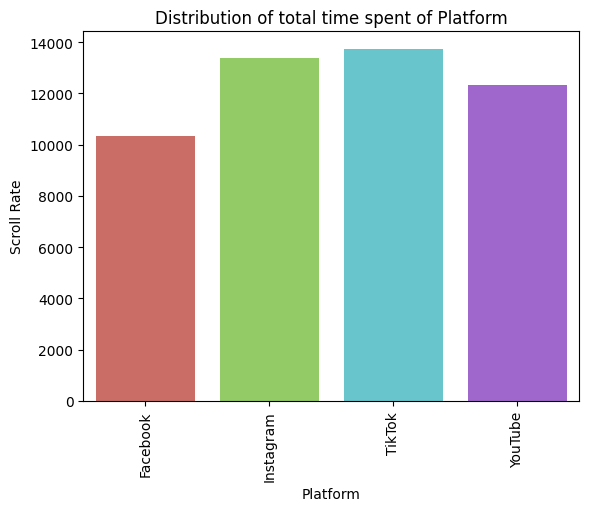

Average Scroll Rate by different groups of Platform
Platform
Facebook     46.769231
Instagram    52.230469
TikTok       50.293040
YouTube      49.348000
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


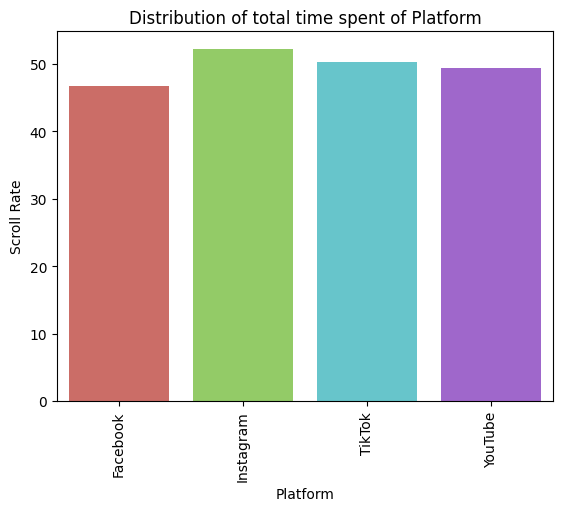

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


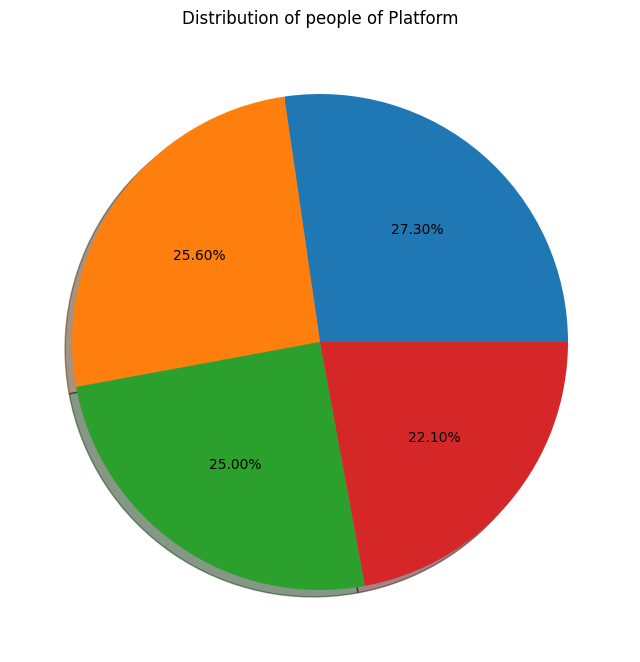

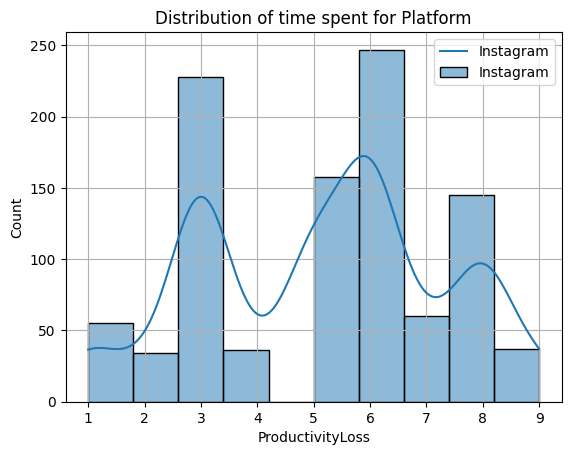

Total ProductivityLoss by different groups of Platform
Platform
Facebook     1120
Instagram    1300
TikTok       1402
YouTube      1314
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


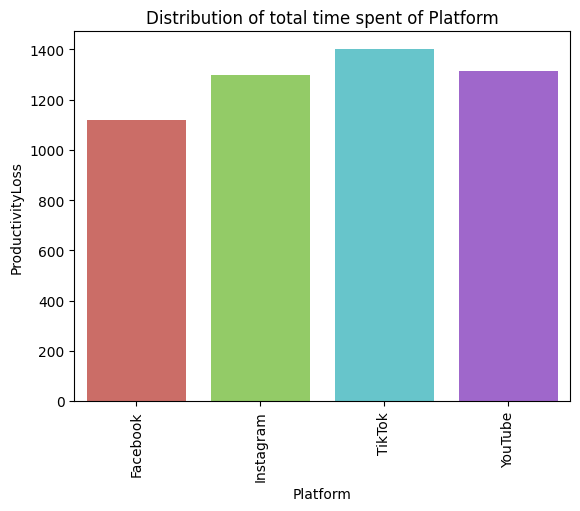

Average ProductivityLoss by different groups of Platform
Platform
Facebook     5.067873
Instagram    5.078125
TikTok       5.135531
YouTube      5.256000
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


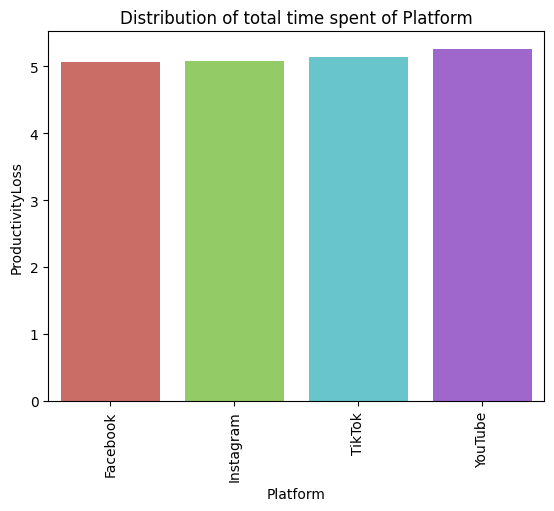

Platform:
Distribution of people of Platform
Platform
TikTok       27.3
Instagram    25.6
YouTube      25.0
Facebook     22.1
Name: count, dtype: float64


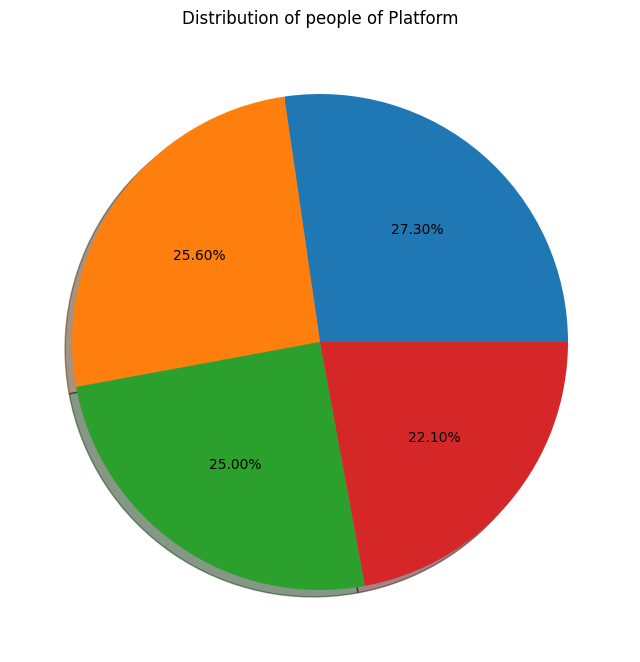

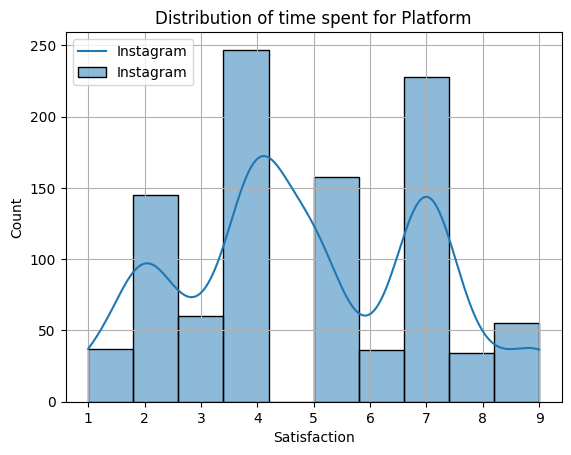

Total Satisfaction by different groups of Platform
Platform
Facebook     1090
Instagram    1260
TikTok       1328
YouTube      1186
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


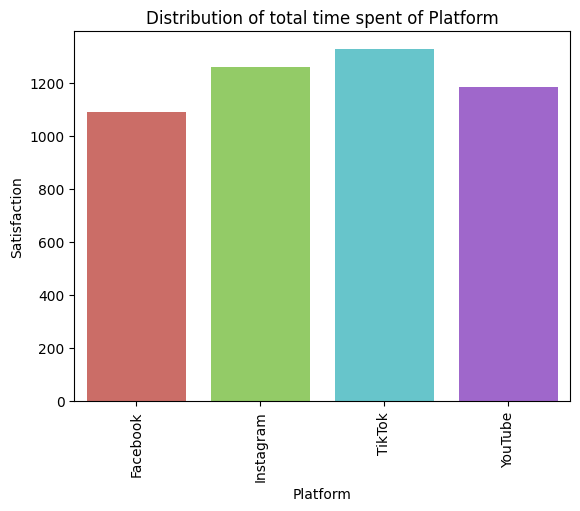

Average Satisfaction by different groups of Platform
Platform
Facebook     4.932127
Instagram    4.921875
TikTok       4.864469
YouTube      4.744000
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


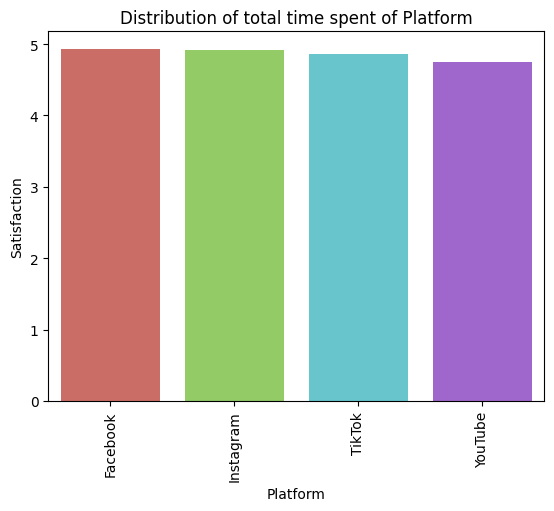

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


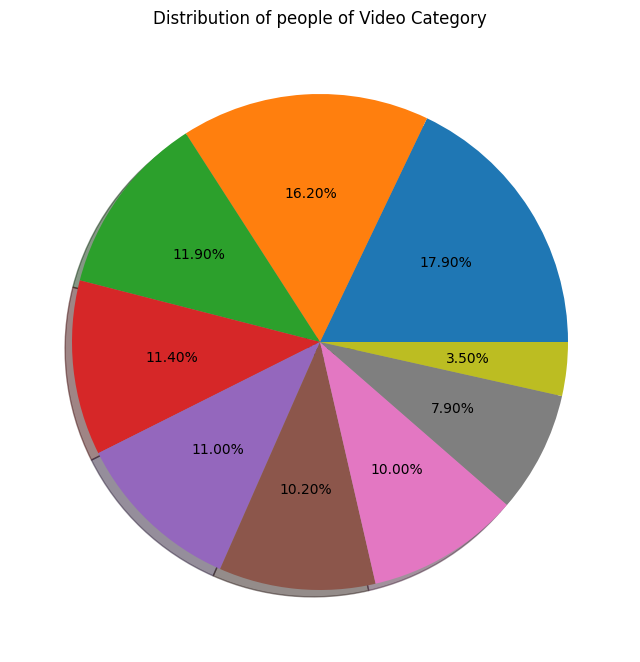

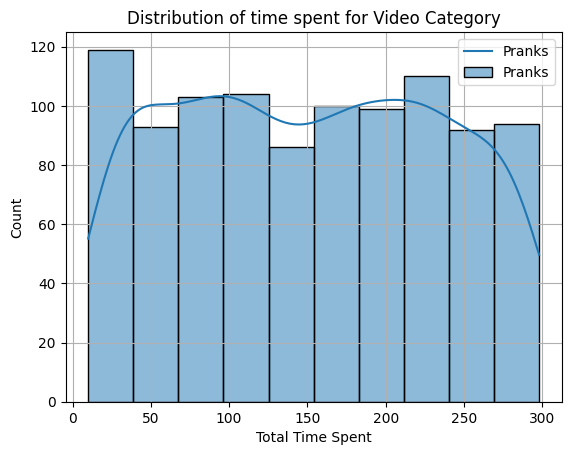

Total Total Time Spent by different groups of Video Category
Video Category
ASMR             12307
Comedy            5597
Entertainment    15330
Gaming           18423
Jokes/Memes      27129
Life Hacks       24422
Pranks           16268
Trends           14753
Vlogs            17177
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


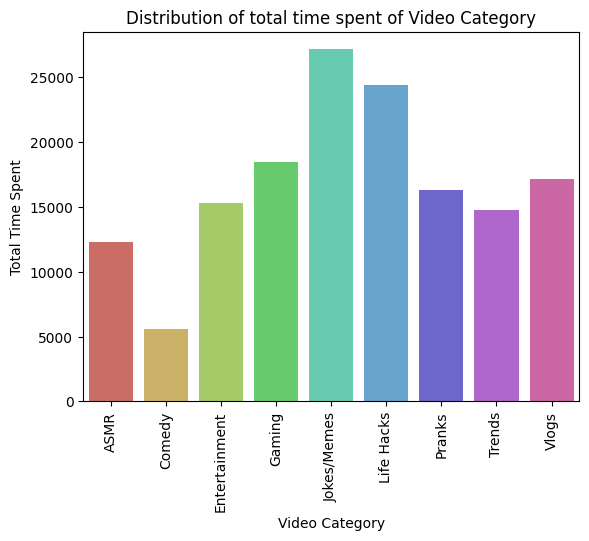

Average Total Time Spent by different groups of Video Category
Video Category
ASMR             155.784810
Comedy           159.914286
Entertainment    150.294118
Gaming           154.815126
Jokes/Memes      151.558659
Life Hacks       150.753086
Pranks           147.890909
Trends           147.530000
Vlogs            150.675439
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


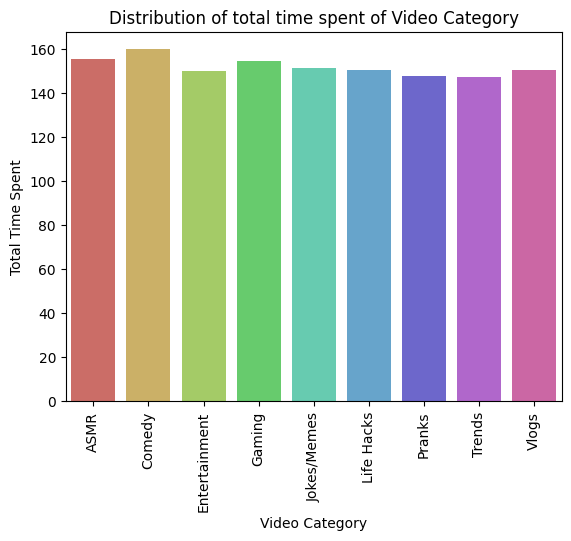

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


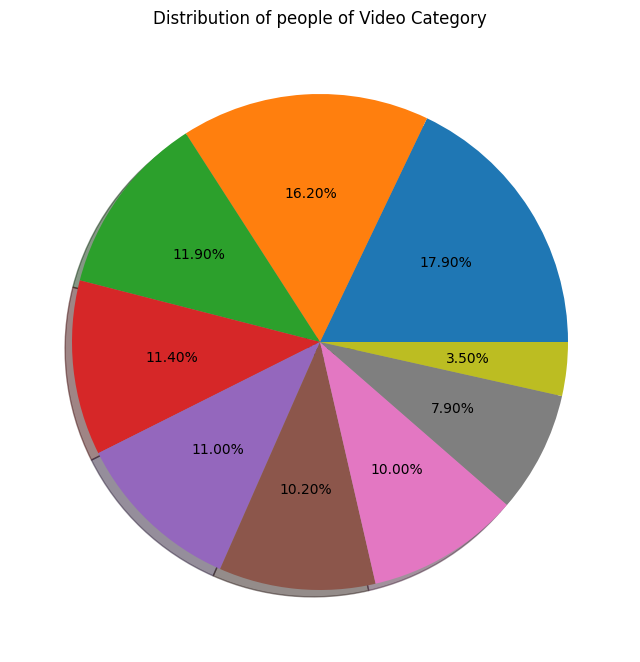

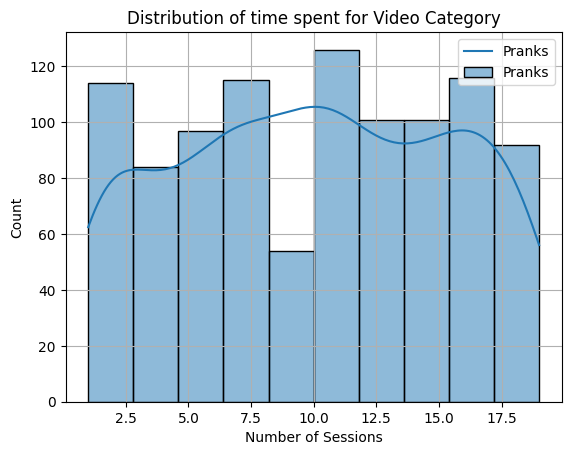

Total Number of Sessions by different groups of Video Category
Video Category
ASMR              747
Comedy            389
Entertainment     982
Gaming           1189
Jokes/Memes      1847
Life Hacks       1527
Pranks           1211
Trends           1006
Vlogs            1115
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


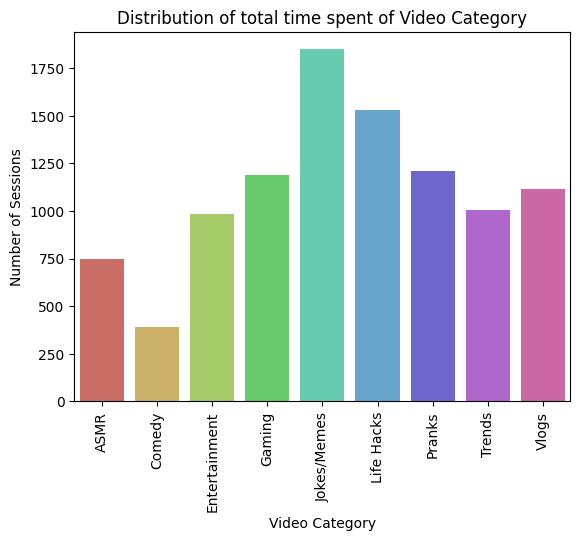

Average Number of Sessions by different groups of Video Category
Video Category
ASMR              9.455696
Comedy           11.114286
Entertainment     9.627451
Gaming            9.991597
Jokes/Memes      10.318436
Life Hacks        9.425926
Pranks           11.009091
Trends           10.060000
Vlogs             9.780702
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


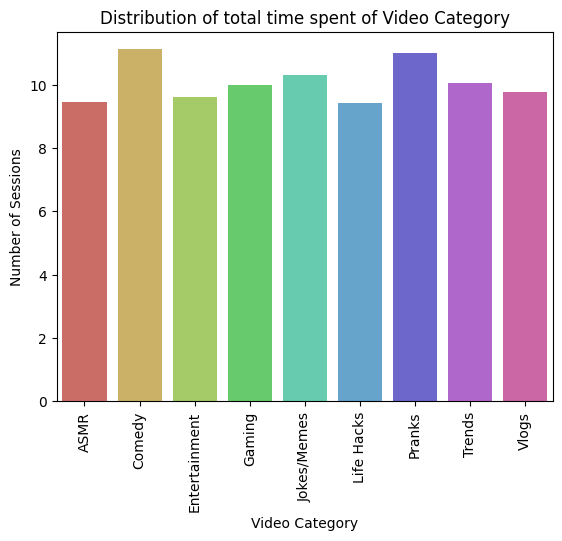

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


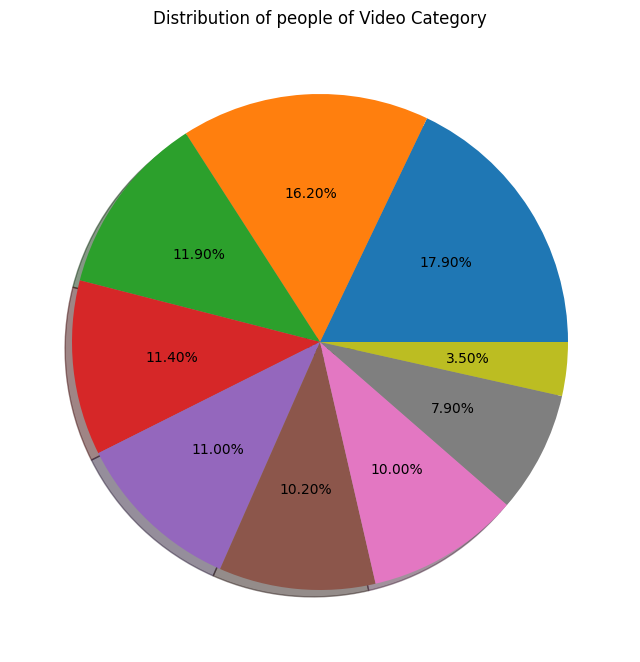

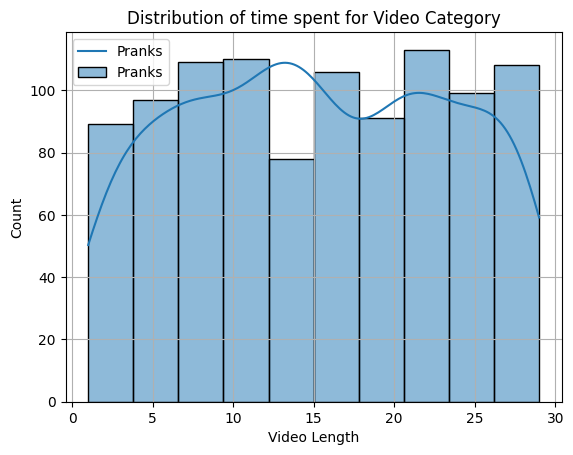

Total Video Length by different groups of Video Category
Video Category
ASMR             1141
Comedy            512
Entertainment    1568
Gaming           1811
Jokes/Memes      2589
Life Hacks       2590
Pranks           1619
Trends           1547
Vlogs            1837
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


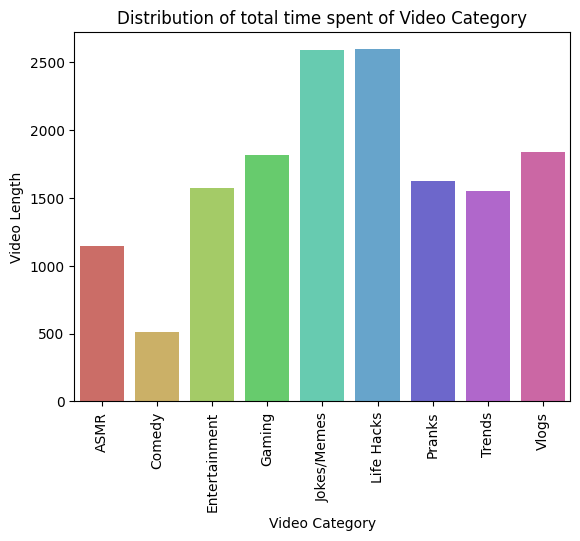

Average Video Length by different groups of Video Category
Video Category
ASMR             14.443038
Comedy           14.628571
Entertainment    15.372549
Gaming           15.218487
Jokes/Memes      14.463687
Life Hacks       15.987654
Pranks           14.718182
Trends           15.470000
Vlogs            16.114035
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


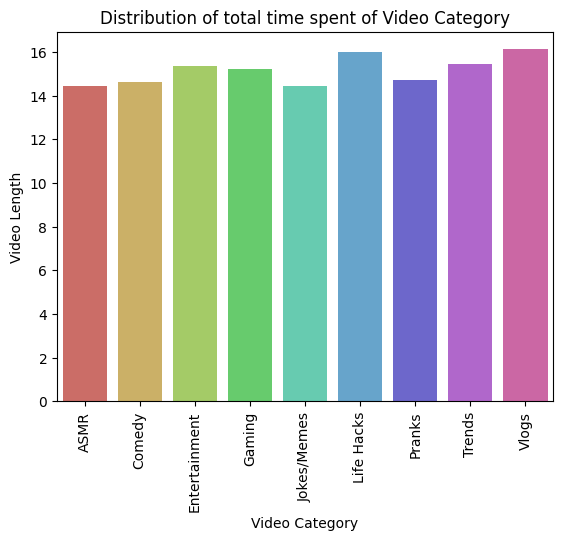

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


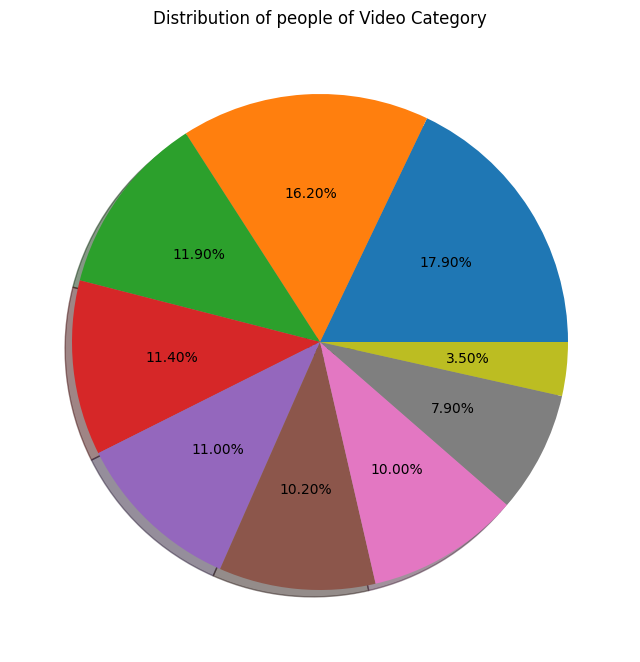

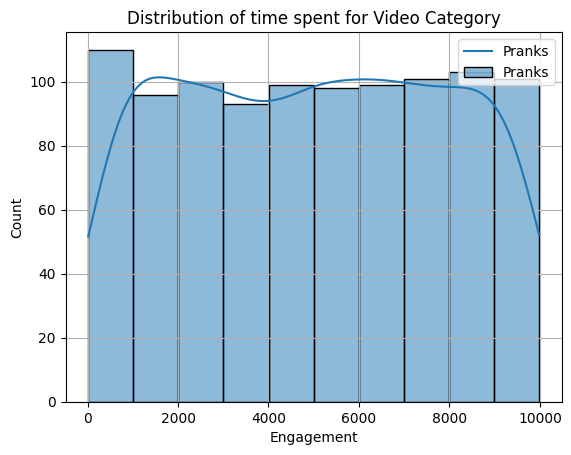

Total Engagement by different groups of Video Category
Video Category
ASMR             352004
Comedy           172908
Entertainment    490879
Gaming           535693
Jokes/Memes      887489
Life Hacks       852747
Pranks           565850
Trends           540770
Vlogs            598819
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


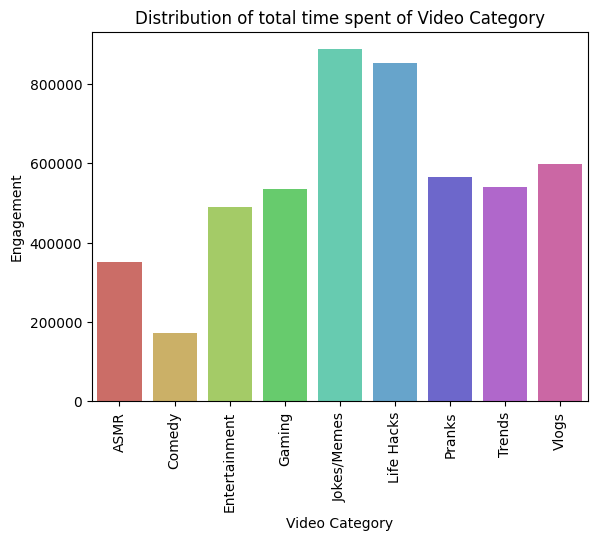

Average Engagement by different groups of Video Category
Video Category
ASMR             4455.746835
Comedy           4940.228571
Entertainment    4812.539216
Gaming           4501.621849
Jokes/Memes      4958.039106
Life Hacks       5263.870370
Pranks           5144.090909
Trends           5407.700000
Vlogs            5252.798246
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


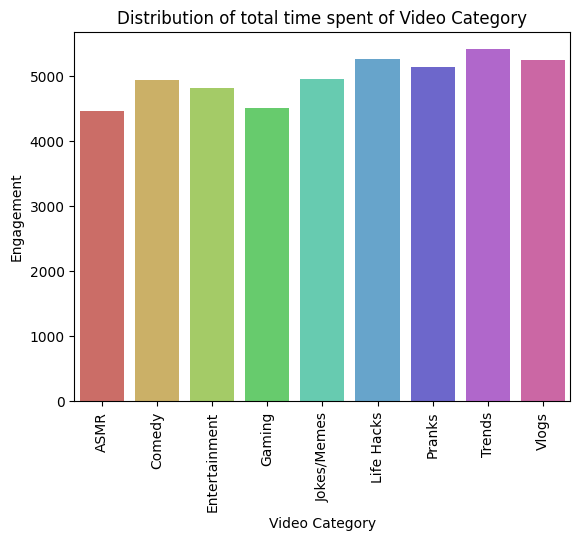

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


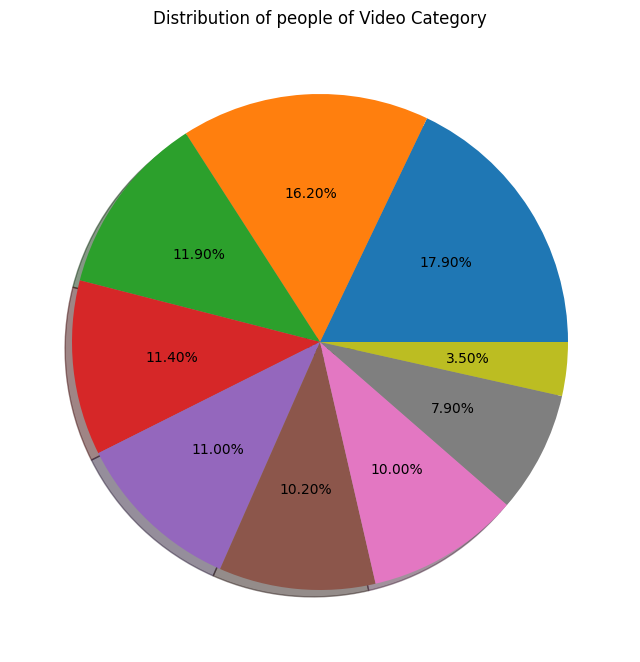

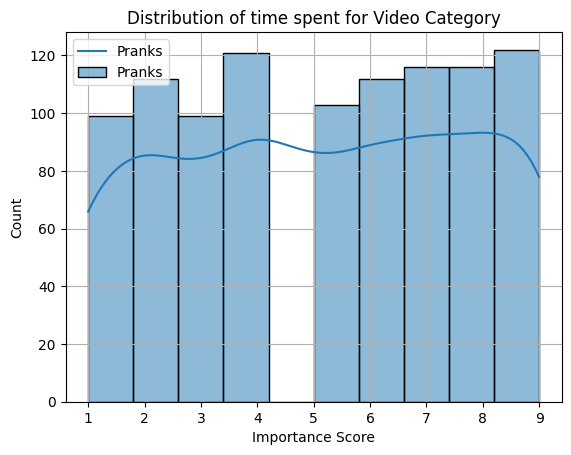

Total Importance Score by different groups of Video Category
Video Category
ASMR             381
Comedy           156
Entertainment    542
Gaming           639
Jokes/Memes      910
Life Hacks       856
Pranks           559
Trends           525
Vlogs            561
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


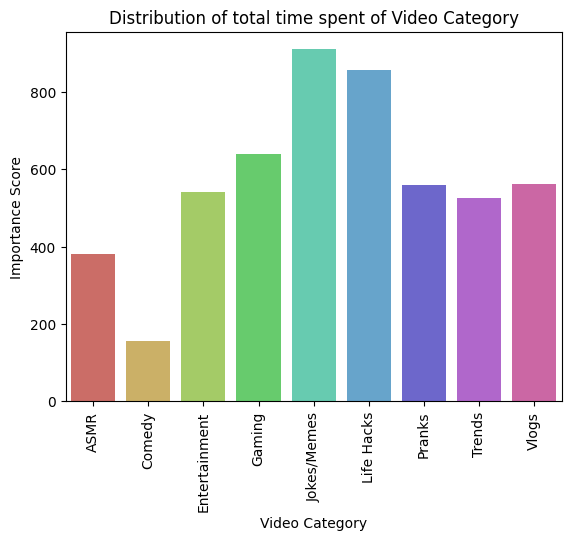

Average Importance Score by different groups of Video Category
Video Category
ASMR             4.822785
Comedy           4.457143
Entertainment    5.313725
Gaming           5.369748
Jokes/Memes      5.083799
Life Hacks       5.283951
Pranks           5.081818
Trends           5.250000
Vlogs            4.921053
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


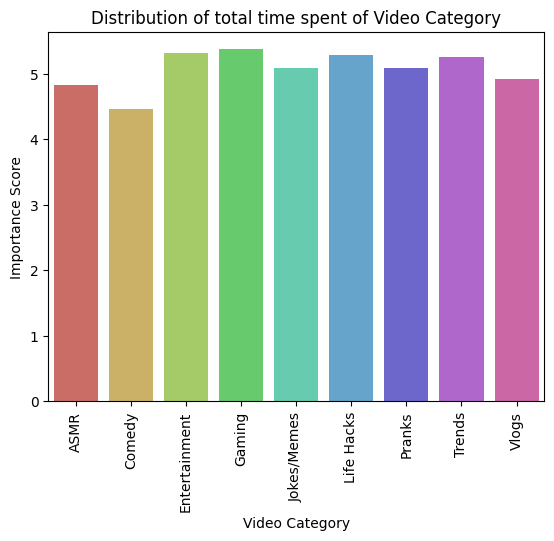

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


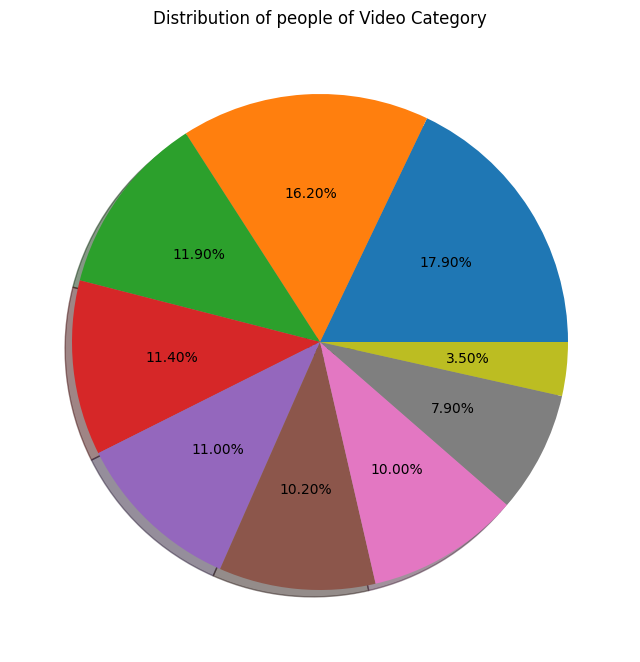

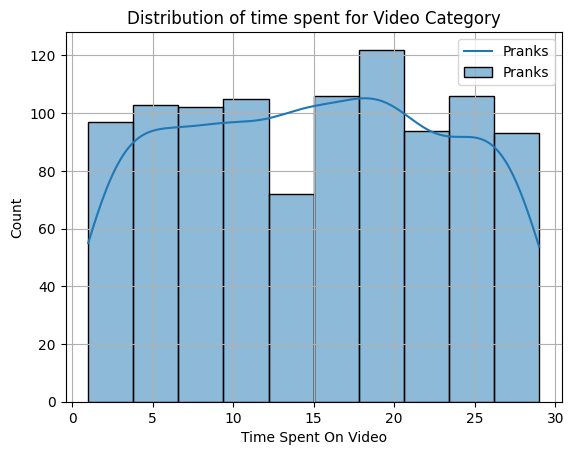

Total Time Spent On Video by different groups of Video Category
Video Category
ASMR             1135
Comedy            513
Entertainment    1547
Gaming           1719
Jokes/Memes      2638
Life Hacks       2397
Pranks           1804
Trends           1420
Vlogs            1800
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


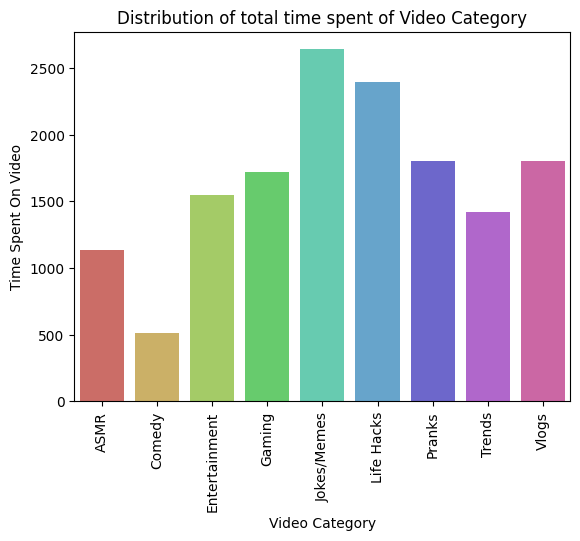

C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


Average Time Spent On Video by different groups of Video Category
Video Category
ASMR             14.367089
Comedy           14.657143
Entertainment    15.166667
Gaming           14.445378
Jokes/Memes      14.737430
Life Hacks       14.796296
Pranks           16.400000
Trends           14.200000
Vlogs            15.789474
Name: Time Spent On Video, dtype: float64


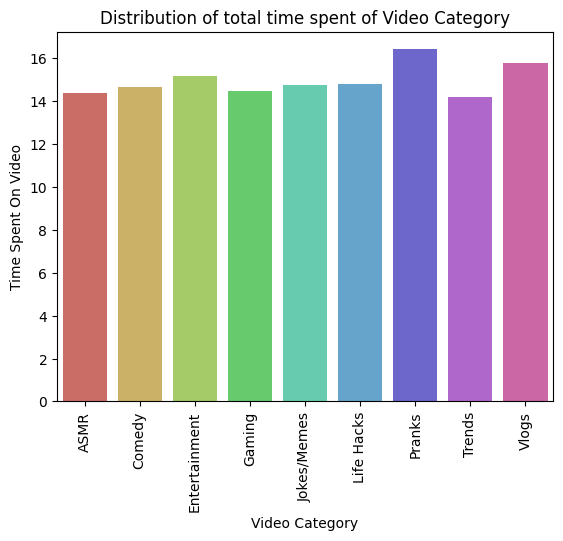

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


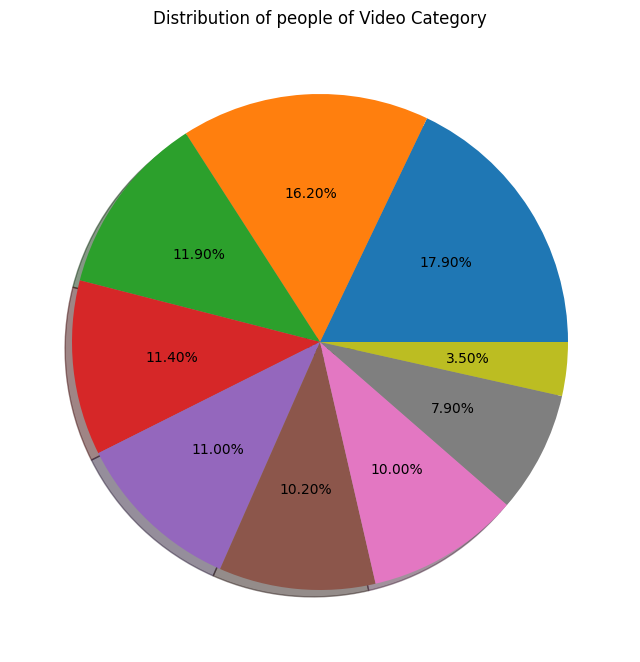

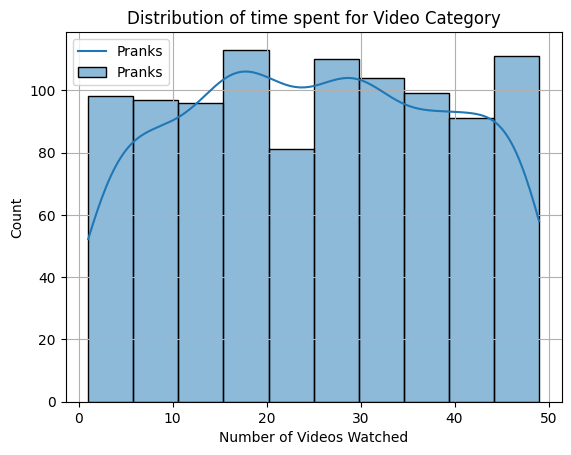

Total Number of Videos Watched by different groups of Video Category
Video Category
ASMR             2038
Comedy            919
Entertainment    2491
Gaming           3069
Jokes/Memes      4552
Life Hacks       4005
Pranks           2682
Trends           2536
Vlogs            2956
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


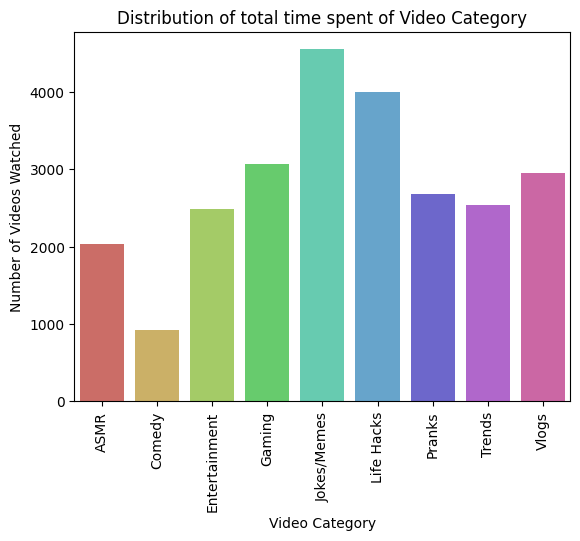

Average Number of Videos Watched by different groups of Video Category
Video Category
ASMR             25.797468
Comedy           26.257143
Entertainment    24.421569
Gaming           25.789916
Jokes/Memes      25.430168
Life Hacks       24.722222
Pranks           24.381818
Trends           25.360000
Vlogs            25.929825
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


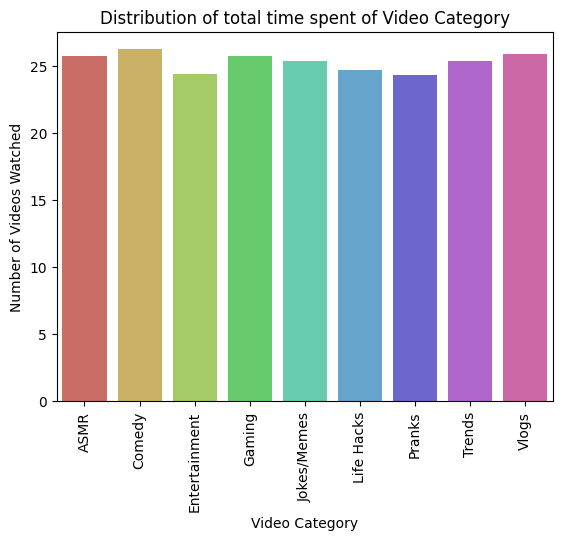

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


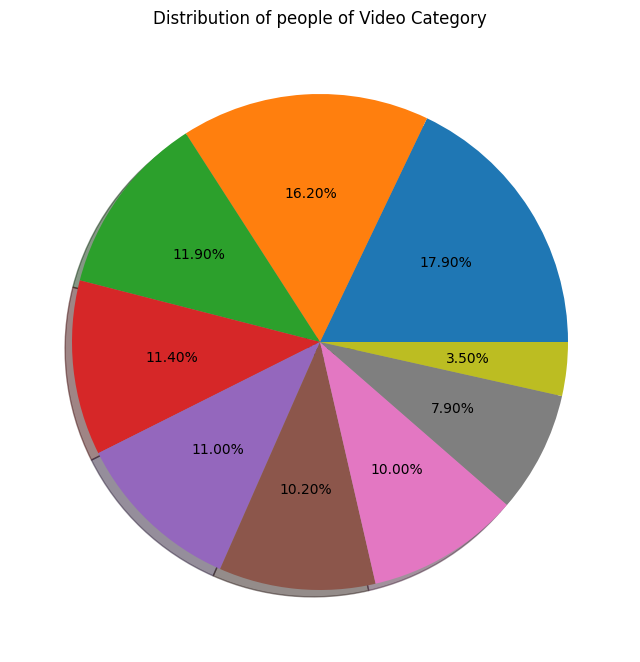

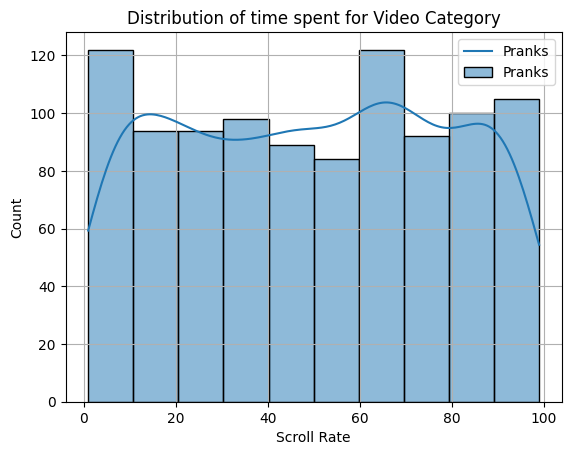

Total Scroll Rate by different groups of Video Category
Video Category
ASMR             4160
Comedy           1747
Entertainment    4787
Gaming           5798
Jokes/Memes      8997
Life Hacks       7662
Pranks           6065
Trends           5157
Vlogs            5401
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


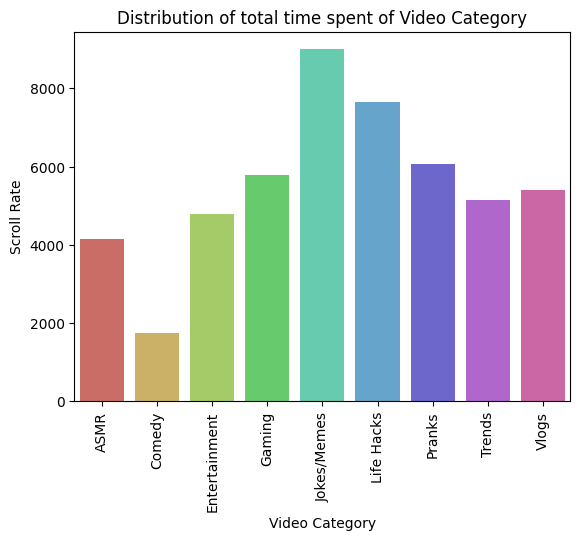

Average Scroll Rate by different groups of Video Category
Video Category
ASMR             52.658228
Comedy           49.914286
Entertainment    46.931373
Gaming           48.722689
Jokes/Memes      50.262570
Life Hacks       47.296296
Pranks           55.136364
Trends           51.570000
Vlogs            47.377193
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


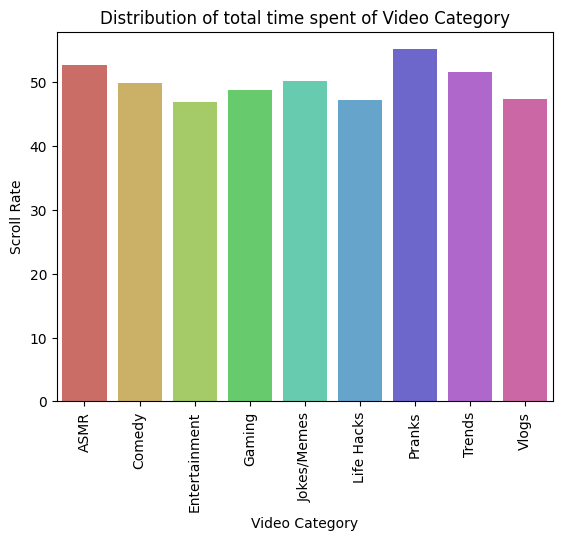

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


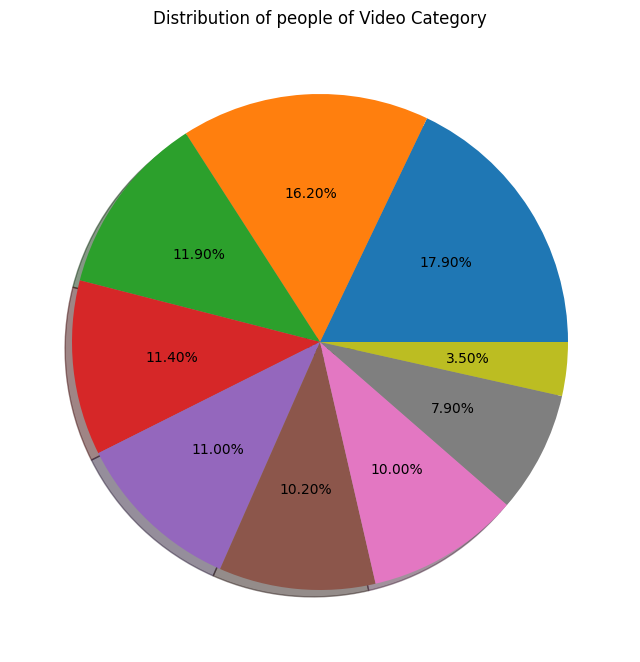

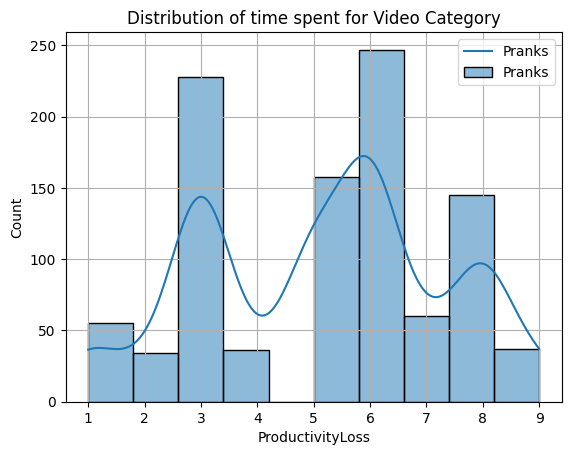

Total ProductivityLoss by different groups of Video Category
Video Category
ASMR             422
Comedy           184
Entertainment    496
Gaming           595
Jokes/Memes      961
Life Hacks       818
Pranks           595
Trends           476
Vlogs            589
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


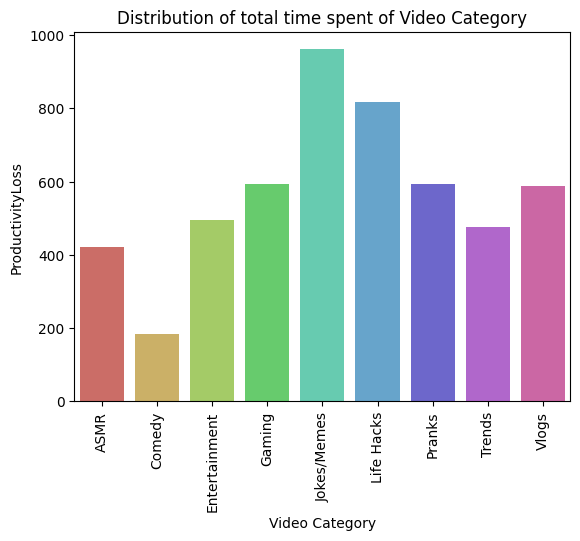

C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


Average ProductivityLoss by different groups of Video Category
Video Category
ASMR             5.341772
Comedy           5.257143
Entertainment    4.862745
Gaming           5.000000
Jokes/Memes      5.368715
Life Hacks       5.049383
Pranks           5.409091
Trends           4.760000
Vlogs            5.166667
Name: ProductivityLoss, dtype: float64


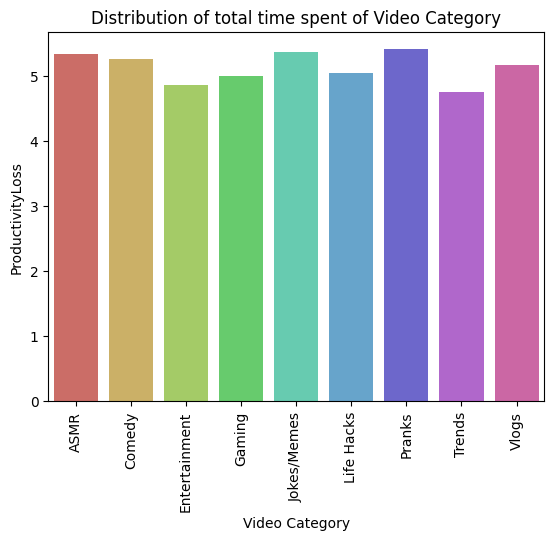

Video Category:
Distribution of people of Video Category
Video Category
Jokes/Memes      17.9
Life Hacks       16.2
Gaming           11.9
Vlogs            11.4
Pranks           11.0
Entertainment    10.2
Trends           10.0
ASMR              7.9
Comedy            3.5
Name: count, dtype: float64


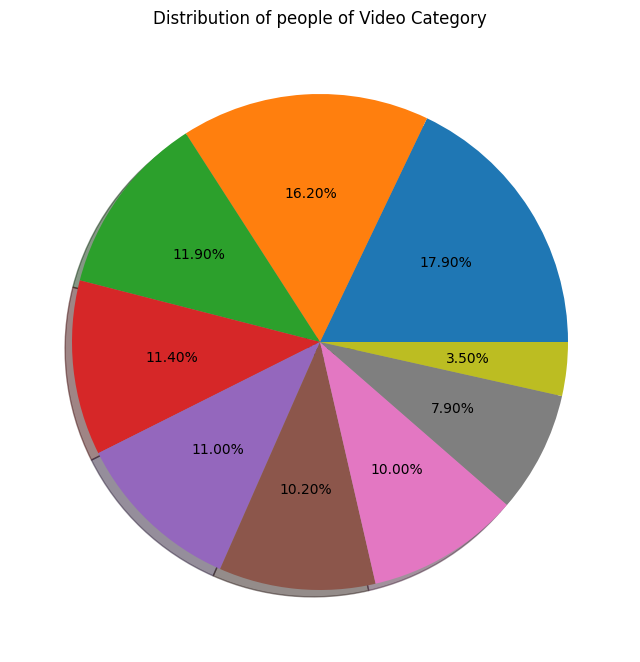

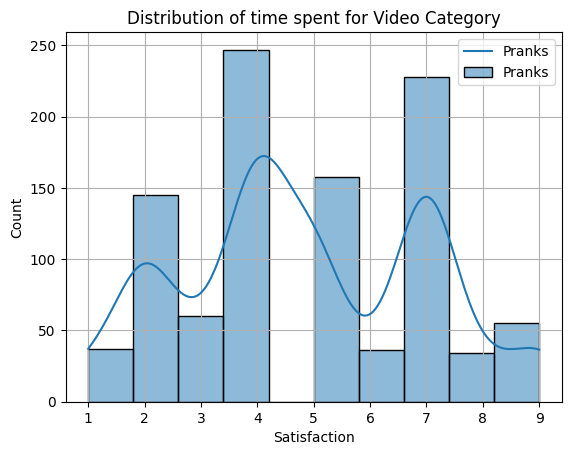

Total Satisfaction by different groups of Video Category
Video Category
ASMR             368
Comedy           166
Entertainment    524
Gaming           595
Jokes/Memes      829
Life Hacks       802
Pranks           505
Trends           524
Vlogs            551
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


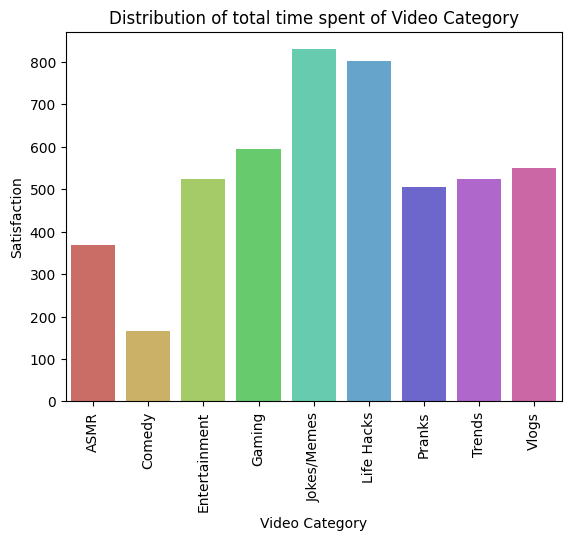

Average Satisfaction by different groups of Video Category
Video Category
ASMR             4.658228
Comedy           4.742857
Entertainment    5.137255
Gaming           5.000000
Jokes/Memes      4.631285
Life Hacks       4.950617
Pranks           4.590909
Trends           5.240000
Vlogs            4.833333
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


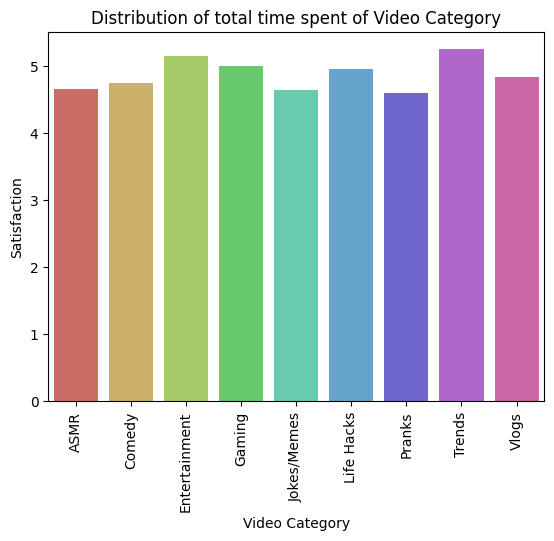

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


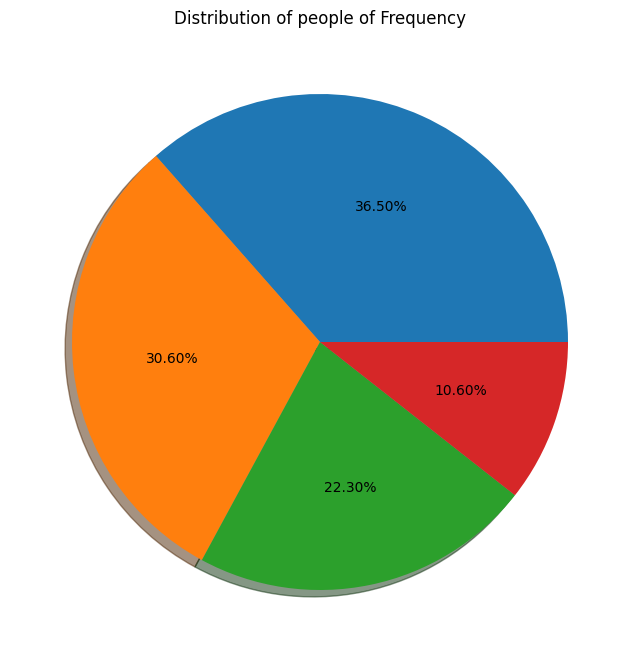

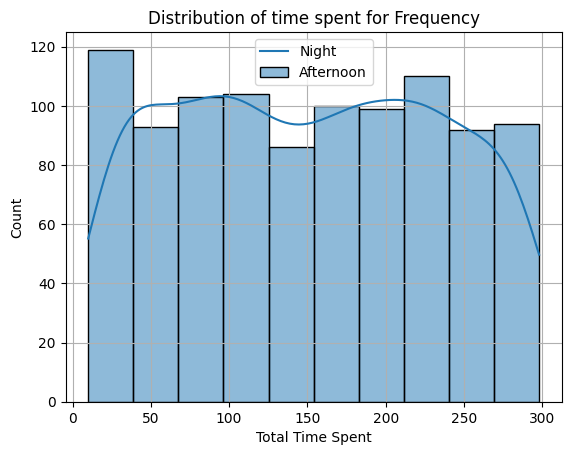

Total Total Time Spent by different groups of Frequency
Frequency
Afternoon    32400
Evening      56757
Morning      15646
Night        46603
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


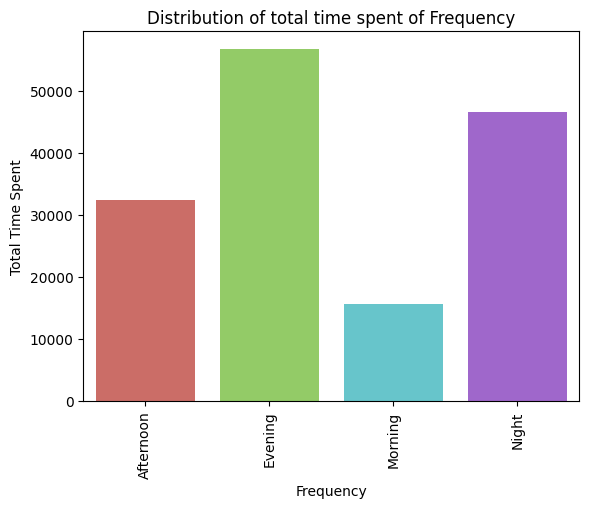

C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


Average Total Time Spent by different groups of Frequency
Frequency
Afternoon    145.291480
Evening      155.498630
Morning      147.603774
Night        152.297386
Name: Total Time Spent, dtype: float64


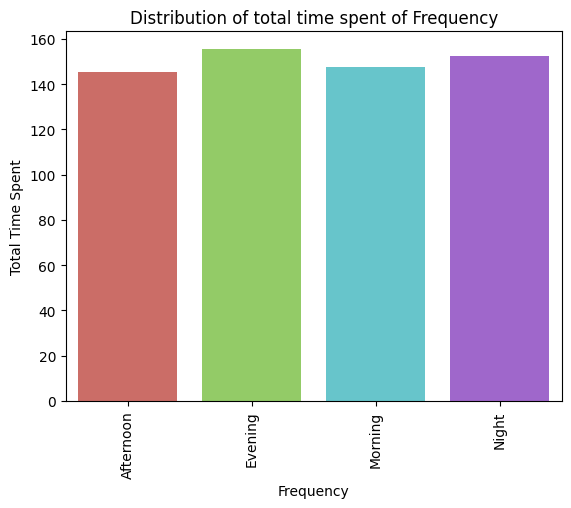

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


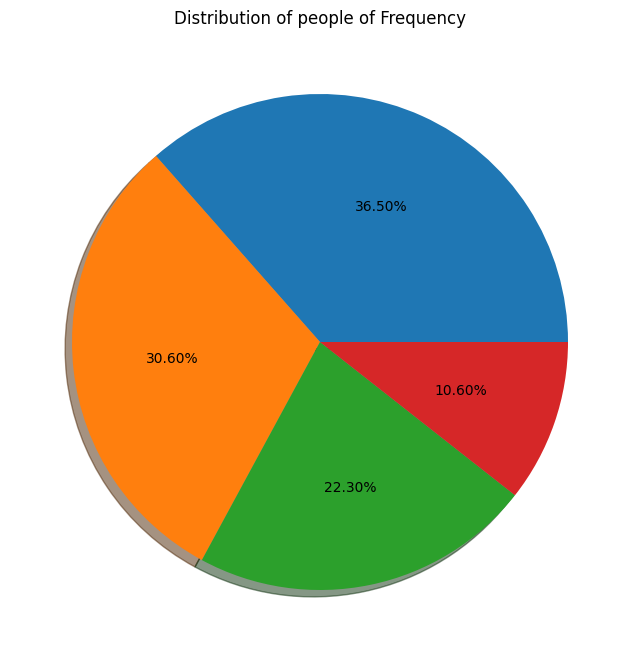

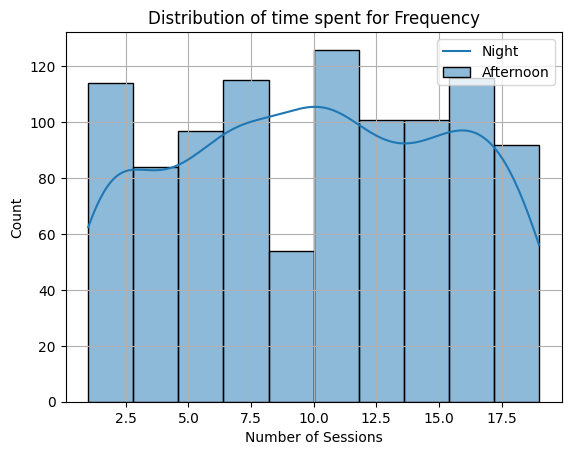

Total Number of Sessions by different groups of Frequency
Frequency
Afternoon    2140
Evening      3662
Morning      1190
Night        3021
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


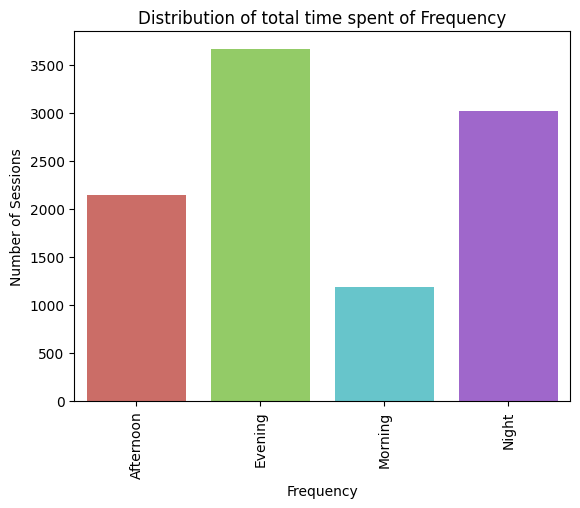

Average Number of Sessions by different groups of Frequency
Frequency
Afternoon     9.596413
Evening      10.032877
Morning      11.226415
Night         9.872549
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


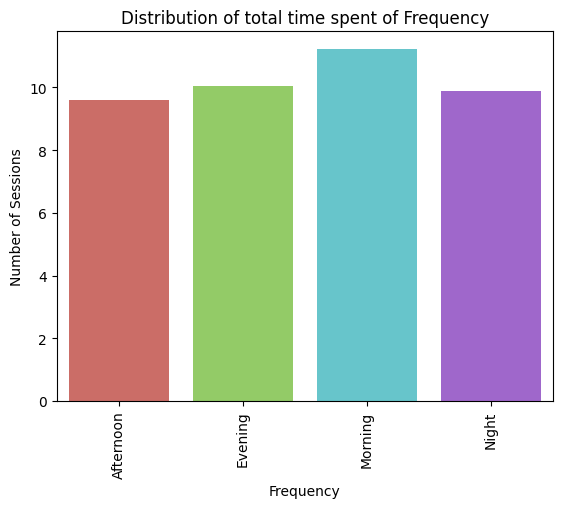

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


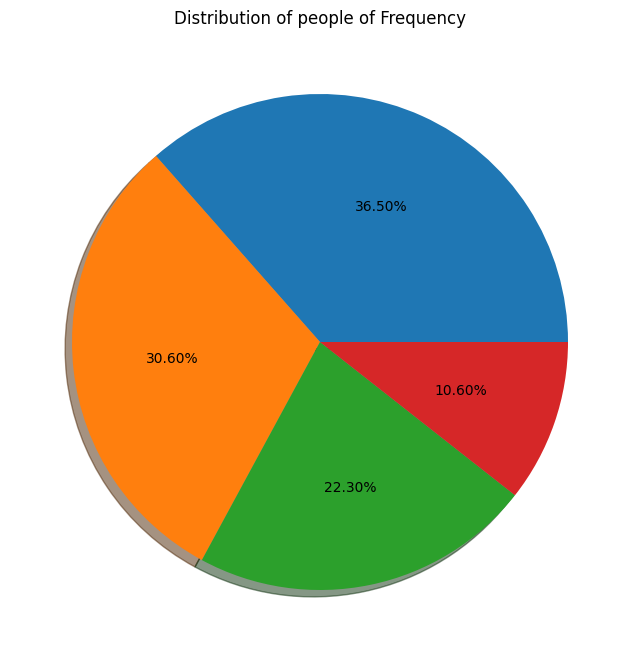

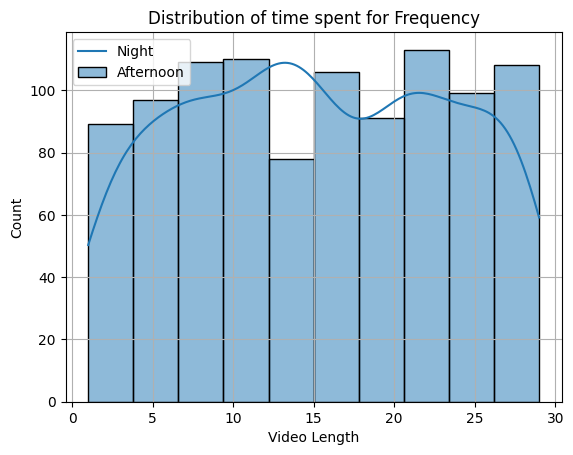

Total Video Length by different groups of Frequency
Frequency
Afternoon    3426
Evening      5412
Morning      1731
Night        4645
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


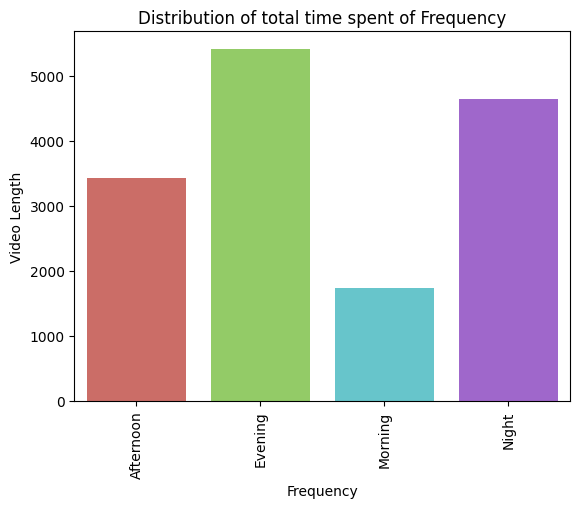

Average Video Length by different groups of Frequency
Frequency
Afternoon    15.363229
Evening      14.827397
Morning      16.330189
Night        15.179739
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


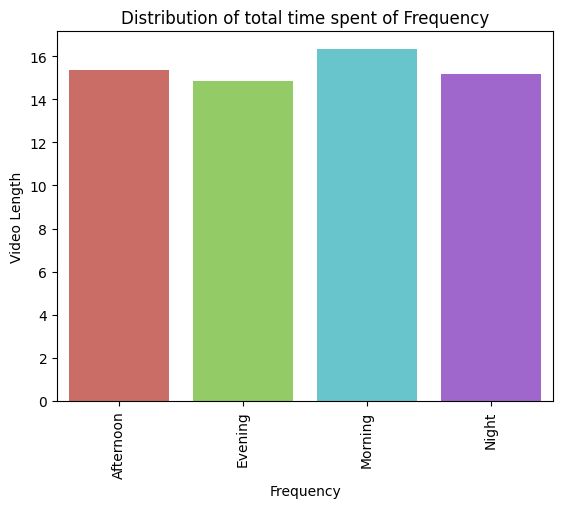

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


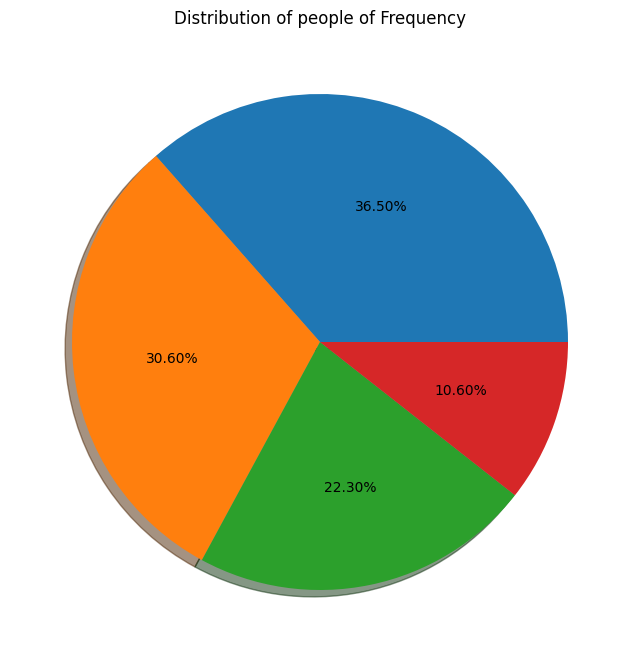

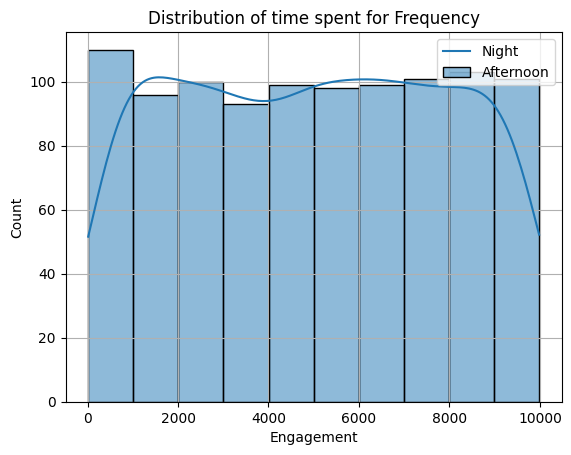

Total Engagement by different groups of Frequency
Frequency
Afternoon    1086830
Evening      1803965
Morning       511912
Night        1594452
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


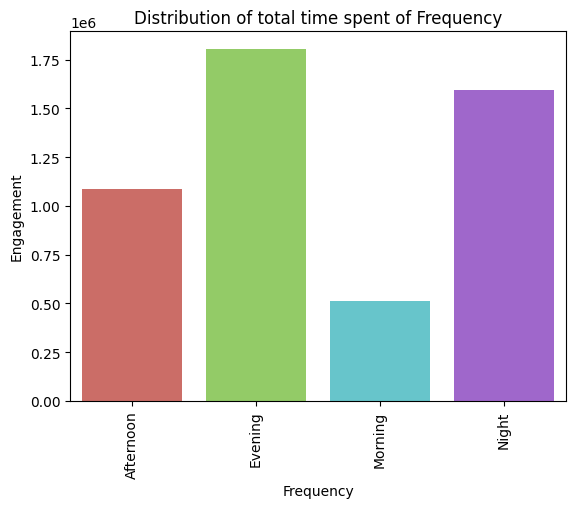

Average Engagement by different groups of Frequency
Frequency
Afternoon    4873.677130
Evening      4942.369863
Morning      4829.358491
Night        5210.627451
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


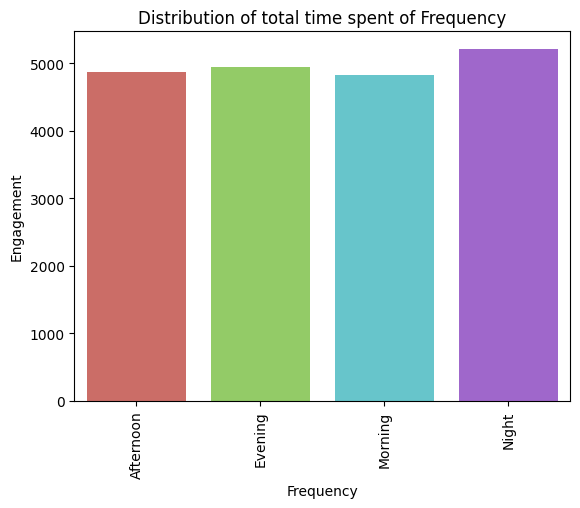

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


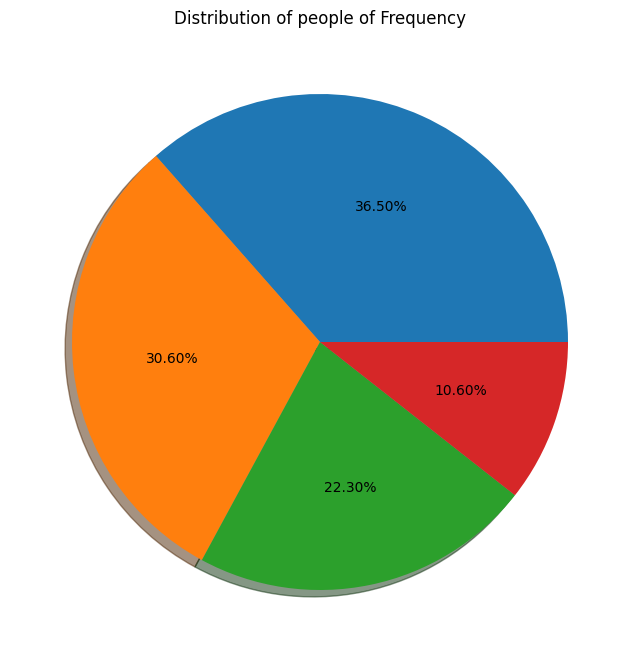

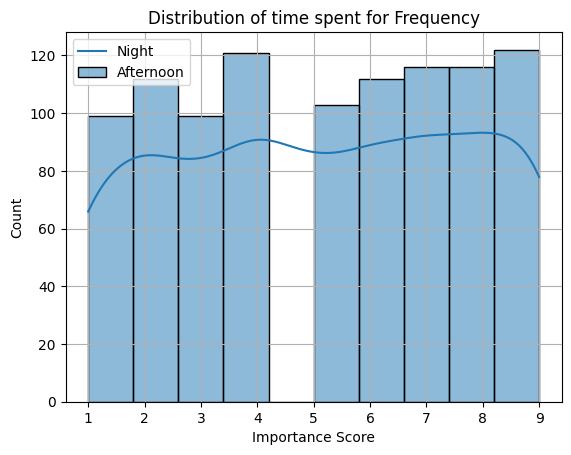

Total Importance Score by different groups of Frequency
Frequency
Afternoon    1156
Evening      1814
Morning       560
Night        1599
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


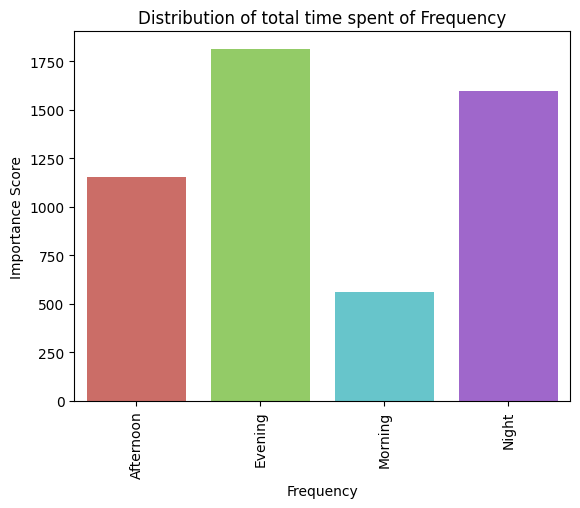

C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


Average Importance Score by different groups of Frequency
Frequency
Afternoon    5.183857
Evening      4.969863
Morning      5.283019
Night        5.225490
Name: Importance Score, dtype: float64


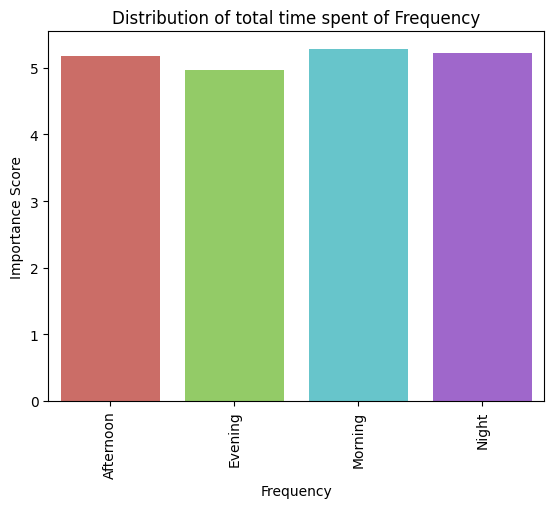

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


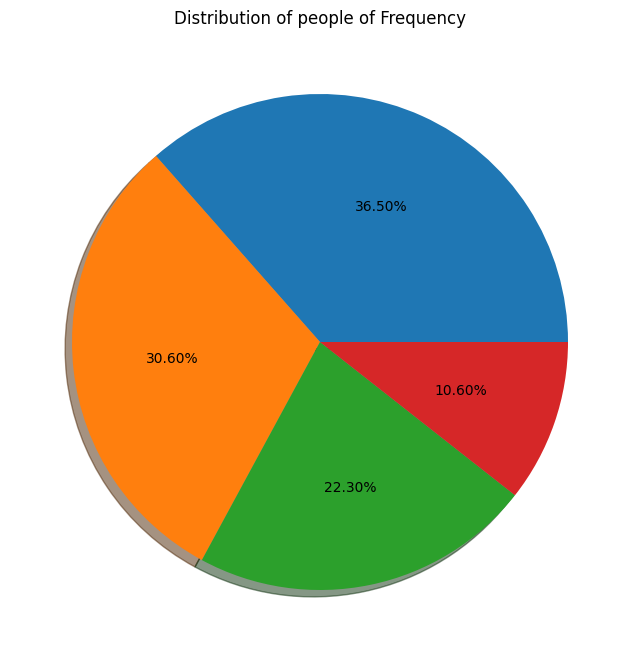

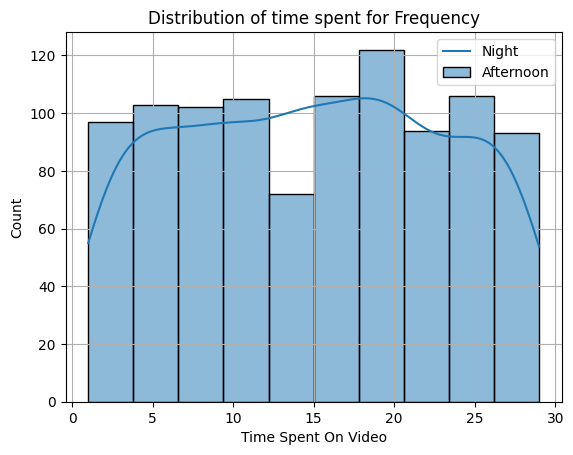

Total Time Spent On Video by different groups of Frequency
Frequency
Afternoon    3369
Evening      5444
Morning      1638
Night        4522
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


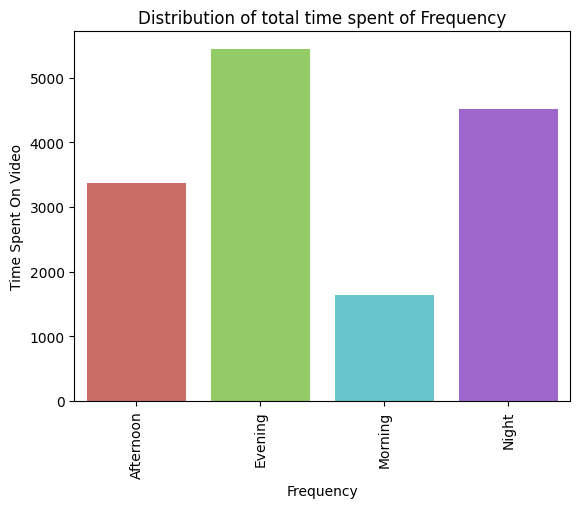

Average Time Spent On Video by different groups of Frequency
Frequency
Afternoon    15.107623
Evening      14.915068
Morning      15.452830
Night        14.777778
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


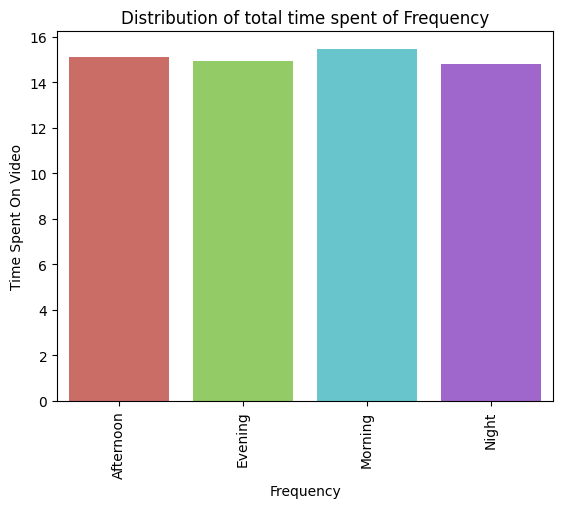

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


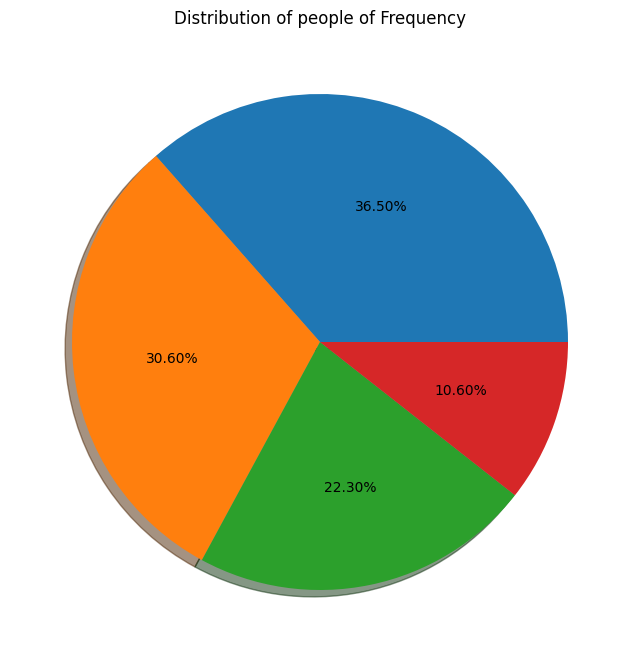

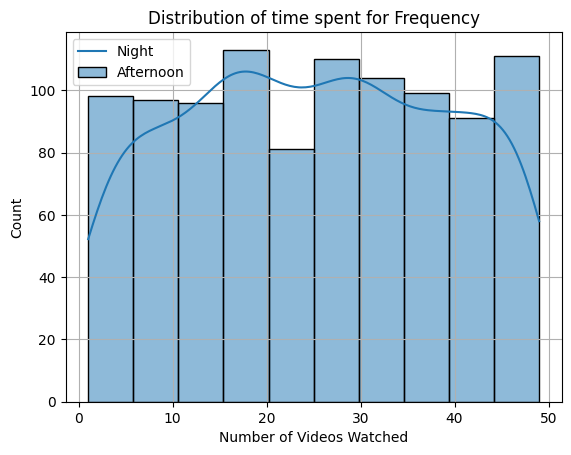

Total Number of Videos Watched by different groups of Frequency
Frequency
Afternoon    5613
Evening      9048
Morning      2705
Night        7882
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


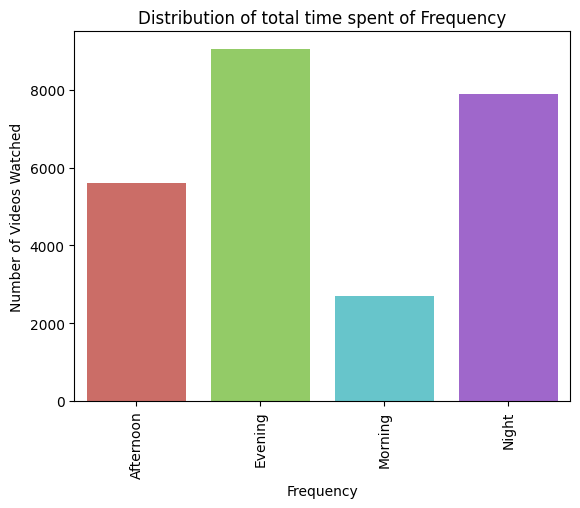

Average Number of Videos Watched by different groups of Frequency
Frequency
Afternoon    25.170404
Evening      24.789041
Morning      25.518868
Night        25.758170
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


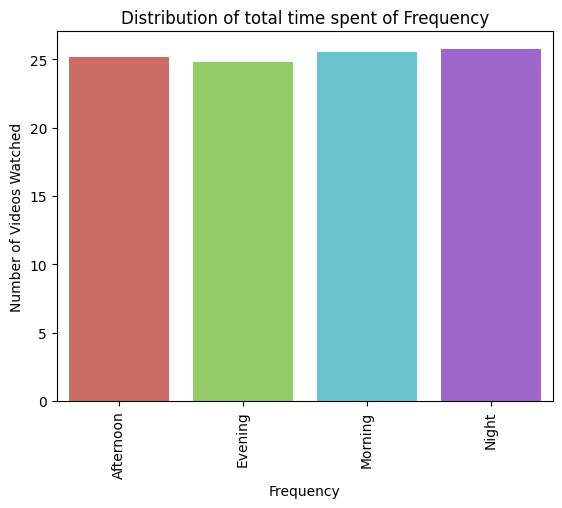

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


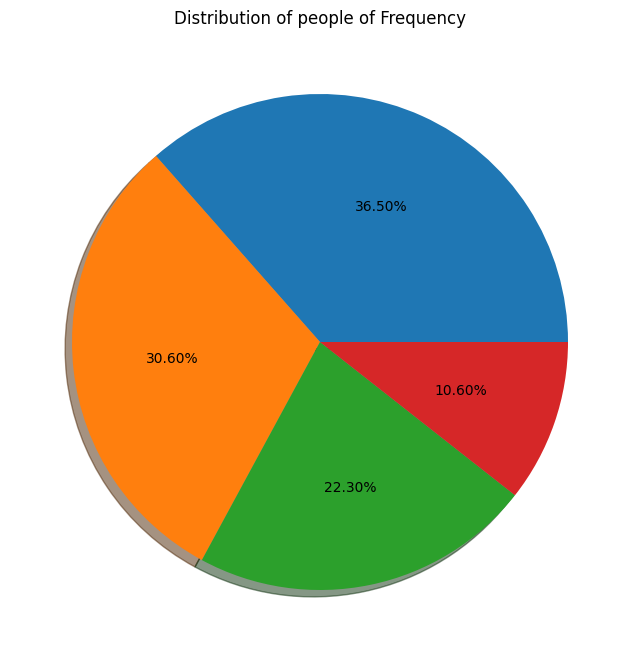

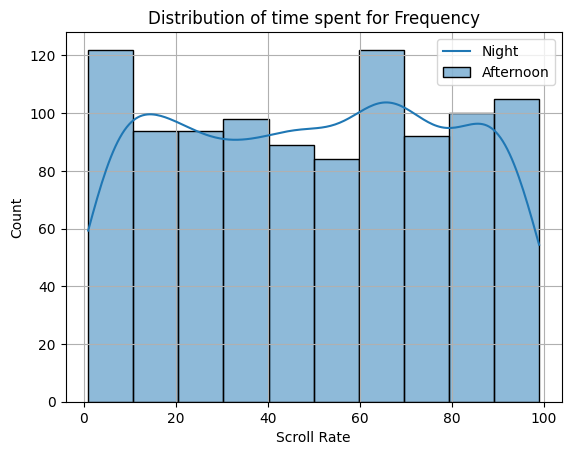

Total Scroll Rate by different groups of Frequency
Frequency
Afternoon    10796
Evening      17932
Morning       5462
Night        15584
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


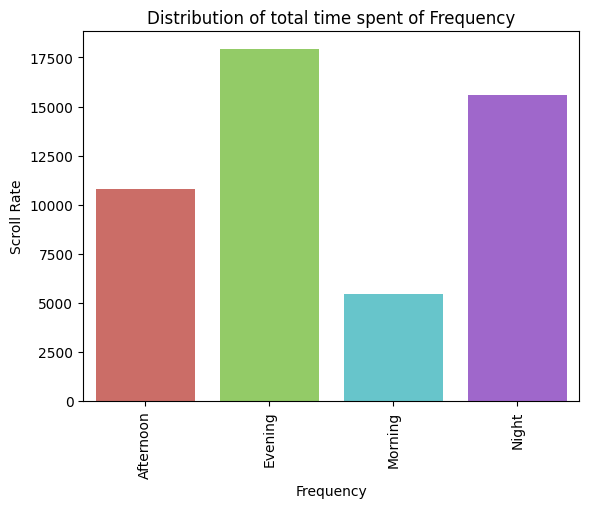

Average Scroll Rate by different groups of Frequency
Frequency
Afternoon    48.412556
Evening      49.128767
Morning      51.528302
Night        50.928105
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


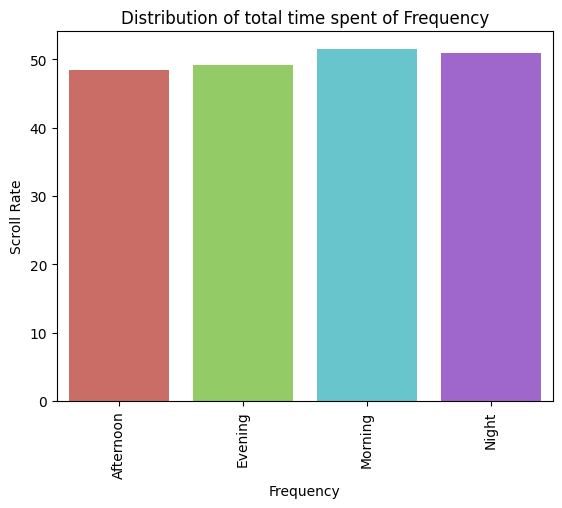

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


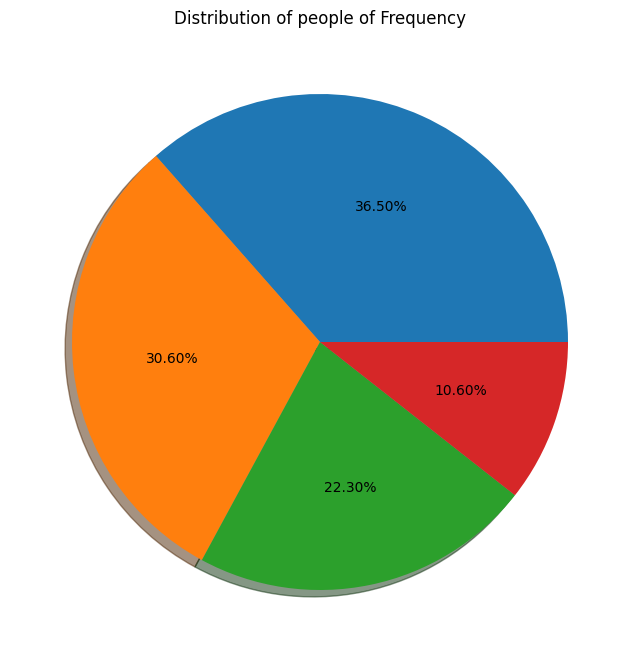

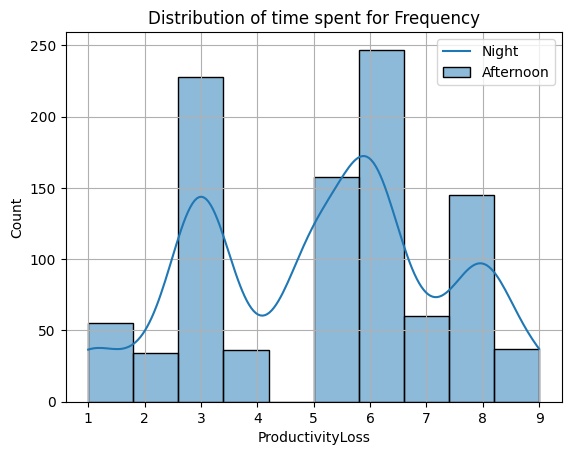

Total ProductivityLoss by different groups of Frequency
Frequency
Afternoon    1192
Evening      2150
Morning       794
Night        1000
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


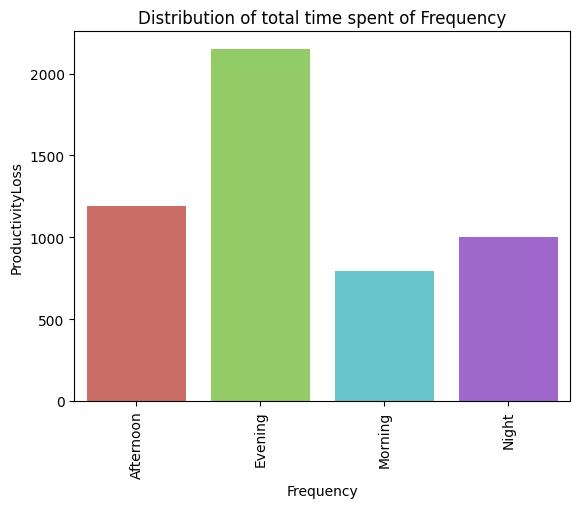

Average ProductivityLoss by different groups of Frequency
Frequency
Afternoon    5.345291
Evening      5.890411
Morning      7.490566
Night        3.267974
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


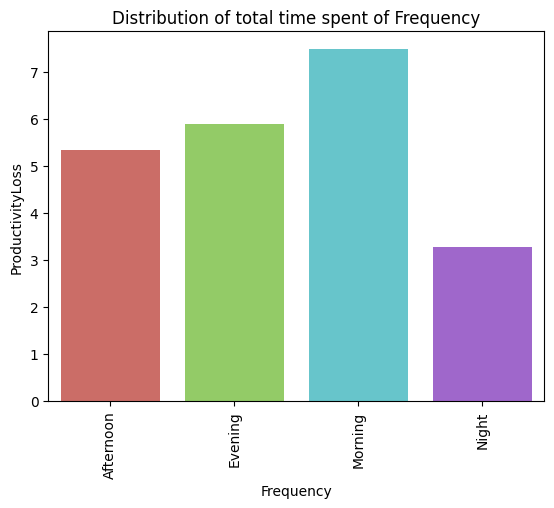

Frequency:
Distribution of people of Frequency
Frequency
Evening      36.5
Night        30.6
Afternoon    22.3
Morning      10.6
Name: count, dtype: float64


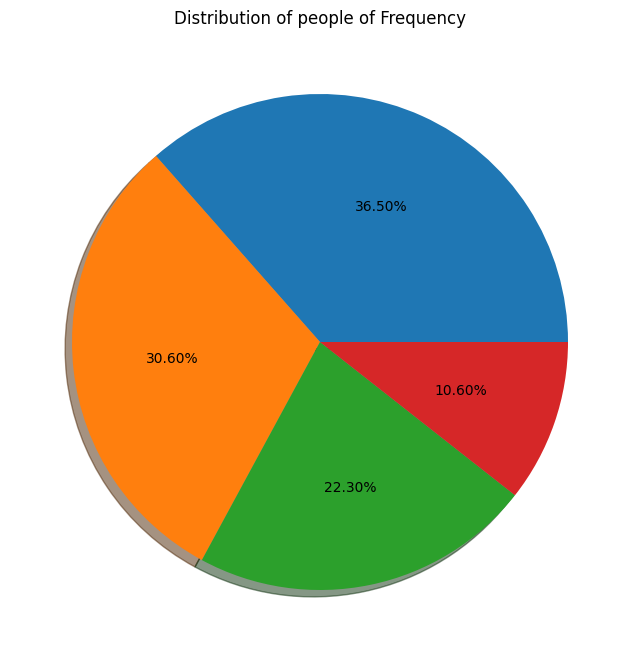

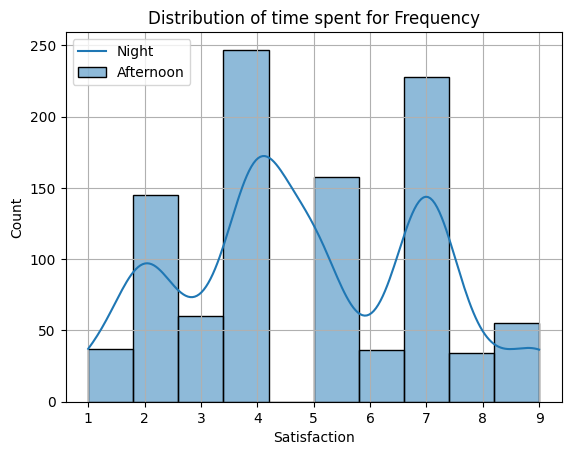

Total Satisfaction by different groups of Frequency
Frequency
Afternoon    1038
Evening      1500
Morning       266
Night        2060
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


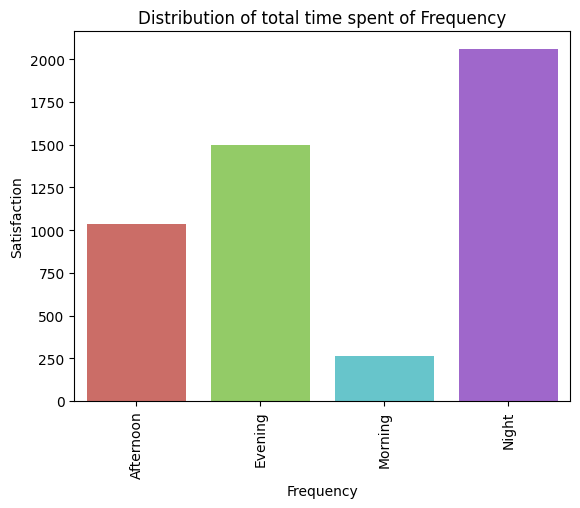

Average Satisfaction by different groups of Frequency
Frequency
Afternoon    4.654709
Evening      4.109589
Morning      2.509434
Night        6.732026
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


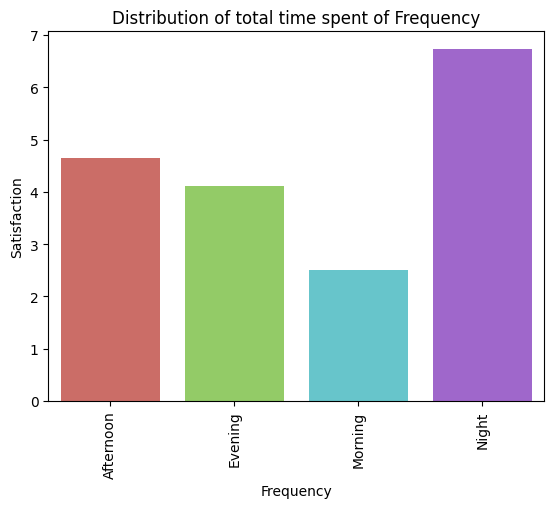

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


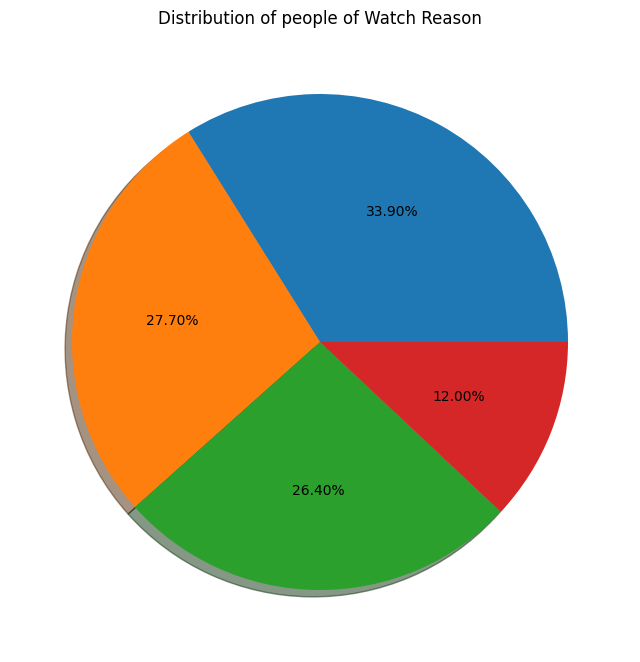

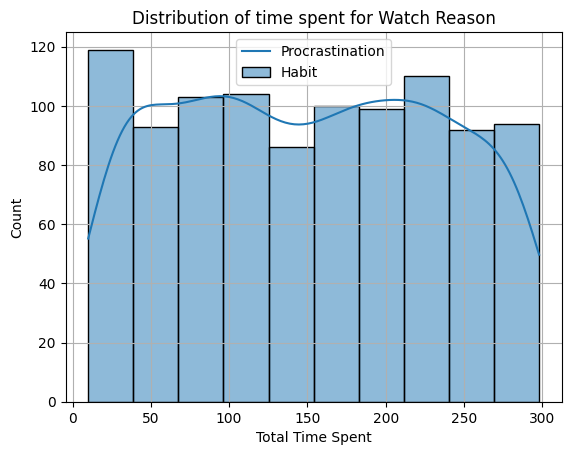

Total Total Time Spent by different groups of Watch Reason
Watch Reason
Boredom            40137
Entertainment      39564
Habit              53883
Procrastination    17822
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


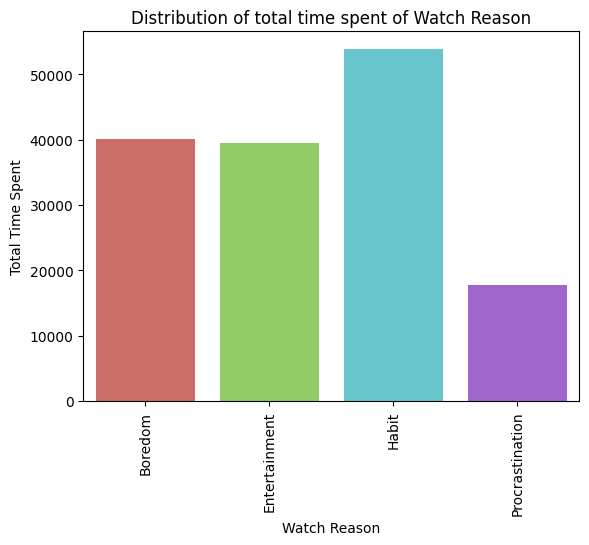

Average Total Time Spent by different groups of Watch Reason
Watch Reason
Boredom            144.898917
Entertainment      149.863636
Habit              158.946903
Procrastination    148.516667
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


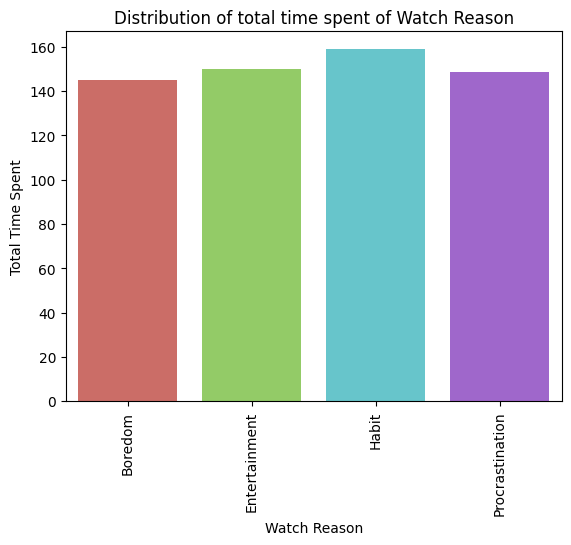

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


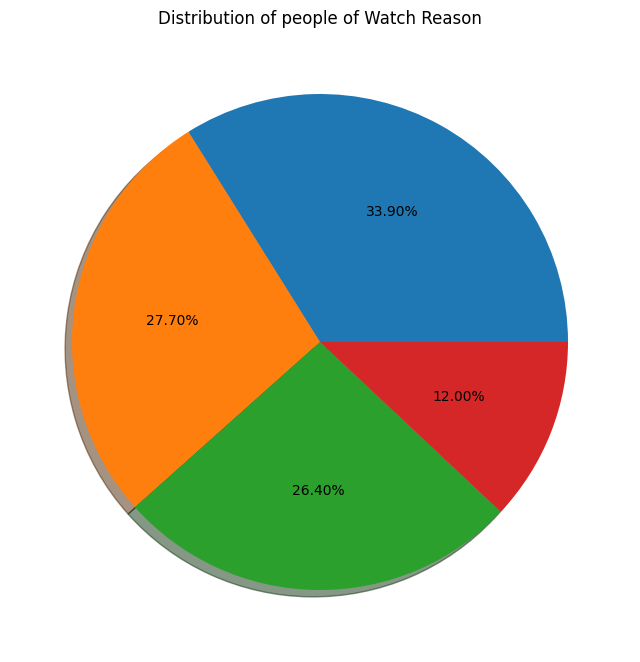

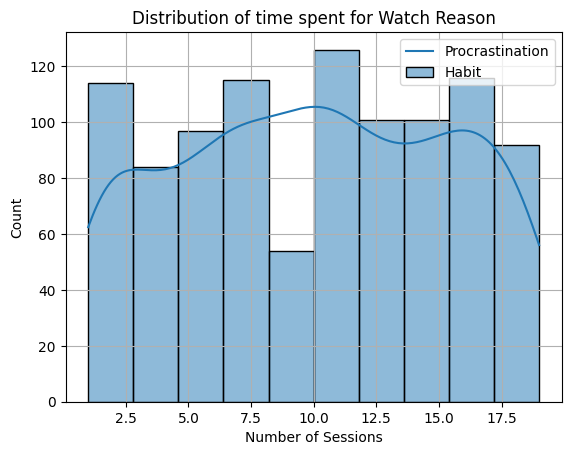

Total Number of Sessions by different groups of Watch Reason
Watch Reason
Boredom            2897
Entertainment      2576
Habit              3322
Procrastination    1218
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


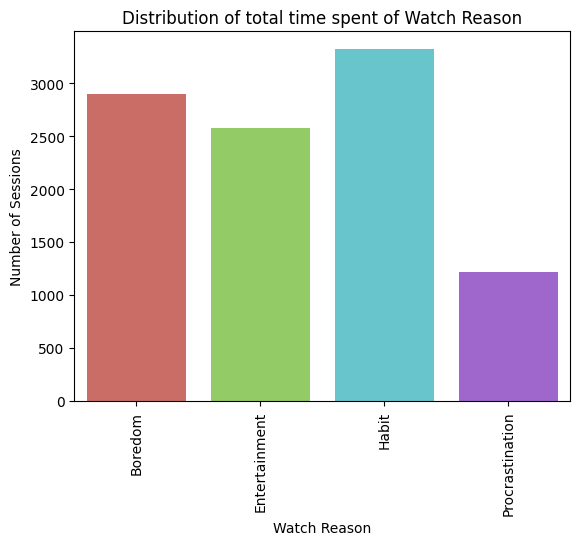

Average Number of Sessions by different groups of Watch Reason
Watch Reason
Boredom            10.458484
Entertainment       9.757576
Habit               9.799410
Procrastination    10.150000
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


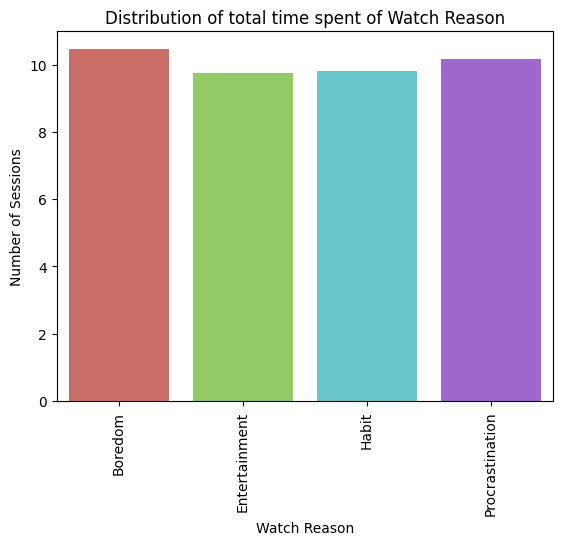

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


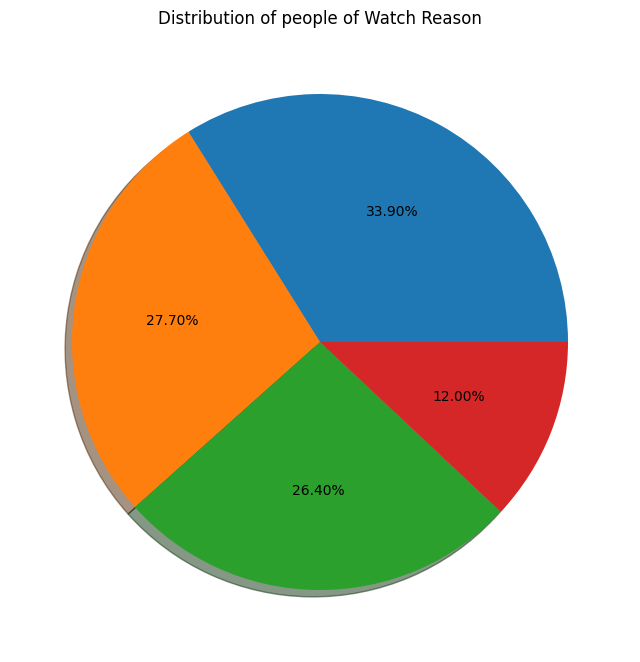

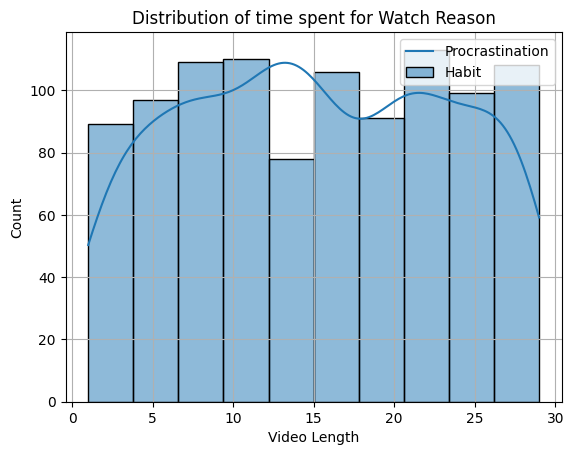

Total Video Length by different groups of Watch Reason
Watch Reason
Boredom            4182
Entertainment      3992
Habit              5264
Procrastination    1776
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


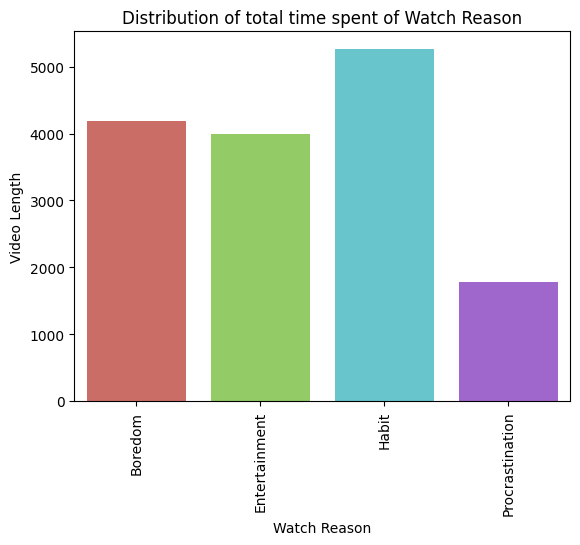

Average Video Length by different groups of Watch Reason
Watch Reason
Boredom            15.097473
Entertainment      15.121212
Habit              15.528024
Procrastination    14.800000
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


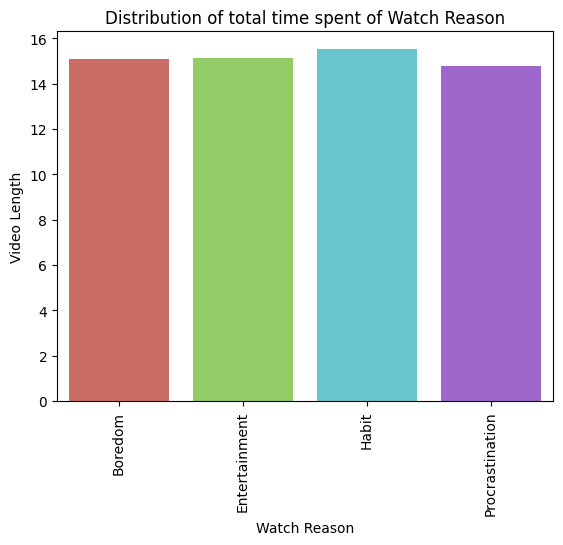

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


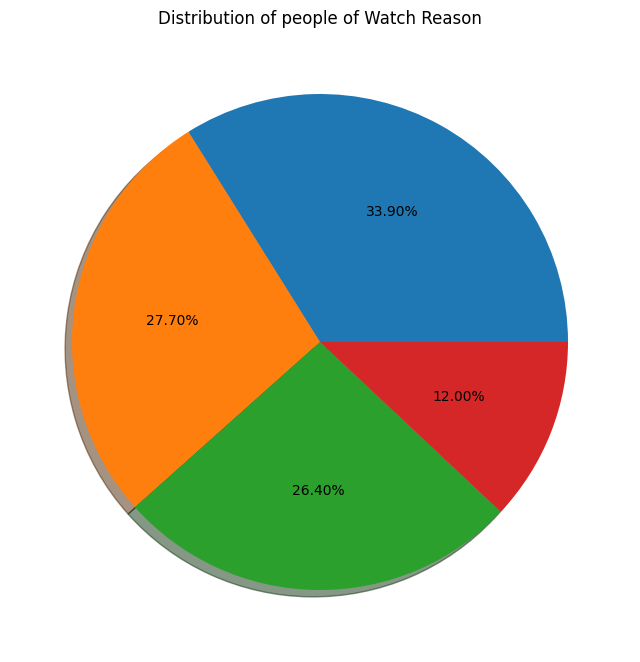

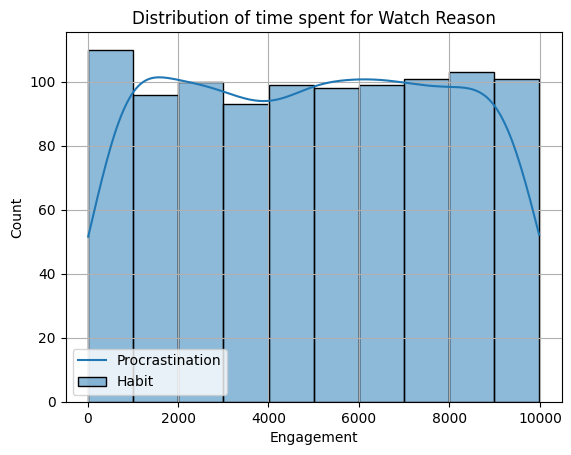

Total Engagement by different groups of Watch Reason
Watch Reason
Boredom            1377068
Entertainment      1311304
Habit              1703549
Procrastination     605238
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


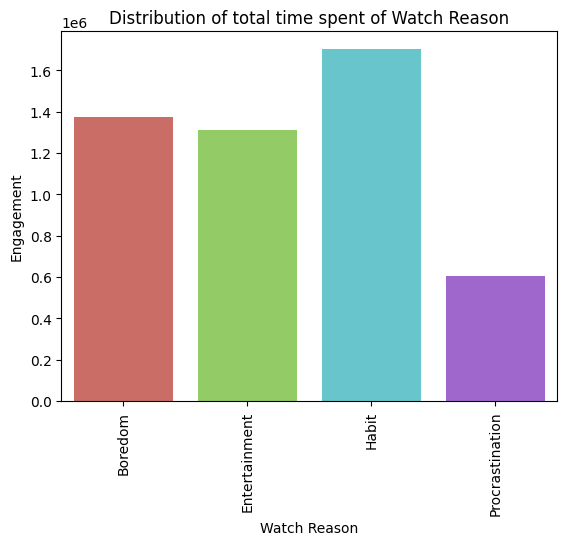

Average Engagement by different groups of Watch Reason
Watch Reason
Boredom            4971.364621
Entertainment      4967.060606
Habit              5025.218289
Procrastination    5043.650000
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


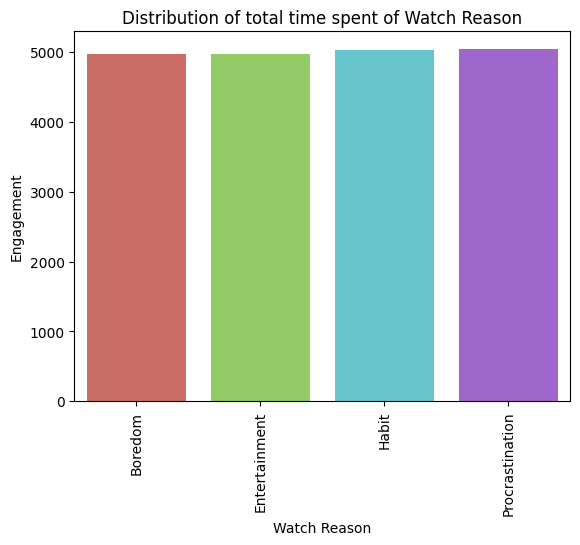

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


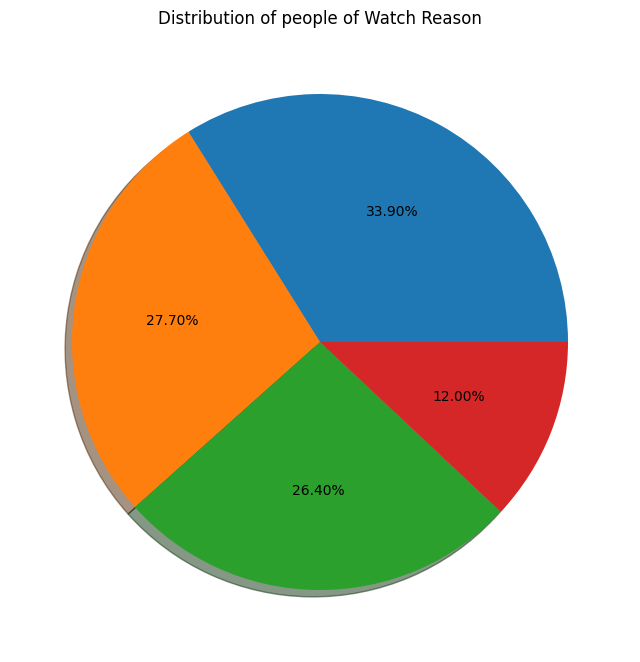

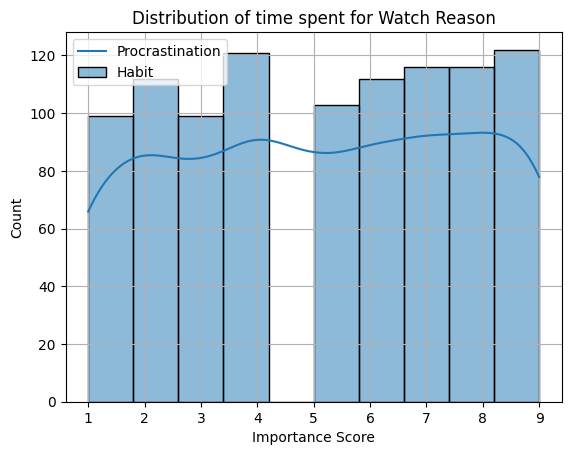

Total Importance Score by different groups of Watch Reason
Watch Reason
Boredom            1386
Entertainment      1338
Habit              1777
Procrastination     628
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


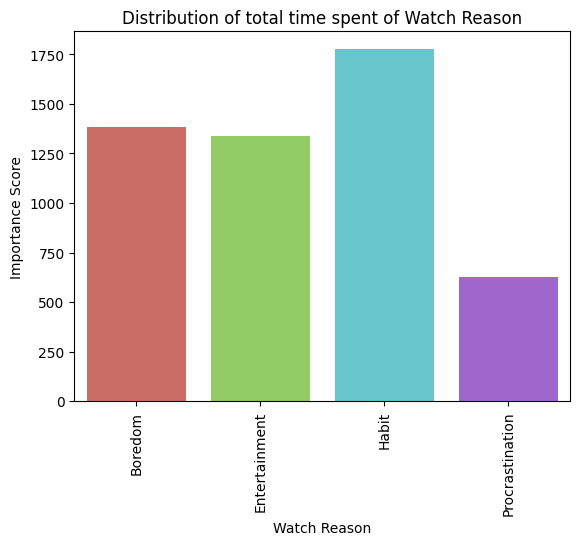

Average Importance Score by different groups of Watch Reason
Watch Reason
Boredom            5.003610
Entertainment      5.068182
Habit              5.241888
Procrastination    5.233333
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


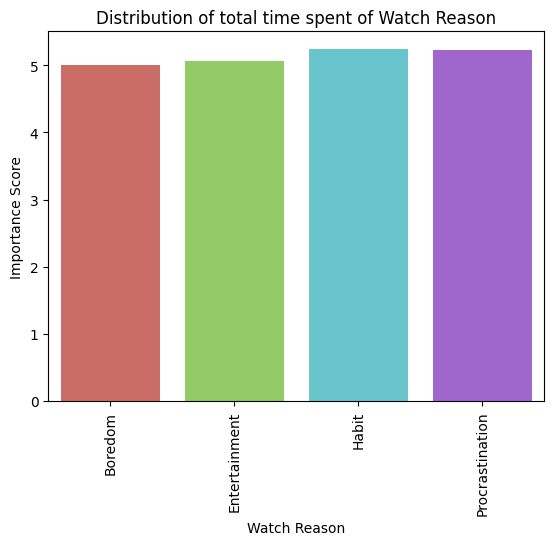

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


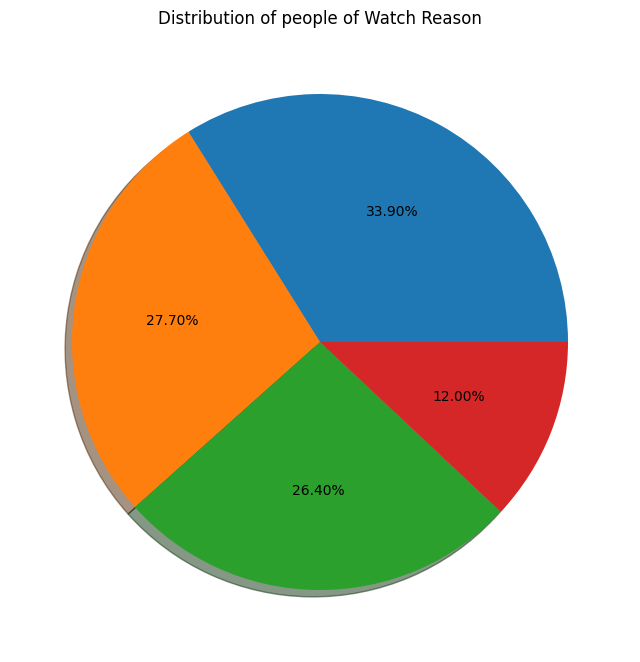

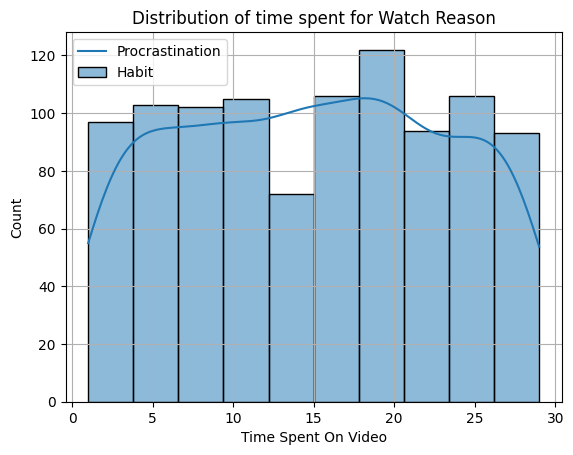

Total Time Spent On Video by different groups of Watch Reason
Watch Reason
Boredom            4222
Entertainment      3729
Habit              5284
Procrastination    1738
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


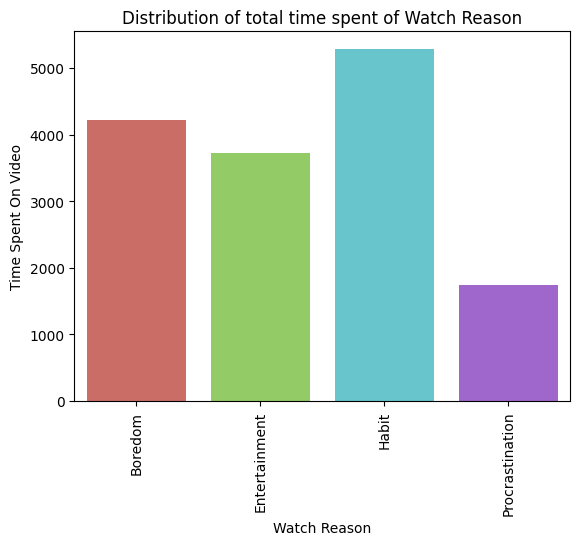

Average Time Spent On Video by different groups of Watch Reason
Watch Reason
Boredom            15.241877
Entertainment      14.125000
Habit              15.587021
Procrastination    14.483333
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


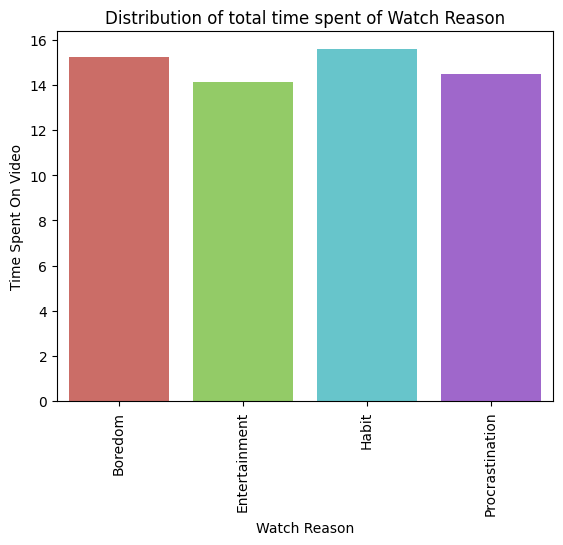

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


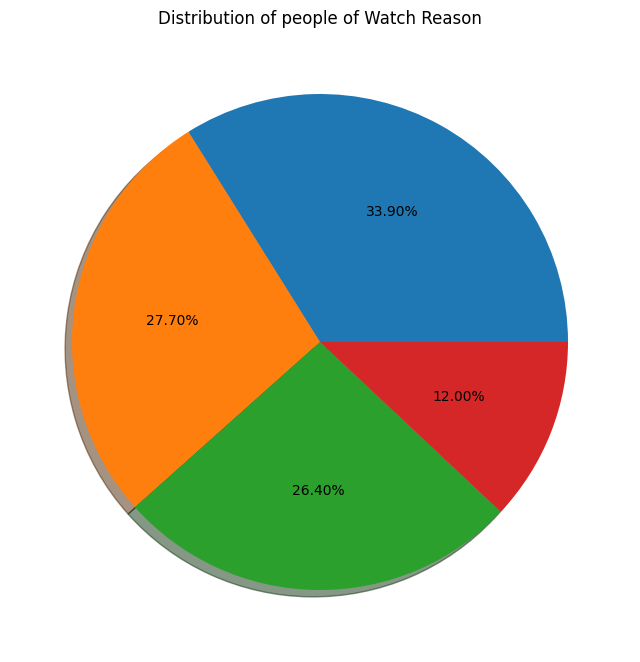

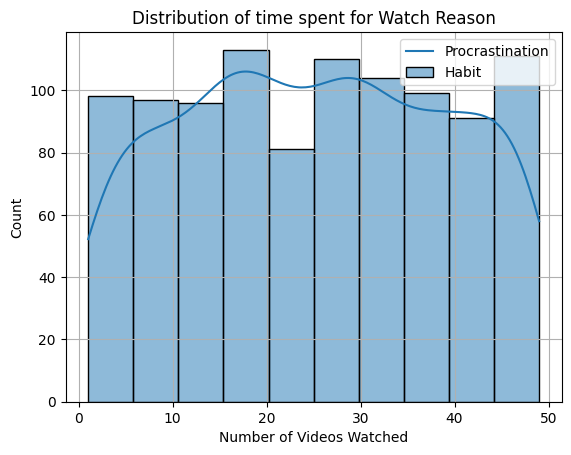

Total Number of Videos Watched by different groups of Watch Reason
Watch Reason
Boredom            6778
Entertainment      6574
Habit              8735
Procrastination    3161
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


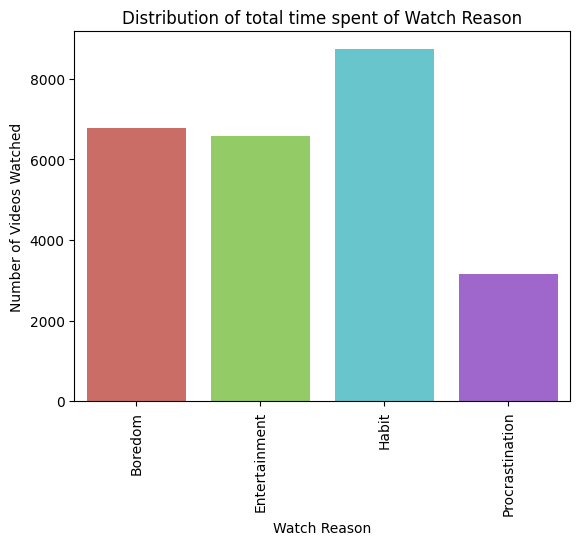

Average Number of Videos Watched by different groups of Watch Reason
Watch Reason
Boredom            24.469314
Entertainment      24.901515
Habit              25.766962
Procrastination    26.341667
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


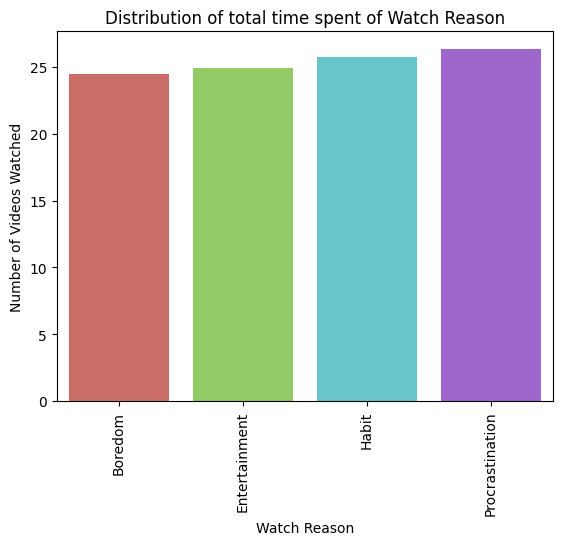

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


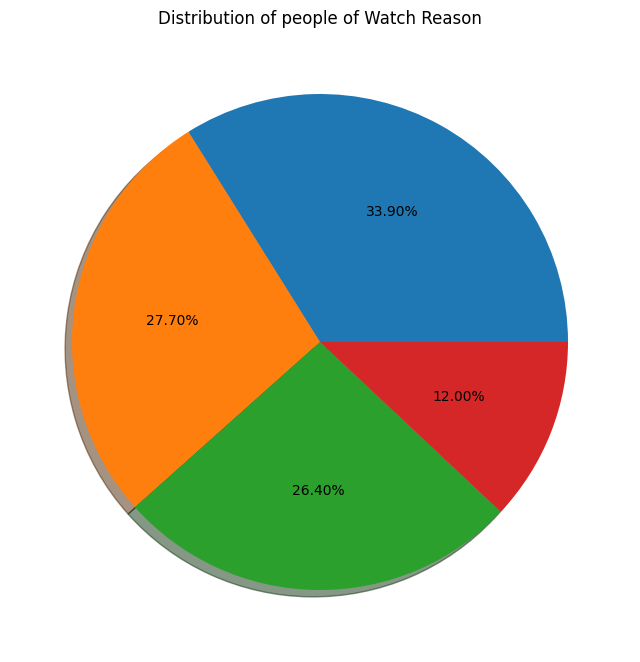

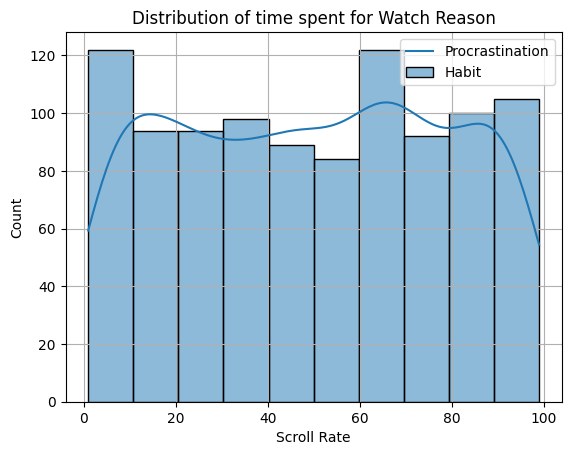

Total Scroll Rate by different groups of Watch Reason
Watch Reason
Boredom            13419
Entertainment      12999
Habit              17469
Procrastination     5887
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


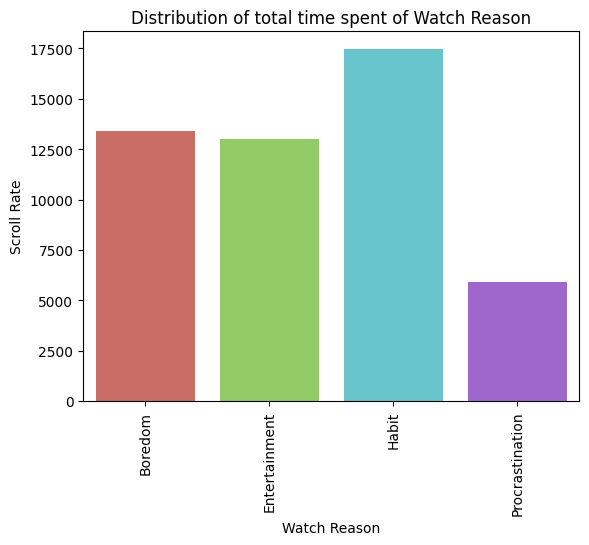

Average Scroll Rate by different groups of Watch Reason
Watch Reason
Boredom            48.444043
Entertainment      49.238636
Habit              51.530973
Procrastination    49.058333
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


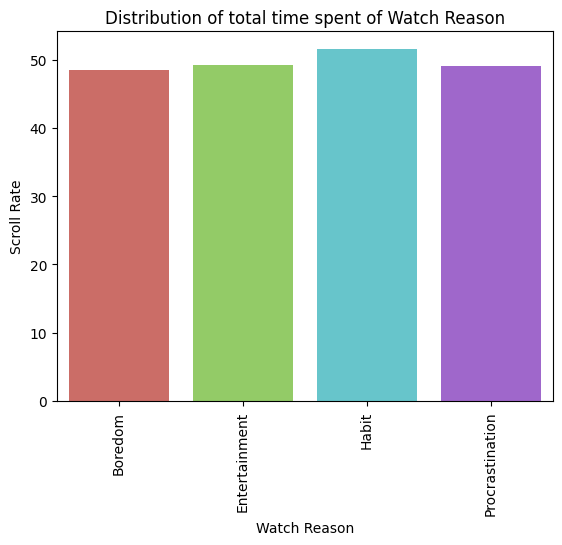

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


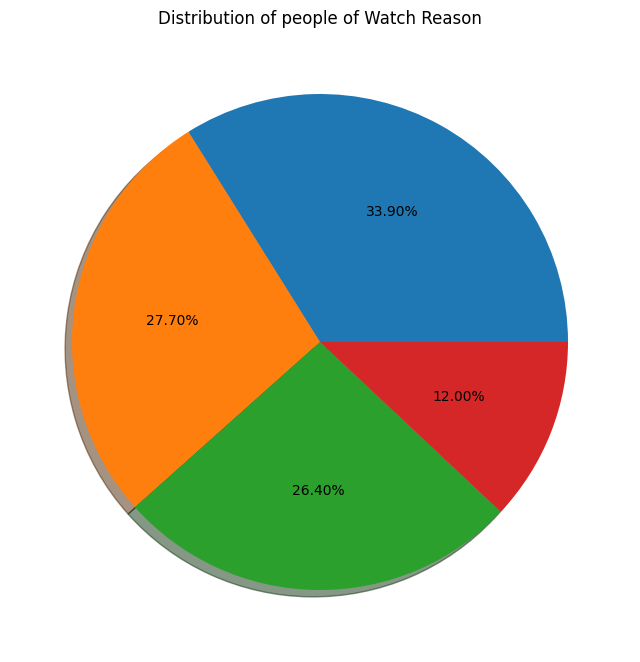

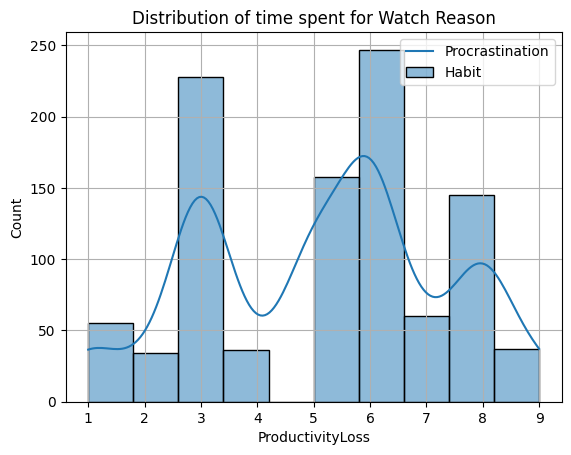

Total ProductivityLoss by different groups of Watch Reason
Watch Reason
Boredom            1472
Entertainment      1369
Habit              1693
Procrastination     602
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


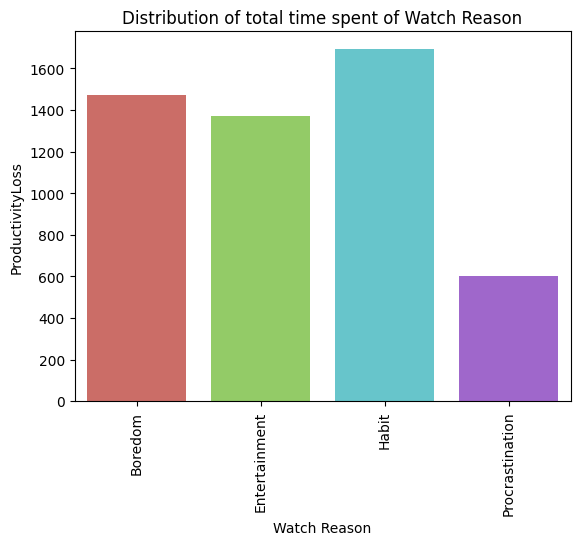

Average ProductivityLoss by different groups of Watch Reason
Watch Reason
Boredom            5.314079
Entertainment      5.185606
Habit              4.994100
Procrastination    5.016667
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


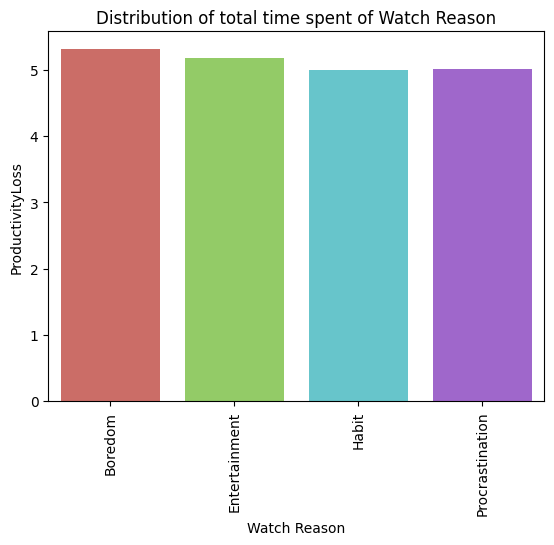

Watch Reason:
Distribution of people of Watch Reason
Watch Reason
Habit              33.9
Boredom            27.7
Entertainment      26.4
Procrastination    12.0
Name: count, dtype: float64


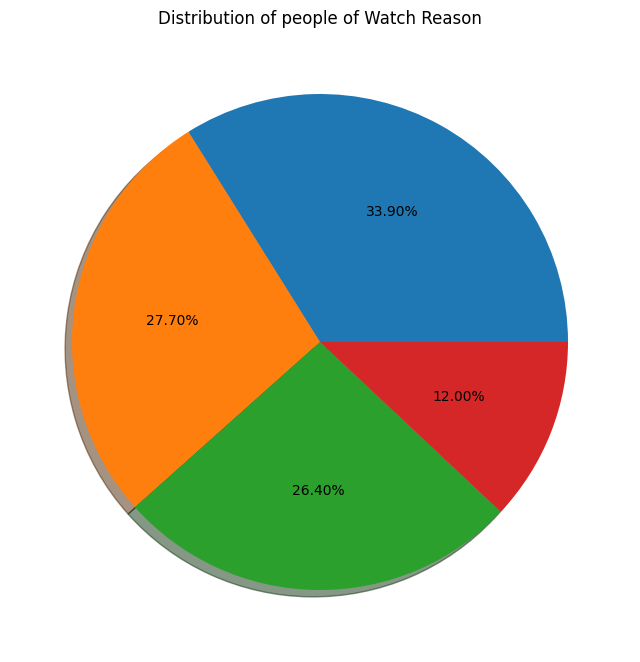

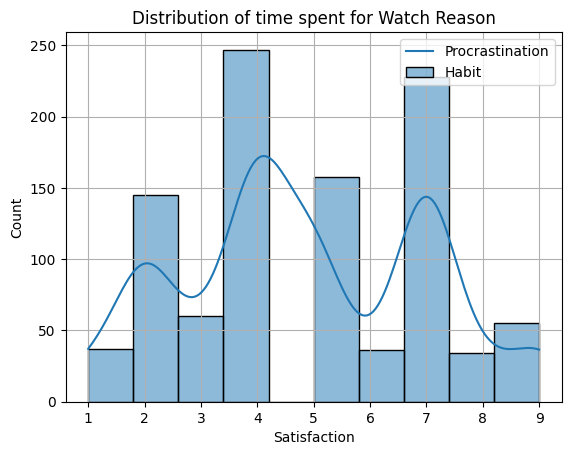

Total Satisfaction by different groups of Watch Reason
Watch Reason
Boredom            1298
Entertainment      1271
Habit              1697
Procrastination     598
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


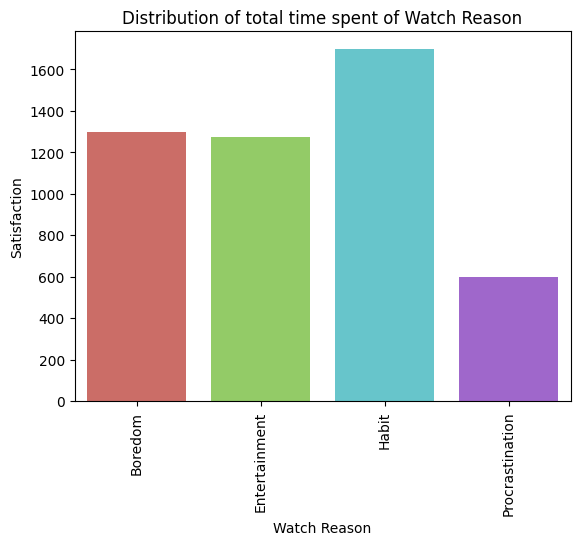

Average Satisfaction by different groups of Watch Reason
Watch Reason
Boredom            4.685921
Entertainment      4.814394
Habit              5.005900
Procrastination    4.983333
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


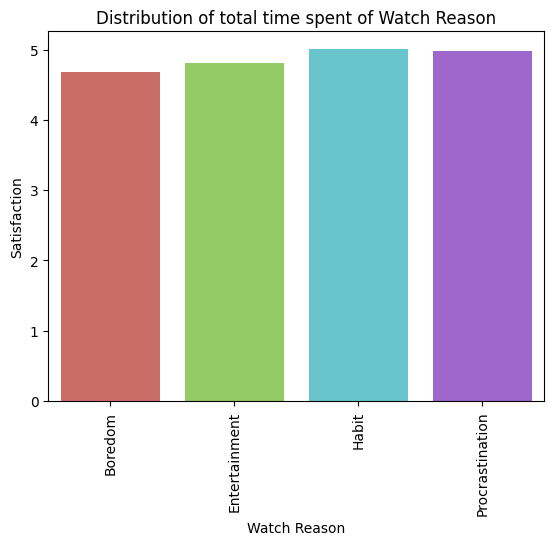

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


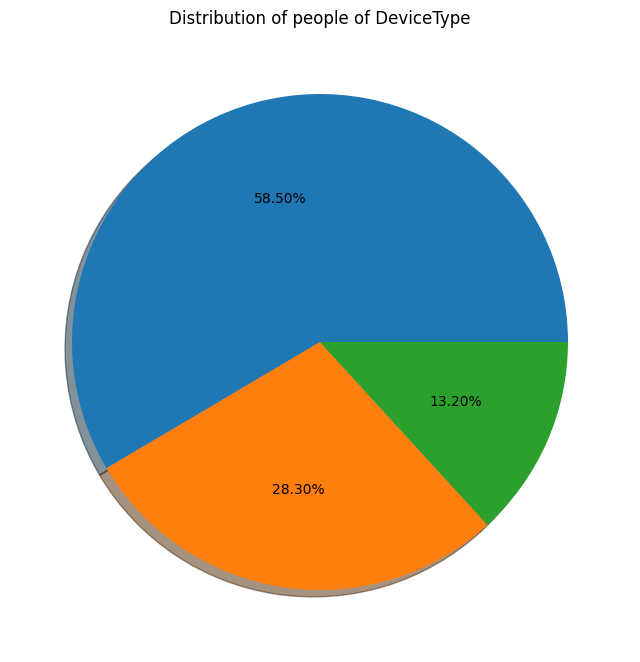

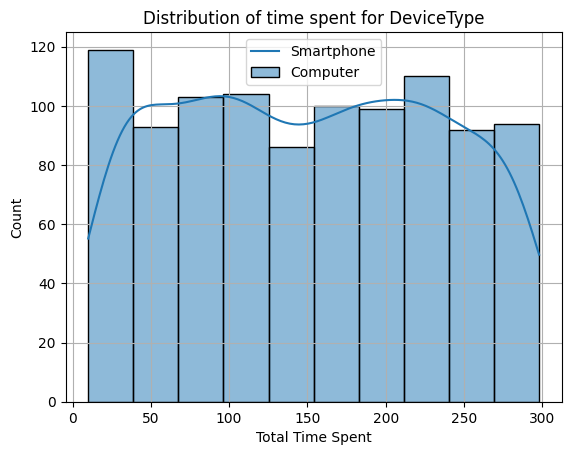

Total Total Time Spent by different groups of DeviceType
DeviceType
Computer      19849
Smartphone    89062
Tablet        42495
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


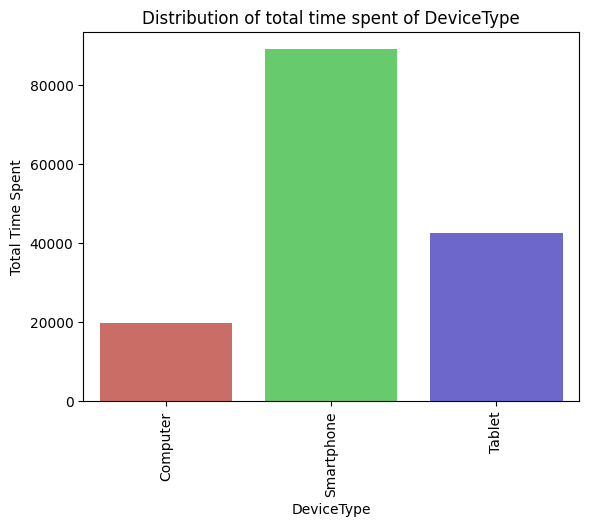

Average Total Time Spent by different groups of DeviceType
DeviceType
Computer      150.371212
Smartphone    152.242735
Tablet        150.159011
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


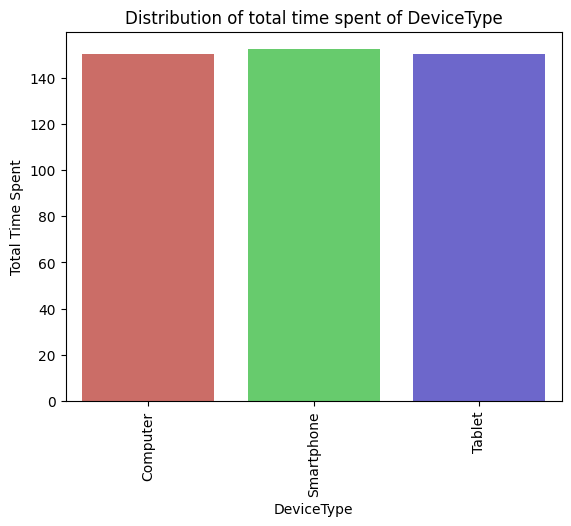

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


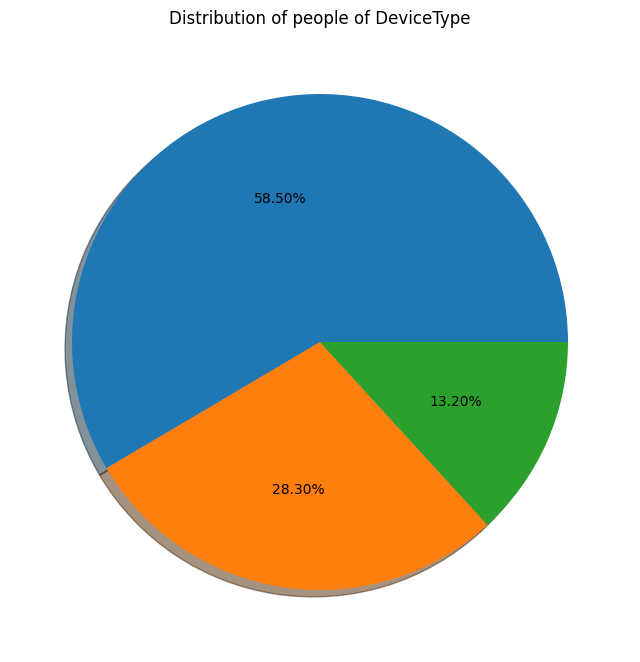

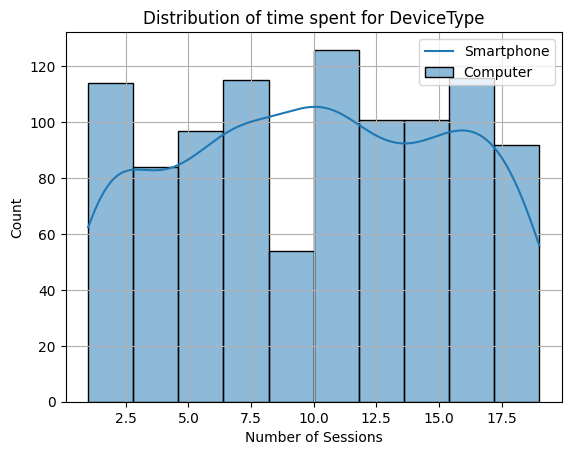

Total Number of Sessions by different groups of DeviceType
DeviceType
Computer      1267
Smartphone    5914
Tablet        2832
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


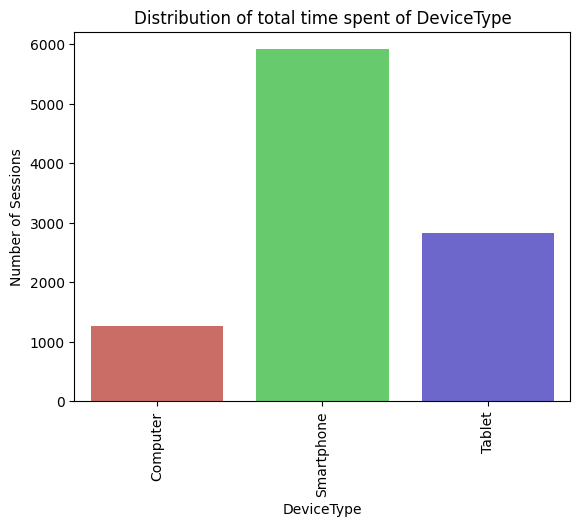

Average Number of Sessions by different groups of DeviceType
DeviceType
Computer       9.598485
Smartphone    10.109402
Tablet        10.007067
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


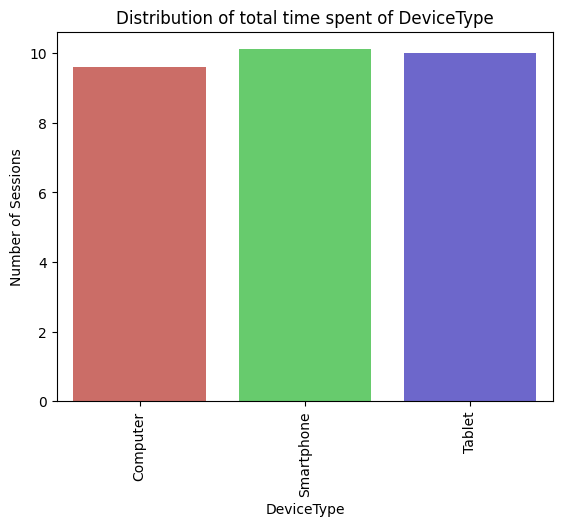

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


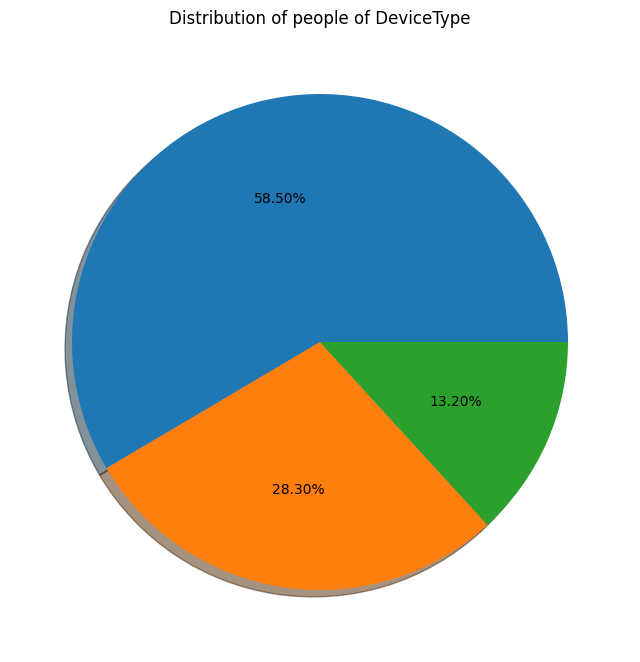

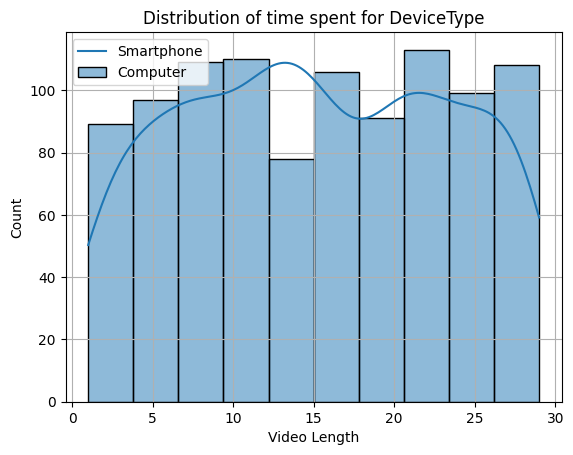

Total Video Length by different groups of DeviceType
DeviceType
Computer      1859
Smartphone    9156
Tablet        4199
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


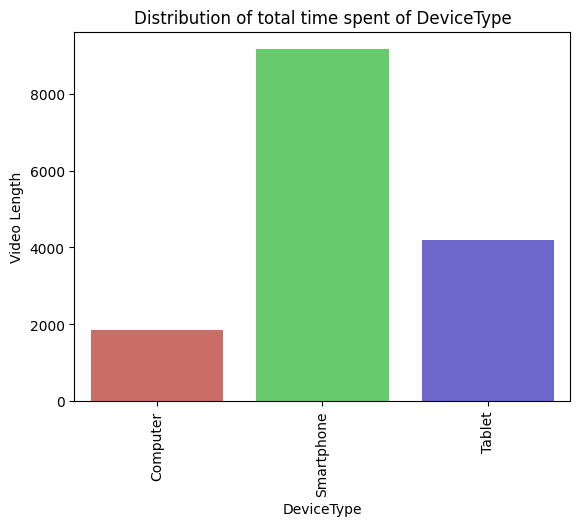

Average Video Length by different groups of DeviceType
DeviceType
Computer      14.083333
Smartphone    15.651282
Tablet        14.837456
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


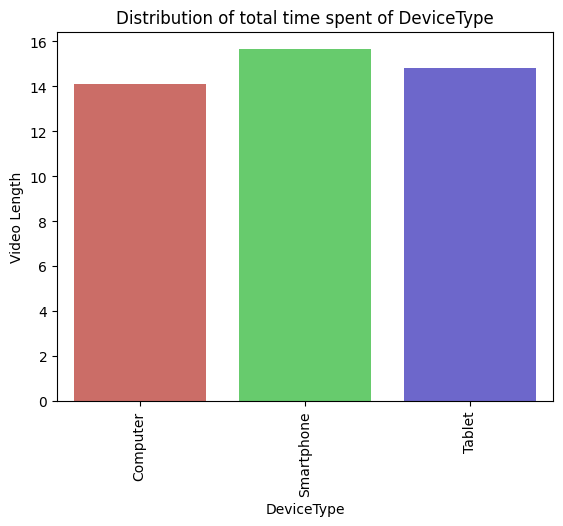

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


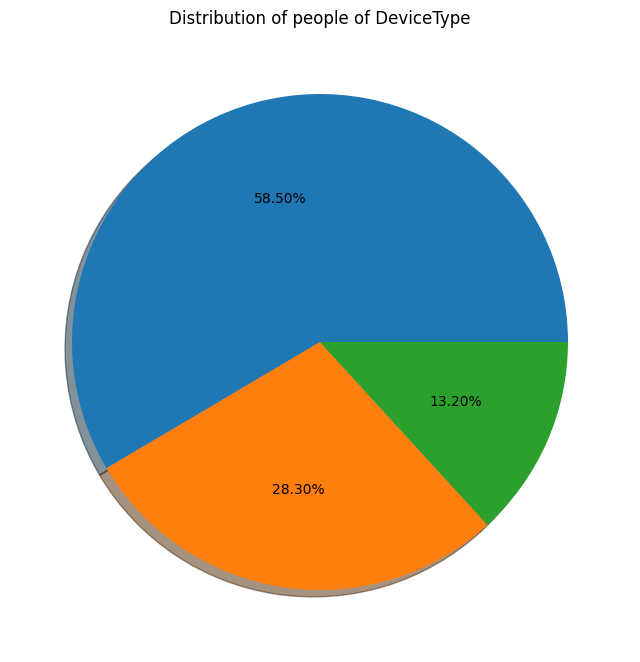

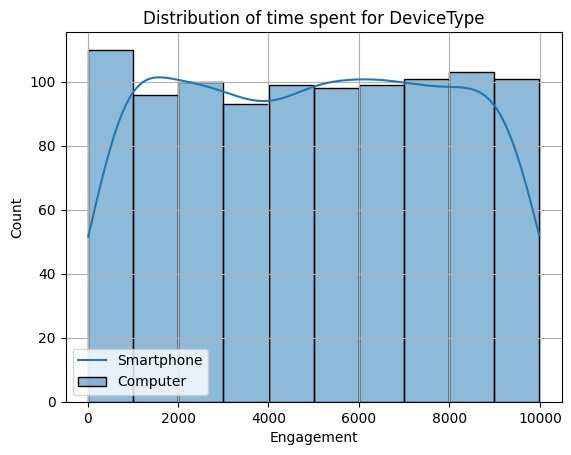

Total Engagement by different groups of DeviceType
DeviceType
Computer       715670
Smartphone    2868237
Tablet        1413252
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


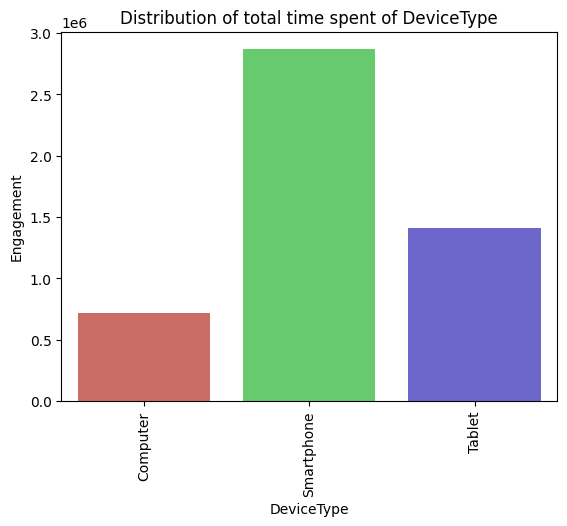

Average Engagement by different groups of DeviceType
DeviceType
Computer      5421.742424
Smartphone    4902.969231
Tablet        4993.823322
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


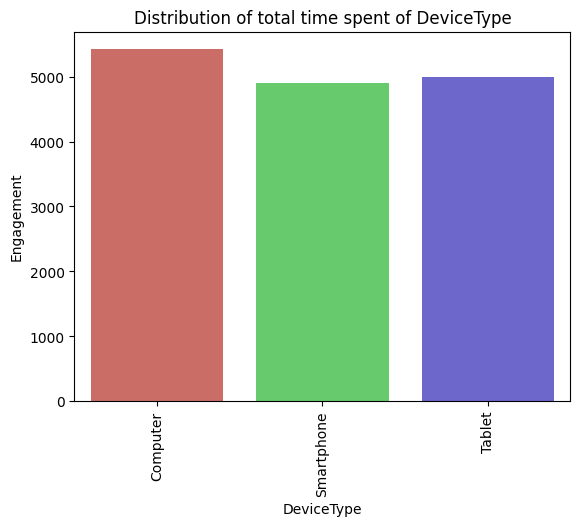

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


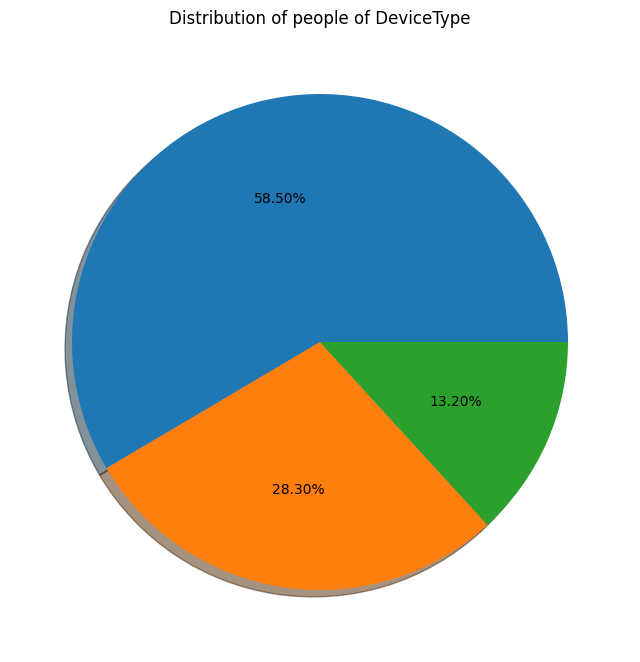

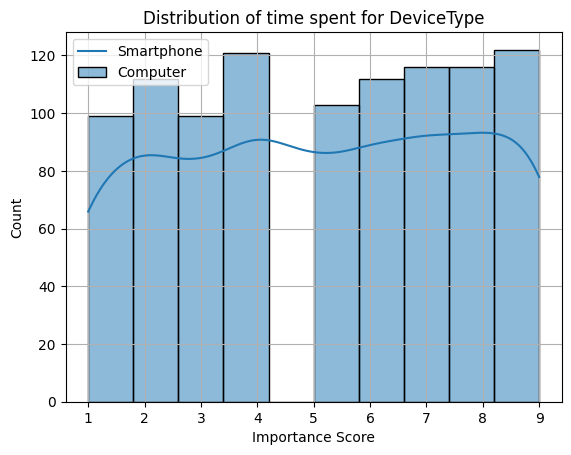

Total Importance Score by different groups of DeviceType
DeviceType
Computer       698
Smartphone    2985
Tablet        1446
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


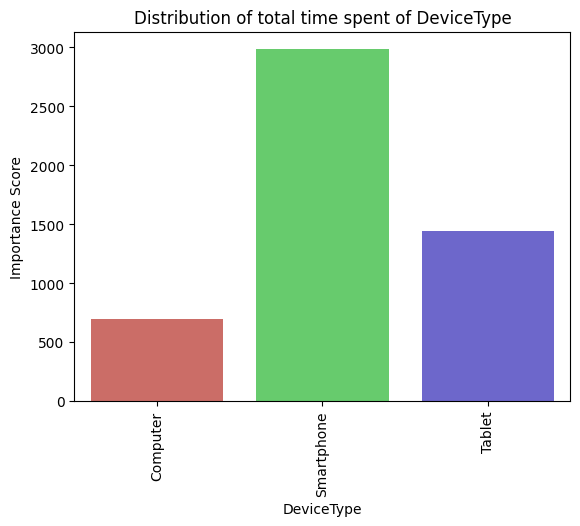

Average Importance Score by different groups of DeviceType
DeviceType
Computer      5.287879
Smartphone    5.102564
Tablet        5.109541
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


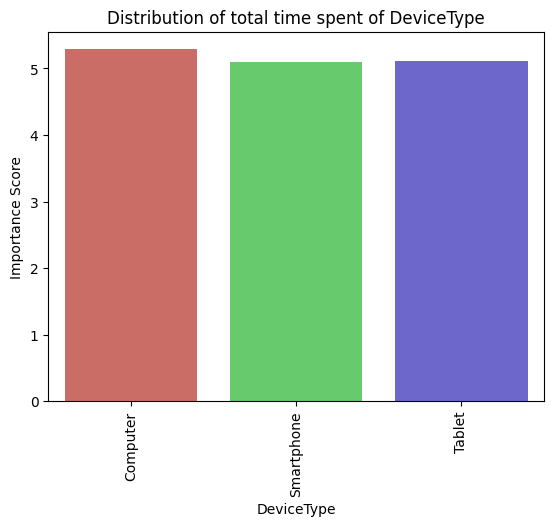

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


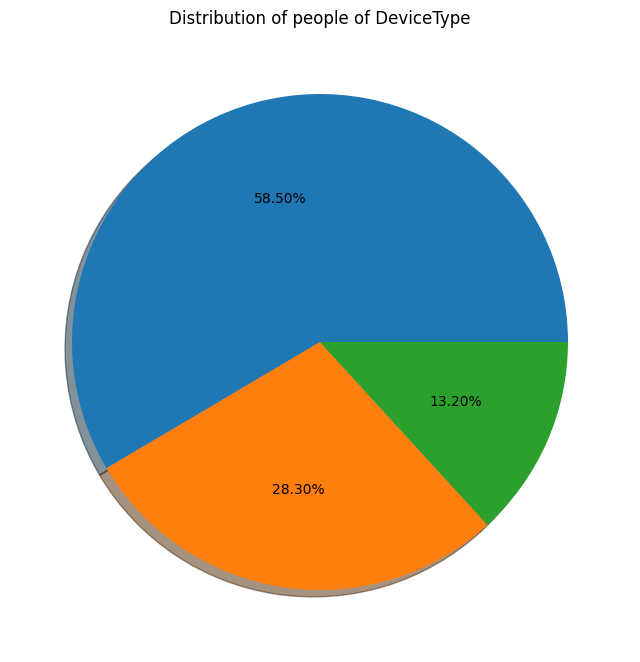

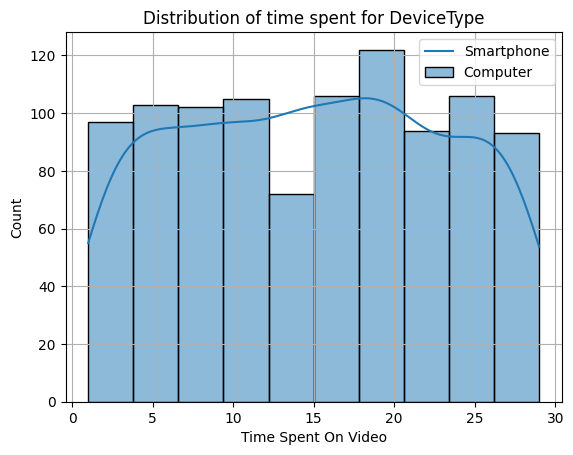

Total Time Spent On Video by different groups of DeviceType
DeviceType
Computer      1876
Smartphone    8746
Tablet        4351
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


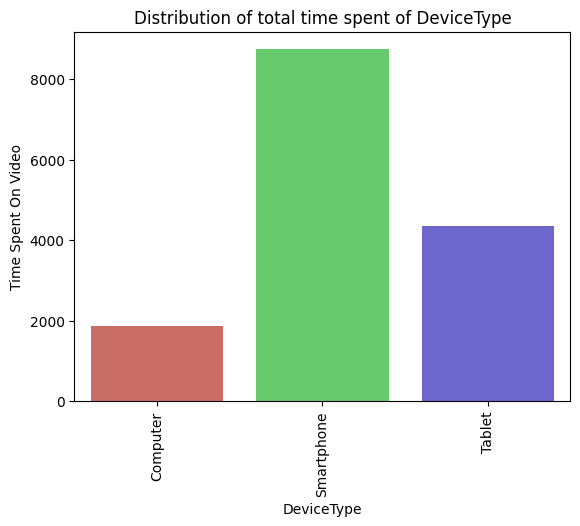

Average Time Spent On Video by different groups of DeviceType
DeviceType
Computer      14.212121
Smartphone    14.950427
Tablet        15.374558
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


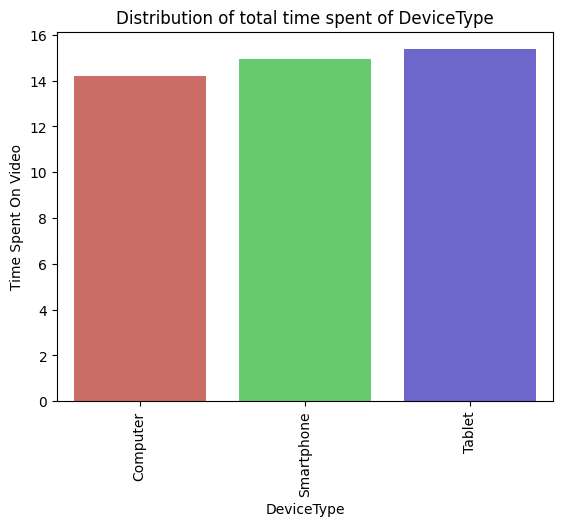

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


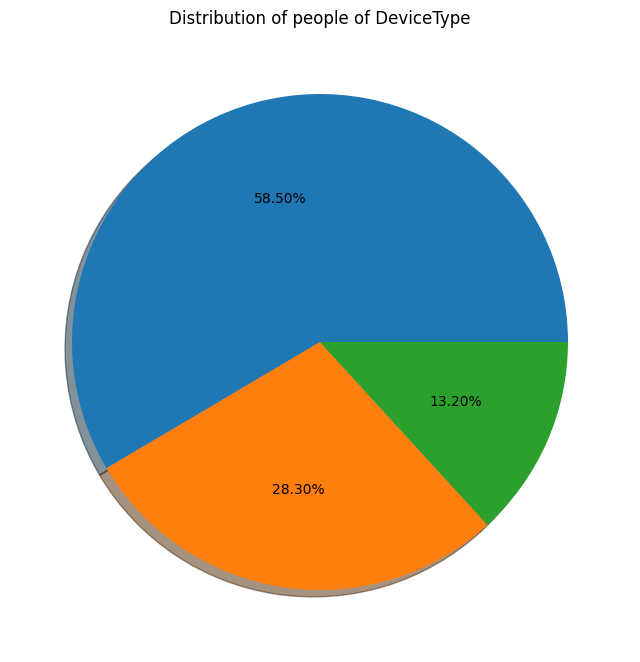

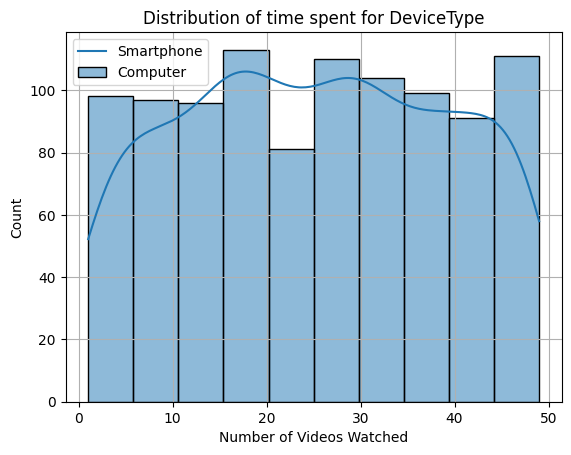

Total Number of Videos Watched by different groups of DeviceType
DeviceType
Computer       3389
Smartphone    14758
Tablet         7101
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


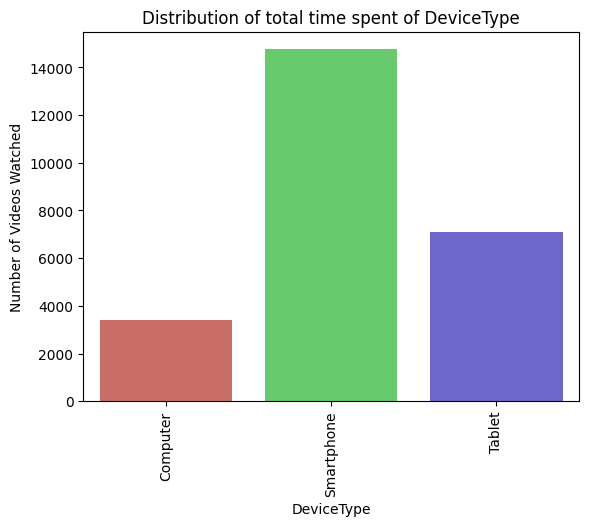

Average Number of Videos Watched by different groups of DeviceType
DeviceType
Computer      25.674242
Smartphone    25.227350
Tablet        25.091873
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


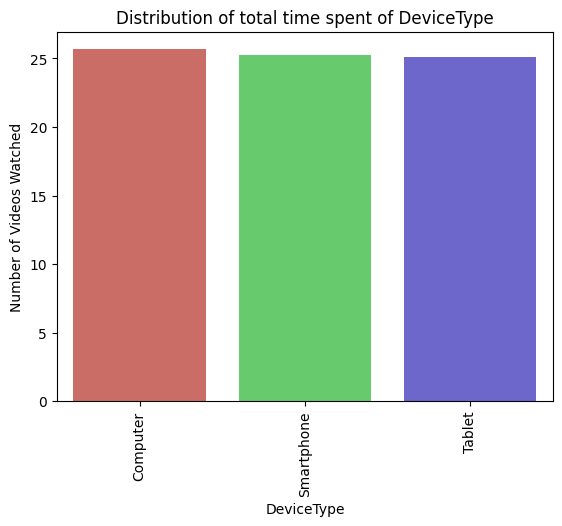

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


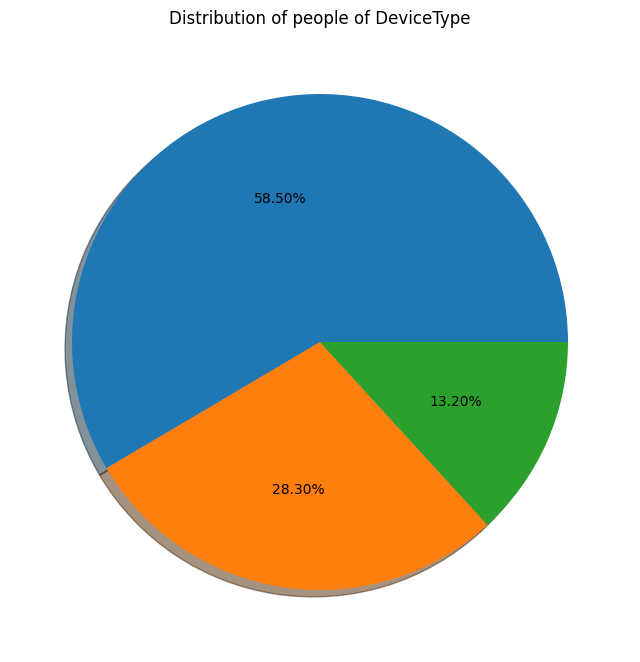

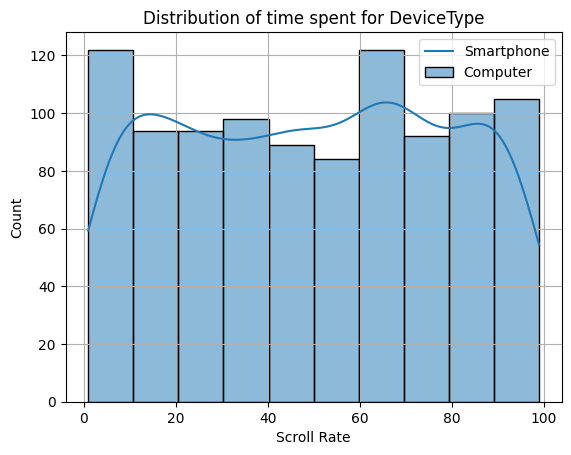

Total Scroll Rate by different groups of DeviceType
DeviceType
Computer       6407
Smartphone    29219
Tablet        14148
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


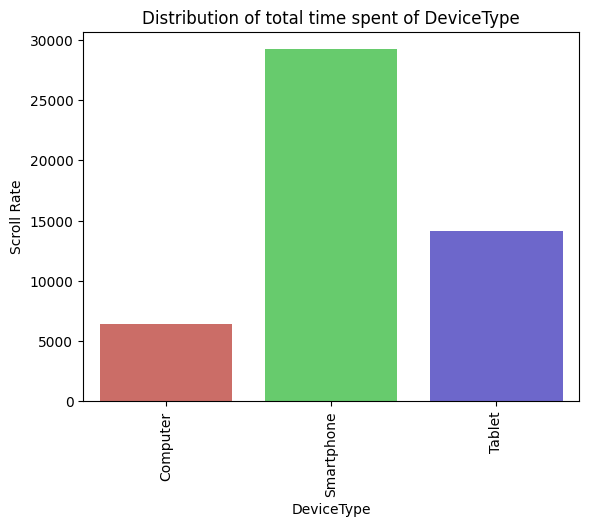

Average Scroll Rate by different groups of DeviceType
DeviceType
Computer      48.537879
Smartphone    49.947009
Tablet        49.992933
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


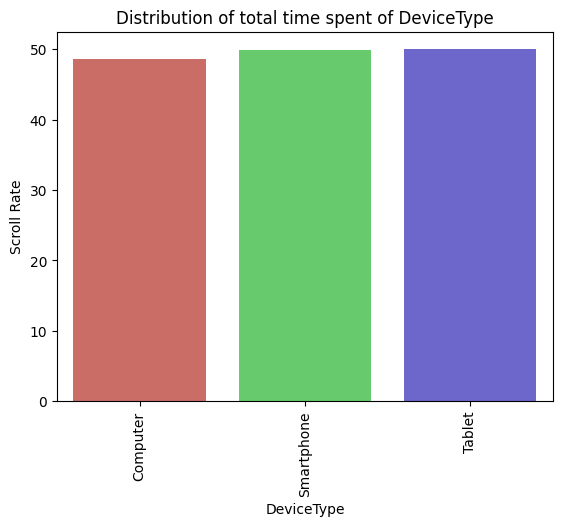

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


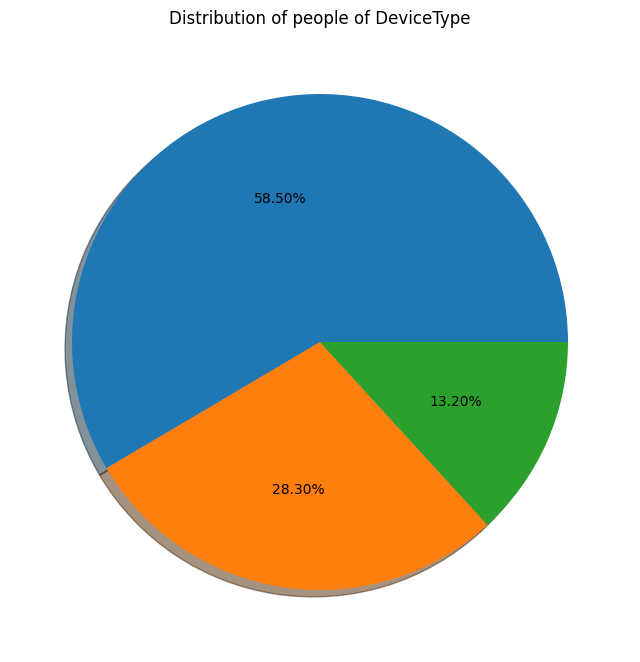

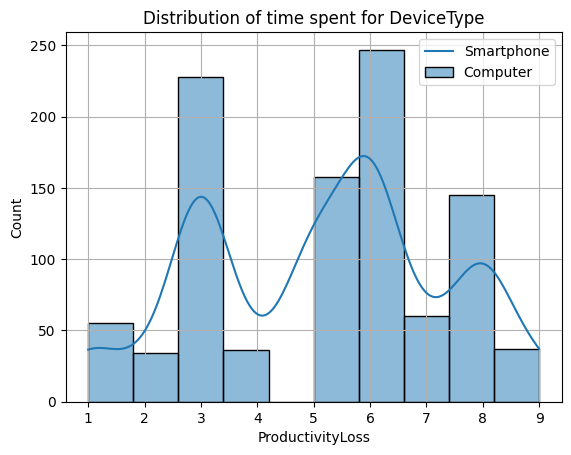

Total ProductivityLoss by different groups of DeviceType
DeviceType
Computer       679
Smartphone    3052
Tablet        1405
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


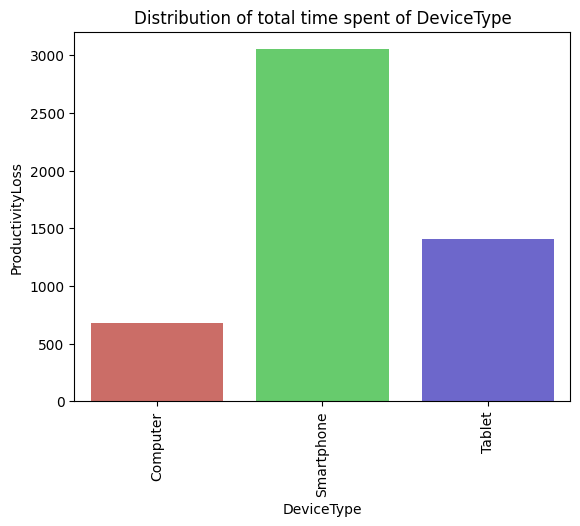

Average ProductivityLoss by different groups of DeviceType
DeviceType
Computer      5.143939
Smartphone    5.217094
Tablet        4.964664
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


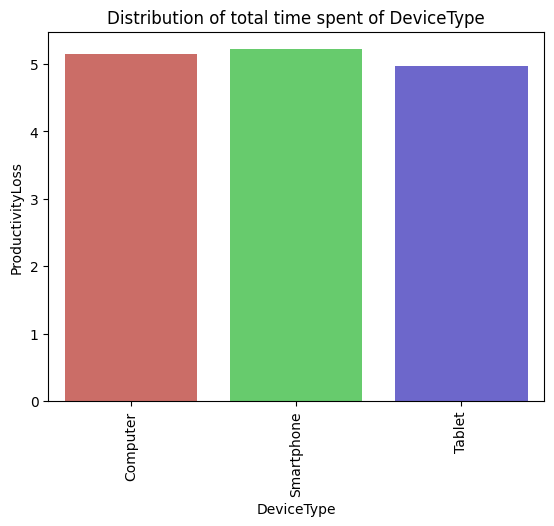

DeviceType:
Distribution of people of DeviceType
DeviceType
Smartphone    58.5
Tablet        28.3
Computer      13.2
Name: count, dtype: float64


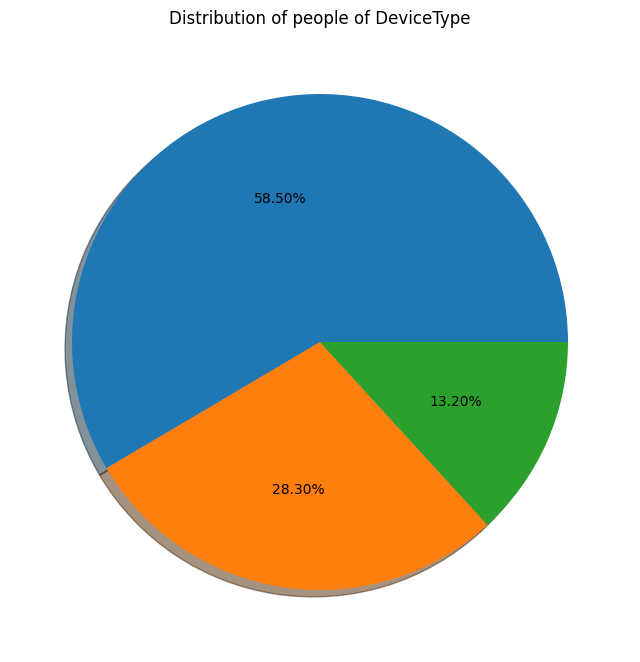

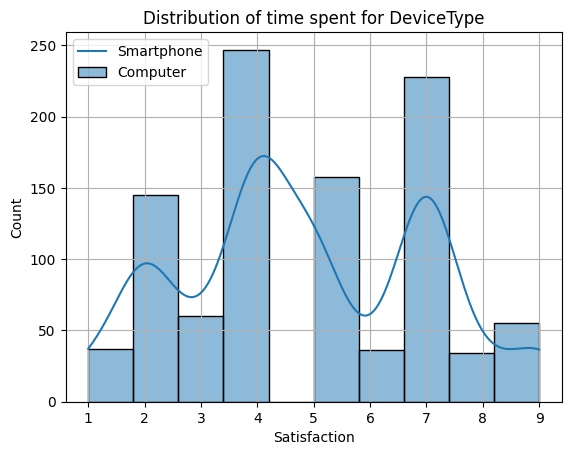

Total Satisfaction by different groups of DeviceType
DeviceType
Computer       641
Smartphone    2798
Tablet        1425
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


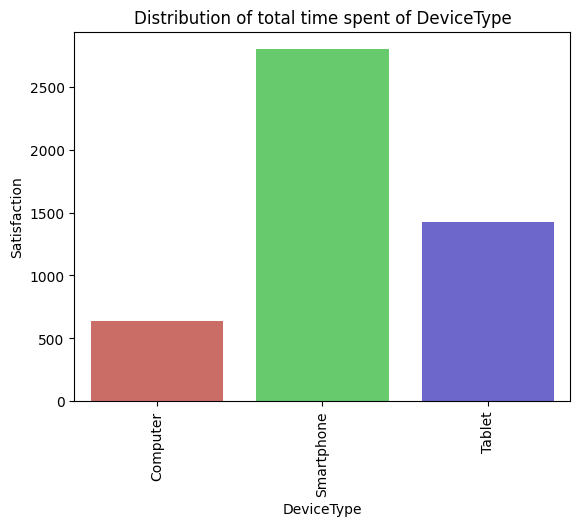

Average Satisfaction by different groups of DeviceType
DeviceType
Computer      4.856061
Smartphone    4.782906
Tablet        5.035336
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


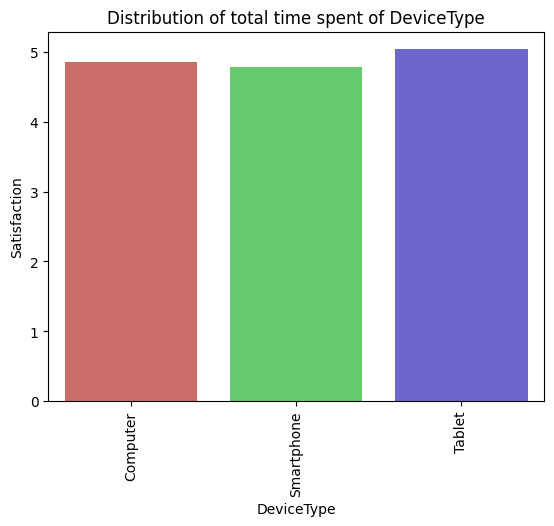

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


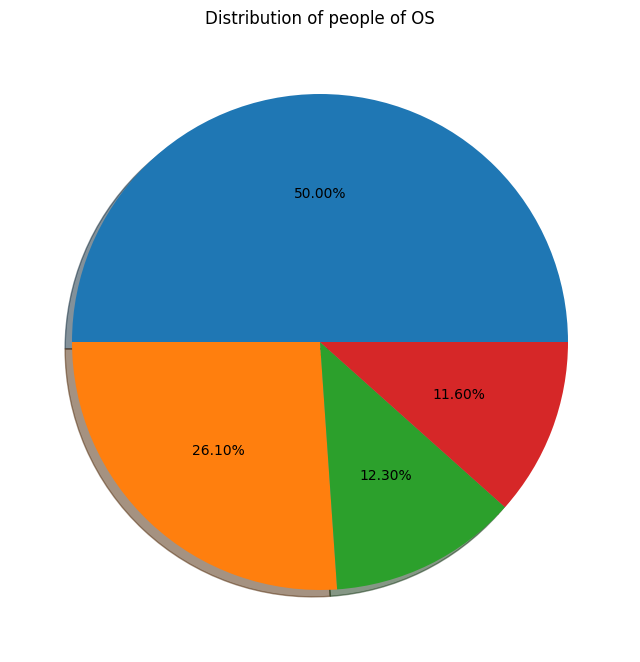

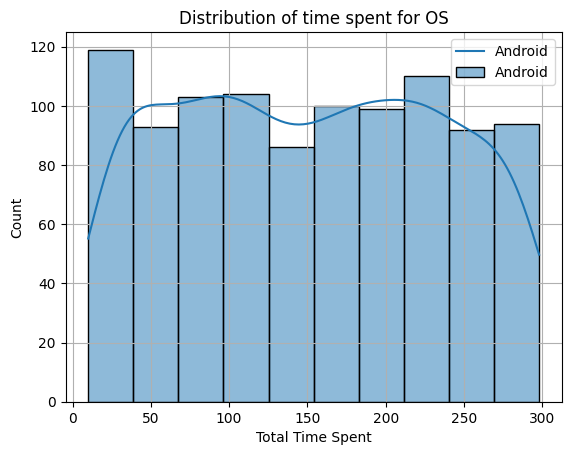

Total Total Time Spent by different groups of OS
OS
Android    76007
MacOS      17993
Windows    17575
iOS        39831
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


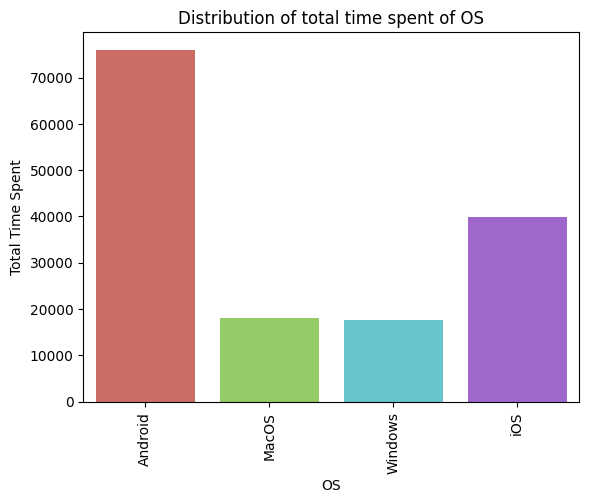

Average Total Time Spent by different groups of OS
OS
Android    152.014000
MacOS      155.112069
Windows    142.886179
iOS        152.609195
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


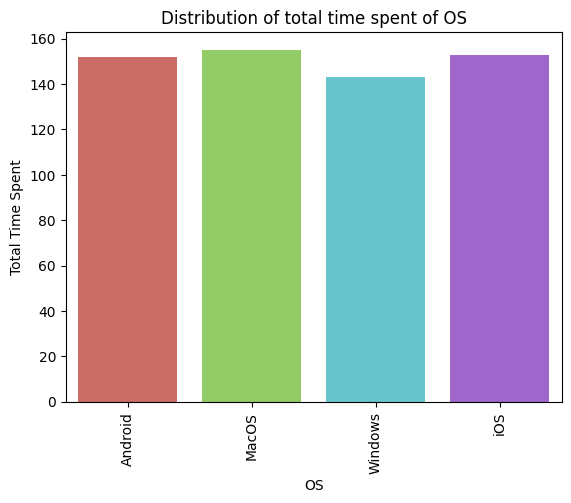

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


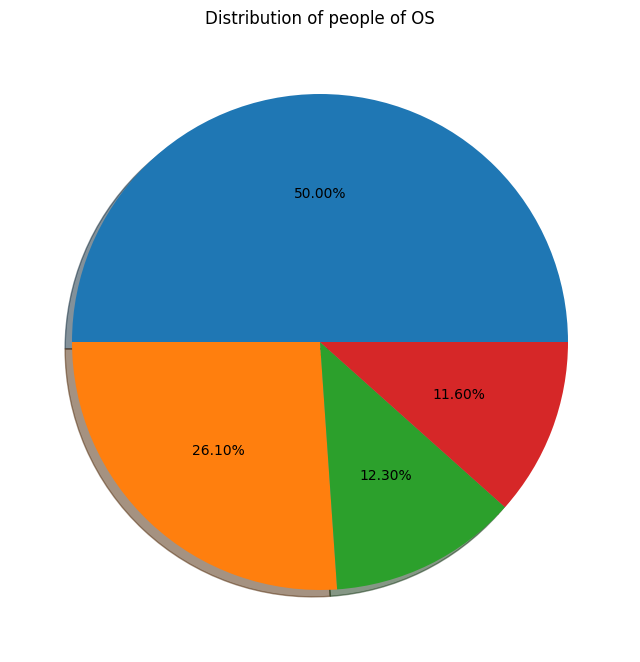

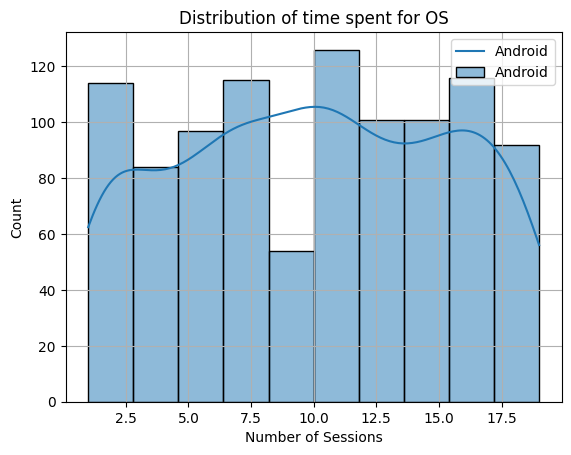

Total Number of Sessions by different groups of OS
OS
Android    5159
MacOS      1164
Windows    1204
iOS        2486
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


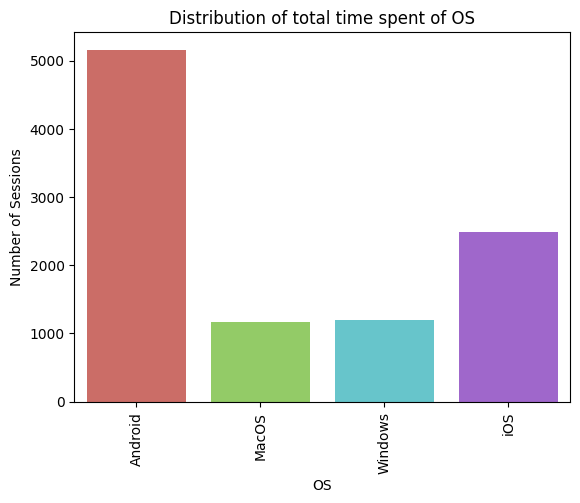

Average Number of Sessions by different groups of OS
OS
Android    10.318000
MacOS      10.034483
Windows     9.788618
iOS         9.524904
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


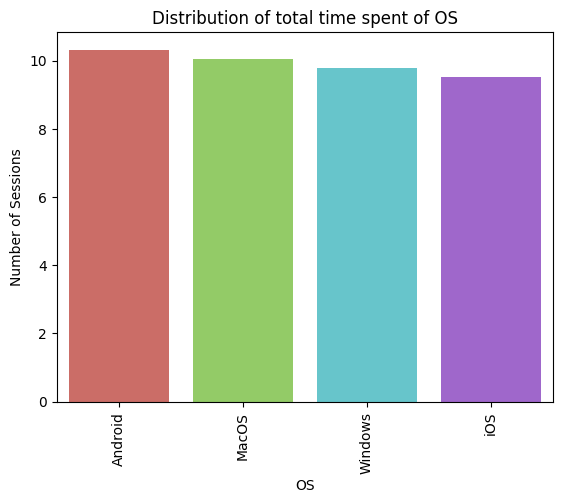

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


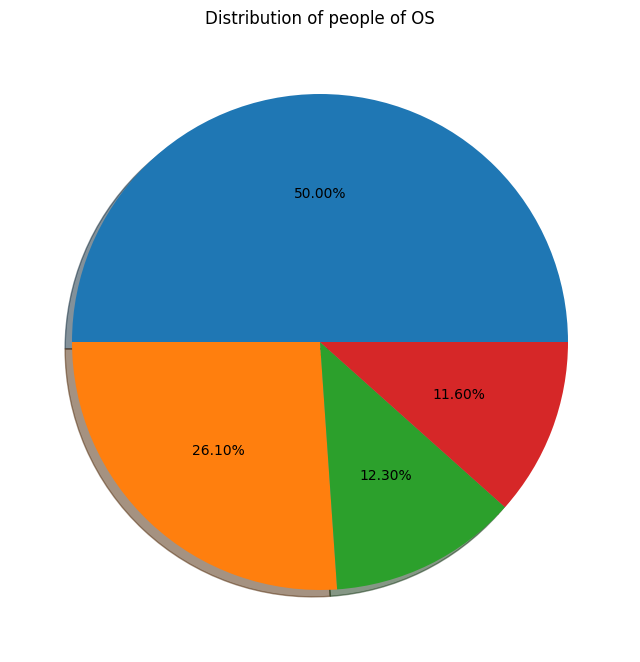

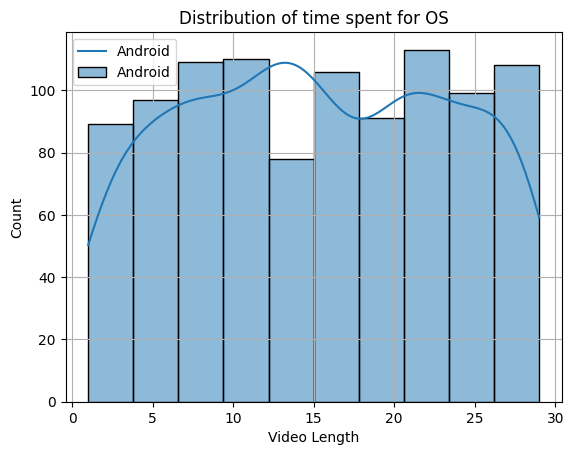

Total Video Length by different groups of OS
OS
Android    7450
MacOS      1777
Windows    1884
iOS        4103
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


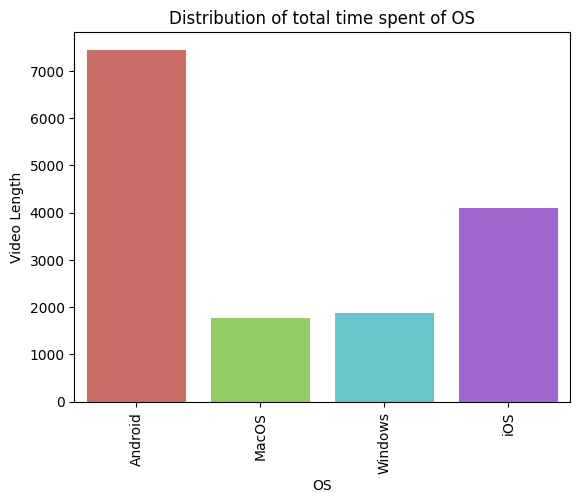

Average Video Length by different groups of OS
OS
Android    14.900000
MacOS      15.318966
Windows    15.317073
iOS        15.720307
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


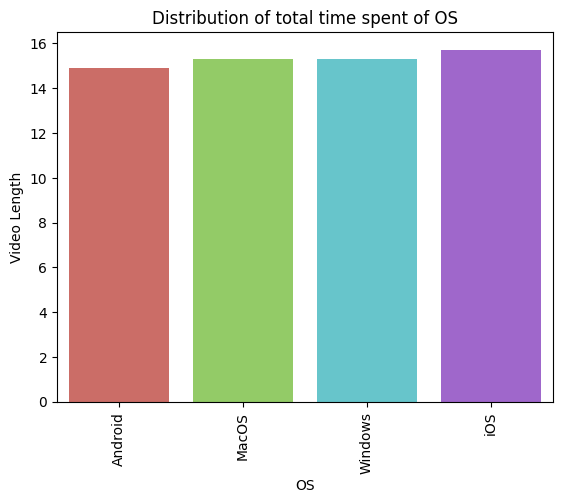

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


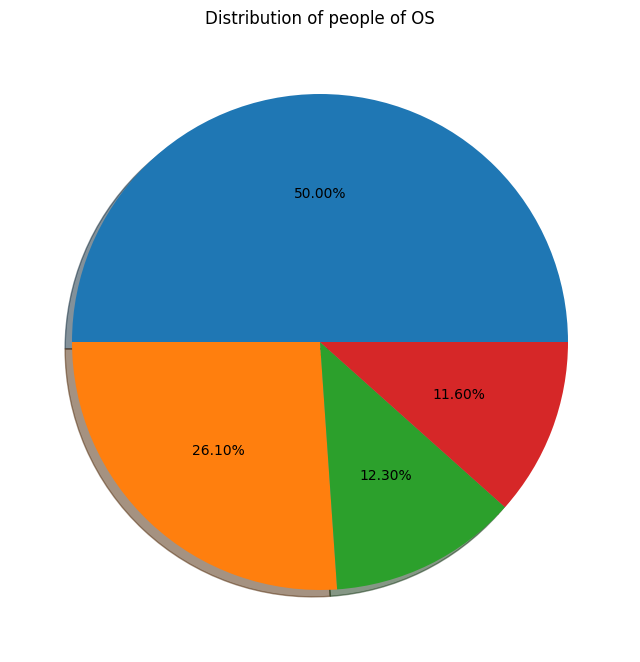

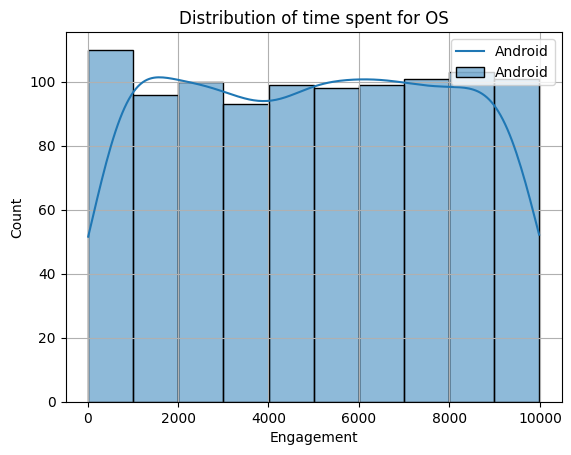

Total Engagement by different groups of OS
OS
Android    2465463
MacOS       546051
Windows     604803
iOS        1380842
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


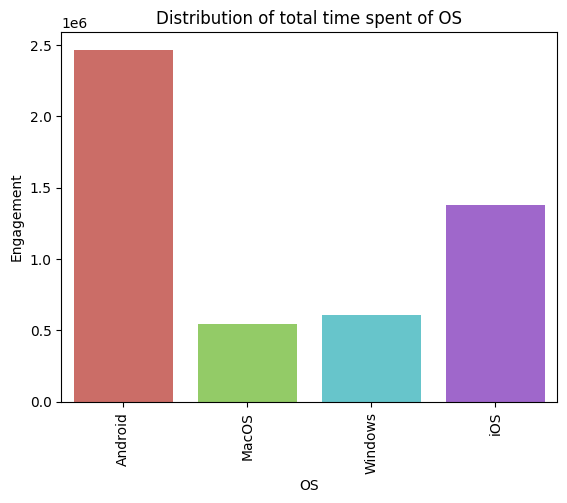

Average Engagement by different groups of OS
OS
Android    4930.926000
MacOS      4707.336207
Windows    4917.097561
iOS        5290.582375
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


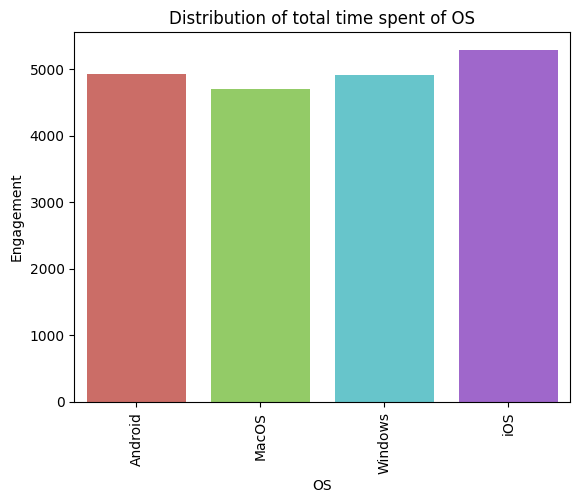

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


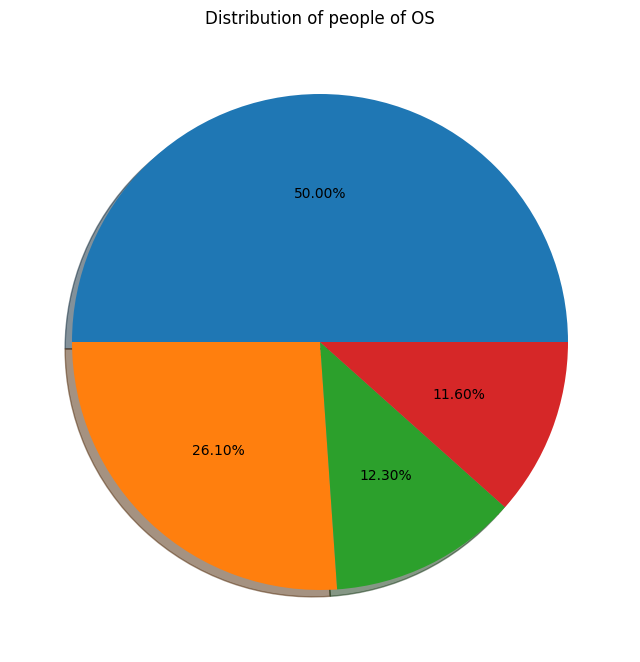

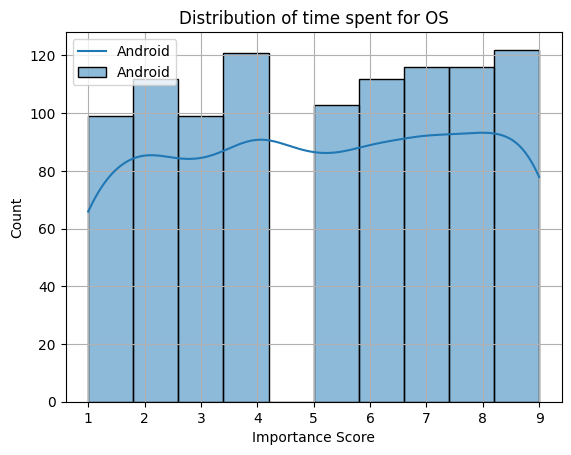

Total Importance Score by different groups of OS
OS
Android    2563
MacOS       562
Windows     599
iOS        1405
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


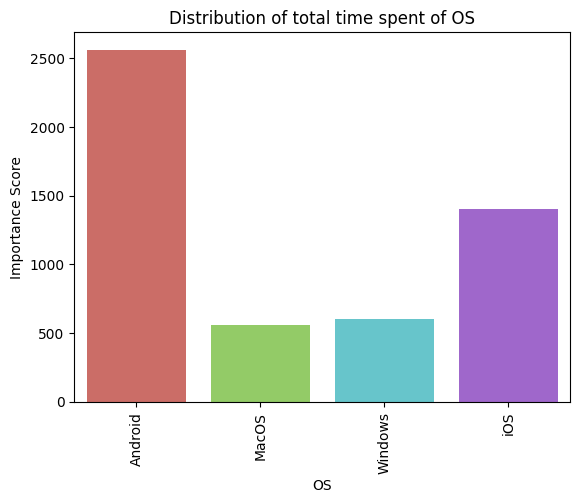

Average Importance Score by different groups of OS
OS
Android    5.126000
MacOS      4.844828
Windows    4.869919
iOS        5.383142
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


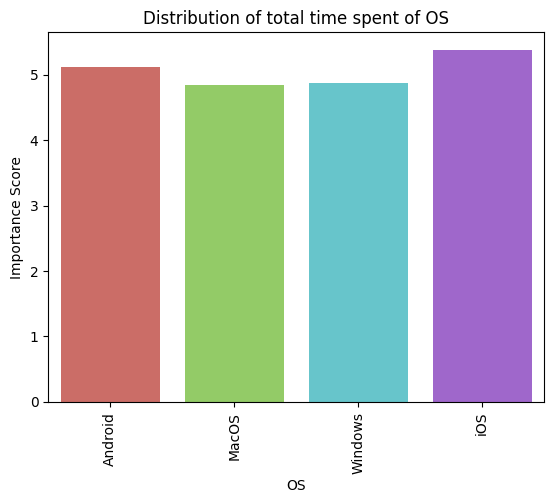

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


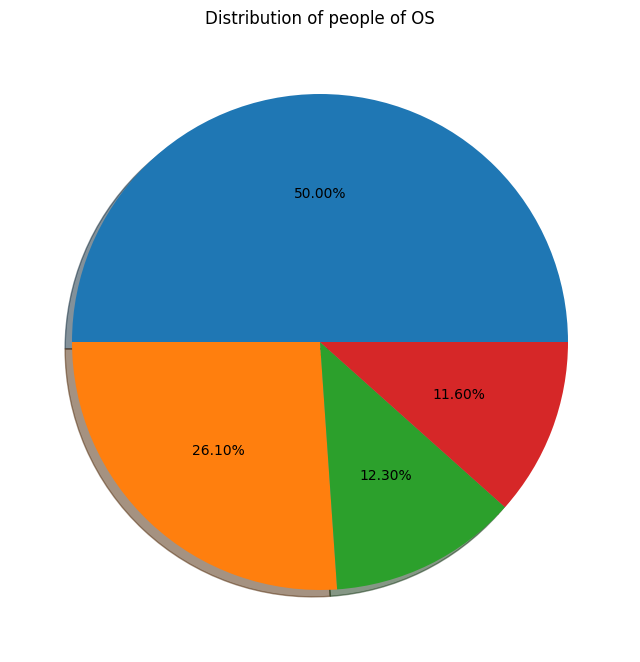

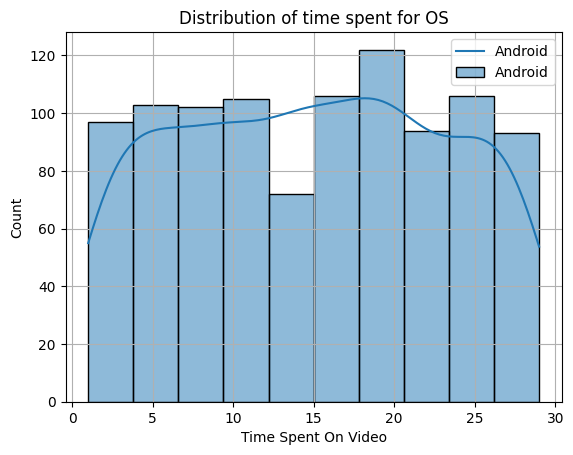

Total Time Spent On Video by different groups of OS
OS
Android    7580
MacOS      1571
Windows    1784
iOS        4038
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


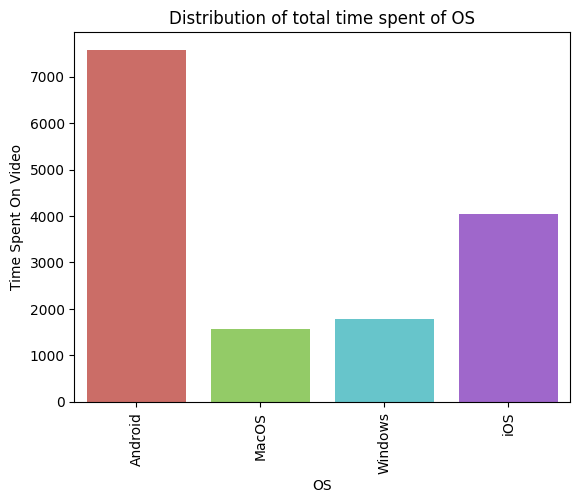

Average Time Spent On Video by different groups of OS
OS
Android    15.160000
MacOS      13.543103
Windows    14.504065
iOS        15.471264
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


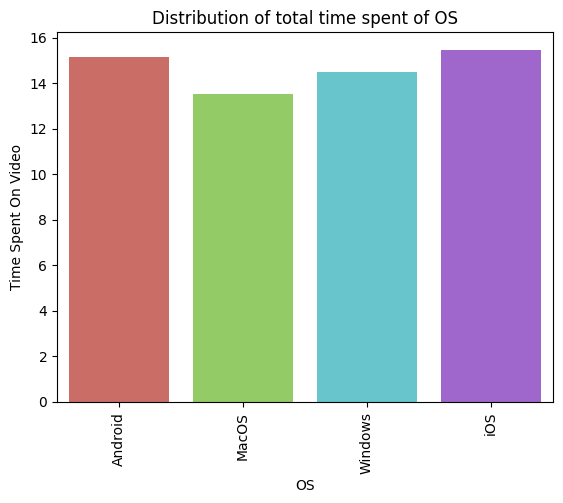

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


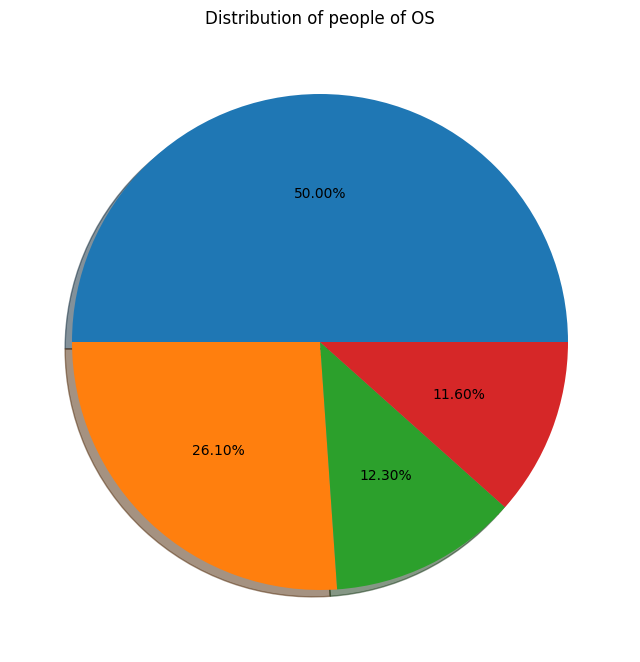

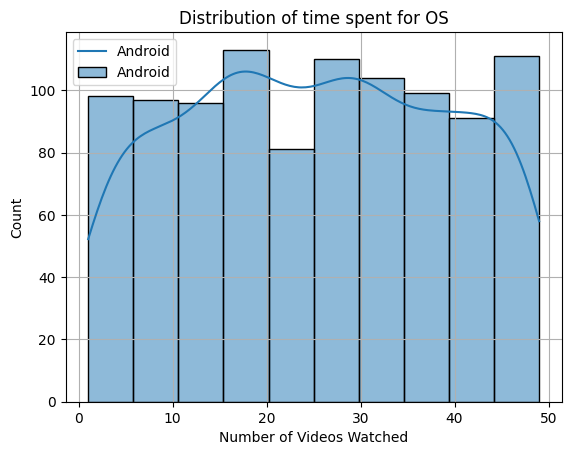

Total Number of Videos Watched by different groups of OS
OS
Android    12664
MacOS       3120
Windows     3200
iOS         6264
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


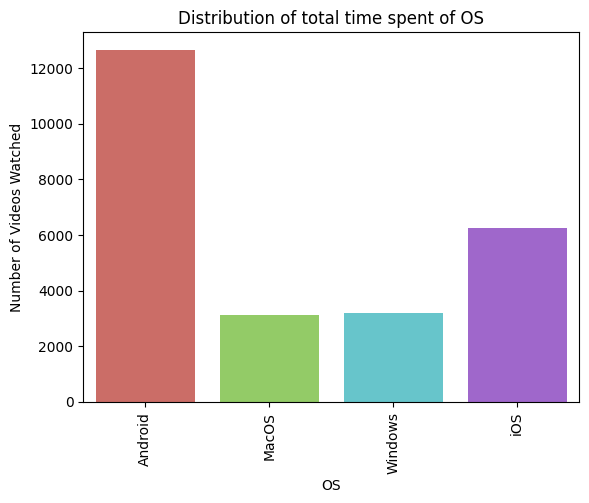

Average Number of Videos Watched by different groups of OS
OS
Android    25.328000
MacOS      26.896552
Windows    26.016260
iOS        24.000000
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


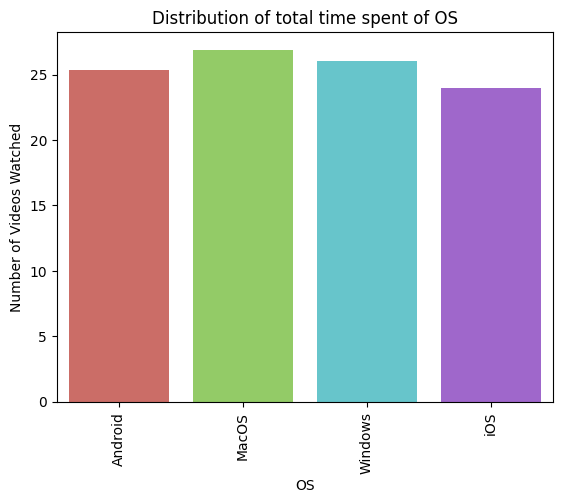

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


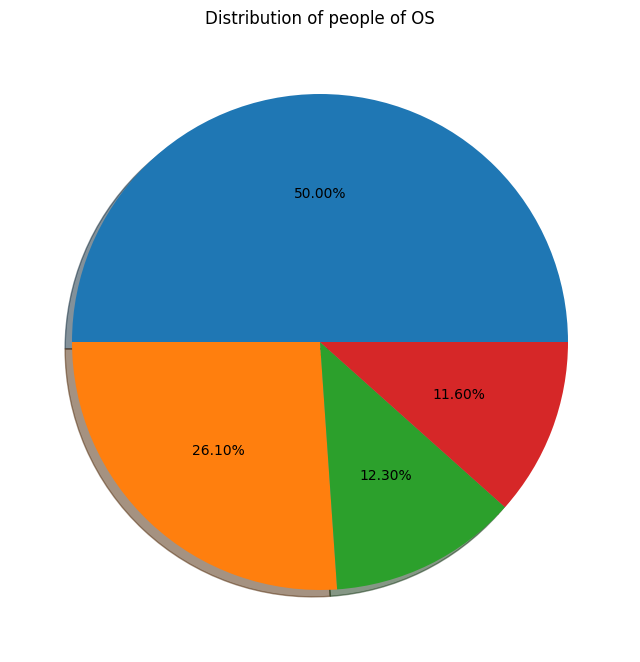

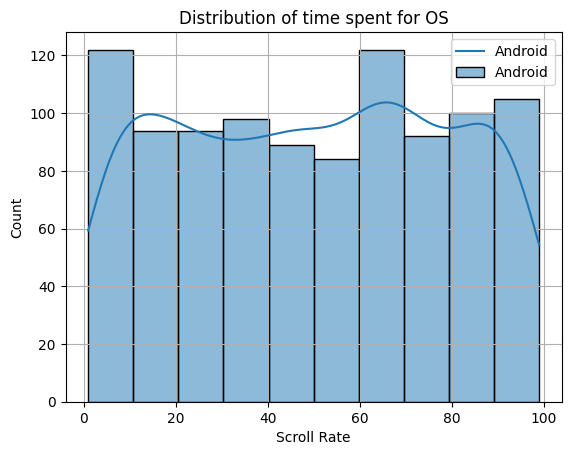

Total Scroll Rate by different groups of OS
OS
Android    25142
MacOS       6072
Windows     5892
iOS        12668
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


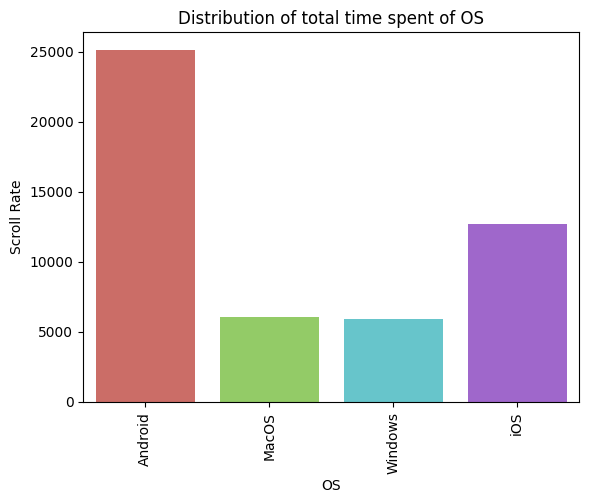

Average Scroll Rate by different groups of OS
OS
Android    50.284000
MacOS      52.344828
Windows    47.902439
iOS        48.536398
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


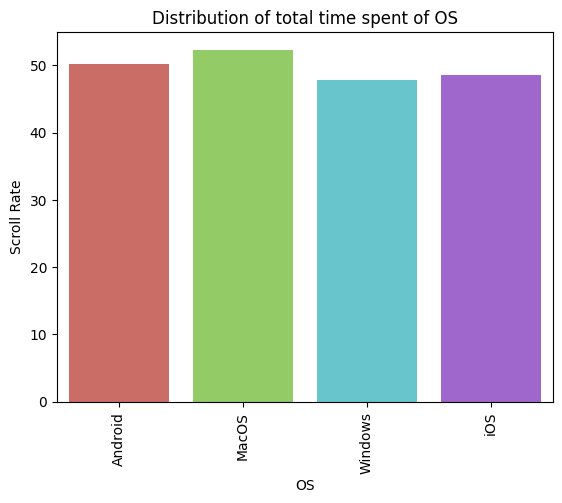

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


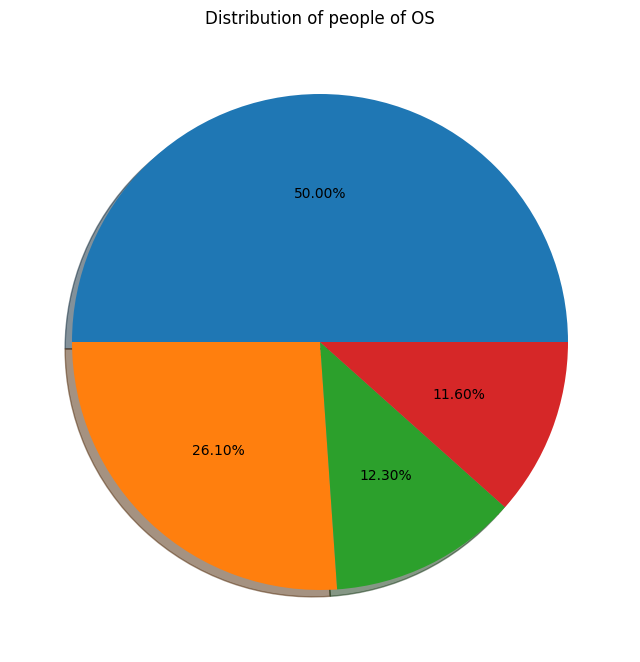

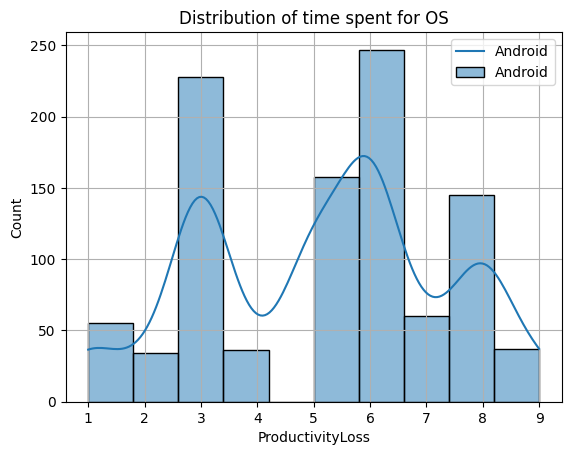

Total ProductivityLoss by different groups of OS
OS
Android    2529
MacOS       609
Windows     645
iOS        1353
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


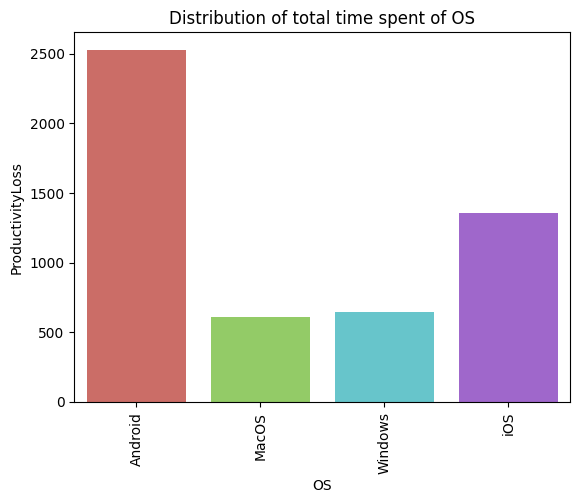

Average ProductivityLoss by different groups of OS
OS
Android    5.058000
MacOS      5.250000
Windows    5.243902
iOS        5.183908
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


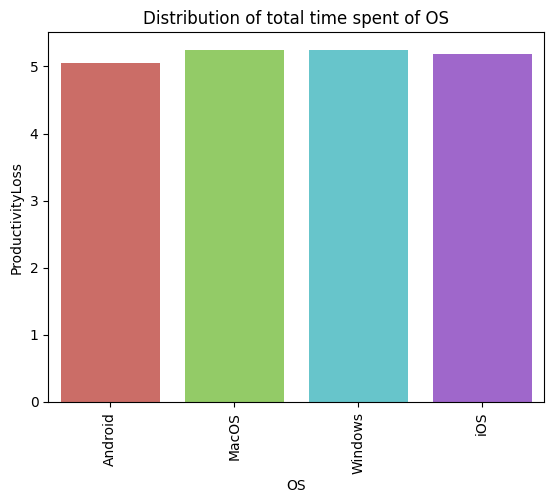

OS:
Distribution of people of OS
OS
Android    50.0
iOS        26.1
Windows    12.3
MacOS      11.6
Name: count, dtype: float64


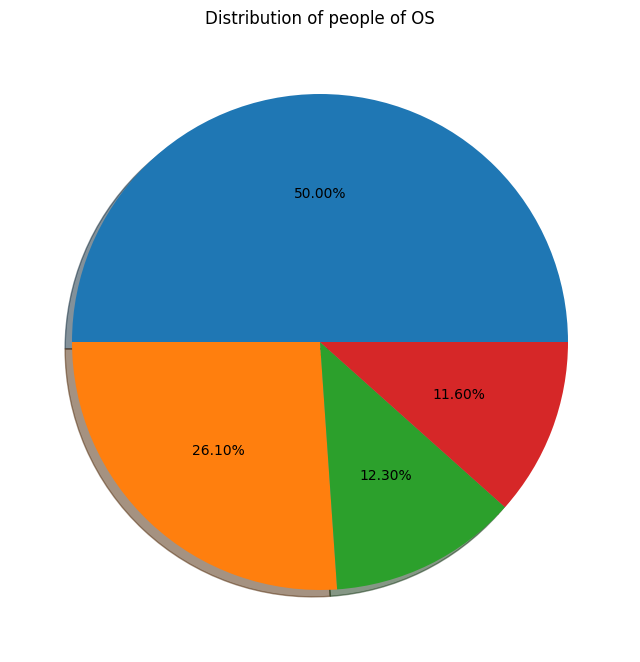

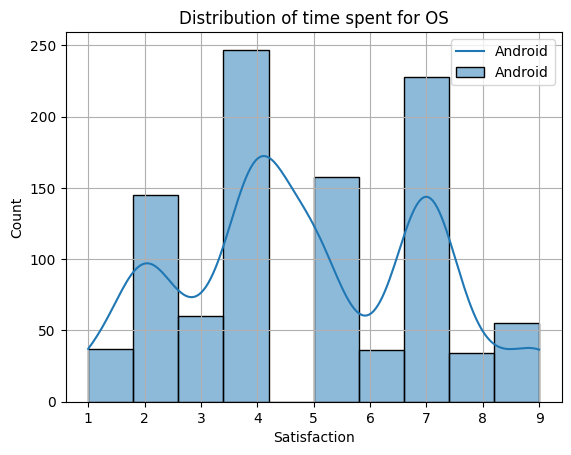

Total Satisfaction by different groups of OS
OS
Android    2471
MacOS       551
Windows     585
iOS        1257
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


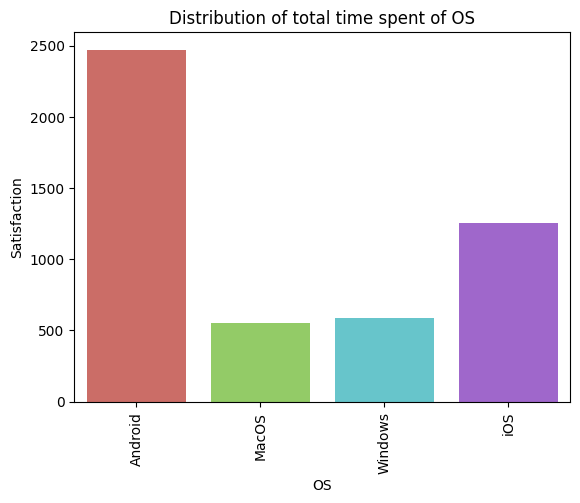

Average Satisfaction by different groups of OS
OS
Android    4.942000
MacOS      4.750000
Windows    4.756098
iOS        4.816092
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


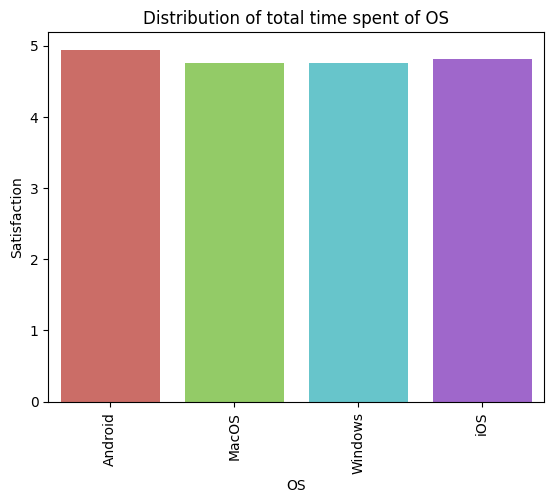

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


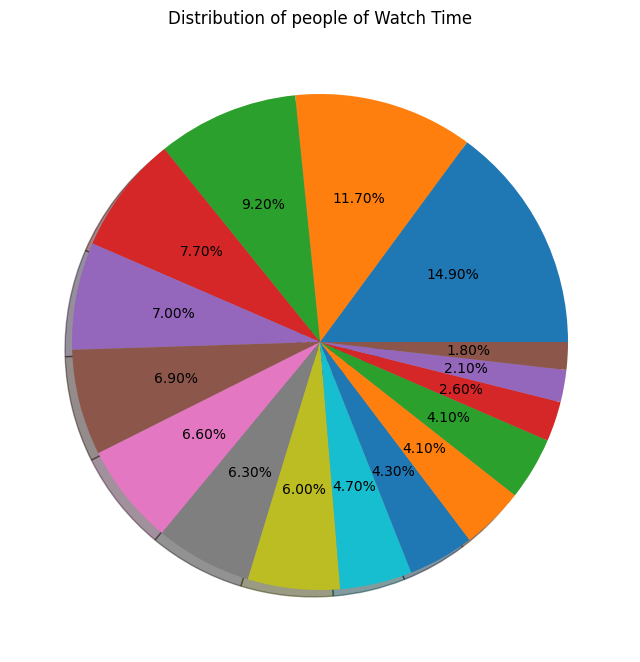

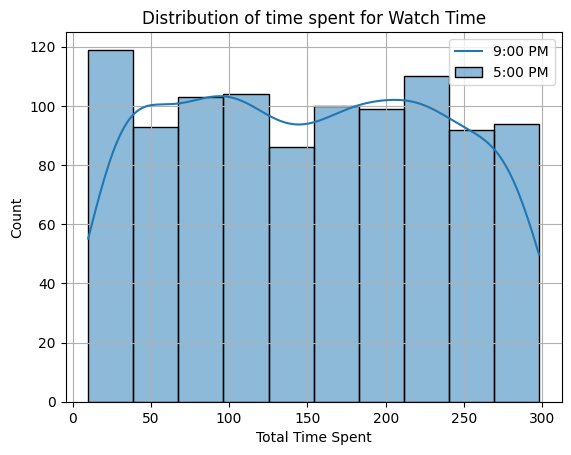

Total Total Time Spent by different groups of Watch Time
Watch Time
10:15 PM    10447
11:30 PM     8972
2:00 PM     24532
3:45 PM     10385
3:55 PM      9586
4:25 PM     12254
5:00 PM     13592
5:45 PM      7194
6:05 PM      6241
7:25 PM      5373
7:45 AM      3408
8:00 AM      6651
8:30 PM      9356
9:00 PM     17828
9:15 AM      2778
9:55 AM      2809
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


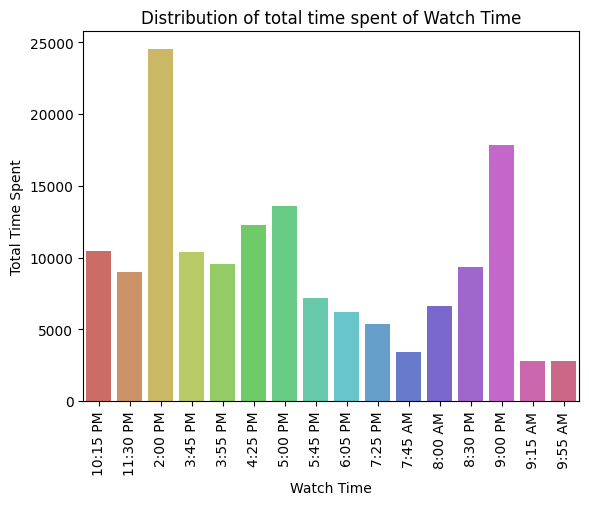

Average Total Time Spent by different groups of Watch Time
Watch Time
10:15 PM    158.287879
11:30 PM    142.412698
2:00 PM     164.644295
3:45 PM     150.507246
3:55 PM     136.942857
4:25 PM     159.142857
5:00 PM     147.739130
5:45 PM     153.063830
6:05 PM     145.139535
7:25 PM     131.048780
7:45 AM     131.076923
8:00 AM     162.219512
8:30 PM     155.933333
9:00 PM     152.376068
9:15 AM     132.285714
9:55 AM     156.055556
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


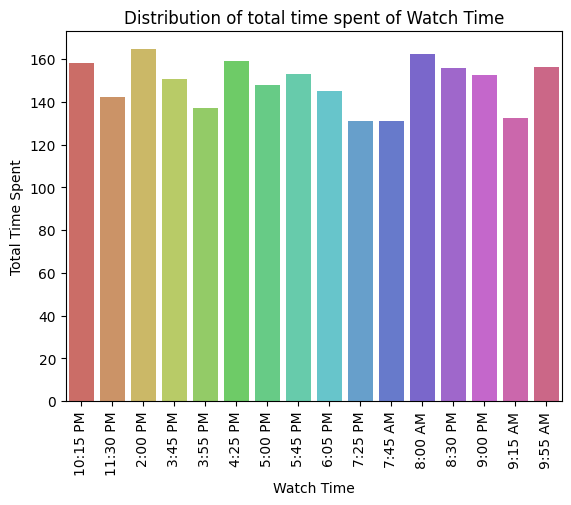

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


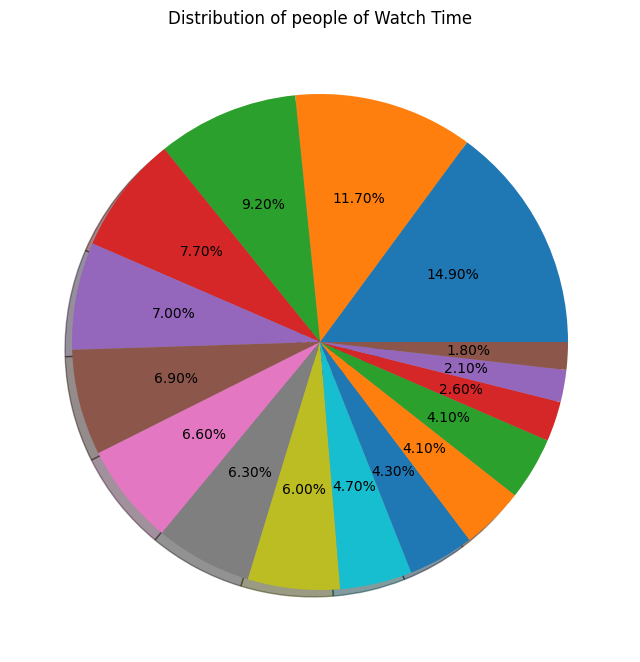

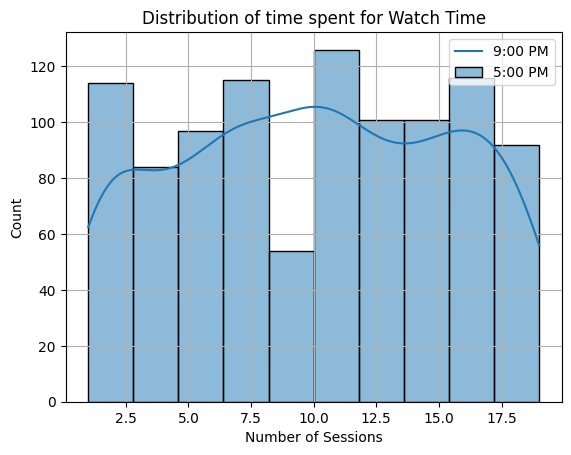

Total Number of Sessions by different groups of Watch Time
Watch Time
10:15 PM     658
11:30 PM     553
2:00 PM     1424
3:45 PM      762
3:55 PM      676
4:25 PM      800
5:00 PM      894
5:45 PM      494
6:05 PM      392
7:25 PM      360
7:45 AM      283
8:00 AM      448
8:30 PM      574
9:00 PM     1236
9:15 AM      276
9:55 AM      183
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


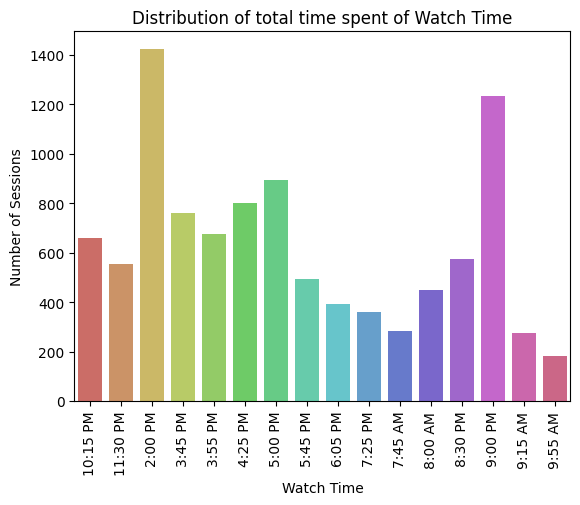

Average Number of Sessions by different groups of Watch Time
Watch Time
10:15 PM     9.969697
11:30 PM     8.777778
2:00 PM      9.557047
3:45 PM     11.043478
3:55 PM      9.657143
4:25 PM     10.389610
5:00 PM      9.717391
5:45 PM     10.510638
6:05 PM      9.116279
7:25 PM      8.780488
7:45 AM     10.884615
8:00 AM     10.926829
8:30 PM      9.566667
9:00 PM     10.564103
9:15 AM     13.142857
9:55 AM     10.166667
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


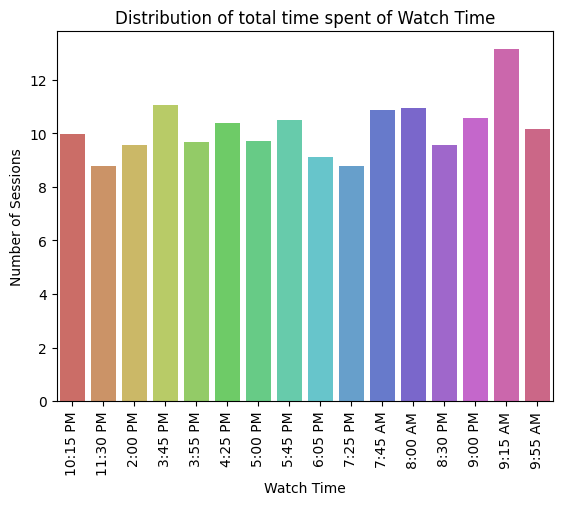

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


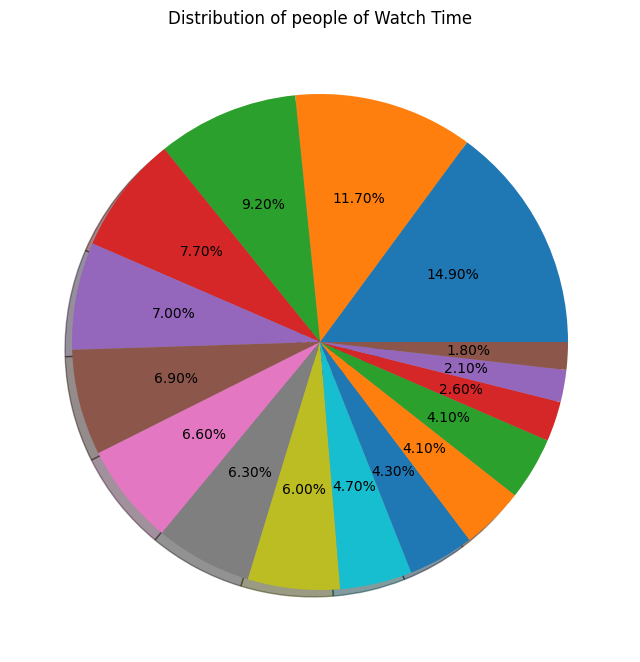

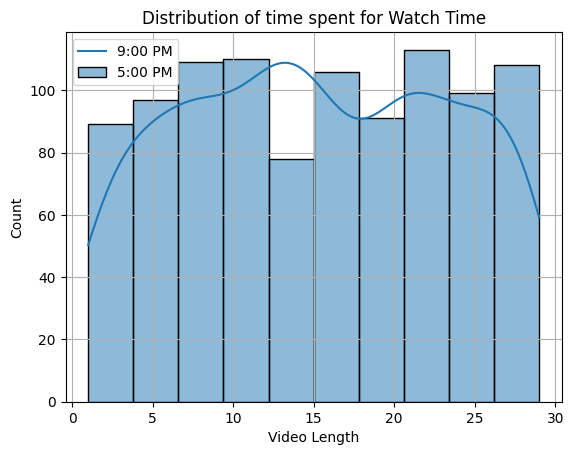

Total Video Length by different groups of Watch Time
Watch Time
10:15 PM     925
11:30 PM     960
2:00 PM     2174
3:45 PM     1007
3:55 PM     1026
4:25 PM     1205
5:00 PM     1513
5:45 PM      722
6:05 PM      584
7:25 PM      607
7:45 AM      445
8:00 AM      668
8:30 PM      989
9:00 PM     1771
9:15 AM      333
9:55 AM      285
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


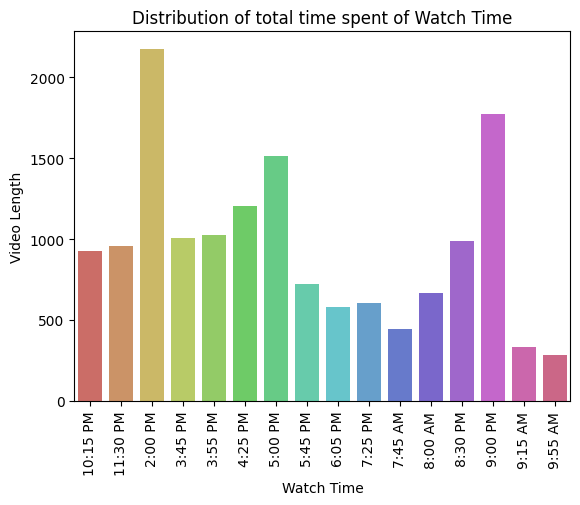

Average Video Length by different groups of Watch Time
Watch Time
10:15 PM    14.015152
11:30 PM    15.238095
2:00 PM     14.590604
3:45 PM     14.594203
3:55 PM     14.657143
4:25 PM     15.649351
5:00 PM     16.445652
5:45 PM     15.361702
6:05 PM     13.581395
7:25 PM     14.804878
7:45 AM     17.115385
8:00 AM     16.292683
8:30 PM     16.483333
9:00 PM     15.136752
9:15 AM     15.857143
9:55 AM     15.833333
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


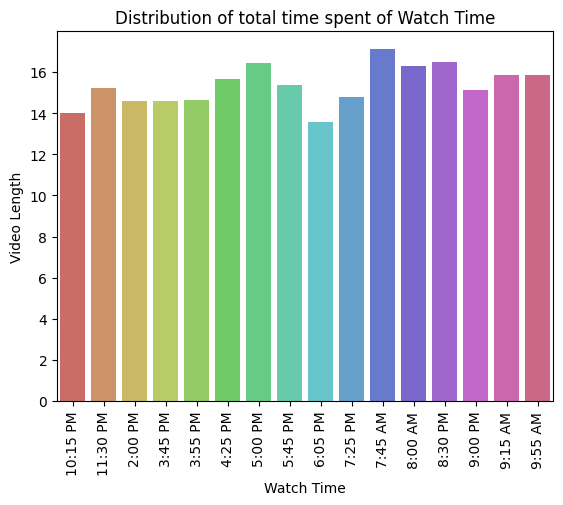

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


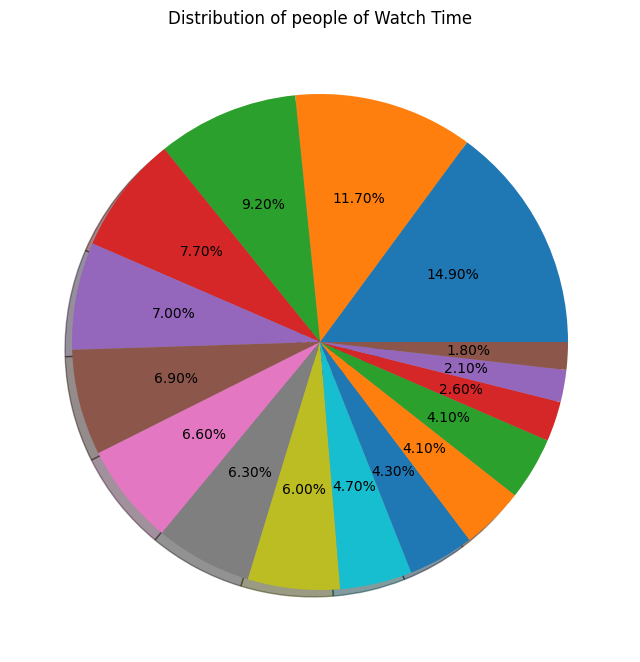

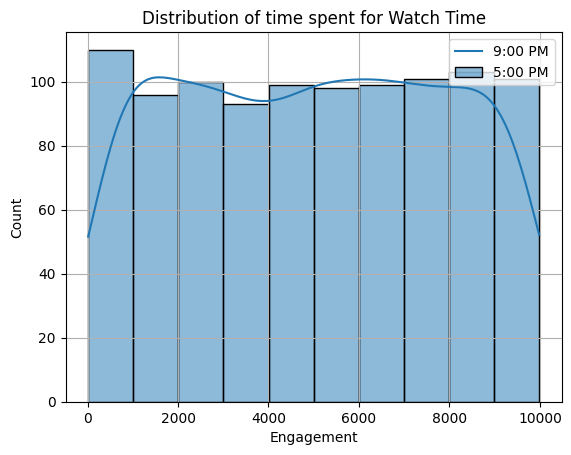

Total Engagement by different groups of Watch Time
Watch Time
10:15 PM    320242
11:30 PM    337056
2:00 PM     705241
3:45 PM     357908
3:55 PM     329248
4:25 PM     411568
5:00 PM     434220
5:45 PM     240539
6:05 PM     188881
7:25 PM     223190
7:45 AM     123550
8:00 AM     215783
8:30 PM     312986
9:00 PM     624168
9:15 AM      86232
9:55 AM      86347
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


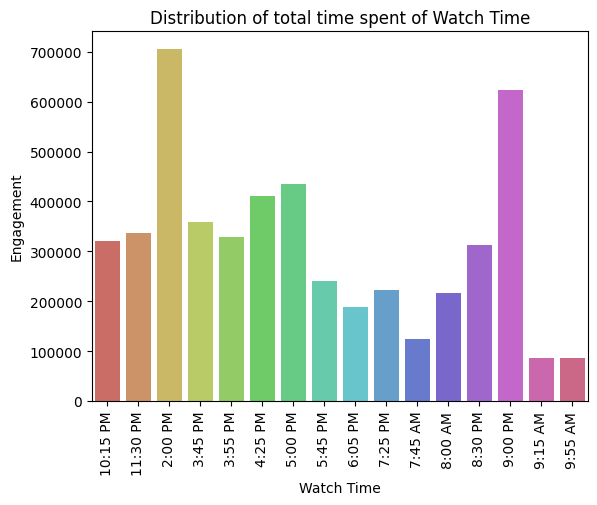

Average Engagement by different groups of Watch Time
Watch Time
10:15 PM    4852.151515
11:30 PM    5350.095238
2:00 PM     4733.161074
3:45 PM     5187.072464
3:55 PM     4703.542857
4:25 PM     5345.038961
5:00 PM     4719.782609
5:45 PM     5117.851064
6:05 PM     4392.581395
7:25 PM     5443.658537
7:45 AM     4751.923077
8:00 AM     5263.000000
8:30 PM     5216.433333
9:00 PM     5334.769231
9:15 AM     4106.285714
9:55 AM     4797.055556
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


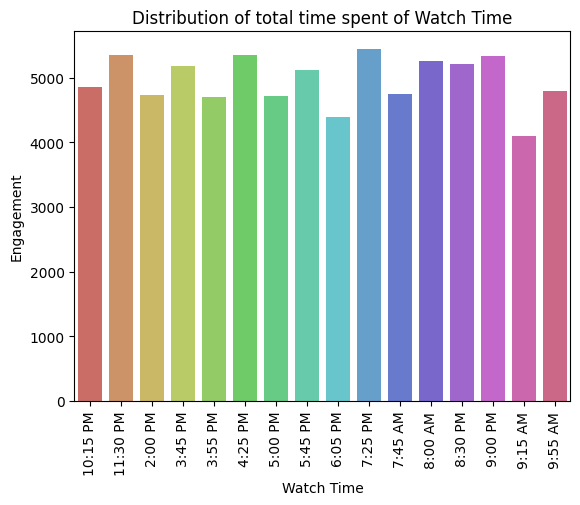

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


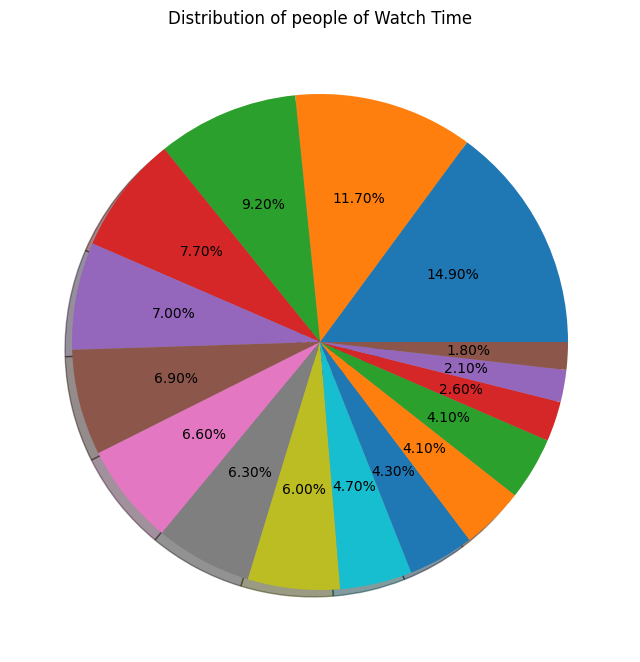

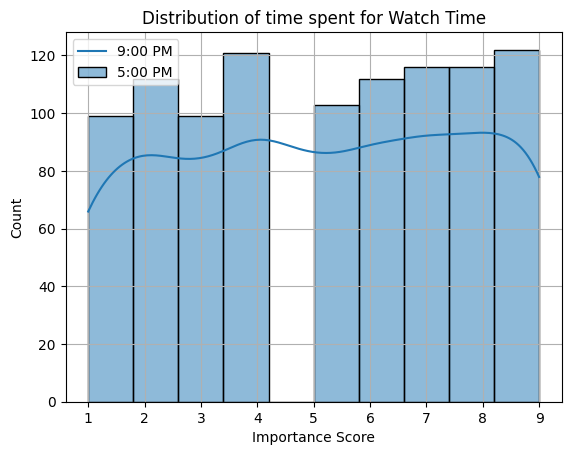

Total Importance Score by different groups of Watch Time
Watch Time
10:15 PM    345
11:30 PM    301
2:00 PM     766
3:45 PM     317
3:55 PM     359
4:25 PM     372
5:00 PM     515
5:45 PM     226
6:05 PM     214
7:25 PM     201
7:45 AM     139
8:00 AM     212
8:30 PM     303
9:00 PM     650
9:15 AM     108
9:55 AM     101
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


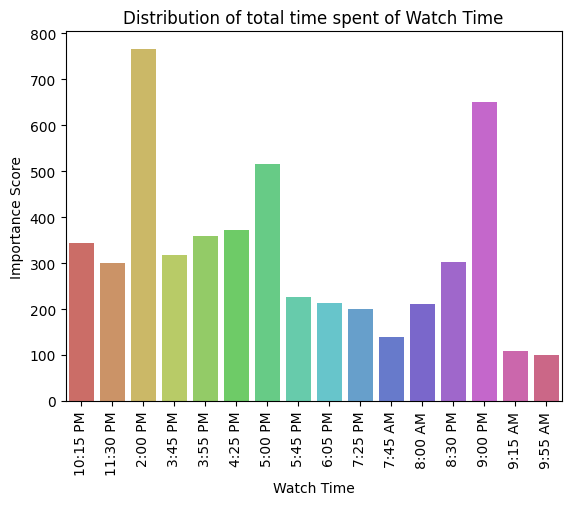

Average Importance Score by different groups of Watch Time
Watch Time
10:15 PM    5.227273
11:30 PM    4.777778
2:00 PM     5.140940
3:45 PM     4.594203
3:55 PM     5.128571
4:25 PM     4.831169
5:00 PM     5.597826
5:45 PM     4.808511
6:05 PM     4.976744
7:25 PM     4.902439
7:45 AM     5.346154
8:00 AM     5.170732
8:30 PM     5.050000
9:00 PM     5.555556
9:15 AM     5.142857
9:55 AM     5.611111
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


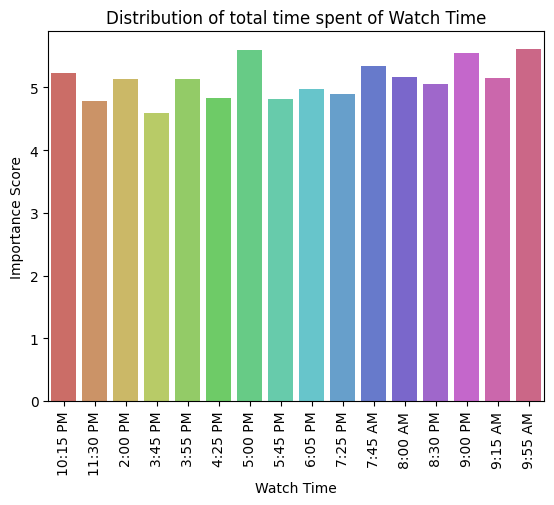

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


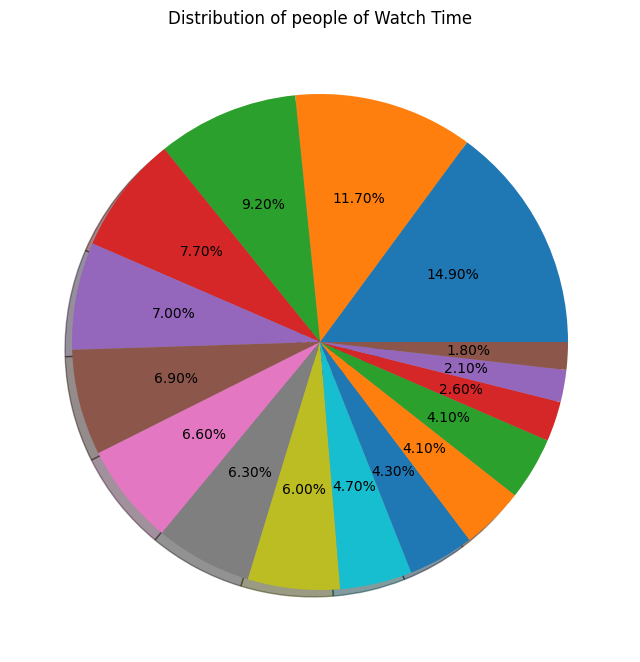

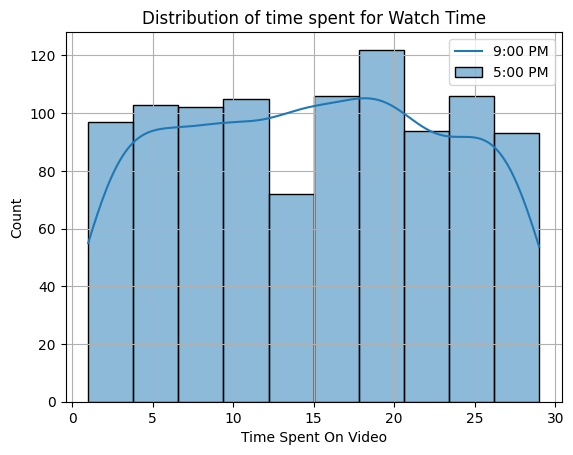

Total Time Spent On Video by different groups of Watch Time
Watch Time
10:15 PM    1012
11:30 PM     902
2:00 PM     2392
3:45 PM     1018
3:55 PM      932
4:25 PM     1102
5:00 PM     1385
5:45 PM      744
6:05 PM      604
7:25 PM      636
7:45 AM      393
8:00 AM      655
8:30 PM      901
9:00 PM     1707
9:15 AM      352
9:55 AM      238
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


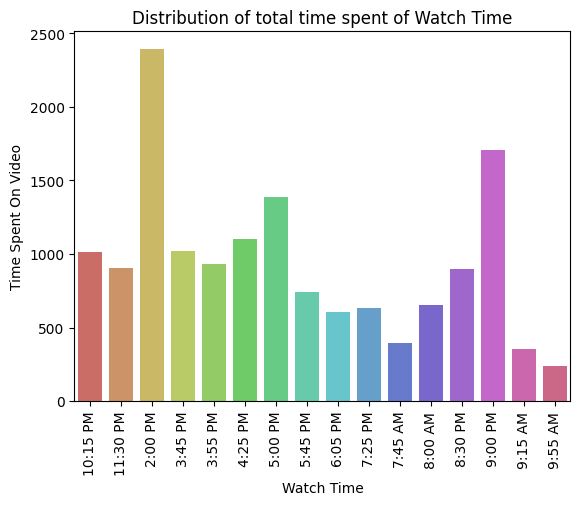

Average Time Spent On Video by different groups of Watch Time
Watch Time
10:15 PM    15.333333
11:30 PM    14.317460
2:00 PM     16.053691
3:45 PM     14.753623
3:55 PM     13.314286
4:25 PM     14.311688
5:00 PM     15.054348
5:45 PM     15.829787
6:05 PM     14.046512
7:25 PM     15.512195
7:45 AM     15.115385
8:00 AM     15.975610
8:30 PM     15.016667
9:00 PM     14.589744
9:15 AM     16.761905
9:55 AM     13.222222
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


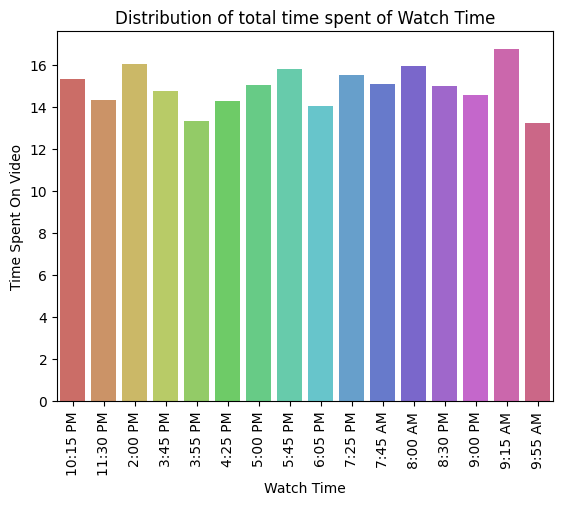

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


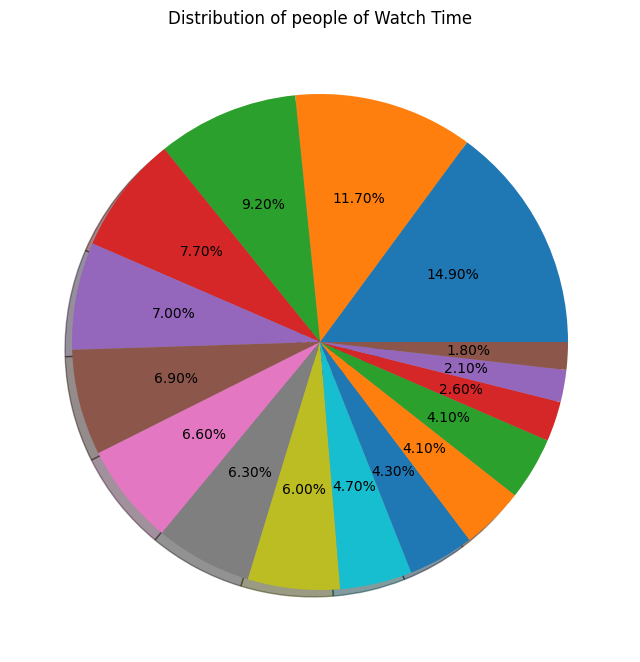

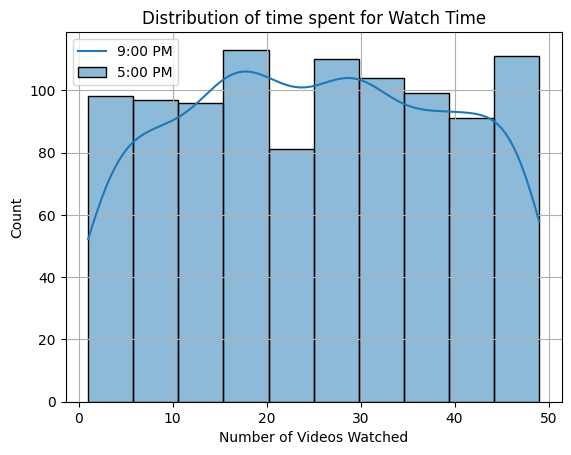

Total Number of Videos Watched by different groups of Watch Time
Watch Time
10:15 PM    1605
11:30 PM    1604
2:00 PM     3760
3:45 PM     1458
3:55 PM     1803
4:25 PM     2027
5:00 PM     2372
5:45 PM     1205
6:05 PM     1091
7:25 PM      945
7:45 AM      736
8:00 AM      949
8:30 PM     1657
9:00 PM     3016
9:15 AM      530
9:55 AM      490
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


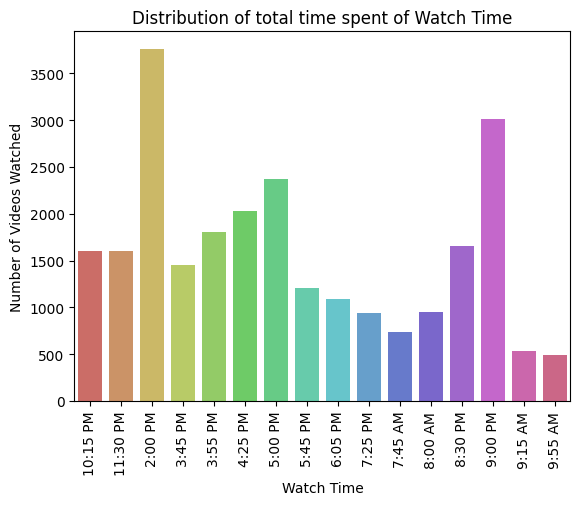

Average Number of Videos Watched by different groups of Watch Time
Watch Time
10:15 PM    24.318182
11:30 PM    25.460317
2:00 PM     25.234899
3:45 PM     21.130435
3:55 PM     25.757143
4:25 PM     26.324675
5:00 PM     25.782609
5:45 PM     25.638298
6:05 PM     25.372093
7:25 PM     23.048780
7:45 AM     28.307692
8:00 AM     23.146341
8:30 PM     27.616667
9:00 PM     25.777778
9:15 AM     25.238095
9:55 AM     27.222222
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


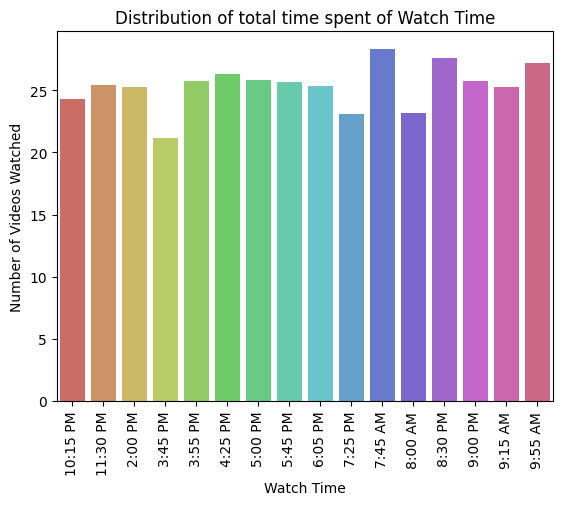

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


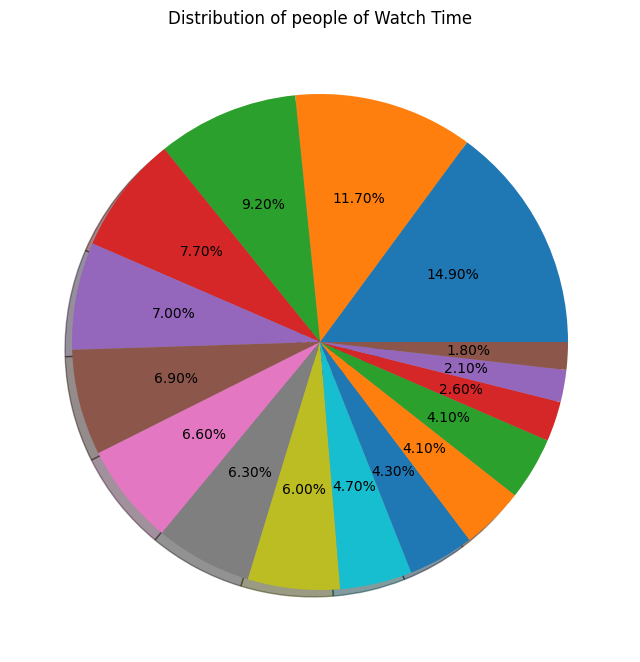

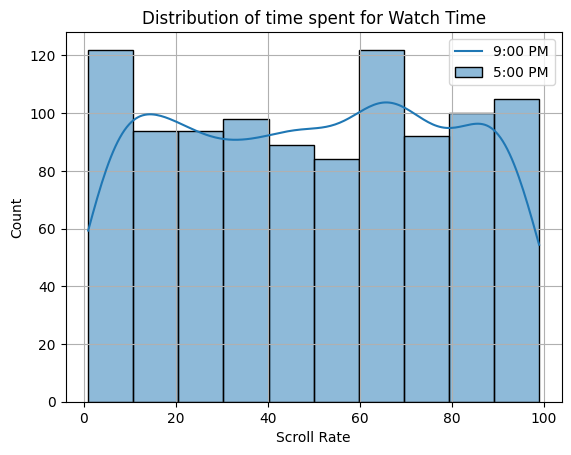

Total Scroll Rate by different groups of Watch Time
Watch Time
10:15 PM    3173
11:30 PM    3387
2:00 PM     7654
3:45 PM     3415
3:55 PM     3290
4:25 PM     3573
5:00 PM     4332
5:45 PM     2484
6:05 PM     2256
7:25 PM     1724
7:45 AM     1078
8:00 AM     2213
8:30 PM     2761
9:00 PM     6263
9:15 AM     1051
9:55 AM     1120
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


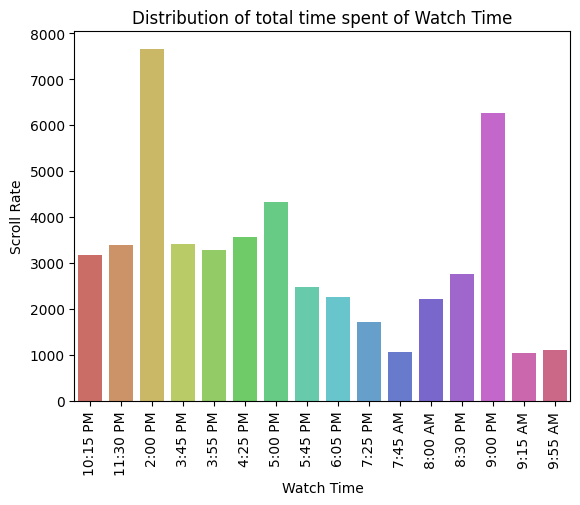

Average Scroll Rate by different groups of Watch Time
Watch Time
10:15 PM    48.075758
11:30 PM    53.761905
2:00 PM     51.369128
3:45 PM     49.492754
3:55 PM     47.000000
4:25 PM     46.402597
5:00 PM     47.086957
5:45 PM     52.851064
6:05 PM     52.465116
7:25 PM     42.048780
7:45 AM     41.461538
8:00 AM     53.975610
8:30 PM     46.016667
9:00 PM     53.529915
9:15 AM     50.047619
9:55 AM     62.222222
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


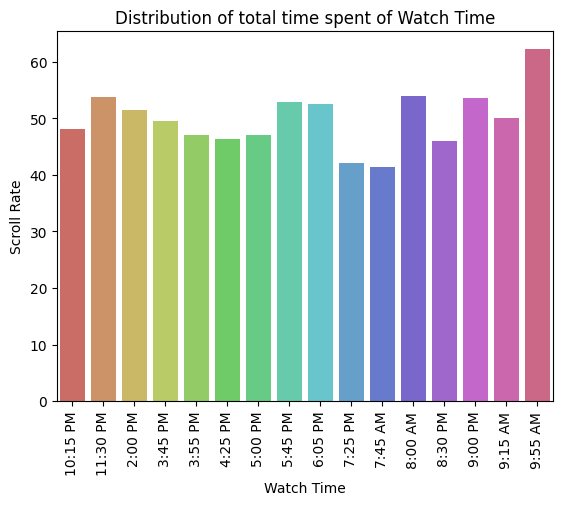

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


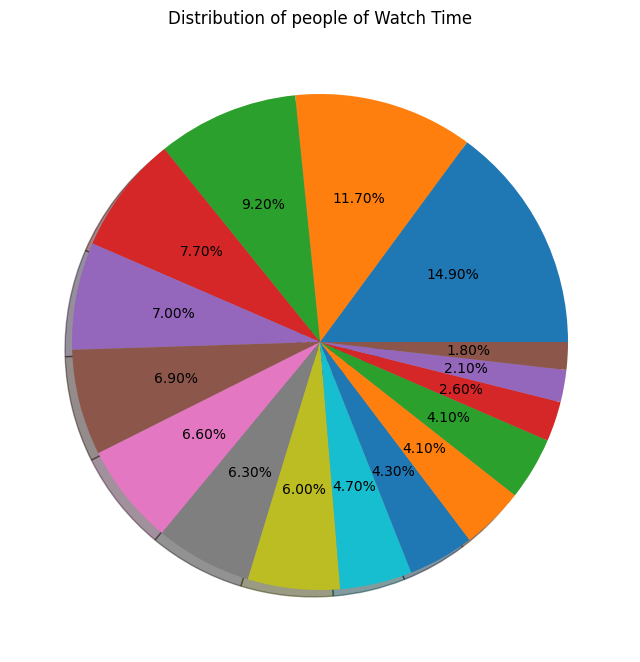

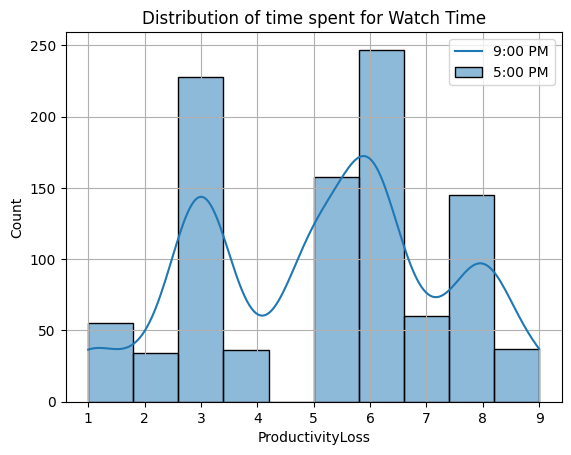

Total ProductivityLoss by different groups of Watch Time
Watch Time
10:15 PM    212
11:30 PM    129
2:00 PM     869
3:45 PM     414
3:55 PM     450
4:25 PM     417
5:00 PM     516
5:45 PM     232
6:05 PM     215
7:25 PM     229
7:45 AM     223
8:00 AM     275
8:30 PM     180
9:00 PM     479
9:15 AM     168
9:55 AM     128
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


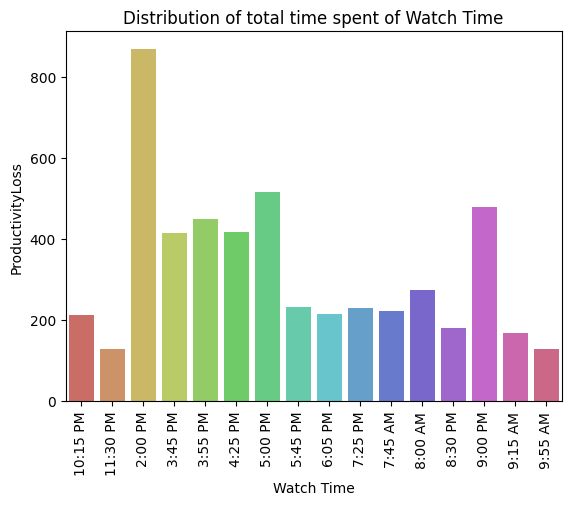

Average ProductivityLoss by different groups of Watch Time
Watch Time
10:15 PM    3.212121
11:30 PM    2.047619
2:00 PM     5.832215
3:45 PM     6.000000
3:55 PM     6.428571
4:25 PM     5.415584
5:00 PM     5.608696
5:45 PM     4.936170
6:05 PM     5.000000
7:25 PM     5.585366
7:45 AM     8.576923
8:00 AM     6.707317
8:30 PM     3.000000
9:00 PM     4.094017
9:15 AM     8.000000
9:55 AM     7.111111
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


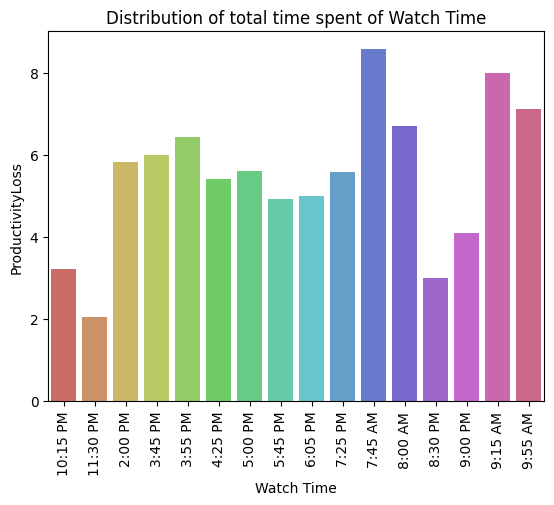

Watch Time:
Distribution of people of Watch Time
Watch Time
2:00 PM     14.9
9:00 PM     11.7
5:00 PM      9.2
4:25 PM      7.7
3:55 PM      7.0
3:45 PM      6.9
10:15 PM     6.6
11:30 PM     6.3
8:30 PM      6.0
5:45 PM      4.7
6:05 PM      4.3
8:00 AM      4.1
7:25 PM      4.1
7:45 AM      2.6
9:15 AM      2.1
9:55 AM      1.8
Name: count, dtype: float64


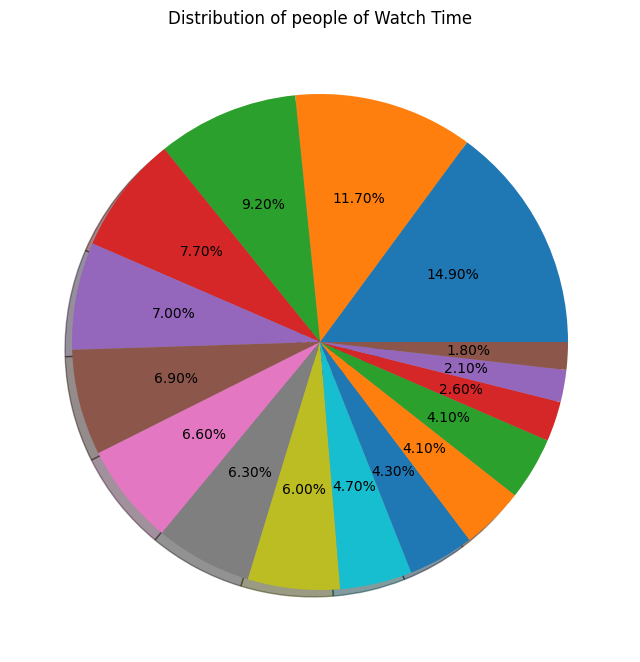

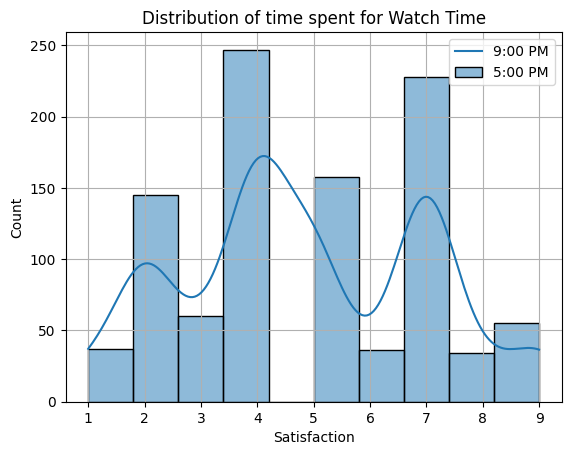

Total Satisfaction by different groups of Watch Time
Watch Time
10:15 PM    448
11:30 PM    501
2:00 PM     621
3:45 PM     276
3:55 PM     250
4:25 PM     353
5:00 PM     404
5:45 PM     238
6:05 PM     215
7:25 PM     181
7:45 AM      37
8:00 AM     135
8:30 PM     420
9:00 PM     691
9:15 AM      42
9:55 AM      52
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


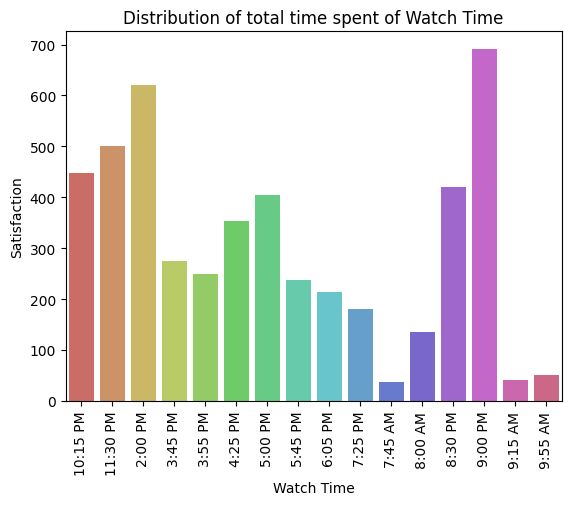

Average Satisfaction by different groups of Watch Time
Watch Time
10:15 PM    6.787879
11:30 PM    7.952381
2:00 PM     4.167785
3:45 PM     4.000000
3:55 PM     3.571429
4:25 PM     4.584416
5:00 PM     4.391304
5:45 PM     5.063830
6:05 PM     5.000000
7:25 PM     4.414634
7:45 AM     1.423077
8:00 AM     3.292683
8:30 PM     7.000000
9:00 PM     5.905983
9:15 AM     2.000000
9:55 AM     2.888889
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


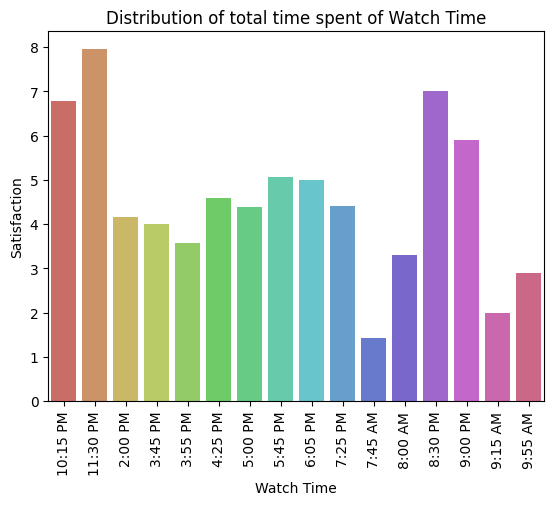

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


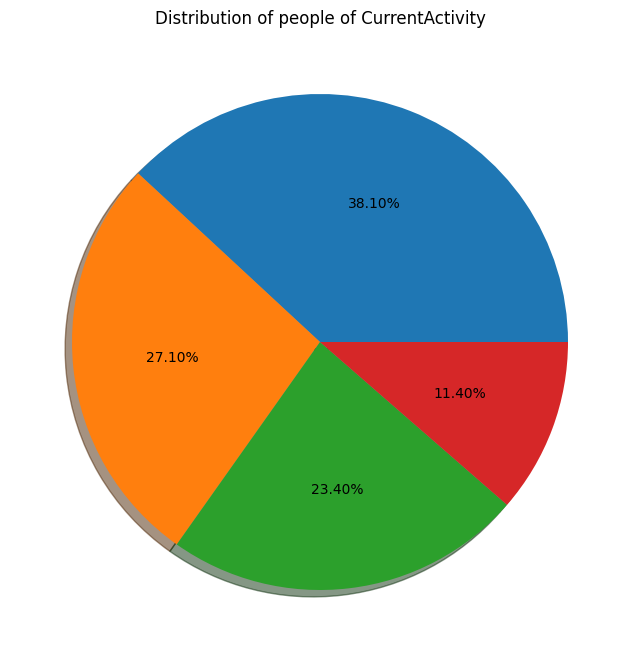

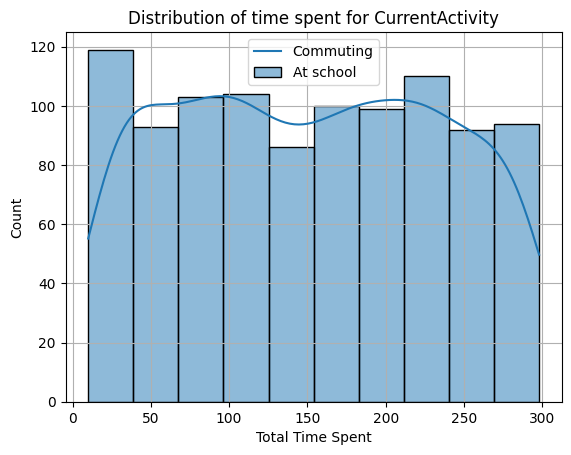

Total Total Time Spent by different groups of CurrentActivity
CurrentActivity
At home      56425
At school    41623
At work      36485
Commuting    16873
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


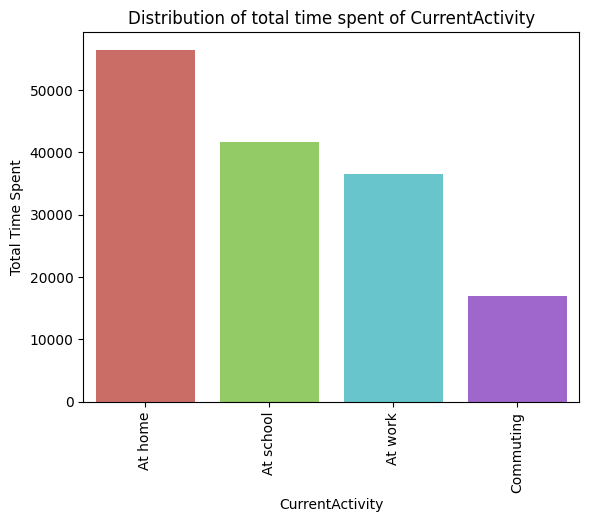

Average Total Time Spent by different groups of CurrentActivity
CurrentActivity
At home      148.097113
At school    153.590406
At work      155.918803
Commuting    148.008772
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


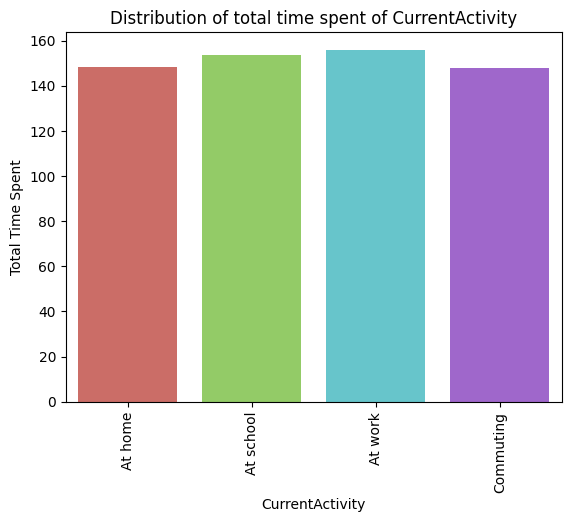

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


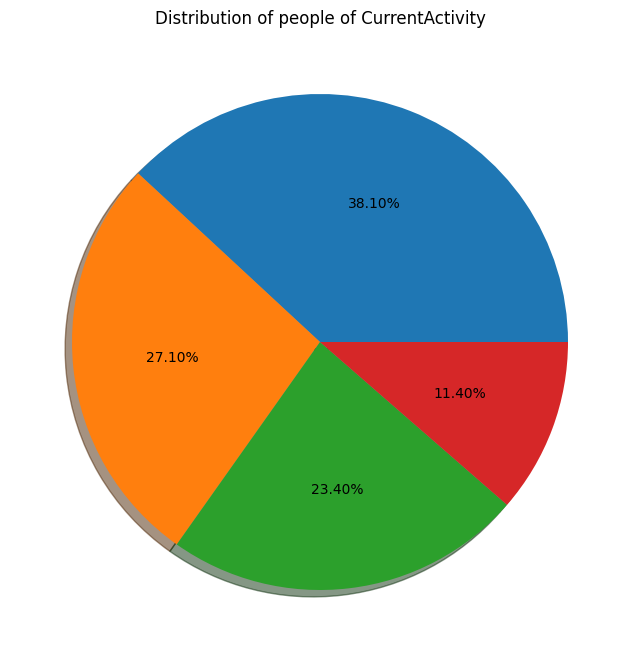

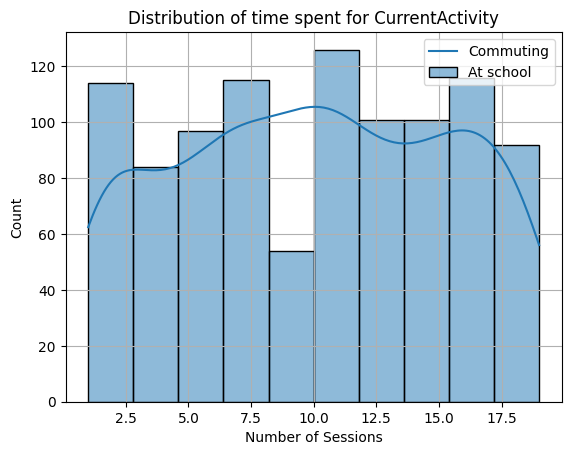

Total Number of Sessions by different groups of CurrentActivity
CurrentActivity
At home      3734
At school    2712
At work      2387
Commuting    1180
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


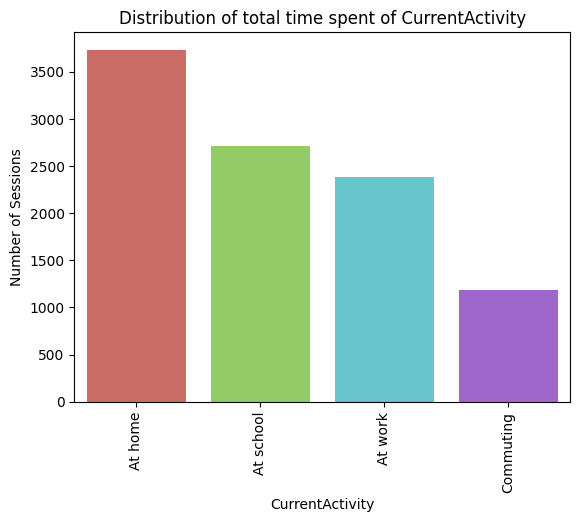

Average Number of Sessions by different groups of CurrentActivity
CurrentActivity
At home       9.800525
At school    10.007380
At work      10.200855
Commuting    10.350877
Name: Number of Sessions, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


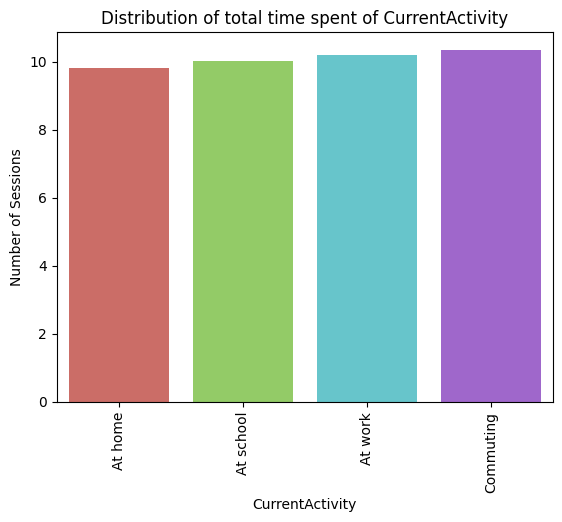

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


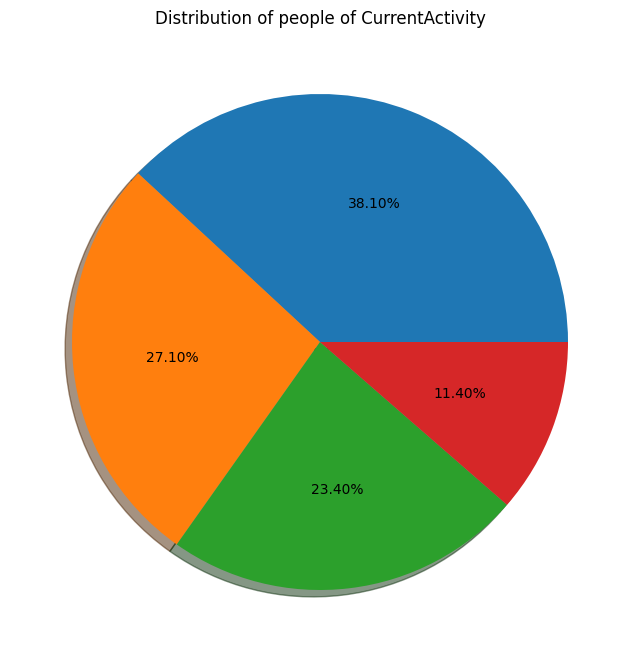

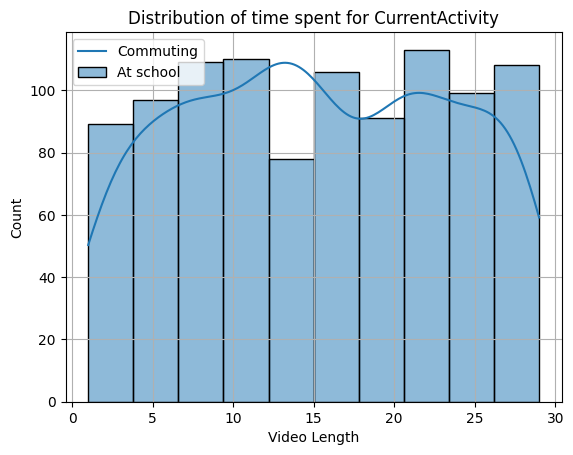

Total Video Length by different groups of CurrentActivity
CurrentActivity
At home      5992
At school    4130
At work      3437
Commuting    1655
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


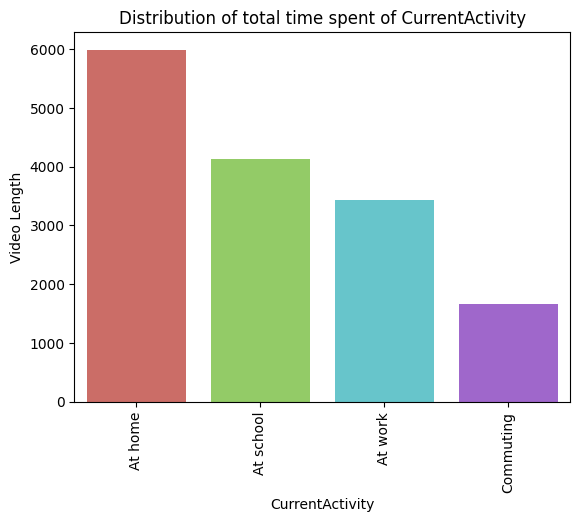

Average Video Length by different groups of CurrentActivity
CurrentActivity
At home      15.727034
At school    15.239852
At work      14.688034
Commuting    14.517544
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


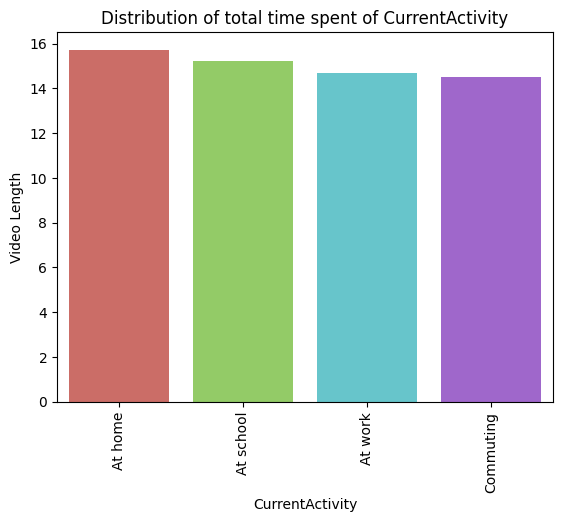

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


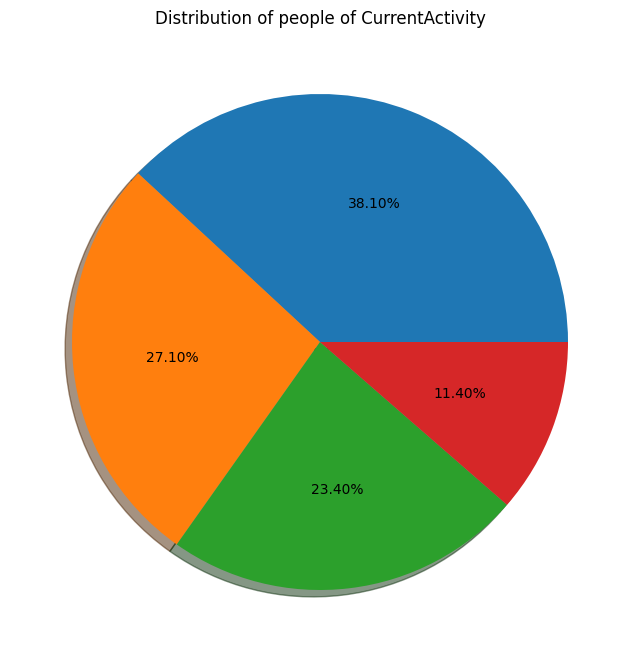

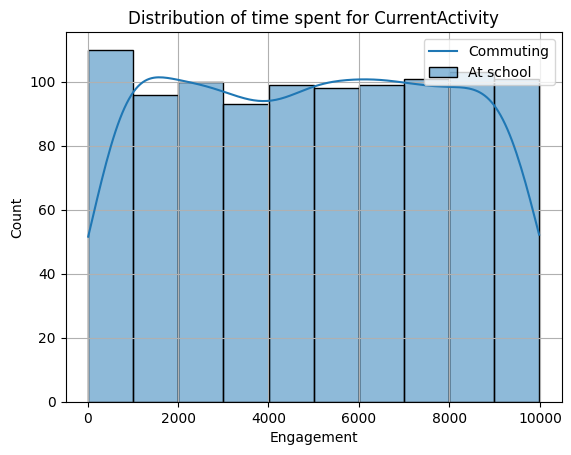

Total Engagement by different groups of CurrentActivity
CurrentActivity
At home      1929267
At school    1373747
At work      1146112
Commuting     548033
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


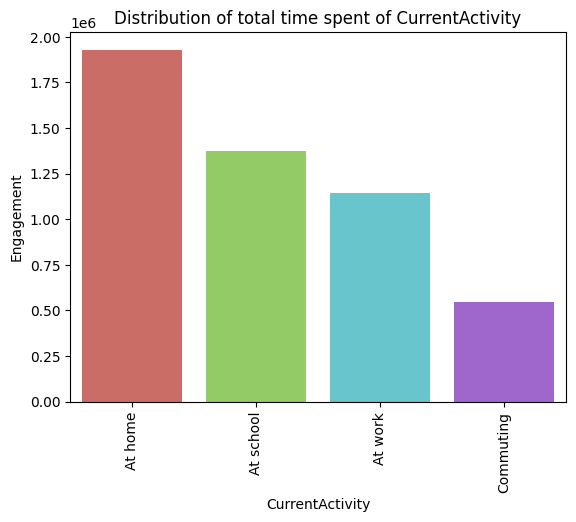

Average Engagement by different groups of CurrentActivity
CurrentActivity
At home      5063.692913
At school    5069.177122
At work      4897.914530
Commuting    4807.307018
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


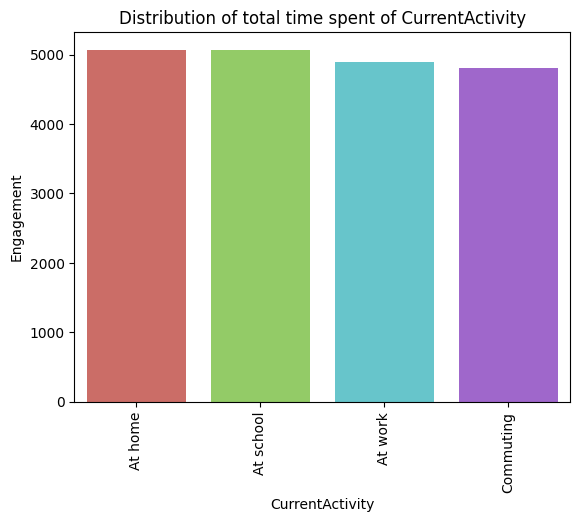

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


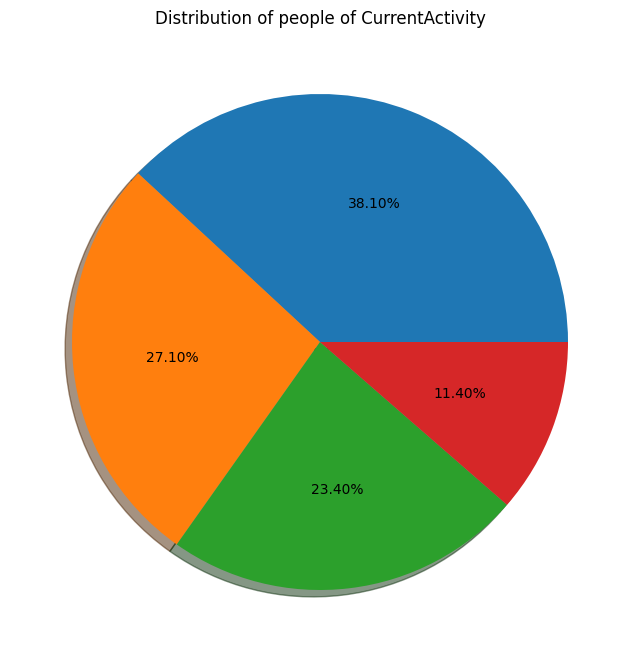

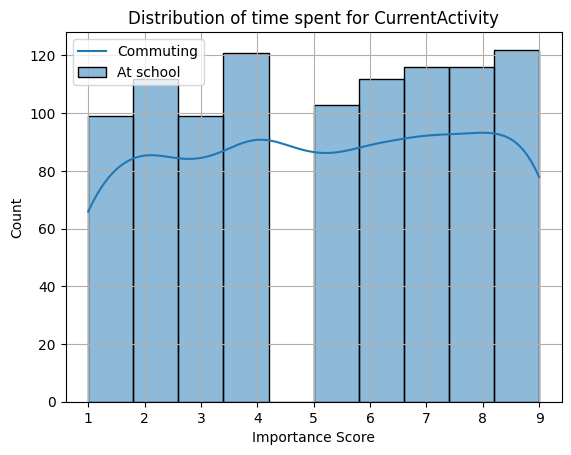

Total Importance Score by different groups of CurrentActivity
CurrentActivity
At home      1950
At school    1427
At work      1192
Commuting     560
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


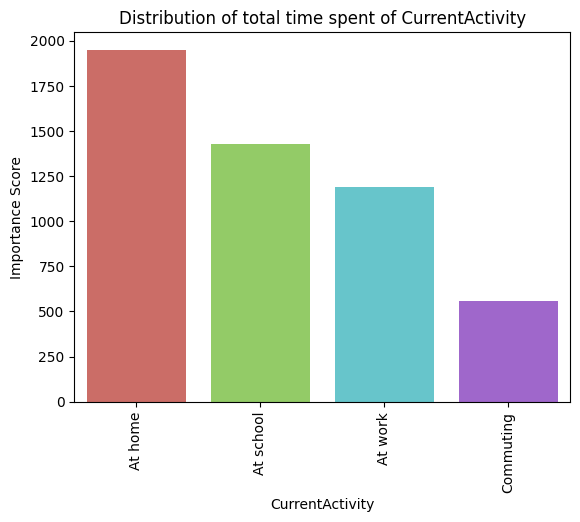

Average Importance Score by different groups of CurrentActivity
CurrentActivity
At home      5.118110
At school    5.265683
At work      5.094017
Commuting    4.912281
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


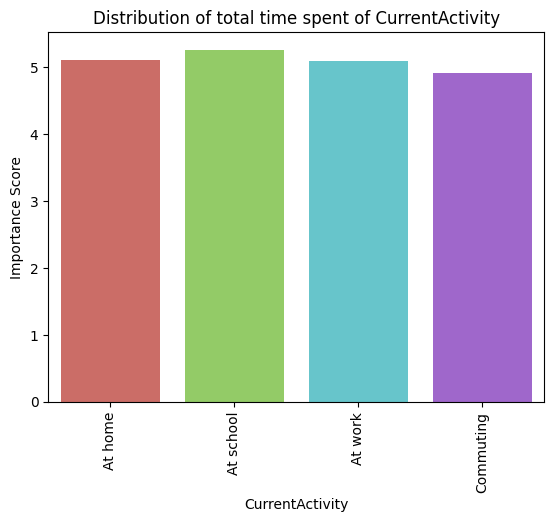

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


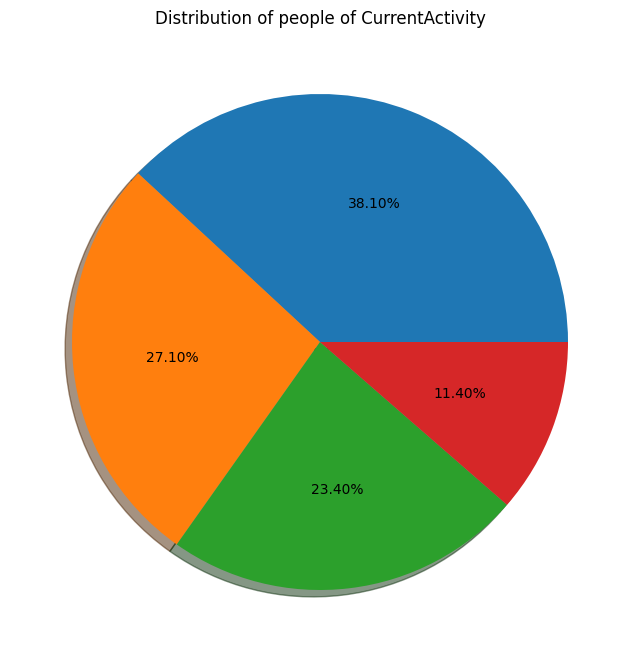

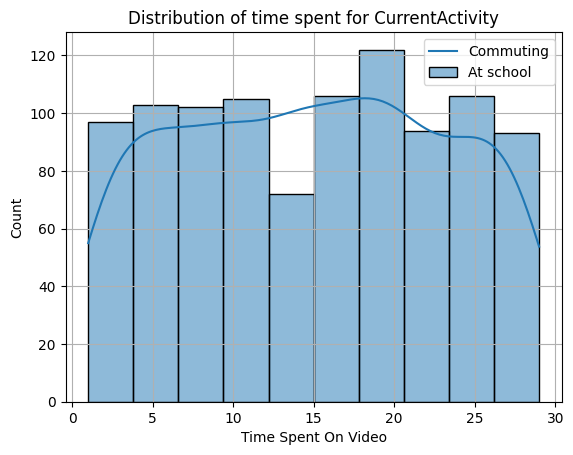

Total Time Spent On Video by different groups of CurrentActivity
CurrentActivity
At home      5679
At school    4135
At work      3480
Commuting    1679
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


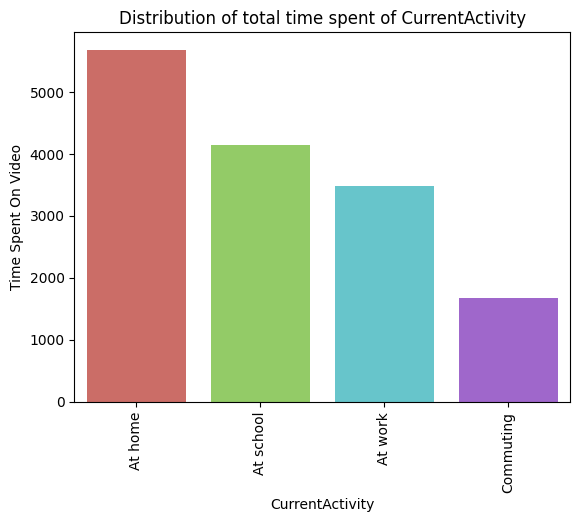

Average Time Spent On Video by different groups of CurrentActivity
CurrentActivity
At home      14.905512
At school    15.258303
At work      14.871795
Commuting    14.728070
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


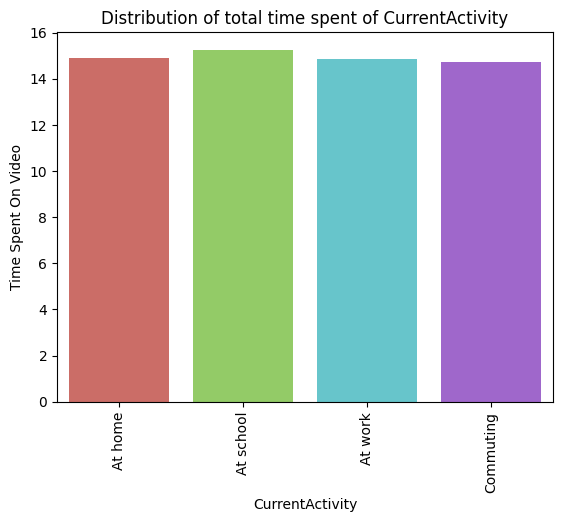

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


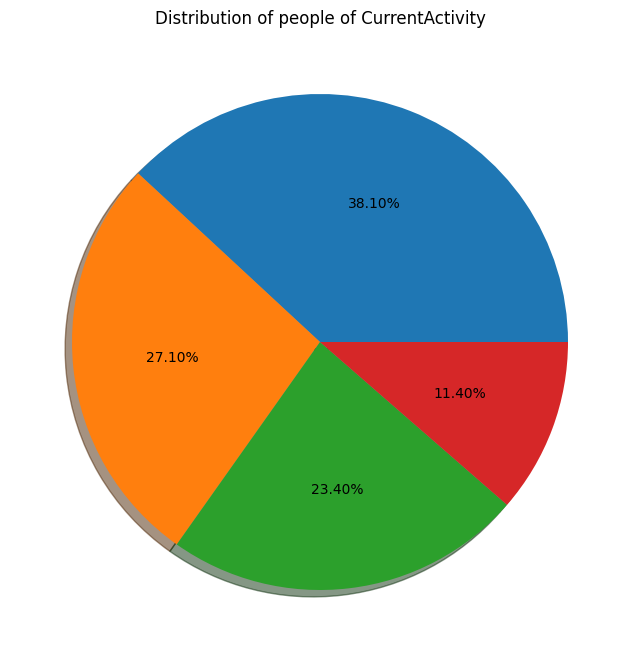

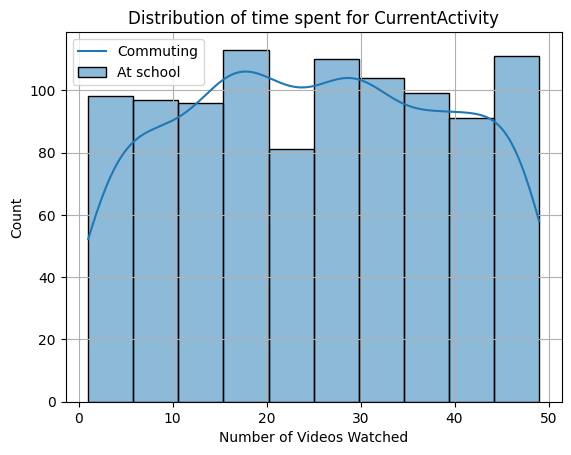

Total Number of Videos Watched by different groups of CurrentActivity
CurrentActivity
At home      9372
At school    7013
At work      5992
Commuting    2871
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


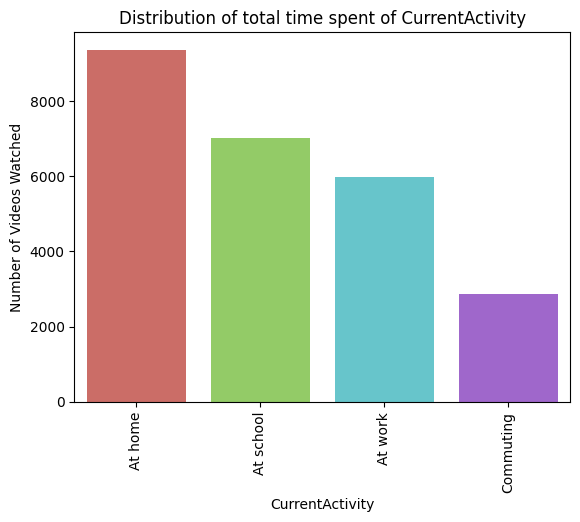

Average Number of Videos Watched by different groups of CurrentActivity
CurrentActivity
At home      24.598425
At school    25.878229
At work      25.606838
Commuting    25.184211
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


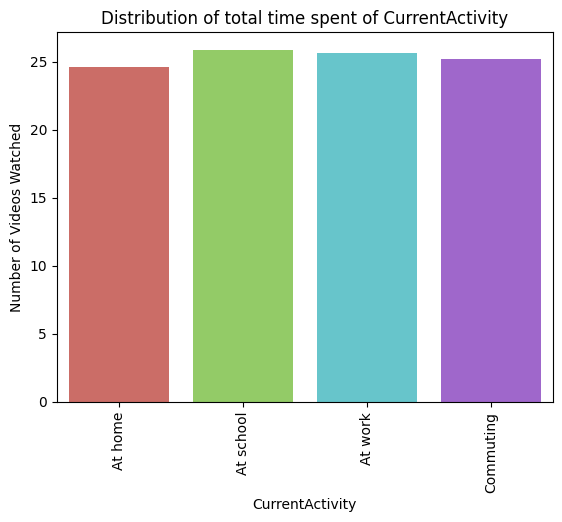

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


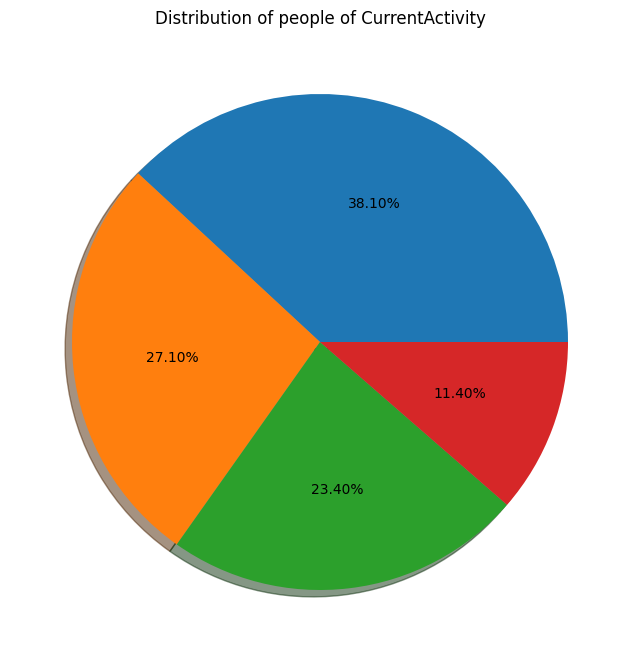

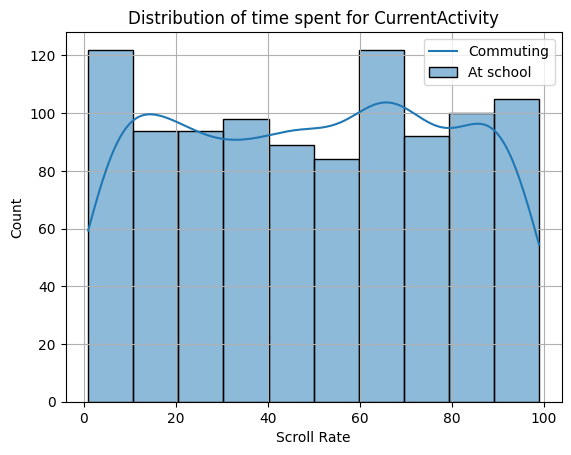

Total Scroll Rate by different groups of CurrentActivity
CurrentActivity
At home      19256
At school    13775
At work      11183
Commuting     5560
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


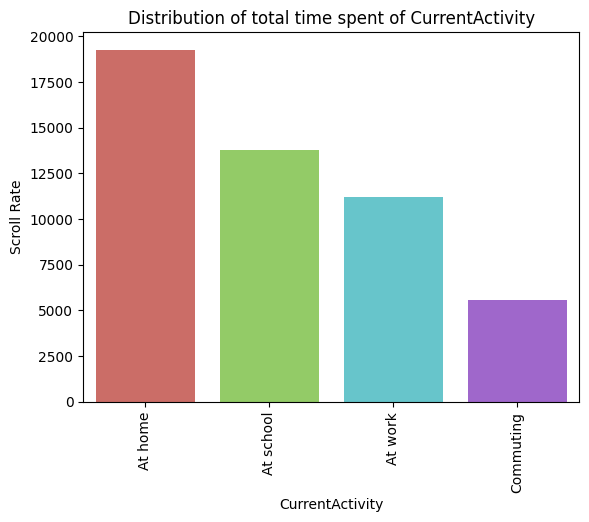

Average Scroll Rate by different groups of CurrentActivity
CurrentActivity
At home      50.540682
At school    50.830258
At work      47.790598
Commuting    48.771930
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


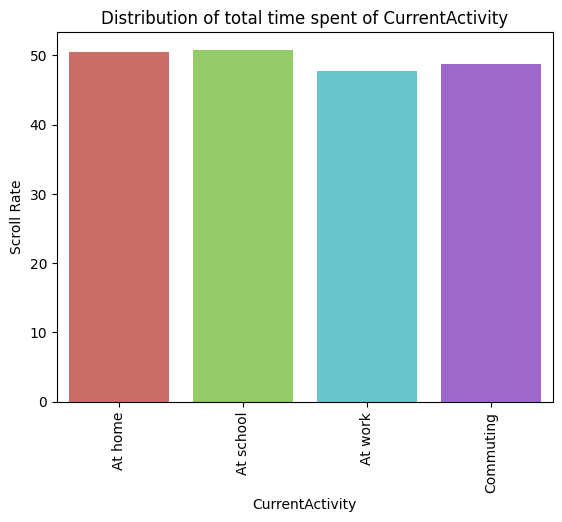

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


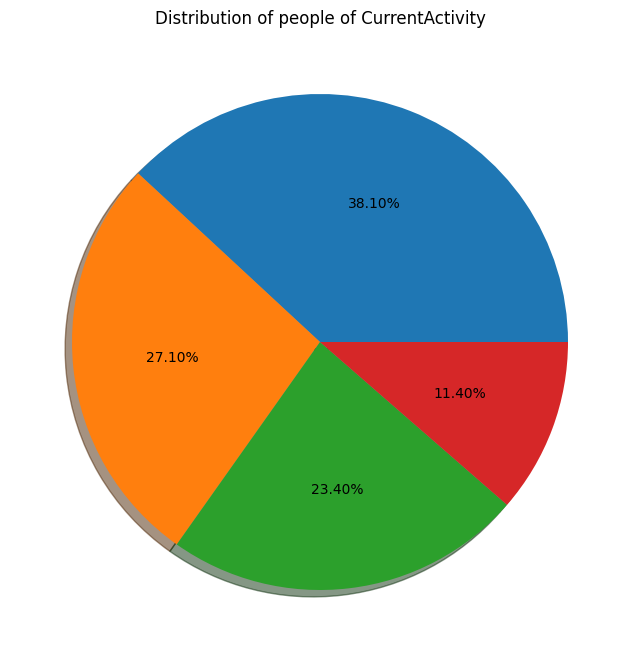

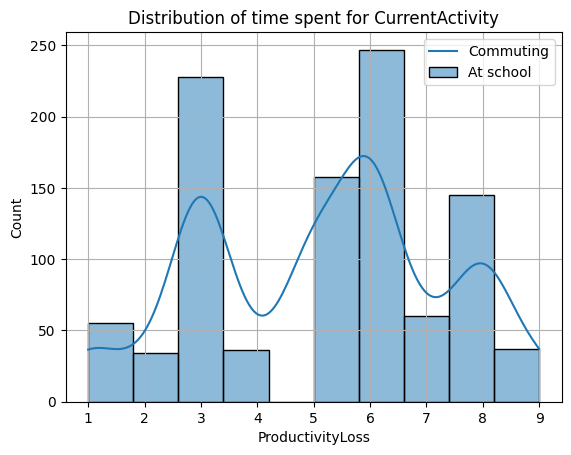

Total ProductivityLoss by different groups of CurrentActivity
CurrentActivity
At home      1937
At school    1417
At work      1176
Commuting     606
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


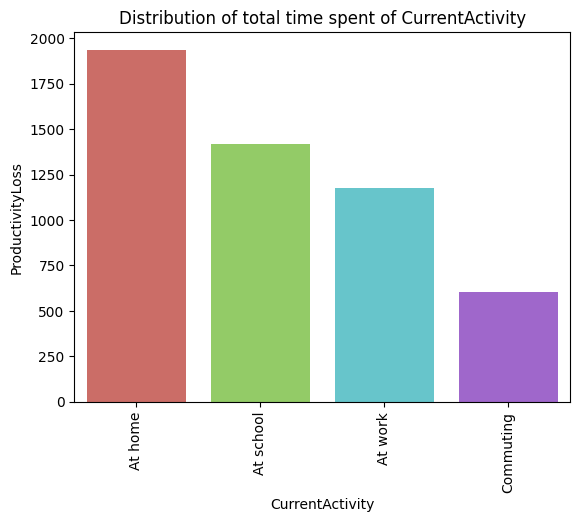

Average ProductivityLoss by different groups of CurrentActivity
CurrentActivity
At home      5.083990
At school    5.228782
At work      5.025641
Commuting    5.315789
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


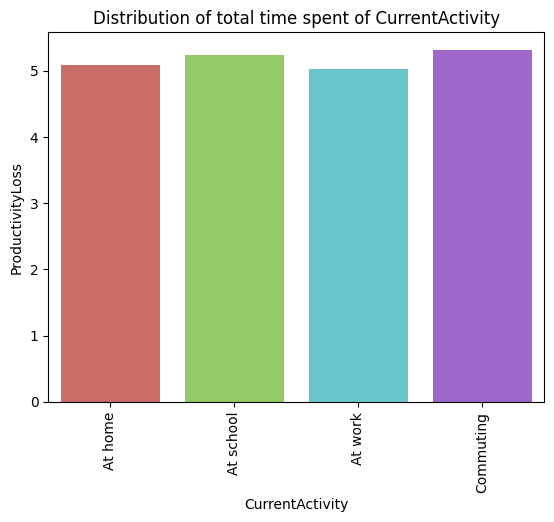

CurrentActivity:
Distribution of people of CurrentActivity
CurrentActivity
At home      38.1
At school    27.1
At work      23.4
Commuting    11.4
Name: count, dtype: float64


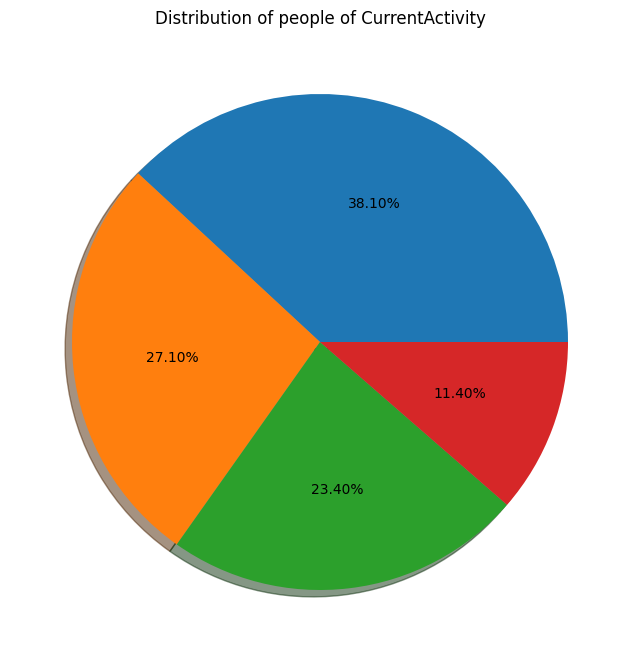

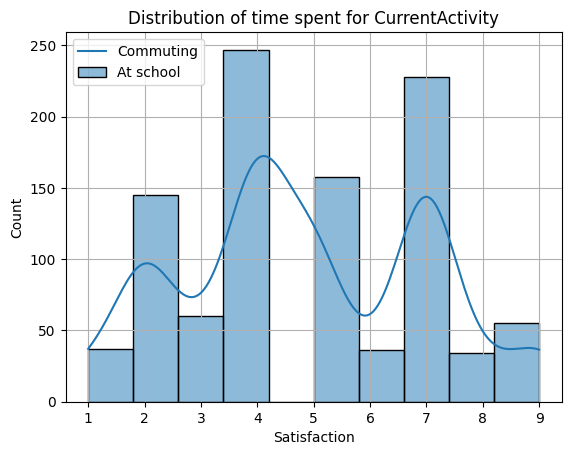

Total Satisfaction by different groups of CurrentActivity
CurrentActivity
At home      1873
At school    1293
At work      1164
Commuting     534
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


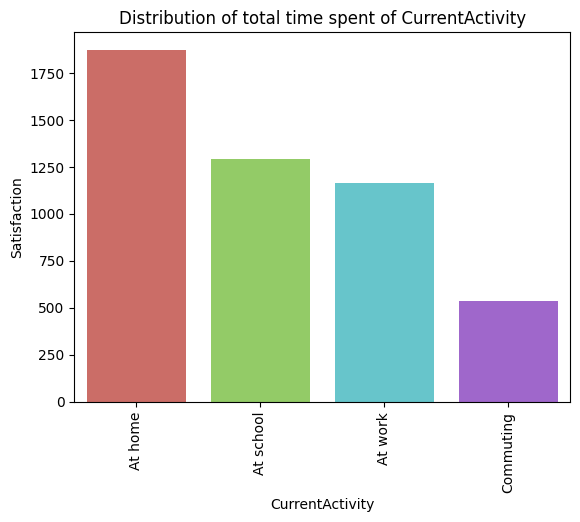

Average Satisfaction by different groups of CurrentActivity
CurrentActivity
At home      4.916010
At school    4.771218
At work      4.974359
Commuting    4.684211
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


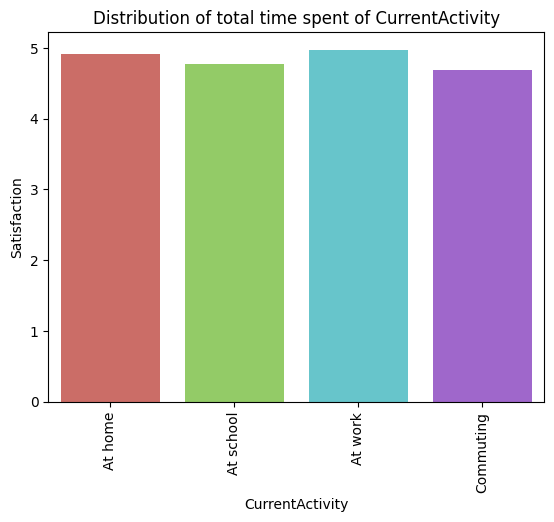

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


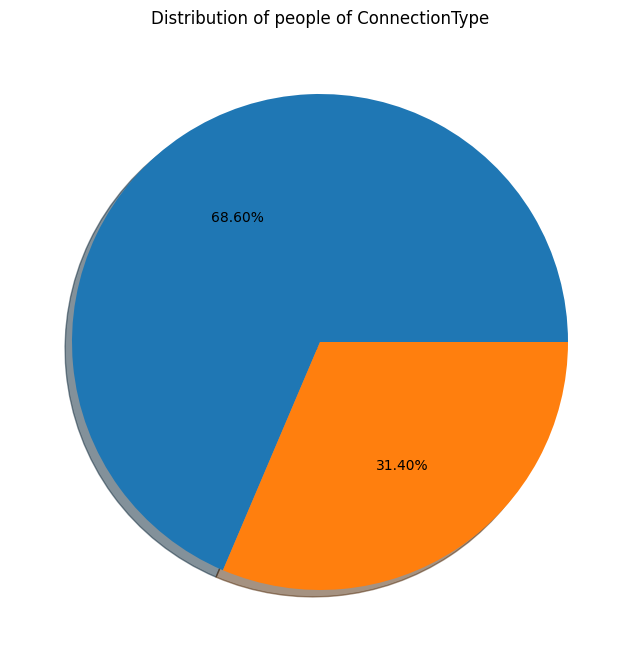

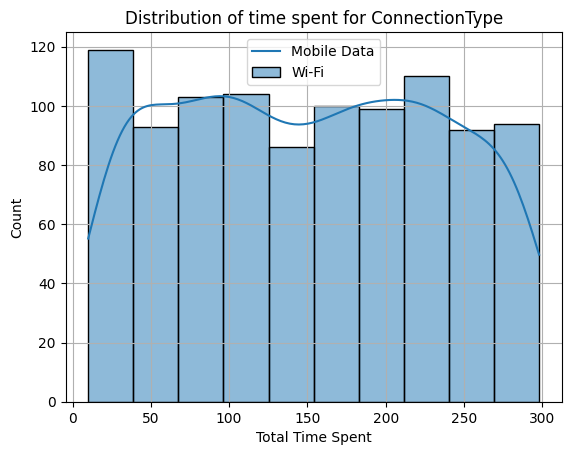

Total Total Time Spent by different groups of ConnectionType
ConnectionType
Mobile Data    106247
Wi-Fi           45159
Name: Total Time Spent, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


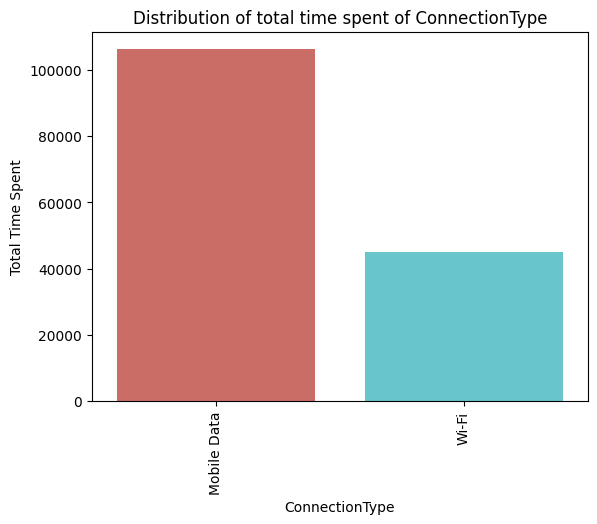

Average Total Time Spent by different groups of ConnectionType
ConnectionType
Mobile Data    154.879009
Wi-Fi          143.818471
Name: Total Time Spent, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


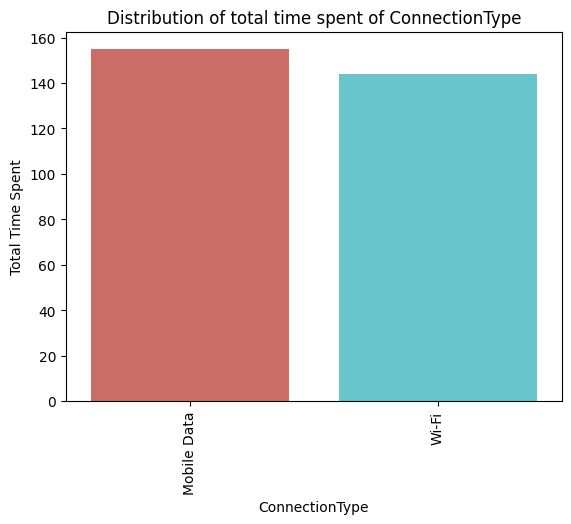

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


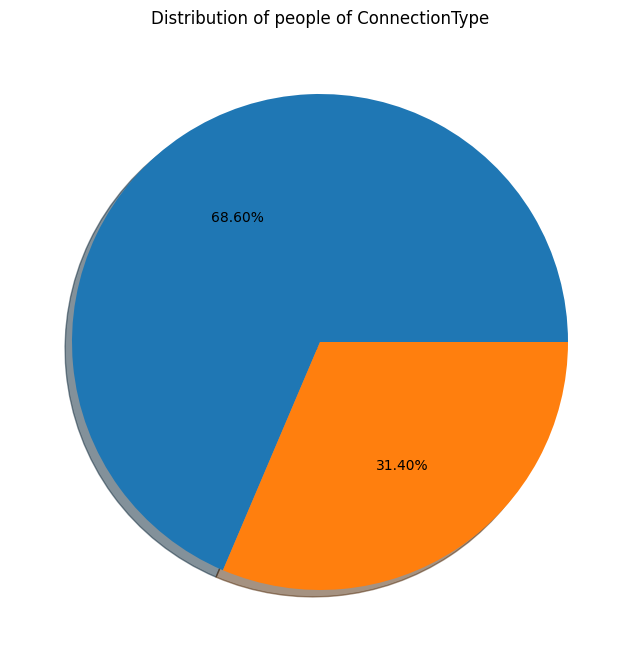

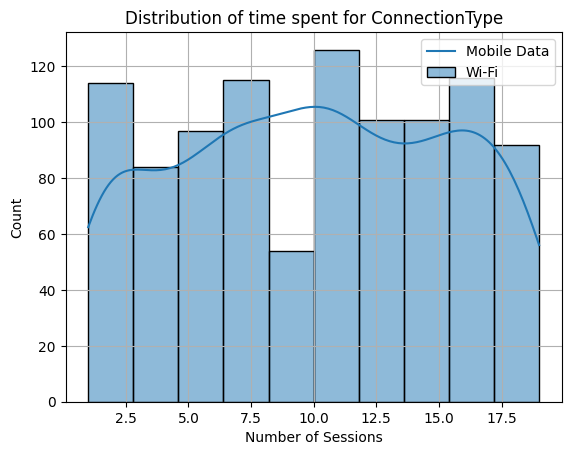

Total Number of Sessions by different groups of ConnectionType
ConnectionType
Mobile Data    6821
Wi-Fi          3192
Name: Number of Sessions, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


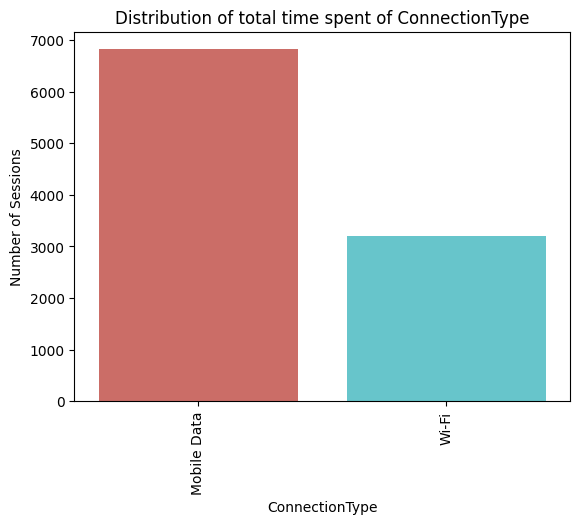

C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


Average Number of Sessions by different groups of ConnectionType
ConnectionType
Mobile Data     9.943149
Wi-Fi          10.165605
Name: Number of Sessions, dtype: float64


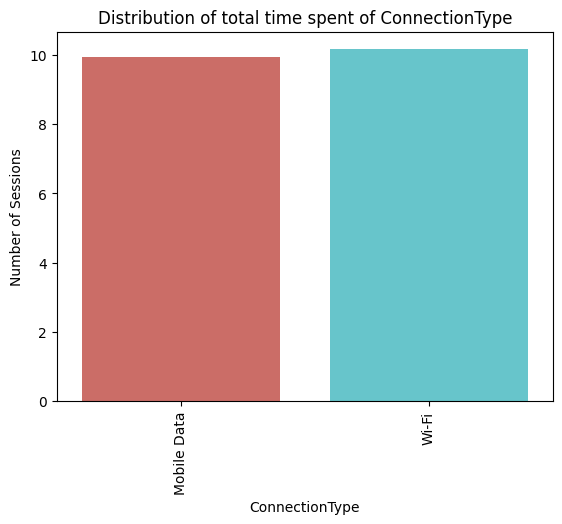

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


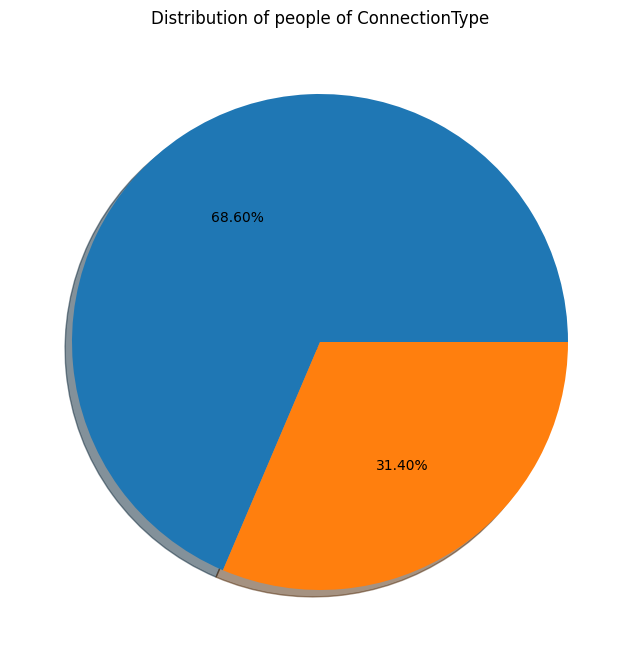

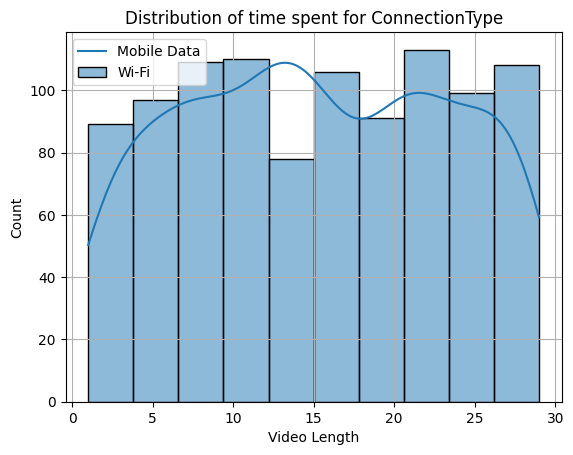

Total Video Length by different groups of ConnectionType
ConnectionType
Mobile Data    10399
Wi-Fi           4815
Name: Video Length, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


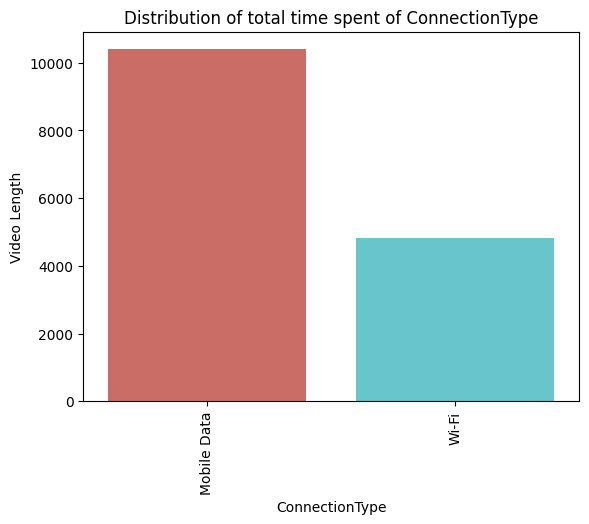

Average Video Length by different groups of ConnectionType
ConnectionType
Mobile Data    15.158892
Wi-Fi          15.334395
Name: Video Length, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


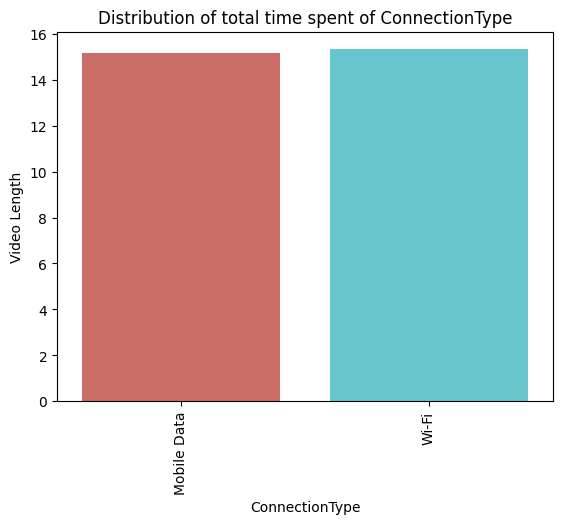

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


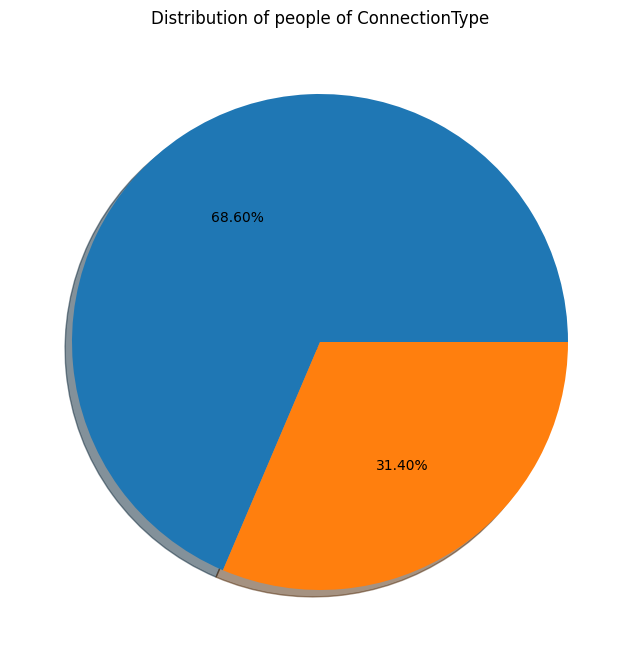

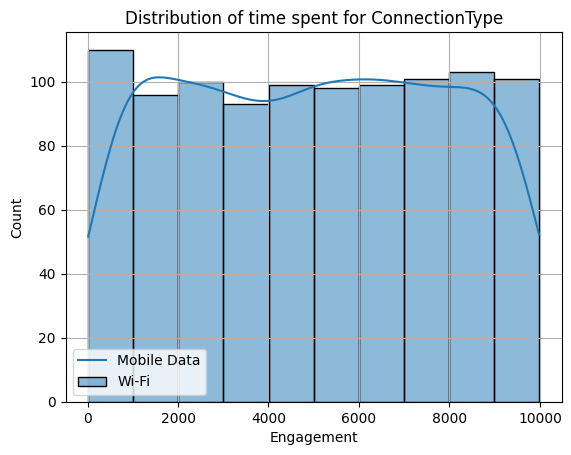

Total Engagement by different groups of ConnectionType
ConnectionType
Mobile Data    3405713
Wi-Fi          1591446
Name: Engagement, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


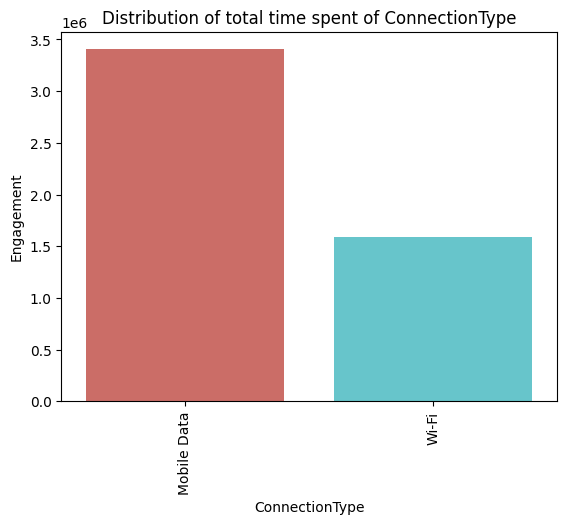

Average Engagement by different groups of ConnectionType
ConnectionType
Mobile Data    4964.596210
Wi-Fi          5068.299363
Name: Engagement, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


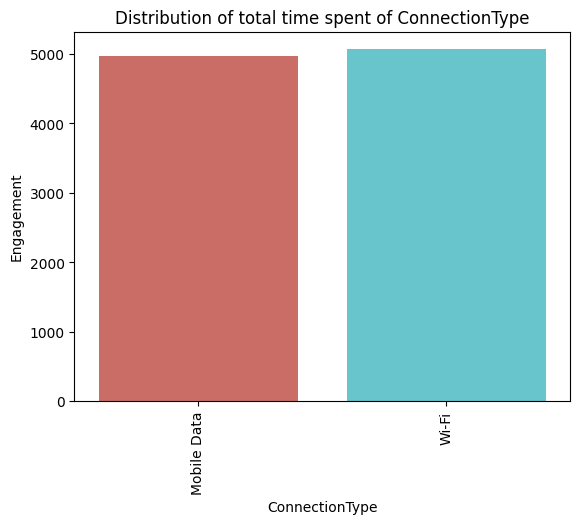

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


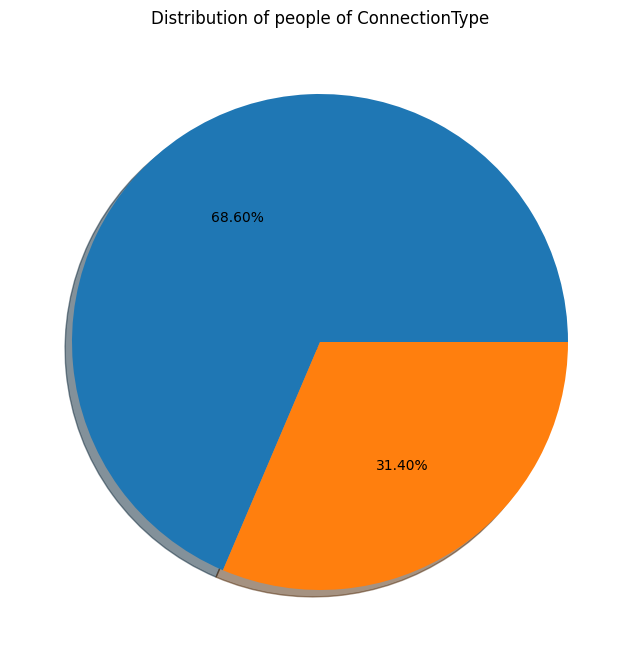

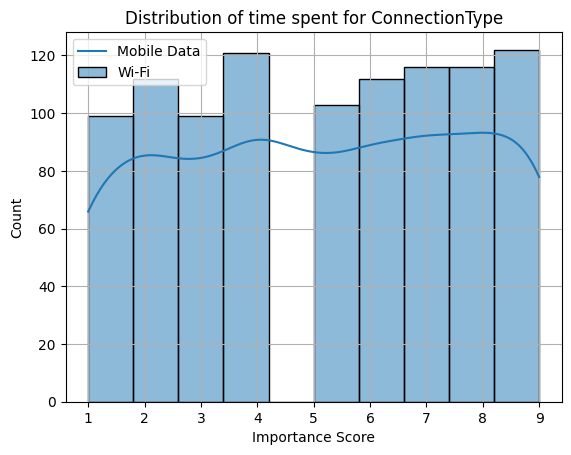

Total Importance Score by different groups of ConnectionType
ConnectionType
Mobile Data    3510
Wi-Fi          1619
Name: Importance Score, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


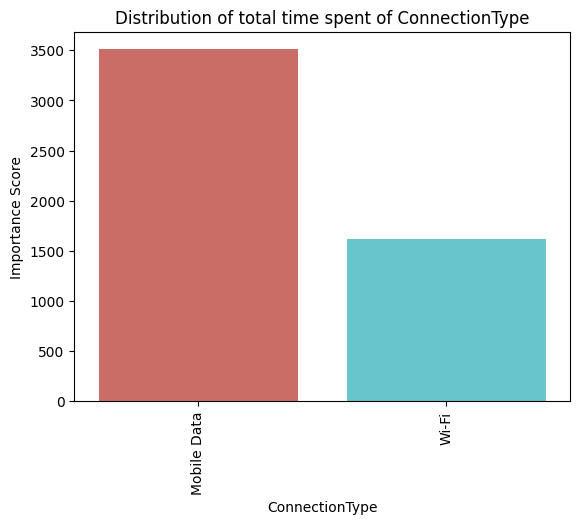

Average Importance Score by different groups of ConnectionType
ConnectionType
Mobile Data    5.116618
Wi-Fi          5.156051
Name: Importance Score, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


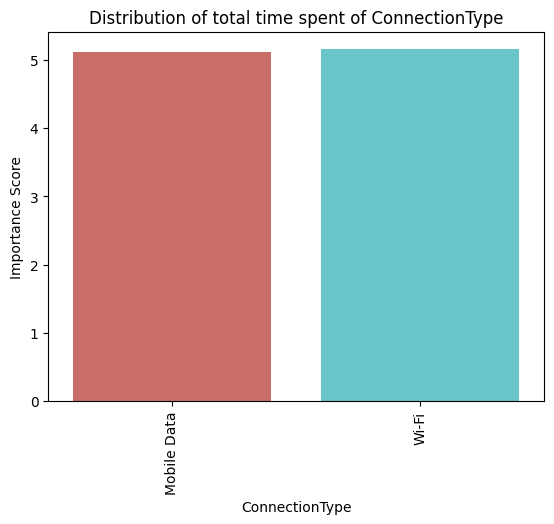

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


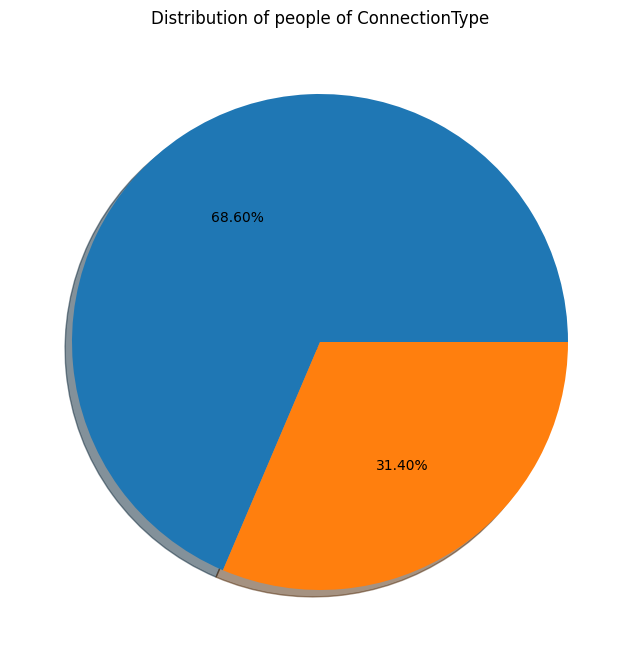

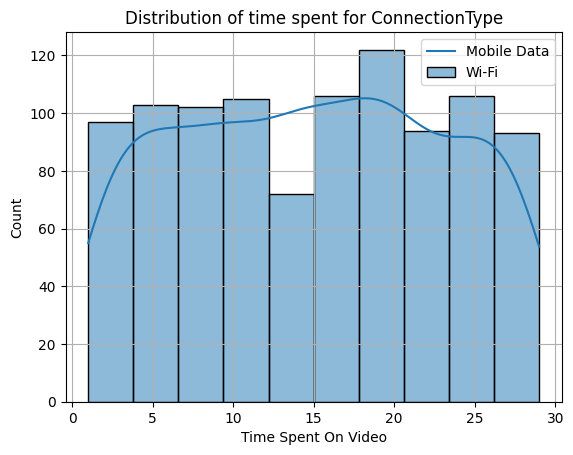

Total Time Spent On Video by different groups of ConnectionType
ConnectionType
Mobile Data    10223
Wi-Fi           4750
Name: Time Spent On Video, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


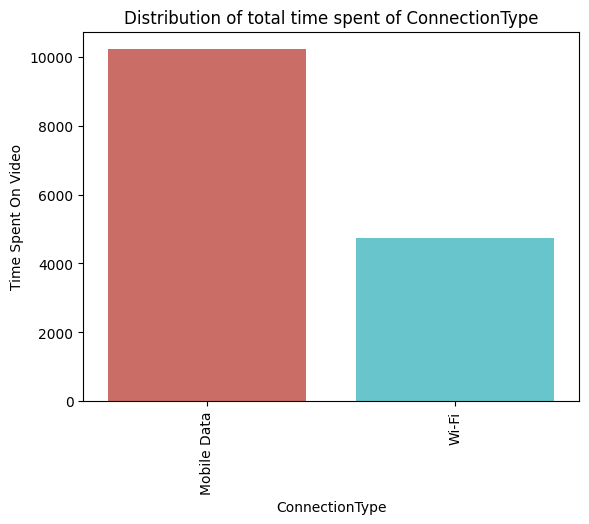

Average Time Spent On Video by different groups of ConnectionType
ConnectionType
Mobile Data    14.902332
Wi-Fi          15.127389
Name: Time Spent On Video, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


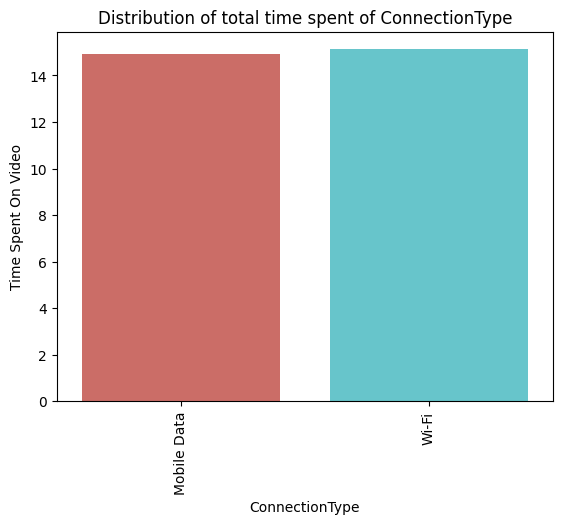

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


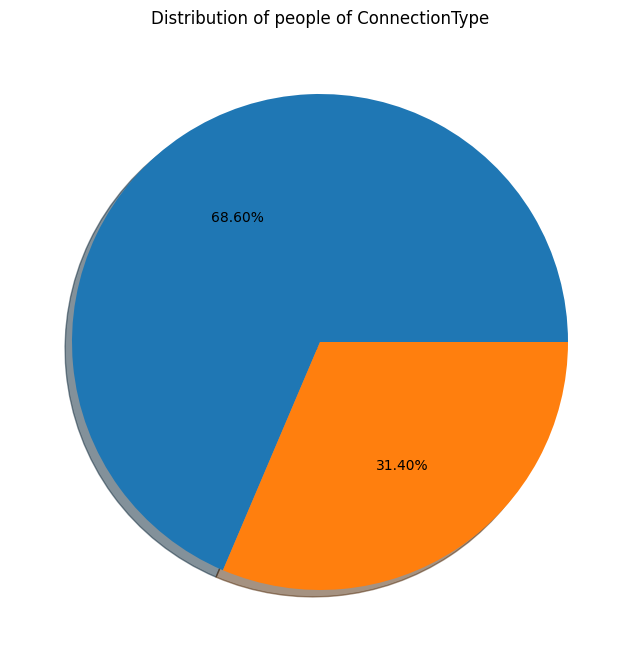

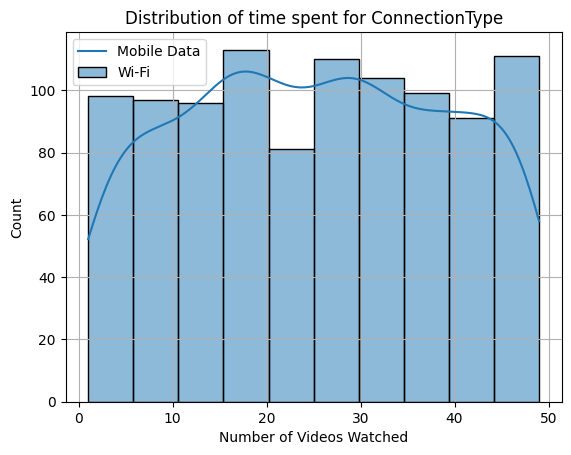

Total Number of Videos Watched by different groups of ConnectionType
ConnectionType
Mobile Data    17381
Wi-Fi           7867
Name: Number of Videos Watched, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


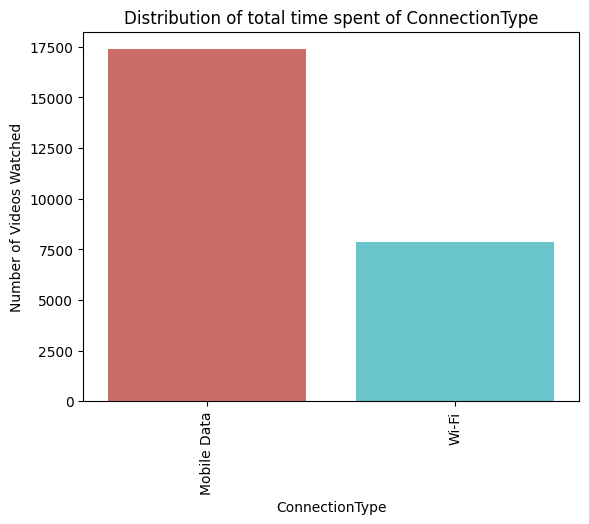

Average Number of Videos Watched by different groups of ConnectionType
ConnectionType
Mobile Data    25.336735
Wi-Fi          25.054140
Name: Number of Videos Watched, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


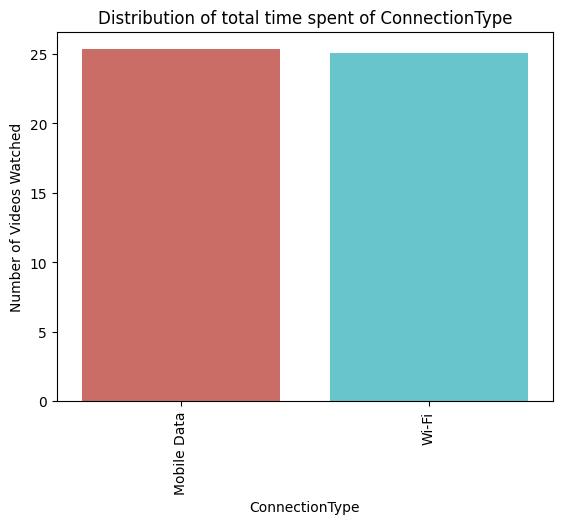

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


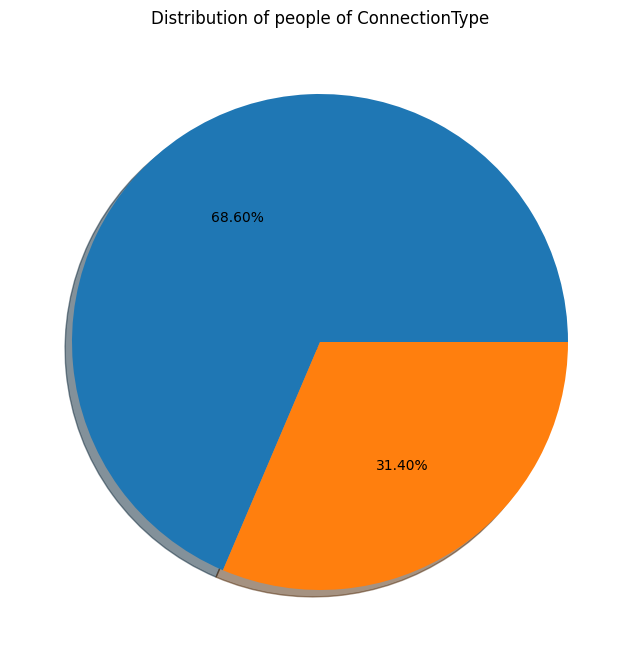

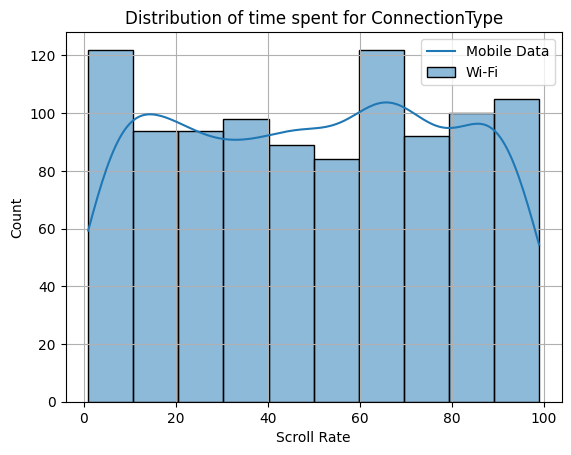

Total Scroll Rate by different groups of ConnectionType
ConnectionType
Mobile Data    34806
Wi-Fi          14968
Name: Scroll Rate, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


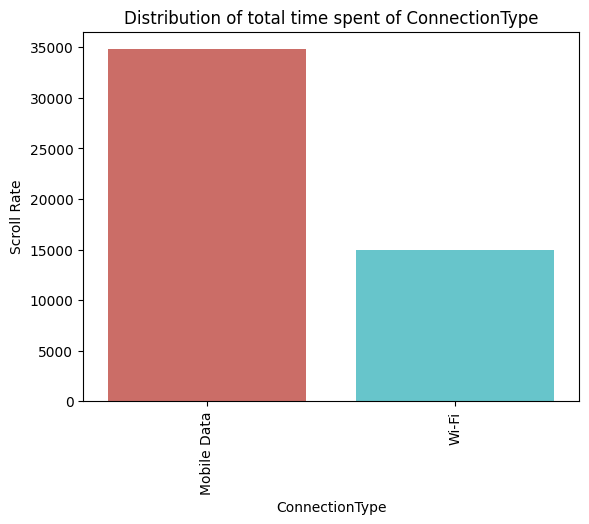

Average Scroll Rate by different groups of ConnectionType
ConnectionType
Mobile Data    50.737609
Wi-Fi          47.668790
Name: Scroll Rate, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


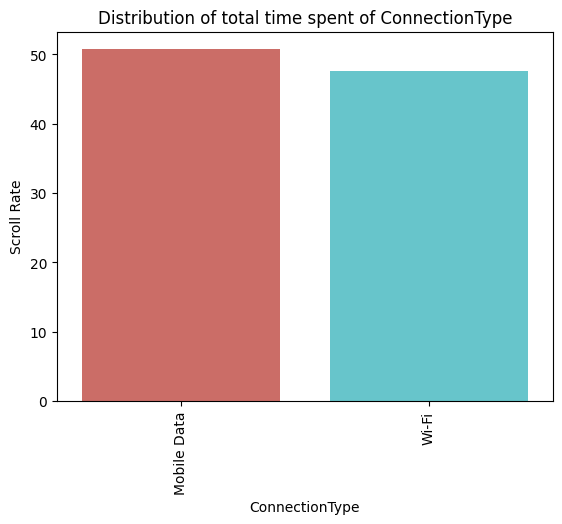

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


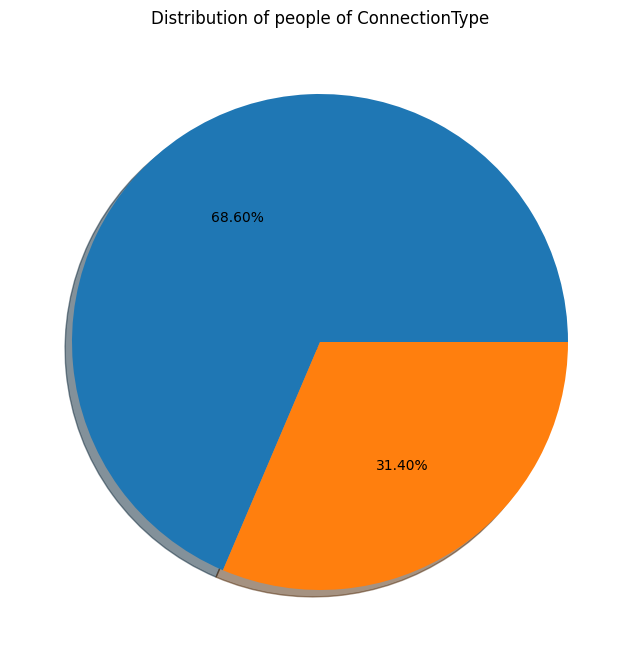

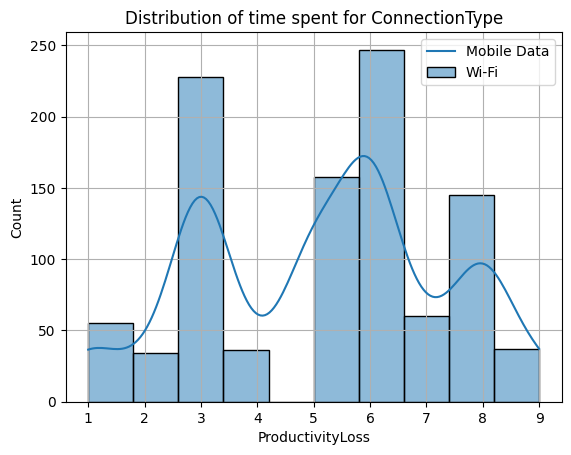

Total ProductivityLoss by different groups of ConnectionType
ConnectionType
Mobile Data    3502
Wi-Fi          1634
Name: ProductivityLoss, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


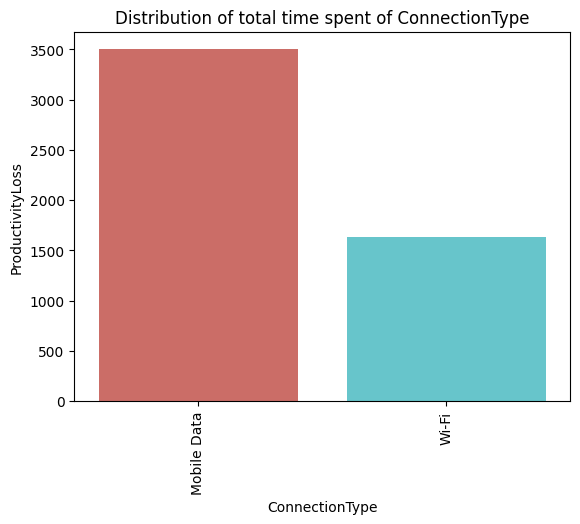

Average ProductivityLoss by different groups of ConnectionType
ConnectionType
Mobile Data    5.104956
Wi-Fi          5.203822
Name: ProductivityLoss, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


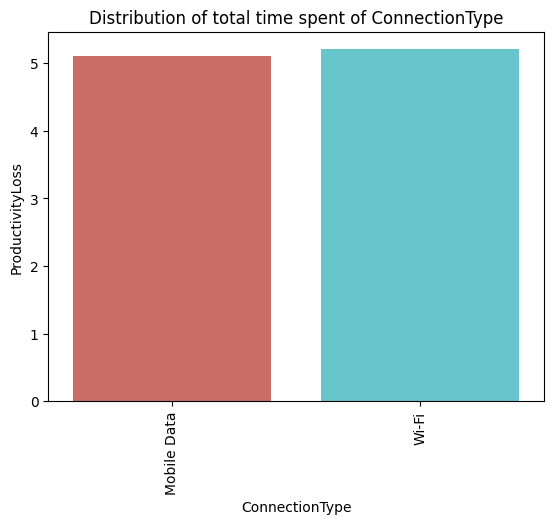

ConnectionType:
Distribution of people of ConnectionType
ConnectionType
Mobile Data    68.6
Wi-Fi          31.4
Name: count, dtype: float64


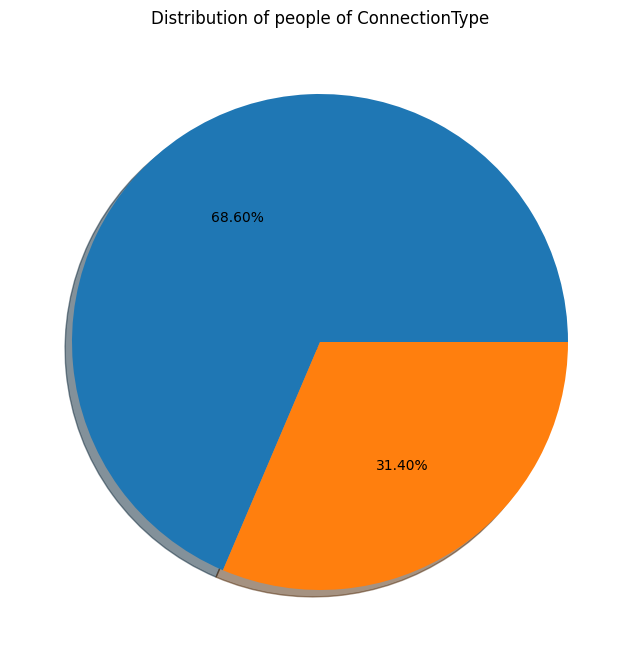

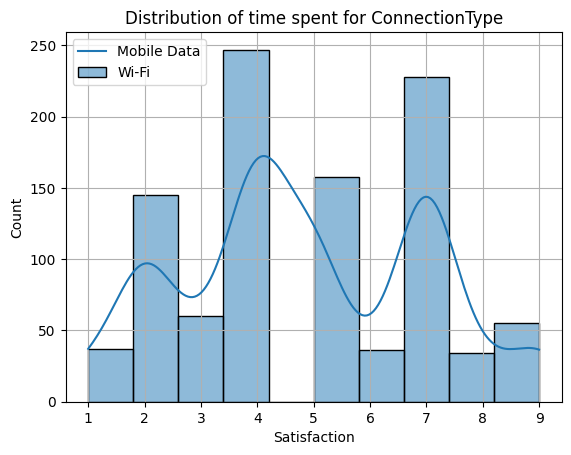

Total Satisfaction by different groups of ConnectionType
ConnectionType
Mobile Data    3358
Wi-Fi          1506
Name: Satisfaction, dtype: int64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].sum(),palette='hls')


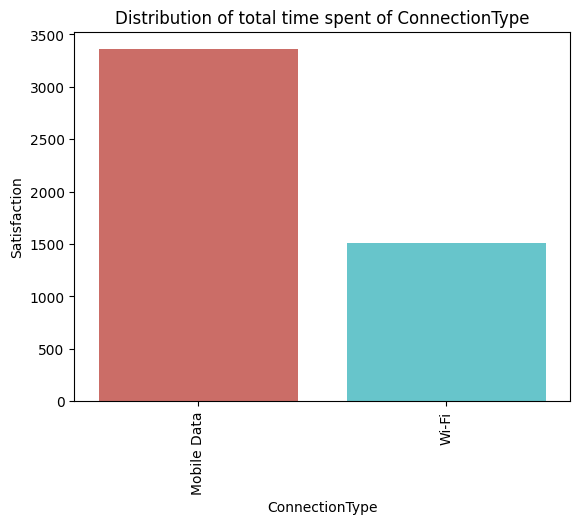

Average Satisfaction by different groups of ConnectionType
ConnectionType
Mobile Data    4.895044
Wi-Fi          4.796178
Name: Satisfaction, dtype: float64


C:\Users\HP\AppData\Local\Temp\ipykernel_13404\2288994406.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(self.df.groupby(self.category)[self.num_col].mean(),palette='hls')


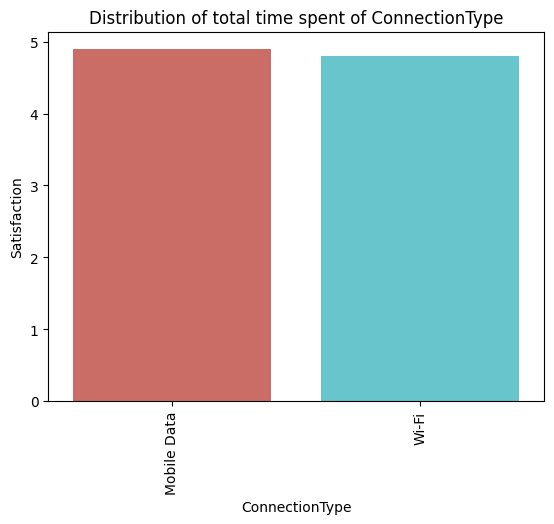

In [ ]:
for i in obj_col:
    for j in num_col:
        try:
            label.analyse_the_plot(modified_data, i, j)
        except Exception as e:
            print(f"Error processing {i} and {j}: {e}")

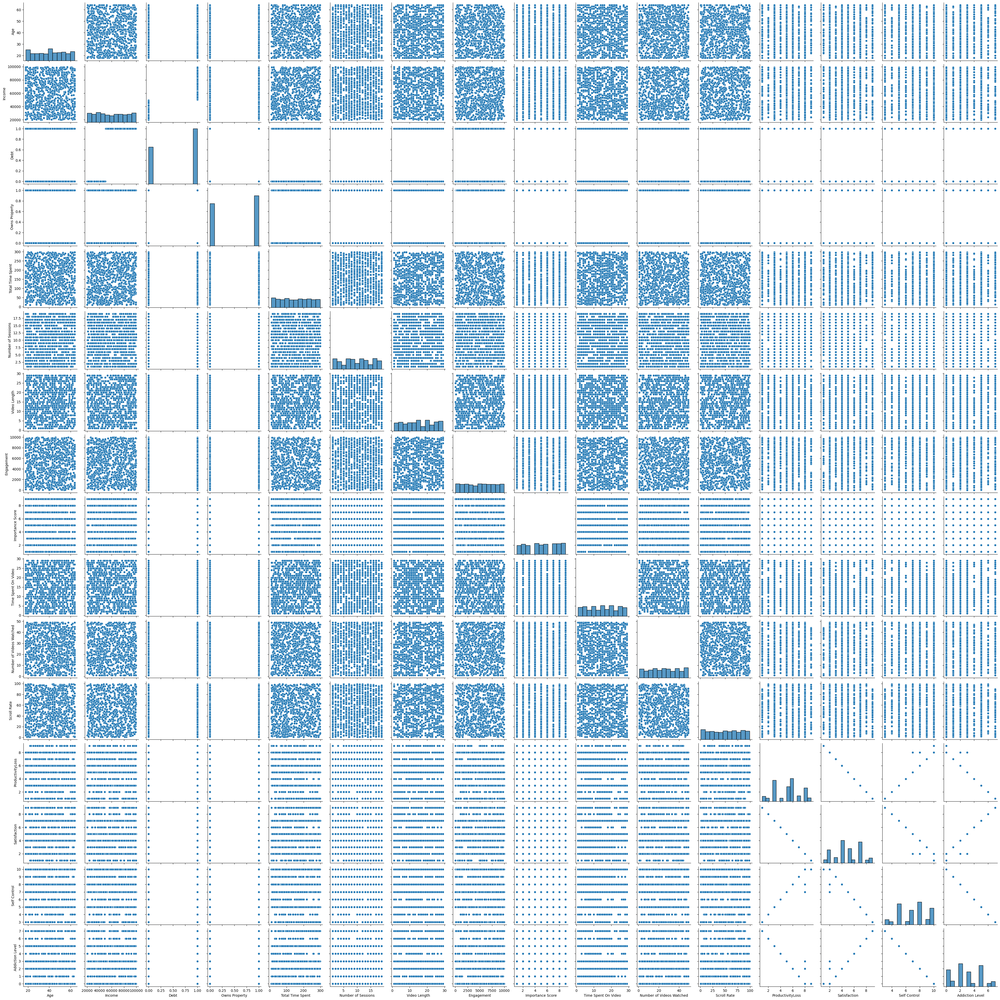

In [ ]:
sns.pairplot(updated_data)
plt.show()